In [1]:
# Import libraries 
import librosa
import librosa.display
import numpy as np
import matplotlib.pyplot as plt
import tensorflow as tf
from matplotlib.pyplot import specgram
import pandas as pd
import glob 
from sklearn.metrics import confusion_matrix
import IPython.display as ipd  # To play sound in the notebook
import os
import sys
import warnings
# ignore warnings 
if not sys.warnoptions:
    warnings.simplefilter("ignore")
warnings.filterwarnings("ignore", category=DeprecationWarning)

In [2]:


TESS = "C:\\Tess\\TESS Toronto emotional speech set data\\"
RAV ="C:\\Ravdes\\RAVDESS\\audio_speech_actors_01-24\\"
SAVEE = "C:\\SAVEE\\ALL\\"
CREMA = "C:\\Crema\\AudioWAV\\"

# Run one example 
dir_list = os.listdir(SAVEE)
dir_list[0:5]

['DC_a01.wav', 'DC_a02.wav', 'DC_a03.wav', 'DC_a04.wav', 'DC_a05.wav']

### The audio files are named in such a way that the prefix letters describes the emotion classes as follows:

###  'a' = 'anger'
### 'd' = 'disgust'
### 'f' = 'fear'
### 'h' = 'happiness'
### 'n' = 'neutral'
### 'sa' = 'sadness'
### 'su' = 'surprise'
### The original source has 4 folders each representing a speaker, but i've bundled all of them into one single folder and thus the first 2 letter prefix of the filename represents the speaker initials. Eg. 'DC_d03.wav' is the 3rd disgust sentence uttered by the speaker DC. It's worth nothing that they are all male speakers only. This isn't an issue as we'll balance it out with the TESS dataset which is just female only. So lets check out the distribution of the emotions...

In [3]:
# Get the data location for SAVEE
dir_list = os.listdir(SAVEE)

# parse the filename to get the emotions
emotion=[]
path = []
for i in dir_list:
    if i[-8:-6]=='_a':
        emotion.append('male_angry')
    elif i[-8:-6]=='_d':
        emotion.append('male_disgust')
    elif i[-8:-6]=='_f':
        emotion.append('male_fear')
    elif i[-8:-6]=='_h':
        emotion.append('male_happy')
    elif i[-8:-6]=='_n':
        emotion.append('male_neutral')
    elif i[-8:-6]=='sa':
        emotion.append('male_sad')
    elif i[-8:-6]=='su':
        emotion.append('male_surprise')
    else:
        emotion.append('male_error') 
    path.append(SAVEE + i)
    
# Now check out the label count distribution 
SAVEE_df = pd.DataFrame(emotion, columns = ['labels'])
SAVEE_df['source'] = 'SAVEE'
SAVEE_df = pd.concat([SAVEE_df, pd.DataFrame(path, columns = ['path'])], axis = 1)
SAVEE_df.labels.value_counts()

male_neutral     120
male_disgust      60
male_sad          60
male_angry        60
male_happy        60
male_surprise     60
male_fear         60
Name: labels, dtype: int64

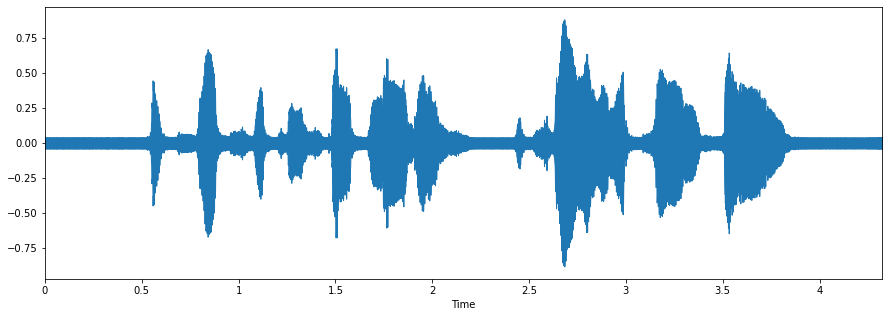

In [4]:
# use the well known Librosa library for this task 
fname = SAVEE + 'DC_f11.wav'  
data, sampling_rate = librosa.load(fname)
plt.figure(figsize=(15, 5))
librosa.display.waveplot(data, sr=sampling_rate)

# Lets play the audio 
ipd.Audio(fname)

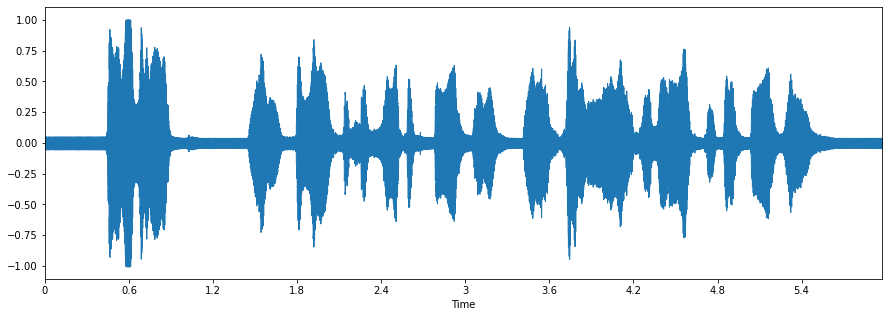

In [5]:
# Lets play a happy track
fname = SAVEE + 'DC_h11.wav'  
data, sampling_rate = librosa.load(fname)
plt.figure(figsize=(15, 5))
librosa.display.waveplot(data, sr=sampling_rate)

# Lets play the audio 
ipd.Audio(fname)

In [6]:
dir_list = os.listdir(RAV)
dir_list.sort()

emotion = []
gender = []
path = []
for i in dir_list:
    fname = os.listdir(RAV + i)
    for f in fname:
        part = f.split('.')[0].split('-')
        emotion.append(int(part[2]))
        temp = int(part[6])
        if temp%2 == 0:
            temp = "female"
        else:
            temp = "male"
        gender.append(temp)
        path.append(RAV + i + '/' + f)

        
RAV_df = pd.DataFrame(emotion)
RAV_df = RAV_df.replace({1:'neutral', 2:'calm', 3:'happy', 4:'sad', 5:'angry', 6:'fear', 7:'disgust', 8:'surprise'})
RAV_df = pd.concat([pd.DataFrame(gender),RAV_df],axis=1)
RAV_df.columns = ['gender','emotion']
RAV_df['labels'] =RAV_df.gender + '_' + RAV_df.emotion
RAV_df['source'] = 'RAVDESS'  
RAV_df = pd.concat([RAV_df,pd.DataFrame(path, columns = ['path'])],axis=1)
RAV_df = RAV_df.drop(['gender', 'emotion'], axis=1)
RAV_df.labels.value_counts()

female_calm        96
female_surprise    96
female_fear        96
male_disgust       96
female_happy       96
male_sad           96
male_angry         96
female_disgust     96
female_angry       96
male_calm          96
male_happy         96
female_sad         96
male_surprise      96
male_fear          96
female_neutral     48
male_neutral       48
Name: labels, dtype: int64

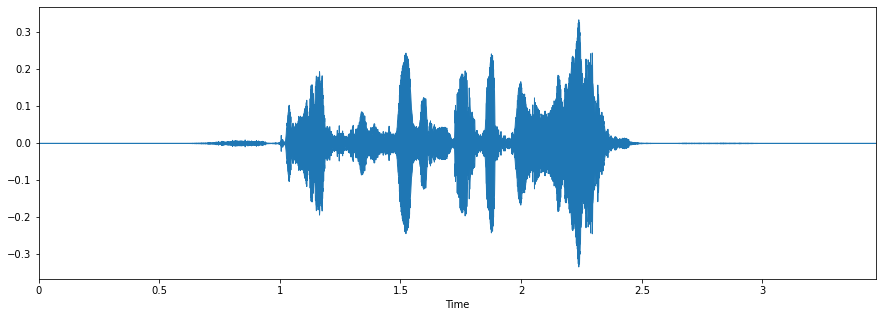

In [7]:
# Pick a fearful track
fname = RAV + 'Actor_14/03-01-06-02-02-02-14.wav'  
data, sampling_rate = librosa.load(fname)
plt.figure(figsize=(15, 5))
librosa.display.waveplot(data, sr=sampling_rate)

# Lets play the audio 
ipd.Audio(fname)

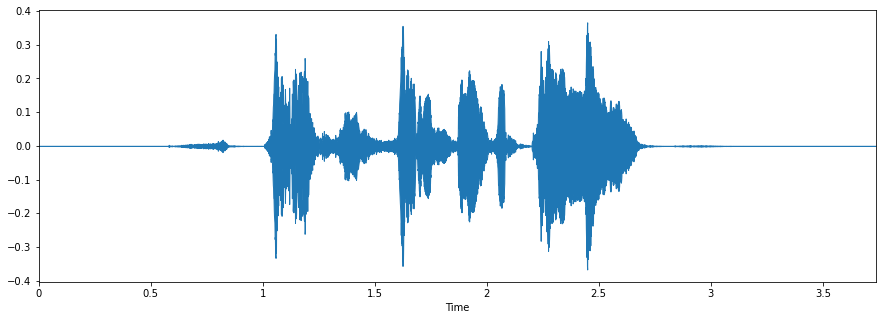

In [8]:
# Pick a happy track
fname = RAV + 'Actor_14/03-01-03-02-02-02-14.wav'  
data, sampling_rate = librosa.load(fname)
plt.figure(figsize=(15, 5))
librosa.display.waveplot(data, sr=sampling_rate)

# Lets play the audio 
ipd.Audio(fname)

In [9]:
dir_list = os.listdir(TESS)
dir_list.sort()
dir_list

['OAF_Fear',
 'OAF_Pleasant_surprise',
 'OAF_Sad',
 'OAF_angry',
 'OAF_disgust',
 'OAF_happy',
 'OAF_neutral',
 'TESS Toronto emotional speech set data',
 'YAF_angry',
 'YAF_disgust',
 'YAF_fear',
 'YAF_happy',
 'YAF_neutral',
 'YAF_pleasant_surprised',
 'YAF_sad']

In [10]:
path = []
emotion = []

for i in dir_list:
    fname = os.listdir(TESS + i)
    for f in fname:
        if i == 'OAF_angry' or i == 'YAF_angry':
            emotion.append('female_angry')
        elif i == 'OAF_disgust' or i == 'YAF_disgust':
            emotion.append('female_disgust')
        elif i == 'OAF_Fear' or i == 'YAF_fear':
            emotion.append('female_fear')
        elif i == 'OAF_happy' or i == 'YAF_happy':
            emotion.append('female_happy')
        elif i == 'OAF_neutral' or i == 'YAF_neutral':
            emotion.append('female_neutral')                                
        elif i == 'OAF_Pleasant_surprise' or i == 'YAF_pleasant_surprised':
            emotion.append('female_surprise')               
        elif i == 'OAF_Sad' or i == 'YAF_sad':
            emotion.append('female_sad')
        else:
            emotion.append('Unknown')
        path.append(TESS + i + "/" + f)

TESS_df = pd.DataFrame(emotion, columns = ['labels'])
TESS_df['source'] = 'TESS'
TESS_df = pd.concat([TESS_df,pd.DataFrame(path, columns = ['path'])],axis=1)
TESS_df.labels.value_counts()

female_neutral     400
female_surprise    400
female_fear        400
female_disgust     400
female_angry       400
female_sad         400
female_happy       400
Unknown             14
Name: labels, dtype: int64

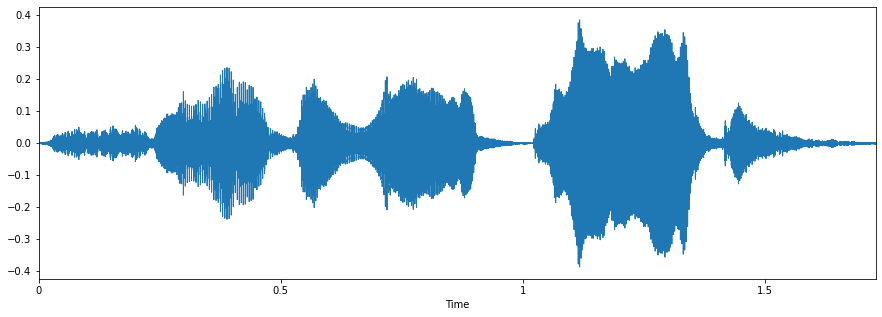

In [11]:
# lets play a fearful track 
fname = TESS + 'YAF_fear/YAF_dog_fear.wav' 

data, sampling_rate = librosa.load(fname)
plt.figure(figsize=(15, 5))
librosa.display.waveplot(data, sr=sampling_rate)

# Lets play the audio 
ipd.Audio(fname)

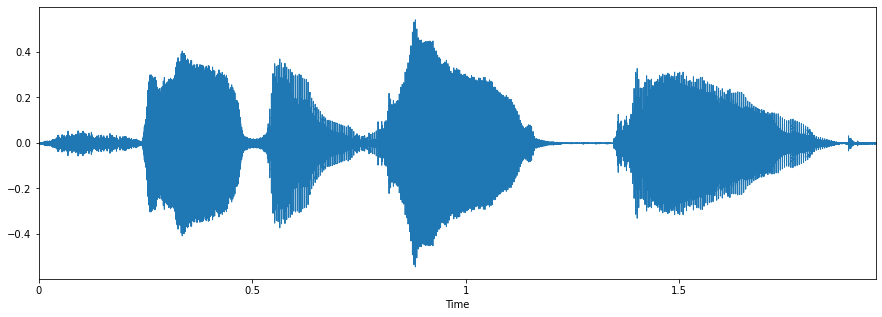

In [12]:
# lets play a happy track 
fname =  TESS + 'YAF_happy/YAF_dog_happy.wav' 

data, sampling_rate = librosa.load(fname)
plt.figure(figsize=(15, 5))
librosa.display.waveplot(data, sr=sampling_rate)

# Lets play the audio 
ipd.Audio(fname)

In [13]:
dir_list = os.listdir(CREMA)
dir_list.sort()
print(dir_list[0:10])

['1001_DFA_ANG_XX.wav', '1001_DFA_DIS_XX.wav', '1001_DFA_FEA_XX.wav', '1001_DFA_HAP_XX.wav', '1001_DFA_NEU_XX.wav', '1001_DFA_SAD_XX.wav', '1001_IEO_ANG_HI.wav', '1001_IEO_ANG_LO.wav', '1001_IEO_ANG_MD.wav', '1001_IEO_DIS_HI.wav']


In [14]:
gender = []
emotion = []
path = []
female = [1002,1003,1004,1006,1007,1008,1009,1010,1012,1013,1018,1020,1021,1024,1025,1028,1029,1030,1037,1043,1046,1047,1049,
          1052,1053,1054,1055,1056,1058,1060,1061,1063,1072,1073,1074,1075,1076,1078,1079,1082,1084,1089,1091]

for i in dir_list: 
    part = i.split('_')
    if int(part[0]) in female:
        temp = 'female'
    else:
        temp = 'male'
    gender.append(temp)
    if part[2] == 'SAD' and temp == 'male':
        emotion.append('male_sad')
    elif part[2] == 'ANG' and temp == 'male':
        emotion.append('male_angry')
    elif part[2] == 'DIS' and temp == 'male':
        emotion.append('male_disgust')
    elif part[2] == 'FEA' and temp == 'male':
        emotion.append('male_fear')
    elif part[2] == 'HAP' and temp == 'male':
        emotion.append('male_happy')
    elif part[2] == 'NEU' and temp == 'male':
        emotion.append('male_neutral')
    elif part[2] == 'SAD' and temp == 'female':
        emotion.append('female_sad')
    elif part[2] == 'ANG' and temp == 'female':
        emotion.append('female_angry')
    elif part[2] == 'DIS' and temp == 'female':
        emotion.append('female_disgust')
    elif part[2] == 'FEA' and temp == 'female':
        emotion.append('female_fear')
    elif part[2] == 'HAP' and temp == 'female':
        emotion.append('female_happy')
    elif part[2] == 'NEU' and temp == 'female':
        emotion.append('female_neutral')
    else:
        emotion.append('Unknown')
    path.append(CREMA + i)
    
CREMA_df = pd.DataFrame(emotion, columns = ['labels'])
CREMA_df['source'] = 'CREMA'
CREMA_df = pd.concat([CREMA_df,pd.DataFrame(path, columns = ['path'])],axis=1)
CREMA_df.labels.value_counts()

male_angry        671
male_fear         671
male_disgust      671
male_sad          671
male_happy        671
female_disgust    600
female_angry      600
female_fear       600
female_sad        600
female_happy      600
male_neutral      575
female_neutral    512
Name: labels, dtype: int64

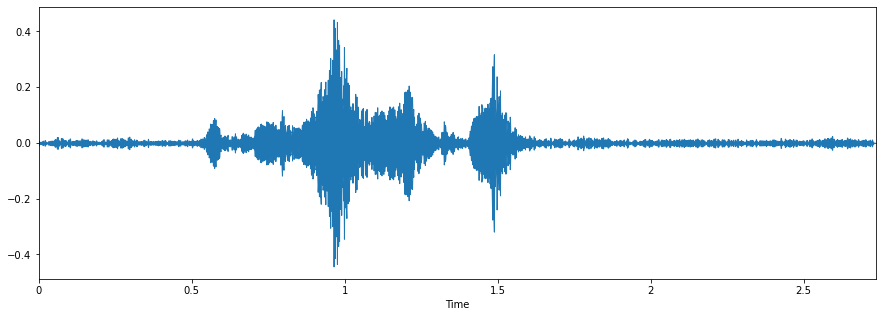

In [15]:
# use the well known Librosa library for this task 
fname = CREMA + '1012_IEO_HAP_HI.wav'  
data, sampling_rate = librosa.load(fname)
plt.figure(figsize=(15, 5))
librosa.display.waveplot(data, sr=sampling_rate)

# Lets play the audio 
ipd.Audio(fname)

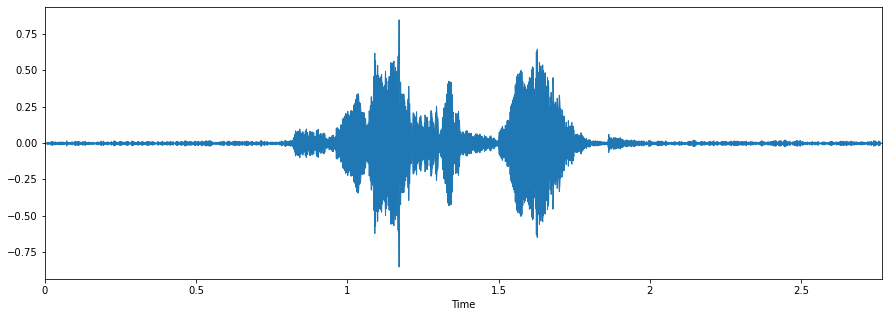

In [16]:
# A fearful track
fname = CREMA + '1012_IEO_FEA_HI.wav'  
data, sampling_rate = librosa.load(fname)
plt.figure(figsize=(15, 5))
librosa.display.waveplot(data, sr=sampling_rate)

# Lets play the audio 
ipd.Audio(fname)

In [17]:
df = pd.concat([SAVEE_df, RAV_df, CREMA_df], axis = 0)
print(df.labels.value_counts())
df.head()
df.to_csv("Data_path.csv",index=False)

male_angry         827
male_fear          827
male_disgust       827
male_sad           827
male_happy         827
male_neutral       743
female_happy       696
female_disgust     696
female_angry       696
female_fear        696
female_sad         696
female_neutral     560
male_surprise      156
female_calm         96
female_surprise     96
male_calm           96
Name: labels, dtype: int64


In [18]:
# Import our libraries
import librosa
import librosa.display
import numpy as np
import matplotlib.pyplot as plt
from matplotlib.pyplot import specgram
import pandas as pd
import os
import IPython.display as ipd  # To play sound in the notebook

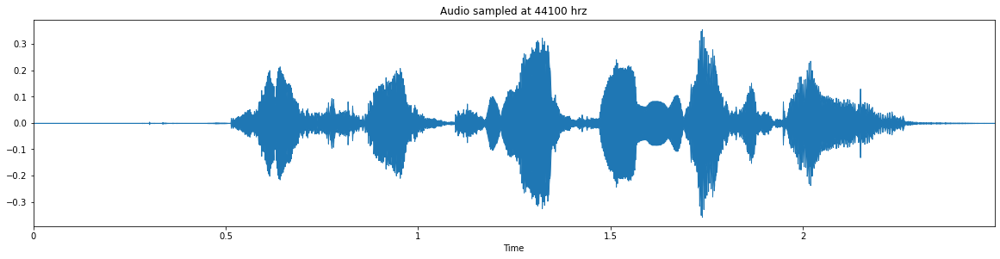

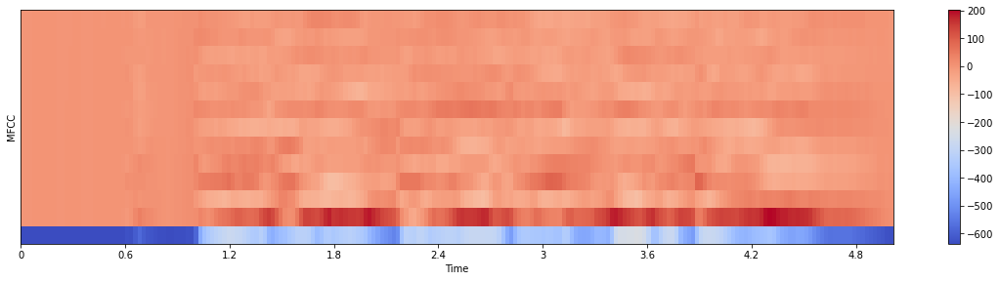

In [19]:
# Source - RAVDESS; Gender - Female; Emotion - Angry 
path = "C:\\Ravdes\\RAVDESS\\audio_speech_actors_01-24\\Actor_08\\03-01-05-02-01-01-08.wav"
X, sample_rate = librosa.load(path, res_type='kaiser_fast',duration=2.5,sr=22050*2,offset=0.5)  
mfcc = librosa.feature.mfcc(y=X, sr=sample_rate, n_mfcc=13)

# audio wave
plt.figure(figsize=(20, 15))
plt.subplot(3,1,1)
librosa.display.waveplot(X, sr=sample_rate)
plt.title('Audio sampled at 44100 hrz')

# MFCC
plt.figure(figsize=(20, 15))
plt.subplot(3,1,1)
librosa.display.specshow(mfcc, x_axis='time')
plt.ylabel('MFCC')
plt.colorbar()

ipd.Audio(path)

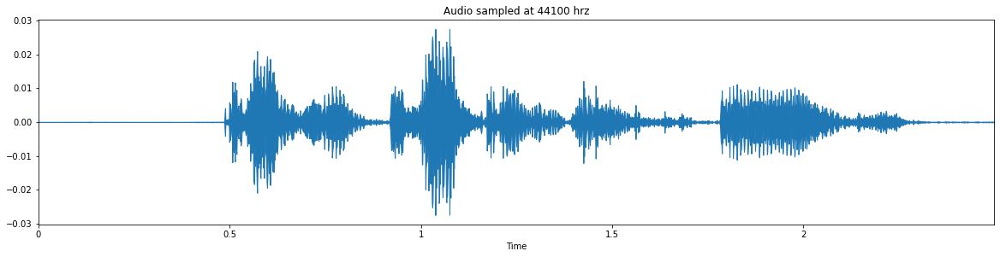

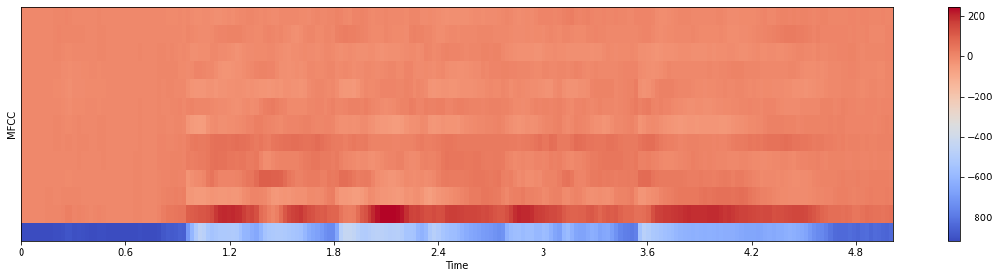

In [20]:
# Source - RAVDESS; Gender - Male; Emotion - Angry 
path = "C:\\Ravdes\\RAVDESS\\audio_speech_actors_01-24\\Actor_09\\03-01-05-01-01-01-09.wav"
X, sample_rate = librosa.load(path, res_type='kaiser_fast',duration=2.5,sr=22050*2,offset=0.5)  
mfcc = librosa.feature.mfcc(y=X, sr=sample_rate, n_mfcc=13)

# audio wave
plt.figure(figsize=(20, 15))
plt.subplot(3,1,1)
librosa.display.waveplot(X, sr=sample_rate)
plt.title('Audio sampled at 44100 hrz')

# MFCC
plt.figure(figsize=(20, 15))
plt.subplot(3,1,1)
librosa.display.specshow(mfcc, x_axis='time')
plt.ylabel('MFCC')
plt.colorbar()

ipd.Audio(path)

216
216


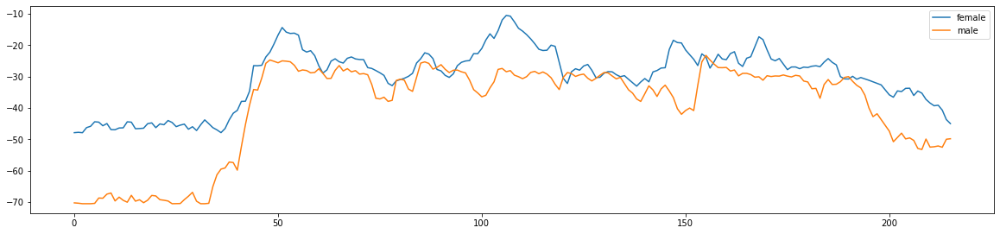

In [21]:
# Source - RAVDESS; Gender - Female; Emotion - Angry 
path = "C:\\Ravdes\\RAVDESS\\audio_speech_actors_01-24\\Actor_08\\03-01-05-02-01-01-08.wav"
X, sample_rate = librosa.load(path, res_type='kaiser_fast',duration=2.5,sr=22050*2,offset=0.5)  
female = librosa.feature.mfcc(y=X, sr=sample_rate, n_mfcc=13)
female = np.mean(librosa.feature.mfcc(y=X, sr=sample_rate, n_mfcc=13), axis=0)
print(len(female))

# Source - RAVDESS; Gender - Male; Emotion - Angry 
path = "C:\\Ravdes\\RAVDESS\\audio_speech_actors_01-24\\Actor_09\\03-01-05-01-01-01-09.wav"
X, sample_rate = librosa.load(path, res_type='kaiser_fast',duration=2.5,sr=22050*2,offset=0.5)  
male = librosa.feature.mfcc(y=X, sr=sample_rate, n_mfcc=13)
male = np.mean(librosa.feature.mfcc(y=X, sr=sample_rate, n_mfcc=13), axis=0)
print(len(male))

# audio wave
plt.figure(figsize=(20, 15))
plt.subplot(3,1,1)
plt.plot(female, label='female')
plt.plot(male, label='male')
plt.legend()

In [22]:
# Importing required libraries 
# Keras
import keras
from keras import regularizers
from keras.preprocessing import sequence
from keras.preprocessing.text import Tokenizer
from keras.preprocessing.sequence import pad_sequences
from keras.models import Sequential, Model, model_from_json
from keras.layers import Dense, Embedding, LSTM
from keras.layers import Input, Flatten, Dropout, Activation, BatchNormalization
from keras.layers import Conv1D, MaxPooling1D, AveragePooling1D
from keras.utils import np_utils, to_categorical
from keras.callbacks import ModelCheckpoint

# sklearn
from sklearn.metrics import confusion_matrix, accuracy_score, classification_report
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import LabelEncoder

# Other  
import librosa
import librosa.display
import json
import numpy as np
import matplotlib.pyplot as plt
import tensorflow as tf
from matplotlib.pyplot import specgram
import pandas as pd
import seaborn as sns
import glob 
import os
import pickle
import IPython.display as ipd  # To play sound in the notebook

Using TensorFlow backend.


In [23]:
# lets pick up the meta-data that we got from our first part of the Kernel
ref = pd.read_csv("Data_path.csv")
ref.head(10)

,labels,source,path
0,male_angry,SAVEE,C:\SAVEE\ALL\DC_a01.wav
1,male_angry,SAVEE,C:\SAVEE\ALL\DC_a02.wav
2,male_angry,SAVEE,C:\SAVEE\ALL\DC_a03.wav
3,male_angry,SAVEE,C:\SAVEE\ALL\DC_a04.wav
4,male_angry,SAVEE,C:\SAVEE\ALL\DC_a05.wav
5,male_angry,SAVEE,C:\SAVEE\ALL\DC_a06.wav
6,male_angry,SAVEE,C:\SAVEE\ALL\DC_a07.wav
7,male_angry,SAVEE,C:\SAVEE\ALL\DC_a08.wav
8,male_angry,SAVEE,C:\SAVEE\ALL\DC_a09.wav
9,male_angry,SAVEE,C:\SAVEE\ALL\DC_a10.wav


In [24]:
# we're iterating over 4 datasets 
df = pd.DataFrame(columns=['feature'])

# loop feature extraction over the entire dataset
counter=0
for index,path in enumerate(ref.path):
    X, sample_rate = librosa.load(path
                                  , res_type='kaiser_fast'
                                  ,duration=2.5
                                  ,sr=44100
                                  ,offset=0.5
                                 )
    sample_rate = np.array(sample_rate)
    
    # mean as the feature. Could do min and max etc as well. 
    mfccs = np.mean(librosa.feature.mfcc(y=X, 
                                        sr=sample_rate, 
                                        n_mfcc=13),
                    axis=0)
    df.loc[counter] = [mfccs]
    counter=counter+1
    print(counter, mfccs)

# Check a few records to make sure its processed successfully
print(len(df))
df.head()

1 [-11.113932   -7.215756   -6.21919    -5.9265423  -5.850419   -4.8089604
  -2.5130029  -3.500537   -3.721045   -4.4875593  -5.4290113  -7.3055725
  -7.14193    -6.5555744  -4.516298   -2.5563962  -2.251576   -5.13335
  -5.566185   -7.20538    -7.9091716 -10.862606  -13.266886  -13.715888
 -15.576247   -8.864893   -5.869707   -3.9691496  -4.0667677  -6.243662
  -5.8144536  -7.329672   -8.715132   -8.864923  -10.491897  -11.772941
 -12.314169  -13.577659  -14.217988  -11.3124075  -9.449202   -9.782572
 -11.307089  -15.080503  -18.698631  -21.29243   -20.248941  -20.51274
 -20.142696  -19.977814  -19.676876  -21.12687   -21.941769  -22.895468
 -23.481457  -22.928883  -23.431587  -23.819021  -15.218637   -7.6818385
  -4.474263   -3.4271364  -2.7408915  -2.447209   -3.4177961  -3.427022
  -3.8396382  -5.109673   -6.4226074  -7.8297963  -7.852357  -10.302065
 -11.0794115 -15.0834675 -16.734554  -20.405901  -23.169233  -20.038586
 -16.494411  -14.6714115 -14.88214   -13.396998   -9.339136  

9 [-27.40101   -24.815685  -24.262356  -24.282555  -24.520844  -25.73069
 -24.697758  -20.168125  -13.11908    -9.221375   -7.8747582  -5.8577976
  -4.9208255  -6.724517   -7.0928845  -7.47891    -7.938201   -7.0414157
  -6.1362176  -5.3825717  -6.7733483 -10.551728  -13.95997   -17.598259
 -19.061253  -21.496634  -23.243958  -23.311361  -14.894551  -11.256832
  -9.830355   -8.666764   -8.044851   -7.643386   -4.8333454  -3.9664242
  -4.402186   -5.1623526  -4.816682   -6.049599   -5.693182   -5.8080773
  -6.697526   -7.137378   -7.267577   -7.2927127  -7.6409717  -7.863911
  -7.677271   -8.680234   -7.5878506  -8.637693   -7.258408   -6.7293515
  -7.45799    -7.9950986  -7.7801657  -8.039335   -9.430612   -9.863142
  -9.914725   -9.817825   -9.354832   -8.947554   -8.476053   -8.691973
  -8.316423   -7.9439573  -6.387924   -5.4579706  -5.3933086  -6.749882
  -7.375266   -7.5809765  -8.035537   -8.924013   -7.0313363  -7.7671123
  -8.546144   -8.03438    -8.505679   -7.351908   -6.1547

16 [-21.58953   -22.437151  -21.347393  -14.783846  -11.107853  -10.1210165
 -10.050945   -9.846877   -9.597108   -9.783616   -9.487054   -8.391023
  -8.910803   -8.311555   -7.290364   -7.3310175  -8.903711  -10.238174
 -10.210316  -10.655315  -10.651595   -9.880859   -8.487278   -5.6407704
  -3.9185634  -4.0284004  -6.3761754  -8.255593   -8.15971    -9.66667
 -11.305496  -12.077383  -14.889556  -18.088383  -20.39912   -22.803158
 -22.16378   -24.45305   -17.444977   -9.936346   -8.466945   -9.7356415
 -10.382522  -11.089059  -12.228343  -12.582773  -11.794017  -11.359732
 -11.975249  -11.883052  -11.775945  -11.530716  -11.297668  -10.040323
  -9.151367   -7.9747853  -9.600169  -12.728907  -16.592964  -17.244204
 -18.618238  -22.348766  -21.471241  -20.12997   -21.816345  -20.72527
 -21.227945  -21.81136   -22.316038  -22.963379  -24.052525  -24.57071
 -23.263973  -21.24779   -16.178976  -12.220588  -11.161957  -11.803481
 -10.675276   -9.531771   -8.03593    -7.7135153  -6.826205  

23 [-25.302     -24.328176  -24.939579  -24.932919  -15.922185   -9.669079
  -9.113287  -10.833799  -10.096999   -8.566568   -8.906032   -7.8718596
  -9.418824  -10.009119  -10.193019  -10.780452  -10.459804  -10.7476635
 -11.497915  -11.45185   -11.062866  -10.295214  -10.41442   -10.4937
 -10.004486  -11.568351  -12.606365  -12.271651  -11.122537  -10.86503
 -10.775225  -11.461335  -13.333212  -14.883213  -17.008621  -20.033216
 -20.588205  -22.697601  -25.07175   -23.37438   -12.785337   -9.35732
  -9.544154   -9.426687  -10.006495  -10.932633  -11.559019  -11.549759
 -11.536259  -10.187245   -8.819512   -7.786377   -7.1153927  -7.220584
  -6.566389   -5.5490947  -5.07682    -5.0690517  -7.2137203 -11.17227
 -14.819798  -16.771236  -18.710302  -19.485674  -20.731144  -24.134373
 -20.919008  -16.277773  -15.61236   -16.269833  -16.76533    -9.917113
  -7.145078   -5.982951   -6.7985544  -7.468333   -8.10261    -8.469115
  -8.609585   -8.312807   -9.556382   -9.551344   -8.821109   -7

32 [-22.524904  -22.208885  -24.005848  -24.024113  -22.797544  -23.048336
 -23.729391  -22.437185  -14.011247   -9.044642   -7.7242346  -8.467503
  -8.9462385  -9.05822    -8.106053   -6.8200583  -6.7284527  -7.1851916
  -8.514037   -8.720273  -10.650833  -10.707384  -10.98604   -11.683025
 -11.1445875 -11.920538  -11.244744  -10.948797  -10.761149  -11.470047
 -11.875885  -11.48921   -11.715768  -10.388436  -10.4032     -8.536226
  -7.3231664  -8.81461   -13.099436  -17.15439   -17.92718   -19.050741
 -20.154293  -23.447231  -20.610704  -15.16617   -12.344181  -10.206747
 -11.470539  -11.9527    -11.561373   -9.944872  -10.063598   -9.77934
  -9.932733  -10.021602  -10.8829975 -11.105495  -12.512857  -11.276369
 -10.051072  -11.318475  -14.275414  -18.099358  -19.56641   -21.059618
 -20.34893   -20.146898  -17.520739  -12.389414   -8.011846   -6.626363
  -7.968961   -9.534071  -10.594657  -12.777399  -12.447379  -13.975445
 -13.55521   -13.101813  -14.301168  -13.73877   -14.763201  

 -24.615187  -25.283833  -25.06918   -24.947102  -23.152617  -18.667309 ]
40 [  2.2939475    0.42787546  -9.285044    -9.877767    -9.852143
 -10.170395    -9.421202    -9.520771    -9.354826    -9.701971
  -9.34724     -8.40124     -8.57776     -9.167738    -9.205791
  -9.458886   -10.75696    -11.39945    -11.981242   -11.465097
 -12.833592   -12.23317     -9.472088    -8.461713    -7.9648404
  -7.8903227   -8.685313    -7.8685246   -7.4772916   -6.8807306
  -8.099139    -9.237078    -5.841685    -7.313499    -7.7969036
  -8.050224    -7.681458    -7.096753    -6.6072536   -7.463293
  -8.185034    -7.5856595   -8.1613      -9.472109   -10.229241
  -8.885946    -8.730031    -9.240498    -9.250253    -9.435678
  -8.814688    -7.741659    -8.100428    -7.986353    -9.13056
  -8.794878    -7.865659    -7.4564595   -7.900116    -8.220359
  -8.347237    -8.832304    -9.214255    -9.43694     -9.070426
  -7.952802    -7.964523    -7.844301    -7.6613584   -7.6602025
  -8.815342    -8.813526

 -14.3101635 -13.532595  -13.018484  -13.730068  -14.154953  -11.932108 ]
47 [-25.431227  -24.04128   -12.748193   -6.942663   -6.7811246  -8.86992
 -10.2236805  -9.505377   -8.333815   -8.303639   -9.014001   -8.8516655
  -8.595717  -10.211381  -11.614807  -15.491511  -16.303988  -12.578962
 -12.420644  -13.0663805 -10.930551  -10.931906  -10.455102  -10.212698
 -10.393653  -12.22353   -12.638184  -12.241698  -11.952891  -11.511989
 -10.097802   -8.501724   -7.229933   -6.6660357  -9.405176  -14.320374
 -19.78704   -17.710657  -16.977774  -19.291027  -19.026155  -20.205757
 -22.015856  -17.979923  -13.856564  -11.928553  -13.532312  -13.405116
 -13.376235  -13.820745  -14.234559  -13.126055  -12.080814  -11.447425
 -11.626019  -10.757213   -9.586811   -9.1504345 -11.081804  -11.967645
 -10.416458   -8.354532  -10.304988  -15.238174  -21.21249   -21.731028
 -21.425028  -18.139217  -17.615128  -16.418753  -14.323656  -14.652548
  -9.388554   -6.1021776  -7.7268467 -10.34484   -12.078716

   2.257757  ]
53 [-23.211082  -21.155924  -12.050492   -9.850843   -6.516493   -5.9850745
  -3.7220383  -2.84167    -4.0092583  -3.3784795  -3.9391954  -6.4051633
  -6.425372   -6.382866   -5.601916   -6.660932   -6.3873487  -4.360351
  -4.80131    -8.234594   -9.855305  -10.107046  -12.94662   -12.604267
 -12.283567  -10.5881195  -7.4806194  -8.0602865 -11.886779  -10.992304
  -9.108065   -8.181403   -7.617351   -6.4746046  -5.496154   -8.225799
 -14.297178  -17.050234  -16.981215  -14.6270275 -10.387721   -8.889504
  -8.4215355  -8.810254   -7.7218633  -6.6306787  -5.782485   -7.285606
  -8.463628  -10.223383  -12.918591  -15.168407  -16.953634  -20.113482
 -16.952967  -12.875014  -11.170049  -11.603191  -11.047021  -10.000581
  -8.606504   -6.694104   -6.90753    -6.8392444  -6.890839   -7.0701084
  -7.5625896  -6.4653964  -5.848885   -5.5394826  -6.0084834  -7.2610025
  -6.5639825  -7.0453534  -6.435483   -7.119502   -7.1956434  -8.215936
  -7.92689    -8.020278   -8.9460535  -9.0

59 [ -0.5428326   -3.7040992  -13.209988   -13.317598   -12.084839
 -10.208435   -12.682104   -15.870906   -15.592797   -14.468444
 -14.1268015  -11.472051   -12.021557    -8.109247    -5.204976
  -4.4794283   -4.5548296   -3.7776175   -3.4894292   -5.704172
  -9.475332   -12.175771   -12.78972    -14.680368   -15.231602
 -18.442955   -17.645302    -9.720074    -6.6333876   -5.1911397
  -5.0092335   -3.8912294   -3.134928    -2.7057753   -2.9169717
  -3.2404163   -3.045831    -2.9708955   -3.2384639   -3.461289
  -3.576083    -4.0133944   -4.519391    -6.326086    -7.2382197
  -8.340714    -8.708277    -8.491251    -8.135929    -8.09618
  -9.336967   -11.245771   -13.209442   -14.745906   -18.140802
 -20.894184   -22.077822   -22.317648   -23.583195   -25.57567
 -25.552412   -24.783703   -24.040356   -19.94691    -12.255733
  -8.404685    -7.91982     -6.1400576   -7.250206    -7.240537
  -8.430826   -10.320582   -11.820871   -13.031159   -14.96822
 -17.648659   -11.916472    -8.169107

66 [-20.805288  -17.670082   -9.731701   -8.314266   -7.9256263  -8.856941
  -7.8256025  -8.520483  -10.101622  -13.10139   -14.017814  -14.243463
 -17.50892   -19.444315  -15.350695  -14.238583  -13.861025  -12.691418
 -12.335282  -12.710604  -15.464     -17.864107  -19.846317  -22.156353
 -23.16044   -25.218773  -27.261515  -26.4221    -24.91533   -15.988252
 -13.166625  -12.211683  -13.546227  -14.578134  -14.834154  -14.799937
 -14.866306  -14.952201  -15.341091  -13.690546  -12.363639  -11.522511
 -12.614775  -14.482813  -20.460278  -22.936989  -23.404694  -22.860788
 -21.337551  -14.540295  -11.383454  -10.230686   -9.567641  -10.079741
 -10.588766   -9.631309   -9.035099  -10.254988  -14.256286  -18.957794
 -22.591702  -26.838503  -26.774466  -26.727102  -28.616528  -27.337137
 -26.149508  -23.247166  -24.045198  -24.18904   -25.301662  -26.038177
 -25.918537  -26.78247   -26.880169  -26.901909  -23.849602  -15.945033
 -13.12535   -12.184771  -11.865664  -11.997971  -12.557566  

 -24.90257   -23.439882  -24.168114  -24.971012  -25.998915  -25.21027  ]
74 [ -1.4586246  -3.6390157  -8.260695  -11.016447  -13.48174   -20.104647
 -22.831541  -24.16232   -23.360939  -21.628086  -15.0108595 -11.231776
 -10.854476  -10.642196   -8.398726   -6.2475996  -5.353544   -6.5493264
  -9.906139  -14.623466  -16.754633  -19.1998    -20.696285  -21.080519
 -22.130188  -22.549706  -26.317827  -17.211046  -11.915013  -10.368784
 -10.545542   -9.486448   -8.12874    -6.1152005  -5.205296   -5.6132956
  -7.499438  -10.358815  -13.616436  -14.950021  -16.753187  -21.40429
 -23.790712  -22.136467  -21.26048   -21.863087  -24.862455  -24.917398
 -25.322063  -24.457888  -24.988556  -25.520271  -27.043762  -27.171518
 -25.675123  -26.83721   -27.760933  -27.528746  -27.790262  -26.875135
 -27.665537  -24.868961  -16.630566  -11.347364  -10.11843    -9.785145
  -9.732154   -8.987341   -8.350079   -8.040411   -8.361311   -9.066532
  -9.51681   -10.02347    -9.454953   -8.71532    -8.77162

 -22.60275   -23.739536  -23.271759  -22.079088  -23.824278  -22.900143 ]
81 [-15.210331  -12.718098  -10.783083   -9.869563  -10.170098  -10.380073
 -11.160923  -11.2834015 -12.254766  -13.035589  -15.017482  -15.535853
 -16.466507  -14.973499  -14.156158  -13.583765  -12.938019  -14.040496
 -15.49125   -18.43148   -21.379873  -23.483135  -24.853498  -27.275682
 -25.1056    -23.76907   -24.629662  -25.208523  -20.64016   -10.409608
  -7.1911983  -6.8555474  -7.578715   -7.93238    -8.307894   -7.920389
  -8.825907   -9.117757   -9.101769  -10.247354  -13.381058  -18.021381
 -20.24429   -22.363234  -23.210592  -23.695469  -23.753012  -18.094677
 -11.851213   -9.652296   -9.112496   -7.8527327  -7.2001963  -7.0116167
  -8.110811   -9.886393  -11.894425  -14.225724  -17.341316  -20.129631
 -21.6763    -23.997541  -25.0491    -25.819386  -28.422173  -26.254658
 -20.553366  -12.618748   -8.801184   -8.272016   -8.294692   -8.2863655
  -8.142664   -8.382659   -8.940966   -9.186812   -9.9446

88 [-24.617271  -25.017076  -25.049038  -24.721409  -26.074312  -26.009
 -24.471832  -21.172913  -16.317278  -12.999549  -11.133149   -9.970037
  -9.930109  -10.40518   -11.299887  -12.745841  -14.177974  -13.131358
  -8.526992   -7.2381167  -8.036612   -8.683839   -9.579954   -9.484924
  -8.78575    -9.70568   -10.322224  -10.901121  -11.733964  -11.986576
 -11.426708  -11.218767  -10.178061   -9.748631  -11.674382  -13.32546
 -11.356231  -10.037857   -9.297417   -9.231101   -9.848382   -8.860839
  -8.378547   -8.972896   -8.098844   -6.5359335  -6.618751   -7.4446106
  -8.64885   -10.137373  -10.54405   -10.962629  -10.574464  -10.435174
  -9.973776   -9.049011  -10.257843   -9.466191   -7.7666407  -7.663715
  -9.897603  -15.924368  -18.225197  -19.865583  -20.858093  -20.847473
 -15.819987   -9.038972   -6.720107   -6.447303   -6.38283    -7.596721
  -7.7304816  -7.751055   -7.501197   -7.6054926  -9.208394  -12.6754465
 -16.04977   -18.980013  -20.79952   -22.412445  -22.804996  -2

95 [ -2.3465123  -4.7085395  -9.908001   -9.604339   -9.175134   -9.829357
  -9.926718  -10.046443  -10.696878  -11.749737  -11.401073  -10.991914
 -11.403993  -13.36113   -15.332627  -16.506226  -15.157976  -14.93817
 -15.738067  -13.317473  -11.998071  -12.109631  -12.311945  -10.048483
  -9.939877  -10.5366    -11.325231  -12.36152   -12.9978895 -13.399016
 -13.716664  -12.257917  -10.792571  -10.997021  -10.768624  -10.771276
 -10.993021   -9.814315  -12.584986  -16.068981  -19.69857   -22.176693
 -22.651833  -22.508648  -14.526048  -11.829856  -11.660112  -11.010265
 -10.849      -9.876417  -10.1975765 -12.350417  -13.772399  -14.958147
 -18.169497  -21.11672   -22.691174  -26.604847  -23.472475  -16.793842
 -13.716356  -13.437908  -12.529176  -11.980316  -11.0512    -11.295324
 -11.119516  -13.633458  -14.894655  -18.395958  -20.707485  -20.329254
 -17.642292  -13.694329  -10.574705  -10.369343   -9.929472  -11.432408
 -11.463137  -11.972785  -13.713825  -17.232038  -19.890125  -

102 [-28.156467  -26.171814  -25.006657  -25.233025  -25.582457  -25.65804
 -26.157871  -26.903652  -24.654324  -25.722319  -25.541597  -21.036577
 -12.4033165  -8.824426   -8.543509   -7.8674917  -8.882442   -7.7277174
  -8.666032   -8.284433   -8.340416   -8.399733   -7.6251707  -7.806515
  -8.730328   -9.35569    -9.827004  -10.711603  -10.481705  -11.312962
 -11.489579  -12.262334  -12.958956  -12.926705  -13.445086  -12.695085
 -12.4751    -10.722466  -10.359192  -12.875251  -17.741474  -22.218456
 -24.371986  -21.325731  -20.369982  -19.51899   -13.491663   -9.834369
  -9.309338   -9.222333   -8.087268   -8.522939  -10.035625   -9.82918
  -9.738402   -9.58886    -9.049796   -9.263856   -9.588815   -9.597876
  -9.1963825  -9.722705  -10.206841  -11.432333  -12.232118  -12.046815
 -12.362525  -12.979229  -13.087539  -12.474825  -11.887089  -11.92845
 -11.634648  -11.268998  -10.297138  -10.740274  -12.785314  -16.586895
 -19.159687  -20.45173   -21.630898  -22.184383  -24.595415  -

 -21.37039   -22.546812  -23.439528  -23.083712  -22.918526  -23.907072 ]
110 [  0.5709624    0.13024847  -4.3972216   -7.738858   -11.221804
 -12.934612   -14.407729   -16.260935   -17.500782   -19.797295
 -18.58405    -12.807914    -9.556054    -6.035939    -5.8864594
  -8.101434    -9.383486    -9.370108    -8.719717    -9.083128
  -8.810752    -7.6575775   -6.7677526   -6.9655585   -7.910986
  -8.985061   -11.060777   -12.402182   -12.852037   -12.108206
 -12.01853    -12.258729   -12.597909   -11.630151   -11.238868
 -10.520489   -11.110106   -11.467678   -12.080867   -12.457903
 -12.962851   -11.9952755  -11.590907   -11.114964    -9.73164
  -9.50956     -8.481731    -9.405112    -8.6144705   -7.748706
  -8.115838    -8.009864    -9.572144   -11.362331   -14.88477
 -19.02188    -21.34038    -23.546785   -22.221296   -22.42098
 -24.207123   -25.418293   -26.561348   -22.247124   -12.041035
  -9.000086    -7.313271    -7.4088907   -6.845225    -5.513425
  -6.191004    -6.799232    

115 [  1.7301475  -0.3382325  -4.8837376  -5.158272   -3.3411944  -2.235361
  -4.3531556  -5.8861566  -6.2413416  -7.478526   -7.979302   -7.1244617
  -6.5176187  -6.7745028  -6.866528   -6.716131   -6.2679543  -5.0279922
  -4.7319407  -5.17201    -5.680758   -4.549345   -3.9063196  -4.04149
  -3.1791863  -3.6675863  -4.4978013  -3.7876077  -3.5847385  -5.566075
  -7.727691   -8.831916   -8.780344   -7.312861   -6.289171   -5.7167935
  -5.32306    -5.65775    -5.9757657  -5.695877   -7.0382986  -8.439557
 -11.109375   -8.462706   -8.636542  -11.01066   -14.927023  -17.601393
 -20.216417  -22.548462  -22.978334  -22.181896  -14.481019   -8.817951
  -7.9068766  -9.389858   -9.482364  -10.254933   -9.867898  -10.967991
 -10.356525  -11.854182   -9.894991  -10.20957   -10.553185  -11.726633
 -14.162293  -15.89616   -17.31071   -17.28803   -16.421843  -17.928158
 -20.464386  -22.940939  -23.9283    -23.02368   -20.173607  -15.915518
  -9.597689   -7.7391973  -8.101371   -9.268081   -8.48599

 -2.31454334e+01 -2.37741489e+01 -2.40948715e+01 -2.29631042e+01]
123 [-2.25155048e+01 -1.55319510e+01 -7.22034264e+00 -3.69969702e+00
 -2.29596972e+00 -1.99004281e+00 -4.97647792e-01 -2.66849808e-02
 -4.32422191e-01 -2.14397550e+00 -4.61400223e+00 -3.95591736e+00
 -4.17418003e+00 -4.98309612e+00 -3.69510388e+00 -1.18096209e+00
 -5.41142881e-01 -2.45260906e+00 -5.17461729e+00 -9.92605686e+00
 -1.23963385e+01 -1.57329865e+01 -1.40856028e+01 -4.56146145e+00
  8.00428446e-03 -3.69292044e-04  1.86408415e-01 -4.42060307e-02
 -3.42935419e+00 -6.35566378e+00 -8.19160080e+00 -7.74275494e+00
 -5.74047375e+00 -4.50413609e+00 -3.42107272e+00 -9.83330190e-01
  8.15011561e-01  1.36202681e+00  1.18500960e+00  1.40327835e+00
  2.66346025e+00  1.85751045e+00 -4.92104173e-01 -1.90307879e+00
 -2.18196726e+00 -2.18490243e+00 -2.88924050e+00 -3.66247010e+00
 -3.57783222e+00 -2.64622116e+00 -9.49956596e-01 -8.20846677e-01
 -1.39857531e+00 -5.10030627e-01 -3.63475144e-01 -4.07752693e-01
 -1.15229583e+00 -1.

129 [-2.62059917e+01 -2.62372208e+01 -2.40722694e+01 -2.49912586e+01
 -2.45844212e+01 -2.61436749e+01 -2.58761101e+01 -2.39550571e+01
 -1.34896021e+01 -7.53811407e+00 -4.79223824e+00 -3.15156078e+00
 -3.50739551e+00 -3.45152926e+00 -3.16604948e+00 -2.11546707e+00
 -8.41265142e-01  3.01482946e-01  2.29068682e-01 -2.47497845e+00
 -2.00805902e+00 -2.71231627e+00 -3.04226851e+00 -2.67598224e+00
 -3.50721502e+00 -5.97163057e+00 -7.44879484e+00 -8.87757111e+00
 -1.09335070e+01 -1.35555401e+01 -1.54877415e+01 -1.57235737e+01
 -1.53767586e+01 -1.62917595e+01 -1.62709312e+01 -1.43512888e+01
 -1.04997978e+01 -6.63164043e+00 -4.17579603e+00 -4.82506800e+00
 -5.32732058e+00 -3.91184711e+00 -3.90939498e+00 -4.62643862e+00
 -4.78120089e+00 -3.43973255e+00 -1.44658649e+00 -8.32188606e-01
 -5.95870763e-02  8.86312723e-01  7.16968536e-01  8.66665542e-01
  8.55749726e-01  7.20061541e-01  7.25513041e-01  6.96793795e-01
  6.70704722e-01  1.51268089e+00  1.21893287e+00  1.49855173e+00
  2.02562019e-01 -1.0

 -1.51660767e+01 -1.72786179e+01 -2.21840134e+01 -2.34478149e+01]
137 [-2.45236607e+01 -2.40057659e+01 -2.51944389e+01 -2.83186550e+01
 -2.81274109e+01 -2.66376572e+01 -2.49899864e+01 -2.69519691e+01
 -2.83394547e+01 -2.70406303e+01 -2.73107262e+01 -2.62470684e+01
 -2.64102383e+01 -1.76147995e+01 -9.15673161e+00 -7.50861263e+00
 -8.11182499e+00 -1.03776512e+01 -8.52595043e+00 -7.57690907e+00
 -8.09270191e+00 -7.61936235e+00 -8.11772823e+00 -7.37630653e+00
 -7.57797670e+00 -9.86765957e+00 -1.14191685e+01 -8.89336014e+00
 -7.00833082e+00 -6.66472912e+00 -6.81252766e+00 -6.53472424e+00
 -6.97625828e+00 -7.11895800e+00 -6.29279757e+00 -5.20592308e+00
 -4.25961351e+00 -2.59597182e+00 -1.17636457e-01  8.41977075e-03
 -4.82598639e+00 -1.24115410e+01 -1.44854336e+01 -1.83792591e+01
 -2.09320183e+01 -2.19682312e+01 -2.36085396e+01 -2.59157810e+01
 -2.43820705e+01 -1.51289787e+01 -8.62671757e+00 -5.42018175e+00
 -3.93836451e+00 -2.70011425e+00 -2.95781469e+00 -5.59267664e+00
 -1.01323595e+01 -1.

142 [-23.171309  -23.485262  -25.33475   -25.01079   -23.753038  -25.498009
 -27.211414  -26.464481  -26.994904  -24.956076  -25.180996  -27.34528
 -25.215666  -25.531569  -25.156593  -25.012978  -23.886919  -24.530901
 -25.119585  -25.046669  -24.973022  -21.847965  -20.324055  -19.8604
 -19.637987  -18.61837   -16.408695  -17.091372  -16.282656  -17.36946
 -18.074556  -13.18494    -8.862875   -7.5371323  -7.393105   -8.212779
  -8.280481   -8.698736   -7.912786   -6.1302423  -6.9569225  -8.803256
 -14.215859  -20.967863  -22.125622  -21.654793  -19.419497  -16.13684
  -6.468414   -3.803134   -3.1734133  -4.9819493  -4.920533   -5.4443054
  -6.20898    -6.097196   -4.473492   -2.8983002  -3.1948917  -4.3936167
  -4.526901   -5.155668   -4.070539   -3.9323668  -4.138048   -4.227143
  -4.656802   -4.610973   -4.3342395  -4.9588065  -5.8746624  -4.951025
  -4.0528765  -3.873035   -3.5016644  -3.7417564  -3.5115204  -3.7160594
  -3.2419283  -2.6964405  -2.3575196  -2.0253391  -2.5353892  

150 [-29.372684  -26.122572  -26.513838  -27.912718  -28.021044  -28.205566
 -29.14407   -28.447847  -28.306282  -28.846222  -28.97037   -27.06744
 -27.177063  -28.918205  -28.381945  -27.25994   -27.816404  -27.16521
 -27.382406  -27.602474  -25.036282  -24.853788  -25.723143  -26.99193
 -27.148571  -27.23698   -25.279375  -24.436588  -25.51043   -26.330095
 -26.045687  -26.165466  -26.615305  -27.279232  -27.11083   -27.7309
 -28.574965  -28.567589  -28.739204  -29.418749  -28.489983  -29.281584
 -29.606396  -30.266972  -30.185863  -29.775082  -30.07504   -28.991152
 -29.363047  -26.316471  -15.255982   -8.230188   -6.1807513  -5.7541876
  -4.841441   -3.9941792  -4.333338   -6.6864085 -11.149909  -16.131763
 -16.87235   -20.219973  -20.176044  -20.666964  -21.57803   -18.187567
 -10.721267   -8.408533   -8.321225   -7.726749   -7.1638136  -8.89363
 -16.146555  -18.935823  -18.856314  -21.468884  -22.606098  -21.599173
 -22.239946  -22.399109   -9.227642   -5.0378323  -5.4468427  -6.

157 [-25.950758  -24.854435  -23.907192  -23.645864  -22.904186  -23.521473
 -25.045788  -24.314156  -22.104586  -23.350748  -24.198332  -23.35969
 -23.649494  -23.338844  -23.380402  -24.04503   -23.173214  -23.332275
 -24.852257  -23.439869  -24.231577  -25.900888  -25.099579  -25.938341
 -21.843456  -15.740967  -11.522884   -9.855094  -10.847905  -11.701853
 -11.198286  -13.394065  -17.655766  -21.725323  -21.265255  -22.540703
 -24.473623  -24.428883  -26.093801  -26.831417  -26.345802  -26.585814
 -19.35577    -9.54176    -7.394543   -7.905574   -9.436431   -8.811672
  -8.255516   -9.663751   -9.691633  -10.782429  -11.221172  -12.260693
 -13.400995  -13.136839  -12.998547  -13.367125  -12.816707  -12.033136
 -12.156128  -11.413064  -10.957955  -10.986907  -11.39757   -15.115626
 -18.76259   -18.251907  -21.086452  -21.870382  -19.188135  -14.409534
 -12.718002  -11.999266  -12.374669  -12.014124  -11.393561  -10.44335
 -10.162314  -10.929081  -12.636437  -13.043403  -13.495274  -

 -19.856413  ]
163 [-25.726278  -26.1623    -24.802315  -24.762768  -24.110542  -25.024096
 -23.94185   -22.631348  -23.139618  -22.363941  -23.802406  -28.41315
 -27.048973  -25.664349  -25.899014  -26.18936   -27.370039  -28.241497
 -27.714714  -26.68665   -19.396269  -12.460292   -6.681133   -5.696397
 -11.317484  -18.16294   -21.399025  -22.440237  -23.211233  -24.735706
 -25.978392  -25.734234  -24.816067  -24.474255  -11.933127   -7.1440754
  -8.327932  -11.758575  -10.56613    -9.818995   -7.9095583  -7.086153
  -7.4016113  -8.92578    -9.113865  -10.187193  -13.849459  -12.818009
 -12.594331  -13.147297  -14.191786  -17.055391  -20.467812  -22.444607
 -21.9544    -22.265093  -23.57346   -22.915794  -21.738857  -16.015388
 -13.486054  -12.443938  -13.315659  -13.120976  -12.750865  -13.453975
 -13.657298  -12.821366  -11.412389  -12.320184  -11.3985615 -10.16458
  -9.253155  -10.310404  -11.279485  -10.041848   -9.295024   -9.713984
 -11.917323  -11.261097  -11.899076   -9.20139

168 [-28.520926   -26.120321   -26.568174   -26.995867   -26.450249
 -26.345964   -26.882969   -25.83075    -26.015947   -27.689728
 -27.923735   -20.242592   -17.308632   -14.025684   -10.631266
  -6.805227    -4.276611    -3.8446515   -6.328438   -11.161055
 -11.732823   -10.1556225  -11.601355   -12.221266   -12.469439
 -11.740897   -14.314612   -15.50595    -16.38833    -19.51824
 -17.77869    -18.518892   -19.919508   -20.732658   -21.440609
 -20.283543   -18.230145   -18.93615    -19.306156   -17.408974
  -8.796917    -4.162986    -4.154656    -5.682813    -7.5493565
  -5.8986735   -2.1192703    2.0435214    3.4038072    2.517321
   2.0506918    1.0601355    0.16710305  -2.4844067   -5.681354
  -7.22046     -7.3817387   -6.4845734   -5.567999    -7.9282827
  -6.8709006   -5.75791     -5.230207    -4.910001    -3.9538515
  -3.3598104   -2.9899902   -2.699494    -3.2410102   -1.7762017
  -1.4666297   -1.1192199   -1.0505393   -2.2356863   -3.0935495
  -3.593164    -4.116457    -4.6

  -2.5753603 ]
176 [-2.13790932e+01 -2.14885063e+01 -2.27939892e+01 -2.18941536e+01
 -2.10316086e+01 -2.23250923e+01 -2.27933350e+01 -2.24487343e+01
 -2.18892841e+01 -2.21988010e+01 -2.28647766e+01 -2.14978218e+01
 -2.21923141e+01 -2.25339546e+01 -2.23125095e+01 -2.23032265e+01
 -1.65338306e+01 -7.49469757e+00 -4.16941881e+00 -5.04584265e+00
 -7.10760689e+00 -9.06666851e+00 -7.43397331e+00 -6.24100065e+00
 -5.28566551e+00 -3.99579239e+00 -4.11704683e+00 -5.52310419e+00
 -6.32085228e+00 -5.68157673e+00 -5.99763298e+00 -6.07441378e+00
 -4.65658379e+00 -5.11597395e+00 -5.36768675e+00 -5.00654173e+00
 -5.75655890e+00 -7.25101423e+00 -8.40300846e+00 -8.90729237e+00
 -1.04026442e+01 -1.27514801e+01 -1.36165333e+01 -5.64395142e+00
 -3.29404831e+00 -5.29722071e+00 -7.74334240e+00 -7.25001955e+00
 -6.26899672e+00 -7.29839802e+00 -8.07408333e+00 -7.89856195e+00
 -7.26801014e+00 -6.25501442e+00 -5.43465233e+00 -4.82904196e+00
 -3.29354310e+00 -2.95430994e+00 -1.66047120e+00 -2.52884269e-01
  2.91

182 [-29.233324  -28.082155  -25.776182  -25.175932  -25.973742  -26.09158
 -25.234924  -25.082064  -26.142576  -21.095188   -9.621423   -5.066682
  -5.335165   -6.216555   -6.251006   -6.005673   -5.8491364  -7.470203
  -7.1102242  -8.222141   -8.123069   -8.584902   -9.681034   -9.092719
  -8.637349  -11.002234  -12.680985   -8.838671   -7.333847   -7.75528
  -8.1117115  -6.256803   -6.569326   -4.917181   -6.4278173 -10.212956
  -9.62861    -8.275275   -7.800049   -6.9623313  -7.061164   -7.1430945
 -10.9224205 -18.04995   -20.45044   -23.09382   -24.533083  -24.63293
 -25.521229  -26.5597    -19.725403  -10.668941   -8.257735   -9.000708
  -9.012497   -8.452854   -9.213873   -8.672408   -7.0326223  -8.748995
 -13.950606  -19.394543  -21.94932   -23.366154  -23.863258  -25.41345
 -28.015669  -29.640263  -27.551668  -24.79291   -23.600002  -24.654308
 -26.623335  -24.112492  -24.54549   -26.092684  -18.431496   -9.424473
  -5.8869534  -6.656876   -7.844602   -9.366703   -9.79984   -1

187 [-26.128605  -25.909525  -27.963968  -26.71949   -24.759533  -24.37862
 -11.184408   -4.4164786  -2.4644635  -3.3287008  -5.1043706  -6.8256664
  -8.606495   -8.613726   -7.7997084  -7.9399457  -7.866275   -6.6054263
  -5.2170386  -4.3439326  -4.567403   -6.256304   -6.6220403  -7.8974867
  -7.8534393  -7.202564   -8.507146   -8.628223   -9.233916   -9.561533
  -8.967803   -9.733013  -10.591099  -10.435237  -10.381188  -10.491445
 -10.080199   -9.947863  -10.529281  -10.761663   -9.206101   -7.2745824
  -6.320365   -6.7070866  -6.7584963  -6.6600623  -6.6176257  -6.378496
  -6.0110655  -6.3063703  -6.61244    -7.943015   -8.897934   -9.304046
  -8.86019    -8.141285   -8.836783   -8.510482   -9.069079  -10.369169
  -9.66139    -8.131597   -7.129217   -5.9529843  -5.7516327  -6.356255
  -7.289322   -8.007706   -8.036327   -8.404523   -7.793216   -7.5332513
  -7.988175   -8.151572   -8.648843  -11.405928  -14.973019  -18.560364
 -17.087267  -12.9616585  -9.829033   -8.223993   -7.760

193 [-28.329477  -28.618736  -28.975563  -28.68908   -26.37606   -25.489948
 -25.132233  -25.491987  -26.22586   -25.065042  -26.08067   -25.254072
 -25.271257  -26.403866  -25.887785  -24.111732  -16.207512  -10.576788
  -7.652862   -7.55891    -6.614791   -6.6884837  -5.3063636  -3.5323324
  -3.6014113  -3.822299   -3.0080907  -2.8578768  -3.768047   -4.3465548
  -6.3926783  -7.36658    -7.882058   -9.091573  -11.2399    -10.828722
 -12.104394  -11.9826    -12.494139  -11.7383375 -11.252326  -10.212759
  -8.892218   -9.175784  -12.449256  -16.915585  -19.175774  -20.129097
 -20.11681   -20.035688  -21.121868  -22.75053   -23.96572   -25.149406
 -18.498991   -8.488222   -4.3599005  -4.19647    -4.9044075  -4.411426
  -4.440675   -4.9039383  -5.0075483  -4.5200143  -3.6274092  -3.6868021
  -3.8665416  -5.9710836  -5.839883   -5.132375   -6.3082476  -9.0543785
 -11.383422  -13.282623  -13.915887  -10.914272  -10.12263    -5.8376436
  -5.9233637  -7.2189555 -10.016226  -15.682898  -18.19

200 [ -3.414191   -3.441814   -4.1847134  -5.4885907  -8.6539545 -14.410679
 -16.133501  -18.642109  -21.954529  -22.977953  -26.046444  -26.327023
 -26.149645  -27.056974  -29.206556  -25.581251  -25.023722  -17.67905
 -10.228744   -7.5936832  -8.834692  -10.236023  -11.162248  -11.594868
 -11.486879  -11.529426  -12.191066  -12.292471  -12.152697  -11.597202
 -11.000324  -11.775141  -11.793425  -10.173326   -8.760501   -8.4935055
 -10.55034   -15.783222  -22.234764  -24.568245  -24.935516  -23.231905
 -19.087961  -12.718447   -7.6006927  -5.5852757  -5.7868195  -7.642385
  -9.270982  -10.10485   -12.444044  -13.564988  -12.56924   -15.399673
 -19.237688  -15.5234    -12.095908  -12.001795  -12.703059  -11.718121
 -11.519301  -10.529596  -10.293682  -11.591132  -14.15526   -18.610039
 -20.495281  -25.236076  -25.809797  -26.379887  -26.917978  -26.507689
 -27.255978  -18.39008    -9.801443   -6.367424   -8.488958   -6.9292226
  -5.754424   -5.698394   -5.3505654  -5.4444957  -5.884814

208 [-27.46211   -26.84207   -26.49315   -26.841137  -27.446754  -27.503904
 -26.783379  -26.317606  -25.516113  -25.452034  -26.885145  -25.599253
 -25.75292   -26.905453  -25.963284  -25.943562  -28.735605  -26.972666
 -26.039207  -24.764269  -16.662006   -8.6551075  -7.0106077  -5.9080043
  -6.9445086  -8.520055   -9.694095  -12.048253  -16.022736  -17.264467
 -16.536375   -8.6200075  -4.173878   -4.516901   -6.037193   -5.0923457
  -4.3636937  -3.8801534  -4.0741982  -4.6633444  -5.9003406  -6.347787
  -8.051954   -8.724898   -9.760458  -11.97602   -15.079589  -13.640891
 -13.009115  -12.377932  -11.374163  -10.838105   -9.938162   -6.679785
  -4.4116077  -5.0802236  -5.092697   -4.3643837  -4.572948   -4.6207128
  -5.8966904  -6.18135    -6.5886564  -5.157207   -4.7053404  -7.854907
 -13.887734  -16.776245  -19.583683  -20.264408  -19.957197  -12.755087
  -8.662317   -8.822013   -9.405556   -9.43745   -13.891555  -18.758907
 -22.32203   -22.70625   -23.62563   -26.041807  -26.3489

215 [-26.271126  -26.80594   -26.244438  -22.448414  -15.879807  -10.738604
  -9.642439  -10.089642  -10.519408  -12.317103  -12.929836  -14.927353
 -17.085253  -13.255774   -9.144899   -8.464657   -7.9757557  -7.452172
  -5.5443397  -4.2167234  -4.5005054  -8.218984   -9.147069   -9.085498
  -8.587343   -8.362381   -8.661936   -8.934984  -10.981394  -11.262112
 -13.066496  -15.897324  -17.77142   -16.840984  -14.093683  -13.911338
 -13.568315  -13.510407  -12.840223  -10.407492   -9.547983   -9.567002
  -9.514502   -8.485554   -8.305815   -7.749155   -7.357775   -6.833553
  -6.8563724  -7.71889   -10.3208885 -14.410884  -18.14024   -19.004034
 -20.018974  -21.028543  -20.852268  -20.779947  -22.574594  -22.443676
 -22.39545   -21.96816   -23.045776  -22.43034   -14.389784  -11.078294
 -10.109175  -12.339823   -9.602522   -7.6071987  -7.5272746  -9.71404
  -8.816953  -11.083887  -14.331     -19.842106  -24.149984  -24.401306
 -23.97437   -20.074633  -12.834414   -9.720397  -10.561848  

222 [-24.258892  -24.370457  -25.136587  -24.604012  -24.346182  -25.42818
 -25.034435  -25.761059  -25.710205  -25.1782    -24.390158  -24.987535
 -24.561724  -24.042463  -25.509909  -27.061462  -25.006733  -24.459154
 -24.843822  -23.934324  -24.80189   -26.591906  -25.88007   -24.703247
 -26.579664  -24.844942  -24.267393  -23.973185  -24.836077  -25.749462
 -16.453938   -8.82313    -7.7298083  -9.106141   -8.169571   -7.376923
  -7.765527   -7.877634   -8.6198845  -8.536169  -10.075845  -10.699891
 -10.235168  -10.824896  -10.679368  -10.516357   -7.690641   -8.767667
  -8.605375   -9.293215  -10.488763  -10.477714  -11.933691  -11.777554
 -13.108784  -13.176324  -12.9033165 -13.429699  -14.48556   -15.22468
 -12.655188  -12.442267  -11.379247   -9.855902   -7.6910024  -6.9194465
  -9.290088  -14.01968   -18.439508  -19.925686  -22.393839  -21.817842
 -22.045391  -23.941078  -25.454357  -24.561455  -22.816418  -22.443544
 -21.654896  -11.113771   -7.4001126  -6.9885406  -8.386383  

 -12.212478  -13.974108  -14.237809  -15.243104   -8.618181   -3.7566469]
230 [-28.462324   -26.782194   -25.370085   -27.460041   -26.433218
 -26.793688   -26.235626   -25.013124   -25.085855   -26.488314
 -26.278755   -26.264086   -25.456657   -25.024166   -25.46597
 -25.561867   -25.538177   -25.422676   -25.04244    -25.577114
 -24.262787   -25.00997    -26.497854   -26.819084   -25.847628
 -26.002897   -26.007267   -26.648886   -26.408049   -25.29761
 -25.843681   -25.822823   -26.416698   -24.16876    -24.528927
 -25.09272    -24.316698   -22.820335   -16.679722   -11.692171
  -9.408141    -9.811169   -10.458483   -11.167963   -10.793667
 -11.159967   -12.536043   -14.668552   -18.125282   -18.741728
 -20.396284   -20.282726   -18.704258   -19.457085   -22.32669
 -21.13376    -22.25053    -23.98719    -22.655476   -21.687199
 -22.153414   -20.730156   -20.543531   -22.043663   -18.916729
 -12.478744    -9.703559    -9.82453    -10.652122   -11.583851
 -11.618488   -12.724      -1

235 [-27.177767   -24.015272   -23.931599   -25.49193    -27.38317
 -25.644606   -24.287926   -26.162844   -26.507477   -27.005972
 -26.06503    -24.410542   -24.416409   -23.610298   -24.310015
 -24.615068   -23.632883   -26.1192     -26.259792   -25.317894
 -24.564528   -23.8162     -24.467924   -24.742014   -28.325726
 -27.353922   -24.60977    -23.861471   -23.839077   -24.232683
 -24.622414   -24.776388   -24.677492   -24.180943   -24.487387
 -25.26832    -26.309805   -16.429588   -10.9879055   -8.436306
  -9.944615   -11.365681   -12.213062   -13.000757   -11.668673
 -11.036085   -10.756668   -11.678467   -12.524633   -13.773222
 -14.277741   -14.9978895  -15.378444   -15.811106   -15.01501
 -15.62327    -14.238082   -13.174707   -11.074312   -10.207319
 -10.421762   -11.24763    -10.380505    -9.898658    -8.071992
  -6.3745675   -7.630864   -11.326366   -15.588133   -12.805021
  -8.288937    -7.6535635   -9.726899   -10.424096   -11.56901
 -15.045752   -18.781425   -22.247845  

243 [-24.47917    -23.701632   -23.768353   -22.85546    -11.951336
  -8.085361    -7.4542227   -6.404893    -5.678293    -3.875145
  -3.274857    -4.723397    -4.860464    -5.7917128   -6.505839
  -6.6399975   -6.5199437   -6.5319366   -7.391327    -7.2330594
  -8.317596    -8.987327    -9.745272    -8.116921    -8.733294
 -10.959654   -12.362258   -11.684307   -11.353917    -9.673196
  -6.7251024   -5.386939    -8.061672   -14.986827   -18.223236
 -18.694557   -18.220312   -19.590006   -20.048218   -19.521412
 -10.067216    -6.4344964   -4.3519816   -2.606739    -1.0344647
  -0.782986    -0.04114985  -1.2577374   -3.323373    -4.0049067
  -3.176462    -2.326528    -3.5339231   -4.793422    -3.9121146
  -2.6799521   -2.2559385   -3.1701918   -5.428611    -5.6353865
  -5.1241465   -2.9943273   -2.5075479   -3.9941008   -4.693486
  -5.1704483   -5.7391815   -6.3916044   -6.5080333   -5.940282
  -7.023822    -5.4538684   -4.776321    -5.8479166   -6.8652506
  -8.0094185   -8.772758    -9

250 [-8.94722462e+00 -1.09528618e+01 -1.61047020e+01 -1.58440685e+01
 -1.31935587e+01 -1.17555103e+01 -9.42466259e+00 -7.43586063e+00
 -9.42052555e+00 -1.22370558e+01 -1.10161266e+01 -8.98182583e+00
 -7.22394609e+00 -8.32608128e+00 -9.92019558e+00 -1.12193689e+01
 -1.15136242e+01 -8.29492664e+00 -6.54730129e+00 -1.53069603e+00
 -3.14058959e-01 -1.99713428e-02  2.51362324e+00  9.69535112e-01
 -2.68249774e+00 -4.78663063e+00 -5.47229767e+00 -2.05528975e+00
 -9.85500932e-01 -6.68027461e-01 -5.84685087e-01 -2.43882075e-01
 -4.02915657e-01  5.30108392e-01 -1.65843368e+00 -7.27646685e+00
 -1.29530287e+01 -1.58594074e+01 -1.51663752e+01 -1.45458460e+01
 -8.14799309e+00 -4.99502039e+00 -3.57109189e+00 -4.75220251e+00
 -3.72259808e+00 -2.80981350e+00 -2.32306743e+00 -1.75198627e+00
 -9.17650580e-01 -3.50012302e-01 -1.78009093e+00 -6.69772100e+00
 -1.56546135e+01 -1.54998131e+01 -1.54385071e+01 -1.50060930e+01
 -1.23401442e+01 -4.42988634e+00 -5.93071103e-01 -1.15187144e+00
 -1.25774777e+00 -1.3

 -10.807779  -12.168807  -15.047455  -18.612226  -21.608816  -23.697132 ]
258 [-24.43492   -19.91386   -13.369646  -11.934778  -12.165019  -13.162648
 -12.355379  -12.649298  -12.727712  -14.601624  -12.753682  -14.161345
 -13.291716  -12.371917  -15.83383   -20.461412  -20.956144  -20.825296
 -19.968893  -20.435833  -18.980112  -17.955986  -18.188929  -18.074385
 -18.115654  -18.753273  -20.271484  -23.400082  -23.172873  -23.448933
 -25.175312  -24.524473  -23.428413  -22.749023  -22.932747  -20.415924
 -14.503218  -13.714253  -12.870359  -12.123042  -14.824551  -15.709576
 -15.574585  -15.688634  -17.400324  -17.223164  -15.956426  -15.691579
 -14.804312  -13.436107  -12.422782  -10.26359    -9.659464   -9.671162
  -9.657278  -10.530905  -10.254763  -10.881204  -11.690439  -10.982134
 -11.157584  -11.478695  -11.21197   -10.215118  -10.778677   -7.930092
  -6.753245   -7.7267923  -8.366312   -8.705172  -10.308071  -11.978796
 -13.071265  -13.782294  -13.742306  -13.176804  -12.42821

 -22.260008  -18.756432  -12.893023  -10.652369   -6.4045134  -3.3469062]
265 [-17.336533  -20.643707  -23.909637  -25.273468  -25.426445  -25.830538
 -25.081076  -24.82564   -24.46361   -24.076857  -16.667582   -8.708312
  -7.536234   -9.5569315 -11.701161  -13.13507   -13.694244  -13.156032
 -11.026064  -10.066482  -13.22741   -16.720032  -18.22239   -17.950918
 -17.946495  -23.708923  -20.288034  -13.331878  -11.102388  -10.75955
 -10.534496  -10.946207  -11.861765  -12.05521   -11.470405  -11.048138
 -10.979794  -10.207877   -9.035997   -9.030024   -8.4994545  -6.6149063
  -5.767291   -5.3321657  -5.2126136  -4.258531   -4.1446366  -4.606545
  -5.509445   -5.715925   -5.753651   -6.1193423  -6.3597918  -6.8911743
  -6.829117   -6.5944133  -7.08314    -7.395306   -7.0350447  -8.662725
 -10.474038   -9.081659   -9.89705   -10.464907  -10.570665  -11.016555
 -11.593602  -10.802275   -7.6036654  -4.351362   -4.259193   -4.152165
  -5.1404138  -7.149599  -11.623426  -17.45114   -19.6869

270 [-25.238075  -23.353786  -24.034422  -23.677752  -22.326052  -22.161503
 -21.847687  -21.607124  -22.08293   -21.492586  -21.651142  -23.816843
 -15.310765   -5.920811   -2.7626166  -3.1572053  -3.958013   -4.485139
  -4.6202207  -4.6738534  -4.6588426  -5.3051424  -6.561938   -9.974348
 -14.168554  -15.855303  -17.159727  -18.552013  -19.389982  -21.139393
 -20.330296  -18.005995  -11.630168   -9.62991    -7.8190374  -7.989224
  -7.4025645  -7.999947   -8.134868   -9.878204  -13.043807  -16.6718
 -18.048006  -19.561604  -20.723095  -21.546223  -22.070732  -22.394543
 -22.433382  -21.056011  -21.326118  -22.580444  -22.008799  -18.79432
 -14.048187  -10.496577   -9.712964  -10.953064  -10.429138  -10.351762
 -12.73654   -16.691938  -15.606744  -14.476473  -14.727809  -15.086204
 -13.6345    -12.863404  -11.033737   -9.4481125  -9.118982   -8.213011
  -6.0305257  -5.1060634  -7.771449  -12.406475  -16.51879   -15.087022
 -17.586117  -17.25011   -11.264347   -7.612851   -6.4769444  -

277 [-25.474733  -23.000479  -23.691448  -22.459106  -19.310667   -9.441058
  -7.0268245  -8.29338   -10.443066  -11.365224  -15.476655  -13.317343
 -15.371032  -15.866908  -14.677662  -13.67207   -13.74731   -15.158519
 -16.25586   -17.704145  -19.429699  -20.471987  -22.78471   -22.14178
 -22.523685  -24.697771  -23.08622   -16.574389  -13.234834   -9.647318
 -10.279816  -12.2074995 -12.968545  -11.838312  -12.601525  -14.136216
 -14.01096   -16.467463  -17.531857  -14.4171505 -13.971486  -14.542461
 -15.021056  -13.976106  -13.8851    -14.278925  -12.518801  -11.344384
 -10.2552185 -10.196799  -10.903027  -13.87267   -15.054834  -15.165987
 -13.170604  -12.520737  -12.926194  -12.040984  -10.742265   -9.20128
  -9.000799   -8.945464   -9.159493  -10.019868   -9.285629   -8.7194605
  -8.915427   -9.445021  -10.335735  -10.506979  -11.096502  -11.577818
 -12.056759  -12.039598  -10.684603  -10.4415455  -9.442791  -11.647888
 -13.254848  -13.659576  -14.234663  -13.336428  -13.326854  

285 [  6.5139966   2.688603  -14.5244    -16.414604  -16.501808  -15.895881
 -18.42545   -18.493183  -19.697172  -20.406525  -18.602003  -19.042917
 -17.7201    -17.15193   -16.991234  -16.278292  -13.864254  -13.419072
 -12.404519  -13.781163   -9.99442    -6.395992   -7.3150845 -11.659901
 -17.226038  -19.306236  -21.128506  -23.124624  -21.803982  -20.793905
 -20.457867  -20.796032  -21.320759  -22.408415  -22.870121  -22.597961
 -19.361134  -14.555802  -13.384504  -13.375959  -14.719511  -15.167948
 -15.618498  -16.675768  -18.057676  -17.021067  -17.542454  -18.906828
 -17.257961  -15.351485  -15.985253  -18.116304  -19.24837   -19.258131
 -20.09038   -17.294237   -9.484794   -5.5067196  -5.850233   -6.7835464
  -7.9352846 -10.23935   -11.242965  -10.095672  -11.366846  -11.879374
 -12.791467  -12.88451   -13.3537    -12.406734  -14.171619  -13.160197
 -12.281142  -13.158625  -13.963557  -15.71562   -16.778511  -18.562305
 -18.690105  -17.737873  -15.969384  -17.60301   -17.89323 

292 [ -0.09541783  -2.222032    -5.411173    -7.9846225  -11.375256
 -13.24607    -18.031343   -21.544422   -23.626234   -20.762814
 -15.574139   -12.386483    -7.6842318   -7.141472    -9.594268
 -12.239615   -13.84172    -16.520966   -19.172298   -15.301798
 -13.141988   -12.215888   -12.934136   -12.637648   -11.79513
 -13.001471   -10.017414    -8.373439    -7.7445626   -7.0060773
  -5.87074     -5.5096254   -5.2776937   -4.851597    -6.1921053
  -3.5630317   -0.9099115    0.77518487   1.350381     1.8562578
   0.66122586  -1.4187906   -3.3321893   -4.2748656   -4.048385
  -3.257488    -2.367484    -3.0555873   -4.4101825   -4.848545
  -7.5329895   -7.2466455   -8.199196    -8.485556    -7.2227335
  -7.1570206   -7.653173    -6.745926    -5.7445555   -4.9177656
  -6.233659    -7.6977596   -9.887656   -11.963166   -12.431617
 -12.658506   -14.002918   -15.150099   -15.886414   -14.162107
 -14.569794   -13.405082   -13.81791    -11.792206    -9.421268
  -7.35814     -6.789741    -7.1

299 [  6.9003835    2.9190812  -13.473424   -16.501425   -18.999693
 -18.462027   -20.613873   -19.705137   -17.46853    -14.508601
 -12.641043   -11.475145   -12.358454   -10.833639    -8.971884
  -6.4502487   -5.040993    -2.683328    -1.3314825   -1.6115652
  -7.6293845  -14.493882   -17.469313   -19.667503   -22.052845
 -22.207058   -21.630066    -7.7214794   -1.6402678   -0.81197256
  -1.4244311   -2.0457776   -1.4010749   -1.245269    -1.184926
  -1.7267036   -3.5580878   -5.675029    -6.8316784   -8.130184
  -8.363305    -7.1249347   -6.6562223   -5.9590907   -4.7303395
  -5.746828    -5.906979    -7.0299106   -7.5291843   -8.255246
 -11.819508   -17.234173    -9.298737    -4.253532    -5.081072
  -7.1005316   -6.02738     -5.5546374   -8.184966    -8.867939
  -8.555388    -9.675338    -9.996139   -10.338922   -13.089837
 -14.470215   -16.412853   -16.399574   -14.079125   -12.831063
 -12.813793   -14.298193   -11.607741   -11.4445915  -11.560087
 -11.110366    -9.581727    -8.3

306 [-14.072133   -9.97294    -5.3668528  -3.891673   -3.468011   -3.84538
  -5.751581   -7.51182    -6.755344   -4.479771   -4.449877  -10.678721
 -15.795519  -16.514212  -15.278803  -17.046907  -18.880632  -17.847431
 -11.217821   -7.7081327  -7.166778   -8.20868    -7.6762767  -7.70008
 -11.426682  -15.291432  -18.44466   -19.812792  -20.872345  -22.572508
 -23.311344  -24.879036  -24.597414  -26.884548  -27.414335  -23.92474
 -16.428917  -11.348781   -8.345296   -8.698832   -9.773483   -8.395057
  -7.165281   -6.5383177  -7.494462   -6.3792562  -6.691952   -9.500883
 -11.6445465 -15.174582  -17.654942  -19.107132  -13.384035   -5.89643
  -3.7690024  -4.7699814  -5.5811625  -6.956114   -7.5563025 -10.10058
 -14.304636  -18.870544  -23.097744  -23.967165  -22.431547  -21.845541
 -23.106056  -25.097145  -26.744823  -25.770622  -14.93572    -9.884721
  -8.033972   -7.5765295  -6.343613   -6.5897183  -6.0778584  -7.3942447
  -9.434262  -13.289006  -17.660358  -16.18233   -16.191828  -16

313 [ -0.6507261  -0.343267   -1.0766879  -1.9849625  -2.4852293  -3.9694395
  -5.6646476  -6.533932   -6.8790317  -7.6273847  -8.243612   -8.3269205
  -9.895113  -11.386169  -11.301772  -10.819899  -10.783987   -9.594359
  -8.598696   -7.1349697  -5.734044   -5.6334453  -6.0118995  -9.770243
 -14.777859  -20.541847  -22.166016  -21.94758   -21.60837   -20.900473
 -20.919188  -13.213622   -7.046333   -5.0238056  -6.7383366  -6.8854475
  -7.549199   -8.48586    -7.493714   -6.2982335  -6.494746   -5.6474123
  -4.9365726  -4.1850786  -3.95601    -3.807747   -3.8061256  -2.7085114
  -1.5174034  -1.8047249  -2.4884877  -3.6025147  -5.5202756  -7.735175
 -10.966368  -16.072178  -20.942791  -21.07656   -22.060947  -24.700142
 -23.494993  -22.86023   -22.050133  -12.257543   -6.8285904  -5.759504
  -5.878464   -5.7503734  -5.773494   -5.8752575  -6.0077105  -5.189986
  -4.89488    -5.526611   -7.601908  -10.319807  -11.044584  -14.814795
 -16.138775  -17.581783  -21.023613  -22.13501   -23.17

322 [-26.060213  -23.54782   -22.635246  -18.169214   -8.953859   -4.8156977
  -3.297021   -3.4195082  -6.2913413 -10.447514  -14.218748  -15.133093
 -15.446575  -17.542469  -19.919462  -19.96579   -20.935741  -23.560326
 -22.624002  -17.71183    -8.725489   -6.2768393  -4.5520964  -4.777021
  -5.111678   -4.929199   -4.076653   -4.5418005  -5.5400314  -6.8068094
  -7.686897   -8.721559  -11.428239  -11.9900255 -11.466193   -9.961333
  -8.697958   -9.565099  -10.560487  -10.423173  -10.139241  -10.588006
 -13.514063  -17.155375  -19.85623   -19.75603   -10.043337   -6.8016233
  -7.383086   -8.044514   -9.258674   -9.865038   -8.234898   -7.8005347
  -9.074952   -9.096003   -8.049694   -6.2420163  -5.0030565  -3.474793
  -2.7319083  -2.5017765  -2.9736938  -3.2877192  -4.5025973  -8.171112
 -13.293166  -18.197685  -23.726337  -24.108263  -24.37027   -23.008291
 -21.238476  -18.478321  -17.01467   -10.5416355  -8.439285   -8.906028
 -11.029617  -11.899475  -14.180452  -20.271126  -23.828

330 [ -6.8783417  -8.965214  -13.170426  -17.133402  -16.983446  -15.880286
 -13.471985  -12.601486  -13.5230465 -13.198012  -12.623     -11.74316
 -12.209266  -12.099472  -10.165671  -10.234283  -12.093804  -15.927029
 -19.137085  -20.81799   -23.791037  -25.348066  -26.745266  -28.12322
 -27.875134  -26.918974  -28.149523  -27.099518  -23.433086  -12.556854
  -7.3208513  -7.2169185  -5.473686   -5.73073    -5.5750117  -6.282513
  -5.8231993  -4.6993966  -4.125195   -4.8159223  -6.2814784  -8.412026
 -10.685572  -13.64939   -17.621065  -22.233389  -24.437397  -25.081902
 -25.758503  -25.333744  -23.06345   -12.435994   -8.298847   -6.1279535
  -6.7613277  -7.915227   -8.948745   -8.041793   -8.45361    -8.699227
  -8.397524   -7.001889   -6.6801777  -6.2875214  -5.5581284  -5.414686
  -8.044242  -11.473135  -14.587319  -16.864948  -19.096708  -21.359184
 -22.99114   -25.096376  -27.10794   -28.36309   -25.971489  -23.170818
 -25.457407  -25.057026  -25.690351  -24.363739  -16.144764  

338 [-23.072609  -23.384209  -24.084469  -23.670692  -24.399849  -23.972446
 -24.582552  -26.315779  -24.173473  -23.067106  -24.17325   -24.117373
 -22.575478  -19.462357  -18.526747  -12.331008   -3.9265146  -1.6903572
  -3.014848   -4.265228   -2.2723315  -3.6561573  -6.9216685  -6.774131
  -7.602819   -7.60501    -7.52176    -7.9095907  -8.769115   -8.403748
  -7.4687595  -7.71331    -7.676468   -7.8323026  -7.7103634  -8.367602
  -9.629145  -12.136694  -14.263762  -13.692478   -9.385242  -10.4999075
 -11.656745  -14.067709  -15.457555  -16.784487   -9.750053   -7.2517877
  -5.8845615  -5.666727   -6.726022   -7.7484517  -7.434578   -5.827899
  -6.0813594  -5.1484857  -4.251941   -3.416852   -3.2063482  -3.2249174
  -2.7676187  -2.2746809  -3.728293   -7.877605  -10.7574215 -11.642089
 -14.235478  -16.53961   -19.127789  -19.73934   -18.903448  -20.63989
 -20.079058  -20.387371  -21.3845    -21.73057   -11.2292     -5.9104395
  -4.2178936  -6.448395   -7.089505   -7.5029554  -6.692

346 [-19.369265   -21.36185    -19.409878   -18.62724    -19.747414
 -19.541298   -18.797045   -17.18304    -17.77607    -18.977419
 -19.45769    -20.401394   -21.146803   -21.445988   -22.187254
 -23.632896   -22.521885   -22.859364   -22.027576   -22.034147
 -21.837404   -21.917337   -23.13391    -20.045248   -20.414429
 -20.096355   -19.370707   -19.830166   -12.94405    -10.820143
 -10.582366   -13.441606   -12.338528   -11.5727625  -10.08603
  -7.931705    -6.356796    -5.6168747   -5.649267    -5.502158
  -4.592872    -4.503813    -3.7312176   -3.3410845   -4.567519
  -7.1453714   -9.5044     -10.765021   -12.449804   -12.993096
 -13.779739   -14.999239   -16.721571   -14.61713    -12.169678
 -12.353699   -14.509343   -15.999152   -16.63026    -15.387229
 -14.973659   -12.468639   -10.89708    -10.602192   -10.981896
  -9.638881    -9.106133   -11.579603   -11.768586   -10.567267
  -9.749632   -10.629287   -11.104503   -10.365823    -6.1890826
  -6.0667067   -7.0023656   -9.78659

354 [-12.981858   -8.290446   -9.102726  -10.725917  -10.04157   -13.318968
 -15.079294  -16.088646  -18.019337  -16.409618  -17.625937  -17.998486
 -16.770517  -14.269326  -13.361231  -14.581381  -15.575735  -17.17441
 -20.367868  -22.192923  -25.25125   -26.490488  -24.906626  -19.41699
 -16.789644  -17.784594  -17.88458   -16.732756  -14.466481  -12.913463
 -11.045746  -10.453615  -10.975663  -11.424912  -10.5902195  -9.001109
  -8.664321   -7.646996   -7.408717   -6.032348   -7.065463   -7.2232466
  -8.269049   -8.5761385  -8.795891   -8.541708   -7.890151   -4.987335
  -2.9375584  -2.7048762  -0.6095698  -1.7375774  -4.924468   -7.1621165
 -14.997997  -21.20568   -19.241606   -7.913218   -3.4599416  -3.9986384
  -3.010437   -4.0882444  -6.5058765  -8.971979  -14.281263  -17.123873
 -19.01152   -17.950302  -11.860839   -8.532454   -8.135049   -6.6035824
  -6.1757135  -4.7673206  -7.991223  -10.823101  -11.786499  -17.450142
 -19.534044  -17.317604  -14.801115  -14.594092  -15.45664

362 [-18.183813 -19.755892 -20.664701 -19.1465   -20.40604  -21.205967
 -23.243944 -22.70026  -20.955278 -19.60862  -20.22665  -22.021109
 -24.284489 -27.080118 -27.996674 -26.623768 -28.989414 -31.21769
 -29.226942 -28.1815   -27.360294 -25.101742 -23.258131 -22.362165
 -23.316881 -23.038836 -21.801527 -21.321554 -21.711077 -22.119223
 -24.881336 -28.99292  -30.872711 -34.2574   -35.894398 -37.313683
 -39.9009   -42.731506 -42.669235 -41.916206 -27.969212 -22.590279
 -22.207048 -23.690722 -23.432682 -23.534079 -24.392773 -24.852343
 -26.448208 -26.754118 -25.916126 -24.994537 -23.944859 -23.199423
 -22.734493 -22.920458 -23.738167 -22.876957 -21.883303 -21.995413
 -22.846174 -23.677525 -24.988125 -26.208458 -25.378185 -25.147861
 -24.57143  -24.258932 -24.72664  -25.245277 -25.226372 -25.852247
 -25.469023 -25.118174 -25.179686 -25.410564 -26.426603 -25.213663
 -25.530495 -26.39523  -26.904022 -26.84764  -26.223148 -25.483013
 -24.206848 -23.9953   -23.882275 -24.086382 -24.26945  -24

 -33.202766 -31.654818 -28.193413 -26.840803 -25.14742  -23.436586]
371 [-40.3034   -37.919304 -36.6451   -28.010498 -24.288029 -22.791922
 -23.459492 -24.21826  -23.837484 -23.678226 -23.249569 -23.801157
 -24.049866 -24.52111  -23.919346 -23.865793 -25.049778 -24.00424
 -23.283474 -22.030928 -21.755991 -22.963123 -22.252865 -21.665096
 -21.223457 -20.141163 -18.91971  -19.142948 -19.376163 -19.256554
 -19.501692 -20.025463 -21.282398 -21.524117 -21.95338  -23.905678
 -27.413013 -25.453518 -22.609362 -21.811272 -22.664572 -22.417711
 -22.368132 -21.972166 -22.783508 -23.298594 -24.75701  -24.56846
 -24.74189  -24.638714 -25.027575 -25.658936 -24.940117 -24.152367
 -23.7547   -23.51528  -25.315138 -25.223774 -23.473684 -21.312399
 -20.077715 -20.262175 -20.435041 -21.139706 -22.340397 -24.776781
 -27.201283 -29.06583  -31.961956 -33.10077  -33.509743 -35.458088
 -36.01425  -37.591385 -40.588985 -36.328396 -25.935223 -21.436684
 -21.504103 -22.956196 -23.423042 -22.308216 -22.045887 -22

377 [-19.090239 -21.867697 -30.522243 -29.758333 -28.426851 -27.91515
 -28.276196 -27.46072  -25.690031 -25.160818 -26.949087 -25.063808
 -24.669495 -24.326769 -25.101305 -25.420712 -24.191925 -24.757504
 -23.744062 -23.783812 -25.93825  -28.581684 -32.303543 -33.539036
 -33.21786  -32.37598  -35.791904 -32.3946   -28.7998   -28.462786
 -26.451988 -24.042936 -22.8067   -23.666048 -23.10605  -22.217861
 -21.711857 -22.720537 -23.35278  -23.914938 -22.454256 -21.141193
 -21.129543 -22.900684 -27.072746 -29.338509 -31.651144 -36.326138
 -37.195824 -38.568764 -41.346848 -42.986355 -34.0463   -25.007475
 -22.442259 -22.729208 -23.7124   -23.564043 -23.945126 -24.08181
 -24.994925 -25.610287 -25.533321 -24.969286 -23.936848 -23.171879
 -22.561302 -22.798931 -22.002865 -21.605162 -21.486233 -20.390575
 -20.960562 -22.482738 -23.20229  -22.25524  -22.46627  -23.058641
 -23.250755 -22.608715 -22.892962 -23.227821 -23.365934 -24.09232
 -24.74805  -24.65281  -25.625853 -25.802788 -25.892159 -26.5

385 [-33.268375 -34.42289  -37.564117 -40.375748 -42.258747 -41.553337
 -31.68494  -25.51043  -23.09383  -24.120445 -26.046131 -25.944365
 -26.506409 -28.679089 -30.290712 -32.80959  -35.75003  -37.156197
 -33.85811  -29.383984 -29.567858 -29.880089 -28.548204 -28.240011
 -27.078094 -27.561024 -27.026583 -26.125826 -26.38814  -26.181257
 -25.679396 -25.344267 -24.964844 -24.051638 -23.595419 -23.342136
 -24.036045 -24.428455 -24.552004 -23.821806 -24.345825 -23.800936
 -23.887028 -24.617123 -24.540165 -22.889008 -22.979464 -23.12567
 -24.550571 -25.138548 -26.333895 -27.260458 -30.430874 -30.818565
 -29.900312 -32.138382 -34.1164   -28.79301  -23.994972 -23.025267
 -23.867077 -24.390684 -26.935255 -26.410513 -26.25844  -27.230556
 -26.930428 -26.122423 -26.992537 -28.036314 -27.583912 -25.639797
 -24.24947  -24.568836 -25.391842 -24.504423 -24.833147 -24.691494
 -24.39349  -24.409685 -24.84419  -23.825914 -23.499556 -22.691124
 -22.542393 -23.997257 -25.425062 -26.767052 -30.293125 -32

 -39.695778 -41.087223]
393 [-20.041094 -21.707277 -27.850079 -27.288797 -25.770033 -26.223837
 -25.324232 -24.63509  -25.510902 -27.107542 -30.257738 -32.297134
 -31.995981 -32.141228 -35.861393 -36.955177 -29.575401 -25.815838
 -25.456099 -26.915266 -28.6022   -29.96976  -30.963932 -30.268373
 -29.443754 -29.019358 -29.5371   -29.543003 -29.820265 -28.814236
 -28.613071 -28.728548 -29.417166 -30.37639  -29.54478  -30.450071
 -30.871187 -31.5503   -31.668688 -32.0798   -30.709736 -32.215126
 -31.980137 -32.01791  -32.26602  -31.893368 -30.595163 -31.806053
 -30.580906 -29.336073 -28.135742 -26.713362 -25.064945 -24.718142
 -25.438456 -25.600277 -24.922834 -23.997616 -24.48637  -25.153545
 -24.772549 -24.98919  -27.088627 -28.669027 -30.344194 -30.927967
 -30.96689  -31.114666 -31.082201 -32.133617 -32.37128  -33.3541
 -34.573498 -36.983326 -40.90784  -44.38745  -43.943302 -43.796432
 -45.878662 -46.309715 -44.502487 -44.714043 -46.67226  -45.81636
 -44.439915 -43.686302 -43.40747  -44

401 [-39.991394 -35.74144  -28.598389 -26.013477 -26.699654 -23.846584
 -22.048635 -22.696157 -24.532902 -30.425291 -34.16992  -36.708107
 -39.18591  -40.764103 -39.637085 -38.488533 -38.418076 -38.56201
 -38.380207 -32.71594  -25.647886 -23.03586  -24.626177 -26.02079
 -26.681973 -28.245777 -26.49631  -26.213936 -26.14587  -28.201168
 -33.086666 -33.476845 -35.10676  -38.38739  -40.20944  -36.63604
 -33.03745  -30.687178 -31.77049  -32.617313 -32.747562 -35.607227
 -38.69108  -39.574997 -35.467247 -28.568878 -25.889397 -24.759005
 -24.411907 -25.754204 -28.55002  -29.223402 -30.647123 -34.123352
 -35.036324 -35.615444 -36.81614  -38.718166 -40.709164 -40.17443
 -36.856422 -27.492231 -22.919111 -23.208597 -25.83099  -25.176573
 -24.602156 -23.80418  -24.437681 -25.681576 -30.287254 -33.086693
 -34.8668   -36.7415   -39.322414 -41.68768  -41.890076 -41.016323
 -37.06414  -33.022213 -30.609755 -31.37318  -32.10203  -32.732056
 -33.808258 -32.045494 -33.607487 -35.22378  -35.053253 -36.25

409 [-16.607306 -20.362644 -28.68589  -28.02898  -30.085142 -31.538408
 -30.33054  -32.38725  -31.970201 -30.251207 -29.510763 -29.254435
 -28.407701 -26.450148 -25.34836  -25.4966   -25.53662  -24.376575
 -23.302416 -22.655884 -24.290031 -25.409946 -28.53842  -29.971416
 -29.45244  -27.545834 -28.075645 -29.18672  -28.425999 -26.542255
 -26.060513 -25.97156  -27.29405  -30.000298 -33.543194 -35.53167
 -36.681175 -33.56514  -26.432026 -23.476809 -21.773813 -21.467709
 -22.303968 -22.25997  -22.498915 -22.042427 -23.366556 -24.249155
 -25.46766  -28.91412  -34.120712 -33.335808 -32.492195 -34.694485
 -36.772545 -39.209175 -40.85842  -38.536854 -30.797274 -26.962938
 -26.386595 -26.63544  -27.84329  -28.512194 -29.269451 -29.318615
 -30.10033  -29.416168 -29.622816 -28.108673 -26.753582 -26.029196
 -25.967344 -25.928251 -24.253523 -22.666494 -22.517296 -23.715303
 -23.805721 -23.055199 -23.102678 -22.734802 -21.926647 -21.501167
 -22.675903 -24.071463 -24.283632 -23.306486 -22.466923 -22

 -44.02364  -42.21448  -40.355385 -41.402622 -42.999958 -42.69009 ]
417 [-20.798483 -22.92753  -26.879335 -27.128254 -27.971916 -28.173098
 -27.603178 -28.52647  -28.098661 -28.68229  -29.057158 -29.91547
 -31.99507  -27.335133 -24.879324 -24.286955 -25.53357  -28.556791
 -33.465904 -36.240902 -34.978394 -33.46824  -34.901047 -35.58233
 -36.882042 -35.79987  -28.854197 -28.676918 -31.308916 -33.145912
 -30.516237 -29.307919 -29.905266 -30.388084 -34.54755  -38.64122
 -39.479836 -41.168274 -43.42584  -44.951218 -41.8155   -38.73906
 -35.746597 -33.3163   -32.380432 -29.72742  -28.246012 -28.65093
 -32.036266 -36.69117  -38.032234 -39.05088  -41.35755  -40.723038
 -35.02537  -33.974854 -34.19599  -34.209347 -36.7038   -39.317795
 -40.04166  -40.53457  -42.100994 -43.96043  -44.542034 -40.098984
 -33.36306  -30.794197 -31.405779 -32.495796 -31.864668 -31.556908
 -33.05292  -32.362617 -30.592617 -30.39967  -30.81235  -34.738552
 -37.984116 -37.723698 -41.220963 -36.92501  -32.761234 -30.81

 -42.648724]
423 [-22.358263 -22.974947 -27.799574 -27.850334 -27.412685 -28.506985
 -29.032253 -31.697414 -34.36722  -34.45951  -34.62381  -37.15779
 -39.1657   -41.41427  -40.770493 -32.555275 -28.751513 -29.36852
 -30.786133 -31.935108 -31.453768 -30.392935 -30.601536 -31.5257
 -31.162645 -30.38732  -29.54466  -28.588726 -29.098572 -29.80832
 -29.316677 -29.758114 -30.96851  -31.184292 -29.48812  -28.189003
 -27.980394 -28.921377 -28.317839 -27.963257 -27.546488 -26.804913
 -26.398235 -26.025944 -26.362017 -26.168697 -26.859016 -27.840109
 -28.83297  -28.151297 -27.532469 -27.287384 -27.163418 -26.756096
 -26.44916  -27.66379  -29.183342 -30.481884 -31.529032 -32.32897
 -32.986874 -34.028618 -35.879387 -35.726643 -36.95435  -38.15616
 -40.73264  -40.83899  -41.529167 -42.282635 -44.65233  -44.662846
 -45.11591  -43.305424 -43.15279  -43.183372 -44.704216 -41.915565
 -40.94767  -43.188164 -43.819412 -42.918617 -41.858547 -42.458073
 -41.883705 -40.23556  -41.05935  -40.346977 -39.893

429 [-33.53316  -29.712233 -27.148745 -26.146788 -26.491152 -25.74869
 -25.848492 -26.813725 -27.063536 -27.821972 -27.42562  -27.271193
 -27.25049  -24.596222 -24.062094 -26.034271 -28.234406 -32.729385
 -36.088627 -38.554512 -40.04736  -41.43276  -40.69893  -42.382645
 -40.890152 -30.183083 -26.703848 -26.81052  -28.405836 -27.985281
 -27.960478 -27.029274 -26.593433 -27.723915 -28.39273  -28.845276
 -29.947056 -32.47074  -34.640804 -35.91631  -37.118637 -38.929543
 -41.75867  -42.97036  -36.119972 -28.361452 -26.022808 -26.061089
 -25.75817  -26.497972 -26.356771 -25.847746 -25.439953 -25.326382
 -25.93802  -28.388826 -29.95641  -31.100456 -32.111977 -36.632565
 -39.233135 -40.52828  -43.22321  -43.854893 -39.961002 -30.85418
 -27.38314  -27.317684 -25.839172 -26.128756 -27.373005 -28.179466
 -27.50941  -28.633656 -28.301027 -29.903923 -32.384274 -29.02694
 -27.261187 -27.181538 -27.478983 -27.789246 -29.66328  -31.370216
 -32.9519   -33.636845 -35.45159  -35.661568 -37.392292 -38.4

437 [-25.46974  -25.396587 -26.03242  -24.866098 -24.098833 -22.888794
 -23.813206 -27.662731 -33.751278 -35.14168  -36.868557 -36.978188
 -38.189728 -40.409405 -43.023525 -36.320988 -29.981468 -28.212385
 -27.047825 -25.795837 -24.61009  -22.99905  -22.412792 -22.755472
 -24.213829 -28.623127 -32.44134  -35.764812 -38.7052   -40.221745
 -39.23524  -34.319584 -30.707457 -28.974648 -28.187084 -30.523745
 -33.63999  -37.947758 -38.876873 -39.783585 -44.287434 -47.068115
 -47.03458  -41.927177 -29.300097 -24.44051  -23.706758 -25.075182
 -25.63113  -27.365885 -28.343332 -28.7903   -28.488277 -27.060139
 -25.800749 -25.143288 -25.123152 -24.864279 -24.453306 -24.127672
 -23.497906 -22.957375 -23.071346 -23.558043 -24.284405 -24.804258
 -25.14451  -25.112976 -24.709332 -24.828442 -24.916958 -24.661324
 -24.558115 -25.287014 -27.485455 -28.040232 -28.187437 -29.213192
 -28.943928 -28.226133 -28.159227 -28.28198  -27.956562 -27.430828
 -26.821968 -26.20027  -25.944323 -25.923557 -26.160593 -2

 -39.679855 -39.700657 -38.320976 -38.943516 -39.74225  -37.986813]
446 [-17.113693 -18.353966 -20.57947  -24.303453 -25.366177 -26.540018
 -28.53842  -31.993984 -32.02163  -33.856133 -26.503157 -22.569206
 -23.683556 -26.009146 -26.10728  -27.246925 -28.692928 -27.622232
 -28.34193  -29.037807 -29.209055 -28.925228 -29.540123 -31.09916
 -31.468834 -30.97471  -30.568052 -29.312082 -28.459908 -26.305819
 -24.219631 -24.01691  -27.43966  -29.651278 -31.063545 -34.555702
 -37.23078  -38.24562  -38.301804 -37.10517  -30.201296 -27.20597
 -26.165035 -25.763968 -25.33613  -25.073515 -25.086018 -23.82293
 -24.167988 -24.53105  -24.876566 -26.11715  -27.926907 -29.10323
 -31.933249 -34.91317  -37.41984  -39.077305 -36.87548  -33.381382
 -29.956545 -26.599955 -23.929533 -22.942598 -23.093428 -23.784695
 -23.723448 -25.200771 -27.000315 -25.510958 -23.274742 -24.137022
 -26.324404 -26.159773 -25.037413 -24.674744 -24.132189 -23.206215
 -24.859434 -28.190594 -29.08871  -31.448742 -34.116974 -37.7

452 [-31.584696 -29.984287 -29.250206 -29.803484 -30.581224 -28.661186
 -28.160933 -27.00651  -26.204756 -25.817556 -26.034758 -26.397152
 -25.402622 -25.054482 -24.6287   -24.190395 -24.378506 -24.568003
 -25.351912 -25.622093 -25.465923 -27.929775 -33.57093  -32.36605
 -34.16857  -36.64885  -39.859585 -37.36605  -31.392809 -29.138859
 -27.823088 -26.591343 -25.935917 -25.662823 -26.029146 -26.160666
 -25.799608 -26.25821  -26.12457  -24.258617 -23.164188 -24.436277
 -27.764238 -32.199833 -34.37119  -37.237022 -40.886467 -41.96744
 -43.812263 -44.1483   -46.108486 -42.033237 -31.580486 -26.00481
 -24.742374 -25.880291 -25.681074 -26.564772 -26.915102 -28.11032
 -28.865715 -29.072298 -29.66034  -29.390266 -29.086662 -28.93809
 -28.331463 -28.173754 -27.380592 -26.58059  -26.010324 -26.654783
 -27.588371 -27.309011 -27.205158 -27.16884  -27.18277  -27.505175
 -28.119417 -28.662424 -29.290546 -29.960003 -29.763493 -29.698391
 -29.530151 -29.368467 -29.034687 -29.26006  -29.384552 -28.934

 -38.736973 -40.00086  -39.642326 -39.445488 -39.952377 -41.602177]
460 [-29.7036   -28.592403 -28.866833 -30.037811 -29.238253 -28.303965
 -26.812645 -23.926867 -23.588017 -24.614096 -24.88308  -26.551838
 -29.470205 -32.770164 -34.50393  -36.22859  -37.478397 -40.203285
 -40.90845  -42.530727 -45.859932 -48.24074  -44.011593 -33.138752
 -29.526394 -28.448195 -28.097614 -28.760399 -29.230238 -29.520628
 -30.158714 -31.43647  -29.159536 -27.018187 -26.583097 -27.106396
 -28.692026 -29.87078  -29.242079 -28.46273  -28.456509 -29.379799
 -31.948616 -34.812668 -39.204754 -41.631283 -42.901817 -42.674862
 -43.225586 -40.449814 -35.747223 -31.605747 -30.429684 -28.82352
 -27.93762  -28.978487 -27.54176  -27.083004 -27.527458 -26.655968
 -25.71687  -24.112032 -26.360142 -27.638828 -31.430645 -34.956085
 -35.957016 -38.104935 -39.784023 -35.46559  -32.492813 -28.98709
 -27.798794 -27.328411 -26.612793 -27.987356 -28.771328 -29.089283
 -29.822935 -30.650135 -29.14976  -28.560911 -28.152527 -27

 -31.06081  -31.652403 -32.56996  -32.718594 -27.157524 -21.348166]
467 [-20.635235 -22.60587  -32.504616 -31.179333 -30.983738 -31.14402
 -28.506172 -27.12967  -27.288633 -26.61273  -27.391449 -28.265486
 -28.891209 -31.104034 -30.469889 -29.537394 -28.489706 -29.30499
 -30.024784 -30.440218 -32.992893 -33.44431  -33.953854 -31.405922
 -29.408726 -29.158176 -27.302574 -25.22134  -25.080776 -23.92799
 -22.67361  -20.616041 -21.107903 -24.316998 -30.659874 -33.708214
 -33.055973 -29.213053 -25.368887 -23.078438 -22.362032 -23.605143
 -25.998766 -30.60529  -35.731094 -35.27675  -37.369217 -39.232418
 -40.34407  -36.5819   -27.817364 -23.924217 -24.863058 -27.636454
 -28.46013  -30.256327 -32.04968  -33.06213  -33.992832 -32.361984
 -30.55617  -29.554453 -29.082577 -26.861652 -26.839842 -26.8318
 -27.193838 -27.302351 -26.933239 -28.495007 -27.09613  -26.767773
 -28.327444 -29.380825 -31.173382 -30.397423 -30.292715 -29.53465
 -29.97249  -29.576668 -29.47834  -29.787663 -30.197828 -30.256

 -39.004005 -39.2537   -39.9444   -39.052067 -39.822678]
475 [-25.371067 -27.48897  -30.226074 -31.319069 -31.01776  -30.801085
 -31.802368 -31.216482 -29.449821 -27.747448 -26.555223 -24.618656
 -25.06533  -24.121796 -24.494535 -25.067831 -23.670717 -24.35133
 -24.873898 -24.317371 -24.880545 -25.027294 -24.988369 -25.785318
 -24.635723 -23.991232 -23.503803 -24.285969 -24.393137 -25.207975
 -27.44714  -29.97329  -30.255476 -29.859335 -28.728619 -28.075426
 -28.81231  -30.451399 -29.452688 -28.583965 -29.500698 -31.26662
 -31.190327 -30.453257 -32.187454 -31.201256 -31.312765 -31.062235
 -29.014204 -26.585436 -27.744724 -30.307343 -29.33085  -28.92283
 -28.043945 -28.690685 -30.184597 -28.355314 -28.40927  -27.117981
 -26.276285 -25.491581 -25.647238 -25.134535 -23.668861 -22.972017
 -23.120338 -22.159739 -21.75703  -22.180136 -22.21863  -22.104961
 -22.541933 -23.049086 -24.674984 -24.679317 -25.088774 -25.86498
 -26.746174 -26.480528 -26.657328 -27.25253  -29.016233 -31.023167
 -31.

481 [-65.80097  -65.80097  -65.80097  -65.80097  -65.80097  -65.80097
 -65.80097  -65.80097  -65.80097  -65.80097  -65.80097  -65.80097
 -65.80097  -65.80097  -65.80097  -65.80097  -65.79317  -65.80097
 -65.80097  -65.80097  -63.896137 -60.06334  -61.391453 -59.506573
 -61.304344 -60.47944  -59.622013 -59.312965 -56.807724 -57.467476
 -54.780277 -54.33812  -56.671494 -56.02169  -55.159336 -55.876816
 -56.127678 -56.435852 -55.660583 -53.22207  -52.017757 -51.894794
 -48.247776 -36.872196 -34.63617  -35.332005 -35.97329  -29.69471
 -25.790709 -25.337917 -26.045286 -26.533817 -25.579006 -23.874899
 -24.26255  -26.132225 -27.260983 -27.198997 -27.877888 -28.448301
 -27.748417 -26.44417  -25.269636 -24.475765 -24.007607 -24.083933
 -24.724846 -26.4546   -29.186516 -31.16392  -30.411171 -29.637468
 -31.555851 -31.773363 -34.2731   -34.291187 -30.01024  -27.754906
 -26.995674 -28.3454   -29.476929 -28.658468 -28.281578 -27.731453
 -26.625526 -25.776878 -27.227072 -30.215086 -32.35724  -33.92

 -60.97537  -62.66305  -64.573494 -63.782608 -61.51579  -58.21488 ]
485 [-70.26777  -70.26777  -70.26777  -70.26777  -70.26777  -70.26777
 -70.26777  -70.26777  -70.26777  -70.26777  -70.26777  -70.26777
 -70.00066  -69.98083  -70.26777  -70.26777  -70.26777  -70.26777
 -70.26777  -70.26777  -66.09639  -63.39728  -68.259895 -70.26777
 -69.665245 -68.81713  -66.11466  -63.901035 -68.62062  -70.26777
 -69.64199  -68.42016  -70.04418  -67.23247  -66.35039  -68.50346
 -66.57759  -62.98096  -62.693485 -65.90668  -67.47967  -65.50775
 -60.183018 -46.305138 -42.03026  -41.176853 -40.39396  -42.78178
 -41.63041  -42.38596  -35.062973 -29.963026 -27.710716 -28.129292
 -29.228241 -28.922142 -29.863792 -29.137327 -27.562275 -26.559965
 -27.29548  -25.76872  -26.596233 -26.585438 -27.215008 -27.26041
 -29.628487 -28.612772 -29.271513 -29.694263 -30.584787 -31.252563
 -31.215956 -31.92374  -32.84927  -32.42957  -28.26176  -26.57751
 -28.14566  -28.639492 -29.120243 -30.14143  -31.6785   -33.357437


491 [-73.25497  -73.25497  -73.25497  -73.25497  -68.77443  -69.3804
 -73.25497  -73.25497  -73.25497  -73.25497  -73.25497  -73.25497
 -73.25497  -71.55051  -71.15009  -73.25497  -73.25497  -73.25497
 -73.25497  -73.25497  -73.25497  -73.25497  -72.89257  -72.110245
 -71.601654 -72.548325 -68.22348  -65.03978  -66.32254  -66.98917
 -66.278496 -63.223858 -62.232708 -63.153816 -66.700325 -67.49586
 -62.531063 -59.962215 -62.48578  -63.181217 -64.608864 -59.29031
 -52.157314 -42.242146 -33.693474 -29.377916 -26.457886 -26.431501
 -25.790485 -25.58666  -25.444118 -25.312956 -25.453918 -26.511879
 -24.627615 -25.066195 -24.733406 -24.700716 -26.133396 -25.128847
 -25.025818 -25.747782 -25.909843 -26.153078 -27.513264 -28.29112
 -29.254457 -29.612652 -30.209568 -28.737295 -28.193214 -28.446787
 -28.552948 -29.541826 -30.829998 -32.19995  -34.8934   -38.33144
 -36.336166 -33.640995 -32.290337 -29.88701  -28.381306 -29.604143
 -30.989235 -33.601635 -34.79913  -34.95605  -34.886005 -37.691486


495 [-65.427315 -65.427315 -65.26178  -65.427315 -65.427315 -65.427315
 -65.02759  -65.40433  -65.427315 -58.99903  -59.85993  -65.427315
 -64.95387  -62.659546 -60.537838 -57.967068 -55.97508  -53.762547
 -54.54757  -56.750145 -54.922565 -55.847286 -57.197224 -54.213745
 -54.295147 -56.156418 -57.935673 -55.399254 -53.531624 -55.814495
 -56.42913  -57.98539  -60.487366 -61.38249  -60.111187 -59.446007
 -59.366066 -58.300644 -55.535305 -57.611877 -56.92256  -56.91699
 -54.028496 -46.408108 -33.410133 -26.642962 -25.120394 -25.743254
 -26.155369 -26.18632  -25.699137 -26.458769 -26.455332 -26.5135
 -28.22065  -28.842093 -28.76883  -27.487322 -27.581102 -27.329214
 -26.90687  -27.995396 -28.712257 -29.473103 -28.821093 -28.23919
 -28.0377   -30.15642  -31.97454  -30.443874 -29.126436 -29.332706
 -29.346365 -30.661274 -32.81701  -33.17476  -31.854452 -32.91174
 -31.831545 -29.550364 -27.95734  -26.092186 -24.381704 -24.719175
 -23.120155 -22.618446 -23.623915 -26.821678 -30.13672  -30.069

499 [-54.181858 -53.653313 -52.179523 -52.163277 -53.387512 -53.85384
 -52.7607   -51.047825 -50.953312 -50.09438  -50.401314 -51.710712
 -49.397774 -48.33378  -46.963623 -46.09628  -47.74045  -47.60488
 -47.052254 -47.271    -47.226196 -48.576942 -48.349834 -48.634174
 -49.182724 -50.324898 -52.76371  -51.46283  -50.367455 -50.232624
 -50.452755 -51.41183  -52.452885 -51.483982 -50.20195  -48.70644
 -47.942528 -47.73723  -48.658463 -47.632942 -44.53251  -45.497417
 -31.003756 -22.204477 -19.069307 -21.573364 -22.835907 -23.336666
 -25.7348   -27.228193 -26.701618 -27.204613 -27.597202 -30.790384
 -32.13499  -31.204885 -29.899677 -30.535475 -31.15929  -30.80776
 -30.0052   -29.706379 -29.861721 -31.040365 -32.041172 -29.504606
 -28.499014 -31.28301  -31.12954  -30.162422 -30.116589 -28.87547
 -25.323305 -25.463127 -23.895683 -23.187979 -23.11962  -24.63262
 -26.005991 -27.708015 -27.976322 -29.024557 -29.477217 -30.955357
 -33.029034 -32.326046 -33.31204  -33.450397 -34.60228  -35.3837

505 [-65.755875 -65.755875 -65.755875 -65.755875 -65.755875 -65.755875
 -65.755875 -65.755875 -65.755875 -65.755875 -65.755875 -65.588776
 -65.23027  -65.67107  -64.440765 -64.37349  -65.755875 -65.57192
 -65.35054  -65.56784  -65.755875 -65.755875 -65.725334 -65.34433
 -65.664375 -65.755875 -65.755875 -65.63584  -65.08337  -65.755875
 -65.17469  -65.06946  -65.755875 -65.755875 -65.755875 -65.77335
 -63.878395 -62.247643 -61.60659  -63.71899  -64.38514  -62.75847
 -56.236946 -37.96503  -33.94443  -37.08513  -41.47231  -40.893406
 -36.242954 -28.883486 -25.054995 -23.283512 -24.606056 -23.656765
 -24.30835  -25.238567 -24.50177  -24.448399 -27.447691 -27.980082
 -27.380028 -27.149107 -28.449066 -29.699785 -28.436615 -26.937113
 -28.78243  -30.971222 -33.042755 -32.16059  -33.79195  -34.360577
 -35.438286 -33.52497  -31.893215 -32.29102  -30.862816 -30.118235
 -29.341225 -29.24132  -28.838554 -27.340595 -27.371552 -25.414215
 -24.544413 -25.99475  -28.572578 -32.36747  -34.377197 -34.78

509 [-55.507362 -55.729572 -55.716793 -55.835808 -55.932133 -55.932133
 -55.932133 -55.932133 -55.932133 -55.932133 -55.932133 -55.932133
 -55.932133 -55.932133 -55.932133 -55.932133 -55.932133 -55.932133
 -55.932133 -55.932133 -55.932133 -55.932133 -55.932133 -55.932133
 -55.932133 -52.32184  -48.607483 -47.56264  -48.70668  -50.65157
 -47.45172  -48.451565 -50.801384 -53.045284 -54.572227 -51.54236
 -51.286385 -55.301247 -55.732063 -52.488266 -53.51129  -55.012936
 -54.18431  -53.50051  -43.950157 -33.845436 -32.06758  -32.361385
 -32.20362  -33.496613 -33.06564  -30.036114 -24.099861 -22.741335
 -23.66506  -26.985035 -26.795809 -28.407112 -31.681305 -29.169394
 -25.498339 -25.228092 -25.457706 -25.007223 -25.658638 -27.760633
 -25.853119 -25.389065 -25.492678 -24.904764 -24.040882 -21.931684
 -21.388271 -20.942492 -21.683474 -23.949759 -25.462425 -26.77296
 -28.64822  -31.127419 -29.950478 -31.669706 -33.748283 -28.287172
 -27.907797 -28.475811 -28.874088 -32.097034 -38.46298  -39.6

515 [-49.19819   -48.963722  -49.05131   -49.02015   -49.043373  -49.088787
 -47.905117  -47.956406  -48.152817  -48.78309   -48.89239   -49.297653
 -49.227055  -49.19318   -49.137997  -46.897076  -47.06813   -46.20487
 -44.182987  -44.837852  -44.36104   -43.517334  -41.3227    -37.9968
 -38.549046  -39.002724  -39.77756   -37.251976  -36.856003  -38.90187
 -37.23458   -38.5157    -40.956703  -42.28786   -43.51493   -42.844765
 -44.243935  -41.961227  -33.12485   -31.370901  -38.113346  -44.30892
 -44.08115   -46.79349   -27.038317  -15.005532  -14.119771  -17.926804
 -23.039436  -25.406918  -23.953747  -25.417717  -27.632719  -26.755049
 -26.266598  -26.606152  -27.194578  -26.58607   -24.375538  -22.57217
 -23.714268  -24.099964  -24.307974  -24.597221  -24.588879  -24.499245
 -24.570137  -24.17975   -25.210438  -23.637342  -22.175734  -18.677134
 -18.142387  -16.608908  -14.896454  -13.243993  -12.758447  -14.359447
 -17.14609   -19.197155  -18.058136  -15.713828  -17.16125   -22.4

519 [-59.449245 -60.975838 -62.33635  -62.33635  -62.33635  -61.444695
 -62.33635  -62.33635  -62.336105 -62.33635  -62.33635  -62.33635
 -62.33635  -62.33635  -61.488945 -61.254025 -62.33635  -62.097538
 -59.272923 -61.055588 -62.319656 -62.33635  -62.33635  -62.33635
 -62.33635  -62.33635  -62.33635  -62.33635  -62.099167 -62.23019
 -62.072178 -58.996742 -56.307602 -54.624226 -52.92551  -51.04474
 -47.03635  -43.509384 -43.503296 -44.42968  -45.559635 -45.606995
 -43.900425 -32.011517 -24.284922 -20.620884 -20.978138 -22.057638
 -21.35926  -20.866758 -20.555216 -21.196136 -22.741385 -23.122913
 -22.654093 -23.076586 -24.822477 -24.988539 -24.871796 -24.404642
 -23.235622 -24.118687 -25.531404 -24.817043 -23.598793 -23.477444
 -25.176067 -24.367985 -22.418545 -23.929453 -24.014439 -24.126656
 -24.114925 -24.769035 -25.663992 -24.146137 -23.825756 -21.976227
 -21.87976  -21.903013 -22.40796  -21.944181 -21.47344  -22.925129
 -25.888977 -27.179441 -29.398348 -30.726906 -31.585728 -31.40

523 [-37.497482 -40.120197 -41.29918  -42.205227 -42.010662 -42.34701
 -41.992256 -40.100018 -38.743484 -38.762676 -38.372807 -39.61461
 -39.552963 -37.96373  -38.62476  -40.294834 -38.821842 -39.816708
 -39.472305 -40.445244 -42.660732 -43.21854  -44.75716  -45.18634
 -42.057716 -40.432842 -40.951912 -40.40635  -41.190678 -41.249966
 -41.729164 -41.005226 -40.677673 -40.15136  -38.24955  -35.9242
 -31.02341  -26.318125 -26.01012  -27.582794 -28.730473 -30.63483
 -33.001514 -34.21464  -31.6183   -26.730116 -29.093397 -31.649345
 -29.98826  -28.665    -25.861916 -22.902523 -21.522642 -21.143995
 -22.325611 -23.325123 -23.794424 -24.885195 -26.965117 -28.398537
 -28.264565 -28.469707 -30.664217 -30.490103 -30.932476 -29.901196
 -29.011515 -27.950796 -27.282652 -28.080107 -25.502464 -23.0376
 -24.59676  -28.700844 -27.314415 -25.622438 -26.481606 -27.55608
 -27.465294 -28.85379  -28.982574 -29.106773 -27.17237  -27.916048
 -26.713287 -29.38145  -30.950365 -32.239773 -32.996223 -32.30701
 

529 [-42.927162 -45.811604 -46.620567 -47.395927 -48.536457 -48.526993
 -49.412666 -49.664577 -50.444664 -50.52923  -49.626583 -48.126804
 -44.61463  -45.825054 -47.681625 -48.761684 -48.476036 -47.582844
 -48.01077  -47.996338 -49.08361  -50.441677 -50.520267 -49.850014
 -49.43845  -48.653057 -49.087578 -48.943077 -48.036907 -47.713036
 -47.49968  -49.129795 -50.063755 -49.583187 -49.973263 -50.988247
 -51.36119  -51.055946 -50.63703  -51.23433  -52.041878 -52.103916
 -51.522133 -42.842964 -37.693535 -37.498325 -38.589993 -40.832695
 -38.092125 -36.133816 -35.340027 -35.65301  -36.398415 -30.358522
 -24.615923 -24.371752 -29.490404 -31.157253 -32.851894 -32.313053
 -33.124783 -33.845493 -34.69109  -34.69158  -34.08882  -31.534176
 -30.359875 -29.978539 -30.441652 -28.26479  -27.205933 -28.25391
 -28.723097 -29.497852 -31.498629 -31.168118 -32.795895 -33.84363
 -31.990166 -32.059025 -31.182241 -33.166935 -32.572094 -31.879738
 -30.946354 -31.218912 -30.348448 -31.232668 -31.299114 -30.

533 [-61.507996 -61.507996 -61.507996 -61.507996 -61.507996 -61.507996
 -61.507996 -61.507996 -61.507996 -61.507996 -61.507996 -61.507996
 -61.507996 -61.507996 -61.507996 -61.507996 -61.507996 -61.507996
 -61.507996 -61.507996 -61.507996 -61.507996 -61.507996 -61.507996
 -61.507996 -61.507996 -61.507996 -61.507996 -61.507996 -61.507996
 -61.507996 -61.507996 -61.507996 -61.507996 -61.507996 -61.507996
 -61.507996 -61.561104 -61.507996 -61.507996 -59.416344 -57.378914
 -59.7886   -56.745686 -42.22681  -34.731934 -32.85364  -32.985836
 -33.463474 -25.626347 -23.507427 -24.609709 -24.378666 -26.00105
 -26.655008 -29.102644 -29.224327 -30.593964 -32.51547  -31.5015
 -31.099945 -30.147463 -31.438833 -29.895582 -29.992348 -31.046682
 -30.2643   -28.704271 -27.120636 -26.312702 -25.42752  -25.31309
 -25.377037 -25.835875 -26.87873  -24.601624 -27.994291 -30.325605
 -32.057465 -33.456062 -32.449356 -31.500196 -31.662148 -32.020805
 -29.161562 -24.921108 -23.941067 -26.78514  -26.35744  -26.96

 -65.05917  -65.05917  -65.05917  -65.05917  -65.05917  -65.05917 ]
537 [-59.50986  -59.50986  -59.50986  -59.50986  -59.50986  -59.50986
 -59.50986  -59.50986  -59.50986  -59.50986  -59.50986  -59.50986
 -59.50986  -59.50986  -59.50986  -59.50986  -59.50986  -59.50986
 -59.50986  -59.50986  -59.50986  -59.50986  -59.50986  -59.50986
 -59.50986  -59.50986  -59.50986  -59.50986  -59.50986  -59.50986
 -59.50986  -59.50986  -59.50986  -59.50986  -59.50986  -59.135113
 -56.31919  -56.64762  -54.600845 -54.01705  -55.351665 -49.326675
 -39.252537 -33.327026 -34.06622  -37.123528 -26.222094 -22.398958
 -23.665958 -26.983517 -29.822971 -28.782146 -29.475033 -32.07033
 -30.422222 -30.31403  -31.636385 -28.196573 -25.502502 -23.864939
 -23.954271 -24.708403 -25.23342  -24.928265 -24.178455 -23.922197
 -24.015327 -23.83155  -22.731045 -23.521837 -24.332153 -25.122654
 -24.625439 -23.18972  -25.725182 -28.185896 -29.242027 -25.24796
 -23.80415  -27.380215 -24.636232 -20.244516 -19.991869 -22.9897

542 [-63.05215  -63.05215  -63.05215  -63.05215  -63.05215  -63.05215
 -63.05215  -63.05215  -63.05215  -63.05215  -63.05215  -63.05215
 -63.05215  -63.05215  -63.05215  -63.05215  -63.05215  -63.05215
 -62.81132  -62.514057 -61.964462 -60.250854 -59.083515 -58.098564
 -59.997707 -61.747986 -62.071    -62.55269  -62.837406 -62.7499
 -63.05215  -63.05215  -63.05215  -62.87392  -63.05215  -63.05215
 -63.05215  -63.05215  -63.05215  -63.05215  -61.345966 -56.972324
 -55.285606 -54.964798 -51.715176 -43.63359  -38.041916 -36.57525
 -37.66798  -37.613667 -37.936306 -36.96463  -35.69183  -36.264584
 -36.514526 -36.149597 -37.402523 -40.119694 -39.51567  -40.07837
 -39.57495  -41.130634 -42.178715 -44.57905  -43.48826  -44.123253
 -42.43624  -41.85804  -39.988167 -38.4542   -42.478878 -41.297783
 -39.866787 -37.073826 -35.001675 -36.9104   -37.359585 -38.663013
 -41.571922 -42.783405 -41.551033 -42.248962 -42.834343 -41.841793
 -43.533928 -43.310604 -37.198795 -33.674282 -37.76031  -40.76768


548 [-64.648506 -64.648506 -64.648506 -64.648506 -64.648506 -64.648506
 -64.648506 -64.648506 -64.648506 -64.648506 -64.59023  -64.14669
 -64.11433  -64.15169  -64.38237  -64.37694  -64.61661  -64.648506
 -64.648506 -64.64924  -64.648506 -64.648506 -64.648506 -64.648506
 -64.648506 -64.648506 -64.648506 -64.648506 -64.648506 -64.648506
 -64.648506 -64.648506 -64.648506 -64.648506 -64.648506 -64.648506
 -64.64562  -64.22405  -64.648506 -64.648506 -63.557777 -62.43925
 -54.728172 -41.46348  -38.216965 -37.22858  -38.491364 -37.329292
 -33.242493 -32.69537  -34.368332 -35.344772 -38.00114  -40.847862
 -37.89482  -36.227654 -37.811043 -39.005142 -37.402027 -35.81744
 -35.893143 -36.50973  -36.723244 -36.55916  -37.4468   -40.657566
 -39.99877  -40.789288 -42.345253 -44.89424  -42.62112  -42.79925
 -44.79459  -44.04527  -45.966927 -45.57735  -42.64537  -41.30025
 -41.149483 -41.50228  -41.58586  -42.99335  -43.24511  -41.48084
 -41.83726  -45.98597  -47.51581  -46.04815  -45.425632 -39.2504

552 [-65.19015  -65.19015  -65.19015  -65.19015  -65.19015  -65.19015
 -65.19015  -65.19015  -65.19015  -65.19015  -65.19015  -65.19015
 -65.19015  -65.19015  -65.19015  -65.19015  -65.19015  -65.19015
 -65.19015  -65.19015  -65.19015  -65.19015  -65.19015  -65.19015
 -65.19015  -65.19015  -65.19015  -65.19015  -65.19015  -65.19015
 -65.19015  -65.19015  -65.19015  -65.19015  -65.19015  -65.19015
 -65.19015  -64.9132   -64.29852  -61.194355 -58.49368  -54.58868
 -47.196327 -34.99279  -31.542177 -33.40915  -37.986538 -35.408478
 -33.476192 -33.739445 -32.83572  -33.394585 -32.543556 -31.827122
 -32.475815 -33.345535 -33.037766 -33.3976   -34.3092   -34.107456
 -34.191395 -35.17315  -35.540337 -35.87855  -36.17663  -36.89022
 -39.624653 -37.737057 -38.770653 -40.10239  -41.598045 -43.41001
 -43.786133 -43.872707 -44.96181  -46.565395 -46.79317  -47.73775
 -46.901367 -44.700138 -44.53199  -45.5115   -46.367287 -45.278694
 -42.46066  -43.097126 -42.855347 -42.039227 -42.845623 -46.210136
 

 -57.880306 -57.13574  -58.150105 -58.184475 -57.947018 -58.871906]
556 [-59.211617 -58.68752  -59.09467  -59.007286 -57.8408   -58.10622
 -58.139366 -57.652706 -54.091656 -52.67859  -54.721848 -56.406357
 -57.309322 -56.96507  -58.026985 -58.784878 -59.5164   -59.49027
 -58.218037 -57.729618 -57.741783 -58.00468  -57.646664 -58.078804
 -58.43475  -58.61237  -58.51918  -59.23841  -59.23841  -59.1835
 -59.23841  -59.23841  -58.418247 -58.102783 -59.349777 -59.288353
 -59.10162  -59.070896 -58.53102  -55.908775 -52.779922 -52.00787
 -52.379906 -53.7483   -39.876404 -28.019844 -25.977821 -27.5791
 -30.883675 -30.476372 -29.130272 -28.761812 -29.51144  -30.890812
 -32.877785 -33.29562  -32.556934 -34.033817 -34.599457 -34.40182
 -33.814606 -35.01373  -36.3058   -37.486828 -37.86163  -39.38242
 -41.55153  -41.191166 -41.041885 -42.371933 -44.040962 -42.824337
 -43.647396 -40.378582 -38.249836 -39.027824 -40.730167 -42.607548
 -45.520527 -44.83564  -42.09031  -37.891556 -37.00443  -35.165714

563 [-61.16148  -61.16148  -61.16148  -61.16148  -61.16148  -61.16148
 -61.16148  -61.16148  -61.16148  -61.16148  -61.16148  -61.16148
 -61.16148  -61.16148  -61.16148  -61.16148  -61.16148  -61.16148
 -61.16148  -61.16148  -61.12885  -60.58801  -60.67895  -61.16148
 -61.16148  -61.16148  -61.16148  -61.16148  -61.16148  -61.16148
 -61.16148  -61.16148  -61.16148  -61.16148  -61.16148  -61.16148
 -61.16148  -61.16148  -61.16148  -61.16148  -60.036686 -60.570194
 -60.491802 -57.600986 -42.695705 -38.26969  -35.848854 -35.62483
 -38.145424 -38.160423 -39.477226 -39.776672 -40.91564  -42.553204
 -43.897903 -41.170753 -39.73421  -40.95697  -40.37266  -39.781578
 -40.804264 -39.327927 -37.60316  -38.084835 -39.546936 -37.583736
 -38.013073 -39.582493 -36.76749  -34.056858 -34.98367  -36.794094
 -38.506073 -38.82996  -39.36494  -39.443092 -39.213486 -39.57175
 -38.446434 -38.6099   -39.715946 -37.329033 -37.27985  -37.6885
 -38.900246 -40.348473 -40.80229  -40.89435  -42.555893 -42.543518
 

569 [-55.666286 -55.666286 -55.666286 -55.666286 -55.666286 -55.666286
 -55.666286 -55.666286 -55.666286 -55.666286 -55.666286 -55.666286
 -55.666286 -55.666286 -55.666286 -55.666286 -55.666286 -55.666286
 -55.677322 -55.564713 -54.74678  -55.46083  -55.35344  -54.11013
 -55.516228 -55.53286  -55.804764 -55.636368 -55.722878 -55.693764
 -55.666286 -55.666286 -55.666286 -55.666286 -55.666286 -55.666286
 -55.666286 -55.666286 -55.65059  -55.470882 -55.136738 -54.78372
 -54.557625 -52.216812 -44.710484 -38.374485 -34.379005 -33.18042
 -35.029667 -39.115543 -39.302647 -35.07016  -31.655731 -28.77003
 -29.804253 -32.07499  -34.587296 -34.94083  -36.034912 -37.192753
 -37.54952  -37.7174   -40.6094   -42.660885 -42.339092 -39.635918
 -37.415794 -34.895084 -35.396694 -36.801533 -34.940544 -35.27179
 -35.465675 -32.87597  -34.218163 -37.11302  -37.627464 -35.73963
 -33.24754  -31.507317 -33.392838 -36.730885 -38.21734  -39.53578
 -32.15926  -26.737793 -26.617058 -28.574245 -29.497566 -30.46229

 -45.12404  -45.465714 -45.050655 -47.238247 -47.90265  -49.873615]
573 [-46.882404 -46.882404 -46.882404 -46.882404 -46.882404 -46.882404
 -46.882404 -46.882404 -46.882404 -46.882404 -46.882404 -46.882404
 -46.882404 -46.882404 -46.8733   -46.756577 -46.84456  -46.882404
 -46.913208 -46.838074 -47.16099  -46.974846 -46.788815 -46.93667
 -47.35514  -47.06577  -46.867657 -46.658134 -47.096733 -47.094604
 -46.631584 -46.963303 -47.351772 -47.372097 -47.09751  -46.49316
 -46.682255 -45.97412  -46.869987 -46.882404 -46.882404 -46.882404
 -46.882404 -46.487938 -45.08058  -28.26183  -24.891817 -24.714825
 -25.928438 -26.70381  -24.518633 -22.340126 -21.639614 -22.362694
 -21.11672  -22.551746 -25.752499 -25.834785 -25.9889   -28.842848
 -30.886177 -34.3634   -36.779945 -38.135574 -37.808712 -38.847237
 -39.643353 -40.877434 -40.481743 -36.473858 -33.75093  -31.550581
 -33.507797 -35.619427 -37.48843  -33.819298 -32.857975 -30.728743
 -29.226692 -31.968065 -32.122795 -31.877718 -32.47901  -34

578 [-58.230484 -58.048836 -58.151302 -57.8717   -58.17478  -57.711384
 -57.611263 -58.106224 -58.613743 -58.10321  -58.12254  -58.166256
 -57.301796 -55.88625  -54.63821  -53.710884 -53.41016  -54.464684
 -54.039585 -56.74578  -56.90632  -55.32615  -54.658882 -54.257584
 -55.188686 -55.465427 -54.433594 -56.211494 -55.334473 -55.58892
 -56.27029  -57.370274 -57.858852 -57.569923 -57.569923 -57.569923
 -57.569923 -57.569923 -57.569923 -56.878483 -53.971012 -55.02108
 -55.941807 -50.580505 -42.968967 -37.564457 -36.420784 -37.584377
 -38.041485 -39.184166 -39.943626 -38.786373 -38.150734 -36.416145
 -35.286167 -35.987236 -37.325497 -39.37295  -39.628765 -40.66848
 -40.02684  -40.55399  -40.24968  -39.593086 -39.02471  -41.427982
 -38.366726 -37.896    -42.064922 -46.77201  -46.99975  -46.01254
 -44.800957 -44.996113 -45.501274 -44.339134 -43.642246 -42.455147
 -42.888325 -36.31636  -33.343773 -36.0418   -34.541122 -35.45191
 -35.079475 -34.834457 -34.94637  -35.15262  -35.905434 -36.744

582 [-50.25022  -50.25022  -50.25022  -50.255898 -50.31494  -50.416325
 -50.497036 -50.365112 -49.93888  -48.8328   -48.466354 -48.06231
 -48.504635 -48.836525 -48.40391  -48.276566 -48.26087  -48.77963
 -47.56939  -47.67362  -47.762615 -47.51707  -46.723286 -47.18374
 -48.042107 -47.426083 -47.446293 -48.073765 -46.859062 -48.091854
 -50.01959  -49.17198  -49.183876 -50.816765 -50.060326 -49.02067
 -46.67067  -46.503548 -49.04706  -50.25022  -50.25022  -50.25022
 -49.730034 -49.436222 -41.643135 -28.638071 -26.700188 -30.901012
 -34.996727 -35.54579  -34.40428  -36.195015 -38.341515 -37.498363
 -37.832714 -39.175777 -36.564014 -35.974396 -39.88361  -41.834328
 -43.512146 -40.77659  -41.151634 -43.26815  -44.466587 -40.685143
 -39.857906 -38.991653 -38.860878 -34.569973 -36.597717 -40.657925
 -44.215767 -43.92073  -43.477234 -43.35596  -45.674232 -45.12586
 -42.09043  -40.50112  -42.284554 -39.80977  -37.77531  -36.72995
 -36.4414   -34.095615 -32.768265 -31.202354 -33.850163 -34.61556

586 [-65.06895  -65.06895  -65.06895  -65.06895  -65.06895  -65.06895
 -65.06895  -65.06895  -65.06895  -65.06895  -65.06895  -65.06895
 -65.06895  -65.06895  -65.06895  -65.06895  -65.06895  -65.06895
 -65.06895  -65.06895  -65.06895  -65.06895  -65.06895  -65.06895
 -65.06895  -65.06895  -65.06895  -65.06895  -65.06895  -65.06895
 -65.06895  -65.06895  -65.06895  -65.06895  -65.06895  -65.06895
 -65.06895  -65.06895  -65.06895  -65.06895  -65.06895  -65.06895
 -64.64191  -63.464172 -57.340534 -51.482357 -51.09171  -51.38361
 -49.11312  -48.09222  -47.97541  -44.920856 -42.232964 -41.63389
 -43.784058 -42.183403 -37.465565 -37.01626  -40.5599   -42.370773
 -43.446938 -41.96728  -40.56043  -38.74478  -38.888187 -42.672104
 -42.60809  -39.25095  -40.03595  -42.6977   -45.211113 -42.211666
 -39.040024 -39.01588  -40.44951  -41.010006 -39.648033 -39.97703
 -39.121513 -37.51557  -35.69198  -34.394356 -34.710037 -36.246227
 -35.270546 -34.35647  -33.14758  -32.33189  -34.548073 -37.27402
 -

590 [-59.298256 -59.298256 -59.298256 -59.298256 -59.298256 -59.298256
 -59.298256 -59.298256 -59.298256 -59.298256 -59.298256 -59.298256
 -59.298256 -59.298256 -59.298256 -59.298256 -59.298256 -59.298256
 -59.298256 -59.298256 -59.298256 -59.298256 -59.298256 -59.298256
 -59.298256 -59.298256 -59.298256 -59.298256 -59.298256 -59.298256
 -59.298256 -59.298256 -59.298256 -59.366295 -59.312004 -59.362534
 -59.298256 -59.298256 -58.579838 -55.216187 -51.934273 -53.51682
 -47.79386  -42.534775 -40.308018 -40.634697 -42.306828 -43.49383
 -43.8452   -44.364994 -45.575886 -42.827805 -43.452328 -43.94157
 -42.2933   -43.175194 -36.525223 -34.27937  -35.85571  -36.86567
 -38.86834  -39.5493   -41.41667  -39.9058   -39.100937 -37.78518
 -36.839622 -39.85681  -40.604637 -41.490253 -38.870407 -39.081276
 -39.786434 -37.65229  -37.849304 -36.985344 -38.54223  -35.469658
 -33.817524 -34.387573 -38.136265 -39.50093  -39.090816 -40.15882
 -36.288715 -32.085537 -32.689114 -35.607437 -33.387398 -32.7980

 -52.864902 -51.82493  -51.67977  -53.915024 -54.47414  -54.665176]
594 [-58.84706  -58.84706  -58.84706  -58.84573  -58.000977 -57.595097
 -57.894493 -58.580288 -58.84706  -58.84706  -58.84706  -58.84706
 -58.84368  -58.812885 -58.648838 -58.35457  -58.44403  -58.514175
 -58.832455 -58.80808  -58.785316 -58.84706  -58.84706  -58.84706
 -58.84706  -58.84706  -58.84706  -58.84706  -58.84706  -58.84706
 -58.84706  -58.84706  -58.84706  -58.84706  -58.84706  -58.84706
 -58.84706  -58.84706  -58.84706  -58.84706  -58.84706  -54.309105
 -45.895264 -37.873882 -32.78271  -32.215637 -35.451267 -39.061028
 -35.764244 -33.79333  -32.62545  -33.77783  -34.12435  -35.19482
 -35.204636 -33.833595 -33.382538 -35.192184 -34.327835 -32.587955
 -34.71832  -36.151443 -34.578136 -32.32711  -32.893703 -35.828487
 -39.048775 -39.189507 -40.70942  -41.961147 -42.029854 -43.574562
 -45.227783 -45.639565 -46.349094 -33.176357 -28.557848 -31.459774
 -30.014292 -29.88721  -32.386887 -33.01869  -29.498432 -29.34

 -54.295933 -55.06747  -55.48901  -55.532078 -55.532078 -55.532078]
601 [-60.258648 -60.258648 -60.258648 -60.258648 -60.258648 -60.258648
 -60.258648 -60.258648 -60.258648 -60.258648 -60.258648 -60.258648
 -60.258648 -60.258648 -60.258648 -60.258648 -60.258648 -60.258648
 -60.258648 -60.258648 -60.0392   -59.66394  -60.693974 -57.432137
 -55.33983  -56.847816 -58.74798  -60.69494  -59.84059  -59.196472
 -59.942505 -60.324978 -60.258648 -60.258648 -60.258648 -60.258648
 -60.258648 -60.035355 -57.021996 -55.88895  -57.858963 -56.8528
 -57.08837  -49.460472 -43.85106  -40.235165 -39.726727 -39.48258
 -40.04657  -33.53527  -30.06358  -30.077196 -32.22452  -34.078438
 -33.100937 -35.70956  -35.495914 -35.22867  -35.848488 -35.25568
 -34.572277 -34.26629  -37.111275 -36.31222  -36.27503  -36.238224
 -36.337337 -36.667553 -31.394936 -27.644783 -27.163534 -26.57424
 -27.826586 -27.614279 -27.63286  -27.29641  -27.007944 -25.9922
 -25.085176 -26.437948 -29.233517 -30.500816 -30.92181  -30.4909

607 [-66.54773  -65.19259  -64.960075 -63.79376  -63.57298  -64.16478
 -65.601006 -66.43278  -66.50645  -65.54369  -65.456795 -66.12636
 -67.623314 -67.795746 -67.89702  -68.05398  -68.05398  -68.05398
 -68.05398  -68.05398  -68.05398  -68.04245  -66.877266 -68.05398
 -68.05398  -68.05398  -68.05398  -68.05398  -68.05398  -68.05398
 -68.05398  -68.05398  -68.319885 -68.02882  -67.81401  -68.05398
 -68.05398  -68.05398  -64.8069   -55.572945 -51.866653 -50.391563
 -51.53581  -45.33437  -34.53732  -28.429695 -26.187733 -25.576101
 -24.405128 -23.71436  -23.968092 -23.787092 -24.25613  -24.819674
 -25.839283 -25.874376 -24.945242 -26.14666  -27.328197 -27.352835
 -25.566902 -24.428648 -24.438509 -25.369724 -25.026005 -23.487112
 -23.231443 -24.020021 -26.008291 -26.78655  -27.95744  -29.348278
 -28.128914 -31.98248  -31.47273  -31.375826 -32.73849  -33.823425
 -31.175478 -26.887968 -26.413158 -26.863535 -27.19476  -27.373003
 -27.23547  -27.216457 -26.577175 -26.316362 -25.081383 -25.3269

 -44.134956 -42.956833 -41.99678  -42.82391  -44.445625 -46.910233]
614 [-54.104477 -54.180996 -52.22849  -51.603653 -52.005283 -51.828777
 -52.543743 -54.51987  -54.461853 -53.865993 -55.308105 -55.51981
 -54.728416 -55.045654 -55.509113 -55.301064 -55.51981  -55.46656
 -55.41198  -54.647007 -55.231865 -55.46427  -53.23088  -51.27747
 -46.913155 -47.401817 -52.594063 -54.312847 -53.691013 -53.753365
 -55.31811  -55.503654 -55.51981  -55.51981  -55.51981  -55.51981
 -55.51981  -55.51102  -55.51981  -55.1121   -54.87476  -46.985332
 -41.70567  -39.685493 -38.355167 -40.190243 -43.15064  -42.670143
 -39.672035 -38.086437 -37.94228  -39.20205  -40.453804 -40.369686
 -39.10599  -36.508995 -34.57727  -35.921577 -38.198055 -38.53519
 -40.49979  -38.859238 -40.5384   -39.543053 -36.870323 -36.609962
 -35.61924  -36.59002  -35.954056 -36.893528 -35.329998 -33.6252
 -32.148468 -30.537779 -29.160374 -28.367357 -25.19931  -25.43831
 -26.477732 -28.388577 -29.98633  -31.172234 -28.27571  -25.20337

 -26.796785 -23.994556 -23.910563 -23.620256 -19.923788 -17.185127]
620 [-45.383286 -45.383286 -45.383286 -45.383286 -45.383286 -45.383286
 -45.383286 -45.383286 -45.383286 -45.383286 -45.383286 -45.383286
 -45.383286 -45.383286 -45.383286 -44.38375  -43.223362 -42.8478
 -42.897377 -42.990868 -42.89754  -42.653885 -42.286797 -42.05361
 -42.141518 -42.48846  -42.90977  -43.09497  -43.066727 -43.057964
 -42.763786 -34.183315 -28.508955 -28.45779  -30.125454 -33.78324
 -33.559074 -32.644367 -34.50141  -36.816715 -35.286293 -33.876793
 -34.114807 -28.916065 -25.95038  -23.934214 -23.61612  -24.409569
 -24.816914 -25.520626 -26.635103 -27.583487 -27.920635 -29.755928
 -30.563602 -29.606222 -30.899143 -31.059784 -31.184347 -33.102413
 -34.528877 -34.85236  -35.17489  -35.39299  -33.727024 -33.135307
 -33.411827 -34.06334  -33.794228 -33.39496  -33.616787 -29.977007
 -29.0201   -29.637499 -31.4592   -31.830925 -30.595158 -30.359795
 -28.36873  -28.173618 -28.83323  -29.159382 -24.80071  -25.2

625 [-54.460346 -54.232605 -54.28152  -54.469368 -53.957706 -53.231197
 -53.673664 -53.894375 -53.894375 -53.91577  -53.894375 -53.894375
 -53.894375 -53.894375 -53.894375 -53.894375 -53.894375 -53.894375
 -53.894375 -53.894375 -53.894375 -53.894375 -53.894375 -53.899654
 -53.894375 -51.841675 -47.76627  -44.992374 -44.74585  -42.10165
 -36.629597 -36.802734 -35.24197  -33.286026 -37.547794 -44.26778
 -43.40448  -43.936264 -46.551163 -47.428326 -46.58944  -41.978886
 -33.46729  -31.231161 -31.605429 -32.078403 -32.324184 -32.059647
 -34.19213  -35.728085 -36.128178 -38.080376 -38.82752  -33.09538
 -30.544312 -31.003613 -32.300728 -35.895832 -35.834866 -35.11121
 -35.969093 -36.80533  -34.41226  -36.651543 -39.633873 -36.180946
 -37.523758 -40.221214 -39.54165  -39.97736  -41.249107 -40.04266
 -39.75464  -34.51958  -32.027744 -34.19605  -36.93903  -38.095665
 -40.814323 -39.5179   -39.342644 -39.5917   -36.218792 -37.37488
 -38.62769  -40.26894  -42.205402 -42.586735 -42.134747 -42.9649

631 [-57.527225 -56.894405 -56.25694  -57.379612 -58.49461  -58.286766
 -57.22965  -55.46092  -54.526657 -54.932346 -55.30522  -55.83175
 -55.469734 -55.413998 -56.555527 -56.042976 -55.747902 -55.437325
 -55.373238 -55.5751   -56.068283 -55.901646 -56.182167 -56.769363
 -56.546776 -56.368286 -56.659573 -56.222904 -57.579338 -58.49029
 -58.134712 -58.761074 -58.185024 -57.307537 -56.424263 -54.55345
 -52.036545 -49.50625  -50.55146  -49.52704  -49.596035 -48.417282
 -46.67603  -38.477425 -29.056335 -22.297915 -21.035614 -22.867764
 -23.77052  -22.556902 -22.08256  -24.302181 -24.496552 -27.22294
 -27.060976 -25.88462  -25.057484 -25.200275 -26.687208 -26.012072
 -25.36896  -25.532127 -26.475475 -27.38221  -26.121891 -25.466372
 -25.283882 -26.446388 -27.060167 -28.308088 -27.050676 -26.086723
 -26.211823 -29.965698 -32.114372 -30.16454  -28.130125 -27.68818
 -30.630358 -33.857212 -37.170864 -37.453693 -33.512814 -28.785244
 -28.89391  -27.879284 -26.663952 -26.383894 -25.689463 -25.595

 -38.40338  -38.65141  -39.886982 -40.736347 -40.334976 -42.189533]
638 [-52.583378 -54.16575  -54.63344  -55.00447  -54.125935 -53.985195
 -54.347694 -54.9952   -56.836056 -56.79877  -57.129807 -56.856426
 -57.641975 -57.44432  -57.525093 -58.65497  -57.500736 -56.44873
 -56.859844 -56.68402  -56.59853  -56.5279   -56.30664  -56.210392
 -55.14726  -55.51287  -56.41598  -57.352444 -57.460648 -58.158165
 -59.00546  -58.56475  -56.64045  -53.088436 -52.64053  -46.388626
 -40.002323 -39.088524 -42.744606 -45.036648 -45.49833  -43.809177
 -43.854294 -43.255135 -42.120686 -42.186447 -42.721886 -44.55422
 -43.13965  -32.10734  -27.800678 -26.15202  -27.939686 -27.03766
 -26.48486  -25.977736 -26.3324   -25.940348 -26.27475  -29.485859
 -30.484825 -30.405128 -29.571459 -28.977022 -29.46299  -31.426685
 -31.675537 -31.598858 -31.136406 -32.96125  -31.151043 -28.788025
 -27.365843 -27.360588 -27.15379  -27.707354 -29.062344 -28.459154
 -29.816628 -31.82653  -35.592525 -36.36898  -38.61357  -37.

645 [-57.42009  -57.003563 -56.647724 -57.836525 -57.866653 -58.700405
 -59.555443 -59.596306 -59.724136 -58.435223 -57.412518 -59.109356
 -59.29962  -59.194485 -58.580376 -57.064934 -59.097206 -59.52059
 -59.15946  -59.907803 -59.469685 -59.687027 -59.90067  -59.34826
 -59.431942 -59.660652 -59.440105 -59.7174   -59.8231   -59.801437
 -59.822514 -59.654953 -59.67898  -59.8231   -59.80919  -59.8231
 -59.8231   -59.823746 -55.67442  -53.106525 -53.67591  -52.52407
 -51.02908  -46.436428 -42.89313  -41.86467  -40.712673 -41.89184
 -40.85281  -31.457266 -27.444038 -27.905304 -27.534483 -28.243002
 -27.643917 -25.527596 -27.447178 -29.700941 -31.900911 -32.03471
 -31.393238 -31.869154 -32.451706 -30.125027 -29.088142 -28.859262
 -29.433838 -30.80995  -27.77644  -24.187496 -22.575377 -21.329794
 -21.712564 -21.609272 -23.470642 -24.524893 -24.00525  -24.41336
 -24.1325   -24.750547 -24.640604 -23.600687 -26.198679 -27.648071
 -28.644295 -30.907957 -32.396507 -33.66935  -34.049435 -36.7483
 

649 [-45.669033 -47.691288 -53.669113 -56.5286   -56.72738  -57.4871
 -58.005123 -59.66903  -59.047523 -58.665115 -63.081264 -62.97371
 -62.289017 -60.404312 -60.926888 -60.611153 -53.987732 -51.253323
 -49.6948   -52.072403 -52.232502 -52.932697 -55.381405 -56.655586
 -58.07394  -60.160667 -60.285946 -59.119125 -60.58272  -61.398483
 -60.030357 -59.577255 -61.178856 -62.543205 -62.85944  -62.816364
 -63.22814  -63.127373 -59.304703 -57.40046  -60.69783  -59.147648
 -53.792057 -48.845425 -45.088173 -43.969864 -43.167812 -38.915703
 -35.411476 -32.511177 -31.419308 -27.192942 -25.644459 -25.078356
 -23.10848  -24.354048 -22.44586  -22.35909  -22.180973 -21.746029
 -21.51184  -21.482271 -21.353584 -20.825392 -21.205921 -22.612104
 -23.628958 -24.305817 -26.307901 -23.243338 -24.08489  -23.482931
 -23.300467 -26.035496 -28.02187  -29.57523  -30.554588 -30.61314
 -32.417942 -31.462831 -29.77349  -29.145357 -28.39022  -26.493183
 -26.485239 -28.633104 -28.333012 -28.166222 -28.181892 -29.14

653 [-59.402145 -59.402145 -59.402145 -59.402145 -59.402145 -59.402145
 -59.402145 -59.402145 -59.402145 -59.402145 -59.402145 -59.402145
 -59.402145 -59.402145 -59.402145 -59.402145 -59.402145 -59.402145
 -59.402145 -59.402145 -59.402145 -59.402145 -59.402145 -59.402145
 -59.402145 -59.402145 -59.402145 -60.0167   -60.89785  -60.566246
 -59.310143 -57.99038  -57.457535 -58.447178 -58.908672 -59.19487
 -59.069553 -58.758884 -58.886185 -58.59952  -57.30576  -54.094707
 -49.01715  -45.641087 -44.13566  -44.33918  -41.687424 -37.115635
 -33.827053 -31.626667 -34.790726 -36.52128  -35.506134 -36.87234
 -37.96025  -37.79019  -36.288944 -35.954872 -35.44008  -32.8706
 -30.671064 -28.29825  -26.978233 -26.205013 -25.983059 -24.594896
 -24.473808 -26.052023 -26.871859 -26.012053 -24.701977 -25.139153
 -25.31665  -25.383698 -25.493786 -27.142643 -28.744951 -32.96314
 -34.688625 -31.36906  -28.830763 -28.284657 -26.060442 -26.141325
 -27.71323  -30.33266  -31.653008 -31.005983 -32.63945  -32.299

657 [-54.38101  -54.38101  -54.38101  -54.38101  -54.38101  -54.38101
 -54.38101  -54.38101  -54.38101  -54.19975  -53.61799  -53.417477
 -52.44365  -46.999535 -43.56899  -41.673607 -39.84186  -34.72034
 -34.250507 -34.68488  -36.512493 -37.56578  -37.84532  -40.525455
 -43.48741  -42.544937 -43.82521  -43.884537 -44.157192 -43.20601
 -46.912437 -49.374477 -48.06885  -49.324196 -50.6672   -51.607933
 -51.55706  -51.339863 -50.73365  -51.914394 -50.340412 -49.64293
 -45.113777 -40.556744 -35.690975 -33.133316 -34.19973  -38.19729
 -27.845919 -24.198364 -24.430676 -25.019386 -24.471334 -24.46548
 -25.70898  -27.244001 -26.854544 -27.105764 -30.192257 -29.788523
 -29.621155 -31.606628 -32.0953   -30.771221 -30.021442 -29.90871
 -31.282583 -31.77393  -29.604462 -29.046549 -28.060244 -27.095497
 -24.52634  -22.285603 -22.411245 -25.298037 -28.983381 -24.968746
 -24.411552 -20.383635 -17.83963  -18.06527  -20.833109 -21.652779
 -20.736362 -21.040667 -23.624287 -23.272762 -25.065784 -26.31579

661 [-66.48809  -66.48809  -66.48809  -66.48809  -66.48809  -66.48809
 -66.526985 -66.55437  -66.534386 -66.48809  -66.48809  -66.48809
 -66.48809  -66.48809  -66.48809  -66.48809  -66.48809  -66.48809
 -66.48809  -66.48809  -66.48809  -66.48809  -66.48809  -66.48809
 -66.48809  -66.48809  -66.48809  -66.48809  -66.48809  -66.48809
 -66.48809  -66.48809  -66.48809  -66.539276 -64.44539  -63.828262
 -64.886765 -63.851482 -64.086044 -59.604958 -55.69355  -55.46044
 -55.80596  -47.77238  -38.890793 -38.11824  -40.45569  -43.85815
 -42.840717 -40.37449  -43.184677 -44.451454 -44.11102  -43.724506
 -45.676437 -46.063828 -45.12814  -44.34991  -45.624058 -45.26949
 -45.43819  -45.53376  -47.175045 -44.993607 -46.375465 -47.180523
 -46.77508  -46.171307 -43.726048 -43.316544 -46.661697 -48.094814
 -47.35942  -40.997395 -34.18225  -35.496952 -41.065693 -41.7099
 -39.175938 -36.06851  -35.2103   -35.415432 -35.778374 -36.89232
 -37.363922 -36.796875 -36.560665 -37.667423 -36.948288 -34.956894
 -

 -69.31131  -66.338264 -64.25479  -65.25417  -63.744545 -65.02137 ]
665 [-64.52845  -64.52845  -64.52845  -64.52845  -64.52845  -64.52845
 -64.52845  -64.52845  -64.52845  -65.92822  -66.95289  -67.10183
 -64.86174  -64.52845  -64.664154 -64.42225  -63.98896  -62.964745
 -63.364113 -63.11499  -62.966354 -58.560467 -53.020027 -50.96567
 -51.447613 -55.544655 -57.609123 -57.910355 -56.15187  -58.911743
 -60.747166 -63.577904 -63.201214 -63.872215 -64.83021  -64.734184
 -64.54404  -64.52845  -64.57984  -63.967136 -64.0294   -64.2176
 -63.49615  -63.946312 -56.48401  -48.67974  -46.168747 -45.075726
 -44.237236 -45.535503 -47.069458 -45.693375 -46.210796 -46.957443
 -46.692257 -47.492043 -46.397034 -45.79824  -44.689106 -45.99567
 -45.54349  -44.42587  -43.116707 -43.216843 -42.156166 -42.8507
 -43.918118 -44.93496  -44.442673 -41.97986  -41.41683  -42.013992
 -44.253654 -41.21802  -40.10844  -39.58356  -42.077168 -44.191757
 -44.990078 -41.369896 -37.28901  -35.65924  -36.727497 -38.52545

670 [-62.435238 -60.9878   -60.403915 -60.02233  -59.20026  -59.94216
 -59.997593 -58.442886 -58.53273  -60.239304 -59.192444 -59.85364
 -60.30505  -61.76224  -61.580315 -61.679905 -62.6485   -62.433067
 -62.206894 -62.256836 -62.868206 -63.14885  -63.41556  -61.940517
 -63.507137 -62.048237 -62.12043  -63.12201  -62.94855  -63.530083
 -64.94153  -63.09638  -60.885475 -61.1577   -63.43748  -66.11095
 -66.155    -65.996544 -65.748436 -63.338238 -57.455727 -47.13176
 -42.515682 -41.12699  -39.658756 -40.97396  -42.685066 -43.69271
 -46.453716 -46.024765 -47.699566 -48.90357  -47.118816 -46.454094
 -46.66537  -46.043736 -43.980614 -45.932434 -46.26939  -46.57851
 -46.4019   -46.5403   -45.86338  -44.611977 -44.863895 -42.30957
 -37.971962 -38.574787 -39.10802  -42.17256  -43.33203  -43.283962
 -43.31712  -42.184853 -45.58674  -45.058697 -42.210056 -42.12864
 -42.219627 -43.27387  -43.104248 -37.295753 -28.995335 -29.623508
 -34.086567 -37.41911  -35.290794 -36.53159  -38.150528 -36.666588

 -61.40527  -62.14241  -63.798904 -62.083965 -60.075424 -59.09487 ]
674 [-60.41848  -60.41848  -60.41848  -60.41848  -60.41848  -60.41848
 -60.41848  -60.41848  -60.41848  -60.41848  -60.41848  -60.41848
 -60.41848  -60.41848  -60.41848  -60.41848  -60.41848  -60.41848
 -60.41848  -60.41848  -60.41848  -60.41848  -60.41848  -60.41848
 -60.41848  -60.41848  -60.41848  -60.41848  -60.41848  -60.41848
 -60.41848  -60.41848  -60.41848  -60.41848  -60.41848  -60.41848
 -60.41848  -60.41848  -60.41848  -60.222206 -58.682842 -55.8747
 -54.54455  -52.07112  -44.192524 -36.294605 -33.427456 -32.41366
 -34.48827  -37.70392  -39.905254 -38.0523   -37.105667 -38.053917
 -39.691998 -41.235264 -41.869873 -42.66198  -42.34878  -44.06577
 -44.37573  -45.462975 -43.54785  -42.981144 -42.38007  -43.213516
 -43.65318  -43.724304 -42.44794  -41.135567 -40.611435 -38.80518
 -37.0905   -35.86762  -36.095993 -35.829372 -35.126564 -28.35619
 -25.606153 -27.041227 -31.126465 -32.798855 -34.037014 -35.064415
 -

 -52.680027 -52.680027 -52.680027 -52.680027 -52.680027 -52.680027]
680 [-50.407593 -50.407593 -50.407593 -49.911777 -48.69665  -47.16097
 -46.59518  -48.091354 -48.508846 -49.394043 -49.840157 -48.939713
 -49.08923  -48.887104 -49.318077 -49.5423   -49.914165 -49.53559
 -49.45295  -47.572464 -48.096214 -46.77602  -44.71224  -46.861607
 -48.283997 -47.293533 -41.579975 -38.726078 -41.951958 -49.410088
 -50.407593 -50.407593 -50.407593 -50.407593 -50.407593 -50.407593
 -50.407593 -50.32807  -49.581974 -49.57328  -49.337925 -46.94641
 -32.066383 -27.703403 -28.915913 -29.260654 -31.128431 -30.042135
 -25.21226  -24.160475 -27.399944 -32.692204 -33.134583 -32.867245
 -33.300137 -34.40488  -34.026203 -35.236023 -36.33917  -36.994423
 -38.700462 -39.326454 -40.332535 -41.188843 -39.497868 -40.270226
 -38.80098  -35.167404 -34.4646   -31.537506 -31.711637 -35.212673
 -34.551163 -34.245457 -31.547594 -33.40378  -33.85363  -36.699806
 -37.9835   -39.695236 -40.591824 -40.851215 -36.87946  -32.

685 [-54.38461  -54.38461  -54.38461  -54.38461  -54.38461  -54.38461
 -54.38461  -54.38461  -54.38461  -54.38461  -54.38461  -54.38461
 -54.38461  -54.38461  -53.98533  -53.994675 -53.03636  -50.913486
 -51.367123 -53.1357   -53.96777  -54.375484 -53.214817 -51.375244
 -47.50926  -44.974503 -45.374264 -46.94885  -48.86241  -47.1887
 -45.316616 -45.977543 -46.123512 -47.078465 -49.13729  -50.769394
 -54.100098 -53.134323 -51.85254  -51.2257   -50.16591  -49.630344
 -50.695942 -52.301857 -43.90727  -35.705643 -32.909515 -31.323757
 -31.90463  -34.11935  -40.99216  -39.568745 -40.663612 -40.775063
 -42.11799  -43.51369  -45.208054 -42.257195 -41.12057  -42.3693
 -47.39113  -45.613865 -40.837315 -39.158237 -36.40671  -39.49833
 -46.05068  -46.34375  -48.03347  -48.13072  -49.26511  -49.030247
 -46.9658   -49.200558 -50.374355 -51.418274 -52.585308 -52.716576
 -44.843197 -35.879333 -33.424965 -34.386963 -32.9436   -31.216383
 -28.482985 -24.744871 -25.148207 -23.194578 -23.358128 -25.53587

 -49.981792 -49.958706 -49.9975   -50.05186  -50.053886 -50.053886]
689 [-54.13511  -54.13511  -54.13511  -54.13511  -54.13511  -54.13511
 -54.13511  -54.13511  -54.13511  -54.13511  -54.13511  -54.13511
 -54.13511  -54.13511  -54.13511  -54.13511  -54.13511  -54.13511
 -54.13511  -53.593376 -53.01803  -53.400677 -54.07457  -54.132774
 -55.013443 -52.20353  -52.83702  -54.927753 -54.866806 -54.454494
 -54.32102  -54.26104  -54.21618  -54.14296  -54.13511  -54.13511
 -54.13511  -54.13511  -54.13511  -54.11762  -53.566025 -53.379517
 -52.452507 -50.57214  -40.945183 -35.48047  -34.88858  -36.439316
 -40.005367 -40.135418 -36.47503  -35.74874  -39.48979  -41.560143
 -41.502487 -41.04279  -39.931816 -39.638985 -41.752773 -40.20295
 -38.98328  -40.155647 -42.102158 -41.11241  -41.048077 -42.1085
 -44.12995  -44.696693 -44.33511  -42.494427 -41.201595 -41.10468
 -41.795708 -43.829144 -44.017437 -45.825325 -45.541405 -45.308372
 -45.418903 -46.32808  -47.45492  -39.81787  -36.264465 -33.87991

 -42.947365 -43.22701  -43.231194 -44.12822  -43.662796 -42.89079 ]
696 [-49.626648 -49.626648 -49.626648 -49.626648 -49.626648 -49.626648
 -49.626648 -49.626648 -49.626648 -49.626648 -49.626648 -49.626648
 -49.626648 -49.626648 -49.626648 -49.72911  -50.72787  -50.875187
 -50.408714 -49.75602  -49.627285 -49.7607   -50.00297  -49.868244
 -49.852333 -49.95066  -50.478226 -50.071873 -49.32224  -48.94832
 -49.16953  -49.218464 -44.51019  -41.171394 -45.05729  -47.338257
 -49.20782  -49.45289  -46.18709  -42.996864 -41.89188  -41.112915
 -34.32115  -28.761433 -27.988525 -31.122677 -33.890438 -34.16675
 -34.96833  -33.922226 -35.239784 -38.93075  -40.35936  -41.530106
 -41.950222 -42.472393 -43.820774 -43.548466 -43.66823  -42.004276
 -41.89832  -43.539383 -43.635006 -38.40186  -37.61512  -39.68892
 -40.53804  -41.81268  -37.703922 -37.775337 -42.82928  -45.8207
 -45.035183 -45.108154 -45.503483 -43.509396 -42.074715 -43.42142
 -42.196632 -38.713314 -36.01018  -34.307438 -33.127426 -31.257

 -34.02634  -36.70779  -39.685318 -40.709255 -41.508907 -42.54832 ]
702 [-46.43843   -46.43843   -46.43843   -46.43843   -46.43843   -46.43843
 -46.43843   -46.43843   -46.43843   -46.43843   -46.43843   -46.43843
 -46.43843   -46.43843   -46.43843   -46.43843   -46.43843   -46.43843
 -46.43843   -46.43843   -46.43843   -46.43843   -46.43843   -46.43843
 -46.43843   -46.43843   -46.44096   -45.04201   -41.26062   -39.19384
 -37.98088   -36.143723  -36.25931   -34.673634  -33.795498  -33.58582
 -32.727192  -34.52633   -34.56835   -36.23822   -32.6484    -29.765697
 -33.090767  -39.46373   -40.323486  -34.901752  -32.788902  -33.635124
 -33.676468  -32.63056   -32.38845   -30.834696  -30.529453  -24.83556
 -17.510899  -15.8609705 -20.120007  -28.448387  -34.49885   -35.038673
 -38.712097  -39.708233  -37.09699   -33.107742  -24.057524  -21.885967
 -25.305819  -27.616026  -29.091494  -29.337372  -30.869528  -31.081926
 -30.278233  -32.717228  -37.868343  -31.797354  -25.429535  -25.505344

707 [-57.256496 -57.256496 -57.256496 -57.256496 -57.256496 -57.256496
 -57.256496 -57.256496 -57.256496 -57.256496 -57.256496 -57.256496
 -57.256496 -57.256496 -57.256496 -57.256496 -57.256496 -57.256496
 -57.256496 -57.256496 -57.256496 -57.256496 -57.256496 -57.256496
 -57.256496 -57.256496 -57.256496 -55.65776  -52.826744 -51.671516
 -51.52714  -51.458065 -51.93965  -53.150208 -54.398483 -53.85555
 -55.28082  -56.836235 -55.220066 -53.837273 -55.410538 -55.262283
 -54.262444 -49.746616 -36.648376 -26.22068  -24.930674 -28.604256
 -33.654842 -37.214756 -36.26577  -34.42912  -35.33876  -37.112656
 -38.744194 -39.369614 -39.542625 -40.042744 -42.35852  -43.381035
 -40.97518  -39.936924 -40.76139  -38.697342 -37.467617 -37.618813
 -35.512596 -35.03924  -35.191257 -31.845772 -31.223183 -29.793758
 -31.588875 -32.245975 -34.182793 -33.860313 -34.7302   -37.660015
 -38.731247 -37.347782 -37.361813 -38.392143 -36.627857 -34.036686
 -32.244152 -30.16437  -33.960613 -39.207237 -39.614956 -38

 -38.921238 -41.547695 -43.629185 -44.936802 -41.797565 -36.45797 ]
711 [-53.602634 -53.48162  -53.66666  -53.767147 -53.610374 -53.372112
 -53.580074 -53.708107 -53.53833  -53.578674 -53.657692 -53.63193
 -53.637024 -53.653896 -53.65265  -53.65265  -53.65265  -53.65265
 -53.65265  -53.65265  -53.65265  -53.552025 -53.447247 -53.65265
 -53.65265  -53.65265  -53.65265  -53.65265  -53.65265  -53.65265
 -53.65265  -53.65265  -53.65265  -53.65265  -53.65265  -53.65265
 -53.65265  -53.65265  -53.65265  -53.65265  -53.65265  -53.65265
 -53.65163  -45.793842 -37.438477 -36.98363  -36.583702 -37.739548
 -37.501865 -37.719612 -37.23901  -38.07814  -38.816807 -39.77165
 -39.865444 -40.801613 -42.254047 -42.95479  -43.714607 -41.205532
 -39.3809   -40.073574 -39.003048 -40.069298 -43.839382 -41.469902
 -40.904945 -40.823223 -39.171806 -40.896763 -34.209507 -32.206398
 -35.064102 -38.41477  -37.089993 -36.38221  -35.67257  -36.300243
 -39.148975 -41.835484 -40.518703 -38.427544 -38.742344 -37.6054

716 [-56.609337 -56.609337 -56.609337 -56.609337 -56.609337 -56.609337
 -56.609337 -56.609337 -56.609337 -56.609337 -56.609337 -56.609524
 -56.609337 -56.584984 -55.91602  -50.969807 -48.58635  -50.86124
 -52.054237 -53.97814  -52.830124 -51.58096  -52.787785 -53.463264
 -51.937923 -52.537983 -54.151787 -54.47189  -55.346188 -55.992855
 -56.702618 -56.537632 -55.654903 -55.078373 -54.796795 -48.09754
 -40.94321  -42.439316 -48.46906  -52.405945 -56.389973 -55.554688
 -53.690926 -53.601765 -46.555683 -35.78048  -32.070724 -33.54706
 -35.047714 -37.115242 -38.002113 -39.586937 -39.79708  -39.288754
 -39.730125 -41.608067 -42.377205 -46.292698 -47.855953 -48.00395
 -47.747013 -45.449116 -45.01462  -45.66733  -46.771122 -46.9403
 -43.2893   -39.0882   -36.3623   -35.972492 -36.357456 -35.413033
 -34.538303 -32.503    -34.418503 -38.279213 -38.01311  -39.689297
 -38.9428   -38.829807 -38.9167   -38.15629  -35.534695 -33.90872
 -36.403713 -39.702133 -39.471638 -39.373302 -40.761276 -40.55838

723 [-58.26314  -56.94792  -55.836796 -57.358242 -57.872574 -58.007267
 -56.50024  -58.12494  -59.150444 -61.50521  -65.03636  -61.293686
 -59.932503 -60.07467  -57.77061  -56.554802 -56.962727 -55.291958
 -54.123806 -57.86069  -56.54334  -56.37844  -56.46568  -60.20632
 -62.7921   -60.64227  -61.74787  -61.00899  -53.20538  -49.507755
 -52.921772 -53.12404  -53.857285 -55.910076 -49.994793 -46.678696
 -39.47499  -33.844154 -32.05261  -33.82684  -36.232334 -38.174053
 -36.73092  -34.82702  -25.86245  -22.336094 -23.892332 -25.47221
 -25.328512 -25.123766 -26.121704 -27.487637 -28.564938 -28.74918
 -29.04041  -29.279697 -30.463987 -29.858778 -30.873869 -31.756727
 -34.134598 -35.24926  -35.401608 -35.726833 -35.825737 -34.653652
 -36.438942 -38.68072  -37.13119  -37.02443  -39.392845 -37.752007
 -30.22369  -27.569416 -28.981514 -28.698526 -28.695683 -27.241581
 -27.61803  -28.722317 -29.79535  -30.999678 -31.877281 -33.50225
 -33.03844  -34.07514  -34.939175 -36.21002  -34.228985 -28.62

729 [-58.864403 -58.654854 -60.989506 -65.15479  -61.92654  -60.033833
 -62.113197 -68.91989  -73.60983  -72.38866  -65.41136  -63.314888
 -64.39879  -66.0298   -70.76169  -68.24253  -61.17736  -61.17456
 -66.39561  -73.60983  -68.14351  -62.85763  -62.795635 -62.39658
 -64.34067  -64.74544  -63.625523 -61.212265 -60.142124 -60.90728
 -62.084126 -67.41434  -63.87932  -60.64363  -61.292263 -65.0723
 -64.72043  -62.278828 -63.938026 -65.03622  -62.474655 -62.528824
 -55.387394 -49.13278  -47.31659  -49.597    -50.23037  -49.370415
 -49.29853  -46.974384 -48.412743 -47.40938  -48.57587  -46.638226
 -38.931362 -33.989536 -31.114525 -30.449467 -31.175114 -29.839159
 -30.146374 -30.883863 -30.120792 -30.017183 -31.21976  -30.202736
 -30.972696 -31.353952 -29.779518 -29.589396 -30.956217 -32.56269
 -34.90838  -34.238598 -33.501858 -33.177124 -34.73361  -34.615536
 -33.7233   -32.23265  -30.81506  -29.976107 -29.829721 -29.695518
 -30.242748 -31.112934 -33.080044 -36.560738 -41.072876 -39.5991

 -38.324238 -42.703022 -43.447933 -42.426517 -46.24959  -46.938637]
733 [-57.89523  -56.911636 -57.94643  -58.11175  -55.472794 -56.331505
 -57.309013 -60.09287  -59.95908  -58.216667 -59.830177 -63.985287
 -62.93646  -60.15468  -60.26101  -62.261272 -60.21104  -59.667557
 -61.37174  -64.36781  -61.574467 -61.213913 -59.45365  -59.93274
 -61.639954 -61.219723 -63.781094 -62.305153 -60.322285 -61.622704
 -63.28552  -63.754326 -62.802002 -60.446087 -58.216793 -59.986374
 -60.38383  -59.867184 -56.194157 -53.430542 -53.584534 -52.82897
 -50.152287 -41.68235  -35.862087 -35.8556   -33.50026  -34.77659
 -33.83044  -32.961674 -34.120426 -35.767296 -31.424763 -28.30365
 -28.262983 -27.968824 -28.499525 -29.099834 -29.559202 -29.955004
 -29.122587 -29.486397 -30.589691 -29.470379 -29.963663 -31.490376
 -34.105003 -32.732933 -32.580463 -32.53533  -33.17715  -31.598362
 -30.845325 -29.938488 -31.00034  -29.90208  -30.925402 -30.728447
 -31.30149  -33.18474  -31.528349 -32.12836  -34.938972 -37.6

738 [-57.69539  -57.177326 -56.015385 -56.311497 -53.709385 -54.181118
 -56.239548 -54.542015 -53.21271  -53.85315  -56.435886 -55.710453
 -55.32289  -55.7171   -53.81101  -51.461025 -52.31427  -47.52073
 -44.298843 -43.95376  -41.00437  -38.588707 -38.149757 -37.871452
 -37.667496 -39.115986 -41.289433 -43.138103 -46.614265 -48.78086
 -49.101418 -45.408943 -42.38961  -46.781013 -50.073956 -50.0775
 -50.208107 -48.126953 -45.04689  -45.454727 -46.025856 -34.45742
 -27.491516 -25.48361  -27.512154 -26.80492  -27.758179 -21.973623
 -18.115688 -18.861507 -20.664967 -21.528257 -21.904467 -20.650116
 -21.882114 -22.596453 -22.536945 -22.209108 -25.648195 -28.571472
 -30.961002 -32.062347 -33.23248  -31.620165 -31.790964 -31.452076
 -31.06642  -31.271288 -28.178297 -25.47531  -28.408642 -30.33801
 -32.666824 -36.376923 -39.3801   -41.066612 -41.55793  -37.26976
 -32.8182   -31.801928 -30.939613 -30.156528 -32.22155  -34.963036
 -35.522713 -36.78456  -34.735302 -34.41797  -34.433193 -35.57113

742 [-59.81341  -61.985203 -60.695007 -59.39087  -64.64524  -75.31653
 -76.92166  -73.998604 -67.57761  -61.562508 -60.130405 -64.378
 -68.10691  -67.27905  -63.754726 -64.62973  -71.076294 -66.91715
 -68.67673  -68.883316 -58.300594 -57.107933 -58.526978 -58.417747
 -60.154427 -62.62374  -64.8557   -65.74419  -59.584187 -58.837524
 -60.34603  -64.169266 -61.66788  -61.713223 -65.02457  -64.59813
 -59.519287 -56.596256 -56.81799  -58.57961  -56.647007 -48.967186
 -42.219975 -41.090862 -42.905254 -43.897926 -35.810696 -30.252127
 -28.117668 -27.666965 -27.164682 -26.784689 -26.959606 -26.392078
 -26.361193 -26.921787 -30.320528 -35.107113 -37.527946 -38.97095
 -37.84293  -35.16456  -37.297348 -36.208458 -36.671547 -36.23752
 -36.108242 -37.741646 -38.921715 -39.891193 -36.691074 -32.378906
 -32.433117 -38.45051  -43.694214 -41.73828  -41.84778  -41.67717
 -36.98115  -32.894783 -30.580822 -28.476145 -28.002224 -27.339455
 -28.27515  -28.968937 -29.315834 -30.22715  -30.828474 -30.39001
 

746 [-59.211006 -61.70262  -64.302414 -65.863174 -67.2561   -62.68858
 -61.31547  -61.09155  -57.842525 -56.76835  -59.783432 -60.515213
 -61.148804 -59.774807 -63.19595  -62.93904  -58.03199  -59.19073
 -60.99149  -62.79203  -60.46901  -57.986343 -57.96318  -57.168438
 -57.385513 -60.654514 -64.06085  -59.271976 -60.015457 -61.771667
 -58.913906 -59.288532 -61.599224 -61.828545 -64.524994 -63.8596
 -62.817097 -63.75393  -64.54249  -63.613255 -63.19015  -62.43541
 -52.59899  -44.977676 -43.99288  -44.352455 -45.50773  -45.393784
 -46.088875 -43.19293  -35.613228 -32.68311  -31.5739   -32.85288
 -33.31373  -31.963928 -31.816875 -32.57169  -35.42901  -36.21331
 -39.63453  -42.425293 -40.235554 -38.426216 -37.061108 -38.227676
 -41.05532  -40.724068 -42.12016  -43.864338 -40.0823   -38.683807
 -40.067234 -40.46307  -42.75788  -43.327114 -39.42812  -34.972523
 -34.02404  -36.404385 -35.84624  -32.501556 -31.669363 -31.735903
 -31.972872 -33.92034  -34.15603  -35.90174  -37.223915 -34.39468

750 [-55.182194 -53.907673 -53.51748  -54.373943 -54.78325  -55.143486
 -54.41331  -56.354923 -56.568546 -55.31089  -55.15067  -55.604492
 -53.65399  -54.04737  -56.14078  -57.325993 -56.455612 -57.58622
 -54.525265 -54.26751  -53.907078 -54.586887 -55.624943 -53.261333
 -53.238464 -52.286846 -50.78334  -49.82474  -49.84613  -51.010498
 -52.21735  -52.338135 -51.140255 -52.874863 -51.874905 -52.454006
 -49.62724  -47.37838  -48.65048  -47.709236 -48.898273 -44.533936
 -31.772043 -28.847097 -26.919506 -26.162712 -19.957487 -17.161018
 -18.0257   -19.517231 -21.724598 -21.959045 -23.775728 -26.189318
 -25.253004 -25.799618 -23.42355  -24.171404 -25.87667  -27.071547
 -25.231789 -23.775259 -21.933907 -19.969316 -20.215422 -24.325005
 -25.032444 -24.517305 -23.934505 -23.500847 -24.720032 -28.018106
 -27.39092  -29.26024  -32.37515  -32.83059  -32.08424  -28.785795
 -26.16256  -24.470884 -22.581251 -22.202358 -22.4675   -23.589
 -23.360966 -22.592281 -22.082619 -21.89726  -21.595367 -22.76

 -39.15746   -39.26726   -39.749325  -39.749325  -39.749325  -39.749325 ]
757 [-62.39844  -60.50499  -56.733547 -56.245003 -58.034214 -60.989967
 -60.551018 -60.285442 -61.149773 -60.055134 -60.55239  -63.072964
 -62.98181  -60.65237  -59.013958 -57.535336 -56.368103 -57.352768
 -59.779663 -58.968323 -57.351494 -55.8587   -56.75193  -59.13778
 -59.001278 -56.001278 -56.13343  -57.539803 -56.835964 -55.38495
 -55.824764 -57.573772 -56.156487 -57.014023 -59.954628 -62.216057
 -59.148655 -55.45618  -55.471107 -55.00407  -53.652126 -48.89241
 -46.429497 -39.798252 -37.625565 -37.86209  -28.483774 -25.523563
 -25.227356 -26.376892 -27.9517   -28.118849 -28.741264 -28.923779
 -29.890621 -32.759407 -33.72574  -32.73865  -35.156223 -32.15053
 -31.448555 -34.08089  -32.03588  -29.623577 -29.83112  -28.867266
 -28.075981 -28.140745 -27.492903 -28.260784 -29.357466 -31.945953
 -32.830395 -32.494694 -30.146036 -28.906038 -28.954792 -30.321007
 -25.12071  -23.83273  -27.407694 -28.750736 -30.033663

762 [-42.857395 -40.275673 -40.181023 -40.02848  -41.299377 -40.61597
 -38.71659  -37.227966 -36.882046 -37.313026 -39.33507  -39.052536
 -41.24774  -42.95697  -41.355667 -41.394157 -43.715004 -45.55325
 -45.309456 -43.183052 -43.592674 -41.70668  -42.056248 -42.46647
 -41.16028  -39.629208 -38.828087 -37.60378  -35.274857 -35.64687
 -36.125057 -38.150864 -39.058872 -36.129787 -35.148087 -33.89267
 -34.86819  -33.59507  -36.457928 -40.485184 -41.39001  -31.085855
 -25.62457  -25.463787 -23.806192 -19.960238 -19.006163 -20.874098
 -22.923414 -22.620028 -23.527403 -26.005293 -27.91533  -30.11918
 -27.257652 -27.170269 -27.685343 -24.139875 -26.018932 -30.288887
 -31.065187 -32.225338 -30.88609  -28.734013 -28.241037 -29.581495
 -30.677095 -28.092695 -27.905619 -27.95936  -28.697193 -28.72239
 -28.692701 -29.333677 -32.524513 -33.8816   -31.21327  -30.381535
 -30.414255 -32.442753 -33.051273 -32.650177 -34.136143 -33.41934
 -32.46584  -29.48621  -27.305779 -27.049648 -27.517061 -27.98763


766 [-60.517532 -58.159916 -57.511963 -58.962234 -59.578896 -59.1496
 -58.90719  -60.86216  -64.77746  -63.71667  -61.438217 -59.228962
 -59.408348 -58.92948  -58.963196 -62.53744  -64.68129  -64.77746
 -64.74086  -60.773556 -59.405598 -61.438374 -60.136032 -59.605625
 -56.832962 -55.614037 -60.431168 -59.714535 -56.96407  -57.047337
 -59.149963 -62.926918 -62.531044 -60.60517  -59.563496 -58.0569
 -57.992905 -58.21686  -56.692844 -54.595085 -54.872013 -51.688694
 -44.4387   -35.43141  -33.497494 -35.129105 -34.793854 -35.45908
 -38.587334 -32.453487 -27.469072 -26.123566 -27.121645 -28.263466
 -26.869783 -27.18441  -28.625395 -27.920872 -29.2094   -29.660992
 -27.711805 -25.46239  -26.494347 -29.401268 -28.07902  -27.277874
 -28.20226  -25.961073 -25.258165 -25.295033 -24.717403 -26.048622
 -27.920223 -28.16913  -25.328167 -26.753563 -31.956116 -36.50437
 -37.00602  -37.64341  -38.009525 -34.18631  -30.964037 -29.859995
 -29.432487 -29.061756 -29.971043 -29.31971  -28.55     -27.05746

770 [-56.1733   -57.051346 -59.244247 -58.5028   -56.568382 -55.90945
 -56.496407 -56.626587 -56.49775  -57.16022  -56.27346  -56.464268
 -55.18481  -55.565388 -54.7628   -55.421257 -56.974827 -55.740456
 -57.502415 -59.91378  -58.951042 -59.01606  -59.91378  -59.91378
 -59.91378  -58.559196 -59.098694 -59.91378  -58.964237 -57.239937
 -57.646572 -58.210903 -56.657413 -56.749386 -56.865208 -55.884415
 -54.05889  -52.261517 -41.771915 -33.846786 -32.779335 -35.095592
 -40.834496 -42.90836  -41.738712 -37.769688 -31.5385   -28.281614
 -27.193502 -27.474388 -28.724438 -30.731636 -30.4975   -30.286755
 -32.41095  -33.722054 -34.49564  -33.495758 -34.128204 -35.96483
 -33.996803 -32.983486 -34.11474  -33.73028  -32.485466 -31.598377
 -30.441732 -28.441853 -28.496813 -28.476543 -27.265743 -27.55541
 -27.135597 -30.161797 -32.402874 -31.981546 -33.753696 -37.17092
 -37.99437  -35.47671  -34.85253  -33.942974 -32.879555 -31.949574
 -30.91697  -31.251387 -30.223722 -29.858847 -30.638294 -30.262

 -46.683018 -47.866512 -48.290035 -47.876747 -46.170937 -47.037193]
774 [-60.811195 -59.20366  -59.97427  -59.037483 -60.176125 -61.221718
 -61.02641  -61.50091  -61.76934  -61.161804 -59.02497  -56.55096
 -55.9225   -57.28791  -59.928165 -59.85351  -59.90637  -61.207817
 -60.718895 -59.212906 -57.90098  -57.63514  -57.340755 -56.54636
 -57.38696  -57.43247  -58.39473  -60.725906 -59.8076   -56.65629
 -56.292854 -56.915543 -54.356544 -54.28336  -54.664055 -53.989563
 -54.271824 -54.957954 -55.663956 -54.549473 -53.40366  -51.098923
 -42.160397 -37.482346 -36.323734 -37.73078  -40.2678   -40.552097
 -40.586483 -36.087673 -26.388447 -24.43665  -25.388885 -25.483225
 -26.467396 -28.61007  -29.497913 -29.047457 -28.500813 -30.093721
 -32.297268 -34.41021  -36.05269  -35.46575  -34.4598   -36.38816
 -34.62051  -34.923965 -35.73795  -33.39007  -33.723824 -35.832146
 -39.84064  -42.812717 -43.664993 -45.16411  -42.850986 -39.25111
 -34.43992  -33.161797 -30.44458  -33.02151  -31.986134 -31.13

779 [-56.43288  -56.43288  -56.43288  -54.261124 -53.52364  -54.6561
 -56.43288  -54.727272 -53.797302 -55.54387  -55.703613 -54.523197
 -55.44826  -55.758064 -56.341396 -54.208103 -54.092815 -55.05104
 -56.1413   -55.64493  -54.465496 -55.020134 -55.90469  -55.50858
 -55.97469  -56.43288  -55.936203 -54.137825 -54.012455 -56.24821
 -56.43288  -56.293755 -56.43288  -56.43288  -54.477253 -53.1538
 -53.01208  -52.035862 -51.609493 -52.778923 -51.642475 -45.907738
 -40.6863   -26.869118 -22.528378 -22.29251  -23.759214 -26.312479
 -28.324272 -30.234022 -30.750353 -28.514574 -31.31491  -34.56207
 -34.136337 -33.211514 -35.145947 -34.567616 -32.98825  -31.650064
 -33.97129  -35.37182  -35.2116   -36.9155   -36.760452 -36.400692
 -37.46854  -36.61764  -33.931877 -34.330807 -36.21045  -34.901924
 -32.41543  -29.157564 -29.589153 -29.982944 -29.356728 -30.653862
 -32.315773 -33.201397 -31.609112 -32.565517 -33.395412 -33.768528
 -31.657688 -30.449741 -28.100033 -26.480696 -24.565575 -24.162865

785 [-71.288345 -71.288345 -71.288345 -71.288345 -71.288345 -71.288345
 -71.288345 -71.288345 -71.288345 -71.288345 -71.288345 -71.288345
 -71.288345 -71.288345 -71.288345 -71.288345 -71.288345 -71.288345
 -71.288345 -71.288345 -71.288345 -71.288345 -71.288345 -71.288345
 -71.288345 -71.288345 -71.288345 -71.288345 -71.288345 -71.288345
 -71.288345 -71.288345 -71.288345 -71.288345 -71.288345 -69.95609
 -69.2899   -69.263214 -64.797005 -59.274258 -55.105003 -54.730675
 -52.647076 -49.554447 -48.48603  -48.892036 -47.854374 -47.01506
 -46.95497  -49.19888  -48.318035 -44.479248 -42.863888 -42.774982
 -44.48618  -42.47268  -44.148674 -46.12803  -48.026    -46.60812
 -45.99559  -46.196884 -47.071026 -48.436058 -48.68183  -47.695747
 -46.97337  -48.507698 -50.95086  -50.092957 -49.66463  -52.711586
 -52.562294 -51.857845 -50.014725 -49.52627  -47.505013 -46.48522
 -45.594215 -44.319443 -45.217266 -44.95667  -44.41858  -43.541286
 -40.671535 -40.23975  -40.955685 -43.40031  -45.058876 -47.53

791 [-71.67159  -71.67159  -71.67159  -71.67159  -71.67159  -71.67159
 -71.67159  -71.67159  -71.67159  -71.67159  -71.67159  -71.67159
 -71.67159  -71.67159  -71.67159  -71.67159  -71.67159  -71.67159
 -71.67159  -71.67159  -71.67159  -71.030365 -70.62599  -71.67159
 -71.67159  -71.67159  -71.15311  -70.188324 -70.72966  -70.00732
 -62.241493 -60.821957 -61.075134 -57.387203 -57.174614 -59.732906
 -58.61288  -55.755047 -49.84351  -48.6666   -47.90336  -44.598484
 -42.750298 -44.31807  -45.29426  -45.252888 -43.033203 -41.883144
 -41.775566 -40.539055 -40.712646 -40.511395 -39.76906  -39.139942
 -39.788292 -40.721172 -39.80903  -39.08018  -38.344517 -38.73912
 -39.17995  -39.905743 -39.197014 -39.154667 -41.11404  -42.626457
 -42.583107 -43.898067 -44.32379  -44.518616 -43.827053 -43.31631
 -44.136692 -44.801594 -44.116985 -45.676407 -45.953354 -45.955486
 -44.102108 -41.64432  -40.516453 -41.78934  -42.519066 -41.04507
 -42.06195  -43.843033 -43.474888 -45.108665 -45.303486 -46.791843

 -47.725826 -47.595238 -48.072186 -48.019505 -48.827682 -50.34017 ]
795 [-63.488754 -60.57664  -56.701763 -56.07049  -58.91058  -61.154972
 -59.071247 -56.579098 -55.19897  -56.51555  -55.965263 -55.45127
 -55.166264 -55.48733  -54.34     -54.14593  -54.700638 -54.07094
 -54.045406 -54.438656 -53.51736  -53.566372 -55.405544 -55.34104
 -56.198162 -55.238876 -55.030952 -57.10769  -56.79529  -58.165737
 -59.761475 -61.059082 -60.83769  -60.774128 -62.100204 -64.03276
 -64.85909  -65.25306  -64.72114  -64.19864  -63.66561  -62.00321
 -62.235653 -52.42686  -46.35592  -44.65076  -43.88525  -44.661324
 -42.6948   -41.914467 -41.186077 -41.738926 -43.807373 -44.290592
 -43.667305 -44.0996   -45.145626 -47.133926 -48.94722  -49.66769
 -48.17443  -47.234276 -46.03818  -45.80972  -44.23759  -45.29087
 -46.203545 -46.24714  -46.823112 -46.992275 -46.778122 -47.817932
 -49.203037 -51.515896 -52.552933 -52.74256  -51.3081   -47.810905
 -43.966732 -42.55712  -42.179752 -41.767254 -43.52566  -45.4931

800 [-40.790382 -42.031155 -42.24041  -42.021202 -40.180794 -41.091454
 -42.873962 -42.277775 -43.592308 -44.333244 -42.20668  -41.13665
 -42.206642 -40.53724  -39.75196  -40.90826  -42.73189  -41.328754
 -41.477226 -43.961773 -43.33059  -41.416073 -40.174587 -40.557053
 -40.30616  -40.424202 -41.34577  -42.66181  -41.7665   -39.829628
 -39.96153  -40.921673 -41.259983 -39.708122 -39.44116  -41.226562
 -44.14235  -42.374252 -40.633774 -39.521347 -37.692856 -35.2709
 -32.88713  -29.348146 -27.571606 -31.084982 -34.968567 -33.075077
 -32.44855  -31.233025 -32.747765 -34.32348  -33.95507  -36.256733
 -37.595848 -37.54636  -39.070663 -39.993347 -41.50354  -42.47201
 -44.702    -42.646732 -35.27433  -34.498726 -37.22135  -40.287918
 -39.773533 -40.15536  -38.351593 -39.46352  -40.19002  -42.037945
 -41.637558 -42.16651  -42.260258 -42.076656 -43.74022  -41.871944
 -38.99679  -37.965065 -39.80145  -41.39343  -42.58998  -42.47147
 -42.188824 -42.554573 -43.383625 -42.241898 -40.440117 -40.599

 -58.97923  -61.441116 -59.751568 -60.126186 -62.12644  -60.128788]
804 [-72.317825 -72.317825 -72.317825 -72.317825 -72.317825 -72.317825
 -72.317825 -72.317825 -72.317825 -72.317825 -72.317825 -72.317825
 -72.317825 -72.317825 -72.317825 -72.317825 -72.317825 -72.317825
 -72.317825 -72.317825 -72.317825 -72.317825 -72.317825 -72.317825
 -72.317825 -72.317825 -72.317825 -72.317825 -72.317825 -72.317825
 -72.317825 -72.317825 -72.317825 -71.594246 -66.11683  -62.987724
 -59.64965  -57.84448  -57.03182  -57.223534 -55.16522  -51.991665
 -50.614742 -46.92454  -43.905857 -45.91196  -48.962944 -48.835957
 -47.62277  -48.2084   -48.43834  -45.913185 -45.32     -45.178158
 -44.246384 -44.544804 -44.609966 -45.08842  -46.630424 -44.600563
 -43.22689  -42.54279  -42.352417 -44.86601  -43.70867  -43.19614
 -42.46047  -42.377842 -44.855732 -47.15586  -47.872517 -47.321262
 -47.449375 -45.987217 -46.051205 -45.60818  -43.84888  -42.46065
 -43.40202  -45.6036   -44.683453 -45.07148  -45.192398 -47

809 [-59.399685 -59.468376 -59.668457 -59.724686 -60.086937 -59.951927
 -59.502964 -59.673485 -59.95756  -60.216084 -59.702335 -58.452457
 -58.969547 -56.339443 -55.064    -55.834366 -54.27816  -54.154037
 -55.286945 -55.04804  -54.16303  -53.670414 -54.877586 -57.556786
 -55.765667 -54.216988 -55.964928 -56.62565  -55.637627 -56.02845
 -57.862495 -57.90603  -57.107395 -56.83236  -58.108803 -59.23208
 -60.2614   -59.556664 -59.145134 -57.352943 -54.67703  -55.34127
 -54.59338  -53.14644  -46.038067 -41.277103 -39.263798 -37.67302
 -38.460815 -37.151283 -34.56796  -32.074886 -30.897165 -33.329544
 -35.733574 -36.75537  -38.501637 -38.646458 -39.50028  -38.48489
 -38.006348 -41.660786 -41.781265 -42.127846 -39.848335 -39.281727
 -38.652187 -36.727997 -36.278038 -34.324806 -36.136795 -37.465202
 -38.715385 -41.238815 -43.9004   -42.111263 -39.65332  -38.912594
 -39.711266 -42.055824 -43.308434 -44.442184 -46.271732 -44.994366
 -38.220985 -35.05207  -35.721004 -36.749386 -37.954617 -36.706

 -25.497478 -27.301413 -27.844868 -30.855257 -20.57343  -11.128963]
816 [-40.054913 -40.07205  -40.38379  -40.833176 -40.32807  -39.382156
 -39.57592  -39.638176 -39.3796   -39.370834 -38.164062 -37.459118
 -38.0307   -36.98828  -36.499836 -37.624527 -39.56196  -39.676277
 -36.40769  -35.32591  -37.048237 -37.996685 -38.243267 -37.81564
 -38.472103 -37.438606 -35.106194 -33.654465 -36.11834  -35.412426
 -35.84795  -35.09606  -29.646645 -28.914194 -32.827457 -37.363663
 -36.698277 -36.67533  -37.782314 -36.87531  -36.86182  -35.85341
 -29.521269 -25.988548 -26.128307 -26.546827 -28.163523 -30.11153
 -32.713203 -34.999413 -36.93296  -37.013817 -37.96476  -37.11828
 -37.877956 -37.6684   -37.348125 -37.77418  -38.772274 -39.98751
 -39.077873 -38.709164 -39.17068  -38.96378  -38.31426  -38.438847
 -38.335533 -36.45324  -36.362762 -38.37278  -36.87801  -38.699955
 -39.309727 -36.3298   -29.69348  -24.926113 -25.412758 -29.7886
 -34.2977   -34.298656 -32.302578 -32.858047 -34.54556  -35.4178

822 [-42.751076 -42.751076 -42.719822 -42.30826  -41.886055 -41.338158
 -41.120342 -40.376957 -40.439034 -40.034344 -40.652744 -39.70834
 -38.51445  -38.471317 -38.32433  -37.86087  -35.849174 -33.896305
 -32.99312  -34.0227   -34.221626 -34.7215   -33.657864 -34.355328
 -33.716225 -33.470272 -35.201736 -36.11213  -36.010853 -35.317375
 -35.224644 -33.685234 -33.55996  -34.898476 -35.68245  -34.540756
 -34.61226  -37.57038  -37.97452  -34.93046  -34.0198   -34.652863
 -36.291374 -34.27096  -30.555002 -30.61213  -30.937798 -28.814533
 -27.825748 -27.022213 -27.855257 -27.442606 -27.363974 -29.387814
 -28.047665 -28.352858 -29.941692 -31.023537 -31.97112  -34.140366
 -35.783245 -36.926743 -38.16937  -38.68622  -33.513905 -29.774324
 -28.822197 -27.888817 -25.502676 -25.490055 -27.172312 -26.903553
 -25.902626 -26.39658  -27.450365 -31.577353 -34.277073 -34.497017
 -36.425617 -36.536095 -35.750736 -33.271652 -33.00861  -30.167337
 -28.90094  -29.270496 -28.381033 -29.393476 -27.280037 -26

 -54.808403 -55.437824 -55.171135 -54.50483  -57.899822 -58.096237]
826 [-68.56777  -67.90901  -69.88512  -71.45577  -73.260635 -73.260635
 -73.260635 -73.260635 -73.260635 -73.260635 -73.260635 -73.260635
 -73.260635 -73.260635 -73.260635 -73.260635 -73.260635 -73.260635
 -73.260635 -70.88541  -71.71106  -73.260635 -73.260635 -73.260635
 -73.260635 -73.260635 -73.260635 -73.260635 -73.260635 -73.260635
 -73.260635 -73.260635 -73.260635 -73.260635 -73.260635 -73.260635
 -73.260635 -72.17982  -68.093124 -65.30916  -63.69079  -61.886154
 -59.34257  -55.147232 -53.141167 -52.85766  -51.40204  -50.24619
 -51.925434 -51.944767 -51.810772 -52.02002  -52.95198  -52.255318
 -53.409786 -55.03153  -54.76502  -52.832985 -53.29174  -50.92194
 -48.5364   -48.057205 -47.819946 -47.999363 -50.038776 -52.22135
 -52.696712 -52.610493 -53.479942 -54.6262   -53.250248 -50.639
 -48.02997  -47.93792  -46.86406  -46.73755  -46.17735  -45.482826
 -46.721195 -46.98077  -45.028587 -44.812435 -45.99101  -45.725

831 [-61.526123 -61.526123 -61.526123 -61.526123 -61.526123 -61.526123
 -61.526123 -61.526123 -61.526123 -61.526123 -61.526123 -61.526123
 -61.526123 -61.526123 -61.526123 -61.526123 -61.526123 -61.526123
 -61.526123 -61.526123 -61.526123 -61.526123 -61.526123 -61.526123
 -61.526123 -61.526123 -61.526123 -61.526123 -61.526123 -61.526123
 -61.526123 -61.526123 -61.526123 -57.598877 -56.744053 -58.710995
 -61.194527 -61.485413 -60.935295 -60.95546  -54.839905 -40.506546
 -36.304195 -35.420345 -35.604042 -37.190662 -40.421486 -39.58444
 -39.39276  -39.328728 -39.826454 -40.763855 -40.350254 -40.439804
 -42.1824   -42.974007 -42.077724 -40.9407   -39.963413 -39.420414
 -40.98574  -40.892246 -40.888412 -41.918945 -41.804207 -40.7433
 -40.944187 -41.868217 -35.998726 -35.24347  -36.76749  -38.033432
 -38.425133 -36.897514 -37.24744  -39.79842  -39.866196 -40.565414
 -40.61269  -41.4713   -42.80249  -42.992634 -42.28382  -42.24367
 -40.09152  -37.54571  -35.657276 -36.285027 -37.995884 -38.48

837 [-49.720787 -48.585793 -49.626892 -50.109943 -50.939846 -50.50721
 -49.388775 -51.36477  -53.31323  -54.615715 -52.53723  -52.576107
 -52.775322 -52.67562  -52.610516 -53.378216 -54.224068 -54.968357
 -56.77407  -55.9517   -56.187668 -57.502377 -59.872112 -62.0832
 -58.977146 -60.52153  -60.65946  -62.768753 -64.19365  -65.00617
 -62.52672  -61.27621  -58.170998 -57.431625 -57.471172 -56.836243
 -58.089348 -59.44244  -61.45609  -58.465195 -56.015667 -55.148197
 -50.642014 -41.54163  -39.40178  -38.870224 -39.185936 -39.37516
 -39.067257 -40.15046  -41.971268 -40.8469   -39.45269  -39.89012
 -40.392185 -39.011204 -38.099556 -39.565838 -39.851048 -40.421577
 -40.811134 -40.05058  -40.452927 -39.76632  -38.82162  -38.929264
 -40.175613 -40.762497 -40.23876  -38.143257 -39.120113 -38.32704
 -37.676598 -39.28074  -40.228962 -39.887676 -40.504395 -41.836704
 -42.96422  -42.34997  -41.6969   -43.054844 -44.705563 -47.21498
 -49.931885 -50.761497 -51.06569  -49.41958  -49.44167  -47.49387


843 [-64.51768  -64.85014  -64.78595  -64.83515  -65.025826 -64.97351
 -65.02694  -65.12426  -64.71164  -64.69103  -64.79619  -64.80331
 -64.80331  -64.80331  -64.80331  -64.80331  -64.80331  -64.80331
 -64.80331  -64.80331  -64.80331  -64.80331  -64.80331  -64.80331
 -64.80331  -64.80331  -64.80331  -64.80331  -64.80331  -64.80331
 -64.80331  -64.80331  -64.80331  -64.79317  -57.77056  -54.203415
 -54.15079  -53.95897  -53.327785 -52.38585  -52.518562 -51.45554
 -43.087917 -36.781296 -31.0238   -28.286581 -27.80707  -27.812408
 -28.809282 -27.942028 -27.939545 -27.56519  -29.297956 -31.338614
 -31.450378 -32.147358 -32.636715 -32.62245  -32.612274 -31.772184
 -29.465801 -29.479763 -30.31419  -32.40828  -34.230824 -37.187107
 -36.515377 -31.185417 -28.243326 -30.28177  -30.567526 -32.480953
 -36.312374 -37.316124 -31.907564 -29.304945 -30.966087 -32.19612
 -31.752209 -31.387428 -30.336792 -29.151167 -28.320538 -27.91698
 -27.346405 -27.53239  -28.934446 -29.369467 -29.578337 -28.795736

849 [-66.2326   -65.991356 -65.93719  -66.60144  -66.54209  -66.70692
 -67.51586  -69.413666 -68.30055  -69.79402  -71.3517   -71.3517
 -71.3517   -70.89946  -69.90484  -69.86237  -70.04434  -70.33714
 -71.3517   -70.890144 -69.95879  -69.87232  -69.761795 -69.54698
 -69.33786  -68.560165 -68.31183  -66.90955  -64.64764  -65.86919
 -68.27752  -70.39533  -71.30566  -70.303276 -69.691666 -68.2256
 -63.909874 -58.103134 -56.025723 -56.43195  -54.75873  -54.216812
 -56.334053 -56.9289   -51.45307  -44.672073 -44.929607 -45.926567
 -44.784264 -44.72922  -43.74994  -41.756157 -35.75903  -31.611074
 -29.283329 -30.203564 -29.686363 -30.723906 -30.657621 -31.128958
 -30.411907 -30.3894   -30.45894  -28.871712 -26.806602 -27.032919
 -30.195875 -30.848316 -29.886393 -29.208933 -29.406616 -29.235146
 -29.576942 -29.583698 -29.436195 -28.15336  -27.978329 -27.951944
 -28.79193  -29.33459  -29.291775 -29.645996 -29.729618 -29.295837
 -29.842295 -30.621916 -32.865376 -32.70727  -35.121773 -35.907333

855 [-51.123287 -51.81877  -51.941593 -52.816666 -54.652122 -56.915062
 -57.32352  -56.916725 -54.59574  -54.187016 -53.545998 -53.237343
 -54.17072  -56.987915 -59.465157 -60.74514  -60.655655 -56.12358
 -53.778526 -52.746384 -52.497257 -53.686447 -56.347282 -57.877224
 -57.029404 -57.31311  -58.652527 -60.028706 -58.52164  -58.07481
 -61.223415 -63.964127 -64.21813  -64.21813  -64.22354  -64.222496
 -60.519722 -55.819576 -53.36668  -49.812355 -48.10279  -47.35745
 -47.564514 -45.99865  -40.832954 -32.64952  -27.637224 -27.747835
 -28.303885 -28.559013 -28.066525 -28.12442  -27.782692 -27.066994
 -27.070108 -27.63807  -27.665815 -28.688213 -31.705574 -30.628902
 -29.88221  -29.144794 -28.52519  -28.176023 -28.860146 -29.12437
 -28.464874 -28.877216 -30.494734 -32.41544  -32.148277 -32.00809
 -30.550213 -28.441063 -28.459038 -27.635317 -29.854065 -33.01263
 -31.432861 -30.4015   -30.382305 -31.174358 -33.45852  -36.309402
 -38.128593 -36.154953 -31.78174  -29.61906  -30.84429  -31.3239

 -55.970196 -60.561054 -61.474506 -60.195316 -56.605408 -59.115597]
862 [-52.859596 -54.315487 -55.724392 -54.20557  -52.938293 -52.105984
 -55.9265   -55.95728  -53.400826 -52.60511  -53.514732 -53.991394
 -55.094177 -59.25907  -59.453392 -61.18557  -58.11351  -54.345238
 -53.15488  -51.12977  -52.196335 -55.759903 -59.800346 -55.45475
 -53.692123 -54.703365 -53.74502  -51.242798 -51.89197  -54.336506
 -56.26547  -55.010735 -56.123985 -58.300114 -61.44399  -58.48121
 -55.516582 -54.39573  -53.67648  -52.854374 -53.15412  -52.278625
 -51.57931  -48.112507 -42.754753 -40.18055  -40.308968 -41.084465
 -40.04978  -40.42255  -40.574295 -37.54728  -29.10216  -26.647633
 -29.649797 -28.160723 -28.377226 -27.859007 -27.92648  -30.127323
 -32.958485 -33.470646 -31.535236 -30.829079 -31.654905 -29.030611
 -26.098904 -26.557383 -27.348408 -27.091988 -26.126743 -24.80995
 -25.586273 -26.481316 -28.314531 -31.106112 -32.949474 -33.42885
 -34.686348 -30.432535 -30.695616 -34.81826  -36.418575 -36.0

867 [-56.588486 -54.918186 -53.69827  -57.149937 -59.081184 -57.005363
 -57.74381  -56.662918 -55.646732 -55.72064  -54.605225 -56.073544
 -55.559246 -56.581985 -58.124577 -57.996418 -59.37374  -57.96847
 -57.45164  -59.04446  -61.808662 -59.50093  -58.829155 -59.04937
 -56.722893 -55.26683  -56.284855 -55.16068  -57.374752 -59.547012
 -59.70363  -58.798843 -57.313797 -56.92902  -59.146267 -59.343163
 -57.43986  -56.05632  -54.33702  -54.393494 -54.789406 -49.156498
 -43.71635  -43.645554 -43.073494 -40.131863 -37.02775  -36.517605
 -35.051464 -34.437954 -34.494747 -34.290646 -34.498463 -36.607567
 -39.23956  -37.923695 -37.06219  -38.411007 -38.69151  -36.796062
 -36.510117 -35.56699  -37.470833 -35.816864 -34.27455  -32.97926
 -32.58195  -34.41106  -34.744247 -35.37263  -34.194008 -33.199905
 -32.68602  -31.960295 -31.123465 -28.912472 -28.83337  -27.256918
 -28.749594 -30.456387 -32.455303 -31.783081 -31.446045 -33.306595
 -31.874407 -33.55008  -35.8116   -34.459316 -34.26959  -36.4

873 [-46.195843  -45.24962   -44.86248   -44.635372  -44.866673  -45.16841
 -45.227383  -45.197353  -45.09675   -45.002396  -45.432163  -45.799026
 -45.450047  -44.91477   -44.548935  -44.453068  -44.465073  -44.258812
 -43.991226  -43.86835   -44.139236  -44.7643    -44.967346  -44.44723
 -43.89136   -43.892006  -43.671757  -43.043293  -42.895752  -42.87953
 -42.191383  -40.79056   -41.503365  -42.99036   -43.10753   -41.551765
 -36.781796  -32.356064  -33.31654   -38.2271    -40.61722   -38.8816
 -37.62723   -28.827488  -23.9412    -21.41096   -20.2301    -15.674367
 -10.7130375  -9.721249   -8.966589  -10.263422  -12.543472  -14.459855
 -14.454534  -14.616904  -15.667871  -16.436514  -17.90024   -19.061787
 -20.917765  -20.409086  -19.81652   -21.239698  -22.154202  -23.525015
 -24.376251  -21.97874   -20.636171  -19.955845  -19.013536  -18.689726
 -17.240873  -18.772448  -23.32741   -23.354504  -23.757341  -24.963589
 -22.926613  -20.64042   -18.91903   -18.336664  -14.242728  -12.

879 [-58.545326 -59.202477 -60.137028 -62.037025 -62.147953 -61.235855
 -61.50529  -61.574955 -61.505375 -60.495136 -60.893864 -63.519066
 -61.316963 -60.780697 -60.09594  -58.981567 -59.331844 -58.876335
 -57.94238  -57.83915  -56.653408 -58.24911  -58.721542 -56.52743
 -56.81132  -56.22608  -55.902737 -56.371845 -56.650387 -57.71364
 -57.343914 -57.96704  -57.74311  -57.884403 -59.13067  -59.078465
 -56.853325 -53.974632 -51.537216 -50.062862 -47.042603 -49.18703
 -46.288376 -38.233047 -34.613186 -35.662167 -36.64481  -36.4302
 -36.260616 -37.626045 -37.329453 -36.140083 -33.76143  -34.636967
 -35.596684 -34.87073  -35.591198 -35.52806  -33.842888 -34.041702
 -33.270073 -31.85383  -30.385403 -28.237589 -28.803305 -30.583508
 -31.424887 -30.13979  -30.301228 -30.361223 -30.159834 -31.53257
 -30.550648 -30.882015 -29.059183 -28.713102 -28.188768 -27.367306
 -27.278969 -29.351753 -30.427568 -31.13409  -33.643486 -34.44262
 -33.458767 -33.08584  -33.804615 -35.01782  -36.354214 -35.39026

 -51.994125 -51.298386 -51.227097 -51.271244 -51.075333 -51.48702 ]
883 [-48.389103 -48.459908 -48.66152  -48.754417 -48.98371  -48.734882
 -48.29039  -48.887413 -49.33156  -48.84943  -48.54049  -49.15466
 -48.61497  -48.199154 -47.460594 -46.44613  -46.02955  -44.741978
 -42.155907 -42.235497 -43.124886 -43.20186  -41.31814  -40.688396
 -42.159527 -39.77956  -37.751427 -36.493362 -36.11054  -37.63938
 -40.700253 -40.02266  -39.303368 -38.894005 -38.450363 -39.772346
 -37.71523  -38.67623  -40.245213 -42.663166 -39.779583 -39.54988
 -28.919207 -25.83625  -29.858034 -34.77568  -37.012993 -34.37895
 -34.18633  -34.03692  -34.05024  -33.867466 -33.700893 -33.1839
 -35.711964 -35.949852 -34.412956 -32.508896 -29.209576 -29.52495
 -31.665707 -30.819054 -30.383358 -29.176119 -29.733965 -32.138474
 -31.988901 -31.025572 -31.749735 -31.099304 -32.582466 -31.615685
 -28.768337 -28.055534 -24.716915 -20.619272 -19.31538  -20.456844
 -22.998634 -24.22275  -24.453691 -25.707764 -25.387625 -26.7153

888 [-68.26436  -68.26436  -68.26436  -68.26436  -68.26436  -68.26436
 -68.26436  -68.26436  -68.26436  -68.26436  -68.26436  -68.26436
 -68.26436  -68.26436  -68.26436  -68.26436  -68.26436  -68.26436
 -68.26436  -68.26436  -68.26436  -68.26436  -68.26436  -68.26436
 -68.26436  -68.26436  -68.26436  -68.26436  -65.43481  -52.768887
 -49.3666   -46.53148  -44.449703 -39.685646 -36.802395 -36.838455
 -39.04957  -39.94818  -40.59837  -40.590336 -40.32081  -40.153584
 -40.193054 -38.617348 -31.19478  -25.08735  -24.235874 -24.78075
 -27.443392 -28.33841  -28.344587 -28.823229 -29.345573 -28.890429
 -27.360323 -27.29572  -27.072653 -28.67975  -29.55522  -31.332653
 -33.409023 -31.739803 -29.896801 -29.908504 -32.29261  -34.726673
 -34.18085  -30.358402 -32.032063 -33.80645  -33.7342   -32.85122
 -33.680637 -31.277647 -30.008095 -28.549486 -28.084206 -28.219778
 -30.58021  -31.516848 -31.226622 -31.81189  -34.063934 -36.49606
 -35.336277 -36.461105 -38.160965 -39.64087  -40.596817 -40.04339

894 [-62.1311   -62.1311   -62.1311   -62.1311   -62.1311   -62.1311
 -62.1311   -62.1311   -62.1311   -62.1311   -62.1311   -62.1311
 -62.1311   -62.1311   -62.1311   -62.1311   -62.1311   -62.1311
 -62.1311   -62.1311   -62.1311   -62.1311   -62.1311   -62.1311
 -62.1311   -62.1311   -62.1311   -62.1311   -62.1311   -62.1311
 -62.1311   -62.1311   -62.1311   -62.1311   -61.383217 -59.73904
 -60.7744   -62.119392 -62.1311   -61.8452   -58.12362  -54.926834
 -47.4067   -42.737923 -39.4248   -37.849857 -40.12289  -41.413002
 -31.140245 -23.775038 -22.860807 -23.78111  -23.610695 -24.168919
 -26.319893 -26.426939 -25.977901 -27.021183 -29.48633  -30.785984
 -29.937893 -29.96695  -29.620258 -29.870941 -28.396685 -27.94687
 -27.927238 -27.017565 -27.868279 -26.934338 -25.842705 -25.70694
 -25.144264 -27.315847 -27.589613 -27.747051 -28.937754 -30.813395
 -29.781546 -25.09946  -24.877014 -27.484997 -27.338753 -28.363956
 -27.897692 -27.177113 -27.652943 -27.375753 -24.020996 -22.954956
 -23

 -46.726562 -46.430088 -47.236164 -49.231026 -47.199142 -46.39915 ]
901 [-58.4526   -54.18038  -49.728397 -51.274837 -51.939064 -52.8043
 -54.458553 -52.76355  -52.707867 -50.038662 -48.96051  -49.845463
 -50.460426 -50.370544 -50.69606  -51.33095  -51.86635  -52.546547
 -52.639057 -53.12005  -51.683846 -51.643425 -51.136044 -51.941998
 -52.57776  -52.848648 -51.295647 -51.94621  -51.59463  -51.642742
 -53.346195 -52.220585 -52.67722  -52.32845  -52.01735  -50.99096
 -54.816494 -56.48596  -57.24506  -53.06063  -51.053585 -52.536892
 -52.00305  -50.0947   -48.46894  -45.716385 -46.368736 -41.778805
 -36.700893 -36.95235  -37.072327 -40.540733 -41.696404 -40.72331
 -39.582024 -38.51688  -36.561886 -35.811947 -34.55741  -35.94757
 -36.679222 -37.130417 -37.943085 -39.192886 -38.62649  -38.688004
 -39.99803  -40.260796 -39.446877 -40.72935  -41.18011  -38.990086
 -39.248768 -38.746292 -37.886078 -37.528427 -38.653614 -38.758057
 -38.15408  -38.13585  -38.60826  -38.377274 -38.528564 -36.05

905 [-54.715317 -55.71631  -57.20656  -53.522114 -51.687614 -51.324097
 -50.38533  -51.729763 -51.519634 -52.73011  -53.586018 -56.605076
 -58.729633 -55.343807 -50.678913 -51.02642  -54.68197  -52.07815
 -52.023056 -54.475525 -57.12952  -59.142056 -56.356937 -56.385494
 -60.101997 -57.7157   -54.617363 -52.208168 -50.968834 -49.997555
 -49.889427 -49.654404 -51.01655  -53.116245 -52.701862 -52.157017
 -51.673283 -52.06154  -52.75004  -53.69434  -53.377262 -54.064228
 -51.32937  -52.00544  -53.14315  -52.97793  -46.273716 -46.0308
 -45.37587  -46.327053 -46.53929  -48.17725  -48.857018 -44.176792
 -43.093636 -38.7623   -37.49733  -39.010452 -37.245926 -37.513657
 -39.28402  -39.29844  -39.422665 -41.1236   -40.27608  -40.847893
 -40.66693  -41.397522 -41.7033   -41.273018 -39.772163 -39.761086
 -39.61824  -40.79268  -37.97226  -36.67552  -36.070877 -36.69045
 -38.687393 -39.02326  -37.184227 -34.05819  -33.261726 -36.540665
 -37.27108  -35.814987 -36.80565  -36.571213 -33.437138 -31.81

911 [-58.28396  -53.700073 -53.54572  -53.362556 -52.145428 -54.138046
 -55.7858   -55.508415 -54.7028   -54.09112  -56.10779  -59.44466
 -55.890903 -54.8739   -52.792934 -52.228947 -54.123123 -58.969646
 -54.218315 -52.756756 -54.309875 -53.006245 -53.813686 -57.73244
 -57.84301  -55.332134 -52.549335 -52.31451  -52.86431  -50.850056
 -52.64118  -52.695026 -55.42477  -55.548775 -55.403683 -52.22263
 -53.21228  -55.329998 -51.62897  -52.217075 -51.06939  -53.47424
 -54.66311  -52.463867 -54.2443   -50.556637 -44.791527 -41.399837
 -38.04754  -37.599285 -33.717598 -34.01429  -36.59483  -33.715076
 -34.45671  -36.106976 -35.711037 -36.974308 -35.72715  -35.94381
 -35.97993  -35.549797 -34.655552 -33.911842 -33.200706 -35.49316
 -39.509224 -38.141613 -38.333145 -37.079483 -37.053474 -39.439644
 -38.59571  -37.33279  -39.02011  -39.62512  -38.897476 -38.729454
 -37.176067 -36.959145 -37.32242  -36.223087 -36.03237  -35.94328
 -34.316563 -32.666775 -35.14785  -35.86019  -35.06167  -36.19795

917 [-50.805885 -50.08121  -48.507507 -48.846657 -49.324673 -50.05733
 -49.53969  -47.89995  -48.293575 -48.275047 -48.11411  -47.8842
 -46.1918   -47.404667 -50.699387 -49.815456 -48.9943   -48.453224
 -46.2898   -46.027767 -46.130924 -49.049217 -49.610332 -50.65269
 -50.221718 -49.737225 -49.282692 -48.856365 -48.41959  -52.309616
 -51.932777 -51.075863 -48.89121  -48.640915 -50.0107   -49.765278
 -50.8686   -51.361324 -50.467686 -50.509087 -49.521782 -46.927654
 -42.0817   -33.50734  -30.260714 -31.199013 -32.86258  -31.719307
 -32.147335 -30.264662 -29.61691  -26.779766 -24.261604 -23.359661
 -24.506075 -25.51848  -27.30988  -29.471087 -28.892803 -27.238594
 -27.465385 -27.06482  -26.445866 -24.3251   -23.08232  -24.014671
 -25.70273  -24.948193 -23.02311  -23.90781  -25.452515 -26.940825
 -29.3845   -29.746609 -30.996227 -32.75729  -33.716095 -34.04268
 -28.462965 -26.99935  -27.410954 -28.98907  -30.553463 -31.792763
 -27.476759 -26.826403 -24.664793 -26.361732 -25.461971 -24.868

923 [-54.660435 -54.801125 -54.17485  -56.207012 -52.51218  -53.80955
 -54.603172 -55.58367  -54.093204 -53.04803  -55.415024 -54.742554
 -54.42658  -54.6779   -54.091927 -54.79134  -51.52735  -50.94387
 -55.356037 -54.03607  -55.151554 -55.934166 -55.85071  -53.00926
 -51.456257 -53.79345  -54.85384  -54.534912 -53.50225  -52.719578
 -53.78327  -55.26261  -55.33807  -55.50736  -56.397663 -56.342026
 -58.051243 -58.983696 -59.844242 -56.26028  -52.702126 -48.472446
 -41.444805 -39.108616 -39.07931  -37.52927  -36.53504  -35.047585
 -34.427837 -35.456303 -36.101383 -36.48741  -36.99315  -36.275417
 -35.46544  -36.57004  -37.011517 -37.455784 -38.952827 -39.676083
 -41.035988 -40.805027 -37.245327 -37.329796 -38.59765  -40.118546
 -40.405483 -39.972862 -42.146145 -38.38127  -36.195015 -34.48403
 -34.657974 -35.72894  -34.332577 -36.03946  -36.416294 -36.824352
 -38.49281  -39.386917 -39.600224 -39.657673 -41.18571  -40.63715
 -41.73149  -44.190273 -45.238144 -45.161568 -45.39365  -44.448

929 [-50.54531  -48.991966 -48.865513 -49.20771  -50.144836 -48.54557
 -49.289383 -50.947025 -50.168503 -50.172462 -49.48257  -51.570183
 -51.412693 -48.790634 -46.80499  -46.182003 -47.19719  -46.64396
 -46.148598 -50.049133 -49.80535  -50.936245 -49.24937  -46.133064
 -47.28001  -47.14993  -46.100388 -47.171017 -46.03386  -48.42087
 -48.561058 -48.697517 -46.852825 -46.743595 -46.617916 -47.256752
 -48.9436   -48.28807  -47.85566  -46.817646 -46.97431  -45.822716
 -42.65397  -39.6408   -33.138016 -28.0053   -26.61798  -28.201183
 -26.285366 -22.074677 -22.337206 -22.940218 -23.64366  -24.55407
 -25.362352 -25.337633 -26.457542 -28.206724 -28.776196 -28.118893
 -28.701956 -30.151781 -28.82509  -28.105473 -28.055777 -30.23127
 -31.523617 -31.210398 -30.678171 -30.241808 -28.085344 -27.372526
 -26.733683 -26.219204 -28.181833 -30.417807 -26.048183 -21.85791
 -23.183079 -22.996014 -21.393337 -21.539701 -22.755373 -23.073446
 -19.422544 -16.671862 -17.461988 -18.563711 -19.323925 -20.6379

935 [-48.894836 -48.274643 -45.957954 -44.900417 -46.19673  -44.841225
 -44.851845 -45.880337 -46.070087 -47.612644 -48.1665   -47.04124
 -45.99851  -47.065323 -46.835484 -45.442627 -45.709717 -45.113113
 -44.510433 -43.17712  -43.220463 -42.834587 -44.634624 -45.11373
 -46.14968  -46.254414 -45.25985  -44.658424 -45.666416 -45.494278
 -45.59476  -44.848087 -45.32746  -44.38771  -44.215996 -45.042175
 -45.20975  -45.6186   -42.821495 -41.730156 -39.911457 -40.385124
 -33.43782  -24.681908 -23.465473 -26.145405 -30.410854 -31.904308
 -33.089443 -28.100582 -28.375465 -30.286882 -30.694426 -30.345137
 -30.817453 -32.041714 -32.165775 -33.419895 -33.436386 -32.586704
 -32.55632  -31.826872 -31.52346  -31.13962  -28.138998 -28.163748
 -28.342012 -28.186861 -26.458323 -27.731524 -28.042448 -27.226213
 -28.54719  -31.66796  -31.329227 -30.511599 -29.680075 -26.691803
 -25.780598 -27.164824 -31.327105 -31.45883  -32.520836 -34.436695
 -34.361008 -34.206314 -33.331863 -34.81689  -28.9993   -26.

 -33.249218 -34.77045  -35.32001  -33.93197  -34.025406 -29.461617]
939 [-55.81984  -54.0768   -54.81672  -52.090027 -50.501907 -48.636063
 -47.76451  -48.701767 -49.845596 -51.277885 -48.619076 -49.10805
 -51.254612 -51.09701  -49.87308  -48.93843  -50.976357 -50.709797
 -49.891685 -50.79623  -48.30829  -47.24272  -49.509907 -48.79179
 -48.125034 -47.473152 -46.86525  -44.97803  -45.7886   -45.69915
 -45.78357  -45.991062 -46.695496 -45.081276 -45.208595 -47.443607
 -47.4057   -45.1      -44.336716 -45.997963 -47.997517 -44.469204
 -40.953125 -39.257717 -33.10823  -27.294186 -23.699654 -26.464134
 -30.400871 -31.357727 -30.108105 -30.067593 -32.070827 -29.433348
 -26.952442 -30.627668 -30.846178 -30.548775 -30.673676 -32.860893
 -32.72076  -31.43856  -31.767078 -31.382664 -31.880592 -32.802776
 -34.272606 -32.945015 -31.398003 -32.339474 -29.659101 -27.785448
 -26.52192  -28.168032 -29.71928  -30.171162 -30.007158 -28.331057
 -30.530067 -34.96182  -35.089603 -35.808342 -32.863277 -32.

944 [-44.19781   -42.662697  -43.445843  -45.387783  -44.434822  -43.057285
 -43.24815   -43.550606  -43.661064  -44.12485   -46.989773  -46.71407
 -44.135433  -43.91141   -42.090996  -41.67556   -41.3901    -40.10787
 -39.511597  -39.889774  -38.33222   -38.95902   -39.309933  -40.345295
 -37.57059   -36.408134  -36.686348  -38.26437   -36.515255  -36.619682
 -36.466045  -35.134613  -36.602158  -35.694153  -34.585243  -37.375843
 -36.455013  -31.594673  -33.169395  -36.260456  -36.90187   -36.54363
 -34.403133  -27.940357  -23.13728   -23.618338  -28.367674  -27.967787
 -29.824991  -30.516726  -29.398518  -27.777992  -28.88547   -32.021664
 -33.151077  -33.32272   -34.583645  -35.096443  -35.184387  -34.979317
 -34.455856  -35.38903   -35.92903   -35.756596  -35.139835  -35.733906
 -35.896008  -33.778458  -36.662685  -37.542107  -36.29609   -34.184322
 -33.57575   -32.894302  -34.96951   -37.24017   -35.276554  -36.321438
 -38.69826   -37.751152  -36.958687  -36.90372   -35.72051   -3

950 [-50.36912  -50.56041  -50.7799   -50.24945  -49.64789  -49.746235
 -51.213627 -52.536743 -52.65986  -55.355648 -59.113205 -54.146706
 -51.390892 -53.122086 -56.505554 -55.58559  -54.10167  -53.317654
 -55.75135  -53.36935  -51.506058 -53.354576 -52.024128 -51.39471
 -53.069344 -51.687107 -51.560776 -52.03096  -51.397953 -50.884014
 -50.09244  -53.283394 -57.917984 -56.17169  -54.264084 -55.124233
 -54.6541   -53.226067 -52.369915 -52.40075  -51.33459  -50.10732
 -51.418797 -48.010437 -42.895706 -40.19352  -39.339024 -42.572384
 -45.51577  -43.752014 -43.337692 -40.59292  -37.26185  -35.99215
 -35.502556 -34.40145  -35.296154 -37.359978 -36.993275 -37.88411
 -38.779514 -39.32072  -40.672405 -39.554012 -38.456947 -36.667923
 -37.22018  -37.67155  -37.415    -35.167957 -34.055634 -34.964928
 -34.40473  -33.099003 -32.532494 -34.493332 -36.027473 -37.193687
 -39.384884 -41.465202 -41.348976 -40.048485 -41.448734 -41.74001
 -40.57967  -36.319313 -33.717613 -34.94029  -37.71295  -39.356

956 [-59.909794 -52.556805 -50.6065   -51.959415 -52.73461  -50.770123
 -50.426533 -52.35294  -51.320637 -51.074173 -51.47947  -51.944275
 -50.960354 -52.85459  -54.0712   -54.532722 -51.69252  -51.76011
 -56.301884 -54.446907 -54.99927  -52.353985 -51.197407 -53.970726
 -55.41561  -52.54429  -51.444706 -49.56858  -49.855827 -44.72202
 -44.026894 -43.01603  -42.389816 -39.65015  -36.75718  -35.15805
 -34.89073  -35.8362   -36.907192 -37.322857 -37.3548   -38.146713
 -39.666267 -39.05416  -40.963642 -39.88461  -36.06997  -34.50748
 -34.276207 -36.192265 -35.50641  -36.042175 -35.529354 -36.128796
 -38.326252 -38.13177  -37.432663 -38.34682  -37.96502  -37.839115
 -41.27126  -41.725708 -38.846985 -37.246315 -35.114094 -36.21247
 -34.57988  -35.67     -35.06589  -32.20307  -31.037682 -30.974323
 -33.081947 -34.51072  -33.999916 -35.556942 -36.12237  -34.5339
 -30.6905   -30.002073 -30.898417 -32.288437 -32.492165 -32.544216
 -33.94957  -36.029667 -35.259426 -35.220787 -33.608803 -33.78883

 -48.693264 -47.758354 -50.173668 -49.48845  -47.362362 -48.613403]
960 [-48.82831  -48.372177 -49.283543 -52.495968 -52.285015 -50.172573
 -49.646233 -49.16503  -52.20227  -52.021843 -52.068794 -51.311234
 -51.445496 -50.810005 -49.44021  -50.05499  -50.679146 -53.13031
 -53.994347 -49.92428  -49.99713  -50.516933 -52.893284 -52.324417
 -51.23954  -50.67526  -51.159897 -51.933212 -51.935627 -48.819344
 -49.190254 -48.527298 -49.70691  -50.714783 -50.350967 -50.87289
 -50.321487 -50.526524 -50.485497 -50.929794 -49.134983 -45.13049
 -42.9341   -42.599075 -33.642555 -28.779512 -30.608152 -33.942898
 -32.688972 -34.08917  -36.04042  -33.86949  -35.376022 -34.590145
 -36.376987 -35.51751  -36.701153 -37.553753 -35.43727  -35.42542
 -36.55731  -35.560677 -34.43843  -33.876816 -33.04393  -32.26283
 -29.207396 -30.84014  -30.21874  -29.387115 -29.003548 -30.37656
 -31.663229 -33.20083  -32.80792  -32.49153  -34.097    -33.245327
 -32.815228 -34.589443 -35.060173 -35.65597  -35.773487 -35.526

966 [-62.47692  -61.407265 -61.42429  -60.780666 -61.2256   -61.65781
 -61.97902  -61.781963 -63.79271  -65.24058  -62.48963  -63.26095
 -62.5877   -61.10535  -60.576298 -62.525673 -62.576206 -62.476444
 -62.89447  -62.551224 -62.132076 -63.741188 -64.174385 -63.150127
 -66.15279  -65.94026  -64.57869  -63.666927 -65.35763  -69.742134
 -71.0725   -72.10562  -72.3345   -72.3345   -72.3345   -72.3345
 -72.30805  -67.64953  -62.368828 -62.385033 -64.771904 -61.677402
 -60.659286 -56.267918 -48.922752 -46.024643 -44.030277 -44.674625
 -38.3463   -30.513203 -28.049852 -27.646458 -28.210518 -28.164186
 -27.817038 -27.335972 -27.249002 -26.431847 -26.157701 -26.915123
 -27.559685 -28.154865 -28.335571 -27.858616 -27.768633 -28.360176
 -28.04639  -27.917595 -28.673727 -29.216738 -29.043905 -27.287394
 -26.895224 -27.090986 -27.433432 -28.588432 -28.849026 -27.125051
 -26.763353 -28.268093 -28.299404 -28.640472 -30.181267 -33.50115
 -32.711998 -32.83518  -28.890154 -25.944294 -26.5867   -26.747

 -56.33117  -56.565468 -55.81391  -56.88039  -54.337234 -53.685104]
970 [-45.739616 -40.49176  -37.94528  -36.68151  -35.135582 -34.82889
 -36.00573  -36.209404 -35.72675  -36.52079  -36.76383  -35.99728
 -37.132072 -37.654354 -37.520584 -38.559784 -37.92398  -37.197018
 -37.627182 -37.284245 -38.157356 -37.510723 -37.827385 -37.193157
 -36.91788  -37.43264  -37.47517  -37.437565 -37.58688  -40.38497
 -44.116844 -45.772152 -45.73875  -47.26048  -48.61247  -48.770535
 -48.97187  -51.72097  -52.742363 -55.715927 -54.174088 -51.6424
 -50.370308 -48.520603 -49.93062  -52.64909  -48.847336 -40.75988
 -36.45284  -34.83587  -33.832916 -33.19162  -33.374615 -32.06086
 -32.58654  -31.711946 -32.209103 -31.997438 -31.418697 -31.211233
 -32.30595  -32.688362 -32.959446 -30.756979 -31.320955 -32.87512
 -34.624813 -32.514465 -30.963886 -29.80062  -30.100668 -31.233133
 -31.29344  -32.722507 -32.740284 -32.90637  -34.876884 -37.99573
 -38.43957  -39.97526  -41.272865 -41.658504 -42.163506 -33.680656

975 [-68.52591  -68.52591  -68.52591  -68.52591  -68.52591  -68.52591
 -68.52591  -68.52591  -68.52591  -68.52591  -68.52591  -68.52591
 -68.52591  -67.35294  -65.25272  -61.415344 -58.1743   -58.31689
 -58.72253  -58.236324 -59.21894  -58.699516 -58.62538  -59.874058
 -61.179688 -63.445217 -65.14186  -66.17366  -66.424835 -65.04536
 -65.896965 -65.39398  -65.22552  -66.48625  -62.31234  -61.692482
 -62.88757  -63.260826 -64.62066  -60.40403  -52.45075  -47.962807
 -47.408176 -35.916122 -29.645039 -27.930927 -28.076965 -28.35077
 -29.223764 -29.293606 -27.343445 -27.666887 -28.897257 -27.619955
 -27.466673 -26.489128 -26.198578 -27.620852 -27.937452 -28.894266
 -29.956505 -28.819386 -28.114637 -28.03123  -26.274895 -26.682362
 -26.13054  -26.517313 -26.362873 -24.960072 -24.312273 -24.42872
 -24.719597 -25.740946 -26.705118 -28.155193 -29.90814  -30.926657
 -32.935375 -35.685123 -34.34876  -34.77767  -34.7344   -37.270195
 -37.636124 -38.28178  -33.808567 -28.882048 -28.204536 -27.4645

 -61.39407  -58.500668 -58.58966  -59.00614  -57.856487 -57.245647]
982 [-73.79421  -74.26567  -74.56642  -74.25678  -72.04573  -72.352715
 -73.18254  -69.742294 -70.44438  -73.242935 -74.161896 -72.74096
 -73.4756   -74.56642  -73.87787  -73.59628  -74.39271  -74.3923
 -73.69792  -74.56642  -74.56642  -74.56642  -74.56642  -74.56642
 -74.56642  -73.85428  -74.21874  -70.00251  -68.86701  -69.53886
 -65.781425 -66.68228  -66.46025  -70.255486 -71.04809  -70.83677
 -72.748955 -72.897026 -73.52838  -72.95404  -73.803215 -71.48661
 -62.374287 -53.3632   -45.822796 -44.376244 -46.999966 -48.79848
 -51.970005 -53.66934  -51.52258  -47.461796 -38.8011   -31.916882
 -30.312416 -31.054203 -31.128227 -31.717903 -32.441586 -33.92457
 -33.71003  -35.08055  -33.496174 -34.557938 -33.876312 -33.806778
 -33.429897 -32.15472  -31.883186 -31.521175 -30.914463 -30.2136
 -30.247372 -30.00783  -30.23526  -30.534718 -31.519627 -33.89216
 -35.57493  -38.854614 -40.896755 -40.449345 -39.870995 -38.172623
 -

987 [-71.342896 -62.74687  -57.570778 -53.169495 -49.15344  -47.136345
 -45.943577 -45.421463 -45.81874  -44.5588   -44.13599  -45.62189
 -43.433304 -44.4444   -45.337082 -45.944096 -47.98961  -52.087933
 -52.780293 -53.83268  -54.156868 -54.98609  -54.014473 -54.913307
 -56.292976 -55.906204 -54.345158 -55.284023 -57.489376 -58.26087
 -58.172756 -58.6029   -62.070946 -61.288113 -60.4978   -63.99045
 -59.760464 -55.956482 -54.267292 -56.57359  -54.019585 -54.485558
 -56.599995 -47.739098 -38.238827 -36.410378 -37.379307 -35.815598
 -33.705154 -31.461378 -33.342808 -36.173283 -36.33875  -33.557045
 -31.01195  -30.663586 -30.431437 -31.532763 -30.716074 -29.972136
 -29.87374  -30.364742 -32.70902  -33.159977 -32.56376  -33.272526
 -32.830887 -32.149715 -34.160435 -34.536484 -34.521755 -36.093063
 -37.832058 -39.174675 -38.721424 -38.22253  -40.204433 -41.346153
 -41.88645  -43.226948 -41.694145 -37.33622  -33.763298 -32.36131
 -31.48782  -33.281864 -34.293552 -33.00796  -32.848457 -32.22

993 [-43.826744   -44.310905   -44.328312   -44.203773   -44.118374
 -44.07568    -43.239174   -43.23997    -43.038307   -42.939915
 -43.06421    -42.661617   -43.345825   -43.242092   -42.93427
 -43.384007   -42.944725   -43.487164   -44.73594    -45.019108
 -44.60543    -44.27934    -44.53003    -44.264896   -43.7573
 -43.524803   -44.4563     -42.9318     -42.21409    -43.10473
 -43.88353    -43.1841     -42.13387    -42.339256   -39.697285
 -36.649563   -33.911537   -36.2859     -39.121017   -40.66685
 -41.391537   -40.425354   -38.207745   -34.72864    -26.782127
 -22.561974   -15.56098     -7.3542185   -4.7816725   -6.1822457
  -8.179334    -9.005864    -9.79244    -10.736355   -12.719839
 -14.292032   -15.403344   -13.448269   -15.189547   -17.693876
 -20.442995   -21.657858   -18.967686   -15.858454   -15.482731
 -17.161577   -20.540255   -17.428703   -15.439838   -14.85319
 -16.524834   -17.03548    -14.22618    -12.512644   -13.712562
 -13.411093   -13.735755   -13.868311   -

999 [-60.089787 -61.186764 -60.369534 -60.131454 -59.68211  -59.164402
 -58.312378 -60.574406 -65.20855  -70.483025 -64.958206 -61.438293
 -61.495754 -63.3032   -60.70225  -59.850082 -61.342667 -60.169052
 -59.671837 -60.119442 -61.704487 -61.19013  -60.343044 -62.023727
 -65.7512   -62.83476  -60.49045  -65.25117  -65.14028  -60.564865
 -60.702347 -60.6452   -58.81127  -57.404926 -61.83837  -62.403378
 -60.27966  -60.719883 -63.071594 -60.821407 -56.950264 -53.875362
 -52.55084  -48.769024 -43.579575 -38.46786  -34.62132  -31.972795
 -32.31818  -31.680098 -31.313972 -30.534458 -30.268394 -30.454012
 -31.021416 -33.778862 -35.238716 -35.169376 -36.04461  -37.11921
 -37.463272 -37.314186 -38.342598 -40.06799  -39.126465 -40.60991
 -38.885754 -32.85935  -29.871256 -29.59835  -30.062283 -31.454815
 -33.18721  -33.164776 -34.049274 -34.222343 -35.71097  -36.18737
 -36.765762 -37.297375 -38.414696 -39.967506 -41.179405 -32.29669
 -27.063347 -25.241833 -25.899767 -27.597042 -29.96593  -29.77

1003 [-56.59542  -56.79307  -55.75903  -53.81395  -54.78115  -54.527847
 -55.011295 -56.331947 -56.169857 -55.770733 -55.34556  -55.237667
 -55.699768 -56.828423 -56.988724 -56.988724 -56.988724 -56.917015
 -55.7668   -55.266365 -56.291607 -56.988724 -54.854713 -53.196518
 -52.794838 -54.015873 -53.419147 -52.568115 -53.312813 -55.475792
 -55.628155 -54.541935 -53.17526  -52.35546  -54.048866 -55.390095
 -56.138065 -54.83173  -51.13466  -46.607376 -45.630295 -44.320297
 -43.129845 -36.661983 -32.220284 -24.779747 -21.580065 -21.921032
 -19.849966 -19.604012 -19.777016 -22.579844 -22.981108 -22.922932
 -22.403578 -22.968594 -22.29763  -19.82089  -20.699635 -22.707825
 -23.396524 -24.09294  -22.921024 -22.827839 -22.334543 -23.162685
 -22.643831 -23.332537 -23.720013 -21.531881 -20.157763 -22.713442
 -23.379148 -23.558254 -23.419302 -26.555378 -28.984463 -29.70009
 -29.56389  -31.129961 -31.933458 -31.636753 -32.39952  -32.71493
 -31.931692 -25.613945 -21.240225 -19.996786 -20.6575   -20

1009 [-68.88765  -68.88765  -68.88122  -68.88482  -68.88765  -68.88765
 -68.88765  -68.88765  -68.3691   -68.42975  -68.88765  -68.33122
 -68.85837  -67.63857  -64.378105 -62.016933 -64.26378  -64.40506
 -62.051212 -64.94585  -65.5865   -63.725998 -63.817764 -66.35822
 -68.88765  -68.88765  -68.88765  -68.88765  -68.88765  -68.88765
 -68.88765  -68.88765  -68.528854 -67.63994  -68.8506   -68.88765
 -68.88765  -68.88765  -66.40321  -60.449936 -57.246433 -49.830147
 -46.824802 -45.769974 -42.315147 -40.23156  -40.323772 -37.465664
 -34.515663 -34.5264   -33.406937 -32.595097 -32.5309   -31.938032
 -31.238892 -31.009815 -30.35571  -30.07682  -30.157207 -29.604515
 -29.867949 -29.354433 -30.807753 -29.454021 -28.871433 -28.707895
 -28.086313 -27.73953  -28.453249 -28.57299  -28.140272 -28.944416
 -29.741472 -30.071724 -31.937338 -35.16852  -36.947445 -38.86566
 -39.647457 -42.38278  -41.304237 -40.766605 -41.74976  -42.3751
 -37.541294 -34.093258 -35.885483 -37.871914 -34.736477 -32.902935

1015 [-60.61477  -60.33346  -60.059963 -59.0698   -58.659504 -58.25742
 -57.767776 -56.451847 -55.17057  -54.75677  -56.452145 -51.34096
 -49.186848 -48.268063 -48.04687  -48.977398 -52.34491  -51.802574
 -50.165653 -53.109394 -53.276615 -51.389263 -54.317448 -54.764503
 -54.57089  -52.569736 -54.510517 -59.556744 -62.25366  -59.603584
 -60.54998  -55.687073 -52.965977 -52.259476 -55.363316 -54.13088
 -51.932693 -50.234093 -50.526062 -51.100864 -52.855473 -50.892258
 -48.609116 -38.5156   -32.66666  -29.18377  -28.488146 -29.363598
 -28.971727 -28.33841  -27.946842 -27.242168 -26.382973 -25.564396
 -25.607718 -27.687397 -30.054579 -31.200191 -31.170534 -31.543589
 -32.59327  -32.513287 -35.18641  -35.256107 -34.084732 -33.660995
 -33.771877 -34.26883  -35.72068  -36.964207 -37.22391  -28.6964
 -24.976881 -24.535933 -25.0282   -26.288939 -26.403086 -26.2383
 -27.889702 -29.97223  -31.220734 -30.429941 -31.495626 -34.330883
 -33.881123 -34.89061  -35.29562  -34.756447 -35.987175 -35.6470

 -56.747845 -56.49423  -55.757954 -54.641575 -55.77586  -53.78997 ]
1019 [-63.38176  -62.27919  -62.11269  -62.659866 -61.392765 -59.497025
 -59.47988  -61.586777 -61.350254 -61.43402  -63.578987 -63.17647
 -63.311234 -66.15915  -68.41851  -67.613014 -65.915764 -66.825005
 -67.024574 -66.03661  -67.05199  -61.863632 -59.43828  -59.252304
 -59.235573 -60.72781  -59.308147 -57.82641  -58.130817 -58.531895
 -60.905632 -57.76211  -56.623512 -57.699356 -57.285202 -59.928467
 -57.39639  -53.637775 -51.915527 -52.47683  -52.518623 -47.64482
 -36.980034 -30.177431 -28.031788 -28.549215 -28.020403 -28.123243
 -27.948917 -27.022905 -27.47209  -28.819204 -30.090366 -30.52762
 -29.947239 -30.191172 -33.053623 -32.520046 -34.443966 -36.23767
 -37.020653 -36.637997 -36.777443 -36.987564 -36.672306 -37.385166
 -35.227486 -28.095083 -26.918287 -26.500265 -25.968706 -26.146646
 -25.857311 -24.489525 -25.963009 -27.667412 -28.16445  -29.038954
 -30.919382 -32.349182 -33.717636 -36.222073 -35.939903 -35.

1024 [-51.43359  -48.477646 -46.30978  -46.61069  -46.579247 -46.750237
 -47.211563 -48.27076  -48.273457 -47.67846  -47.2133   -47.901424
 -49.40088  -53.56832  -50.727444 -49.939266 -49.74314  -48.528137
 -49.76566  -51.980465 -52.660927 -49.54472  -48.75152  -47.838703
 -48.424007 -51.03215  -51.646233 -51.541946 -51.075275 -50.445198
 -50.379166 -52.78451  -53.65191  -55.233807 -53.211002 -53.33251
 -54.28619  -51.975628 -50.183357 -49.903057 -47.9743   -45.7133
 -42.624817 -43.347534 -37.016434 -25.251995 -21.667782 -24.328968
 -27.032612 -27.006557 -26.670591 -27.418165 -27.762745 -28.245749
 -31.55112  -30.654125 -29.193785 -30.019548 -31.022034 -30.33893
 -31.585602 -32.943996 -32.518826 -34.013504 -32.92414  -33.297684
 -33.644596 -35.460667 -32.36296  -30.86927  -29.95749  -29.297434
 -31.35241  -32.742268 -34.577732 -32.97015  -30.46381  -30.097456
 -30.719578 -31.377148 -34.37814  -33.974766 -30.825624 -28.552544
 -28.269236 -26.427359 -27.227633 -29.133198 -31.91439  -34.0

1028 [-49.926163 -49.533257 -49.007282 -50.872715 -53.154232 -54.02016
 -53.582138 -50.959312 -50.787502 -50.78658  -50.783287 -51.129143
 -50.70331  -50.00173  -51.770935 -52.992283 -51.93447  -51.896423
 -52.240376 -51.56153  -50.91728  -49.613117 -48.105446 -48.79395
 -49.372566 -49.540146 -50.356014 -48.975163 -48.08857  -50.191555
 -51.483833 -50.6137   -50.70896  -51.52635  -49.29     -47.59969
 -45.815964 -46.916397 -47.631016 -48.945007 -50.795193 -49.677425
 -48.31132  -47.370094 -42.468693 -32.41772  -29.454123 -30.555677
 -29.42923  -28.92102  -29.331066 -29.135048 -29.132027 -29.668692
 -29.675335 -29.739092 -29.198538 -29.765408 -30.828754 -30.173136
 -29.259686 -30.527773 -30.782206 -30.451366 -29.996428 -30.947227
 -34.05842  -35.024853 -30.284668 -29.729063 -30.68733  -32.84992
 -34.445183 -35.661316 -35.504635 -30.899994 -28.898329 -27.114672
 -26.939339 -27.779215 -29.874672 -31.094606 -32.155884 -31.439806
 -29.978117 -29.632364 -29.318514 -29.804544 -27.068111 -26.5

1035 [-48.113033 -48.335693 -50.188248 -51.38175  -49.42736  -48.3954
 -47.735752 -48.563663 -48.48977  -48.31318  -49.11956  -46.795723
 -46.788902 -48.089046 -47.913345 -46.75871  -45.56965  -44.852398
 -44.41303  -46.801132 -48.896263 -49.072495 -50.113102 -49.87276
 -47.449806 -47.380142 -48.558968 -49.299213 -48.531113 -47.580223
 -48.429665 -49.39583  -51.13885  -50.69239  -49.171574 -46.570576
 -46.371952 -47.29695  -47.69651  -49.302895 -47.822544 -44.189262
 -42.04432  -39.89622  -29.369028 -26.0229   -26.77525  -29.435457
 -30.963736 -32.058323 -33.384926 -34.082127 -33.473686 -33.34571
 -34.376987 -33.646824 -35.878155 -35.40056  -36.45089  -37.057426
 -36.093544 -34.77703  -28.966234 -28.464006 -29.890339 -33.549324
 -34.470615 -34.144596 -35.409554 -35.548374 -34.08998  -33.743626
 -33.61597  -33.953407 -31.108389 -30.220537 -31.041267 -29.673824
 -30.81304  -30.842817 -32.90656  -34.70674  -34.51609  -34.06523
 -33.00322  -32.25423  -31.687391 -32.009792 -31.782763 -32.90

1041 [-52.144882 -53.95901  -55.145462 -53.612347 -52.147076 -49.463852
 -49.172993 -52.11188  -53.61167  -50.524044 -49.44959  -51.391293
 -52.258694 -54.292095 -55.65342  -57.07067  -55.36813  -54.870644
 -54.016865 -54.10386  -54.49282  -53.764896 -53.276695 -54.154396
 -55.6048   -56.10535  -54.11169  -53.50794  -52.888676 -53.7696
 -54.497417 -52.022995 -51.981075 -51.24634  -46.64652  -41.23118
 -42.667564 -40.08937  -37.302254 -36.69355  -37.448746 -39.28997
 -36.536198 -36.145744 -37.20207  -37.996845 -37.378807 -38.801025
 -37.01518  -35.674404 -33.3613   -32.117176 -31.767904 -32.538296
 -33.27331  -24.89166  -21.856264 -25.158918 -29.723207 -30.95953
 -30.804281 -29.902971 -29.58786  -30.735302 -32.433937 -32.641144
 -32.07222  -32.202377 -32.281902 -33.402473 -34.06678  -32.00569
 -28.578503 -28.48307  -29.280245 -28.217756 -29.692533 -31.638561
 -34.11277  -34.08418  -32.665653 -31.935995 -30.818604 -30.479801
 -29.665068 -31.679352 -34.313503 -36.488163 -36.502094 -35.209

 -45.99865  -47.510277 -47.583294 -50.06496  -48.589046 -52.336773]
1045 [-47.002914 -40.471848 -39.413063 -42.0404   -42.325783 -39.872925
 -37.67924  -37.631252 -37.004288 -37.65544  -37.051094 -37.462524
 -38.061947 -38.222317 -38.206528 -37.284214 -35.386856 -33.827316
 -33.41874  -32.69697  -31.974339 -35.25554  -37.14554  -35.45144
 -36.796726 -38.30991  -40.14186  -38.13267  -37.364456 -39.6664
 -39.958637 -40.720737 -41.554054 -44.456284 -47.262146 -47.04935
 -43.192635 -43.518795 -48.306614 -50.5563   -47.35754  -47.806625
 -39.82808  -31.963524 -29.692217 -30.489988 -31.43565  -33.713234
 -33.74531  -32.599247 -33.100178 -34.922985 -34.918236 -35.961758
 -37.295387 -37.853992 -33.961693 -33.106403 -32.250053 -33.31931
 -36.548832 -35.89278  -35.168674 -32.527878 -29.78126  -28.214506
 -27.003685 -28.333876 -27.437273 -29.122255 -32.35628  -31.633299
 -32.906612 -33.555885 -36.916874 -34.845715 -33.027126 -31.282393
 -31.116146 -28.527214 -28.694191 -23.72485  -16.535488 -15.5

1050 [-45.926533 -47.09959  -49.111813 -49.75144  -50.000954 -48.261814
 -47.42747  -47.75173  -47.489723 -48.22634  -48.627464 -48.29496
 -49.251694 -47.547897 -46.194004 -46.868713 -49.112125 -49.95286
 -48.428387 -49.091858 -47.7097   -46.020687 -44.919903 -45.298008
 -46.543472 -49.809345 -48.692303 -48.135513 -47.529602 -47.740353
 -46.661495 -47.217674 -49.278954 -48.415413 -47.656494 -47.281364
 -48.027504 -48.25584  -47.866558 -47.15368  -48.461338 -49.519535
 -48.06238  -46.76983  -43.267277 -35.593407 -32.15078  -28.999226
 -27.781738 -29.678474 -30.446146 -31.8209   -30.841215 -30.81886
 -30.935244 -34.22118  -36.211067 -38.7693   -38.193466 -38.36654
 -38.59664  -38.743534 -37.665867 -36.49431  -32.418365 -30.638777
 -28.736685 -26.711496 -26.328423 -27.188261 -26.955496 -26.297276
 -25.263914 -25.216877 -22.490671 -22.036976 -22.947876 -23.424307
 -23.011179 -24.801765 -27.22221  -28.02662  -25.277445 -27.557535
 -27.520132 -22.996206 -22.267073 -23.904087 -25.096079 -25.5

 -23.290325 -22.929379 -25.264608 -27.266808 -17.956186 -12.658314]
1057 [-53.653316 -51.709957 -48.472202 -48.363823 -47.98531  -46.528465
 -46.80218  -48.954403 -47.89829  -46.037514 -46.030273 -46.17048
 -47.482    -46.25379  -47.36661  -47.050472 -45.333786 -44.28939
 -44.57227  -46.73389  -46.44703  -47.29056  -48.359333 -49.032288
 -49.17781  -49.495537 -50.35005  -50.614784 -49.13375  -47.611626
 -48.964485 -49.384953 -50.121086 -50.906887 -50.849113 -51.103855
 -50.27094  -50.849    -53.027287 -51.618374 -48.485416 -48.793087
 -44.24009  -38.05451  -34.356762 -37.325924 -41.119263 -41.253746
 -40.91883  -39.41291  -40.28648  -39.89721  -38.789818 -37.8594
 -37.675716 -36.305256 -33.39358  -34.28329  -35.426357 -33.46846
 -33.145252 -33.129185 -29.622395 -28.335787 -29.10427  -27.867235
 -27.751799 -30.255562 -30.488138 -29.005754 -26.969128 -27.933462
 -30.195498 -28.5465   -20.697384 -17.811321 -21.217754 -26.435787
 -26.785624 -25.632412 -27.039316 -26.304836 -28.917671 -28.2

1062 [-43.862007 -42.99858  -42.70988  -43.66585  -42.72093  -41.825478
 -41.396545 -42.23945  -43.496006 -42.737305 -41.45516  -41.398636
 -39.333694 -40.12256  -43.204014 -44.091976 -43.24042  -42.82998
 -43.464195 -41.619377 -39.696323 -40.17403  -38.999924 -39.737553
 -43.17272  -41.447006 -40.408596 -41.95303  -44.068657 -47.09918
 -47.698303 -49.018925 -48.246407 -47.191265 -47.5712   -46.927414
 -47.340275 -47.436504 -47.948338 -46.482735 -47.655094 -48.32548
 -47.500595 -45.38074  -44.520027 -36.472923 -32.378403 -31.646227
 -32.993664 -33.36478  -35.02792  -36.434975 -36.72193  -37.759632
 -34.939125 -33.0181   -34.201824 -33.972725 -34.205044 -35.258793
 -35.872105 -35.105423 -36.11826  -35.32874  -33.896496 -31.55179
 -33.611984 -30.035267 -26.550476 -29.049915 -28.156353 -27.383547
 -30.293785 -33.16593  -34.714104 -32.384785 -31.282959 -30.86896
 -31.083189 -33.041348 -33.40939  -33.427532 -24.973125 -19.521328
 -20.081848 -24.152508 -25.701769 -25.705599 -26.132778 -28.03

1068 [-53.87484  -52.555195 -52.217342 -52.6652   -51.721313 -49.563755
 -48.638832 -48.991177 -50.356117 -52.349087 -52.618893 -52.231094
 -51.832024 -51.886986 -52.55162  -51.046974 -49.69779  -49.62348
 -49.796124 -51.166573 -49.212376 -49.98808  -50.953274 -51.414116
 -51.6579   -49.730118 -48.58059  -48.82977  -49.04202  -49.911705
 -49.386738 -49.334736 -49.09684  -48.40045  -49.251118 -50.94123
 -50.948208 -49.278057 -47.94418  -50.2544   -51.351902 -48.56832
 -48.11585  -48.84269  -44.52246  -32.723392 -25.75079  -25.093922
 -27.03244  -26.121624 -27.276827 -27.488493 -27.66397  -29.377697
 -30.429619 -31.697304 -32.027626 -30.93097  -32.14427  -33.45164
 -33.10649  -32.37893  -32.833164 -35.239616 -34.97836  -33.60117
 -32.905525 -33.046146 -33.119377 -32.92297  -33.895954 -33.797535
 -32.828453 -33.095825 -33.52429  -32.598    -30.563755 -30.571318
 -29.505497 -29.596865 -29.518118 -30.212742 -30.090956 -29.799318
 -30.162762 -33.18027  -35.022354 -35.673527 -34.796276 -35.48

1074 [-52.75189  -52.639805 -52.09691  -49.591373 -49.820366 -49.46124
 -49.19262  -49.99429  -50.701115 -51.661797 -50.506706 -50.067787
 -53.229393 -52.78962  -52.108013 -51.660183 -50.012245 -50.088463
 -48.91824  -48.58761  -51.80574  -51.78861  -50.333675 -50.932793
 -49.948463 -49.09643  -49.567318 -50.712994 -52.074715 -51.33014
 -53.58067  -56.098892 -52.413338 -50.534645 -51.623936 -50.81739
 -50.271526 -48.4952   -47.398483 -48.209244 -46.277134 -43.656914
 -40.042995 -36.789494 -31.884327 -26.641771 -28.070797 -31.275665
 -33.56492  -32.56731  -33.887497 -32.69182  -33.468437 -36.020058
 -34.27083  -30.412273 -30.352598 -31.603777 -32.618374 -32.365574
 -33.75683  -33.840942 -31.441912 -29.232388 -31.712385 -35.42072
 -33.7236   -35.38755  -24.745861 -22.54765  -23.930458 -26.932478
 -27.905745 -27.93227  -28.806456 -28.863253 -25.388638 -22.502241
 -24.753862 -30.250854 -32.304173 -31.609184 -26.060658 -21.31733
 -21.176075 -23.703043 -26.930773 -28.161674 -24.014397 -23.69

 -46.10978  -45.21135  -45.591354 -45.401554 -45.363174 -46.43325 ]
1081 [-56.881718 -56.66769  -56.919155 -56.209904 -56.84354  -57.08157
 -55.706318 -56.43658  -55.42026  -54.080856 -55.29756  -56.1973
 -56.347023 -56.223057 -56.692867 -55.377396 -57.384438 -60.092598
 -58.97013  -57.539555 -57.235657 -58.52368  -59.93146  -60.908684
 -57.657864 -57.822556 -61.48468  -62.110172 -61.615158 -61.226448
 -59.535095 -55.89355  -54.852455 -54.97791  -58.19611  -63.555923
 -60.496803 -57.652744 -54.8737   -54.67943  -52.10417  -50.08559
 -44.289917 -42.50262  -39.262943 -36.50274  -35.378597 -31.315819
 -25.517784 -24.551836 -24.843687 -26.001125 -25.525322 -24.712036
 -26.953918 -28.50875  -29.399965 -27.788979 -30.164742 -28.737364
 -26.910387 -26.632935 -27.344936 -27.232838 -25.950792 -24.889067
 -25.215069 -29.335926 -32.54022  -32.40836  -28.682198 -27.894743
 -28.8942   -27.815775 -22.365873 -21.101704 -21.37449  -22.213472
 -22.394041 -22.649687 -23.02941  -24.317753 -23.839876 -24.

1085 [-61.856262 -59.84121  -59.13716  -59.362698 -59.033707 -58.838238
 -58.63986  -58.646053 -59.653038 -62.066    -60.241215 -60.948082
 -57.989506 -59.289375 -58.611244 -56.81445  -56.449482 -54.778572
 -57.20898  -60.44321  -58.46464  -59.057034 -59.055298 -59.347237
 -59.614265 -57.742233 -56.565132 -57.350468 -63.029953 -67.17964
 -68.48123  -60.646034 -59.51766  -64.66745  -60.926308 -55.544548
 -55.388363 -55.136475 -52.921383 -51.329887 -49.467937 -50.168453
 -50.013298 -42.475914 -37.682396 -36.807365 -40.996174 -40.131546
 -35.06866  -27.245617 -25.473372 -26.803478 -27.436394 -28.598175
 -28.21394  -27.04409  -28.461306 -31.43338  -30.55728  -28.55768
 -29.00515  -31.515982 -29.898916 -30.583483 -29.598091 -28.072144
 -29.035826 -30.881643 -30.371494 -29.771807 -29.136946 -30.8359
 -32.57518  -35.03339  -35.954647 -37.89755  -36.66852  -31.593588
 -30.967184 -33.85037  -37.06468  -36.216457 -25.162497 -21.631796
 -22.209719 -23.514212 -25.053524 -25.95299  -26.014189 -25.1

 -48.35174  -49.580803 -49.663    -49.02218  -48.115334 -51.866203]
1089 [-55.936287 -55.722763 -56.14422  -56.98502  -56.60163  -57.468697
 -57.70591  -57.781998 -57.26384  -56.902267 -56.991005 -55.56225
 -55.68079  -54.368362 -55.615196 -54.769394 -53.882034 -56.046696
 -57.42111  -58.25024  -59.12777  -59.019978 -59.626785 -59.717117
 -61.771336 -59.964355 -62.415207 -61.090553 -56.162754 -56.68428
 -61.52784  -64.081924 -61.831314 -61.553387 -60.578728 -61.40651
 -59.854435 -57.32885  -57.340664 -52.72225  -51.56958  -53.218754
 -50.174168 -46.06619  -41.33956  -38.46841  -37.408596 -36.16915
 -36.11815  -36.68286  -40.316242 -39.32925  -31.338932 -27.537292
 -27.19506  -27.098629 -26.198536 -25.737423 -25.325788 -24.767649
 -24.08361  -23.754677 -23.767635 -24.785612 -27.428684 -30.091122
 -32.155083 -32.983833 -32.701466 -33.882206 -33.81616  -33.54428
 -33.65903  -36.294613 -35.77277  -29.70377  -25.808992 -25.661985
 -27.487328 -27.944506 -27.165028 -27.24983  -26.914795 -28.5

 -61.804802 -58.37017  -55.543877 -56.59825  -56.718052 -54.460793]
1095 [-60.501297 -62.577785 -60.446762 -57.98336  -55.702114 -56.27282
 -57.004395 -56.64074  -57.896946 -58.417114 -54.841675 -54.7483
 -55.64578  -56.732113 -58.2451   -54.919212 -54.391342 -54.215996
 -55.36045  -57.842373 -57.617386 -56.45539  -53.640713 -54.44725
 -56.32357  -56.874943 -56.988422 -56.537422 -57.25905  -50.792095
 -49.502243 -52.513268 -51.718773 -51.99125  -49.678596 -49.28949
 -50.783974 -48.97715  -46.533493 -45.030327 -45.372433 -37.08549
 -28.475838 -24.481312 -25.415556 -27.550947 -27.809685 -27.07081
 -28.340757 -27.923857 -27.884388 -26.317472 -25.961933 -25.619886
 -27.612871 -29.290419 -29.011068 -30.695534 -29.247131 -27.42439
 -26.260603 -25.355276 -24.060028 -25.559391 -26.79499  -28.755898
 -28.006613 -26.487251 -26.962233 -25.463572 -23.732243 -22.892527
 -25.948914 -28.268293 -29.004435 -28.535234 -30.120665 -31.275713
 -30.527456 -30.62788  -25.726503 -23.774973 -27.043245 -27.2118

1100 [-49.792522 -47.265133 -47.216476 -47.329678 -48.17077  -48.14302
 -47.92203  -47.59762  -46.884785 -49.842205 -50.43274  -48.862667
 -48.768467 -48.218063 -47.544052 -47.766052 -46.551758 -46.00666
 -46.570213 -50.277004 -49.021847 -48.931473 -48.089863 -48.51489
 -47.726643 -47.964695 -48.662666 -50.67668  -51.069363 -49.564644
 -47.84484  -46.144592 -46.356236 -44.155785 -43.950935 -39.60845
 -39.5143   -45.69905  -43.043236 -40.09499  -38.720932 -41.1824
 -39.201836 -37.80636  -19.080894 -14.415124 -14.873317 -16.627968
 -18.085129 -20.15581  -23.068386 -22.681606 -22.728127 -21.759264
 -22.569784 -22.735462 -23.612612 -23.44519  -23.363512 -24.302082
 -25.709309 -26.231972 -25.139727 -24.947224 -25.7791   -26.489544
 -26.980255 -27.471884 -26.238567 -26.90372  -27.56951  -29.29845
 -29.131756 -28.832659 -25.891289 -25.718365 -24.810295 -24.842396
 -25.207367 -26.425863 -27.05241  -25.657845 -22.969439 -21.78098
 -22.035023 -22.716322 -24.44143  -27.32824  -27.380632 -28.22340

1106 [-55.07601  -53.967808 -51.99808  -52.68014  -51.36068  -45.86784
 -36.456306 -32.470577 -31.772827 -32.56295  -34.673996 -33.43065
 -29.091106 -26.898571 -26.71108  -28.71721  -30.45515  -32.715614
 -35.16325  -35.416252 -37.359337 -37.78272  -36.358074 -38.039536
 -41.450066 -40.81066  -39.875496 -39.98055  -39.40779  -40.10612
 -39.789486 -39.825554 -39.312923 -37.665524 -36.887875 -33.34668
 -34.091625 -34.9765   -37.72858  -38.514656 -38.07991  -36.6012
 -34.94933  -31.617292 -30.200947 -29.085411 -28.904408 -28.285936
 -29.185595 -31.461243 -31.015461 -30.572096 -24.239372 -20.953941
 -22.525343 -22.884962 -22.69047  -24.263988 -26.28268  -26.384815
 -26.831022 -30.368967 -31.798763 -31.786703 -28.091572 -28.840023
 -26.634993 -26.171938 -26.085238 -23.930454 -22.699812 -18.726427
 -16.112995 -18.018621 -20.937674 -20.902027 -24.221205 -26.482456
 -26.697008 -28.32968  -30.199928 -27.569551 -27.643492 -26.392536
 -24.109133 -23.247406 -22.16101  -21.255148 -19.293308 -19.234

1112 [-48.536762 -48.284794 -50.41549  -51.651814 -50.844486 -49.945904
 -50.448734 -49.949966 -50.194664 -49.96412  -49.47341  -50.452427
 -50.14308  -50.109966 -49.401237 -51.529354 -54.35291  -51.236965
 -51.593662 -53.663353 -53.41333  -54.58057  -55.267147 -50.862736
 -46.545403 -44.112858 -43.46928  -43.81159  -43.80131  -47.335274
 -48.267586 -45.30013  -39.42495  -37.94367  -40.443546 -37.9642
 -32.20727  -31.277836 -30.001936 -28.623262 -27.993093 -28.440895
 -25.554047 -19.408262 -17.347801 -20.208433 -17.725145 -17.695261
 -20.076735 -20.412428 -20.580223 -21.6515   -19.55967  -22.296679
 -22.639803 -22.798634 -23.829132 -24.038958 -24.514963 -24.814005
 -25.61615  -23.959816 -26.004076 -28.899364 -28.084919 -26.867916
 -27.65629  -27.040464 -26.512896 -26.99597  -28.040691 -22.800882
 -22.229422 -23.427992 -24.172335 -24.711937 -24.914875 -27.982313
 -30.632874 -32.56037  -31.104963 -29.745852 -28.64462  -26.843658
 -26.15446  -23.905266 -22.106688 -21.746592 -21.568197 -20

1118 [-53.68197  -53.43881  -53.929756 -54.572117 -55.788433 -53.071575
 -52.55054  -51.72768  -52.33112  -55.02902  -54.04299  -53.36825
 -54.810726 -53.070843 -52.25213  -52.145596 -50.4708   -48.66657
 -49.331394 -50.481464 -52.033836 -53.84167  -53.378757 -52.019783
 -52.748318 -52.617775 -52.094234 -52.102665 -54.38383  -56.38141
 -56.143143 -52.525784 -51.59697  -49.883205 -49.80995  -49.102737
 -46.53485  -43.75909  -44.970455 -48.334347 -49.910015 -48.296352
 -47.63859  -39.465088 -32.249763 -30.080778 -29.27023  -32.235085
 -31.104616 -31.311647 -29.8652   -28.927471 -20.190987 -17.680828
 -18.53575  -16.967726 -17.389153 -19.820791 -18.308662 -18.312992
 -18.559868 -17.724104 -17.481068 -18.530546 -19.87483  -22.58799
 -23.337023 -22.181406 -21.149626 -20.236055 -19.987062 -19.421755
 -20.28308  -20.533354 -22.043058 -24.517662 -29.972324 -30.84263
 -33.36274  -31.248827 -30.074532 -29.982368 -25.696392 -22.36461
 -21.957207 -21.429169 -20.997204 -20.014503 -18.96912  -20.610

1125 [-52.460365 -52.6829   -52.29518  -52.939693 -51.68754  -53.45085
 -57.103817 -54.74838  -55.366844 -55.501553 -54.430325 -55.463375
 -55.51314  -54.505093 -53.74915  -53.195248 -52.98201  -54.148716
 -55.22913  -55.630527 -57.636963 -58.354946 -58.36627  -56.427414
 -53.637405 -54.659092 -54.902485 -54.400642 -55.50152  -53.514168
 -54.23257  -52.02908  -51.61643  -52.843925 -53.02864  -54.274963
 -55.349888 -55.184185 -56.671047 -57.708683 -57.651237 -56.657204
 -56.514133 -50.65517  -42.990654 -39.744938 -38.97549  -36.18961
 -34.479347 -36.611565 -37.739613 -38.69542  -37.85582  -39.53801
 -37.953236 -35.85491  -28.97488  -24.864506 -24.16998  -25.820705
 -27.002312 -27.169823 -28.156063 -28.865164 -29.624615 -30.525822
 -27.802492 -27.070652 -25.165913 -23.410572 -21.912962 -21.913837
 -25.08617  -25.363914 -25.537754 -25.786121 -25.857609 -24.921278
 -25.886606 -27.306896 -24.89692  -24.927385 -25.619535 -24.084942
 -23.608706 -23.980135 -24.532759 -25.160715 -26.232494 -25.

1129 [-57.51933  -57.014748 -55.54133  -54.221237 -53.18696  -53.165745
 -54.955402 -55.965805 -55.67977  -53.03499  -53.91233  -56.131382
 -53.18608  -52.663372 -52.328835 -51.981384 -53.26249  -51.886963
 -51.63839  -51.158176 -51.500557 -53.413445 -54.02738  -54.271935
 -56.02838  -57.27429  -56.42519  -54.608112 -54.756325 -54.463943
 -53.24462  -52.457638 -49.36798  -45.058357 -42.13735  -42.452106
 -43.462612 -43.04279  -45.455017 -46.64571  -47.327923 -43.445026
 -43.383743 -37.195576 -32.290512 -29.630339 -26.321562 -26.867474
 -27.99484  -28.572035 -25.160694 -24.951246 -23.69276  -22.053354
 -21.507456 -16.132366 -12.102761  -9.992117  -9.5738   -10.994073
 -11.739618 -12.955129 -14.141571 -16.125437 -17.445524 -18.270754
 -21.062487 -21.351383 -21.538704 -22.385252 -21.405235 -20.889456
 -19.844952 -18.20559  -16.829805 -18.883354 -21.536617 -21.000553
 -20.902178 -20.800985 -21.59747  -19.753181 -18.926598 -18.647066
 -18.829752 -18.863731 -18.99599  -19.942318 -21.653625 -

 -37.448196 -37.83079  -39.382294 -40.35809  -42.77272  -44.361473]
1133 [-57.24251  -55.02316  -54.382133 -55.727127 -54.904644 -55.44382
 -54.799362 -54.979557 -55.33829  -55.462772 -57.207634 -57.599735
 -57.494427 -57.669884 -60.521366 -55.90521  -54.59788  -55.761513
 -59.128365 -57.97388  -57.18559  -58.598507 -57.860786 -55.214756
 -54.109077 -54.711807 -54.910233 -57.354183 -59.10389  -60.157654
 -59.66326  -59.257366 -58.197777 -55.55986  -56.13964  -56.35886
 -55.04798  -56.031    -54.914917 -53.791397 -48.713028 -45.71325
 -48.263504 -46.773624 -41.182655 -36.294422 -35.36186  -36.24075
 -37.676895 -37.712654 -33.80793  -33.397507 -37.530746 -36.42867
 -33.569077 -33.6791   -35.76603  -36.43519  -37.05619  -32.204784
 -32.57099  -35.923492 -32.30722  -31.21326  -30.750227 -29.9766
 -29.987429 -31.66287  -31.713982 -28.636356 -24.025639 -25.360008
 -26.183258 -23.15572  -22.57922  -25.150982 -26.30425  -27.447384
 -27.212399 -26.160532 -25.906925 -23.545025 -22.944893 -26.197

1138 [-52.084724 -52.463596 -52.68077  -50.50889  -50.07918  -49.5451
 -49.45671  -51.20617  -50.610317 -49.752174 -48.544136 -49.547
 -47.72925  -44.00629  -42.886787 -41.20413  -39.50745  -36.963802
 -35.40172  -33.82661  -31.999931 -32.849537 -30.584333 -29.498932
 -31.002048 -28.906376 -28.793253 -32.24427  -30.792572 -31.099316
 -34.319305 -35.606487 -34.962147 -35.6794   -37.76955  -36.30413
 -31.893633 -33.04427  -37.1146   -40.453716 -38.831802 -38.894157
 -36.584717 -29.383854 -28.0209   -26.448626 -23.33647  -21.119978
 -20.892986 -22.742714 -24.17511  -23.969654 -24.318157 -26.336143
 -27.72311  -26.938566 -25.328712 -25.409334 -25.365383 -27.631308
 -28.98747  -27.46869  -24.625397 -24.032686 -24.23     -23.858042
 -24.45793  -21.253105 -17.97481  -17.109709 -15.944305 -15.698267
 -17.09531  -18.391087 -19.177948 -21.822836 -22.28834  -21.128408
 -22.323568 -23.121107 -22.467602 -19.520191 -17.035187 -19.08534
 -22.630812 -26.550476 -27.29637  -25.174204 -26.475887 -29.3175

1143 [-60.817608 -61.261333 -62.465374 -60.676243 -58.80504  -59.655266
 -60.029682 -58.82453  -56.771675 -57.432365 -57.22817  -55.016598
 -54.80396  -57.301113 -58.0405   -57.764187 -54.31925  -52.49566
 -52.87418  -52.08619  -52.169678 -52.04087  -53.141533 -54.270264
 -55.625565 -56.382175 -55.942825 -56.642708 -57.820206 -56.169735
 -54.687233 -54.698563 -55.537285 -55.84387  -55.967655 -56.38802
 -57.137405 -56.42934  -58.3527   -61.238483 -59.03454  -52.440804
 -51.77944  -51.60668  -51.701088 -46.6854   -37.477127 -34.282314
 -36.035965 -38.66738  -39.056644 -40.7707   -40.611843 -38.297462
 -37.12819  -36.881706 -37.062298 -37.03508  -35.79546  -37.052834
 -37.46617  -37.849636 -38.851692 -40.90756  -40.069584 -39.677856
 -37.091293 -34.43192  -32.339725 -33.02266  -35.158085 -36.764114
 -37.039272 -33.896748 -34.009953 -36.124264 -36.679123 -38.194675
 -39.778214 -40.18775  -39.1848   -39.823673 -37.94196  -36.467648
 -37.01265  -36.13413  -37.68688  -40.19106  -39.927254 -38

1149 [-67.37291  -67.37291  -67.37291  -67.37291  -67.37291  -67.37291
 -67.37618  -65.0817   -61.74152  -61.251682 -63.939846 -64.977394
 -66.587654 -67.36431  -67.37291  -67.37291  -66.94361  -67.36564
 -61.980892 -60.3417   -64.43928  -65.05912  -66.54754  -65.03232
 -66.24692  -66.74427  -67.36446  -67.37291  -67.37291  -67.37291
 -67.37291  -67.37291  -67.37291  -67.37291  -67.37291  -67.37291
 -67.37291  -67.37291  -66.87785  -66.04806  -66.43216  -65.16633
 -64.10094  -64.690765 -64.70517  -54.624413 -41.241085 -37.361595
 -39.451084 -41.970703 -38.25445  -33.97745  -34.73835  -36.85864
 -39.197025 -40.54236  -39.356735 -39.768147 -40.038486 -39.536934
 -40.347145 -41.25132  -40.57088  -41.509617 -42.332237 -39.43374
 -38.684418 -38.705456 -39.159122 -40.09912  -41.177616 -36.380863
 -35.879707 -36.711823 -36.089333 -37.695595 -39.76393  -38.168877
 -37.767025 -38.56479  -40.009663 -41.340034 -43.077168 -43.619995
 -40.908104 -39.04047  -38.717033 -38.87763  -40.60861  -42.61112

1155 [-59.30208  -57.92103  -56.350586 -55.09102  -55.141026 -57.16417
 -56.691387 -56.262417 -56.741333 -58.29161  -59.05509  -56.010654
 -54.947502 -56.66725  -57.54348  -57.579388 -58.157677 -58.91224
 -57.86581  -57.759262 -57.716946 -55.941795 -54.399864 -54.77806
 -55.51678  -55.38957  -55.54539  -54.770954 -54.32708  -54.35642
 -54.868267 -56.28549  -55.66537  -56.231644 -56.06065  -56.792313
 -55.650486 -54.438766 -55.351414 -57.74543  -58.374084 -59.362045
 -60.182858 -59.19987  -58.75258  -57.031624 -54.698185 -45.814957
 -37.67425  -35.081387 -35.96166  -36.933544 -35.176037 -35.137585
 -34.9909   -33.76003  -34.241207 -34.878872 -34.92844  -34.804405
 -34.982544 -34.754967 -35.5108   -34.73024  -36.56573  -35.48304
 -32.590084 -30.283802 -32.334618 -33.056015 -33.659157 -35.383213
 -36.230534 -35.748257 -34.263172 -37.15731  -39.93303  -40.388767
 -38.48357  -37.568336 -37.33209  -37.35115  -37.562145 -36.683144
 -38.239365 -38.31788  -38.593002 -39.88454  -39.799583 -42.93

1161 [-57.73745  -59.686134 -57.82885  -55.25366  -56.9843   -56.965782
 -57.298378 -57.570457 -57.718994 -58.87451  -59.358383 -60.533474
 -61.58218  -60.32369  -59.511967 -60.175373 -61.198776 -60.574875
 -60.216206 -59.17692  -59.279766 -58.416023 -57.461174 -58.185127
 -57.72394  -57.278866 -57.901627 -61.106796 -58.126125 -56.764725
 -57.734856 -58.955105 -57.941887 -59.817795 -60.54303  -58.643536
 -57.127876 -57.451866 -60.839497 -60.762894 -58.640285 -57.483963
 -58.0706   -54.787136 -49.991795 -47.17289  -40.95423  -34.478012
 -31.067299 -30.703    -33.969315 -37.83728  -37.491    -36.78857
 -36.735714 -34.606964 -35.12766  -37.13946  -38.59717  -39.33898
 -39.092644 -34.787914 -34.786983 -35.13996  -33.531696 -34.02809
 -34.08876  -32.642162 -35.544613 -35.580486 -35.43228  -35.499447
 -35.17961  -34.095192 -36.559166 -36.5132   -38.00858  -38.82775
 -34.89686  -33.60299  -34.140503 -33.052315 -34.882805 -37.382824
 -31.735691 -26.725147 -27.890429 -32.22431  -31.702688 -30.0

1168 [-49.403984 -49.75654  -50.077995 -49.91107  -50.008587 -50.07817
 -49.78508  -49.236023 -49.00633  -47.11643  -45.674156 -45.53379
 -45.49715  -44.76609  -43.18611  -43.572937 -44.38228  -44.42129
 -44.415405 -43.560276 -44.426765 -43.88194  -42.61399  -40.500664
 -40.482925 -40.475204 -39.96439  -41.154438 -40.76081  -41.249138
 -39.212616 -40.113747 -38.77169  -38.265545 -40.310677 -42.085136
 -44.773403 -45.145145 -45.34577  -45.01624  -43.803448 -43.844143
 -44.723568 -45.012547 -45.733433 -44.746075 -31.095043 -29.211061
 -33.77615  -35.298035 -35.936806 -34.08717  -33.663723 -35.49112
 -34.301556 -34.17411  -34.798294 -38.950386 -41.39052  -40.363365
 -40.40704  -40.718    -42.058598 -44.452072 -44.998737 -45.039696
 -42.214905 -38.068016 -38.37784  -39.377655 -41.988052 -42.20031
 -40.844803 -38.67231  -38.86273  -41.128513 -42.32232  -40.76768
 -38.683304 -38.245235 -39.449173 -38.372177 -39.765034 -40.118347
 -39.763237 -41.896183 -39.00709  -35.249535 -34.967247 -37.350

1172 [-60.162758 -60.162758 -60.162758 -58.69764  -59.11778  -59.41274
 -59.935528 -60.09332  -59.892723 -59.975914 -60.162758 -60.162758
 -60.162758 -60.162758 -60.162758 -60.162758 -60.162758 -60.162758
 -60.162758 -60.007896 -57.31205  -56.71374  -56.031437 -56.503418
 -56.00576  -56.334408 -56.93414  -58.74743  -60.162758 -58.828884
 -57.302464 -59.411114 -59.804665 -60.162758 -59.889126 -59.234077
 -59.489933 -59.046818 -58.982193 -58.904015 -57.793518 -58.183323
 -58.893612 -58.49069  -55.738937 -52.83824  -49.6372   -43.933514
 -39.576187 -34.125763 -30.25134  -30.088493 -31.520964 -32.52244
 -31.779188 -30.682522 -31.219301 -30.295692 -30.61418  -31.637342
 -31.971724 -33.660393 -33.202908 -33.218395 -33.695656 -34.193058
 -34.53815  -33.6455   -32.539455 -30.341713 -30.21333  -31.242716
 -30.163067 -30.538383 -31.065327 -32.12135  -32.325577 -30.5094
 -32.443577 -34.630592 -32.59513  -32.96353  -33.010513 -31.074217
 -30.01105  -29.870766 -29.00696  -30.148268 -33.367947 -33.0

 -36.206383 -36.321285 -36.79329  -36.016964 -36.202602 -38.077488]
1176 [-46.138206  -46.138206  -46.138206  -46.138206  -46.138206  -46.138206
 -46.138206  -46.138206  -46.138206  -46.138206  -46.201458  -45.75527
 -45.275173  -44.90183   -44.278713  -43.734043  -44.0719    -44.233677
 -42.5689    -39.885506  -37.9562    -37.805325  -37.797695  -37.23091
 -32.87164   -32.240067  -35.82784   -37.01696   -36.96017   -39.58216
 -39.694458  -38.15235   -37.429836  -39.605568  -39.339764  -38.05224
 -35.369625  -34.991985  -35.293587  -33.413113  -33.903866  -32.333256
 -31.07531   -30.737967  -29.123545  -27.13088   -27.02667   -26.36399
 -24.285452  -23.978973  -24.244423  -25.785728  -24.836046  -21.226986
 -15.876546  -15.311314  -19.430101  -20.63912   -18.388071  -19.099316
 -21.118046  -23.654593  -24.24724   -25.141132  -24.568491  -26.361412
 -26.982452  -28.875637  -29.580265  -27.902254  -30.003521  -31.62638
 -31.385548  -30.54041   -30.30422   -25.88247   -19.806654  -19.3739

1181 [-46.710613 -46.710613 -46.710613 -46.710613 -46.710613 -46.710613
 -46.710613 -46.710613 -46.710613 -46.710613 -46.710613 -46.710613
 -46.710613 -46.710613 -46.710613 -46.710613 -46.710613 -46.710613
 -46.710613 -46.710613 -46.710613 -46.710613 -46.710613 -46.710613
 -46.704464 -46.575615 -44.856956 -42.931057 -41.096172 -40.925686
 -39.28447  -37.687996 -38.083954 -36.37891  -33.86041  -33.39651
 -33.17231  -34.173485 -31.24479  -31.88143  -32.994267 -31.108131
 -27.779055 -28.885963 -32.188057 -32.798702 -30.030348 -23.873728
 -20.511543 -19.782206 -19.319874 -20.043617 -20.68944  -20.96445
 -17.905336 -16.905386 -17.924019 -17.695084 -19.356173 -19.90186
 -22.705883 -23.074076 -20.046112 -20.060566 -22.415762 -25.398006
 -27.729755 -24.58037  -22.251644 -23.74703  -24.516562 -26.208303
 -27.945108 -30.721071 -33.040108 -31.722105 -29.669441 -30.396841
 -28.666006 -28.591682 -25.623854 -21.277021 -18.513626 -17.291126
 -18.990868 -18.274464 -16.997074 -16.677324 -17.284779 -18.

 -29.438883 -29.82413  -28.766645 -26.82743  -26.321064 -29.946138]
1185 [-61.800728 -61.800728 -61.800728 -61.800728 -61.800728 -61.800728
 -61.800728 -61.800728 -61.800728 -61.800728 -61.800728 -61.800728
 -61.800728 -61.800728 -61.800728 -61.800728 -61.800728 -61.800728
 -61.800728 -61.800728 -61.800728 -61.800728 -61.800728 -61.800728
 -61.800728 -61.800728 -61.800728 -61.800728 -61.800728 -61.800728
 -61.800728 -61.800728 -61.800728 -61.800728 -61.800728 -61.800728
 -61.800728 -61.825138 -61.826107 -61.7965   -61.21038  -61.17087
 -61.720604 -61.801434 -61.802696 -56.683273 -47.705727 -40.571182
 -38.592537 -36.79864  -34.528316 -34.136368 -35.984634 -34.773975
 -33.742912 -30.8325   -32.488266 -33.73295  -34.688267 -36.3483
 -36.294453 -35.424385 -33.790073 -34.03826  -33.56756  -35.306725
 -35.3484   -33.989746 -32.887836 -32.802956 -32.537453 -32.266228
 -34.14212  -35.14455  -37.302967 -37.027588 -36.785088 -38.234898
 -35.801292 -34.32775  -31.422045 -31.326883 -33.180008 -34

1190 [-52.397873 -53.436825 -54.335026 -53.750797 -53.46204  -53.49025
 -54.27372  -54.961323 -54.293465 -53.75715  -53.11654  -50.35388
 -51.011745 -50.82453  -52.32941  -53.567722 -52.331367 -52.90303
 -52.25319  -51.61755  -52.06036  -52.267033 -51.60443  -51.994015
 -51.529964 -50.109962 -52.367023 -52.472    -51.56891  -52.200077
 -53.656967 -52.48672  -53.440475 -53.518276 -53.3506   -54.705357
 -51.560684 -51.273758 -53.98591  -54.12514  -54.774963 -54.697067
 -54.774963 -54.774963 -54.716064 -53.64487  -50.461143 -45.93217
 -40.490574 -37.293053 -35.683315 -33.4264   -29.972816 -26.28709
 -26.182411 -27.09478  -28.823092 -28.831799 -30.006418 -30.694498
 -30.095125 -31.63986  -33.81106  -36.371677 -35.990425 -34.72886
 -38.078945 -40.239426 -41.01069  -41.07151  -39.73266  -39.2893
 -38.723705 -37.284935 -37.213688 -35.82571  -36.431767 -38.44779
 -41.071327 -39.075092 -38.68326  -38.2921   -37.243652 -37.497566
 -36.462532 -36.789547 -35.815998 -32.620323 -31.890879 -31.282562

1196 [-55.8963   -55.828133 -56.7828   -59.197098 -59.340454 -58.433537
 -56.977615 -55.896065 -57.038353 -56.737225 -58.808945 -58.74141
 -58.199036 -57.823895 -58.9155   -55.451767 -54.625896 -55.55898
 -55.470013 -56.1744   -55.42903  -55.329548 -57.12726  -56.602036
 -57.032593 -57.612644 -57.82898  -56.4011   -56.114643 -56.15143
 -55.29151  -55.675068 -54.391296 -54.23672  -51.291103 -52.11033
 -54.386635 -54.284447 -54.42505  -55.263447 -54.406963 -51.870136
 -51.25492  -49.963158 -49.72451  -49.63611  -46.216152 -38.842297
 -35.029945 -32.801704 -34.203995 -35.851223 -29.869799 -28.590939
 -30.285868 -31.630817 -31.595543 -30.48394  -30.665213 -30.884178
 -31.313007 -33.489384 -33.00976  -35.298634 -35.024845 -35.096634
 -36.67855  -34.949097 -35.065872 -36.467773 -38.079624 -38.955242
 -34.26371  -31.924864 -32.196148 -34.14489  -33.70444  -35.376488
 -34.70365  -35.47927  -36.291718 -38.176582 -38.50016  -38.535645
 -38.394955 -39.143772 -39.079582 -38.391697 -36.615986 -37.8

1202 [-62.830063 -63.769768 -62.867935 -64.79379  -66.62776  -63.032753
 -63.471375 -67.23231  -64.33019  -63.890812 -62.103592 -59.601887
 -63.971237 -63.876812 -60.19198  -60.941975 -65.20887  -59.4748
 -58.494347 -59.647808 -61.11166  -65.70126  -63.27146  -61.23323
 -60.623703 -62.77315  -63.868607 -62.981735 -64.86013  -63.172245
 -61.945248 -63.4891   -66.328705 -65.31077  -65.48942  -64.61723
 -64.33636  -63.915928 -57.99866  -56.5732   -54.454018 -51.296024
 -49.212364 -41.813942 -38.9659   -41.329464 -39.396206 -33.126366
 -29.665678 -30.344856 -31.910753 -29.61609  -31.148308 -32.690666
 -34.372643 -34.24424  -34.968662 -35.773033 -35.28043  -30.783836
 -29.262686 -30.362644 -30.572783 -30.323048 -29.31414  -29.876667
 -31.668835 -33.6314   -37.138393 -33.711426 -30.651245 -26.884237
 -24.09802  -23.754423 -25.810589 -27.83614  -28.630434 -29.106546
 -30.795895 -31.783182 -32.609398 -31.993523 -29.7684   -27.823082
 -26.596008 -28.218245 -33.651886 -36.886204 -36.226036 -35.8

1208 [-58.867973 -58.666237 -59.207607 -61.005375 -63.54724  -66.70291
 -69.24252  -69.24252  -66.966034 -63.217094 -61.08569  -58.99937
 -59.380753 -64.63614  -68.194626 -66.75947  -65.615776 -63.17534
 -59.816017 -57.318913 -54.552063 -52.04397  -55.381874 -58.534813
 -62.485733 -62.276333 -58.36884  -60.29632  -61.89847  -60.531487
 -59.027622 -57.77743  -57.5355   -58.316036 -56.376106 -54.710934
 -52.29467  -52.671207 -49.176987 -39.818947 -34.03213  -33.969265
 -33.51039  -32.107643 -31.224104 -32.436382 -31.300032 -31.384724
 -32.16438  -31.22694  -30.65421  -31.18056  -31.54239  -32.17611
 -32.765347 -32.72553  -34.292717 -33.32425  -33.226658 -32.155113
 -31.940765 -32.803116 -32.02156  -31.108013 -31.755972 -31.09019
 -32.455105 -34.638668 -33.477535 -33.905403 -37.11808  -37.571976
 -32.515263 -28.415302 -28.511858 -28.899473 -29.94028  -32.519753
 -32.963673 -31.250614 -28.958574 -29.059422 -28.778656 -28.071424
 -28.126465 -29.149763 -30.07247  -29.567604 -29.350908 -30.45

1214 [-58.04568  -56.29268  -54.386772 -54.010464 -56.672066 -58.652714
 -63.387592 -64.59681  -60.969406 -58.170113 -57.847786 -62.14765
 -59.776485 -57.39042  -57.698723 -62.614754 -65.22049  -64.4945
 -63.953312 -63.36757  -64.19636  -65.22049  -65.080864 -60.66097
 -59.597874 -61.952583 -65.22049  -61.87327  -60.60817  -63.493008
 -64.805756 -64.61736  -64.781624 -63.39364  -59.11802  -54.3453
 -49.24078  -48.74306  -48.365616 -51.685505 -50.607666 -48.648155
 -41.22059  -32.23129  -31.403862 -34.24552  -26.172537 -25.06681
 -24.829172 -25.755127 -27.29725  -30.756151 -31.25406  -32.40099
 -32.105824 -30.539534 -30.326376 -31.345232 -31.005024 -30.203794
 -28.589687 -29.011662 -28.32936  -27.140759 -26.611359 -28.592842
 -28.841778 -29.331331 -27.551598 -26.94453  -24.817156 -24.960905
 -23.898527 -23.545946 -27.124756 -29.81548  -29.849995 -29.31148
 -29.822203 -30.261919 -29.985973 -28.376919 -27.042152 -27.496407
 -25.86932  -27.058994 -31.807463 -34.38125  -35.103596 -31.163826

 -55.252754 -55.346966 -55.346966 -55.346966 -55.346966 -55.346966]
1221 [-69.4805   -68.70677  -66.77994  -64.94356  -61.52687  -61.362473
 -60.93693  -58.770565 -56.1296   -54.45944  -54.109196 -54.5329
 -54.671753 -55.03007  -57.171562 -56.87472  -57.590103 -58.706783
 -59.109165 -58.547832 -56.241856 -55.465603 -56.306126 -59.012188
 -61.16721  -58.16199  -59.320946 -60.069466 -64.456856 -63.79759
 -59.578403 -58.198627 -58.137634 -58.5096   -60.39462  -65.22157
 -68.32796  -67.15595  -65.87867  -65.223526 -60.61505  -54.5082
 -46.827023 -43.974037 -44.354904 -41.9705   -40.983402 -42.106716
 -41.021114 -32.346897 -29.19639  -28.792515 -28.80848  -29.10676
 -28.533443 -27.506601 -28.720976 -30.757917 -31.834095 -31.517302
 -32.04529  -29.327505 -27.436775 -27.016123 -28.312582 -28.395601
 -28.20817  -29.245823 -31.10039  -30.847971 -31.457119 -31.393635
 -29.660057 -28.574535 -27.711113 -26.951887 -28.774532 -31.654417
 -33.757225 -33.699886 -31.52592  -31.581715 -31.601006 -30.582

1226 [-58.070724 -59.370476 -62.57267  -61.616783 -59.68612  -56.596664
 -55.04271  -56.652157 -56.95396  -56.288555 -52.967304 -54.44021
 -56.003975 -55.273575 -54.16266  -55.117546 -55.60278  -54.546616
 -53.08276  -52.147076 -52.92069  -55.142754 -56.864834 -57.946007
 -56.094944 -53.791904 -51.7935   -51.08826  -50.833313 -48.428596
 -47.420803 -49.28552  -50.910885 -52.17448  -53.767864 -53.493366
 -52.30672  -52.864223 -51.83791  -50.008423 -49.29218  -42.983032
 -39.522743 -40.370674 -42.408714 -39.430054 -36.146    -28.77261
 -26.759712 -27.42645  -29.797394 -31.089283 -28.98662  -29.78194
 -31.636665 -32.428085 -32.464584 -31.634212 -30.196175 -31.69263
 -29.418037 -27.945435 -28.487583 -28.622343 -28.993126 -30.387484
 -29.363169 -27.687265 -28.581236 -32.082718 -36.115025 -35.314438
 -30.947296 -25.869272 -27.066166 -32.18536  -28.40702  -23.433302
 -22.801134 -24.983791 -26.115366 -27.035662 -27.599308 -27.544228
 -29.21306  -29.435337 -30.601847 -28.492891 -26.481773 -25.6

1232 [-55.296463 -55.296463 -55.296463 -55.296463 -55.296463 -54.09504
 -54.14413  -54.88784  -55.296463 -55.296463 -55.296463 -55.01076
 -54.32304  -53.971184 -55.200317 -53.587242 -51.791897 -51.875015
 -52.144173 -52.955482 -55.296463 -55.296463 -54.15769  -52.504692
 -52.861843 -55.296463 -55.296463 -53.513157 -52.66311  -54.117184
 -55.296463 -54.93611  -55.296463 -55.296463 -53.51095  -49.386227
 -50.67133  -51.43227  -49.09216  -46.50808  -47.07184  -45.913017
 -36.41571  -26.849728 -24.037231 -24.228712 -25.337545 -25.931774
 -26.10242  -25.619783 -25.285452 -25.153606 -25.217525 -26.273916
 -27.13859  -26.970287 -27.707428 -28.72949  -29.325954 -28.375786
 -26.948208 -26.839754 -28.0389   -30.569782 -27.926666 -30.536755
 -29.820545 -30.289122 -31.229557 -29.539059 -25.948677 -24.114834
 -22.730408 -24.2299   -26.574663 -28.914274 -27.443583 -28.560621
 -31.477556 -33.352127 -34.115818 -34.258137 -35.06689  -28.11309
 -25.009958 -26.581224 -28.884062 -28.933714 -28.746462 -28.

1238 [-55.67377  -55.900314 -57.011623 -58.08838  -57.497982 -56.68711
 -56.103153 -61.064915 -63.99837  -63.394085 -62.252018 -60.401386
 -59.78965  -59.319004 -58.67588  -59.093636 -60.389908 -64.91182
 -64.931496 -61.49429  -60.80973  -58.375156 -59.161556 -62.691177
 -67.5341   -66.32069  -63.91553  -64.92598  -67.204704 -67.881485
 -65.68689  -61.361374 -60.03569  -59.75297  -61.216103 -63.161667
 -60.790462 -60.22306  -56.40502  -54.44092  -55.536564 -51.890133
 -43.03416  -37.37441  -36.529087 -37.15505  -38.30093  -30.606853
 -25.892162 -25.446684 -27.48717  -27.932804 -30.932247 -31.38249
 -31.253916 -31.16664  -31.07371  -30.419172 -32.872665 -30.917643
 -29.891298 -28.666594 -26.199677 -27.553131 -31.897179 -34.548374
 -30.859776 -28.675077 -24.00176  -24.085747 -26.678616 -28.335613
 -27.99072  -27.26927  -28.150408 -26.42814  -26.061533 -27.172228
 -29.18757  -30.157219 -28.643972 -27.702759 -27.879753 -26.079678
 -28.046822 -30.69077  -33.651104 -32.84507  -30.290508 -30.

 -58.827705 -57.919724 -57.178616 -57.815914 -62.27445  -63.89826 ]
1245 [-63.243355 -61.093075 -58.355473 -59.57467  -59.10173  -60.016994
 -64.04469  -62.411552 -58.10079  -54.09161  -54.70569  -59.841537
 -57.637424 -56.885193 -60.154385 -60.836006 -61.857334 -61.304314
 -58.7109   -60.565647 -64.248634 -65.07949  -68.948044 -69.79721
 -69.79721  -67.92691  -64.91948  -64.9129   -65.60075  -61.881287
 -60.08503  -60.829876 -65.183495 -63.678566 -60.957363 -58.51278
 -57.62691  -60.692585 -64.96616  -60.230625 -56.233643 -51.477383
 -49.37421  -49.173393 -41.923546 -37.26733  -35.42191  -36.82924
 -29.593088 -26.236917 -26.967665 -27.11415  -29.449995 -31.926744
 -33.182568 -32.58959  -30.40331  -28.576242 -29.432467 -29.157524
 -29.442705 -29.707357 -29.382183 -31.68222  -33.471573 -38.37686
 -38.407722 -32.97748  -31.658901 -35.11054  -31.415558 -26.398947
 -26.906738 -27.814394 -27.531008 -27.194649 -29.776014 -30.722832
 -31.007399 -31.688026 -30.791748 -30.54594  -30.110788 -28.

1251 [-64.96802  -64.7723   -64.687744 -67.40688  -69.08131  -69.08131
 -68.13537  -69.08131  -69.08131  -68.58511  -64.63404  -64.74932
 -64.907684 -59.64553  -55.860573 -56.397984 -60.22369  -63.02389
 -61.013657 -60.893986 -59.17408  -58.679893 -59.816196 -63.67056
 -62.710457 -63.067604 -66.73461  -69.08131  -69.08131  -67.73787
 -66.94775  -67.13822  -63.34993  -60.132137 -58.70726  -57.642258
 -58.713905 -59.774605 -59.899918 -56.494366 -51.49599  -49.893948
 -46.737705 -37.405293 -29.68767  -28.402113 -29.775187 -30.619936
 -30.323544 -30.132755 -30.135597 -30.65863  -30.903404 -30.449791
 -29.370638 -28.30407  -26.567375 -25.432808 -24.400648 -25.51756
 -27.32997  -28.166897 -27.929096 -29.340929 -29.162914 -27.349705
 -27.464542 -28.914646 -31.079325 -30.034008 -30.406008 -29.524471
 -32.732742 -34.050533 -33.452316 -32.251472 -29.60153  -27.720592
 -26.39273  -26.060425 -26.250547 -26.650892 -27.14869  -27.840736
 -30.227324 -31.215145 -31.94537  -33.364227 -35.889885 -34.531

 -61.62459  -60.240517 -62.63284  -64.24389  -61.591324 -62.15423 ]
1255 [-65.729485 -65.729485 -65.729485 -65.68642  -63.016098 -62.890236
 -64.9854   -65.729485 -65.729485 -63.986343 -64.49623  -65.729485
 -65.065636 -64.34423  -63.513046 -60.098515 -58.579323 -60.04149
 -65.37027  -65.729485 -65.47325  -62.075455 -59.28704  -60.45729
 -64.65579  -65.63609  -62.621407 -62.567684 -65.729485 -65.729485
 -64.9215   -62.32402  -59.72208  -61.77798  -58.964878 -58.534058
 -59.307472 -54.95127  -51.015747 -51.512596 -49.540573 -49.132656
 -47.634117 -37.939957 -29.276367 -25.249908 -23.481777 -24.183329
 -24.995077 -24.999685 -25.771038 -27.590534 -27.080303 -26.879738
 -28.690077 -28.411522 -28.199484 -27.873304 -29.988194 -31.267202
 -30.173363 -29.040245 -28.992775 -29.418846 -30.270445 -31.631138
 -30.835966 -30.737547 -31.891134 -32.81393  -31.464952 -32.127407
 -34.561935 -37.148636 -34.01243  -33.535236 -35.812706 -36.923225
 -35.02501  -30.854414 -32.458096 -35.423687 -34.533012 -3

 -57.334923 -57.334923 -57.334923 -57.334923 -57.334923 -57.334923]
1261 [-72.062935 -72.062935 -72.062935 -72.062935 -72.062935 -72.062935
 -72.062935 -72.062935 -72.062935 -72.062935 -72.062935 -72.062935
 -72.062935 -72.062935 -72.062935 -72.062935 -72.062935 -72.062935
 -72.062935 -72.062935 -72.062935 -72.062935 -72.062935 -72.062935
 -72.062935 -72.062935 -72.062935 -72.062935 -72.062935 -72.062935
 -72.062935 -72.062935 -72.062935 -72.04617  -70.964874 -70.80191
 -68.84795  -68.46755  -70.18389  -70.48457  -69.42527  -61.369736
 -48.034607 -44.63239  -46.294907 -47.935055 -49.096317 -42.55175
 -42.150005 -43.910137 -44.853474 -43.647564 -44.707024 -44.812412
 -44.54012  -45.441795 -46.39606  -45.347347 -46.52798  -46.455147
 -45.262886 -47.226997 -50.930912 -49.530167 -48.322342 -47.680176
 -45.841938 -45.80163  -46.17302  -44.523888 -44.623318 -45.794254
 -42.798088 -43.8187   -44.64335  -42.811523 -42.963997 -43.114304
 -43.777462 -44.586636 -45.793167 -42.08988  -36.919125 -3

1266 [-73.392075 -74.52904  -74.631424 -74.631424 -74.631424 -74.631424
 -74.631424 -74.631424 -74.631424 -74.631424 -74.631424 -74.631424
 -74.631424 -74.631424 -74.631424 -74.631424 -74.631424 -74.631424
 -74.631424 -74.631424 -74.631424 -74.631424 -74.631424 -74.631424
 -74.631424 -74.631424 -74.631424 -74.631424 -74.631424 -74.631424
 -74.631424 -74.631424 -73.926    -73.80456  -74.121765 -73.953545
 -73.47217  -72.30988  -69.95349  -64.92634  -65.63973  -60.53792
 -51.561672 -49.51663  -50.37399  -52.976585 -51.491356 -47.197083
 -43.944527 -44.421017 -46.773495 -46.628788 -45.084812 -44.30021
 -43.69409  -46.540493 -46.752483 -47.627827 -48.369484 -46.90547
 -47.822605 -46.416256 -43.25786  -44.57369  -44.056374 -42.45066
 -43.596306 -46.099644 -44.52629  -44.439697 -45.827576 -45.591038
 -45.23433  -48.03324  -47.183224 -41.331795 -38.006615 -40.11444
 -43.21759  -45.965706 -47.06519  -49.843227 -48.25913  -45.66066
 -41.764675 -40.744278 -41.36989  -42.989365 -42.240967 -41.447

1273 [-55.45803  -55.45803  -55.45803  -55.45803  -55.45803  -55.45803
 -55.45803  -55.45803  -55.45803  -55.45803  -55.45803  -55.45803
 -56.15168  -54.591984 -53.475582 -55.031853 -55.30044  -53.52872
 -53.541344 -54.584778 -53.842247 -52.980667 -53.08789  -52.45887
 -51.98159  -51.66062  -51.438442 -51.42499  -51.51683  -46.915676
 -45.60573  -46.29211  -47.12534  -45.217453 -44.853855 -45.436806
 -45.984554 -46.443417 -46.494408 -44.653324 -46.6236   -48.427605
 -50.889824 -51.973694 -43.41932  -35.08093  -34.7729   -33.417686
 -30.294462 -28.979177 -27.128195 -24.745323 -23.670027 -22.785215
 -23.247887 -24.359434 -27.25081  -27.141127 -28.299461 -28.324913
 -22.391258 -20.074974 -22.724173 -26.692474 -29.307913 -35.605556
 -40.0373   -39.61971  -39.847324 -41.05103  -42.79326  -36.34662
 -33.043545 -34.861687 -35.76442  -35.344456 -35.09858  -36.504868
 -39.441692 -39.553364 -37.700333 -36.403854 -36.084637 -36.708958
 -37.193108 -37.98565  -34.228123 -30.669329 -27.706173 -28.28

1280 [-49.293987 -49.293987 -49.293987 -49.293987 -49.293987 -49.293987
 -49.901516 -47.674557 -47.494473 -48.012447 -48.38038  -47.864136
 -47.958633 -47.907185 -47.240944 -45.33291  -44.077553 -43.938683
 -44.381386 -43.953987 -43.720497 -41.67994  -41.710205 -43.643215
 -44.827858 -43.88574  -42.971848 -45.233974 -47.165894 -48.402298
 -47.356194 -47.46306  -48.53466  -49.93388  -49.70264  -49.814144
 -49.757248 -49.63023  -49.71492  -49.68252  -49.412983 -49.30672
 -49.206116 -45.39905  -37.43593  -32.765537 -32.56769  -35.299862
 -36.927048 -35.35058  -27.166006 -24.300991 -26.296318 -27.37156
 -27.576447 -26.267443 -23.990915 -24.03185  -24.570381 -27.5108
 -30.891676 -32.626163 -33.2728   -37.15279  -38.73225  -33.45477
 -27.280895 -24.40438  -24.752369 -28.293335 -35.55923  -36.91999
 -35.23672  -35.528954 -39.28738  -39.471195 -38.910854 -40.715576
 -40.98847  -36.39112  -33.001488 -31.088177 -28.620445 -30.98505
 -35.867336 -39.28805  -41.2441   -37.24377  -36.710426 -38.9120

1287 [-59.04615  -59.04615  -59.04615  -59.196102 -59.3247   -59.10223
 -59.142376 -59.366684 -59.086285 -59.530106 -59.82154  -59.284267
 -58.982735 -59.019527 -58.80939  -58.29902  -58.88421  -58.941574
 -58.6848   -57.982224 -52.47283  -49.818935 -50.7326   -52.868633
 -53.434265 -54.718533 -55.697517 -56.965454 -56.947575 -57.872227
 -57.60602  -57.93026  -58.395916 -58.87521  -59.073845 -59.04964
 -58.13231  -57.395084 -58.829216 -58.576077 -57.416252 -56.413555
 -57.50524  -50.572853 -42.335793 -41.485577 -44.32096  -44.507797
 -44.225178 -43.706596 -42.948708 -43.71152  -43.1773   -42.97486
 -43.055443 -42.62624  -42.94397  -43.48273  -43.547935 -39.891983
 -38.250103 -39.547146 -35.95734  -30.70357  -31.105804 -37.038174
 -39.04856  -38.203712 -39.71616  -39.511055 -41.735825 -46.72477
 -47.226585 -44.098015 -42.515232 -43.399044 -42.940567 -41.881477
 -41.855648 -38.8064   -37.875504 -35.76306  -36.752872 -38.278446
 -40.071632 -39.92902  -38.800022 -41.436832 -40.233128 -40.3

1291 [-54.900043 -54.900043 -54.900043 -54.900043 -54.900043 -54.900043
 -54.900043 -54.900043 -54.900043 -54.900043 -54.900043 -54.900043
 -54.900043 -54.900043 -55.169426 -55.365402 -55.506794 -55.39268
 -55.787327 -55.727665 -55.23544  -54.12067  -52.22972  -51.367588
 -52.537857 -51.371296 -52.833042 -52.12301  -50.9343   -50.449993
 -48.645023 -48.203415 -47.91773  -48.458504 -47.015823 -48.608696
 -48.043858 -49.73417  -49.27258  -47.494003 -48.672836 -53.015465
 -51.95435  -38.42805  -33.841465 -33.97385  -37.070465 -41.09337
 -43.445015 -44.784428 -45.821335 -44.64766  -44.03516  -43.589424
 -42.194756 -41.806255 -42.184658 -42.735172 -43.399494 -42.015755
 -41.782295 -39.504326 -41.793423 -41.101215 -33.441536 -26.725569
 -26.362396 -30.219933 -31.901741 -34.2228   -35.47418  -38.280323
 -38.106594 -35.841972 -37.954155 -38.730595 -40.685898 -40.447483
 -37.50088  -37.49421  -38.35717  -36.362434 -34.762756 -33.956966
 -32.138187 -29.901222 -30.819542 -32.314323 -36.628605 -37

1298 [-68.065735 -68.065735 -68.065735 -68.07252  -68.24657  -67.52198
 -66.960945 -66.34045  -64.76702  -63.23051  -64.20238  -63.34296
 -63.115078 -61.60419  -59.453148 -57.595398 -55.803177 -55.145683
 -56.32918  -56.36883  -55.166054 -56.184563 -54.781044 -53.299053
 -51.96885  -53.562195 -54.22684  -53.753227 -54.805725 -53.98975
 -55.65639  -56.950394 -57.46564  -58.292892 -57.859127 -59.892757
 -63.187416 -63.364872 -64.78645  -63.63588  -58.789463 -56.467567
 -56.902367 -57.95679  -49.009865 -40.267334 -38.775524 -43.241043
 -43.584866 -43.2795   -44.365353 -42.658726 -40.51231  -40.441563
 -44.26524  -47.91757  -43.72669  -39.57853  -40.082596 -42.10077
 -42.421978 -42.147373 -44.31095  -42.861843 -40.07741  -40.067875
 -39.045273 -40.538017 -43.658325 -47.982334 -49.218098 -45.208683
 -41.62269  -40.44749  -38.687164 -38.268272 -39.790413 -40.948162
 -38.2271   -36.250645 -38.697994 -42.911636 -44.639656 -38.044403
 -32.632053 -32.494022 -35.948452 -35.622982 -37.915085 -34.8

1302 [-45.02615  -45.02615  -45.02615  -45.02615  -45.02615  -45.02615
 -45.02615  -45.027775 -45.029926 -45.140644 -45.079063 -45.142437
 -45.222404 -45.3996   -45.4232   -45.26483  -45.43526  -45.172398
 -45.15646  -45.162815 -45.50185  -44.84451  -44.741966 -44.79537
 -44.759098 -44.29594  -44.538467 -43.63572  -43.190323 -43.657356
 -43.239155 -42.248543 -40.724148 -37.75151  -36.36276  -39.003513
 -38.095024 -35.528305 -37.685535 -41.115803 -43.993553 -44.74102
 -37.63017  -31.84012  -29.73567  -28.939444 -29.851236 -33.64073
 -34.883255 -35.100483 -37.89099  -38.562233 -38.445724 -41.398342
 -39.49249  -37.344723 -38.190758 -38.636112 -38.568336 -38.10218
 -31.308836 -28.338549 -29.312923 -24.802198 -23.722378 -30.310627
 -36.362232 -35.42797  -33.64646  -30.93985  -33.311733 -32.757637
 -25.95445  -25.5576   -26.550459 -28.937077 -30.111917 -34.337326
 -36.523003 -37.832245 -38.508423 -38.66245  -37.891224 -36.694363
 -35.358162 -32.01805  -26.413822 -22.686165 -25.771498 -31.65

 -58.029167 -58.04895  -57.95486  -57.593487 -57.39727  -58.028744]
1309 [-53.98511  -53.98511  -53.98511  -53.98511  -53.98511  -53.987324
 -53.98969  -54.33148  -54.55439  -54.320225 -54.251766 -55.12156
 -55.391315 -54.6653   -54.149326 -53.549686 -53.26307  -53.2865
 -53.707687 -53.299618 -52.453346 -52.00382  -50.229202 -50.472675
 -50.984085 -51.31309  -49.80729  -48.911476 -49.178036 -50.417763
 -48.940773 -47.35164  -46.455574 -47.867336 -50.173103 -48.083435
 -42.86373  -43.33155  -47.757748 -52.32985  -53.09489  -53.19822
 -47.674046 -36.71911  -35.837154 -40.44249  -34.482597 -31.382742
 -30.678127 -30.811329 -31.573393 -31.68218  -30.376705 -32.213356
 -35.956448 -40.375492 -40.891506 -42.62831  -41.00666  -41.314407
 -40.384193 -37.046715 -36.953247 -40.154587 -40.451817 -39.453003
 -41.673916 -37.445015 -36.865288 -37.09114  -31.747297 -31.777649
 -33.408134 -35.21528  -35.24269  -38.608196 -42.68538  -43.00624
 -44.065933 -45.83265  -47.07019  -46.410275 -41.39824  -37.5

 -60.430374 -61.678093 -62.865826 -59.9564   -58.453125 -62.73938 ]
1314 [-63.90558  -63.90558  -63.90558  -63.90558  -63.90558  -63.90558
 -63.90558  -63.90558  -63.90558  -63.90558  -63.90558  -63.90558
 -63.90558  -63.90558  -63.90558  -63.90558  -63.90558  -63.90558
 -63.90558  -63.90558  -63.90558  -63.90558  -63.90558  -63.90558
 -63.90558  -63.90558  -63.90558  -63.90558  -63.90558  -63.90558
 -63.90558  -63.90558  -63.90558  -63.90558  -63.90558  -63.90558
 -63.77963  -63.34177  -63.526516 -63.174435 -62.614113 -62.81248
 -55.4048   -44.56684  -42.46936  -42.46672  -42.24138  -43.14699
 -42.72779  -41.933384 -38.1385   -38.187546 -39.536556 -41.420246
 -41.87303  -41.766304 -42.568787 -44.879448 -47.700996 -46.92847
 -45.895954 -46.870956 -48.077713 -46.181435 -43.719566 -43.525448
 -43.719334 -43.301617 -43.486958 -44.635166 -45.611794 -46.857014
 -46.814266 -47.962708 -45.45459  -44.55979  -45.084976 -44.341194
 -45.789104 -48.513077 -48.921547 -44.971676 -39.667156 -36.99821

1319 [-59.73136  -59.73136  -59.73136  -59.73136  -59.73136  -59.73136
 -59.73136  -59.73136  -59.73136  -59.73136  -59.73136  -59.73136
 -59.73136  -59.73136  -59.73136  -59.73136  -59.73136  -59.73136
 -59.73136  -59.748005 -59.595566 -58.5478   -53.5384   -54.33537
 -56.956276 -56.780167 -58.045856 -58.504898 -57.757645 -59.43665
 -58.77874  -58.81141  -58.634808 -58.34267  -58.16122  -56.487797
 -57.20198  -59.504612 -59.616066 -59.6105   -59.73136  -59.73136
 -58.132565 -47.850998 -37.78739  -36.12424  -36.18221  -36.046276
 -37.132923 -36.897503 -34.933014 -35.827908 -36.43823  -40.615524
 -41.23783  -39.875626 -38.79056  -38.94976  -40.22861  -39.734188
 -39.14978  -37.33882  -39.550247 -41.495773 -40.056755 -38.667717
 -35.41946  -34.262947 -35.565628 -40.46781  -40.867435 -40.588078
 -40.094112 -37.105137 -37.953144 -41.144817 -42.71716  -43.298428
 -45.021694 -44.283695 -42.826675 -39.952213 -37.61533  -35.63165
 -36.59179  -37.276684 -38.526432 -39.23872  -37.834892 -39.4362

1325 [-64.24762  -64.373116 -63.81706  -60.828506 -58.40248  -51.61094
 -51.796608 -52.99257  -54.142094 -52.94397  -53.072857 -52.257267
 -50.591957 -51.98026  -55.393764 -59.551273 -55.77492  -54.113754
 -53.475723 -55.36577  -54.96867  -55.182293 -54.033955 -56.75816
 -57.514053 -56.253986 -53.854946 -52.61006  -52.816338 -51.070065
 -52.795856 -51.643204 -53.040627 -52.913837 -49.9125   -47.185776
 -46.974667 -46.66769  -47.444576 -49.37768  -48.49213  -45.094265
 -44.05221  -42.477642 -39.436073 -36.524864 -36.299873 -36.33345
 -32.94139  -27.683054 -25.26823  -27.301903 -26.800978 -26.22394
 -26.627157 -27.502062 -28.412128 -30.758137 -32.3121   -32.827503
 -32.973923 -33.645485 -30.938032 -28.820402 -25.920433 -25.39352
 -26.005161 -26.987995 -28.196144 -26.235125 -26.247414 -26.334103
 -28.502462 -31.069946 -31.53316  -31.397789 -29.81487  -30.625162
 -31.387869 -30.664896 -27.95778  -24.718035 -22.42558  -22.029964
 -21.737846 -22.101236 -22.345245 -23.863201 -22.97052  -23.81

1331 [-49.24253  -48.68013  -48.0868   -47.921204 -46.373802 -46.141167
 -45.939724 -48.28403  -49.309246 -51.9165   -53.68242  -53.72225
 -52.420204 -52.662655 -54.07927  -56.743294 -57.368935 -54.521187
 -52.37303  -52.556362 -54.023354 -52.52737  -53.83624  -51.88646
 -49.50637  -47.36957  -46.432102 -43.087975 -39.551365 -38.966476
 -37.51897  -37.068687 -35.091415 -33.75576  -32.966133 -31.295818
 -30.578697 -31.502445 -30.159058 -31.151466 -30.649656 -31.374626
 -30.174232 -27.34421  -23.662344 -21.773037 -23.689919 -23.625704
 -22.622433 -21.605192 -21.97284  -22.563368 -23.22277  -22.701128
 -23.752851 -24.859798 -24.555702 -24.546297 -25.372784 -25.24349
 -25.334166 -25.201881 -26.787973 -27.068766 -26.916765 -28.23356
 -27.77171  -26.745064 -26.473177 -25.709587 -26.116346 -25.85066
 -26.293724 -24.586924 -24.451862 -26.586784 -27.315752 -24.992908
 -23.373287 -22.93818  -22.784407 -21.997496 -22.221088 -23.577547
 -22.570835 -22.686739 -24.70676  -28.226004 -28.259562 -27.66

1337 [-44.77601  -44.238827 -44.620117 -45.345493 -46.858658 -46.352543
 -47.775826 -49.262024 -49.620564 -47.606728 -45.934456 -46.522728
 -46.199467 -46.151325 -46.404423 -44.675957 -44.112022 -44.356785
 -45.724472 -47.3198   -48.61037  -48.37913  -48.07584  -48.307087
 -48.04507  -48.691868 -47.95123  -47.669273 -50.54112  -51.88953
 -49.783707 -48.324284 -47.591965 -48.73535  -47.636887 -44.8097
 -43.906223 -43.585655 -41.169563 -38.528595 -37.5567   -35.2618
 -34.695988 -36.91982  -36.524326 -29.180937 -25.853312 -23.694824
 -26.324228 -22.184002 -17.164484 -16.066195 -17.496794 -18.164701
 -19.590502 -20.08241  -20.907427 -20.901136 -21.779667 -23.083675
 -24.037163 -22.387535 -19.812763 -20.854675 -24.86456  -23.975346
 -23.577065 -21.750261 -21.505587 -22.24099  -24.715914 -25.9746
 -23.186983 -22.91283  -22.49606  -23.544146 -21.661264 -19.148518
 -14.419494 -14.216221 -15.928602 -18.10385  -18.905071 -18.093378
 -20.020443 -20.51709  -20.17261  -17.655676 -15.796911 -16.7504

1343 [-50.83478  -50.98488  -53.10636  -51.71185  -53.195004 -53.064438
 -52.54683  -53.19257  -51.70496  -52.067913 -50.957886 -52.31475
 -51.82288  -51.16555  -52.267708 -53.06889  -52.964157 -50.916584
 -52.220722 -51.14652  -52.898167 -54.14877  -55.47602  -57.821266
 -53.91287  -50.75842  -50.84114  -52.07747  -52.345272 -53.661377
 -53.754433 -54.5944   -51.955933 -52.387375 -51.6167   -52.341362
 -54.30294  -51.2678   -48.576538 -46.726963 -44.82863  -43.29816
 -36.938896 -29.00299  -23.068163 -21.446991 -21.972828 -21.866783
 -21.87985  -22.321777 -21.825563 -21.785326 -22.848244 -24.05673
 -24.789288 -25.218468 -25.822258 -25.658415 -26.8675   -28.70912
 -30.589367 -29.200928 -29.377514 -26.775795 -24.812794 -24.055239
 -23.732948 -23.040316 -23.456654 -23.252583 -23.326084 -22.160532
 -20.441174 -21.864855 -25.464975 -25.976542 -25.606129 -25.914059
 -28.404945 -30.8304   -31.346922 -29.777302 -30.303133 -25.804354
 -20.982603 -20.686451 -22.847574 -22.223494 -21.239235 -21.8

1347 [-60.87986  -60.87986  -60.87986  -59.52916  -57.068295 -56.470833
 -58.132607 -60.71289  -60.09048  -58.99658  -56.476986 -55.17393
 -52.244484 -53.717995 -53.054993 -53.51069  -52.948643 -52.358818
 -53.606827 -53.53724  -55.38729  -54.954075 -54.488503 -52.5237
 -53.221825 -57.629192 -57.443565 -55.72252  -54.87723  -56.78234
 -57.406296 -57.67298  -58.064957 -55.137142 -54.24912  -56.06187
 -56.04872  -54.912674 -52.598164 -53.39691  -51.406693 -49.491985
 -46.352337 -34.95588  -30.053972 -29.488142 -27.78891  -28.900919
 -29.02138  -28.595554 -26.378286 -25.405998 -25.157902 -25.004965
 -24.983215 -24.845121 -26.333082 -29.091614 -31.474426 -35.064972
 -36.017933 -36.17312  -34.855843 -31.879042 -30.96476  -31.67046
 -27.530754 -24.530123 -23.758125 -24.127037 -26.065044 -24.471394
 -24.936794 -24.195417 -23.952065 -25.167126 -22.769054 -21.749746
 -21.751028 -24.094006 -26.872475 -27.832441 -29.70915  -30.12542
 -31.095615 -31.744083 -31.976715 -32.01148  -32.652718 -33.6481

1353 [-49.373154  -49.373154  -49.373154  -49.373154  -49.373154  -49.373154
 -49.373154  -49.373154  -49.373154  -49.373154  -49.373154  -49.373154
 -49.373154  -49.373154  -49.373154  -49.373154  -49.373154  -49.373154
 -49.373154  -49.373154  -49.373154  -49.373154  -49.373154  -49.373154
 -49.373154  -49.373154  -49.373154  -49.373154  -49.373154  -47.684566
 -47.052242  -47.753925  -47.782963  -46.289307  -45.204037  -45.28048
 -46.574036  -47.524765  -47.607807  -44.84662   -42.796837  -40.029297
 -39.883354  -40.858414  -32.2848    -26.51645   -27.075094  -25.3317
 -17.080692  -15.491072  -16.39803   -17.622509  -19.121284  -21.800753
 -24.052696  -26.291086  -25.274672  -23.415537  -23.186802  -23.83978
 -28.36854   -30.15936   -30.287096  -31.044857  -29.86128   -28.785746
 -27.48915   -29.060795  -30.598135  -28.73993   -27.09086   -24.39351
 -21.969557  -20.345675  -19.32876   -16.742144  -15.581935  -12.371673
  -8.011288   -5.3660407  -4.699546   -4.624696   -9.310187   -9

 -42.02331  -42.64376  -42.186337 -41.791092 -40.84902  -39.548462]
1357 [-53.373123 -52.7433   -53.67525  -51.377987 -48.809563 -49.03038
 -50.372856 -53.675888 -54.552364 -53.142117 -53.610577 -55.433937
 -57.951378 -54.885414 -51.634624 -50.901596 -49.966003 -50.50443
 -52.608665 -51.308758 -48.92543  -49.03459  -50.118057 -48.65476
 -47.48377  -49.641544 -50.835457 -50.754196 -50.612873 -49.28751
 -49.46895  -50.591534 -49.770073 -51.247864 -51.414253 -49.884605
 -51.044678 -50.304905 -47.95109  -47.44526  -47.298344 -44.884647
 -45.906685 -45.770283 -44.946125 -36.11847  -33.18419  -35.339046
 -27.642363 -23.77312  -23.554325 -23.96306  -23.902222 -23.445961
 -24.741129 -25.182722 -25.830936 -26.10121  -25.569765 -25.567247
 -25.596672 -23.942741 -20.516432 -21.913246 -23.405537 -22.921537
 -23.722961 -27.492931 -32.116337 -32.523228 -27.827463 -23.612234
 -24.39117  -22.80923  -19.181885 -19.493084 -19.963484 -20.487753
 -23.630028 -24.310032 -22.543257 -23.16026  -23.923037 -22.

 -39.385166  -38.904232  -39.74139   -41.177143  -41.44119   -41.61053  ]
1363 [-51.76367   -51.724586  -50.04203   -49.114357  -48.553055  -47.85374
 -48.42063   -47.97807   -46.314     -45.327072  -45.897404  -45.85868
 -46.304424  -45.75438   -44.897404  -44.116127  -45.271275  -45.5399
 -47.930763  -46.082188  -46.841652  -47.521355  -48.582176  -51.113422
 -50.910503  -51.89469   -52.31905   -51.296055  -50.28282   -47.696995
 -46.799065  -49.931725  -48.59035   -45.708122  -40.425747  -38.844036
 -40.871     -43.735714  -44.310123  -42.336082  -43.047268  -41.391533
 -42.308235  -42.071934  -29.806519  -20.92502   -19.81173   -20.89794
 -21.241901  -20.17617   -20.883018  -23.120665  -20.723389  -19.723318
 -20.694698  -20.909746  -19.710552  -19.974205  -21.310272  -20.198687
 -19.495338  -21.215675  -21.545876  -22.173283  -20.359314  -17.09375
 -18.225134  -20.644361  -21.773672  -20.680016  -20.131016  -18.905952
 -16.986351  -15.8648815 -17.667126  -18.416687  -17.978588  -1

1368 [-50.47678  -47.499084 -49.130413 -52.829285 -53.377277 -50.13963
 -49.18931  -51.135456 -50.98232  -51.047626 -50.822945 -52.187798
 -52.281784 -52.34717  -51.9926   -51.625156 -49.252197 -50.22136
 -50.16294  -49.188454 -49.647198 -50.63099  -49.55637  -46.648758
 -43.557194 -39.12421  -35.245644 -32.13795  -31.071232 -31.504906
 -32.841805 -33.436676 -33.092655 -32.059566 -30.59354  -28.522738
 -28.236881 -27.654827 -27.988811 -28.146498 -27.44979  -28.117374
 -28.696468 -24.979252 -21.078346 -19.57617  -20.35501  -20.658834
 -21.45497  -21.312899 -22.333504 -23.22416  -23.748554 -24.09187
 -23.929993 -22.607937 -22.090193 -22.354837 -22.74353  -24.326658
 -25.18553  -24.112976 -24.501457 -24.265472 -24.010057 -24.231049
 -24.904734 -25.307707 -26.086733 -27.735369 -28.880415 -27.530489
 -24.889479 -22.680794 -23.252613 -22.7911   -22.151585 -21.982777
 -21.69046  -22.601307 -24.997162 -26.439514 -30.681814 -34.12053
 -34.149147 -34.467712 -35.19357  -34.407078 -32.55282  -33.7

1374 [-51.973484 -52.59924  -52.203552 -51.377464 -51.766975 -50.566765
 -49.67358  -49.05208  -49.370296 -48.68443  -48.32624  -50.103264
 -51.04089  -52.18614  -49.200344 -47.020348 -45.251644 -43.643967
 -40.122276 -39.50846  -41.94397  -42.799675 -44.250767 -44.376873
 -43.944668 -43.864258 -44.27187  -47.875908 -48.588516 -48.017952
 -48.10651  -47.592613 -50.77824  -49.00214  -48.94399  -50.66059
 -48.80209  -48.51149  -48.074272 -43.01239  -43.131332 -43.32386
 -36.863613 -28.058    -26.618336 -29.540243 -25.08623  -17.77188
 -16.575699 -17.559286 -19.223845 -20.717573 -23.442598 -24.764875
 -25.193233 -26.589787 -25.707924 -26.009462 -24.671518 -22.341911
 -24.304821 -25.498667 -27.212093 -30.24418  -27.366158 -26.112034
 -28.535673 -31.501986 -33.503323 -34.80434  -34.109165 -34.246326
 -35.05173  -35.396797 -38.540344 -38.22324  -36.808586 -36.101025
 -39.454117 -34.988796 -27.6307   -26.401909 -30.986523 -27.192554
 -20.140013 -17.406565 -18.377623 -19.756504 -19.336306 -19.

1381 [-63.066265 -63.066265 -63.066265 -63.066265 -63.066265 -63.066265
 -63.066265 -63.066265 -63.066265 -63.066265 -63.066265 -63.066265
 -63.066265 -63.066265 -63.066265 -63.066265 -63.053562 -62.99911
 -63.066265 -63.066265 -62.197464 -61.217598 -61.13016  -61.658344
 -61.954834 -62.98574  -63.066265 -63.066265 -63.066265 -63.066265
 -63.066265 -63.066265 -63.066338 -63.068394 -63.065838 -63.066265
 -63.066265 -63.066265 -60.916435 -58.611748 -58.61171  -57.577534
 -57.644455 -53.722027 -39.37458  -35.01136  -36.788357 -41.669052
 -41.063316 -41.90004  -40.70553  -38.001858 -38.1248   -39.508057
 -38.098873 -38.14785  -38.388187 -39.46317  -39.821426 -39.935776
 -39.64525  -38.667522 -40.20913  -41.349434 -41.514786 -40.125607
 -39.594955 -37.950287 -38.494774 -38.27404  -39.548897 -40.04809
 -36.7471   -33.828346 -36.336124 -38.250256 -37.702232 -38.726536
 -39.870724 -40.693733 -37.941685 -38.38289  -39.335518 -39.95086
 -41.029884 -42.312424 -42.20994  -36.393948 -33.201073 -34.

 -53.877    -53.254025 -55.180367 -54.410847 -52.8963   -58.102043]
1385 [-68.325424 -68.325424 -68.325424 -68.325424 -68.325424 -68.325424
 -68.325424 -68.325424 -68.325424 -68.325424 -68.325424 -68.325424
 -68.325424 -68.325424 -68.325424 -68.325424 -68.325424 -68.325424
 -68.325424 -68.325424 -68.325424 -68.325424 -68.325424 -68.325424
 -68.325424 -68.325424 -68.325424 -68.325424 -68.325424 -68.325424
 -68.325424 -68.3183   -68.015755 -68.16031  -68.23829  -65.70713
 -65.71921  -67.19556  -68.408615 -68.584724 -66.82625  -65.23119
 -64.8528   -60.1011   -45.61166  -40.733498 -41.25621  -46.142136
 -49.22422  -47.57243  -45.444275 -42.622566 -38.958305 -38.30472
 -39.02472  -38.716743 -38.437454 -39.072323 -38.700974 -39.297585
 -40.810085 -41.778584 -42.395912 -43.392666 -41.171165 -38.248802
 -38.10172  -37.919197 -37.984734 -38.615105 -38.282913 -37.138138
 -37.531044 -38.2603   -38.86126  -39.819023 -38.852848 -39.933105
 -38.674004 -37.480747 -39.715134 -42.877007 -45.072334 -44

1390 [-62.64475  -62.64475  -62.64475  -62.64475  -62.64475  -62.64475
 -62.64475  -62.64475  -62.64475  -62.64475  -62.64475  -62.64475
 -62.64475  -62.64475  -62.64475  -62.64475  -62.64475  -62.64475
 -62.64475  -62.64475  -62.64475  -62.64475  -62.55686  -62.427086
 -62.575523 -62.64475  -62.64475  -62.42681  -62.17526  -62.550133
 -62.64475  -62.64475  -62.64475  -62.64475  -62.177673 -60.0992
 -59.452934 -59.918716 -59.787052 -59.028957 -58.117188 -56.507614
 -50.28324  -35.103268 -30.516136 -31.338522 -31.743862 -31.71163
 -31.042824 -31.553532 -34.665123 -34.831417 -31.454416 -31.268541
 -33.075386 -34.79951  -35.99668  -34.92192  -34.01667  -35.26702
 -35.27364  -35.20304  -37.796715 -40.42414  -41.983765 -41.51014
 -39.58272  -36.685493 -36.539207 -36.868652 -38.972797 -37.266777
 -36.407383 -34.476105 -34.59948  -36.272503 -38.584232 -37.717598
 -38.306763 -37.153854 -36.35283  -37.98718  -40.45797  -39.614616
 -40.63035  -42.00521  -36.33436  -28.423418 -28.777678 -34.48751

1396 [-55.82165  -55.82165  -55.82165  -55.82165  -55.82165  -55.82165
 -55.82165  -55.82165  -55.82165  -55.82165  -55.82165  -55.82165
 -55.82165  -55.82165  -55.82165  -55.82165  -55.82165  -55.82165
 -55.82165  -55.82165  -55.82165  -55.771503 -55.807774 -55.82165
 -55.82165  -55.82165  -55.82165  -55.82165  -55.82165  -55.82165
 -55.82165  -55.82165  -55.82165  -55.82165  -55.82165  -55.831356
 -54.218285 -54.21808  -55.000324 -54.375504 -51.91009  -51.144577
 -49.621853 -33.45672  -26.017067 -25.168211 -27.663815 -27.923069
 -27.601046 -29.013435 -30.73485  -30.981567 -31.161457 -31.86324
 -32.58655  -32.33922  -32.327477 -34.737522 -38.31268  -39.90889
 -38.556446 -36.9903   -38.605156 -36.74338  -30.042646 -30.420336
 -36.76792  -37.35775  -36.54343  -33.991802 -33.482426 -36.79063
 -35.764248 -34.8569   -38.991665 -39.020535 -39.80544  -38.430817
 -37.58408  -32.677586 -28.9009   -29.13371  -30.411312 -32.92657
 -33.73887  -34.343346 -35.81002  -35.63592  -35.65218  -38.68308


1402 [-60.908302 -59.396675 -57.283382 -55.203556 -52.429153 -51.84824
 -51.589626 -52.608162 -53.693542 -55.53762  -55.619892 -56.04944
 -57.217842 -57.2409   -56.995056 -56.854233 -57.862556 -58.514915
 -59.344017 -58.75765  -59.769722 -59.58521  -60.886528 -62.14227
 -62.684345 -63.303207 -62.697594 -63.083374 -61.985413 -62.74749
 -63.593704 -62.051243 -63.384808 -63.62671  -63.62671  -63.62671
 -63.62671  -63.62671  -63.62671  -63.118973 -62.80992  -63.62671
 -63.372234 -63.2102   -62.058884 -56.844658 -52.815647 -47.707455
 -45.958378 -45.4305   -45.845825 -46.554382 -44.376114 -42.338955
 -40.641865 -37.84761  -37.407272 -39.578518 -40.623882 -40.148026
 -39.246067 -39.493374 -41.39247  -43.635742 -43.280605 -45.620823
 -45.426125 -43.928265 -42.639442 -39.803963 -41.207527 -37.328465
 -35.29552  -38.93626  -41.404514 -42.01564  -43.228657 -43.29844
 -42.64771  -41.618584 -42.12822  -44.55939  -45.20383  -44.58796
 -42.902817 -39.500427 -31.573107 -30.169529 -36.250675 -38.53761

1408 [-62.068012 -62.068012 -62.068012 -62.068012 -62.068012 -62.068012
 -62.068012 -62.068012 -62.068012 -62.068012 -62.068012 -62.068012
 -62.068012 -62.068012 -62.068012 -62.089756 -60.46549  -60.438534
 -60.50934  -60.527737 -61.79759  -62.068012 -62.068012 -62.068012
 -62.068012 -62.068012 -62.068012 -62.068012 -62.17597  -62.16192
 -62.068012 -62.068012 -62.068012 -62.068012 -62.068012 -62.068012
 -62.068012 -62.068012 -62.068012 -60.038383 -58.824947 -58.20086
 -56.89637  -44.145897 -38.824947 -39.435143 -42.52641  -41.28967
 -37.860435 -38.061123 -36.0496   -36.20129  -37.037483 -38.020782
 -36.5913   -37.253597 -35.872093 -38.60246  -40.21841  -38.682484
 -40.62793  -41.80582  -41.505955 -41.499184 -40.71108  -39.98568
 -41.416824 -42.8809   -40.24312  -34.089798 -34.23829  -37.138187
 -39.649635 -42.741356 -43.55186  -41.896713 -42.76104  -43.930275
 -45.780846 -45.996704 -46.17983  -47.210884 -51.23375  -51.2389
 -51.489445 -53.308628 -39.613605 -32.88534  -33.03934  -36.374

1415 [-46.048256 -46.048256 -46.048256 -46.048256 -46.048256 -46.048256
 -46.048256 -46.048256 -46.048256 -46.048256 -46.048256 -46.048256
 -46.048256 -46.048256 -46.048256 -46.04305  -46.009502 -46.031773
 -46.04801  -46.048256 -46.07289  -46.052086 -46.03797  -46.04213
 -45.86118  -45.90705  -45.777752 -45.92603  -46.039528 -46.049282
 -46.048256 -46.048256 -45.894524 -45.720615 -45.44557  -46.048256
 -46.048256 -41.473934 -36.216347 -33.46556  -31.82311  -30.359835
 -29.08915  -30.06437  -21.688404 -14.525799 -15.274004 -17.018637
 -19.530857 -21.551432 -24.043541 -23.92163  -26.556644 -25.921452
 -27.20567  -29.208538 -30.267408 -30.302864 -31.820045 -32.182228
 -33.679386 -34.34468  -33.29406  -35.169594 -39.07387  -38.162502
 -36.716537 -36.945957 -28.86047  -24.109957 -27.506351 -31.70217
 -30.196869 -29.539064 -28.830843 -29.47974  -30.202137 -30.214722
 -30.770355 -33.387386 -29.834219 -28.106382 -30.496378 -30.531443
 -29.285612 -27.76834  -25.211578 -25.894564 -25.216114 -23

 -55.44477  -55.981808 -57.858883 -59.24097  -57.9926   -55.944927]
1419 [-51.488045 -51.655617 -52.462315 -54.18961  -53.443974 -54.191082
 -54.144363 -55.089066 -56.933067 -56.99338  -56.99338  -56.99338
 -56.99338  -56.93282  -56.99338  -56.99338  -56.99338  -56.99338
 -56.99338  -56.99338  -56.99338  -56.99338  -56.99338  -56.99338
 -56.99338  -56.99338  -56.99338  -56.99338  -56.99338  -56.99338
 -56.99338  -56.99338  -56.99338  -56.99338  -56.99338  -56.99338
 -56.99338  -56.99338  -56.989765 -56.99338  -56.99338  -56.74045
 -52.756565 -49.74996  -48.171364 -34.125126 -26.13609  -25.389378
 -30.63027  -33.67458  -31.733452 -33.024326 -33.225304 -33.143528
 -33.71537  -33.162094 -33.145035 -32.91856  -33.519203 -34.70975
 -33.789654 -33.176712 -33.643345 -35.298283 -34.832462 -35.160618
 -39.048443 -43.436256 -43.18392  -37.55573  -31.584919 -30.908344
 -34.402374 -38.13411  -37.54658  -37.51249  -39.71834  -39.532898
 -37.250015 -38.610588 -38.586674 -40.536358 -40.397724 -37.139

1424 [-38.78622  -39.374527 -40.852627 -40.43126  -40.174065 -39.311226
 -37.715286 -34.168026 -33.924866 -36.86354  -38.953    -39.88043
 -41.44309  -43.676064 -44.022514 -44.72168  -46.28403  -46.026646
 -46.37117  -45.75873  -44.800224 -45.446835 -45.446835 -45.446835
 -45.446835 -45.337933 -44.92651  -44.943157 -45.395237 -45.446835
 -45.446835 -45.446835 -45.446835 -45.446835 -45.500206 -45.456585
 -45.446835 -45.446835 -45.446835 -45.446835 -45.446835 -44.820366
 -44.690674 -28.817532 -23.088179 -25.494946 -26.377724 -26.160532
 -29.549284 -32.917946 -30.45808  -31.468565 -33.35349  -34.709694
 -34.046967 -33.23338  -33.074673 -32.002316 -32.962547 -37.77045
 -41.885777 -41.53137  -37.835297 -28.689009 -28.603737 -34.623047
 -32.88553  -33.890167 -37.3512   -36.772934 -30.496075 -30.589853
 -33.143772 -39.74011  -39.91598  -40.434196 -37.892025 -35.223377
 -36.685898 -34.917362 -34.597275 -37.671505 -40.81519  -41.702034
 -41.784306 -41.39599  -37.98841  -34.447796 -32.527805 -32

1430 [-57.149246 -57.149246 -57.149246 -57.149246 -57.149246 -57.149246
 -57.149246 -57.149246 -57.149246 -57.149246 -57.149246 -57.149246
 -57.149246 -57.149246 -57.149246 -57.149246 -57.149246 -57.149246
 -57.149246 -57.149246 -57.149246 -57.149246 -57.149246 -57.149246
 -57.149246 -57.149246 -57.149246 -57.149246 -57.149246 -57.149246
 -57.149246 -57.149246 -57.149246 -57.149246 -57.149246 -57.149246
 -57.149246 -57.149246 -57.149246 -57.149246 -57.149246 -57.149246
 -56.451496 -54.13869  -52.286785 -47.553097 -41.987427 -40.305534
 -42.568336 -43.069218 -39.79822  -36.722908 -35.964653 -34.801243
 -35.01457  -35.37588  -37.49739  -38.001957 -37.317387 -35.35344
 -34.13563  -31.422678 -32.189293 -32.729607 -34.445896 -36.535023
 -39.888565 -38.25099  -37.31514  -35.940598 -36.65258  -37.87869
 -38.045944 -38.749844 -40.238422 -38.63639  -39.089996 -39.3259
 -37.752853 -37.034904 -36.54353  -35.875717 -35.679783 -34.539253
 -32.698395 -30.792803 -29.285725 -31.521708 -36.881924 -38.9

1436 [-52.59369  -52.59369  -52.59369  -52.59369  -52.59369  -52.59369
 -52.59369  -52.59369  -52.59369  -52.59369  -52.59369  -52.59369
 -52.59369  -52.59369  -52.59369  -52.59369  -52.59369  -52.59369
 -52.59369  -52.59369  -52.59369  -52.59369  -52.59369  -52.59369
 -52.59369  -52.59369  -52.59369  -52.59369  -52.59369  -52.59369
 -52.59369  -52.59369  -52.59369  -52.59369  -52.59369  -52.59369
 -52.51382  -52.59369  -52.463688 -52.439213 -48.67212  -45.536785
 -46.542595 -32.03359  -24.132458 -23.864723 -31.009178 -29.772001
 -27.251896 -29.02471  -32.63436  -32.24343  -31.392653 -30.934029
 -33.02176  -33.331264 -35.321484 -37.319954 -39.447037 -39.070843
 -37.18664  -32.94581  -31.760761 -35.80623  -36.323414 -37.48708
 -37.55282  -36.386993 -37.859783 -36.853603 -38.008766 -39.786884
 -40.518967 -39.41026  -37.227585 -36.137947 -38.138447 -37.04617
 -37.356647 -39.935623 -41.36288  -41.156105 -39.68067  -39.743614
 -38.308365 -36.435726 -35.49145  -30.728434 -31.701046 -38.89602

1442 [-50.43274  -51.713955 -55.933186 -57.70998  -54.20833  -53.6058
 -53.94076  -53.190292 -54.224495 -53.26459  -55.85508  -55.06282
 -52.74247  -55.485294 -58.67402  -55.06435  -51.906742 -50.612663
 -51.131767 -50.56008  -53.235806 -56.50246  -55.609077 -54.148445
 -51.87941  -50.103214 -52.521004 -55.324196 -52.70709  -48.94726
 -49.927605 -50.45901  -51.559658 -50.70852  -51.791092 -55.860806
 -52.0689   -49.106907 -48.46322  -50.914707 -51.457684 -49.92123
 -46.770187 -44.744175 -42.16138  -35.73088  -35.073963 -36.902863
 -34.878307 -28.572886 -21.20814  -18.52053  -20.07413  -21.457638
 -20.942898 -20.121254 -22.658445 -24.460253 -24.157066 -24.053967
 -25.341063 -27.102444 -27.03521  -26.576212 -23.297176 -20.386078
 -19.8036   -20.714912 -21.074238 -20.494877 -19.437437 -18.800058
 -20.468546 -22.60124  -24.186367 -22.465433 -21.342701 -21.749647
 -21.725956 -22.31647  -20.661722 -17.21408  -17.930395 -20.95387
 -20.317354 -20.838718 -22.27934  -22.973015 -22.251173 -21.838

1448 [-47.53664  -48.378704 -49.47585  -49.0682   -49.541695 -48.381653
 -48.826153 -49.403763 -49.444107 -49.927917 -49.18471  -49.639797
 -48.089905 -50.677753 -54.43233  -53.26312  -51.157818 -51.31452
 -49.699215 -50.67076  -51.66396  -52.539043 -54.711422 -54.490826
 -57.70559  -57.48696  -54.376667 -53.223206 -54.125084 -53.23952
 -53.863995 -55.458687 -53.616898 -52.313354 -53.093563 -53.43152
 -51.696976 -48.2676   -48.196453 -46.89651  -47.21943  -45.57584
 -44.699703 -43.274784 -32.10897  -22.67861  -21.85368  -22.233946
 -22.55175  -22.531507 -21.804726 -21.785097 -21.231234 -21.39611
 -22.62877  -23.552834 -22.878979 -23.546684 -23.661022 -22.524767
 -22.717033 -22.377481 -22.660397 -24.21693  -26.818129 -26.59308
 -25.755568 -25.935835 -26.391958 -25.053684 -24.721449 -24.005638
 -24.242878 -23.377584 -22.016817 -21.762217 -21.675608 -20.95536
 -19.475832 -20.198647 -19.977629 -19.573095 -19.562597 -20.211437
 -21.836727 -20.418243 -20.586979 -20.749325 -20.046743 -20.1790

1455 [-53.141987 -52.67499  -50.214226 -50.819004 -54.603825 -52.255264
 -50.6838   -52.724796 -49.59823  -51.65757  -56.66718  -57.34904
 -57.577637 -57.577637 -56.544487 -51.912052 -50.66783  -51.686996
 -52.283813 -54.108162 -55.31586  -55.772873 -55.613197 -51.840897
 -51.975193 -51.87567  -51.034058 -51.876785 -52.092705 -51.17791
 -51.269386 -55.111145 -52.725517 -49.631096 -48.22236  -48.20314
 -49.296406 -47.58301  -45.01292  -44.946438 -47.63861  -44.788246
 -43.562664 -39.67291  -34.25616  -22.81027  -15.655497 -16.07318
 -18.994654 -19.920067 -20.38915  -21.601707 -21.037119 -20.335463
 -21.599815 -22.573141 -22.961246 -22.416138 -21.691668 -22.263762
 -22.061663 -22.76398  -23.895006 -24.517845 -23.01867  -20.520653
 -19.455631 -22.944475 -24.286613 -24.507463 -21.842442 -20.90794
 -21.766273 -22.357103 -20.977213 -21.68498  -21.411003 -19.12261
 -17.549995 -19.00555  -23.362703 -27.769047 -30.183931 -27.269217
 -26.616594 -28.952831 -29.879946 -28.989683 -28.482313 -24.148

 -49.46989  -49.892338 -51.203106 -50.348564 -52.35229  -51.47709 ]
1462 [-47.70557  -48.833694 -50.845787 -49.21317  -47.436543 -46.472527
 -47.216087 -47.815426 -48.539963 -49.1495   -48.404278 -46.39604
 -46.42442  -46.60874  -47.853775 -50.526108 -51.700905 -50.94357
 -53.28705  -56.721794 -53.399834 -52.45181  -52.698586 -52.634323
 -52.739304 -50.74775  -48.748985 -49.335457 -52.50295  -52.585014
 -50.990974 -53.33417  -50.979485 -50.64882  -53.149067 -52.430824
 -51.79765  -51.66938  -49.039616 -49.697304 -49.285465 -50.096313
 -46.553036 -40.550217 -34.99768  -31.77267  -31.838694 -27.152203
 -20.779472 -19.358864 -22.048641 -23.079144 -23.213829 -23.333574
 -24.482378 -26.40872  -25.763409 -25.922337 -25.825655 -27.097385
 -25.275728 -24.168316 -23.111967 -22.27752  -23.071928 -21.944698
 -21.745975 -21.379734 -22.159567 -25.305033 -25.736837 -22.376774
 -22.345407 -21.793606 -20.449917 -15.761397 -14.571957 -16.317564
 -18.547998 -19.003794 -19.971977 -19.014381 -18.366066 -1

 -31.738127 -31.705404 -32.86188  -37.025875 -32.241703 -26.728252]
1468 [-48.860107 -49.244236 -48.879208 -49.751263 -49.452988 -49.544807
 -52.876797 -52.93935  -51.81652  -53.32537  -50.871704 -49.0874
 -51.28919  -50.8782   -49.009495 -47.725727 -47.227924 -45.84477
 -42.960873 -43.517857 -44.258305 -42.691895 -43.78813  -46.64465
 -45.157738 -44.805473 -43.340088 -42.716595 -43.02645  -41.288357
 -42.739426 -46.07438  -47.534485 -47.983208 -46.441647 -46.94799
 -45.200882 -42.599533 -43.218914 -42.612103 -40.552464 -39.74329
 -43.002056 -40.94283  -36.206783 -26.836342 -21.610909 -18.498981
 -16.622175 -16.907005 -18.265257 -20.557432 -21.01514  -20.232471
 -22.689121 -24.549725 -24.356035 -24.154345 -22.01508  -21.609987
 -21.41559  -21.229023 -21.44712  -21.07213  -19.493204 -19.860483
 -20.488522 -21.780672 -22.545952 -23.17331  -23.459473 -22.182861
 -22.630175 -22.331993 -19.745052 -18.212385 -18.782738 -21.417204
 -23.924032 -23.364677 -22.539019 -25.504406 -26.537998 -26.96

 -44.77521   -44.62915   -44.063606  -44.766422  -44.791992  -43.246067 ]
1474 [-39.052143   -38.343193   -38.430832   -39.238663   -40.12361
 -39.527344   -39.12503    -40.515846   -41.8023     -41.18439
 -41.01202    -40.62553    -39.57183    -40.920597   -41.059696
 -40.859272   -42.26988    -43.266567   -42.162907   -41.805763
 -40.718994   -40.272408   -36.436012   -33.13506    -33.303524
 -32.86961    -33.046104   -34.579926   -38.088554   -41.69128
 -42.861748   -40.57456    -39.275414   -39.71776    -39.65593
 -37.624763   -37.356297   -38.772984   -39.62124    -37.008934
 -36.064896   -35.972507   -23.089077   -15.472462   -16.320135
 -16.577013   -10.677296    -6.8144755   -6.3255777   -7.104275
  -9.245719    -8.903188    -9.817577   -11.697117   -13.846426
 -15.585036   -13.986045   -14.5542     -18.33246    -21.665972
 -20.635275   -18.180859   -17.709179   -17.775707   -19.945515
 -20.937258   -20.977257   -22.102388   -24.391468   -25.398333
 -25.240185   -21.554552   -2

1479 [-31.679384  -34.2036    -36.630455  -37.152126  -37.5542    -37.237583
 -38.05085   -37.92565   -37.066143  -38.82706   -42.83393   -45.96869
 -45.06328   -44.803917  -47.16017   -45.84749   -45.147163  -46.332233
 -46.986385  -48.23641   -47.107254  -46.189804  -45.8957    -46.487427
 -48.008053  -47.318535  -45.866417  -47.010883  -47.36689   -47.549126
 -46.12248   -45.114517  -45.328266  -46.016777  -44.642353  -42.647152
 -39.965824  -40.54682   -43.602173  -42.100437  -39.715965  -37.45273
 -34.151047  -29.591673  -20.81419   -18.28493   -18.291569  -19.863777
 -21.209785  -20.160246  -19.317778  -19.05956   -19.78355   -19.52724
 -20.58591   -20.625784  -19.449734  -20.206188  -22.14456   -21.036272
 -19.14414   -17.93202   -18.176107  -19.849714  -21.232182  -20.812992
 -19.021645  -17.645695  -19.055817  -18.371508  -17.581636  -14.637236
 -13.027012  -14.636215  -17.943583  -21.142374  -20.411129  -21.453636
 -22.555244  -22.357473  -16.6189    -14.215247  -16.4286    -

1483 [-46.671024  -45.206413  -43.93414   -43.804302  -44.30405   -44.743706
 -44.462185  -45.086933  -45.00312   -43.67287   -44.199097  -46.126343
 -46.44403   -44.8642    -44.93483   -44.606506  -45.159893  -45.60654
 -44.74046   -44.296284  -44.731155  -45.28444   -46.162354  -46.671024
 -46.671024  -44.890625  -42.922928  -43.914524  -45.607296  -43.973648
 -44.15826   -43.970337  -42.419815  -41.68046   -40.57875   -40.713036
 -37.3482    -34.32951   -31.868744  -30.496616  -30.923067  -35.88923
 -35.976746  -21.629246  -11.105505   -9.782238  -12.226655  -16.391655
 -15.467974  -16.520857  -19.32832   -19.50515   -20.465946  -19.207811
 -17.582184  -18.165089  -14.581163  -10.039444   -8.89299   -10.77214
 -14.753364  -15.980959  -14.247543  -13.72389   -14.32816   -14.878202
 -13.512595  -12.24103   -11.465662   -9.075553   -7.9207816  -9.411826
 -10.022791  -11.349406  -12.552492  -14.166109  -12.627828  -11.213533
 -11.861073  -13.818653  -14.906182  -15.404389  -15.022818  -

 -29.733847  -32.031162  -33.90488   -32.87474   -34.28113   -36.883236 ]
1490 [-48.35183  -47.86996  -46.82824  -49.911602 -50.99414  -47.71635
 -47.9513   -50.378517 -49.107224 -50.084602 -51.886692 -52.978767
 -52.087894 -53.44397  -50.979286 -50.436867 -48.675922 -49.70005
 -51.66757  -51.22018  -50.542637 -47.582127 -47.281124 -48.82081
 -48.800484 -49.29982  -50.838177 -48.40794  -48.055435 -48.85935
 -47.948383 -46.37875  -47.47214  -51.10306  -49.34397  -47.62738
 -47.667263 -47.501595 -49.410706 -52.425327 -50.844852 -49.457973
 -47.833313 -40.638504 -38.23127  -38.962    -41.617783 -37.754696
 -36.68336  -38.42299  -34.843357 -31.790926 -27.727617 -26.929098
 -27.766848 -27.890987 -28.129587 -30.403965 -30.70635  -29.80021
 -26.41402  -27.367115 -28.363935 -27.050446 -26.822002 -27.869364
 -27.036007 -26.43925  -27.618608 -25.721722 -21.800608 -20.760424
 -20.851088 -19.785013 -20.932692 -20.60864  -19.54089  -18.04666
 -19.683872 -21.934824 -24.717852 -26.481052 -27.298452 -

1496 [-43.1333   -44.201572 -44.196102 -44.665825 -45.13598  -43.976875
 -48.71921  -49.795578 -49.44163  -47.198196 -46.867985 -44.25601
 -44.327553 -45.470665 -45.39161  -48.344925 -50.83588  -49.49082
 -50.37767  -49.870274 -48.699337 -48.976936 -51.226006 -50.342293
 -50.09658  -50.77211  -52.035828 -50.882877 -51.774044 -49.940903
 -48.756077 -49.8692   -50.553726 -51.085182 -52.542088 -48.086773
 -45.431473 -44.448284 -41.627666 -39.82442  -40.934795 -39.89801
 -40.163837 -40.573772 -37.240265 -24.731413 -17.67847  -17.10832
 -20.234219 -22.198154 -22.215908 -20.10064  -21.339254 -23.246738
 -24.001945 -24.400208 -25.844627 -23.64101  -22.937529 -24.404543
 -26.044758 -25.522024 -24.820091 -23.85659  -22.039131 -23.378803
 -23.195974 -24.87704  -23.521238 -24.737783 -26.890078 -27.592562
 -28.166605 -25.719898 -24.559734 -24.478794 -26.248592 -28.295982
 -27.159405 -26.55731  -27.51724  -28.394646 -26.051157 -19.660858
 -18.993483 -17.381744 -17.628569 -18.556221 -19.782015 -19.7

1503 [-73.27307  -73.27307  -73.27307  -73.27307  -73.27307  -73.27307
 -73.27307  -73.27307  -73.27307  -73.27307  -73.27307  -73.27307
 -73.27307  -73.27307  -73.27307  -73.27307  -73.27307  -73.27307
 -73.27307  -73.27307  -73.27307  -73.27307  -73.27307  -73.27307
 -73.27307  -73.27307  -73.27307  -73.12557  -71.10943  -70.62467
 -72.56025  -67.170425 -61.88501  -63.584316 -67.55412  -67.74383
 -67.916306 -68.34068  -67.587715 -64.97441  -56.023674 -49.85659
 -48.619183 -48.290474 -35.447727 -30.100138 -30.55436  -33.40018
 -36.888016 -35.170536 -34.69114  -33.90233  -34.69474  -35.258247
 -36.932503 -34.321003 -35.07494  -37.589138 -35.093582 -34.109962
 -36.44451  -35.29563  -36.289867 -36.43151  -35.43006  -36.541977
 -37.734524 -36.91177  -37.555183 -37.363876 -36.61926  -37.75501
 -38.23799  -37.64553  -36.525913 -35.00494  -34.5794   -36.292362
 -38.69505  -38.60474  -37.815773 -37.266075 -36.853798 -37.454887
 -37.446823 -41.81043  -42.677166 -41.73686  -42.64917  -42.353935

1507 [-66.69406  -66.69406  -66.69406  -66.69406  -66.69406  -66.69406
 -66.69406  -66.69406  -66.69406  -66.69406  -66.69406  -66.69406
 -66.69406  -66.69406  -66.69406  -66.69406  -66.69406  -66.69406
 -66.69406  -66.69406  -66.69406  -66.69406  -66.69406  -66.69406
 -66.69406  -66.69406  -66.69406  -66.69406  -66.69406  -66.69406
 -66.69406  -66.123116 -65.03612  -60.70602  -60.064716 -56.253906
 -48.84121  -42.81852  -40.69896  -37.893425 -36.01899  -37.23334
 -36.75217  -31.131552 -29.111595 -26.02238  -25.600704 -27.619408
 -29.788073 -30.368225 -30.541416 -32.709915 -33.8836   -33.13751
 -33.256435 -33.221825 -33.852173 -32.688118 -32.419075 -32.630516
 -34.824566 -37.744915 -39.63743  -39.163673 -40.43677  -38.601208
 -38.486057 -38.695683 -38.72913  -37.96649  -39.019474 -41.450752
 -40.563984 -39.246475 -38.389763 -38.12684  -39.272938 -40.49001
 -42.14782  -41.059242 -38.378506 -37.548203 -36.897823 -37.289364
 -38.757614 -40.150265 -39.876934 -37.469975 -37.676796 -36.97784

1511 [-66.47103  -66.4648   -66.47103  -66.47103  -66.47103  -66.47103
 -66.47103  -66.47103  -66.47103  -66.47103  -66.47103  -66.47103
 -66.47103  -66.47103  -66.47103  -66.47103  -66.47103  -66.47103
 -66.47103  -66.47103  -66.47103  -66.47103  -66.47103  -66.47103
 -66.47103  -66.47103  -66.44595  -65.11735  -64.55876  -65.23726
 -61.92009  -60.871315 -59.765266 -60.417904 -61.649937 -60.114216
 -54.432003 -50.972878 -45.19588  -39.095448 -37.22203  -37.702133
 -33.833065 -28.912443 -29.323307 -32.22663  -32.159107 -32.804478
 -33.750668 -33.456837 -32.670486 -33.246834 -34.38053  -33.351707
 -33.088814 -32.755257 -33.380814 -34.111084 -34.08364  -34.92156
 -33.793888 -34.276157 -34.83214  -34.208164 -34.73663  -35.312645
 -36.381706 -39.551956 -41.926083 -39.90795  -38.5587   -38.402294
 -39.660564 -39.870018 -40.08776  -37.45168  -35.8135   -35.362747
 -37.279045 -37.33394  -39.52936  -39.764423 -37.680996 -35.033745
 -35.80752  -37.530983 -38.323437 -40.69968  -40.26203  -39.751

 -61.77386  -62.10518  -62.10518  -62.10518  -62.10518  -62.10518 ]
1515 [-64.933876 -64.933876 -64.933876 -64.933876 -64.933876 -64.933876
 -64.933876 -64.933876 -64.933876 -64.933876 -64.933876 -64.933876
 -64.933876 -64.933876 -64.933876 -64.933876 -64.933876 -64.933876
 -64.933876 -64.933876 -64.933876 -64.933876 -64.933876 -64.933876
 -64.933876 -64.933876 -64.48829  -63.83459  -62.75346  -58.42381
 -56.02311  -55.899513 -55.517117 -55.855515 -57.184902 -50.493465
 -46.26786  -46.56478  -47.247562 -45.438496 -46.477234 -45.37764
 -43.702084 -33.534794 -26.65525  -26.985952 -29.048891 -29.527996
 -31.010124 -33.37052  -32.90071  -31.749939 -31.425962 -33.430923
 -32.845825 -34.114727 -34.996372 -35.076637 -34.793476 -35.267193
 -36.704    -36.356808 -37.08231  -38.59506  -40.915195 -36.523647
 -34.73072  -36.470436 -39.639946 -38.155037 -39.960983 -42.20829
 -41.268307 -39.548904 -35.929096 -36.356228 -39.0542   -39.636387
 -39.983353 -39.968094 -42.44251  -41.459927 -41.10014  -43

1520 [-40.777634 -40.953728 -41.24092  -41.145283 -40.974407 -41.150654
 -41.10111  -40.884026 -41.03467  -41.17208  -41.252953 -41.053463
 -41.06937  -41.06937  -41.06937  -41.06937  -41.06937  -41.06937
 -41.069843 -41.06937  -41.06937  -41.06937  -41.06937  -41.06937
 -41.06937  -41.06937  -41.06937  -41.06937  -41.06937  -41.06937
 -41.06937  -41.06937  -41.06937  -41.06937  -41.06937  -41.06937
 -41.06937  -41.06937  -41.06937  -41.06937  -41.144047 -43.275112
 -43.449364 -42.677193 -42.926983 -37.100273 -32.371033 -33.099945
 -35.87128  -36.612835 -34.5796   -33.60598  -34.144676 -35.767593
 -35.547318 -35.766758 -35.42557  -34.477768 -35.31549  -30.909517
 -30.188694 -31.29169  -30.324074 -31.693186 -31.52668  -32.664864
 -32.299854 -32.18726  -30.710772 -32.40817  -37.69407  -38.993515
 -40.592678 -42.83077  -42.939644 -43.95324  -41.797142 -39.972206
 -37.36334  -33.90698  -35.268684 -37.402733 -38.655453 -38.35248
 -38.774868 -39.834637 -39.68676  -39.72372  -38.763992 -37.56

1524 [-65.210434 -65.210434 -65.210434 -65.210434 -65.210434 -65.210434
 -65.210434 -65.210434 -65.210434 -65.210434 -65.210434 -65.210434
 -65.210434 -65.210434 -65.210434 -65.210434 -64.89106  -64.77271
 -65.210434 -65.210434 -65.210434 -65.210434 -65.210434 -65.210434
 -65.210434 -65.210434 -65.210434 -65.210434 -65.210434 -65.210434
 -65.210434 -65.210434 -65.210434 -65.210434 -65.210434 -64.13042
 -62.45513  -61.106785 -61.56976  -60.059666 -58.618305 -58.52405
 -54.98862  -44.2379   -30.837473 -26.926584 -29.848488 -33.63796
 -35.285896 -34.731197 -33.0585   -33.810844 -35.121754 -34.534695
 -35.262516 -35.109676 -35.106068 -38.759613 -36.143265 -36.017002
 -38.564346 -39.93743  -40.52913  -40.369816 -40.48019  -41.58258
 -39.09887  -34.192066 -32.17236  -34.587852 -39.124504 -36.450138
 -36.45281  -36.422424 -38.23696  -36.182285 -34.671135 -35.38929
 -40.704464 -42.028755 -41.52252  -40.277164 -41.279423 -42.79797
 -43.172466 -44.74855  -44.052364 -43.37742  -41.76024  -40.526


 -38.31167  -40.597946 -40.138657 -37.09276  -27.407444 -20.110037]
1528 [-50.267403 -50.89708  -50.80402  -50.374302 -46.59576  -45.395714
 -43.41577  -40.914104 -39.677322 -38.517223 -36.383827 -35.72494
 -37.29131  -38.40384  -37.098866 -35.90425  -36.75336  -37.000816
 -34.40076  -33.6457   -34.35148  -36.01923  -37.849648 -38.173653
 -39.612934 -38.920227 -40.400658 -42.813534 -44.660915 -46.89547
 -47.84902  -50.745235 -51.41796  -51.063744 -51.435642 -51.73153
 -45.329647 -41.240555 -36.137897 -33.541325 -32.610928 -34.444862
 -37.08473  -33.560158 -30.02808  -29.01869  -30.563162 -31.79058
 -32.674862 -33.145695 -30.085743 -29.302498 -30.70261  -31.291544
 -33.55176  -36.774723 -39.300976 -40.860542 -41.946426 -42.197197
 -40.807453 -40.51459  -40.525925 -37.55929  -39.65375  -42.648827
 -42.531696 -38.84409  -40.107193 -43.835262 -43.87131  -43.061592
 -41.222084 -39.582294 -40.99009  -40.85683  -40.464226 -40.87095
 -43.574177 -44.085342 -43.50165  -44.78426  -45.78851  -45.7

1533 [-39.44201  -39.44201  -39.44201  -39.44201  -39.44201  -39.44201
 -39.44201  -39.44201  -39.44201  -39.44201  -39.44201  -39.44201
 -39.44201  -39.44201  -39.44201  -39.44201  -39.44201  -39.44201
 -39.44201  -39.44201  -39.44201  -39.44201  -39.44201  -39.44201
 -39.44201  -39.44201  -39.44201  -39.44201  -39.45014  -39.43718
 -39.447304 -39.44201  -39.44201  -39.44201  -39.44201  -39.44201
 -39.44201  -39.44201  -39.44201  -39.44201  -39.44201  -39.44201
 -39.426693 -31.752123 -28.52997  -29.283375 -27.86938  -24.99004
 -26.491394 -28.966194 -32.80223  -35.383488 -36.480667 -37.055836
 -38.171932 -39.107494 -39.77842  -39.574    -39.11168  -32.23315
 -30.430311 -33.296272 -34.05968  -34.46975  -35.499493 -37.06253
 -33.78451  -30.681765 -32.790573 -34.771507 -38.16977  -39.68527
 -40.411766 -41.331436 -41.15367  -40.28204  -38.21914  -32.052437
 -29.522738 -25.349812 -20.467833 -19.323051 -20.402966 -21.396946
 -22.09301  -23.714853 -24.088987 -24.911337 -25.022104 -27.625408
 

1537 [-55.83445  -55.460552 -55.625675 -54.251564 -53.484047 -54.894302
 -54.940544 -55.523277 -54.619667 -55.630806 -57.06379  -56.623184
 -57.32036  -57.42997  -57.42997  -57.42997  -57.42997  -57.42997
 -57.42997  -57.42997  -57.42997  -57.42997  -57.42997  -57.42997
 -57.42997  -57.42997  -57.42997  -57.42997  -57.42997  -57.42997
 -57.42997  -57.42997  -57.42997  -57.42997  -57.42997  -57.42997
 -57.42997  -57.42997  -57.42997  -57.42997  -57.42997  -57.42997
 -57.31761  -56.511692 -49.273907 -41.800728 -40.18479  -40.084946
 -38.478165 -37.329384 -38.158886 -38.27408  -41.493687 -40.547443
 -39.450516 -37.436615 -36.075363 -36.257893 -33.958427 -33.773838
 -36.78018  -37.46612  -38.754158 -39.873734 -36.312428 -34.17817
 -32.64655  -33.131332 -28.314522 -25.990114 -28.403038 -28.557167
 -27.965721 -26.340773 -28.28139  -32.856075 -36.048386 -36.40073
 -35.730686 -37.140972 -38.91805  -39.263927 -39.399776 -39.588036
 -40.073715 -38.164158 -34.277004 -34.800488 -38.11761  -41.9859

 -47.51437  -48.014523 -50.310917 -50.02551  -48.48326  -50.904564]
1541 [-50.43791  -50.52969  -50.746784 -50.63641  -50.552998 -50.34967
 -50.52004  -50.52004  -50.52004  -50.52004  -50.52004  -50.52004
 -50.52004  -50.52004  -50.52004  -50.52004  -50.52004  -50.52004
 -50.52004  -50.52004  -50.52004  -50.52004  -50.159725 -47.96835
 -48.432686 -50.044346 -50.52004  -50.52004  -50.52004  -50.52004
 -50.52004  -50.52004  -50.52004  -50.52004  -50.52004  -50.52004
 -50.52004  -50.52004  -50.507156 -50.127136 -50.107277 -48.27692
 -49.303764 -50.10178  -48.68614  -42.325314 -36.679714 -32.423843
 -31.810812 -34.385185 -37.689735 -36.023266 -32.83235  -32.517857
 -35.37967  -37.244778 -37.48418  -37.159714 -37.376064 -37.108944
 -39.95775  -38.923107 -39.559334 -38.88915  -34.720333 -35.073322
 -35.043037 -39.293827 -43.531162 -45.610527 -44.49231  -40.460503
 -38.64974  -39.292755 -41.55795  -39.88147  -36.127598 -26.127607
 -22.937859 -23.81617  -26.856262 -29.711418 -28.689888 -29.099

 -33.9615   -32.57906  -31.555298 -31.933186 -31.03945  -29.37378 ]
1547 [-61.35314  -61.35314  -61.35314  -61.35314  -61.35314  -61.35314
 -61.35314  -61.35314  -61.35314  -61.35314  -61.35314  -61.35314
 -61.35314  -61.35314  -61.390278 -61.30778  -61.35314  -61.35314
 -61.35314  -61.35314  -61.35314  -61.35314  -61.35314  -60.701622
 -60.491886 -61.35314  -61.35314  -61.35314  -61.35314  -61.35314
 -61.35314  -61.35314  -61.35314  -61.35314  -61.35314  -61.35314
 -61.35314  -61.035378 -61.244778 -61.35314  -60.51315  -58.47123
 -45.265762 -34.02024  -30.896889 -32.225994 -33.740604 -34.29229
 -35.305428 -36.796013 -34.229378 -34.672855 -35.170673 -37.158695
 -35.837112 -33.421677 -34.124466 -35.3871   -35.09405  -34.878635
 -35.771965 -37.278828 -37.9731   -38.453148 -38.779762 -38.36655
 -37.40796  -38.09348  -38.864017 -39.535397 -39.02758  -40.429897
 -37.516315 -34.732265 -33.58153  -32.72876  -31.898449 -29.578157
 -30.217607 -32.24273  -34.299286 -34.930286 -35.7395   -36.8433

1552 [-55.34099  -55.34099  -55.34099  -55.34099  -55.34099  -55.34099
 -55.34099  -55.34099  -55.34099  -55.34099  -55.34099  -55.34099
 -55.34099  -55.34099  -55.34099  -55.34099  -55.34099  -55.34099
 -55.34099  -55.34099  -55.34099  -55.34099  -55.34099  -55.34099
 -55.34099  -55.34099  -55.34099  -55.34099  -55.34099  -55.34099
 -55.34099  -55.34099  -55.34099  -55.34099  -55.34099  -55.34099
 -55.34099  -55.34099  -55.34099  -55.34099  -55.34099  -53.59064
 -49.204712 -34.214172 -27.491072 -26.685854 -28.731365 -30.548418
 -33.648483 -34.121056 -35.404545 -35.972374 -36.52975  -34.085236
 -31.705647 -29.5719   -28.199392 -32.133095 -32.732876 -30.829206
 -28.541014 -29.787832 -31.431313 -31.268627 -34.538628 -35.9574
 -32.371292 -29.381886 -32.881615 -37.293694 -36.87352  -38.71566
 -38.632362 -39.250618 -39.357834 -38.80638  -38.991154 -37.25396
 -36.416195 -35.417908 -34.176373 -31.099165 -30.595867 -31.286732
 -34.56866  -36.56951  -37.89336  -36.772125 -36.354046 -35.598347
 

1556 [-64.92434  -64.92434  -64.92434  -64.92434  -64.92434  -64.92434
 -64.92434  -64.92434  -64.92434  -64.92434  -64.92434  -64.92434
 -64.92434  -64.92434  -64.92434  -64.92434  -64.92434  -64.92434
 -63.230614 -61.04494  -62.45498  -64.46917  -64.11407  -64.606224
 -64.92434  -63.836975 -60.95405  -59.6346   -58.92119  -57.491493
 -57.07806  -56.836643 -60.983425 -64.92434  -64.92434  -64.92434
 -63.70549  -61.638695 -59.999924 -61.13534  -60.670506 -56.51929
 -54.919846 -49.57994  -36.35142  -31.182516 -31.900513 -33.8448
 -32.116756 -32.823357 -34.464066 -35.839466 -35.464523 -35.83001
 -36.32325  -35.236813 -35.563534 -38.36823  -39.12966  -37.008274
 -33.883053 -36.795483 -43.28848  -43.200844 -40.78441  -39.45566
 -37.99779  -38.41942  -38.109287 -38.376274 -38.2629   -37.16901
 -37.949272 -37.53328  -35.87122  -33.448463 -32.65372  -33.11747
 -33.526875 -36.712654 -37.074654 -37.742527 -39.70437  -39.917515
 -39.319904 -41.838234 -42.12308  -43.152195 -42.8858   -43.671
 -39

1560 [-61.714115 -61.714115 -61.714115 -61.714115 -61.714115 -61.714115
 -61.714115 -61.714115 -61.714115 -61.714115 -61.714115 -61.714115
 -61.714115 -61.714115 -61.714115 -61.714115 -61.714115 -61.714115
 -61.714115 -61.714115 -61.714115 -61.714115 -61.714115 -61.714115
 -61.714115 -61.714115 -61.714115 -61.714115 -61.714115 -61.10124
 -58.860123 -61.38413  -61.519253 -61.560146 -61.714115 -61.714115
 -61.714115 -61.182304 -61.346096 -59.290134 -54.78837  -53.116634
 -49.360634 -33.786415 -25.386477 -24.32253  -26.747581 -26.985046
 -27.014772 -26.737997 -29.381592 -31.675497 -30.543022 -30.183891
 -31.890995 -33.370255 -32.39959  -30.911709 -32.639606 -35.842518
 -35.07844  -35.418556 -36.56201  -37.18896  -36.599567 -36.782524
 -37.980373 -37.52023  -33.956924 -35.559223 -38.59341  -39.092503
 -39.742714 -40.441116 -41.255074 -42.46351  -40.817364 -37.560665
 -35.901527 -34.46217  -35.8208   -40.390972 -43.40631  -42.60333
 -44.086567 -45.18201  -43.401447 -43.71439  -40.265896 -42

1566 [-53.973087 -54.41427  -54.019226 -53.768925 -54.355606 -56.8587
 -59.874916 -61.19537  -62.126526 -59.115334 -56.862644 -59.144028
 -66.544235 -65.196175 -60.125748 -56.173405 -54.843044 -55.073666
 -56.51754  -56.173225 -57.4383   -59.694054 -61.811325 -57.798946
 -54.832973 -52.67861  -51.84092  -51.67676  -50.8805   -51.461716
 -52.58286  -57.238777 -60.081684 -60.02187  -56.682076 -54.85579
 -52.775166 -51.713017 -52.721943 -53.24969  -50.979004 -48.982002
 -46.29979  -44.11883  -44.199726 -45.036736 -44.494934 -43.275024
 -36.73359  -33.813942 -31.780151 -32.26951  -31.992533 -33.367455
 -33.413994 -34.07912  -32.342464 -30.788485 -30.603794 -32.56555
 -34.33664  -33.994183 -33.186428 -32.65873  -34.091454 -34.23762
 -33.65792  -34.8944   -35.41327  -34.77009  -33.679466 -33.972466
 -33.294285 -32.43732  -31.495014 -32.470024 -35.549263 -39.530052
 -40.039875 -41.044487 -38.054283 -33.823734 -33.753525 -35.745956
 -37.84277  -36.148182 -30.390017 -29.603886 -32.370365 -32.65

1570 [-50.395935 -52.03677  -53.322956 -53.681828 -53.73786  -52.72357
 -51.938457 -51.22372  -52.60102  -52.43778  -51.917114 -52.95428
 -53.43276  -52.777798 -53.9891   -53.52455  -52.769505 -54.443497
 -53.584816 -54.496128 -55.743393 -56.41603  -55.42083  -55.822247
 -57.737484 -58.35046  -56.12868  -55.537422 -54.47534  -57.658264
 -58.864628 -55.613014 -51.472908 -52.606194 -58.63397  -60.606514
 -54.95382  -55.03978  -57.66253  -57.999416 -55.98163  -53.771725
 -50.945885 -48.82169  -47.306396 -47.73043  -45.625004 -45.25393
 -45.25895  -44.06781  -37.65906  -32.36069  -30.66687  -29.937654
 -30.045502 -29.266306 -28.700237 -27.92886  -26.807005 -27.257595
 -27.169027 -28.101002 -30.323608 -30.148989 -29.456644 -30.316233
 -29.405346 -29.75549  -28.75755  -28.19869  -27.263472 -26.595919
 -26.112617 -26.967154 -27.838743 -26.239147 -26.066044 -27.283405
 -29.977793 -30.105312 -30.691616 -30.404076 -28.490915 -28.68377
 -30.781898 -33.72828  -35.965305 -36.641487 -34.842087 -32.1

 -45.011253 -48.073418 -49.772    -49.812584 -50.4701   -57.51148 ]
1574 [-50.434536 -50.339073 -50.183525 -50.937187 -51.127922 -51.29692
 -51.639275 -51.817207 -51.967216 -52.405144 -52.37883  -53.56718
 -54.476585 -54.44905  -54.43841  -54.295986 -54.62323  -54.410324
 -54.93872  -53.691525 -56.01519  -57.703884 -56.711838 -56.804115
 -56.485374 -55.07235  -53.771248 -54.10614  -54.068253 -52.1802
 -53.480827 -56.132183 -60.461594 -57.208683 -53.742214 -53.217422
 -50.21804  -50.207195 -50.902306 -52.302628 -50.998596 -51.96806
 -49.103226 -45.017155 -43.01974  -41.71216  -29.72564  -26.831238
 -26.872295 -27.35477  -29.895082 -30.29346  -32.04795  -34.555595
 -33.538803 -36.085796 -35.65708  -34.2615   -33.613956 -31.282047
 -31.46069  -31.891838 -31.617435 -31.603903 -33.103863 -34.49488
 -34.179497 -34.236565 -32.007355 -29.827353 -29.422913 -30.000805
 -32.14074  -34.664864 -34.828953 -31.260601 -29.496782 -28.7384
 -25.919344 -20.547142 -21.383648 -23.578382 -24.314127 -26.6135

1581 [-61.46847  -58.667763 -58.979675 -58.924377 -59.813545 -58.106327
 -59.263496 -59.449623 -58.314877 -57.336685 -56.459736 -54.506428
 -52.56168  -51.905663 -53.716892 -55.496418 -58.362488 -60.578884
 -64.204865 -65.48487  -64.2763   -63.647648 -64.59539  -66.010956
 -66.70818  -65.48919  -61.402473 -59.37441  -59.577255 -58.837425
 -57.356407 -55.76434  -53.85073  -52.630863 -53.274807 -53.645893
 -53.50195  -53.118843 -53.238235 -52.889812 -54.648727 -52.83062
 -50.901775 -48.093567 -45.846436 -44.88651  -44.252037 -43.810974
 -38.13366  -33.05814  -31.638912 -31.416222 -31.247395 -30.22048
 -30.522697 -31.188019 -29.118053 -28.849459 -31.540884 -32.312416
 -32.69614  -31.584944 -30.969563 -31.683483 -31.906322 -30.2467
 -29.966389 -30.170288 -30.881958 -32.47608  -33.435005 -30.842672
 -29.068216 -29.455626 -31.444624 -32.95133  -34.557564 -32.682995
 -31.734743 -31.181347 -31.300388 -27.858267 -27.01753  -27.949465
 -27.683628 -27.659262 -27.78564  -28.526619 -28.605915 -28.0

1588 [-51.21128  -51.22506  -51.98876  -51.593235 -51.08947  -52.671185
 -52.997795 -52.490803 -51.48541  -50.672276 -50.158806 -50.36892
 -50.821053 -50.36175  -49.13043  -48.178535 -47.988213 -49.41976
 -49.892967 -50.72491  -50.16848  -49.20643  -49.101395 -47.44527
 -47.374405 -47.6325   -48.18614  -48.545853 -47.29854  -46.604755
 -46.609802 -47.97253  -49.109207 -49.191917 -48.66181  -48.366188
 -47.55987  -47.274616 -48.870605 -48.87195  -47.27673  -44.393467
 -42.778435 -37.06219  -32.082123 -28.116138 -26.020721 -27.64327
 -29.314602 -29.42057  -30.156445 -27.929121 -27.940538 -28.835917
 -29.793139 -31.136507 -31.638927 -31.234493 -32.216957 -33.655445
 -35.71336  -35.54134  -33.331566 -32.78883  -33.371387 -33.483273
 -32.284893 -31.822615 -30.878994 -29.509247 -28.091682 -27.929607
 -28.834044 -29.84869  -29.563677 -29.50426  -29.856    -30.631832
 -30.434359 -31.251097 -29.046444 -25.725277 -25.158396 -24.152895
 -25.379879 -26.921173 -27.362314 -27.357634 -27.374577 -28.7

1594 [-41.71273   -42.648342  -43.70793   -44.350468  -44.350468  -43.946835
 -43.19019   -43.29031   -43.88233   -44.350468  -44.350468  -44.350468
 -44.350468  -44.00783   -43.31283   -43.48507   -43.465317  -43.071377
 -43.295254  -43.475117  -43.22442   -43.738743  -44.230747  -44.350468
 -44.350468  -44.350468  -44.007137  -43.502033  -43.872765  -43.766098
 -43.702896  -44.383022  -43.072063  -42.47323   -42.51715   -41.110054
 -40.35707   -39.938015  -38.044662  -37.97001   -37.975674  -37.95635
 -29.06783   -19.13859   -15.295617  -15.606037  -17.835974  -20.484163
 -22.591127  -24.636189  -26.98047   -27.615541  -27.089354  -28.370054
 -29.29651   -28.528461  -29.36776   -32.34769   -30.919981  -30.327824
 -32.1968    -31.908329  -33.144604  -33.61304   -34.371223  -35.26136
 -33.09657   -29.749735  -28.629595  -27.539366  -27.755192  -27.224571
 -27.650719  -27.660292  -25.689014  -25.597456  -25.17903   -26.9161
 -26.59509   -27.68011   -28.33146   -27.956694  -28.84976   -2

 -49.177998 -48.33175  -49.057755 -47.92578  -48.229755 -51.37774 ]
1601 [-28.373049 -27.978804 -30.898752 -33.16997  -35.058517 -36.364773
 -37.33483  -39.245754 -37.96735  -37.864887 -38.83759  -41.168457
 -42.95501  -39.53593  -41.08909  -40.66472  -41.75358  -42.812016
 -42.245396 -41.484802 -40.304295 -39.389282 -38.77318  -40.158405
 -43.38001  -42.9561   -41.754185 -42.12012  -42.449043 -41.223667
 -43.457596 -44.110718 -42.849678 -41.794167 -38.663292 -38.445305
 -38.02315  -40.22033  -41.344563 -41.3247   -41.82519  -42.23832
 -40.73026  -34.448837 -29.110695 -25.62804  -27.7648   -30.237614
 -30.607409 -31.146145 -32.912914 -35.577072 -35.80452  -37.913113
 -39.985928 -41.15723  -40.278183 -41.80563  -37.985714 -33.34194
 -30.776348 -30.83558  -33.53     -36.71866  -37.756443 -37.038677
 -40.67034  -38.62236  -37.345894 -37.315716 -35.688686 -33.12353
 -29.908974 -30.20796  -32.53744  -38.928078 -42.443485 -42.43064
 -42.24831  -42.834377 -42.41136  -41.033848 -34.83872  -31.

1606 [-58.543133 -55.40754  -54.39884  -56.4102   -55.320686 -54.209072
 -55.6357   -56.425705 -58.595337 -59.835754 -55.2664   -53.42559
 -51.965633 -50.92944  -51.283707 -50.273037 -49.99661  -50.60675
 -51.409954 -51.453407 -51.45483  -52.748814 -53.41771  -52.444485
 -52.314884 -53.169266 -52.76094  -51.708046 -50.94318  -52.9072
 -53.948444 -51.01626  -49.92355  -51.36335  -51.84058  -54.071342
 -56.17356  -57.696693 -55.389015 -54.501335 -52.55767  -52.417454
 -52.025276 -47.102158 -42.38648  -38.723312 -38.807217 -42.39677
 -41.055534 -40.547688 -39.545494 -38.273    -39.885555 -40.500793
 -41.372654 -40.925926 -37.647957 -37.807083 -39.337833 -40.08646
 -43.419804 -42.84212  -40.36245  -40.460712 -38.918915 -39.782223
 -40.929806 -42.084694 -41.86373  -39.898586 -38.151566 -36.35373
 -35.112606 -33.346786 -33.200047 -32.28257  -29.755404 -27.679188
 -26.312407 -27.160238 -26.138823 -25.294249 -24.727654 -24.078413
 -25.80666  -26.309917 -28.346987 -27.661827 -27.18978  -28.0475

 -32.160923 -31.205545 -32.399895 -34.222153 -27.161818 -19.87714 ]
1610 [-55.24381  -56.37848  -57.44936  -57.225956 -57.018196 -55.223713
 -53.239326 -52.63703  -52.636234 -53.478287 -53.04755  -53.696774
 -54.447006 -53.396675 -53.810635 -56.137783 -54.47857  -55.070152
 -55.43486  -55.747818 -56.332058 -57.44936  -57.44936  -57.44936
 -57.44936  -57.44936  -57.44936  -57.44936  -57.235146 -56.077946
 -52.83065  -51.48946  -54.73337  -55.88241  -57.44936  -57.44936
 -57.44936  -57.44936  -57.44936  -55.759014 -55.54045  -57.35276
 -48.543186 -43.37397  -45.42388  -48.590874 -47.819927 -48.525654
 -46.873352 -45.344868 -44.275547 -45.196926 -44.638363 -42.811577
 -42.544758 -43.37467  -41.789085 -41.897415 -42.236244 -39.456802
 -39.108124 -38.580116 -39.285587 -40.183895 -38.971523 -40.086033
 -38.69511  -37.74327  -38.913963 -38.697655 -39.57236  -39.52164
 -39.90409  -40.397636 -36.66871  -36.626705 -37.06211  -34.046608
 -35.06707  -36.367393 -39.436417 -36.528347 -35.31622  -34.

 -29.440178 -29.739819 -30.241177 -29.75811  -29.882212 -25.437704]
1616 [-62.037724 -61.74502  -59.044735 -59.741673 -61.242214 -59.81791
 -56.7593   -58.263756 -59.282494 -60.150417 -62.676353 -66.248405
 -69.85285  -69.85285  -69.85285  -69.85285  -67.904755 -65.26816
 -62.285236 -63.68893  -65.21618  -60.82131  -60.85213  -61.40043
 -64.80388  -63.50617  -62.807842 -64.53873  -68.76368  -69.85285
 -69.85285  -69.85285  -69.85285  -68.09306  -64.41989  -60.7782
 -57.284245 -55.215942 -56.35462  -53.061626 -51.035263 -46.345844
 -41.134636 -29.163921 -22.354378 -21.0252   -23.039345 -23.700438
 -24.736906 -26.012714 -26.038933 -26.724392 -27.086916 -26.923544
 -26.03252  -27.936058 -31.263012 -30.96032  -31.13804  -30.486462
 -30.95822  -31.89499  -30.90436  -30.031233 -31.451033 -30.23953
 -31.18535  -29.309254 -29.05361  -30.40097  -29.67784  -26.210325
 -24.99584  -27.1073   -30.218382 -28.914616 -28.76987  -28.899576
 -24.399214 -24.86697  -26.313637 -27.031935 -27.859623 -27.479

1621 [-69.32852  -69.32852  -69.32852  -69.32852  -69.32852  -69.32852
 -69.32852  -69.32852  -69.32852  -69.32852  -69.32852  -69.32852
 -69.32852  -69.32852  -69.32852  -69.32852  -69.32852  -69.32852
 -69.32852  -69.32852  -69.32852  -69.32852  -69.32852  -69.32852
 -69.32852  -69.32852  -69.32852  -69.32852  -69.32852  -69.32852
 -69.32852  -69.32852  -69.327805 -69.32852  -69.32852  -69.32852
 -69.32852  -69.32852  -69.32852  -69.32852  -69.32852  -69.32225
 -67.90762  -56.863388 -51.4375   -49.311253 -51.801437 -54.212986
 -54.40244  -54.12329  -53.446476 -48.616707 -46.972843 -44.531662
 -45.092964 -45.048153 -46.181553 -47.385555 -46.797703 -47.079674
 -47.71586  -48.065536 -49.017372 -50.48287  -51.272842 -51.16596
 -49.696358 -50.017815 -48.61774  -48.326424 -47.76495  -47.254684
 -46.90771  -47.44058  -46.984352 -45.087654 -44.546406 -45.550053
 -45.551365 -47.363102 -44.078194 -39.09514  -37.52338  -38.968727
 -41.79384  -43.25962  -44.715263 -43.62886  -41.248295 -40.38326

1625 [-76.82359  -76.82359  -76.82359  -76.82359  -76.82359  -76.82359
 -76.82359  -76.82359  -76.82359  -76.82359  -76.82359  -76.82359
 -76.82359  -76.82359  -76.82359  -76.82359  -76.82359  -76.82359
 -76.82359  -76.82359  -76.82359  -76.82359  -76.82359  -76.82359
 -76.82359  -76.82359  -76.82359  -76.82359  -76.82359  -76.82359
 -76.82359  -76.82359  -76.82359  -76.78337  -72.508064 -69.94726
 -69.795616 -72.11095  -74.8143   -75.25721  -73.65817  -70.62288
 -61.33049  -54.19792  -53.72345  -58.743965 -57.609795 -55.695
 -55.692337 -55.690147 -56.902847 -55.07749  -51.250324 -50.062763
 -49.226395 -48.92875  -49.13536  -49.145588 -48.362164 -48.439045
 -47.351433 -46.515163 -47.836807 -50.985786 -52.915665 -53.21401
 -51.51033  -49.143406 -46.707882 -46.007572 -44.931824 -45.37471
 -45.251823 -46.352634 -46.00722  -45.68878  -47.045616 -48.210945
 -49.22324  -49.87146  -51.6747   -52.2667   -49.980495 -49.59703
 -49.484493 -48.16313  -49.1139   -46.032536 -43.85669  -42.68937
 -42

1632 [-81.7345   -81.7345   -81.7345   -81.7345   -81.7345   -81.7345
 -81.7345   -81.7345   -81.7345   -81.7345   -81.7345   -81.7345
 -81.7345   -81.7345   -81.7345   -81.7345   -81.7345   -81.7345
 -81.7345   -81.7345   -81.7345   -81.7345   -81.7345   -81.7345
 -81.7345   -81.7345   -81.7345   -81.7345   -81.7345   -81.16288
 -75.664314 -74.492256 -80.07488  -81.7203   -81.7345   -81.71147
 -81.56747  -81.64693  -72.33399  -66.72197  -65.56772  -64.60023
 -63.921238 -62.776924 -60.990837 -61.442833 -61.370975 -59.942844
 -55.43538  -55.831978 -58.92283  -57.303955 -53.61255  -51.9669
 -53.139717 -52.33844  -49.8772   -49.52903  -48.791355 -49.328453
 -46.720512 -45.63664  -46.733406 -46.262383 -47.14581  -48.518513
 -47.52454  -46.95498  -47.53806  -48.78742  -48.12474  -47.87224
 -47.758213 -47.256783 -48.756714 -49.38542  -49.79609  -51.263454
 -50.297615 -46.96608  -46.108513 -44.913876 -45.96018  -46.534737
 -46.38847  -47.907345 -49.733253 -49.28988  -48.802513 -48.120113
 -48

 -57.718075 -59.889156 -60.660194 -62.115704 -61.575138 -59.090836]
1636 [-65.93561  -65.93561  -65.93561  -65.93561  -65.93561  -65.93561
 -65.93561  -65.93561  -65.93561  -65.93561  -65.93561  -65.93561
 -65.93561  -65.93561  -65.93561  -65.93561  -65.93561  -65.93561
 -65.93561  -65.93561  -65.93561  -65.93561  -65.93561  -65.93561
 -65.93561  -65.93561  -65.93561  -65.93561  -65.93561  -65.93561
 -65.93561  -65.93561  -65.93561  -65.93561  -65.93561  -65.93561
 -65.93561  -65.93561  -65.958954 -65.315346 -62.250874 -59.430508
 -56.111797 -51.69952  -47.58797  -48.0785   -47.489853 -47.317192
 -48.248928 -50.026592 -48.72156  -48.86167  -48.76092  -49.874367
 -50.163166 -49.94551  -50.149094 -50.16487  -50.592583 -49.23411
 -49.62535  -49.838326 -49.917343 -50.411903 -51.3788   -51.472954
 -53.225998 -53.904865 -53.9068   -53.270615 -53.40148  -49.257595
 -46.33999  -46.068424 -48.47821  -49.631737 -49.637466 -52.29396
 -51.023514 -48.745674 -48.3207   -48.464546 -48.88175  -49.4368

1641 [-78.348274 -78.348274 -78.348274 -78.348274 -78.348274 -78.348274
 -78.348274 -78.348274 -78.92643  -76.45682  -73.06335  -67.22799
 -64.83316  -66.0468   -65.49165  -64.25035  -65.38844  -64.79306
 -61.707005 -61.620354 -63.849968 -63.643673 -64.27058  -65.343506
 -62.43995  -60.95789  -62.011456 -63.95846  -63.001072 -61.178345
 -60.19418  -62.980675 -64.32163  -63.00858  -60.561802 -61.18345
 -64.65541  -66.292076 -65.31454  -61.861473 -61.019657 -62.28953
 -63.66286  -62.374607 -62.781693 -57.65267  -52.950474 -48.82978
 -48.944016 -50.03382  -49.770206 -51.77014  -53.611862 -54.280037
 -53.826912 -51.172146 -48.166443 -46.09186  -45.833584 -45.542725
 -47.03149  -47.474594 -48.49097  -51.367466 -55.836094 -55.246338
 -52.067703 -47.86391  -46.187675 -47.125202 -48.039555 -46.67136
 -45.40713  -43.764194 -42.859947 -42.61453  -43.576027 -42.45133
 -42.72073  -44.221783 -46.399002 -45.075443 -44.483086 -46.708286
 -47.674953 -47.123672 -49.12581  -51.35703  -55.176193 -53.4797

 -64.2982   -64.04211  -65.065674 -65.28593  -64.923904 -65.078606]
1648 [-48.159306 -47.821915 -47.012943 -46.258663 -47.487286 -44.84772
 -43.173115 -40.62702  -40.061646 -42.411217 -42.667812 -41.070213
 -41.35468  -42.027058 -40.56815  -41.26624  -43.693142 -40.415573
 -40.408302 -41.34652  -41.9127   -40.80155  -41.681145 -42.966335
 -45.542885 -47.846382 -49.706932 -50.69658  -51.67463  -52.59932
 -52.84922  -53.317318 -53.357235 -53.428566 -53.428566 -53.428566
 -53.428566 -53.428566 -53.428566 -53.428566 -53.428566 -52.587334
 -49.058693 -48.26096  -51.442715 -54.339336 -52.826553 -53.24672
 -56.505486 -56.450962 -55.713676 -55.22343  -54.151382 -53.877632
 -54.254623 -54.332207 -53.98075  -49.85933  -46.642887 -46.899837
 -47.897884 -51.284626 -43.701607 -38.389645 -40.14421  -46.732487
 -48.993282 -49.120354 -49.83388  -49.931034 -49.285664 -47.7748
 -47.16123  -47.38755  -46.662903 -48.881714 -48.547695 -47.56857
 -46.683098 -46.783028 -46.964695 -49.403114 -49.303116 -50.52

1653 [-40.800716 -40.81988  -41.801468 -41.477573 -41.25238  -42.84756
 -42.742283 -43.905537 -43.839043 -42.289524 -41.82036  -41.85889
 -42.688477 -42.98838  -43.58939  -42.413822 -41.963783 -42.9436
 -43.39241  -43.81159  -40.772446 -41.719692 -41.93417  -42.168827
 -42.225204 -41.88741  -41.418472 -42.930153 -44.480267 -44.871906
 -43.67234  -44.728233 -42.438168 -41.542946 -44.396797 -44.22424
 -42.594917 -41.576363 -43.20091  -46.352932 -41.247322 -38.43467
 -35.465797 -29.25183  -26.69158  -24.442554 -23.296654 -21.511759
 -17.71302  -18.68217  -19.924303 -19.997856 -20.261894 -18.895597
 -17.823946 -17.976257 -18.976425 -20.972795 -24.44999  -27.058613
 -29.487806 -31.449434 -31.375673 -31.751759 -31.948833 -34.216385
 -34.882656 -34.32758  -33.898617 -32.391148 -31.551857 -29.817533
 -28.848446 -28.769554 -28.838161 -25.37368  -23.14546  -24.041016
 -24.869514 -24.13874  -23.832926 -25.911028 -28.902315 -28.750143
 -29.060896 -30.121563 -28.14641  -27.87363  -32.228294 -36.759

1657 [-64.17673  -64.17673  -64.17673  -64.17673  -64.17673  -64.17673
 -64.17673  -64.17673  -64.17673  -64.17673  -64.17673  -64.17673
 -64.17673  -64.17673  -64.17673  -64.17673  -64.17673  -64.17673
 -64.17673  -64.17673  -64.17673  -64.17673  -64.17673  -64.17673
 -64.17673  -64.17673  -64.17673  -64.17673  -64.17673  -64.17673
 -64.17673  -64.17673  -64.17673  -64.17673  -64.17673  -64.17673
 -64.17673  -64.17673  -64.17673  -64.17673  -64.17673  -64.17673
 -64.17673  -64.17673  -63.643143 -57.91082  -57.520058 -60.458443
 -60.967117 -61.997128 -61.142635 -58.368355 -56.349113 -55.75751
 -56.44053  -54.328815 -53.776447 -56.158035 -52.550556 -50.604397
 -52.459248 -54.896835 -56.100784 -57.29371  -54.33327  -51.905685
 -52.056602 -52.986668 -50.702595 -48.43835  -48.052376 -48.785236
 -47.544804 -46.626247 -46.975918 -48.457207 -53.222763 -54.488766
 -56.541206 -55.384636 -55.68476  -58.630005 -60.51931  -60.779617
 -61.53566  -62.007183 -63.50228  -64.01671  -64.13893  -64.17673

1661 [-39.097195 -38.488297 -37.440987 -37.764202 -36.83755  -36.8368
 -36.750015 -37.5068   -38.38018  -38.94747  -38.035465 -38.42913
 -38.425957 -36.617268 -35.857468 -34.770504 -33.664078 -32.337257
 -34.037563 -36.015762 -34.361763 -33.83329  -33.520096 -34.26748
 -34.41553  -34.05146  -35.34125  -36.19551  -35.083847 -35.373783
 -37.644855 -38.384586 -37.092644 -35.901947 -37.109653 -36.17862
 -36.00327  -39.42971  -39.206802 -39.03734  -39.88691  -41.029175
 -41.442654 -40.432304 -38.16193  -37.838707 -37.13179  -34.823387
 -35.05209  -34.345516 -33.52463  -31.77839  -27.720808 -23.71949
 -20.63494  -21.628742 -21.93328  -22.524029 -22.956322 -24.643167
 -25.335833 -26.563133 -27.584066 -29.304024 -29.115467 -27.519285
 -27.714617 -27.996584 -27.638466 -29.06741  -31.302368 -35.830376
 -34.839695 -34.82274  -35.145214 -36.228317 -34.7068   -34.545662
 -34.498116 -30.899702 -27.597918 -25.87527  -24.01276  -19.80728
 -15.804306 -17.402933 -17.05052  -14.049645 -12.458791 -14.8200

 -36.526012 -36.526012 -36.526012 -36.526012 -36.526012 -36.526012]
1665 [-64.5857   -64.5857   -64.5857   -64.5857   -64.5857   -64.5857
 -64.5857   -64.5857   -64.5857   -64.5857   -64.5857   -64.5857
 -64.5857   -64.5857   -64.5857   -64.5857   -64.5857   -64.5857
 -64.5857   -64.5857   -64.5857   -64.5857   -64.5857   -64.5857
 -64.5857   -64.5857   -64.5857   -64.5857   -64.5857   -64.5857
 -64.5857   -64.5857   -64.5857   -64.5857   -64.5857   -64.54802
 -64.51403  -64.47814  -63.463863 -62.7939   -58.388653 -54.293167
 -50.329643 -44.240887 -40.92053  -40.65584  -43.260193 -44.356575
 -44.268307 -45.921795 -46.18935  -44.231033 -42.099533 -43.076233
 -43.3806   -43.951317 -43.80295  -43.2052   -44.034184 -47.451523
 -47.33204  -47.882423 -48.71558  -49.407066 -49.377525 -49.353737
 -48.67043  -48.164017 -48.078934 -47.539097 -48.976364 -49.86573
 -51.624283 -53.20365  -53.540287 -52.7314   -51.15585  -49.500793
 -49.972813 -50.949238 -52.075188 -53.73641  -53.608524 -53.855816
 

1670 [-58.367996 -58.367996 -58.367996 -58.367996 -58.367996 -58.367996
 -58.367996 -58.367996 -58.367996 -58.367996 -58.367996 -57.529526
 -57.05322  -57.234116 -57.787308 -58.367996 -58.367996 -58.367996
 -58.367996 -58.367996 -58.367996 -58.367996 -58.367996 -58.367996
 -58.367996 -58.367996 -58.367996 -58.367996 -58.367996 -58.367996
 -58.367996 -58.367996 -58.367996 -58.367996 -58.419155 -57.982685
 -57.69545  -58.083908 -54.01068  -50.63011  -48.82764  -48.06124
 -50.517868 -51.075333 -52.067978 -46.637375 -39.372932 -36.84719
 -34.160225 -33.47577  -36.73476  -38.119617 -39.49554  -40.54429
 -42.150967 -42.140625 -41.631184 -42.946487 -42.757744 -43.68543
 -42.013157 -41.511475 -42.66453  -42.665363 -40.268448 -37.061523
 -34.258785 -34.03776  -34.19034  -35.670254 -38.55961  -39.11406
 -40.039818 -41.702065 -42.130775 -43.085953 -43.895634 -45.903313
 -48.517986 -48.86168  -49.78494  -50.844727 -50.98504  -50.13345
 -51.69484  -54.9013   -54.834988 -52.93899  -55.485947 -57.925

1676 [-64.97458  -64.97458  -64.97458  -64.97458  -64.97458  -64.97458
 -64.97458  -64.97458  -64.97458  -64.97458  -64.97458  -64.97458
 -64.97458  -64.97458  -64.97458  -64.97458  -64.97458  -64.97458
 -64.97458  -64.97458  -64.97458  -64.97458  -64.97458  -64.97458
 -64.97458  -64.97458  -64.97458  -64.97458  -64.97458  -64.97458
 -64.97458  -64.97458  -64.97458  -64.97458  -64.97458  -64.97458
 -64.97458  -64.97458  -64.681465 -61.255806 -58.764126 -58.1616
 -54.610256 -51.9259   -42.995354 -34.360924 -33.0681   -34.938534
 -36.653893 -37.02789  -36.8247   -40.26625  -41.48641  -42.31556
 -43.862755 -45.152107 -46.699867 -47.40942  -50.14886  -48.846615
 -48.224686 -45.772766 -46.63521  -47.405598 -46.30317  -46.177322
 -48.42286  -50.012352 -51.943665 -51.874855 -50.994083 -49.175232
 -47.791992 -49.2321   -49.991238 -48.715595 -48.902378 -49.36799
 -47.824104 -47.378696 -41.282185 -38.293503 -38.383366 -40.60049
 -41.73841  -39.409336 -39.18549  -38.63338  -40.75457  -41.050354
 

1682 [-57.650005 -54.348427 -49.30411  -48.101387 -48.086918 -49.871666
 -50.12192  -50.177982 -52.934452 -49.99009  -50.086548 -50.906456
 -51.94367  -54.164482 -55.970627 -55.493046 -53.18381  -51.019733
 -47.108395 -43.253716 -46.11536  -48.591038 -47.867447 -48.0126
 -48.450447 -47.793045 -46.63052  -48.07833  -49.6994   -50.334576
 -48.507973 -47.36733  -47.738976 -47.99815  -48.059807 -48.503105
 -47.684586 -48.34766  -48.37534  -49.119854 -49.684597 -49.424744
 -48.92334  -46.722572 -39.037533 -35.626774 -33.380978 -33.088123
 -33.57943  -34.79587  -35.330097 -34.186184 -31.31939  -22.168713
 -19.764902 -20.185911 -20.074947 -19.411522 -19.613459 -19.81409
 -19.64948  -19.464672 -20.163588 -23.046377 -24.63454  -24.847975
 -24.789371 -25.204369 -25.311079 -25.54316  -25.930767 -25.747711
 -21.91492  -18.889996 -20.699505 -21.04362  -20.383303 -19.984785
 -19.583315 -19.51395  -18.280153 -19.60835  -22.577587 -22.79137
 -23.232374 -21.15165  -19.984222 -22.32999  -23.058018 -20.2

1688 [-56.697205 -53.86293  -52.127285 -49.995914 -49.35982  -47.95212
 -48.595947 -50.867428 -51.14313  -48.61656  -47.411316 -49.047268
 -50.17657  -49.549202 -49.367867 -48.363594 -49.671387 -48.772118
 -51.51951  -51.913242 -53.092735 -52.65256  -53.004456 -50.639423
 -49.604797 -52.91905  -53.281536 -52.78483  -58.30152  -56.946754
 -53.34755  -52.461    -50.857563 -49.74387  -50.172775 -53.072304
 -53.501045 -49.08884  -47.95841  -43.580185 -43.582413 -44.687885
 -44.629642 -40.36973  -28.664227 -21.851768 -20.855598 -20.497967
 -21.113443 -20.27701  -19.315584 -18.578398 -18.58713  -18.991793
 -18.3743   -18.545063 -19.91348  -20.379354 -21.381409 -22.579214
 -22.145802 -22.013906 -22.081577 -23.519835 -24.040682 -23.151804
 -20.958485 -19.73521  -19.992977 -19.947857 -21.7076   -22.45165
 -20.462978 -19.842548 -19.97897  -20.581377 -20.038076 -20.124485
 -20.6179   -20.764326 -21.366371 -21.86536  -22.27021  -22.70065
 -25.20803  -27.343637 -26.443216 -26.93256  -29.967817 -29.

1694 [-54.91258   -53.479946  -50.805733  -51.206768  -53.265053  -56.8256
 -57.514378  -57.514378  -55.364082  -53.777767  -53.516167  -54.441593
 -53.903732  -53.47711   -53.896584  -54.23639   -53.094692  -52.294132
 -49.198917  -47.80746   -48.027046  -48.260883  -49.24984   -49.81968
 -49.988674  -49.0889    -48.72842   -48.6947    -48.54852   -50.005974
 -53.05853   -55.03477   -55.438187  -53.70304   -53.780754  -53.937813
 -52.19961   -50.723793  -51.718662  -52.56823   -54.921062  -55.11239
 -45.91591   -37.810802  -34.493088  -33.04723   -34.138645  -35.285282
 -33.50103   -23.188128  -18.085453  -17.832695  -19.458607  -19.056011
 -19.40362   -21.590658  -22.249332  -21.569061  -21.10027   -21.447056
 -22.532665  -24.643595  -22.882778  -23.952925  -23.93789   -25.158762
 -23.009884  -21.728529  -22.91991   -22.038876  -23.256542  -23.765486
 -23.874413  -22.702543  -22.091118  -21.436054  -22.33652   -22.135212
 -23.228891  -23.116964  -18.540405  -17.946865  -18.782822  -2

1700 [-48.26579   -48.26579   -48.26579   -48.26579   -48.26579   -48.26579
 -49.468307  -48.90769   -49.666763  -49.27095   -47.696476  -46.27112
 -45.980312  -46.96173   -46.984055  -47.481     -47.31973   -47.225307
 -47.94387   -47.731613  -48.272617  -47.96187   -48.37968   -48.82599
 -48.433308  -47.928135  -48.594578  -48.792465  -48.475334  -48.433292
 -48.547417  -48.72128   -48.002483  -47.742085  -47.209023  -47.080853
 -44.582882  -45.406227  -47.62561   -45.13363   -44.18553   -43.514194
 -28.908827  -19.267166  -17.821196  -17.302067  -18.796484  -21.112701
 -23.02403   -23.286552  -22.801218  -24.078735  -26.103533  -25.934317
 -24.652184  -25.676706  -25.34612   -24.05967   -22.356659  -22.058533
 -19.849295  -18.735409  -19.570675  -20.92371   -22.130026  -21.081902
 -21.17054   -19.998348  -18.892653  -19.08941   -19.912828  -19.888222
 -18.874083  -18.186522  -16.857092  -17.97301   -20.157848  -20.772142
 -20.3895    -20.292511  -22.034954  -24.253834  -24.603851  -

1706 [-53.42005  -52.26916  -51.867554 -52.62934  -52.94896  -50.759224
 -49.851265 -47.99524  -47.25973  -45.569504 -44.835484 -43.95026
 -44.83451  -45.18792  -46.51031  -45.789158 -45.317986 -45.876045
 -46.535603 -46.602985 -46.02378  -50.26827  -52.75181  -51.965935
 -52.039116 -52.890583 -53.284573 -51.1895   -51.148075 -52.256283
 -53.067425 -54.100132 -54.261314 -54.261314 -54.001003 -53.274654
 -50.554886 -50.29368  -42.161587 -35.812233 -36.18213  -37.47785
 -34.879974 -35.268322 -37.244827 -26.786978 -22.371267 -21.319105
 -24.57293  -25.990374 -26.72148  -27.649492 -27.57946  -26.782307
 -24.835226 -25.44145  -26.312748 -25.872032 -25.47816  -28.30651
 -28.44587  -27.624672 -28.785103 -28.834562 -29.420238 -27.831524
 -28.045912 -28.746212 -31.720001 -32.018993 -32.7627   -31.726297
 -32.3581   -32.59722  -31.26702  -30.523478 -27.575249 -25.938234
 -25.321922 -25.813255 -27.290903 -29.540545 -28.554789 -21.48401
 -19.133028 -18.576012 -21.231718 -25.574608 -21.097301 -17.7

1712 [-48.64742   -48.341404  -48.439934  -48.30567   -48.102806  -49.06051
 -49.072186  -49.072186  -49.03499   -48.986225  -48.519394  -47.992474
 -47.496708  -47.804806  -48.553     -48.633343  -48.461094  -47.8266
 -47.64161   -47.93077   -47.887978  -48.202713  -48.446575  -48.100952
 -46.86072   -47.460182  -46.783394  -47.44477   -48.628075  -48.101013
 -47.30465   -48.574627  -48.54116   -48.787468  -47.759865  -43.458755
 -44.338295  -47.99669   -47.977615  -46.46121   -45.284084  -43.66481
 -39.08604   -20.243675  -11.694865  -11.589979  -15.651534  -16.593666
 -17.156242  -17.020744  -18.392061  -18.4091    -20.82235   -21.43969
 -19.144104  -20.009144  -20.960026  -22.455357  -23.399082  -21.19223
 -18.44182   -17.694466  -15.889058  -15.592153  -16.537323  -15.557495
 -16.920788  -18.396595  -16.628622  -16.985415  -18.547165  -20.819569
 -21.312521  -21.206614  -19.207626  -18.228365  -16.146374  -13.145467
 -12.255228  -12.169155  -14.021159  -16.74824   -16.67405   -16.

1718 [-57.058834 -57.144108 -55.631676 -55.082798 -53.683285 -52.560017
 -52.66242  -52.64713  -52.4609   -53.51681  -51.423054 -50.506
 -51.634975 -50.922035 -50.614517 -53.365295 -56.322617 -56.742424
 -55.188107 -57.673462 -58.497314 -57.19307  -56.638077 -56.7782
 -57.525494 -57.993546 -58.094646 -58.49624  -56.97372  -56.407673
 -58.096947 -53.807686 -45.554264 -44.479385 -45.28982  -41.880653
 -40.98713  -43.6316   -45.22152  -44.89307  -45.705303 -45.956177
 -46.493862 -43.39447  -41.4624   -38.217697 -40.173325 -38.506065
 -35.985664 -36.082592 -36.432594 -35.70189  -34.444393 -28.11128
 -20.80603  -18.12275  -19.804228 -19.813456 -20.19139  -20.82015
 -21.622871 -21.303432 -20.690931 -20.172794 -19.721355 -18.985382
 -18.631777 -19.919004 -22.449812 -22.70035  -22.531706 -21.919107
 -22.191793 -20.999023 -21.073133 -21.601719 -22.63453  -21.299856
 -21.043568 -21.373243 -19.968853 -19.351427 -20.728268 -23.454557
 -25.785465 -25.64284  -24.151302 -23.6615   -22.352345 -23.2944

1722 [-52.758724 -52.758724 -51.898464 -49.913265 -49.35886  -49.977512
 -50.269756 -49.357018 -50.71035  -52.070847 -50.176926 -48.57828
 -47.329674 -48.14683  -48.396133 -48.50377  -48.781967 -48.857964
 -49.546047 -48.83128  -49.80864  -50.276726 -51.511803 -51.45002
 -49.966026 -49.949593 -49.95832  -51.319748 -51.624874 -51.492294
 -49.742817 -46.564316 -43.803387 -43.20725  -45.088036 -49.175938
 -49.99396  -48.748917 -47.705723 -49.412376 -50.1355   -50.34822
 -43.95212  -33.78153  -30.711348 -31.005314 -32.929707 -33.62691
 -32.28379  -22.671528 -18.09553  -17.227497 -17.455051 -17.44704
 -17.09063  -17.3537   -18.18372  -19.816835 -19.929108 -18.730524
 -18.067902 -19.62672  -18.825853 -19.788052 -21.005035 -22.980062
 -21.446133 -19.149216 -16.677387 -18.813152 -22.932556 -21.593147
 -17.27915  -15.474924 -15.25598  -16.701704 -16.74441  -16.869688
 -18.00875  -19.078505 -21.683739 -23.762486 -23.360409 -23.790335
 -21.600584 -19.421364 -18.10556  -19.027086 -19.137024 -19.23

1726 [-55.303204 -54.942513 -54.692802 -55.37833  -58.121525 -58.121525
 -56.664597 -57.950558 -58.10136  -58.121525 -58.121525 -57.81934
 -57.064335 -58.121525 -58.121525 -58.121525 -58.121525 -57.306538
 -54.846992 -55.629814 -57.614483 -57.903347 -58.121525 -58.121525
 -56.68503  -55.51264  -55.428165 -56.230534 -58.121525 -58.121525
 -58.121525 -58.0321   -56.51365  -56.243576 -56.81387  -56.96238
 -56.821007 -56.144344 -55.329422 -55.418583 -55.30351  -55.46004
 -53.124336 -41.02869  -33.203976 -30.007748 -32.76646  -35.514153
 -34.21299  -34.440742 -26.564884 -20.540434 -19.600416 -19.912052
 -19.65905  -19.88424  -21.354576 -20.313738 -18.785614 -19.76694
 -20.619825 -21.755016 -20.39001  -20.324436 -22.114315 -22.766592
 -20.78666  -19.104006 -19.414156 -19.259907 -19.214748 -19.54942
 -19.17734  -19.131882 -19.339155 -18.509953 -17.44098  -17.893303
 -18.375845 -18.561394 -20.80759  -19.980928 -17.303013 -18.226048
 -17.71808  -18.139715 -21.92711  -23.958004 -24.818989 -22.70

1730 [-60.503338 -60.503338 -60.503338 -60.324875 -59.393936 -57.126804
 -56.992996 -60.215904 -60.503338 -59.418755 -59.013615 -60.307793
 -59.62081  -55.317463 -54.348568 -55.09361  -54.947002 -58.28288
 -60.503338 -57.492428 -55.934654 -57.46624  -54.205082 -51.398098
 -51.561028 -58.260216 -57.755753 -58.24585  -60.503338 -60.503338
 -56.4371   -53.726387 -51.358055 -52.905254 -53.36916  -53.9544
 -57.003292 -53.246315 -52.191887 -50.187386 -49.00623  -47.68503
 -43.904373 -37.069748 -33.239822 -34.359867 -35.282543 -33.163673
 -32.818726 -24.408886 -17.852453 -15.955882 -17.673449 -17.084343
 -16.159311 -16.111217 -16.801332 -18.106346 -20.3157   -20.81181
 -22.849154 -23.2483   -23.068666 -23.48572  -21.221174 -19.509394
 -18.953905 -18.262037 -17.672243 -18.40673  -18.235851 -17.499596
 -17.118734 -17.669516 -17.034254 -17.87781  -19.780428 -22.753141
 -22.827047 -24.213318 -26.173103 -24.4412   -22.565815 -22.912659
 -24.557343 -25.885183 -27.66448  -27.369417 -21.690126 -19.98

1734 [-53.870064 -53.79446  -53.81787  -55.036293 -56.115097 -56.115097
 -56.115097 -56.115097 -56.115097 -56.115097 -55.277004 -55.24603
 -53.798325 -52.72414  -55.576744 -53.4624   -53.74661  -53.746864
 -54.439888 -54.878193 -54.441574 -55.008015 -54.844296 -54.586258
 -54.29403  -53.806423 -53.425236 -52.871696 -53.171135 -54.737217
 -54.79744  -52.693245 -51.659622 -52.641647 -55.002914 -56.07933
 -53.972073 -49.7509   -45.157295 -47.091526 -50.63005  -42.87249
 -34.434105 -31.097809 -32.168888 -26.636568 -19.561382 -19.463692
 -22.318336 -24.361067 -23.282265 -23.732252 -25.174675 -25.798576
 -25.432137 -27.837492 -28.735699 -28.220234 -26.366295 -26.561867
 -24.428133 -22.757895 -21.300903 -19.41473  -17.933664 -16.836897
 -17.00733  -17.937614 -18.05648  -19.816257 -22.327555 -22.472548
 -17.155642 -17.770607 -19.68347  -15.598557 -16.262516 -19.228527
 -21.424751 -22.180439 -22.604155 -23.81702  -24.668913 -23.696623
 -24.209982 -24.23306  -23.92677  -24.882101 -23.958248 -25.

 -49.326084  -49.793583  -48.336422  -48.61946   -48.405617  -52.032284 ]
1738 [-54.938744 -54.938744 -54.208557 -53.662334 -54.047886 -54.938744
 -54.938744 -54.320976 -53.671944 -54.318535 -54.938744 -54.938744
 -54.938744 -53.990158 -52.829964 -53.593178 -46.952473 -43.515694
 -44.108826 -48.051956 -50.878994 -50.34175  -47.848293 -46.95417
 -46.402035 -46.034954 -46.320786 -46.59166  -47.03981  -49.44187
 -47.850544 -47.37579  -47.975468 -48.893196 -50.367744 -49.479073
 -48.93913  -48.678104 -48.532364 -47.59722  -47.397438 -46.402737
 -33.623714 -25.446247 -25.316568 -26.549013 -22.17024  -20.539692
 -21.83504  -24.15314  -25.359253 -23.921848 -25.113659 -25.69107
 -28.485565 -28.008955 -28.608528 -28.775755 -30.089912 -28.613792
 -28.316322 -27.073341 -26.52606  -26.18226  -27.964474 -26.558561
 -24.711338 -22.41756  -19.843065 -18.169329 -18.111961 -19.300755
 -20.945274 -22.974943 -23.8449   -19.626568 -16.993565 -19.654308
 -18.995409 -15.196486 -15.880946 -21.147783 -21.6216

 -56.901855 -59.40231  -60.5987   -61.158657 -61.501747 -61.58343 ]
1744 [-62.084328 -60.069756 -58.299805 -54.431618 -54.66532  -54.53617
 -55.455105 -54.71389  -56.76149  -58.795963 -58.785545 -56.622498
 -55.589294 -57.799263 -57.62923  -55.978867 -54.980896 -54.898045
 -56.751827 -56.58108  -57.77777  -59.031685 -59.904762 -58.741238
 -59.31712  -61.293858 -62.256245 -65.298645 -63.74497  -60.199017
 -57.326454 -58.360947 -58.605526 -57.24103  -56.410316 -56.449844
 -55.361885 -56.7905   -56.94418  -57.421104 -57.83498  -56.014957
 -53.782352 -40.940926 -37.243584 -33.19995  -32.449173 -33.22907
 -34.19713  -35.59443  -35.715622 -33.94152  -34.710182 -35.782383
 -36.042362 -36.511654 -36.371223 -35.738174 -36.749535 -37.136246
 -38.44336  -41.570797 -39.21327  -36.220615 -37.741184 -43.416985
 -43.78077  -40.67232  -40.737385 -41.22136  -40.80412  -40.30013
 -42.0698   -41.7107   -40.98968  -39.13227  -37.602814 -37.981018
 -37.670727 -39.510746 -41.18067  -40.081078 -38.423885 -36

1749 [-60.60034  -60.24076  -56.190895 -51.47829  -46.88247  -45.834343
 -49.034832 -51.722786 -50.980007 -52.64461  -53.35989  -54.331627
 -52.911453 -52.116817 -52.853554 -54.90654  -54.96053  -54.64064
 -55.518173 -57.170757 -56.78261  -54.453487 -53.898716 -54.631756
 -56.352074 -57.288834 -58.19677  -59.387077 -59.30105  -61.858093
 -61.00054  -61.947342 -63.21412  -64.63158  -62.560562 -61.783287
 -64.50991  -63.639156 -61.154995 -55.886032 -55.203323 -59.12759
 -61.222004 -63.765415 -62.406845 -54.083706 -50.563713 -49.17669
 -49.857624 -48.33626  -47.6685   -46.747593 -46.64759  -48.245308
 -48.918747 -42.567142 -38.46912  -38.05399  -40.567265 -42.361305
 -42.20788  -43.185112 -43.37535  -43.309177 -39.897114 -38.75263
 -40.686337 -43.733894 -47.407635 -45.917477 -43.325565 -43.989944
 -44.658024 -43.91564  -42.60101  -40.594032 -39.8642   -39.502647
 -38.761726 -39.04692  -39.631344 -39.82974  -38.564278 -37.797237
 -35.57144  -35.539402 -37.355427 -38.15348  -39.23097  -39.1

1755 [-64.588066 -64.588066 -64.29416  -61.104027 -63.185688 -64.588066
 -64.588066 -64.24439  -64.449776 -64.588066 -64.588066 -63.849
 -62.85288  -61.632935 -61.480953 -61.757698 -61.23345  -55.608147
 -51.26203  -52.205387 -52.474056 -52.471943 -55.800785 -56.970016
 -55.417717 -53.95209  -51.98627  -52.66238  -53.147297 -54.527298
 -53.284832 -52.3534   -54.492283 -54.807144 -54.804157 -56.502567
 -55.25367  -54.644    -51.047295 -42.540688 -42.256035 -47.129646
 -47.192646 -47.51804  -46.747864 -37.434757 -32.974716 -31.46562
 -29.381618 -31.242891 -33.009403 -32.857143 -33.94296  -36.086517
 -35.484146 -34.08615  -33.737755 -34.809864 -36.369503 -36.08931
 -35.55619  -37.91323  -39.360207 -38.747005 -39.11375  -38.346046
 -40.1788   -40.726807 -40.415268 -38.64884  -40.44218  -39.193893
 -40.367092 -41.98651  -41.610874 -41.5758   -41.347416 -41.496708
 -39.929024 -38.111935 -36.277092 -38.413998 -41.060013 -42.505154
 -44.627846 -45.499977 -44.91495  -43.18183  -39.686462 -37.96

1762 [-58.52923  -58.099552 -57.889214 -58.005    -57.754543 -56.623665
 -55.12823  -53.701523 -54.891045 -55.263515 -54.69479  -53.442204
 -53.241596 -51.26833  -51.55741  -51.415012 -52.33248  -53.063454
 -53.5382   -54.237907 -55.813267 -54.911495 -55.978683 -56.530674
 -56.13569  -55.8465   -55.565365 -57.459953 -58.33683  -59.078453
 -59.97839  -58.098392 -57.691994 -56.867073 -58.208836 -59.322876
 -62.128727 -62.835266 -60.25786  -60.001175 -59.080288 -58.081627
 -58.1077   -57.290405 -55.768497 -47.186802 -42.663162 -41.564106
 -40.872677 -42.34362  -44.36757  -43.4045   -39.220898 -37.78912
 -38.097866 -39.932415 -40.42794  -40.33863  -40.08793  -39.26059
 -37.18724  -37.555267 -40.16915  -42.27906  -43.756123 -41.67458
 -40.4313   -40.917706 -39.790302 -40.627842 -40.69861  -39.582214
 -39.825867 -39.751385 -39.623127 -40.715836 -39.410275 -38.599823
 -39.309135 -38.86107  -39.271767 -38.642296 -35.737774 -33.275265
 -30.937313 -31.000698 -32.577408 -33.244514 -31.072079 -31.

1766 [-58.012016 -58.682068 -58.264206 -57.426785 -56.464973 -52.486942
 -47.010036 -45.936707 -48.37247  -51.857304 -50.717472 -50.080784
 -53.489555 -53.369286 -53.77628  -54.943394 -54.355446 -56.38381
 -55.052895 -51.315773 -50.713264 -51.606735 -52.47869  -52.87496
 -54.98084  -55.437218 -54.92441  -55.93301  -56.555977 -56.7425
 -57.86391  -57.640266 -55.66017  -55.933353 -57.10406  -54.426826
 -54.810574 -57.417404 -56.26857  -52.578884 -51.2619   -52.69384
 -54.750504 -48.658836 -42.612114 -43.63845  -46.33067  -44.972904
 -43.32208  -43.546463 -44.366783 -43.31242  -39.162785 -37.965023
 -39.26185  -38.230263 -39.45809  -38.76946  -38.42839  -37.32934
 -35.91967  -34.50973  -36.050816 -37.55284  -40.637352 -41.95365
 -39.804165 -39.93715  -37.661922 -37.54022  -38.846382 -41.28865
 -42.245403 -41.528442 -41.904465 -42.539913 -41.028828 -36.547165
 -35.37333  -33.662334 -33.830925 -36.01262  -38.05633  -38.628838
 -38.483753 -38.51584  -36.420357 -34.867508 -35.271473 -36.58911

 -53.596394 -53.31347  -53.512512 -55.573833 -56.6967   -56.354916]
1770 [-60.195026 -60.195026 -58.818626 -56.853634 -57.737583 -58.251846
 -57.38839  -57.026974 -58.920532 -59.596397 -59.164524 -60.04323
 -57.857834 -55.033043 -50.690975 -51.48956  -54.73033  -57.991936
 -55.756413 -52.683506 -53.189655 -54.673565 -53.512005 -53.860886
 -54.31153  -54.20551  -56.633705 -56.64239  -56.86784  -56.643375
 -57.461407 -56.254005 -53.741142 -49.501358 -48.934547 -49.61402
 -50.4753   -51.961765 -52.550224 -51.25483  -50.626945 -51.971474
 -53.183456 -42.132427 -37.25608  -37.00315  -37.99135  -38.17853
 -36.51497  -31.44879  -30.384188 -31.843058 -34.33334  -35.878555
 -35.48904  -38.767574 -39.36743  -38.011486 -34.71612  -36.508354
 -40.147907 -39.48852  -39.681667 -39.830112 -39.191853 -38.932854
 -38.14417  -39.089905 -36.318745 -37.21467  -38.614326 -39.186287
 -39.66032  -37.136223 -34.51545  -36.477463 -37.507484 -38.15663
 -41.65772  -38.58609  -29.788277 -27.838762 -27.168484 -28.

1775 [-47.35652  -47.379227 -47.379227 -47.39544  -47.43626  -47.356297
 -47.264126 -47.36167  -47.499214 -47.417564 -47.194176 -47.29084
 -47.09307  -46.853447 -46.496906 -46.08547  -46.09353  -45.884514
 -46.306923 -45.699245 -45.492977 -44.844547 -44.67026  -45.403713
 -44.624657 -44.36769  -45.000343 -45.022358 -44.861214 -45.165096
 -45.586876 -46.29442  -46.06519  -45.357216 -44.662354 -44.46533
 -44.373405 -45.639362 -45.7909   -45.72115  -41.757034 -35.8567
 -34.80414  -31.11422  -31.00576  -30.59348  -29.38075  -29.051628
 -29.591593 -30.234018 -32.263485 -34.62277  -30.858316 -28.501444
 -23.721518 -24.700417 -25.388641 -26.561514 -26.038687 -26.86425
 -27.327482 -27.438072 -29.533962 -29.99524  -30.929226 -29.617458
 -29.360338 -29.632778 -30.155672 -30.9108   -31.865986 -30.130476
 -30.479473 -32.406204 -33.052555 -32.481937 -29.799686 -26.514828
 -25.188456 -25.183586 -26.552258 -28.429974 -30.066193 -31.466755
 -31.614079 -31.963215 -34.38507  -33.77812  -33.633278 -34.98

1779 [-46.54975  -49.894714 -52.14997  -53.195923 -53.348476 -52.53432
 -51.635075 -50.806057 -49.99985  -50.401283 -50.692142 -51.644085
 -53.167107 -52.507866 -50.60821  -50.82352  -50.954075 -49.71143
 -49.166306 -48.824257 -47.874634 -47.683773 -47.03902  -46.577847
 -45.584908 -46.520676 -46.328537 -48.69429  -50.796623 -48.816277
 -49.19482  -50.208035 -52.47324  -52.677742 -51.01008  -51.063824
 -53.023155 -53.38493  -53.34506  -53.462185 -53.242104 -54.758064
 -56.056156 -46.987812 -36.23632  -31.606052 -31.027601 -33.225853
 -33.339413 -32.954994 -33.97501  -35.914402 -36.59856  -37.284733
 -37.58264  -37.362633 -36.568672 -36.60129  -38.654964 -39.499363
 -40.082397 -39.996323 -38.318417 -37.993954 -38.6845   -39.23223
 -39.59381  -38.001278 -36.49859  -35.706367 -36.340244 -35.607445
 -34.552254 -35.820675 -38.366104 -39.33337  -39.28511  -39.436623
 -39.051155 -38.61355  -37.413822 -36.36578  -37.75283  -33.976753
 -33.158806 -34.390007 -36.297054 -38.639065 -39.247066 -40.

 -50.63886  -50.63886  -50.63886  -50.63886  -50.63886  -50.63886 ]
1783 [-50.157738 -50.524544 -49.9188   -48.726284 -48.062214 -48.081795
 -48.51639  -48.75422  -48.151955 -47.254475 -45.097656 -44.597336
 -45.522415 -46.088398 -44.86757  -44.504    -47.14955  -46.399555
 -45.634132 -44.204044 -44.357376 -46.10241  -45.683514 -44.581394
 -44.985954 -45.90771  -47.314396 -49.079384 -49.79691  -49.76389
 -48.965427 -48.722942 -49.310566 -50.29438  -50.460197 -50.460197
 -50.460197 -50.460197 -50.322994 -50.181435 -49.40833  -49.086174
 -49.145687 -48.89964  -39.731228 -32.224308 -28.694906 -27.681545
 -31.378998 -35.913372 -38.622257 -39.526524 -37.099663 -36.86284
 -38.49211  -39.166756 -39.042168 -40.07803  -39.144012 -36.955788
 -34.190376 -32.893154 -34.068474 -34.16243  -31.148804 -28.911888
 -31.809072 -35.146984 -35.349556 -35.649765 -36.54329  -36.035927
 -34.764633 -36.725174 -38.138115 -39.44144  -39.76459  -40.01874
 -39.384148 -36.733624 -32.99012  -30.062042 -29.318377 -30

1788 [-55.367012 -55.000008 -54.311985 -53.45292  -53.167496 -54.230717
 -55.607468 -53.886208 -53.40589  -53.945686 -53.041077 -53.035927
 -54.19102  -54.852158 -56.369774 -55.625923 -56.97305  -58.347775
 -59.189445 -59.54679  -59.629562 -59.629562 -59.629562 -59.629562
 -59.629562 -59.507706 -59.47469  -58.653606 -58.83597  -59.629562
 -59.629562 -59.629562 -59.346462 -58.899124 -56.91978  -56.597317
 -56.424812 -57.15549  -57.620075 -55.904446 -55.725777 -56.780945
 -55.980476 -49.037224 -39.64937  -36.4171   -30.577724 -27.891447
 -28.069183 -29.525398 -31.575806 -31.255693 -30.922596 -29.959059
 -31.52533  -32.283894 -31.991621 -31.970608 -31.790852 -33.04296
 -31.166988 -30.58659  -31.559916 -32.27895  -32.284195 -32.709846
 -32.75804  -32.98138  -32.55458  -32.153873 -31.817802 -31.370258
 -31.258022 -30.484377 -30.784151 -31.09688  -30.387016 -28.2619
 -27.261707 -29.30478  -31.09142  -33.24747  -33.492638 -33.66408
 -35.082855 -33.05849  -33.523922 -33.152134 -33.836178 -34.1

 -36.00839  -36.48485  -34.40432  -32.86298  -26.116543 -20.718754]
1792 [-47.464104 -46.78094  -46.979946 -40.35811  -38.902664 -44.25077
 -45.467976 -45.717373 -47.469    -49.956055 -49.782303 -48.736843
 -48.230766 -47.421585 -48.622173 -49.494064 -49.543266 -51.305973
 -51.069973 -51.593956 -53.174397 -54.200058 -54.584988 -54.260166
 -54.5174   -55.06588  -54.232018 -55.330383 -55.01176  -55.778385
 -55.48942  -55.474503 -55.688633 -55.42537  -55.81624  -55.81624
 -55.81624  -55.81624  -55.61416  -55.712227 -55.692894 -54.83544
 -52.56204  -50.350212 -45.239464 -43.634823 -42.28335  -37.437016
 -36.409576 -35.296787 -38.74555  -37.4164   -36.13131  -36.936996
 -36.773655 -36.846844 -37.02557  -37.678677 -39.08704  -38.21165
 -38.133633 -38.22544  -38.328934 -36.64004  -37.84924  -37.085293
 -36.00672  -36.97842  -36.25701  -32.93495  -31.671316 -32.366558
 -34.01539  -33.89656  -31.358334 -28.840427 -28.124743 -29.46479
 -28.549324 -28.207228 -30.617811 -29.311815 -30.37897  -30.0

1798 [-52.29667  -52.556236 -51.77484  -51.331936 -52.503822 -48.5686
 -47.266777 -47.946556 -43.68851  -40.418118 -39.799736 -38.8265
 -38.08293  -39.68937  -40.82156  -40.225864 -41.083797 -41.019722
 -42.300755 -43.400528 -45.162476 -45.05237  -45.72404  -42.5388
 -43.40322  -42.708035 -42.814415 -44.06527  -42.646965 -42.9801
 -47.385483 -47.593163 -49.341816 -50.94944  -51.94897  -52.553074
 -53.46352  -52.59933  -51.91854  -52.787712 -53.07461  -51.189934
 -50.76082  -42.028603 -36.905716 -37.854195 -37.983627 -35.99215
 -35.824867 -36.465137 -37.415867 -37.124985 -38.454872 -40.984966
 -42.3064   -41.58408  -40.409653 -41.260155 -43.089558 -45.66202
 -44.312767 -43.80617  -42.571106 -41.53846  -43.211033 -39.87247
 -37.75847  -39.7806   -39.39292  -41.21629  -40.959225 -37.24618
 -35.103703 -34.207905 -36.154083 -35.930077 -35.858192 -36.71196
 -29.49391  -25.01893  -24.847752 -24.753084 -24.29122  -25.27259
 -24.27834  -24.254852 -27.51118  -27.593994 -26.872911 -28.498447
 -29

 -48.7556   -49.440464 -47.758358 -47.38509  -48.237995 -53.15727 ]
1802 [-58.422485 -57.319626 -57.877827 -58.640724 -56.468685 -55.396893
 -55.30419  -55.912193 -58.12112  -59.599728 -58.833927 -58.585674
 -58.52145  -55.993282 -55.092216 -54.11186  -54.479668 -56.686745
 -55.307743 -55.358437 -54.046883 -56.606636 -57.691868 -56.143257
 -54.96747  -56.434666 -59.155552 -56.261074 -55.351788 -57.73205
 -58.576393 -57.34369  -55.651775 -57.863117 -59.935387 -58.025547
 -54.508972 -53.8729   -55.38198  -53.3795   -51.375587 -49.35441
 -50.704895 -40.88049  -33.584763 -30.767761 -28.686575 -31.000698
 -33.109818 -26.607595 -23.997164 -24.03001  -24.864807 -25.099154
 -23.99544  -24.193089 -25.842592 -27.300358 -25.095541 -25.234957
 -25.57881  -25.93149  -27.459852 -28.680168 -29.606926 -30.833529
 -30.354095 -27.724161 -28.13544  -28.68987  -28.770891 -29.520657
 -28.465498 -27.57202  -24.998127 -24.313036 -26.016243 -28.86949
 -30.917805 -31.719736 -28.11734  -24.14225  -25.36426  -24

 -26.498362 -26.124306 -25.567507 -25.895374 -23.70743  -19.731632]
1808 [-63.728966 -63.728966 -63.728966 -63.728966 -63.728966 -63.728966
 -63.728966 -63.728966 -63.728966 -63.728966 -63.728966 -63.728966
 -63.728966 -63.728966 -63.728966 -63.728966 -63.728966 -63.728966
 -63.728966 -63.728966 -63.728966 -63.71977  -59.58693  -58.76088
 -60.796272 -54.154068 -49.286873 -52.813107 -56.508545 -57.03235
 -61.23423  -63.367043 -59.43403  -56.931137 -59.054935 -60.509705
 -58.354946 -57.554825 -58.317165 -55.73336  -54.26092  -53.17989
 -37.04393  -28.515583 -25.42313  -25.805725 -25.402327 -24.932129
 -24.50404  -25.144423 -24.438795 -24.68835  -25.340227 -26.067528
 -26.180311 -26.814526 -25.646555 -25.106047 -26.376736 -30.326632
 -30.994312 -30.057789 -29.186403 -25.944275 -26.709684 -30.380268
 -30.803898 -31.73701  -33.51984  -30.061825 -26.938362 -28.335995
 -31.436445 -32.218212 -31.742903 -30.768404 -29.614698 -30.804293
 -30.566755 -31.671816 -31.841679 -35.3115   -35.881344 -36

 -60.106094 -59.84664  -58.8966   -59.357563 -59.13455  -59.627502]
1814 [-56.801327 -56.78945  -55.99904  -54.999783 -54.480434 -53.913822
 -55.635395 -56.6771   -56.801327 -56.801327 -56.801327 -56.801327
 -56.801327 -55.290318 -54.247005 -54.544235 -55.87463  -56.286053
 -55.133316 -55.337852 -56.09898  -55.61689  -54.35476  -53.9689
 -53.81288  -51.56832  -51.942585 -53.146015 -53.97642  -54.090702
 -54.39536  -54.46731  -55.64994  -56.16149  -55.60171  -52.600655
 -52.457783 -51.76388  -51.841812 -50.956326 -50.39402  -50.213467
 -42.8088   -34.709457 -31.641623 -30.44789  -26.188656 -24.28074
 -27.99237  -29.966576 -28.185444 -26.427626 -30.028969 -32.108006
 -34.00151  -34.68962  -34.088593 -32.060844 -31.262094 -31.96531
 -33.639374 -33.885445 -31.624128 -30.133572 -29.025879 -30.894428
 -31.559774 -33.6636   -30.451427 -29.117876 -31.354197 -29.891865
 -27.183258 -26.286028 -29.150557 -32.887333 -32.66639  -31.277325
 -32.60852  -32.520782 -33.04583  -35.195023 -33.730305 -32.

1819 [-51.04598  -51.04598  -51.04598  -51.04598  -51.04598  -51.04598
 -51.04598  -51.04598  -51.04598  -51.04598  -51.04598  -51.04598
 -51.04598  -51.04598  -51.04598  -51.04598  -51.04598  -51.04598
 -51.04598  -51.04598  -51.04598  -51.04598  -51.04598  -51.04598
 -51.04598  -51.04598  -51.04598  -51.04598  -51.04598  -51.04598
 -51.04598  -51.04598  -51.04598  -51.04598  -51.04598  -51.04598
 -50.85467  -50.400898 -50.96849  -50.73832  -50.09784  -50.862522
 -50.29657  -50.0045   -38.294685 -25.538567 -21.517693 -23.580269
 -26.30544  -27.901356 -27.996304 -29.577566 -30.391253 -28.986324
 -32.012287 -31.002174 -29.258884 -31.734646 -31.78471  -32.90595
 -31.735788 -31.583292 -31.152586 -28.354057 -28.16765  -30.05402
 -33.196217 -30.830383 -29.781696 -28.546513 -27.233461 -28.413572
 -30.144127 -31.549011 -31.319048 -31.372385 -28.067604 -24.515074
 -26.112602 -30.575174 -33.932163 -31.899712 -29.57748  -30.762613
 -31.800795 -33.773357 -34.052673 -34.886124 -33.512386 -32.15231

 -46.328064 -45.590046 -45.38569  -48.483437 -48.762283 -50.170387]
1823 [-62.59888  -62.100323 -61.78056  -61.741722 -62.048744 -62.413815
 -62.59888  -62.59888  -62.59888  -62.59888  -62.59888  -62.59888
 -62.25999  -61.963196 -62.323105 -62.59888  -62.59888  -62.59888
 -62.58164  -61.737442 -60.310844 -57.468052 -54.998894 -57.26727
 -59.5753   -61.095966 -59.027363 -59.198692 -59.805058 -58.610245
 -58.3358   -59.18948  -61.50566  -62.329124 -61.74863  -57.552444
 -54.09171  -51.97575  -51.84783  -50.179996 -47.299236 -47.54455
 -36.99514  -26.70744  -24.653782 -27.649508 -27.717772 -28.443209
 -27.51369  -28.397665 -26.564505 -26.649723 -26.75153  -26.46633
 -26.858585 -27.75775  -27.802246 -28.076195 -27.824057 -27.214722
 -27.806038 -30.128845 -31.782776 -31.683117 -28.971306 -27.094841
 -26.91222  -29.13328  -29.230787 -27.575138 -27.417248 -26.763502
 -26.94474  -25.876394 -25.260668 -25.228323 -25.435001 -24.983046
 -25.232737 -25.769695 -25.0296   -27.079197 -30.860971 -31.8

1828 [-60.913353 -60.12655  -59.794453 -60.09064  -60.10502  -61.540665
 -61.659073 -61.659073 -61.659073 -61.659073 -61.659073 -61.659073
 -61.10599  -59.044376 -57.46568  -58.10049  -57.837925 -55.825424
 -55.683243 -56.165585 -56.20604  -55.037514 -55.143356 -56.918785
 -57.462364 -58.575874 -58.039852 -58.157436 -58.841743 -59.50605
 -59.768368 -60.673576 -60.228596 -59.370647 -59.188904 -55.94262
 -54.915646 -54.068047 -51.805508 -48.00624  -48.46385  -52.026524
 -33.954735 -25.307209 -24.609188 -28.844116 -29.49695  -28.661146
 -28.179161 -28.920153 -29.44891  -28.34136  -28.951916 -29.812471
 -29.708466 -30.07257  -30.345398 -30.279654 -31.46824  -32.03175
 -30.55196  -30.97978  -30.173958 -29.608585 -31.49346  -29.97272
 -29.331524 -26.353569 -23.43679  -25.041166 -26.362183 -25.666685
 -26.20535  -28.381077 -27.102577 -26.856333 -25.683071 -25.060665
 -25.387383 -26.623808 -27.843863 -27.623463 -27.809296 -28.488008
 -27.68475  -26.929697 -28.111681 -27.878883 -28.511637 -28.2

 -55.448727 -55.448727 -55.448727 -55.448727 -55.389202 -55.448727]
1832 [-55.448257 -55.448257 -55.448257 -55.448257 -55.448257 -55.448257
 -55.448257 -55.448257 -55.448257 -55.448257 -55.448257 -55.448257
 -55.448257 -55.448257 -55.448257 -55.448257 -55.448257 -55.448257
 -55.448257 -55.448257 -55.448257 -55.448257 -55.448257 -55.448257
 -55.448257 -55.448257 -55.448257 -55.448257 -55.448257 -55.448257
 -55.448257 -55.448257 -55.448257 -55.448257 -55.448257 -55.448257
 -55.448257 -55.448257 -55.448257 -55.358627 -55.448257 -54.261997
 -49.881863 -51.25922  -32.868027 -21.479164 -18.516941 -19.44554
 -18.56375  -20.066517 -21.420826 -19.328718 -19.675047 -17.735159
 -16.878298 -18.707104 -20.350983 -21.954237 -21.897087 -23.388866
 -26.636574 -28.20231  -26.65455  -26.209707 -27.104067 -29.563597
 -28.512829 -28.6675   -28.149187 -28.6464   -28.994081 -28.65403
 -28.672544 -28.154625 -28.061493 -29.07748  -29.493975 -30.813772
 -31.307404 -31.079948 -31.017893 -31.539255 -26.505108 -2

1837 [-59.78077  -59.78077  -59.78077  -59.78077  -59.78077  -59.78077
 -59.78077  -59.78077  -59.78077  -59.78077  -59.78077  -59.78077
 -59.78077  -59.78077  -59.78077  -59.78077  -59.78077  -59.1022
 -58.251152 -58.39679  -59.3869   -59.697258 -59.78077  -59.78077
 -59.78077  -59.78077  -59.78077  -59.78077  -59.78077  -59.78077
 -59.78077  -59.78077  -59.78077  -59.78077  -59.78077  -59.78077
 -59.78077  -59.256878 -57.687675 -56.785946 -56.19419  -54.557625
 -54.234165 -50.171177 -46.995647 -35.96607  -28.210512 -25.926455
 -27.0702   -25.799227 -25.853882 -22.864573 -23.590618 -25.73719
 -26.529558 -25.094564 -24.708635 -24.908398 -25.464312 -24.413902
 -24.97927  -26.39094  -27.421183 -27.063427 -27.897041 -26.33863
 -26.66336  -25.353893 -24.718376 -24.374874 -24.613758 -23.802738
 -23.517456 -23.21209  -23.716948 -25.959532 -26.788883 -28.942732
 -30.385612 -29.060392 -27.525074 -26.809767 -27.996864 -27.627972
 -23.788475 -20.09796  -20.83015  -22.700283 -22.687243 -23.930828

1841 [-52.9882   -53.10203  -53.116905 -53.790546 -54.014877 -54.485966
 -54.411587 -54.11525  -52.942505 -52.02679  -52.5493   -53.309185
 -53.14525  -51.814774 -51.866673 -52.202175 -51.85657  -52.00918
 -51.7044   -51.743282 -51.714806 -52.141068 -52.194023 -51.42497
 -51.559288 -51.833908 -53.441746 -53.54846  -53.39182  -54.042183
 -53.879143 -53.792038 -53.11285  -54.485733 -54.111958 -54.18327
 -54.240383 -54.240383 -54.240383 -54.240383 -54.240383 -54.240383
 -54.11558  -49.094784 -39.743305 -35.795467 -34.23159  -32.85105
 -31.492798 -32.82338  -33.692562 -27.558899 -22.839756 -23.149597
 -27.628153 -28.872345 -28.21511  -27.398933 -28.415642 -29.997679
 -31.497572 -31.242807 -30.768536 -26.857246 -26.3673   -28.089787
 -31.561869 -32.676662 -31.457603 -32.403683 -32.693222 -32.05228
 -30.359226 -29.968822 -29.355019 -29.184868 -28.388123 -28.228596
 -28.352001 -27.759317 -28.292746 -28.819227 -27.686659 -30.418629
 -30.465359 -32.376884 -28.692587 -24.867777 -24.829782 -20.86

 -52.043266 -49.373276 -49.31733  -50.512844 -50.740566 -51.029232]
1845 [-64.50975  -64.50975  -64.50975  -64.50975  -64.50975  -64.50975
 -64.50975  -64.50975  -64.50975  -64.50975  -64.50975  -64.50975
 -64.50975  -64.50975  -64.50975  -64.50975  -64.50975  -64.50975
 -64.50975  -64.50975  -64.50975  -64.50975  -64.50975  -64.31317
 -61.044674 -59.798504 -57.116177 -54.935574 -54.82916  -59.569843
 -62.718063 -63.666092 -64.50975  -64.029854 -63.089966 -61.590534
 -58.62809  -58.284504 -62.076412 -58.847107 -54.400993 -53.522255
 -47.458332 -31.494057 -26.103703 -27.300343 -27.565615 -25.455309
 -23.964632 -28.1598   -31.86337  -29.29178  -23.868946 -22.972103
 -24.450235 -23.700106 -25.171171 -23.6328   -22.562517 -24.736053
 -28.654346 -28.048702 -27.946001 -26.071312 -26.51599  -28.129072
 -28.316582 -24.093954 -22.032936 -21.7676   -22.209414 -21.847332
 -22.650818 -23.168064 -25.749355 -29.392525 -31.739073 -31.789095
 -33.06869  -35.303474 -34.089058 -32.934067 -30.208475 -30.

1850 [-56.546856 -56.546856 -56.546856 -56.546856 -56.546856 -56.546856
 -56.546856 -56.546856 -56.546856 -56.546856 -56.546856 -56.546856
 -56.546856 -56.546856 -56.546856 -56.546856 -56.546856 -56.546856
 -56.546856 -56.546856 -56.546856 -56.546856 -56.546856 -56.54767
 -56.546467 -56.546856 -56.546856 -56.546856 -56.546856 -56.546856
 -56.546856 -56.546856 -56.04767  -55.004887 -53.645332 -55.252388
 -56.486954 -55.074463 -54.35482  -50.18828  -46.319603 -47.77096
 -42.24973  -34.383297 -29.264935 -25.32513  -25.351946 -23.815228
 -24.553183 -25.770926 -29.795258 -32.839314 -27.612091 -22.054424
 -20.549187 -21.112186 -23.409868 -23.103575 -22.02076  -21.47321
 -22.271252 -24.137617 -25.073036 -26.834404 -26.603912 -25.494097
 -26.4623   -27.339855 -29.93226  -28.014423 -24.445608 -25.256105
 -23.612324 -22.647703 -22.079145 -21.826393 -23.173046 -25.12753
 -27.20447  -30.094593 -32.024467 -31.193178 -34.25252  -36.11407
 -35.15552  -36.45477  -38.9094   -43.86027  -43.236538 -42.80

 -57.240524 -57.240524 -56.186184 -54.475857 -54.80207  -54.918396]
1854 [-52.93583  -53.834663 -54.324043 -53.665398 -54.50137  -55.80481
 -55.343307 -56.418903 -57.26642  -56.669785 -56.518196 -56.493855
 -56.49569  -56.41492  -56.186867 -56.32448  -57.720596 -58.11234
 -57.6455   -57.142807 -56.78516  -56.501484 -56.652122 -56.98727
 -57.896465 -58.11234  -58.11234  -58.11234  -58.11234  -57.899105
 -55.872417 -53.41987  -53.55173  -56.239292 -55.822807 -57.06156
 -57.836914 -56.559406 -55.68786  -56.64601  -53.553658 -52.859257
 -45.6179   -32.74093  -29.965807 -30.799221 -31.530361 -24.580883
 -21.047514 -22.614393 -25.363708 -28.80875  -28.96548  -27.903608
 -27.054848 -27.203001 -28.686811 -27.793314 -28.994967 -30.239637
 -32.80823  -34.1765   -31.288614 -28.084415 -28.226786 -29.761547
 -30.175905 -26.99238  -26.549437 -27.621792 -24.572966 -22.842472
 -23.585613 -25.36955  -26.975454 -28.920166 -26.959635 -24.665007
 -22.865257 -22.527395 -21.284739 -22.948303 -24.748951 -25.

1859 [-50.84354  -50.84354  -50.84354  -50.84354  -50.84354  -50.84354
 -50.84354  -50.84354  -50.84354  -50.84354  -50.84354  -50.84354
 -50.84354  -50.84354  -50.84354  -50.84354  -50.84354  -50.84354
 -50.84354  -50.84354  -50.84354  -50.84354  -50.84354  -50.84354
 -50.84354  -50.84354  -50.84354  -50.84354  -50.84354  -50.84354
 -50.84354  -50.84354  -50.84354  -50.84354  -50.700047 -50.517513
 -50.38237  -49.112267 -49.609455 -50.84354  -50.668335 -48.98605
 -49.27524  -48.812035 -41.495583 -26.712221 -21.41545  -22.727245
 -24.703701 -26.123959 -26.551039 -27.33095  -28.456724 -29.078068
 -31.37712  -31.575245 -30.07241  -30.663109 -31.664875 -33.83619
 -31.8273   -31.339699 -33.490902 -32.86841  -29.099627 -29.383707
 -33.415833 -35.221252 -35.33658  -33.739162 -31.85747  -31.262695
 -29.123701 -27.267141 -26.19641  -25.168165 -22.874928 -21.781738
 -23.414633 -24.315998 -27.334389 -27.879894 -27.355888 -27.498535
 -26.876408 -23.236864 -24.718227 -28.373648 -28.147947 -29.9843

1865 [-69.90065  -69.90065  -69.90065  -69.90065  -69.90065  -69.682785
 -69.75332  -69.90065  -69.90065  -69.90065  -69.90065  -69.90065
 -69.90065  -69.90065  -69.90065  -69.90065  -69.90065  -69.90065
 -69.90065  -69.90065  -69.90065  -69.90065  -69.90065  -69.90065
 -69.90065  -69.90065  -69.90065  -69.90065  -69.90065  -69.90065
 -69.90065  -69.90065  -69.90065  -69.90065  -68.96279  -67.43913
 -66.71048  -68.38939  -68.32067  -68.92231  -69.99745  -70.35235
 -61.881954 -56.20488  -55.504055 -56.46556  -56.485233 -57.84763
 -59.58498  -53.081665 -52.968193 -51.532772 -50.900555 -52.901207
 -48.294083 -48.90045  -49.585777 -51.544575 -49.607525 -49.910347
 -53.134964 -54.648094 -54.535885 -54.468872 -53.63848  -55.334408
 -52.725506 -53.867577 -52.630135 -52.383476 -52.84324  -52.97982
 -52.029697 -53.67279  -49.940495 -48.49743  -48.620377 -49.906208
 -51.933796 -50.95736  -46.140728 -46.418087 -45.296734 -42.068867
 -40.905003 -38.641354 -39.166862 -40.80784  -40.4563   -40.20051

1871 [-70.061264 -70.32591  -70.4099   -70.17691  -69.92508  -69.43378
 -69.85472  -70.061264 -70.061264 -70.06121  -70.060875 -69.07176
 -65.36626  -70.5406   -70.061264 -70.061264 -70.061264 -70.061264
 -70.061264 -70.061264 -70.061264 -70.061264 -70.061264 -70.061264
 -70.061264 -70.061264 -70.061264 -70.061264 -70.061264 -70.061264
 -70.061264 -70.061264 -70.061264 -70.061264 -70.061264 -70.061264
 -70.061264 -68.74764  -63.41839  -61.568203 -60.709255 -58.85901
 -47.253025 -40.316975 -38.925488 -39.686226 -41.193214 -40.733944
 -43.590664 -43.352924 -44.476112 -43.862064 -46.08254  -45.07704
 -45.771782 -45.93186  -47.5429   -48.64529  -48.333916 -45.9814
 -45.85337  -46.20355  -44.076298 -43.28264  -43.69387  -43.17523
 -43.60927  -44.087734 -47.14312  -46.200253 -46.868084 -47.33984
 -46.70551  -46.078648 -44.89831  -46.441425 -46.11478  -47.06589
 -48.0147   -46.96431  -47.224007 -46.1966   -47.482437 -49.09168
 -48.95628  -49.32217  -49.282883 -46.548347 -46.995136 -49.887936


 -45.521267 -45.774208 -49.803604 -51.96373  -52.965984 -52.242493]
1875 [-64.96855  -64.96855  -64.96855  -64.96855  -64.96855  -64.96855
 -64.96855  -64.96855  -64.96855  -67.25264  -67.996124 -68.10235
 -65.69403  -64.96855  -64.96855  -64.96855  -64.96855  -64.96855
 -64.96855  -64.96855  -64.99113  -64.96855  -64.96855  -64.96855
 -64.96855  -64.96855  -64.96855  -64.96855  -64.96855  -64.96855
 -64.96855  -64.96649  -64.95461  -64.88043  -64.82127  -64.965385
 -64.96855  -64.96855  -59.98093  -57.166092 -55.35845  -54.998295
 -53.381626 -46.528866 -36.170002 -32.637085 -33.176884 -35.188454
 -36.455612 -35.546795 -37.210136 -38.052883 -40.373497 -41.972874
 -41.484165 -41.361    -41.808525 -39.526653 -38.99422  -40.15185
 -39.460487 -40.193672 -41.97674  -42.63853  -45.25554  -43.20211
 -43.012672 -45.619774 -45.10921  -43.8407   -41.5904   -43.205925
 -48.509804 -47.976334 -45.064793 -44.22168  -43.511005 -43.16107
 -45.74169  -46.365383 -45.41923  -42.325615 -43.29984  -46.1042

 -47.492374 -51.34898  -51.252678 -50.509342 -49.606155 -47.59914 ]
1881 [-64.688896 -64.688896 -64.688896 -64.688896 -64.688896 -64.688896
 -64.688896 -64.688896 -64.688896 -64.688896 -64.688896 -64.688896
 -64.688896 -64.688896 -64.688896 -64.688896 -64.688896 -64.688896
 -64.688896 -64.688896 -64.688896 -64.688896 -64.688896 -64.688896
 -64.688896 -64.688896 -64.688896 -64.688896 -64.688896 -64.688896
 -64.688896 -64.688896 -64.688896 -64.688896 -64.688896 -64.688896
 -64.688896 -64.688896 -64.688896 -64.03932  -63.630287 -63.16708
 -62.68689  -61.972713 -52.113518 -48.26614  -46.434364 -46.743748
 -46.642075 -50.48378  -51.59631  -51.054928 -46.1074   -43.757576
 -42.5398   -42.356976 -42.773342 -42.581192 -44.696407 -43.596024
 -43.25139  -43.413227 -43.659622 -43.889572 -45.422127 -45.886124
 -45.737766 -44.17529  -42.776226 -43.978733 -48.317886 -46.330063
 -46.508255 -45.62462  -43.732803 -43.687424 -44.895264 -44.395203
 -43.295174 -44.66573  -47.356586 -46.860245 -44.548824 -

 -39.635742 -39.829453 -37.22374  -36.61277  -29.62753  -23.944246]
1888 [-67.92821  -67.92821  -67.92821  -67.92821  -67.92821  -67.92821
 -67.92821  -67.92821  -67.92821  -67.92821  -67.92821  -67.92821
 -67.92821  -67.92821  -67.92821  -67.92821  -67.92821  -67.92821
 -67.92821  -67.92821  -67.92821  -67.92821  -67.92821  -67.92821
 -67.92821  -67.92821  -67.92821  -67.92821  -67.92821  -67.92821
 -67.92821  -67.92821  -67.92821  -67.92821  -67.92821  -67.92821
 -67.92821  -63.997543 -60.585163 -55.36835  -54.40664  -47.257786
 -38.405617 -35.869335 -38.812496 -40.094643 -39.15802  -39.953407
 -42.284397 -44.51633  -42.422165 -40.61745  -42.742268 -43.359234
 -42.41774  -41.90201  -42.214928 -40.912266 -40.141464 -41.357018
 -41.41416  -41.91801  -41.939034 -43.185036 -40.451828 -40.688423
 -43.734642 -44.986668 -44.246784 -43.014458 -44.001568 -44.576645
 -46.769035 -46.60647  -47.002823 -45.16973  -40.596962 -41.621964
 -43.88732  -45.40178  -42.575886 -41.673306 -42.31691  -43.55

1894 [-49.019577 -49.019577 -49.019577 -49.019577 -49.019577 -49.019577
 -49.019577 -49.019577 -49.019577 -49.019577 -49.019577 -49.019577
 -49.019577 -49.019577 -49.019577 -49.019577 -49.019577 -49.019577
 -49.019577 -49.019577 -49.019577 -49.019577 -49.019577 -49.019577
 -49.019577 -49.019577 -49.019577 -49.019577 -49.019577 -49.019577
 -49.019577 -49.019577 -49.019577 -49.019577 -49.019577 -49.019577
 -49.019577 -49.019577 -49.019577 -49.019577 -48.121384 -47.164738
 -47.724995 -45.999836 -40.211044 -34.91952  -30.993307 -27.711416
 -25.659054 -26.858126 -29.919355 -28.762259 -28.128166 -27.02023
 -25.917467 -27.63815  -28.368765 -29.87668  -31.759136 -34.110813
 -36.89963  -37.638714 -35.983555 -36.692284 -37.154015 -37.05378
 -38.17669  -38.565067 -36.11584  -35.03993  -36.34975  -34.871647
 -35.65011  -35.02686  -33.23543  -34.677837 -34.068207 -32.720802
 -32.818455 -32.681225 -32.473076 -32.395718 -34.01763  -34.20762
 -34.241432 -36.96013  -35.748062 -35.55633  -34.357628 -34.

 -35.941273 -34.48157  -30.942936 -25.977144 -26.224455 -25.959602]
1898 [-54.2916   -54.2916   -54.2916   -54.2916   -54.2916   -54.2916
 -54.2916   -54.2916   -54.2916   -54.2916   -54.2916   -54.2916
 -54.2916   -54.2916   -54.2916   -54.2916   -54.2916   -54.2916
 -54.2916   -54.2916   -54.2916   -54.2916   -54.2916   -54.2916
 -54.2916   -54.2916   -54.2916   -54.2916   -54.2916   -54.2916
 -54.2916   -54.2916   -54.2916   -54.2916   -54.2916   -54.2916
 -54.2916   -54.2916   -54.15165  -54.2916   -54.2916   -53.921345
 -46.629116 -39.107956 -38.095917 -38.017704 -37.299038 -37.253403
 -33.275375 -32.874992 -35.23382  -38.05222  -39.646015 -43.203106
 -47.13714  -47.04775  -45.978065 -46.047546 -42.78737  -42.044086
 -42.364876 -42.075356 -43.625504 -43.15926  -44.118557 -42.97781
 -43.147495 -43.963345 -44.291748 -42.96492  -42.15387  -43.804707
 -41.64662  -41.018013 -43.71696  -42.351746 -41.914894 -41.252495
 -41.028687 -41.961815 -42.25439  -41.218277 -40.935265 -42.908634
 -

 -45.23362  -45.194878 -45.194878 -45.194878 -45.194878 -45.194878]
1904 [-45.345825 -45.345825 -45.345825 -45.345825 -45.345825 -45.345825
 -45.345825 -45.345825 -45.345825 -45.345825 -45.345825 -45.345825
 -45.345825 -45.345825 -45.345825 -45.345825 -45.345825 -45.345825
 -45.345825 -45.345825 -45.345825 -45.345825 -45.345825 -45.342247
 -45.34246  -45.3522   -45.3272   -45.25195  -45.449387 -45.336796
 -45.183537 -44.77195  -44.575806 -44.953438 -45.501705 -44.981285
 -43.73713  -44.826057 -45.008976 -44.78961  -43.971313 -43.640152
 -45.345825 -31.835386 -27.650541 -31.104197 -37.842533 -37.459373
 -35.437664 -36.982975 -38.60986  -40.4343   -40.82802  -40.808796
 -42.1946   -41.87117  -42.026493 -39.489742 -39.59417  -39.77989
 -39.859005 -40.30596  -39.170834 -39.321884 -38.94796  -39.08486
 -37.42144  -37.2227   -39.360035 -41.485172 -42.54157  -44.905632
 -46.027775 -45.073524 -41.70443  -37.28971  -36.368576 -35.580685
 -38.500156 -39.08679  -42.09102  -42.100227 -41.66962  -4

1909 [-61.930367 -62.133854 -62.621864 -61.780006 -61.731445 -62.73053
 -62.3174   -62.08724  -62.02448  -61.403988 -60.304886 -60.486137
 -62.645115 -61.775486 -60.779766 -59.113728 -55.503147 -54.656597
 -58.75588  -56.908054 -58.145206 -60.184185 -62.146187 -62.612137
 -62.244522 -62.21791  -62.174953 -62.174953 -62.174953 -62.174953
 -62.174953 -62.174953 -62.174953 -62.174953 -62.174953 -62.174953
 -62.174953 -62.174953 -62.175056 -61.413918 -59.061543 -55.969
 -52.75395  -44.264565 -35.695885 -36.304012 -36.228817 -34.804432
 -33.9428   -33.4806   -34.347267 -34.896328 -33.591423 -32.302467
 -31.783108 -31.624037 -33.902847 -35.89469  -36.724556 -37.96136
 -39.339848 -40.570267 -40.904625 -39.774815 -40.010864 -40.73629
 -40.90998  -41.000507 -39.4686   -37.78704  -37.990623 -39.551147
 -40.3358   -40.805447 -42.289505 -38.663193 -37.214104 -36.89944
 -37.369484 -36.56432  -35.85483  -36.73538  -36.737328 -39.00576
 -39.618546 -39.114944 -39.81923  -42.396976 -42.421066 -41.50335

 -41.657272 -42.760963 -41.243294 -40.530716 -29.6103   -22.85085 ]
1913 [-64.20672  -64.20672  -64.20672  -64.20672  -64.20672  -64.20672
 -64.20672  -64.20672  -64.20672  -64.20672  -64.20672  -64.20672
 -64.20672  -64.20672  -64.20672  -64.20672  -64.20672  -64.20672
 -64.20672  -64.20672  -64.20672  -64.20672  -64.20672  -64.20672
 -64.20672  -64.20672  -64.20672  -64.20672  -64.20672  -64.20672
 -64.20672  -64.20672  -64.20672  -64.20672  -64.20672  -64.20672
 -64.20672  -64.20672  -64.20672  -64.22133  -64.36699  -64.24473
 -62.78973  -58.53622  -47.85068  -44.441433 -46.565796 -45.143963
 -41.615852 -44.617313 -44.259357 -44.875004 -47.740715 -50.58718
 -50.574238 -53.15128  -53.544186 -52.49058  -53.565956 -51.08252
 -50.20327  -50.695503 -48.208168 -49.754593 -50.35543  -49.72908
 -50.09643  -48.730057 -46.17722  -44.73599  -43.168114 -42.6117
 -45.04075  -46.97825  -47.80615  -44.017006 -37.36114  -34.582706
 -36.075825 -37.25377  -36.94008  -36.352383 -36.83867  -36.859146
 

 -43.651344 -45.493496 -47.75969  -50.536503 -51.33639  -50.69086 ]
1919 [-55.255135 -55.255135 -55.18665  -55.34529  -55.05338  -53.088177
 -52.199924 -52.218304 -52.63387  -51.629963 -50.357746 -47.593586
 -46.142155 -44.995872 -42.63293  -41.732327 -41.877968 -42.83644
 -45.01929  -44.622723 -43.4336   -42.284122 -42.26391  -43.52912
 -43.20473  -42.887978 -42.520916 -43.47195  -44.322292 -42.663376
 -39.499504 -37.711464 -36.359623 -39.584927 -46.846886 -50.365067
 -50.196335 -48.429024 -48.09982  -48.305473 -45.755295 -44.062313
 -34.09169  -22.963871 -20.527958 -25.085789 -26.441973 -24.937153
 -26.057585 -30.754362 -30.450863 -31.608334 -31.17291  -29.890873
 -29.368551 -27.58914  -27.399923 -30.504976 -31.010027 -29.282442
 -30.68809  -31.897453 -32.82635  -32.83215  -33.348442 -31.651112
 -32.544964 -36.440704 -35.119633 -35.01497  -31.875706 -30.486473
 -32.420662 -30.717813 -29.36326  -29.421848 -29.13634  -27.73222
 -24.297976 -23.826931 -20.796173 -21.358551 -23.17642  -23

1928 [-13.307252  -12.211916  -12.965445  -12.43374   -15.644149  -15.768937
 -13.861086  -14.858729  -16.347952  -15.930144  -13.57934   -12.708242
 -14.622657  -13.310128  -12.088301  -14.432311  -15.687771  -15.340195
 -16.428167  -19.995901  -18.916313  -19.243677  -17.39334   -15.939392
 -13.705464  -12.408194  -11.864309  -13.326172  -16.02307   -18.27691
 -17.634758  -16.247606  -15.776494  -16.784079  -17.76276   -16.928827
 -17.895706  -16.872555  -16.663166  -14.672428  -12.7200575 -11.332272
 -10.817323  -11.5346985 -11.497509  -12.47965   -15.172923  -15.350591
 -13.955881  -14.530674  -13.06426   -12.669541  -15.975947  -19.381672
 -17.525862  -17.832203  -19.57279   -20.255758  -19.002764  -18.394869
 -19.755352  -19.986748  -20.244616  -20.708689  -21.016134  -18.689623
 -18.27199   -18.863903  -19.780434  -22.984253  -21.426657  -21.10706
 -23.326313  -20.192524  -19.3126    -20.786898  -20.555367  -21.108906
 -22.199467  -22.724653  -22.435333  -23.210278  -22.331377  

1938 [-12.852627 -12.398702 -13.228904 -14.827946 -16.637861 -15.64309
 -14.826534 -15.930082 -14.996716 -15.962001 -14.168834 -12.66989
 -13.606978 -14.556039 -14.660427 -13.672694 -15.581336 -16.640133
 -17.53164  -17.977484 -16.71384  -14.71453  -17.761894 -15.276274
 -17.767387 -18.599815 -17.904427 -15.356592 -16.285854 -20.689365
 -18.11806  -19.410475 -21.97643  -23.676466 -21.71536  -20.955292
 -20.107393 -19.888365 -19.666159 -21.15725  -21.400932 -20.418762
 -21.987759 -23.665913 -22.409197 -22.78953  -23.724161 -22.30055
 -21.117195 -22.509983 -22.83718  -22.778503 -21.387691 -21.974525
 -23.640059 -23.447313 -23.478006 -23.439604 -23.377865 -23.20597
 -20.59671  -22.155748 -20.302876 -22.070126 -23.369215 -23.379826
 -20.396349 -18.962828 -21.474745 -24.825306 -24.897127 -21.541727
 -20.603523 -21.76771  -21.90932  -21.918379 -22.64615  -21.053724
 -19.68139  -20.529568 -18.66692  -19.87074  -21.517391 -21.633492
 -19.224169 -19.957571 -22.694227 -24.134356 -20.85485  -22.0

 -18.295414  -22.591702 ]
1948 [-11.868231  -13.010038  -15.742562  -16.108944  -14.10943   -12.159018
 -12.080503  -11.501608  -10.521119  -10.539263  -11.704667  -12.97064
 -12.321418  -12.386217  -12.566335  -13.831501  -14.563995  -14.976018
 -16.147942  -17.495836  -16.9105    -15.512989  -13.847362  -12.564897
 -11.3640375 -10.383165  -10.767685  -11.78864   -13.24201   -17.194279
 -18.50307   -18.649637  -18.296968  -16.693275  -17.668829  -20.49392
 -19.444338  -18.619072  -19.785927  -20.208132  -19.032433  -18.831371
 -19.420963  -18.332006  -17.489824  -17.699821  -20.241333  -20.365509
 -20.891415  -17.570068  -17.918758  -16.309021  -14.932638  -14.660509
 -16.723406  -16.08441   -16.98331   -17.81149   -16.661411  -16.1941
 -20.287266  -19.067247  -18.134052  -18.328503  -18.678104  -18.245783
 -17.420914  -20.526285  -20.563808  -20.188133  -19.933056  -19.429268
 -21.226452  -22.555925  -22.205168  -22.597582  -21.469482  -22.534523
 -25.852253  -25.89365   -21.435373  

1957 [ -4.2459416  -4.8020396  -7.2872157  -8.339553  -11.191479  -15.294432
 -17.207603  -16.270252  -13.969584  -11.125205  -10.489317  -12.292376
 -14.993489  -15.262242  -12.938471  -14.000364  -11.143795  -11.117812
  -9.021227   -8.743511  -10.615729  -12.390108   -9.026611   -9.859534
 -11.350738  -11.991561  -13.245691  -14.462147  -13.530812  -12.628603
 -15.29226   -17.141861  -19.159243  -18.924608  -17.513838  -12.552947
 -11.219705  -12.709538  -12.880972  -12.892374   -9.429801   -7.6769314
  -8.782794  -11.420057  -14.276503  -13.9607935 -14.269128  -14.218359
 -12.546219  -11.4761095 -10.77869    -9.081528   -9.398736  -10.570159
 -11.044372  -12.793978  -13.656353  -12.13481   -10.8385725 -12.222118
 -13.045185  -14.713297  -12.60587   -11.7260275 -12.17193   -13.631295
 -15.8429165 -16.886387  -17.264332  -16.884272  -16.684298  -16.910625
 -17.532862  -16.925983  -14.592645  -14.551398  -14.870936  -15.1180315
 -14.998651  -15.733932  -16.786444  -18.773432  -19.0564

 -24.826721  -26.937967  -22.181444  -21.912434  -21.198078  -19.976732 ]
1962 [-14.319314  -13.449713  -13.653074  -11.777276  -11.44686   -13.026391
 -15.243931  -17.926603  -15.280636  -14.323614  -14.290856  -14.449851
 -14.271582  -15.196348  -16.608759  -13.225957  -12.209795  -11.496287
 -10.228876   -9.9690695  -9.661808   -9.113534   -9.838691  -10.865006
 -12.176413  -14.408955  -17.04254   -16.243847  -16.152119  -15.985986
 -14.762438  -12.064942  -11.961117  -13.432357  -15.994049  -17.128942
 -17.02401   -16.630066  -13.69932   -12.943444  -13.568266  -13.976205
 -13.518038  -12.522537  -12.657793  -13.420608  -14.5980425 -17.270618
 -17.635603  -16.492188  -18.032644  -19.680273  -18.284887  -19.06574
 -17.995878  -17.577124  -15.435172  -17.548504  -16.192858  -14.035376
 -15.455495  -16.38064   -16.44437   -16.273348  -16.211094  -17.264954
 -16.078175  -17.028774  -18.094925  -18.105202  -15.448822  -16.40443
 -18.761604  -18.979292  -17.140522  -17.64275   -20.106163

1969 [ -9.54763    -9.323376   -9.620718   -8.9585     -9.875093  -10.439404
 -11.77954   -13.978367  -12.475889  -13.052973  -13.649073  -14.6079
 -12.82513   -12.647014  -12.16246   -12.501553  -13.608668  -13.173396
 -12.285337  -12.967978  -13.6809845 -14.971357  -15.251724  -14.20484
 -12.875718   -9.747974   -8.048093   -8.164734   -8.823676   -8.530689
  -8.646401  -10.050482  -10.341734   -9.588627  -10.285875   -8.290552
  -8.678141  -11.870485  -13.710414  -14.056914  -12.210989  -11.17034
  -9.549754   -8.766894   -9.15529   -11.514586  -12.486842  -13.330388
 -13.944146  -13.9631195 -13.5925255 -14.391802  -15.521325  -14.297364
 -14.261626  -15.384211  -15.511005  -14.493844  -14.998394  -13.671457
 -14.307302  -15.655757  -16.00674   -15.064682  -14.555522  -15.748768
 -15.972736  -18.079704  -18.989122  -18.871166  -18.084124  -16.52642
 -19.022724  -22.676836  -21.036106  -20.567364  -20.73015   -20.037907
 -21.571495  -21.295807  -21.395765  -21.98657   -21.606838  -21

1978 [-16.582033 -15.470461 -14.527587 -13.222642 -11.787507 -11.397236
 -10.593436  -9.999477 -10.604949 -10.973803 -12.000399 -12.838085
 -11.145584 -11.406957 -12.746697 -12.758757 -12.924166 -13.240238
 -14.657079 -17.438183 -17.885033 -19.606874 -21.17466  -18.190235
 -17.726685 -20.715921 -20.731712 -20.332357 -18.900848 -17.508806
 -17.812199 -20.744535 -19.405148 -19.020638 -19.741749 -20.298244
 -18.743818 -18.663622 -16.370365 -16.20682  -16.48756  -18.456167
 -17.589592 -18.45148  -19.54517  -19.473146 -18.987974 -20.391266
 -19.110685 -18.924198 -21.104422 -19.79472  -18.970524 -21.868132
 -20.995686 -20.910225 -23.033642 -21.017088 -20.900377 -22.654
 -21.096037 -21.380608 -20.013134 -19.667969 -19.764355 -19.098648
 -17.91998  -16.251087 -13.776417 -14.616055 -16.208551 -18.080807
 -20.122679 -23.289879 -22.051609 -18.991072 -18.844313 -20.072096
 -21.251253 -22.67273  -25.141726 -25.810976 -22.58037  -21.878681
 -21.464651 -20.236744 -19.941446 -20.920765 -22.716688 -20.

 -19.247152  -19.036802  -22.378418  -19.164042  -18.512663 ]
1983 [-16.38864  -17.179155 -20.096975 -19.574999 -19.510872 -20.705261
 -21.259834 -20.837948 -20.545301 -21.28841  -18.222063 -14.642354
 -14.179938 -13.619608 -15.630225 -17.655602 -18.9308   -19.515648
 -19.152855 -20.298462 -20.92874  -18.952913 -19.084566 -19.615938
 -18.924267 -20.038189 -16.816896 -15.738743 -15.864572 -15.463386
 -14.856492 -14.711752 -16.61138  -19.096193 -17.99173  -16.457762
 -16.459051 -16.534567 -18.602604 -19.868717 -19.195644 -19.710457
 -21.912907 -24.335632 -23.645628 -24.682796 -23.047401 -21.55978
 -19.45303  -18.459644 -17.827309 -16.741734 -18.255186 -19.807495
 -21.3542   -19.079388 -17.365606 -17.72233  -20.628754 -22.91787
 -20.956861 -18.797058 -16.019594 -14.487947 -14.294663 -14.488129
 -15.846888 -15.214077 -15.476781 -16.957783 -18.423418 -14.931998
 -16.227764 -18.743755 -18.673584 -21.713284 -20.030394 -19.550016
 -21.412066 -19.628872 -21.111542 -21.445312 -20.085865 -20.0495

1987 [-11.433848  -10.677322  -11.367178  -12.437068  -14.250726  -11.997899
 -11.912797  -14.62858   -15.3547325 -16.621971  -15.223087  -13.110412
 -13.844579  -13.34192   -12.848326  -13.032994  -14.398996  -14.387035
 -13.403676  -13.832678  -11.848731  -11.690953  -14.149241  -14.130522
 -15.090615  -15.29179   -13.854898  -13.287613  -13.68144   -13.289282
 -11.969447  -11.606124  -12.479407  -10.629755   -9.483984  -10.002416
 -11.300176  -10.752736   -9.829481  -11.000667  -11.574194  -12.035431
 -12.518433  -14.482041  -15.187668  -14.686351  -15.085717  -16.612766
 -15.921234  -15.847764  -13.619526  -14.375861  -15.985892  -18.302172
 -17.872265  -16.375277  -15.44015   -14.24473   -15.313516  -16.934757
 -15.753824  -15.106295  -13.747315  -14.853969  -16.444092  -15.609923
 -14.355887  -14.975468  -14.05348   -12.442592  -10.369508   -9.818331
 -10.958985  -11.481058  -13.462444  -14.264416  -12.288939  -13.439691
 -15.885328  -16.412367  -17.04113   -17.412483  -16.34361 

1992 [ -7.4075565  -8.829175  -13.28505   -13.917619  -13.559158  -13.843744
 -16.154745  -14.711163  -15.092433  -14.3445835 -12.830689  -12.339921
 -12.27808   -13.856775  -14.284749  -14.548039  -15.729949  -14.994767
 -17.882427  -18.631142  -18.574543  -17.228     -16.432539  -18.940365
 -20.555866  -21.688995  -16.222979  -14.545709  -15.315242  -15.816332
 -16.004976  -18.183678  -17.911633  -15.109661  -14.151869  -15.387383
 -17.669704  -18.104826  -17.233032  -17.251371  -13.400059  -14.60288
 -17.699385  -17.15331   -19.054796  -20.545528  -18.784546  -16.215553
 -14.388251  -13.149126  -11.474148  -10.379622   -9.779236   -9.914262
 -10.028713   -9.5020685  -8.853357  -10.246262  -11.557375  -11.74766
 -13.514738  -14.638491  -16.82623   -17.6946    -18.115347  -18.286312
 -19.229172  -20.17089   -20.807817  -21.102072  -20.210936  -21.22567
 -20.492138  -20.81269   -23.215586  -23.63911   -23.18001   -22.658327
 -20.918863  -22.729473  -25.11128   -23.19145   -23.30531   -

 -24.457842 -24.372469 -23.344158 -23.017164 -26.54164 ]
1997 [ -4.8035636  -5.316765   -8.926996   -9.366907   -7.986931  -11.650816
 -11.678083  -10.164025   -8.754819   -9.189304   -9.682221  -10.124415
 -11.298082  -11.866901  -13.459606  -13.664427  -14.322744  -15.572249
 -16.45671   -17.76664   -17.478924  -18.394598  -18.49145   -19.325222
 -20.030827  -19.759487  -19.44077   -19.996378  -16.032331  -13.226406
 -13.569929  -14.992519  -13.769821  -14.958375  -15.250865  -15.268052
 -16.058102  -16.797653  -16.01881   -15.565871  -14.944011  -16.341587
 -17.173746  -20.26903   -21.671583  -20.950483  -19.63453   -17.645254
 -18.5376    -20.118126  -18.13358   -15.101735  -13.729071  -14.217743
 -14.141312  -13.373031  -15.15853   -16.784452  -17.492655  -19.975027
 -17.814087  -17.691978  -17.164463  -16.250996  -16.159061  -14.049891
 -13.623723  -15.97192   -17.350086  -16.537203  -18.273779  -18.598272
 -14.89789   -13.105627  -12.479548  -13.801298  -17.042873  -18.3353
 -18

2004 [-23.129768 -19.287197 -18.274416 -19.6726   -17.832064 -16.20721
 -17.385445 -18.526516 -16.43225  -18.716038 -18.210133 -20.569252
 -21.710194 -19.748762 -18.276045 -18.496464 -20.817268 -20.878386
 -19.031914 -18.128056 -17.207438 -18.169752 -21.849285 -22.055779
 -21.445362 -20.814241 -20.418722 -19.911348 -17.229294 -18.009937
 -19.169622 -19.0315   -17.958979 -17.725157 -18.50547  -20.545967
 -19.907257 -21.077126 -21.550419 -23.768877 -27.276644 -23.708405
 -20.81062  -23.33088  -24.82148  -22.391563 -21.717464 -20.585135
 -19.804838 -19.40676  -16.967127 -16.718596 -15.951019 -17.686935
 -16.445658 -17.394844 -17.522257 -18.089487 -18.283705 -20.862108
 -19.835855 -21.825815 -21.221113 -19.52579  -18.314339 -17.171389
 -15.765228 -14.792217 -14.945151 -16.84902  -17.552402 -19.78483
 -18.739695 -20.05241  -21.437382 -19.105307 -18.019337 -19.854927
 -21.396366 -19.93939  -22.240593 -25.711496 -25.263721 -24.762888
 -21.96177  -21.538443 -21.953573 -18.789356 -17.170643 -18

2012 [-24.124895 -21.456861 -20.691816 -21.912148 -21.757082 -20.741753
 -23.327192 -24.07622  -23.528837 -21.589603 -21.570393 -19.80263
 -17.686594 -20.058207 -21.553997 -21.288465 -21.029522 -22.555237
 -21.959272 -21.936113 -22.806026 -23.102495 -23.101032 -22.894863
 -24.011719 -21.829247 -22.180092 -21.154732 -21.689161 -23.470634
 -22.255442 -22.934181 -21.711134 -22.361788 -22.025963 -21.191212
 -23.049547 -22.889727 -21.212612 -21.029829 -23.12618  -19.700146
 -20.03956  -20.8161   -22.155813 -22.165363 -18.674112 -16.980959
 -16.634495 -16.751472 -17.546307 -21.695871 -20.143118 -20.24238
 -22.196144 -21.636099 -22.536102 -22.404184 -19.730421 -19.974476
 -18.981817 -19.350216 -19.062813 -20.591337 -24.16853  -22.044786
 -20.148478 -21.52582  -23.100391 -22.90623  -22.808384 -23.211393
 -22.614796 -21.525219 -20.28538  -20.266148 -20.20898  -19.478367
 -20.258516 -22.311237 -22.32548  -23.338772 -21.373087 -18.188292
 -18.15018  -19.096844 -19.488558 -17.388832 -15.192571 -16

2016 [-20.939388  -20.750378  -20.764668  -21.08562   -21.869232  -21.308155
 -21.924278  -22.619205  -21.955881  -21.066896  -20.329191  -21.25365
 -21.905134  -24.373392  -25.113962  -24.675123  -21.801308  -20.259214
 -20.250328  -19.626787  -22.444271  -25.03009   -22.582481  -20.692568
 -21.140627  -22.715733  -21.451342  -20.729841  -20.014372  -18.8735
 -20.283003  -22.672024  -21.76605   -20.14321   -20.631618  -18.382954
 -20.189707  -21.127626  -19.981428  -19.54488   -19.889381  -22.212273
 -20.060595  -18.349613  -18.154425  -19.147814  -20.742603  -21.025108
 -20.515526  -19.674776  -19.961672  -21.658054  -21.364542  -20.841759
 -19.706882  -18.630663  -18.366985  -16.699408  -16.425667  -17.72926
 -18.273872  -18.143612  -18.435772  -16.007816  -13.989695  -14.989371
 -17.06403   -15.956781  -16.101961  -15.53571   -15.427267  -16.941362
 -16.750185  -18.604527  -19.601328  -19.337526  -18.885391  -18.673262
 -18.496838  -18.27986   -18.585093  -19.419975  -21.508171  -2

2024 [-22.625072 -20.817839 -21.082092 -21.69972  -20.795376 -20.724293
 -23.1151   -25.136688 -23.131245 -19.113554 -20.922102 -21.56855
 -21.1124   -22.305054 -23.774954 -24.520937 -20.773518 -19.48448
 -20.058659 -22.195627 -22.159803 -21.837797 -22.301086 -20.950592
 -18.301903 -17.16967  -20.108263 -21.926521 -21.469938 -21.779898
 -23.185741 -21.562273 -20.462736 -21.590733 -20.708342 -20.352074
 -21.84095  -21.615408 -20.350563 -22.614794 -20.652287 -18.940943
 -20.500965 -20.971638 -19.085304 -19.585297 -20.004957 -19.573858
 -19.617205 -18.970165 -19.748491 -20.750051 -20.990276 -21.520134
 -20.19171  -19.709297 -21.463865 -24.449627 -25.493734 -24.184155
 -23.198906 -21.278513 -22.483873 -22.033274 -21.78312  -22.917469
 -24.02547  -24.264452 -23.181326 -22.956036 -22.919186 -21.516941
 -22.494734 -22.846294 -22.825039 -22.260105 -22.55188  -22.4067
 -22.591133 -22.508068 -22.072142 -21.570086 -21.934021 -21.684874
 -19.992878 -22.108103 -21.988415 -21.843758 -20.514936 -20.5

2028 [-24.02672  -19.391796 -16.962229 -15.466186 -14.60283  -15.004058
 -14.718008 -14.653487 -15.494745 -14.881292 -15.605052 -18.153322
 -17.837894 -17.63327  -17.735165 -18.291079 -17.38404  -17.304781
 -16.074585 -17.290234 -19.831654 -20.541441 -19.827991 -16.664282
 -13.857141 -14.377722 -13.941583 -14.494445 -13.906053 -13.136119
 -15.808826 -18.685154 -19.64644  -18.195786 -19.027779 -19.075489
 -17.263958 -16.059422 -16.58345  -17.061863 -16.060328 -16.223694
 -19.101072 -20.025879 -17.47946  -18.498625 -17.810072 -18.45894
 -19.024517 -19.033604 -19.446049 -18.649948 -19.163137 -18.199907
 -15.795724 -15.787364 -16.458054 -16.841373 -16.032383 -18.056297
 -18.063934 -17.073317 -16.881363 -16.152939 -17.47749  -19.432007
 -18.31079  -18.703321 -19.149576 -18.352428 -18.872704 -18.823496
 -17.873962 -19.14202  -19.701046 -15.867971 -16.56545  -18.18621
 -16.355814 -15.121629 -14.87331  -17.85626  -18.670595 -19.995136
 -18.912722 -18.281425 -19.897053 -21.285963 -21.782442 -21

2036 [-17.207836 -18.573797 -21.889942 -23.928846 -25.980183 -22.804182
 -20.95809  -22.76924  -20.92474  -19.20563  -18.843798 -19.722086
 -19.826397 -19.747221 -19.07971  -19.909473 -20.800056 -20.136118
 -17.793463 -18.749615 -20.295729 -22.585411 -20.609627 -19.61686
 -20.402508 -19.211557 -19.42842  -19.399883 -18.602695 -19.029846
 -19.58679  -18.076063 -19.58408  -21.786125 -21.763023 -21.538464
 -20.458942 -22.989067 -22.881624 -20.99747  -21.036976 -21.474874
 -20.721376 -20.105955 -20.641584 -21.680286 -23.818493 -24.802986
 -23.071205 -19.888802 -18.070673 -18.78518  -21.067625 -21.16461
 -21.945763 -23.657951 -22.897923 -22.620745 -20.276894 -18.489439
 -20.291914 -22.195417 -22.653648 -21.348576 -21.083443 -21.228077
 -21.736795 -21.819664 -20.683033 -20.754421 -22.362783 -21.270567
 -22.180386 -20.684296 -21.149473 -20.982853 -18.292938 -18.193308
 -20.38535  -21.048117 -19.723438 -19.362846 -19.992521 -19.526464
 -19.307936 -21.658407 -19.906311 -19.329624 -20.76046  -23

2040 [-18.148956 -17.48888  -17.789234 -21.193394 -20.017982 -18.175081
 -16.209524 -15.675352 -18.824163 -20.256237 -18.537895 -17.514254
 -17.927324 -19.146473 -17.62872  -17.418186 -16.549845 -19.73942
 -19.903725 -20.28595  -19.538363 -15.371545 -14.26349  -15.86547
 -17.971378 -18.765598 -16.838657 -16.857155 -17.991774 -17.336433
 -19.53922  -25.307615 -25.9165   -23.085524 -23.048588 -21.023994
 -22.034142 -21.990553 -23.299898 -24.10364  -22.957512 -23.971453
 -23.61005  -22.962517 -22.209724 -22.2329   -22.097334 -20.272316
 -21.10671  -20.685665 -17.943197 -15.971238 -17.446499 -17.477272
 -15.46046  -16.629206 -16.005135 -17.36395  -18.580973 -18.353323
 -18.202822 -18.145977 -17.073566 -18.895798 -20.274712 -19.728659
 -20.232704 -19.662556 -18.972216 -20.847746 -21.170023 -21.205812
 -20.682356 -18.205774 -17.943758 -19.806934 -21.27076  -19.778505
 -20.478428 -22.638624 -22.464437 -19.168043 -17.713835 -17.853468
 -19.334768 -22.077625 -21.91286  -20.834595 -19.375286 -18

2048 [-20.147642 -19.035301 -20.248997 -23.322615 -25.467054 -25.882967
 -22.18694  -20.462994 -21.924091 -19.751371 -20.668156 -23.678799
 -22.875122 -23.032755 -21.97606  -19.96245  -19.825014 -19.183516
 -18.125725 -18.691582 -20.51664  -23.088459 -21.50342  -21.197117
 -21.21272  -21.650633 -21.59241  -21.98153  -21.493542 -20.92654
 -20.949049 -23.236494 -20.438883 -19.543684 -21.303383 -22.305595
 -21.917896 -21.599264 -21.110159 -19.315708 -18.713112 -20.133959
 -22.676155 -23.917706 -22.954184 -23.342915 -22.656593 -22.566843
 -23.009583 -22.045586 -21.797403 -22.17911  -22.556906 -21.671925
 -19.737307 -19.163673 -19.385698 -20.479937 -21.709017 -21.108608
 -20.639973 -22.136677 -22.523365 -22.09417  -19.893856 -19.491701
 -19.419006 -17.87012  -18.193893 -20.032515 -20.842072 -18.985384
 -18.568779 -20.595455 -18.333567 -19.034992 -19.475271 -20.94276
 -23.441458 -20.321388 -19.12482  -21.972456 -20.47649  -19.465094
 -21.146925 -21.725826 -22.55137  -21.848959 -21.860668 -24

2052 [-23.206713  -18.003963  -15.953707  -18.694557  -17.032974  -16.722553
 -14.960097  -15.471024  -17.447443  -20.620235  -20.335472  -20.599966
 -20.068338  -19.096577  -21.643602  -24.700544  -21.379782  -19.615248
 -18.964497  -18.537006  -15.690028  -15.914352  -19.734905  -20.908903
 -19.151857  -18.575016  -16.833042  -16.743618  -15.919423  -18.32206
 -17.183697  -16.408121  -16.69301   -18.300508  -16.65457   -16.599815
 -19.711866  -20.546865  -18.88756   -19.564098  -17.560555  -15.821876
 -15.575814  -15.786535  -15.299532  -15.136442  -15.563965  -17.117897
 -17.486698  -16.5878    -16.799427  -19.696445  -21.069756  -18.627642
 -18.255592  -18.284527  -19.464785  -20.745064  -19.225965  -17.526012
 -17.409056  -17.27636   -14.911474  -17.413784  -22.589996  -22.36744
 -21.357716  -19.909336  -19.851997  -16.3977    -14.383826  -16.204533
 -14.804045  -14.970862  -17.201628  -17.081905  -14.886047  -13.825963
 -16.599838  -20.11303   -19.993134  -20.860497  -20.895231  

2060 [-13.933727 -17.864754 -24.043571 -23.07723  -21.290794 -19.594776
 -19.305233 -21.799223 -20.98221  -20.812468 -19.567894 -19.252947
 -21.66037  -19.833443 -18.437523 -19.747059 -20.12156  -20.184605
 -20.624117 -17.769896 -17.233688 -18.792229 -21.513716 -21.228756
 -18.803059 -18.43018  -18.818144 -17.501146 -17.7599   -19.316135
 -17.714787 -18.399311 -18.782074 -16.678175 -14.807395 -17.071257
 -19.696974 -20.773273 -20.651018 -19.54236  -17.860392 -18.664804
 -22.644228 -22.793125 -23.136097 -25.562304 -24.299349 -23.23901
 -21.968716 -20.547842 -20.776318 -20.408974 -21.194082 -23.1156
 -23.963694 -21.680973 -19.140385 -21.056221 -20.61407  -20.307224
 -20.501453 -20.954975 -22.655102 -22.583418 -20.851112 -21.169264
 -21.400648 -20.32194  -20.390877 -21.913357 -21.880598 -21.283321
 -20.674553 -19.750935 -20.32211  -20.771505 -21.371836 -21.688671
 -21.553478 -21.8191   -23.239347 -24.230185 -23.277824 -20.585741
 -20.20189  -20.824593 -20.719395 -20.94497  -23.089062 -22.

2064 [-14.896915  -15.439385  -20.137848  -19.622555  -19.396135  -17.641136
 -18.413988  -19.2272    -21.421535  -20.18867   -18.981373  -19.593811
 -20.219059  -20.261202  -20.35797   -21.230793  -22.382679  -21.290318
 -20.509026  -19.908205  -18.83164   -17.261782  -16.955717  -15.8355875
 -14.939243  -15.201379  -16.791727  -18.543867  -22.220163  -20.379387
 -17.145016  -16.695864  -18.75287   -18.197844  -17.658642  -18.158932
 -20.322195  -23.91087   -24.678709  -25.714632  -22.76639   -20.771196
 -21.16221   -22.066114  -23.83231   -23.580858  -16.229296  -15.228374
 -16.143213  -14.427994  -15.499811  -15.7860985 -15.2405    -15.91661
 -16.504143  -15.459501  -15.286486  -15.506977  -16.582186  -20.58893
 -19.955997  -17.905998  -18.201632  -17.186234  -16.929893  -17.802273
 -18.767694  -17.759035  -17.120852  -14.577674  -14.728565  -15.217779
 -15.610149  -17.050755  -17.890785  -17.293594  -18.95602   -19.14488
 -18.223362  -20.429707  -20.648075  -20.552265  -19.570576  

2068 [-19.492458  -21.251232  -21.92687   -22.420403  -22.16632   -21.505991
 -22.289347  -20.606838  -19.529207  -22.292763  -23.07082   -23.866058
 -23.801464  -20.696913  -22.165201  -22.810448  -22.32786   -22.21562
 -22.996037  -23.190956  -21.9828    -23.11675   -21.83567   -21.93276
 -23.167498  -22.272644  -25.26873   -24.229067  -21.681742  -22.556171
 -21.861464  -21.758213  -22.08205   -21.381615  -22.879038  -24.633657
 -23.644238  -21.098743  -20.480307  -21.01633   -21.216816  -21.834593
 -22.050463  -21.72826   -22.178934  -23.89093   -24.305847  -22.027893
 -19.940525  -21.137394  -24.682146  -23.827824  -21.890614  -20.925209
 -21.438694  -23.430952  -23.094929  -22.696693  -20.474438  -21.366161
 -21.429823  -22.710386  -22.831614  -21.786367  -21.086796  -18.501768
 -18.211288  -20.577044  -19.729527  -18.834581  -16.723269  -15.370353
 -15.892669  -18.121136  -18.193745  -18.575699  -18.570568  -18.601238
 -17.42325   -18.180391  -18.057577  -19.848673  -19.248684  

2072 [-16.936766  -15.441127  -15.857339  -18.44993   -19.052397  -17.372757
 -18.564894  -21.737679  -20.78003   -22.052544  -22.032093  -20.940548
 -20.355055  -20.314915  -19.770302  -18.474535  -19.578026  -22.591265
 -19.51218   -18.483212  -18.813433  -18.147552  -18.01515   -16.486595
 -13.6143055 -13.370538  -16.200066  -16.028675  -14.530825  -14.560674
 -13.913103  -13.241921  -15.108039  -16.800154  -14.765229  -14.130273
 -12.767249  -12.963802  -12.308184  -11.670593  -12.814748  -13.0072775
 -13.124116  -16.587957  -16.993645  -17.775074  -15.273813  -15.515659
 -16.297777  -17.151081  -17.106947  -14.093644  -14.832354  -17.369083
 -15.834976  -15.6108055 -15.375219  -16.962193  -18.279606  -17.513372
 -17.33894   -20.582895  -22.429314  -17.737688  -12.624923  -11.3614645
 -12.366799  -15.452352  -14.847772  -14.750176  -16.64358   -18.327589
 -20.50128   -20.338787  -20.181295  -21.023447  -20.39902   -19.977842
 -21.75893   -22.744555  -19.14017   -18.29442   -21.2296

2079 [-25.791685  -23.37696   -24.242554  -23.956852  -21.563625  -19.243105
 -19.323439  -18.463871  -17.922503  -16.98898   -18.257896  -18.482878
 -17.674828  -16.809467  -15.807397  -15.426361  -12.122965  -12.188446
 -13.240529  -13.173593  -12.92949   -11.477464  -10.841143   -9.849244
 -11.405554  -11.838909  -10.450699  -12.62934   -16.160393  -15.3059
 -15.969382  -18.121237  -17.228987  -18.495985  -21.35097   -19.550095
 -17.35422   -16.419533  -15.453111  -14.990382  -14.215963  -11.933906
 -10.9860735 -12.191952  -11.780148  -11.731389  -11.140504  -10.695663
 -12.951611  -13.801154  -14.298438  -14.100905  -14.086421  -15.724306
 -17.496786  -17.104113  -17.297672  -20.081942  -22.838163  -19.987122
 -16.801928  -19.208715  -25.768795  -23.30647   -23.047678  -23.741976
 -22.12484   -22.469717  -22.629972  -21.509174  -21.230577  -18.576786
 -19.378958  -19.635221  -20.202833  -20.189157  -19.3778    -17.800266
 -15.823072  -12.7400465 -13.820316  -15.656719  -17.86626   

2083 [-15.303343 -17.868584 -20.191006 -18.743294 -20.28378  -19.439844
 -18.8079   -19.800138 -19.488506 -18.370275 -17.894897 -17.60267
 -18.892254 -21.380035 -21.216278 -22.767109 -20.543242 -18.904745
 -18.836962 -21.016396 -23.205387 -23.899118 -23.089596 -22.693233
 -20.451548 -19.745352 -20.289703 -21.14525  -21.241198 -21.395754
 -22.677784 -24.281523 -23.802826 -23.908894 -20.336466 -19.907377
 -20.714977 -21.41864  -21.335758 -22.581758 -25.035545 -25.676706
 -21.83936  -20.578112 -21.342314 -21.410679 -19.789583 -18.7405
 -17.95504  -16.755358 -18.66739  -22.57193  -22.527649 -19.20657
 -17.309875 -19.606388 -18.785923 -18.361073 -21.019552 -21.694157
 -20.605045 -21.07597  -21.165379 -21.903618 -21.55317  -20.242199
 -17.624802 -18.304234 -18.789454 -19.960209 -22.704885 -23.366428
 -21.359152 -21.270792 -22.541716 -23.946903 -26.316366 -23.872334
 -23.209372 -21.045658 -21.083872 -22.009735 -22.356438 -23.552105
 -23.854948 -22.95209  -21.799286 -19.883785 -18.855022 -20.5

2087 [-21.795755 -20.014994 -21.33308  -21.922852 -22.313274 -21.44817
 -19.53887  -21.250978 -22.691275 -23.11517  -21.649923 -19.105888
 -19.259705 -20.799496 -21.146034 -20.821207 -21.867146 -23.022665
 -21.567127 -22.546055 -22.660553 -22.203707 -21.292337 -21.101841
 -20.200043 -19.82751  -20.57907  -21.158535 -21.488987 -20.440296
 -20.092884 -21.855045 -22.859486 -21.9968   -23.75059  -24.800255
 -25.13454  -22.741793 -20.941092 -20.934828 -21.586926 -22.29641
 -23.020384 -22.083189 -20.21946  -20.00248  -21.10777  -21.922604
 -22.530931 -23.35106  -24.954319 -21.433565 -18.70339  -20.237785
 -19.152805 -20.645283 -22.684422 -22.409111 -21.030964 -20.892372
 -19.375307 -17.391535 -17.870121 -18.312763 -20.644655 -21.26093
 -20.343306 -19.740597 -19.582886 -21.095356 -20.073418 -20.970886
 -21.454924 -20.923903 -22.0765   -22.454323 -20.941729 -18.69198
 -18.800695 -21.364384 -21.287315 -19.203627 -17.979713 -19.415516
 -22.492167 -17.893782 -16.728111 -16.999235 -18.612358 -20.0

2091 [ -6.58825   -10.134405  -13.222204  -14.627155  -15.930474  -13.837663
 -11.432771  -14.238282  -17.062168  -19.306955  -17.897121  -17.41052
 -16.76043   -19.847353  -17.846424  -14.111276  -13.8610115 -14.757691
 -17.364248  -16.775784  -16.350159  -17.44746   -17.840494  -18.059288
 -20.56183   -20.684397  -19.355228  -20.034323  -18.997383  -20.649822
 -19.575726  -15.515557  -14.757989  -14.80246   -14.456595  -13.387236
 -13.5157585 -15.329375  -14.575993  -13.874791  -11.568538  -12.477227
 -12.666556  -12.345174  -15.1074915 -14.520652  -13.523834  -16.303246
 -14.6180525 -15.935831  -14.991293  -15.144704  -17.06269   -17.48244
 -16.507214  -15.8708515 -17.086851  -15.7819805 -15.633301  -18.909079
 -20.087606  -21.229504  -20.236635  -21.030888  -19.567884  -19.55052
 -18.56628   -19.01254   -19.445265  -19.620913  -20.796833  -23.183336
 -22.75418   -19.597116  -17.449184  -18.189665  -19.35868   -20.312002
 -18.540308  -19.835703  -20.590126  -19.695324  -21.193102  -

2099 [ -6.408402 -10.353846 -20.407532 -20.177336 -18.902954 -17.572659
 -17.430332 -17.651598 -16.664818 -16.038578 -16.099916 -14.709377
 -14.618593 -15.80391  -16.195122 -18.37497  -16.319769 -15.989904
 -16.670513 -17.61789  -18.808002 -20.61396  -21.193624 -20.516426
 -18.75577  -18.610004 -17.93256  -16.838665 -17.326569 -16.58765
 -17.683804 -20.67156  -20.804386 -20.002123 -18.260204 -18.450922
 -17.546824 -17.611294 -20.366228 -21.83609  -20.860363 -18.981335
 -16.480812 -16.76544  -17.38372  -17.220512 -16.818523 -21.464985
 -21.55415  -19.17511  -18.706957 -17.514948 -16.262953 -16.618675
 -17.012972 -16.63513  -14.804032 -14.08749  -16.546978 -20.05173
 -23.061184 -18.51901  -17.94737  -20.634762 -18.644493 -18.557732
 -18.819506 -20.348217 -21.275358 -21.166988 -21.246998 -21.58276
 -21.4566   -21.101501 -22.847084 -23.26665  -21.263018 -22.17784
 -21.631813 -20.273024 -20.919909 -20.837746 -22.925585 -23.432888
 -19.977262 -19.097431 -20.234875 -22.22483  -21.88332  -22.2

2107 [-15.094914 -15.999114 -18.693745 -17.967245 -17.636944 -19.816612
 -18.284035 -18.92087  -19.016792 -19.39926  -20.369148 -20.402895
 -17.303354 -16.799376 -17.549368 -17.826958 -17.937712 -17.98403
 -18.935246 -18.728428 -17.89992  -18.470081 -18.438053 -16.59444
 -16.629768 -17.266563 -17.887989 -16.474892 -17.035946 -16.90505
 -18.302319 -19.178164 -21.276508 -22.836407 -21.04191  -19.260527
 -16.866085 -18.298344 -18.118322 -18.1092   -17.20917  -17.09592
 -18.502092 -16.495861 -15.824121 -18.021883 -18.723207 -18.181202
 -18.461262 -17.822212 -18.297934 -18.425781 -18.317993 -19.253069
 -19.573078 -19.753988 -18.868061 -17.09697  -18.580408 -17.436834
 -17.641872 -20.17635  -18.882402 -18.931475 -20.052032 -20.304455
 -19.84177  -18.487219 -20.381966 -23.551422 -22.758263 -25.055733
 -23.80058  -20.686138 -22.3446   -23.177843 -20.477295 -20.78893
 -21.820814 -20.43935  -20.734518 -21.95232  -21.655252 -21.496582
 -22.221659 -19.529839 -19.505352 -20.9023   -20.635822 -19.38

2111 [-18.948467 -19.383429 -18.823664 -20.491621 -21.048391 -18.741203
 -17.805058 -18.207026 -19.105192 -17.988619 -18.760046 -19.530876
 -19.273912 -18.202755 -18.920696 -18.163517 -18.146992 -20.283268
 -19.637445 -19.538544 -21.94807  -20.913105 -17.998302 -18.696531
 -20.878902 -19.0471   -19.45529  -21.208424 -21.588167 -21.529015
 -19.611721 -19.799135 -20.951933 -21.195862 -20.372662 -19.932081
 -21.80191  -23.710154 -22.040447 -20.682161 -19.289522 -18.185537
 -18.790028 -20.772083 -20.617231 -20.078783 -19.479958 -19.810818
 -20.33242  -21.590109 -20.947153 -19.009264 -19.604399 -21.89278
 -22.15193  -21.605225 -21.651737 -20.09267  -19.347761 -19.80119
 -21.75452  -22.518747 -21.057861 -20.878256 -22.924513 -23.21704
 -23.43569  -24.179453 -21.66614  -20.519749 -20.802126 -24.261528
 -22.966116 -23.12376  -21.582386 -19.78619  -21.468845 -22.191448
 -21.526705 -22.506634 -20.512035 -18.928272 -18.956722 -17.945473
 -18.994297 -21.049107 -22.477571 -21.135267 -19.101402 -19.

2118 [-23.611437  -22.910892  -24.587852  -22.078077  -19.015467  -19.553028
 -20.583181  -22.135424  -23.242037  -23.398949  -21.692003  -22.508364
 -23.381975  -24.957348  -23.627708  -22.531511  -22.44285   -23.707233
 -23.389935  -21.47624   -21.59825   -21.887373  -23.669067  -23.378569
 -21.507347  -18.005589  -18.68337   -18.686703  -17.112186  -15.347161
 -17.113857  -20.098528  -19.75928   -18.636251  -18.637823  -18.69136
 -17.685087  -17.03754   -19.526474  -20.64859   -18.137175  -17.552568
 -18.040998  -17.439411  -18.057468  -19.650225  -19.709038  -17.454449
 -15.598887  -14.938314  -13.905288  -13.922642  -17.089079  -17.170357
 -18.616005  -21.86691   -18.393154  -17.794773  -15.198415  -15.784365
 -15.286926  -14.515734  -12.853705  -13.438299  -14.527216  -17.051619
 -14.771169  -16.490993  -18.662954  -17.776768  -19.296001  -16.365337
 -13.01605   -12.057387   -9.040429  -10.490516  -14.151942  -15.927688
 -15.0121155 -15.020362  -18.02726   -19.090733  -21.68496  

2122 [-16.976322 -20.127514 -24.25606  -22.635143 -21.73309  -21.326384
 -20.70568  -19.793547 -19.200676 -20.338593 -20.178175 -21.187439
 -21.671288 -22.519844 -22.974121 -22.072775 -20.73816  -23.209951
 -21.585247 -18.839716 -19.22102  -19.091621 -22.390537 -22.16963
 -21.788479 -20.969831 -21.83321  -21.135489 -21.701092 -21.570152
 -21.9288   -21.34667  -21.395176 -22.39375  -20.116896 -19.124146
 -19.717745 -21.42038  -23.91458  -24.052128 -24.52024  -22.182234
 -20.371542 -22.125095 -22.792362 -21.449282 -20.857931 -22.646555
 -23.798931 -25.292559 -23.444843 -20.832458 -20.064182 -19.023048
 -16.857273 -16.505272 -17.245901 -17.827946 -17.558733 -17.441269
 -18.040571 -18.258917 -18.974796 -19.16365  -20.045948 -22.046177
 -22.404427 -20.91814  -20.97653  -20.983944 -21.32828  -22.920176
 -23.755154 -21.558455 -21.0702   -19.608517 -17.666653 -18.131899
 -17.16267  -16.911064 -19.836464 -19.602383 -18.747631 -19.96006
 -19.017551 -18.346275 -15.643341 -15.831543 -16.448597 -18

 -20.900146 -20.660183 -21.095608 -23.011095 -20.627346 -22.262447]
2126 [-23.77676  -22.827436 -22.921223 -25.350374 -24.662142 -22.659786
 -24.007517 -23.158398 -23.3654   -23.357069 -22.038298 -22.228384
 -21.78886  -21.54285  -21.31944  -21.601473 -24.218113 -26.580479
 -22.713764 -20.857536 -20.844952 -21.404541 -21.92381  -20.789846
 -20.313093 -20.476732 -22.558302 -24.690739 -25.084747 -23.770334
 -22.983067 -22.135805 -22.646431 -22.153625 -22.311739 -21.664267
 -20.098125 -21.515697 -22.177248 -18.418903 -19.468666 -20.33414
 -20.576572 -19.785872 -20.259575 -21.969795 -22.164188 -20.566679
 -20.814516 -23.22549  -24.451027 -23.992113 -23.576122 -23.003834
 -22.960564 -21.555216 -18.051432 -17.16894  -17.82272  -16.579395
 -16.970629 -17.767933 -18.629192 -16.053648 -15.724768 -16.175383
 -16.11348  -18.563116 -19.959225 -18.669847 -16.178785 -18.138725
 -20.970736 -18.839388 -20.5001   -19.939491 -20.17613  -20.157784
 -20.885479 -21.852365 -21.540083 -20.447052 -19.75431  -

2131 [-28.745056 -26.268604 -24.731453 -25.812387 -26.361519 -24.274487
 -22.83671  -21.655293 -23.037321 -23.050123 -20.771929 -22.249807
 -23.638418 -22.472164 -21.429424 -23.425962 -22.24933  -20.577686
 -21.701754 -21.149946 -18.997929 -17.979597 -20.170519 -20.821302
 -20.165825 -20.081789 -20.863008 -21.460562 -22.1197   -22.997894
 -21.839893 -19.785389 -17.223066 -16.830914 -18.171907 -20.290422
 -20.71229  -19.393919 -19.382666 -17.230618 -16.330133 -18.545567
 -18.04666  -18.535995 -18.970991 -19.078377 -18.830427 -17.858906
 -18.903837 -21.138893 -20.68283  -19.398317 -19.828918 -20.802217
 -21.542767 -22.114267 -20.98508  -20.642467 -22.367994 -21.53476
 -19.521439 -19.124382 -22.23098  -19.956455 -19.452644 -19.259262
 -20.05188  -20.833187 -22.674778 -25.648235 -25.202738 -23.005358
 -21.797344 -20.876568 -20.72825  -18.28165  -17.944263 -20.151447
 -21.087627 -21.413149 -21.677378 -20.099092 -18.459558 -17.788822
 -19.19683  -20.658762 -22.216702 -21.932243 -19.627438 -1

2135 [-22.268023 -21.991604 -22.64159  -23.859587 -21.812313 -21.587242
 -20.823559 -23.011087 -22.193432 -22.549522 -23.623594 -22.896862
 -19.711962 -20.217785 -22.554106 -23.331276 -22.12634  -22.160246
 -21.429125 -20.502321 -19.78867  -20.355532 -17.897219 -16.720055
 -17.58423  -17.190063 -18.732597 -20.783268 -22.272844 -20.795656
 -19.632008 -19.682163 -20.743498 -20.695156 -20.562746 -20.861208
 -21.213491 -22.02468  -20.808361 -19.984123 -22.218029 -23.028542
 -19.316252 -18.816584 -20.184807 -18.945469 -20.31961  -20.989107
 -20.42115  -20.255938 -20.187386 -23.54594  -23.085148 -18.168303
 -17.155373 -19.340416 -17.95763  -20.883854 -21.620401 -20.099209
 -20.786354 -23.232967 -24.884876 -23.897945 -22.400616 -20.812449
 -20.55781  -20.607586 -20.31685  -21.247631 -19.654585 -19.786674
 -20.323143 -20.14565  -19.850124 -18.497194 -21.14278  -22.843533
 -19.89673  -19.232037 -16.701908 -17.81023  -19.693668 -20.77286
 -20.103249 -21.044436 -19.878975 -20.526829 -22.710957 -2

2139 [-20.181877  -20.572746  -22.386662  -22.876272  -22.337008  -23.429493
 -22.600039  -21.33183   -20.830418  -18.159365  -18.244791  -18.95012
 -19.106249  -17.929943  -16.194195  -16.23366   -16.30636   -15.783447
 -17.334927  -17.684542  -16.85509   -17.092417  -17.998577  -17.519238
 -17.93916   -18.279291  -20.20041   -19.91341   -17.062084  -16.198902
 -18.534054  -18.038292  -17.032982  -17.930439  -17.275661  -19.412678
 -19.40161   -19.462126  -20.10693   -20.514162  -21.77358   -23.037363
 -20.679373  -18.589998  -18.88188   -19.324703  -19.983107  -19.878513
 -20.038939  -17.221455  -18.212984  -20.254412  -18.882519  -18.991508
 -19.456066  -19.523973  -18.486067  -20.013445  -21.381136  -17.971756
 -18.984953  -18.638403  -17.922497  -18.410442  -17.502932  -16.574265
 -15.5534315 -17.033182  -17.25754   -15.7825    -16.460415  -15.161218
 -17.831713  -19.720043  -17.862688  -14.305055  -12.930257  -12.861779
 -14.389213  -13.981797  -15.808135  -18.489834  -17.129787 

2143 [-20.070261 -16.798624 -14.767118 -16.212816 -17.654982 -17.98867
 -18.72624  -19.592495 -18.800507 -18.70383  -18.818054 -19.488665
 -18.681332 -18.268686 -19.63401  -19.504728 -19.55389  -22.55638
 -21.782692 -22.375465 -21.92296  -20.188723 -18.652897 -18.830278
 -21.45305  -24.186087 -22.054697 -21.769835 -21.151329 -20.3685
 -17.712807 -17.04587  -23.078678 -22.860819 -21.624725 -20.305153
 -19.241396 -21.949352 -21.196774 -20.407429 -20.893492 -18.876526
 -19.841839 -23.129896 -22.003492 -22.001244 -21.636623 -19.595081
 -17.641987 -18.744423 -20.769613 -19.229395 -19.018282 -20.651533
 -21.978197 -21.840965 -20.643137 -19.385078 -21.889156 -21.129723
 -19.90507  -21.504202 -18.85151  -18.814224 -18.726986 -16.824476
 -15.980384 -15.624863 -16.481758 -18.942402 -17.972385 -17.64696
 -19.6739   -21.834171 -21.975029 -20.181017 -19.832386 -20.091768
 -19.737972 -21.51689  -21.29789  -23.076687 -19.936148 -19.385624
 -21.196285 -24.913626 -24.712904 -21.66879  -20.938381 -21.28

2147 [-19.497776 -20.559492 -21.056082 -24.201809 -22.911837 -22.004395
 -22.967396 -23.68619  -23.925842 -22.579897 -23.45793  -23.156452
 -21.199165 -20.658436 -21.721495 -23.551392 -21.514393 -22.326324
 -24.66857  -23.719065 -23.011768 -20.765394 -19.84296  -17.388926
 -18.16693  -21.195646 -20.822575 -22.612263 -22.609638 -22.225197
 -22.766506 -21.087383 -17.62098  -16.612202 -17.444199 -16.87221
 -16.751955 -18.198408 -18.954037 -22.536242 -22.794138 -20.961397
 -21.115627 -22.685335 -21.269352 -21.395046 -21.544811 -21.966225
 -22.148214 -22.364197 -21.88319  -20.043987 -19.000465 -19.614563
 -19.817759 -18.501352 -18.01794  -20.090199 -21.383858 -21.073933
 -19.983433 -20.207878 -20.172861 -19.679638 -18.484118 -19.368673
 -20.456125 -21.594107 -21.40994  -22.08733  -23.88481  -23.1991
 -19.770372 -19.254974 -21.692003 -22.597502 -20.605183 -20.022734
 -21.199772 -19.977854 -19.295895 -18.69491  -18.875929 -19.855204
 -21.593904 -20.277079 -18.01967  -19.181786 -21.24637  -21.

2151 [-18.611181  -17.616537  -18.411486  -18.98742   -17.404621  -16.74727
 -17.73375   -18.055027  -17.931206  -15.913171  -15.0034485 -15.979335
 -16.348255  -17.795094  -17.092598  -15.416255  -16.268023  -17.50977
 -18.500113  -17.77755   -16.06475   -15.9901085 -16.825844  -19.416615
 -19.24812   -19.20627   -21.032597  -22.249825  -21.76523   -23.09059
 -24.427376  -23.955061  -22.67387   -21.966145  -22.52015   -21.388805
 -19.80369   -21.663486  -24.595623  -22.753239  -20.50037   -19.639784
 -20.029673  -20.311066  -19.095388  -19.197056  -18.723167  -20.149244
 -21.29883   -22.424154  -22.478262  -21.23267   -20.88262   -21.579887
 -22.091951  -23.418844  -22.61945   -20.955128  -20.838078  -18.931536
 -18.78408   -21.26651   -21.74293   -19.63192   -20.957182  -21.661549
 -20.975573  -21.548244  -23.162828  -20.990934  -19.713839  -16.701979
 -15.740317  -16.994797  -17.124056  -18.861908  -19.850016  -19.329405
 -20.1508    -18.23184   -14.780095  -17.174156  -17.397442  -

2155 [-19.009031 -21.15509  -23.406534 -24.89861  -24.797895 -22.24106
 -20.76277  -20.978231 -23.203033 -23.07682  -21.674541 -20.769552
 -20.8786   -21.293009 -20.58602  -20.793348 -21.712606 -22.558084
 -23.908407 -23.48889  -20.212372 -20.4921   -22.288704 -19.523521
 -19.734396 -19.189009 -19.412167 -19.982618 -22.091623 -23.837038
 -23.502605 -21.670174 -22.302223 -21.404594 -19.252663 -19.40392
 -22.384789 -21.65453  -21.858164 -22.241657 -21.064575 -20.914467
 -20.79122  -20.968122 -19.716003 -20.86142  -21.722496 -22.012728
 -22.41177  -21.6706   -19.14215  -18.510342 -19.80117  -20.35501
 -19.706991 -18.934702 -18.27391  -18.723389 -18.558401 -16.23016
 -16.364052 -18.878513 -21.07182  -21.606659 -19.788748 -18.446367
 -19.40667  -20.25873  -20.530067 -18.203726 -19.347273 -19.711483
 -18.851526 -19.85809  -21.409422 -23.240244 -20.986143 -19.587538
 -19.786085 -19.172152 -19.169298 -19.387148 -20.139778 -19.67926
 -19.268349 -18.867176 -19.768322 -20.7094   -18.711803 -18.12

2159 [-14.533116  -16.646114  -17.470348  -16.472166  -17.557636  -17.29749
 -15.5743885 -15.488969  -15.159678  -15.851451  -16.946728  -17.403576
 -14.712707  -14.222958  -14.757503  -13.689209  -15.309535  -16.668877
 -18.27908   -18.66634   -19.658447  -20.317507  -17.445314  -15.969407
 -15.785241  -16.426554  -19.415188  -21.981361  -18.560408  -19.7673
 -21.1502    -19.112806  -19.490229  -19.880857  -20.791138  -18.865387
 -19.330189  -17.652052  -17.69015   -17.448835  -14.8654995 -14.319072
 -16.980223  -15.608001  -14.855759  -17.119595  -16.32071   -15.161968
 -15.3918705 -14.656859  -13.218965  -16.114628  -16.844814  -14.5723095
 -14.552501  -16.006964  -16.13626   -17.212048  -17.249462  -16.995174
 -16.551085  -18.62872   -19.799551  -19.013025  -17.738014  -17.059093
 -15.417892  -18.574663  -21.034935  -19.63313   -19.044296  -17.594763
 -17.059435  -16.894215  -18.06964   -17.611721  -16.013556  -15.845413
 -14.676642  -14.199031  -15.010494  -16.54694   -15.664042  

2163 [-18.292652  -20.185133  -21.224064  -22.52312   -22.688496  -23.41434
 -22.192509  -21.019165  -22.791592  -24.17993   -22.828983  -19.288908
 -17.474388  -17.678684  -17.418911  -16.455328  -13.266496  -12.661279
 -16.082336  -17.00662   -15.427398  -17.0223    -19.969032  -18.762632
 -16.867012  -16.314327  -15.482218  -14.087867  -14.214367  -14.63727
 -16.369667  -15.748015  -14.767996  -16.416441  -16.172377  -16.439651
 -19.000917  -20.220682  -22.988453  -21.97061   -21.684788  -21.436882
 -19.821735  -16.975615  -13.212813  -12.647833  -12.058422  -13.727372
 -11.958437  -14.96276   -16.324066  -14.764242  -13.475552  -12.743509
 -14.527575  -16.543705  -17.560623  -17.923403  -15.703827  -16.80508
 -17.621214  -18.207304  -20.49634   -22.691345  -22.252647  -21.50937
 -18.011885  -17.620762  -18.035078  -18.259445  -19.606672  -18.359514
 -16.041685  -17.367428  -18.54999   -18.753506  -18.202175  -17.93694
 -19.520031  -23.96362   -25.627113  -21.512465  -18.799158  -16

2167 [-20.138958 -19.705    -21.204529 -22.354286 -23.529182 -22.32355
 -23.322489 -25.86111  -25.718489 -23.776737 -22.683216 -23.922335
 -23.377445 -25.059566 -24.471018 -22.471004 -21.364592 -22.252651
 -23.537487 -24.504765 -22.482851 -21.817959 -21.465569 -20.580719
 -19.467726 -18.155483 -18.017601 -19.524271 -20.634853 -18.375944
 -17.52814  -19.380632 -21.444881 -21.91367  -21.509918 -20.327085
 -22.09393  -20.33378  -20.445614 -23.207293 -23.298405 -22.07304
 -20.809431 -19.336895 -22.175056 -24.805986 -26.38211  -25.636217
 -25.021608 -23.761463 -23.34171  -23.879477 -23.381716 -23.22457
 -22.988869 -23.982414 -23.476912 -21.503876 -21.03577  -22.857836
 -21.819878 -18.763378 -21.775858 -24.19379  -22.687365 -20.316542
 -19.168522 -21.862171 -22.313969 -20.170778 -19.652597 -20.006645
 -19.415464 -20.776201 -22.064121 -22.573418 -20.861238 -23.155489
 -21.94128  -21.049284 -23.068499 -19.506025 -17.969404 -18.286707
 -18.773672 -17.757853 -19.514427 -22.154442 -19.737476 -18.

2171 [-20.53054  -21.330397 -24.324991 -24.946873 -25.46696  -26.019371
 -22.238905 -21.016712 -21.060417 -23.012867 -22.49941  -22.562666
 -22.018084 -21.985485 -21.905891 -23.543633 -20.540453 -17.903616
 -19.246216 -20.020275 -19.846426 -21.567976 -21.914888 -21.575193
 -23.144829 -24.623798 -22.521585 -22.779955 -24.787607 -25.494606
 -22.28472  -22.006422 -19.776943 -18.980536 -20.40691  -19.509878
 -20.006987 -22.08773  -21.13193  -22.271118 -23.01746  -21.310993
 -17.585571 -19.087425 -22.089138 -19.444902 -20.498993 -23.170689
 -21.121166 -22.057552 -23.916067 -23.223299 -22.483477 -22.063993
 -22.532518 -22.954185 -22.991259 -22.045723 -23.014425 -23.474592
 -20.53586  -20.674236 -21.879055 -21.197924 -23.247599 -23.341984
 -20.724724 -20.596663 -19.269598 -19.197308 -20.054283 -22.103725
 -21.25814  -20.828205 -23.448355 -25.188627 -22.484352 -20.742796
 -20.846127 -21.233582 -21.566196 -22.99395  -23.4855   -25.317554
 -24.164867 -20.326748 -19.737593 -17.230639 -18.57412  -

2175 [-23.250233 -21.302696 -21.842346 -21.639036 -20.504545 -19.434898
 -21.712637 -22.965435 -24.49284  -22.67883  -22.415737 -21.469013
 -22.870178 -24.90929  -23.65294  -21.321087 -20.701979 -19.84164
 -21.961586 -22.701326 -21.937002 -20.615509 -19.69385  -23.789776
 -23.38462  -20.957075 -18.718456 -20.60264  -22.325258 -23.231453
 -24.88542  -24.85803  -22.033604 -21.975935 -22.474092 -24.914358
 -24.406849 -23.461544 -24.757381 -27.98398  -25.115902 -22.971384
 -22.956057 -22.32505  -20.969229 -21.556704 -22.294537 -24.161037
 -20.597168 -18.727041 -22.182434 -24.135618 -22.908781 -20.377323
 -20.339806 -22.025951 -23.476315 -22.250917 -24.812008 -23.547487
 -22.414158 -22.57705  -22.947906 -23.688267 -22.698336 -23.343523
 -22.433048 -21.184185 -21.894724 -25.186802 -22.031883 -20.93154
 -20.626793 -21.147194 -23.16251  -22.484539 -22.091948 -22.184282
 -21.951843 -23.534864 -22.591703 -23.162048 -23.488817 -23.474628
 -22.299583 -20.839964 -22.626839 -25.392862 -23.51771  -21

2179 [-23.367214 -22.618319 -22.529154 -24.562895 -21.620798 -19.181694
 -20.327873 -23.576555 -22.935982 -21.8483   -21.586714 -21.853746
 -22.038475 -23.173716 -21.69105  -21.064095 -20.981096 -21.11715
 -19.202738 -18.406477 -21.166447 -22.70208  -21.370716 -22.134531
 -23.322655 -22.341164 -21.727848 -23.054934 -22.095734 -22.395494
 -22.911655 -24.067692 -26.414104 -24.528788 -21.544758 -20.51484
 -22.08232  -24.203575 -26.526196 -24.168844 -21.353882 -20.941404
 -19.669754 -19.379177 -21.673607 -21.259712 -22.944658 -21.582428
 -20.878805 -22.98638  -23.692326 -22.873497 -21.5247   -21.660614
 -22.154884 -23.242245 -21.806791 -22.568419 -22.511492 -19.906046
 -21.37581  -23.305561 -23.107384 -23.769316 -24.45125  -24.365852
 -24.618538 -24.654127 -24.46596  -25.328362 -23.396023 -21.701904
 -22.5508   -23.0806   -21.734081 -20.553236 -22.606495 -23.796312
 -24.855629 -24.807186 -22.249643 -20.044386 -20.641415 -20.511457
 -21.862286 -22.871433 -21.94831  -19.090244 -18.6596   -21

2183 [-21.42397   -21.662968  -22.977715  -22.809998  -24.700691  -26.48544
 -22.072216  -18.77547   -21.392147  -19.608288  -18.265036  -19.0547
 -21.227547  -20.857756  -21.637356  -22.35499   -21.566414  -22.675808
 -20.502195  -18.449749  -20.377596  -18.895994  -19.808199  -20.956984
 -19.221968  -16.870708  -16.76488   -18.80735   -22.923878  -21.081858
 -19.106697  -20.795582  -21.913927  -16.159126  -14.341125  -13.493815
 -12.976528  -11.634736  -12.988872  -17.269812  -19.785738  -19.84595
 -17.523314  -17.539326  -18.109383  -19.048307  -21.362345  -21.009724
 -20.220585  -18.292711  -18.765652  -19.43483   -17.486769  -17.24272
 -17.880045  -18.501179  -18.744242  -15.372631  -15.473448  -16.314121
 -14.278911  -15.288256  -16.334726  -15.78762   -14.783715  -15.811586
 -15.251261  -15.043625  -18.485271  -18.856895  -20.108974  -18.37203
 -17.156828  -16.236969  -16.931211  -21.329702  -20.589094  -19.813768
 -17.267048  -16.86105   -18.573687  -19.564419  -19.23149   -18.

2187 [-21.907236 -21.152843 -22.755144 -26.500319 -25.604252 -23.176476
 -22.370533 -25.147491 -25.86159  -25.31208  -23.79583  -24.345585
 -27.837345 -27.27755  -25.515278 -25.63132  -22.875307 -22.748718
 -22.492449 -21.141144 -23.107107 -22.480206 -22.807814 -25.141682
 -24.754417 -23.87408  -22.784904 -21.759514 -23.353703 -23.441637
 -23.880135 -25.354984 -25.000032 -23.148394 -22.699087 -24.814342
 -23.487118 -21.800499 -21.528719 -20.178642 -20.579563 -21.704784
 -22.050303 -24.302284 -23.438643 -19.522429 -20.622175 -22.821938
 -22.27576  -20.49398  -20.007143 -21.010674 -22.001604 -22.34011
 -24.622417 -24.511845 -23.996204 -23.602217 -23.924969 -25.990643
 -25.634254 -26.71768  -25.16208  -23.321892 -22.392097 -22.135134
 -22.011395 -23.83074  -21.651726 -22.703737 -25.325924 -26.068977
 -24.956196 -24.525656 -27.122955 -26.076063 -26.497128 -25.389587
 -22.959465 -20.872406 -20.634645 -21.904219 -24.84841  -26.028109
 -19.834581 -18.203314 -20.188284 -19.164774 -19.72482  -2

 -17.377499  -18.84049   -18.586393  -19.123497  -16.222914  -16.429483 ]
2192 [-16.552183 -17.479445 -19.339827 -18.32253  -19.893353 -21.888927
 -20.64047  -20.243893 -19.579845 -18.829592 -19.33639  -21.866093
 -20.450197 -18.863283 -18.25848  -16.53005  -14.637248 -16.225113
 -15.647245 -15.445667 -17.02525  -19.824856 -22.18874  -21.329039
 -20.863325 -21.433907 -21.299133 -19.7395   -17.966585 -21.303854
 -20.78497  -17.489162 -17.731457 -18.202232 -18.510525 -19.079683
 -18.926765 -18.791328 -19.909697 -21.914274 -24.39029  -24.951742
 -23.119946 -22.019615 -20.914873 -19.80546  -20.505516 -21.140282
 -20.960674 -20.917442 -19.912663 -20.163212 -19.838003 -20.542606
 -19.231136 -21.942417 -22.452543 -22.60157  -22.714546 -21.049038
 -21.15967  -21.578062 -21.308077 -23.913471 -25.772432 -23.901812
 -23.970938 -24.703651 -23.719227 -21.168491 -20.379599 -21.584312
 -21.461151 -19.525606 -20.989561 -22.450844 -21.12207  -20.75057
 -21.49702  -21.994051 -20.65172  -19.713215 -19.45

2196 [-20.63756  -20.58625  -23.72234  -24.519352 -22.553528 -21.624203
 -22.25136  -22.099976 -21.556385 -19.237625 -20.68292  -21.878498
 -23.010162 -23.341675 -22.067177 -21.586222 -20.895752 -21.670727
 -23.931854 -25.509579 -25.246    -21.463152 -18.963232 -19.447538
 -19.334364 -18.774004 -19.689404 -19.887043 -18.364967 -18.324242
 -18.661034 -20.682034 -19.270641 -17.252394 -19.053661 -20.900126
 -20.012392 -22.08087  -22.63215  -21.3597   -21.55532  -22.011738
 -22.534594 -22.5136   -18.210384 -17.806826 -21.28122  -22.048536
 -21.691149 -20.991838 -17.93972  -17.277205 -17.912067 -19.087389
 -18.212883 -18.310078 -17.41416  -17.649494 -17.428541 -17.155287
 -19.273022 -21.85654  -19.002188 -17.650051 -17.081078 -19.06284
 -17.55114  -17.041283 -17.065426 -19.622982 -19.725187 -17.560162
 -19.141323 -19.60642  -20.280514 -19.959414 -18.843086 -21.224876
 -21.193401 -20.28822  -20.58136  -20.297182 -17.938929 -18.187208
 -20.349443 -20.133818 -22.067305 -24.091654 -27.605844 -2

 -19.837158 -18.99044  -21.699999 -22.287321 -22.044216 -25.999044]
2200 [-19.885294  -21.176464  -22.781376  -23.2348    -23.5503    -23.471996
 -20.89722   -20.176239  -20.02294   -18.888023  -20.307056  -19.11078
 -16.534193  -16.74864   -16.69996   -16.36024   -18.070818  -19.81943
 -18.786598  -15.99859   -14.841329  -16.235762  -19.238865  -18.455313
 -18.787996  -18.258244  -17.843256  -15.67386   -14.71865   -14.716614
 -15.855654  -16.733238  -16.19469   -17.20879   -20.23926   -19.386711
 -17.300907  -18.243017  -19.908823  -20.353481  -18.043854  -15.603125
 -14.303338  -14.601709  -16.551722  -15.059245  -17.650738  -17.621666
 -16.605787  -16.973587  -17.807123  -17.922396  -16.74814   -18.035387
 -17.42027   -18.028807  -18.218586  -20.444485  -19.659742  -20.31564
 -17.66105   -15.9991255 -14.745784  -13.055761  -13.79432   -14.719872
 -17.586428  -17.928421  -16.00916   -15.299219  -16.442823  -20.45081
 -20.259102  -19.522139  -17.694483  -17.421068  -17.136145  -19.82

2207 [-17.759659 -19.049755 -22.069414 -22.219267 -21.793867 -22.145723
 -20.877443 -20.754534 -22.473722 -20.867598 -20.005146 -20.458866
 -21.417501 -20.456003 -22.42088  -23.585644 -22.201485 -22.360312
 -20.671183 -19.109093 -19.024313 -17.597847 -17.280678 -17.350422
 -17.762941 -18.115944 -15.870238 -16.28629  -18.362106 -18.203115
 -17.455128 -19.514923 -21.064983 -21.457848 -21.211416 -19.935774
 -20.707811 -23.267294 -23.896456 -23.02347  -20.423948 -18.916126
 -19.854145 -21.205715 -21.828026 -22.912458 -24.762596 -24.14867
 -20.67303  -18.607752 -18.964638 -19.9085   -21.381813 -20.817293
 -19.876675 -20.24602  -22.657816 -23.702303 -25.420034 -25.907545
 -23.552967 -23.978872 -22.647663 -22.403828 -22.709963 -22.958931
 -21.446007 -20.96347  -20.710592 -22.195595 -22.01782  -22.120485
 -20.777683 -22.228355 -23.402496 -24.795012 -25.490948 -22.871555
 -23.775936 -24.341686 -22.078186 -21.03993  -19.643164 -19.600601
 -19.290592 -21.469875 -18.79912  -19.325274 -21.702847 -2

2211 [-14.716643 -15.493831 -17.671322 -16.54995  -16.864468 -17.59381
 -16.899693 -17.688622 -16.730946 -19.137535 -19.696964 -19.705172
 -16.97871  -18.436522 -22.29208  -19.083677 -18.507046 -20.543217
 -21.952393 -22.188753 -21.530907 -20.568178 -21.415455 -22.099562
 -21.855665 -17.97329  -17.469322 -17.451141 -15.905908 -15.151297
 -16.535397 -17.958334 -18.502184 -18.356497 -19.317865 -19.913692
 -17.887764 -17.658184 -18.453732 -19.668953 -19.803698 -19.396112
 -20.998638 -18.980007 -18.743303 -19.150455 -20.167522 -20.690279
 -18.73631  -16.761074 -17.454714 -19.538786 -18.623426 -19.34423
 -18.719183 -17.060286 -18.489939 -20.552921 -17.892673 -18.62866
 -18.368452 -19.499786 -18.638344 -18.152851 -19.577354 -19.327648
 -19.043892 -20.36711  -19.83282  -16.938328 -17.115736 -19.067213
 -21.324028 -22.66978  -22.755083 -23.329914 -22.310009 -22.089046
 -22.805672 -22.035116 -19.946291 -19.374937 -21.160845 -19.80601
 -17.753994 -18.228296 -19.26555  -20.65921  -19.501036 -19.8

2215 [-27.068972 -24.726198 -23.62252  -22.337511 -21.653795 -22.934689
 -24.313396 -26.957987 -24.554554 -25.386284 -25.963972 -23.100044
 -22.060637 -21.947205 -23.715572 -23.472769 -22.186235 -21.451109
 -22.935444 -24.213606 -25.441603 -24.582165 -23.738926 -24.068546
 -22.558582 -21.56416  -20.024458 -21.022196 -19.597158 -18.660675
 -19.48836  -18.172682 -18.367907 -20.584248 -19.551268 -17.91263
 -17.956158 -19.569597 -19.4968   -20.721182 -22.034334 -21.520151
 -19.478613 -20.318214 -22.870619 -21.482492 -20.149956 -22.446445
 -22.406263 -21.840786 -20.859343 -19.81854  -20.949247 -20.51871
 -18.594799 -18.848042 -21.362785 -22.240225 -20.57422  -19.464706
 -19.596067 -20.160969 -20.398314 -18.873451 -18.594677 -17.338264
 -17.539778 -19.64423  -20.492863 -19.337894 -20.639496 -20.628338
 -19.641436 -20.333994 -17.429047 -15.481409 -16.867117 -17.68688
 -19.82258  -20.574768 -20.153513 -20.476564 -20.526653 -21.309559
 -21.49603  -20.08499  -21.263094 -26.125578 -22.745192 -18.

 -23.13068   -20.90083   -22.827023  -22.723534  -20.66686   -18.978413 ]
2219 [-22.615042 -20.819866 -21.209433 -20.73475  -19.764496 -20.643593
 -21.657993 -22.373585 -18.76164  -17.515902 -19.360006 -21.54711
 -20.73745  -21.380934 -20.72887  -21.354483 -20.466343 -21.33976
 -20.778696 -17.666248 -19.342545 -19.630722 -20.116415 -20.93499
 -17.937305 -17.609646 -19.361378 -20.18243  -19.207695 -18.84036
 -18.070818 -16.873997 -19.03372  -19.777937 -20.04409  -20.772587
 -19.517262 -20.367004 -22.116167 -20.537169 -19.102016 -21.147062
 -22.581087 -22.602488 -22.58618  -21.146654 -18.359133 -17.557632
 -18.674576 -20.226654 -20.076374 -21.498648 -20.694197 -19.68734
 -20.425966 -21.796394 -16.42123  -17.125765 -17.548676 -16.282284
 -18.863386 -19.407923 -16.670473 -15.739421 -16.711023 -19.558006
 -16.718784 -16.841694 -16.882328 -20.17967  -21.573874 -19.012564
 -17.62162  -18.494154 -18.962502 -18.347433 -19.828836 -20.741137
 -22.013796 -22.439219 -21.37496  -21.734846 -22.666027

2226 [-23.681662 -22.50256  -23.14907  -21.263193 -22.226309 -22.5625
 -20.668297 -20.466063 -21.013958 -20.062838 -19.114363 -20.013557
 -19.934174 -17.871641 -17.192013 -18.069613 -18.320316 -18.823729
 -19.90571  -19.97287  -17.721544 -18.057175 -20.281593 -19.593653
 -17.212034 -16.152443 -15.869126 -16.600956 -16.646452 -16.036964
 -16.010288 -15.890329 -15.432282 -18.22189  -17.991    -16.10634
 -16.661095 -16.694675 -16.425516 -18.541544 -20.28145  -20.343393
 -17.923084 -17.508007 -20.449474 -21.029694 -20.52133  -21.65669
 -18.94796  -16.358046 -17.474825 -20.17805  -22.317068 -23.851236
 -22.27074  -19.179878 -18.24568  -17.227358 -16.12252  -17.43377
 -19.140657 -17.717915 -19.337574 -16.343212 -13.927178 -14.982695
 -15.251522 -15.703062 -17.392614 -18.555195 -20.371948 -20.09644
 -20.659304 -20.645527 -18.52351  -19.316774 -19.12486  -19.92083
 -20.683798 -20.762104 -22.367489 -23.29779  -23.261415 -21.748383
 -23.086723 -21.231213 -20.919727 -22.23053  -23.406038 -24.3389

2230 [-29.243183 -29.511982 -31.423933 -30.73166  -28.149218 -26.736235
 -27.746422 -29.00655  -27.842848 -27.098732 -27.919374 -30.151096
 -27.168407 -28.278303 -30.853647 -29.417141 -29.809664 -29.90327
 -27.070889 -27.984457 -27.171204 -28.40848  -29.384884 -25.498577
 -23.024998 -22.759796 -20.994307 -19.430885 -17.908949 -17.16283
 -14.885452 -16.417015 -20.366974 -20.31559  -21.293968 -20.53664
 -20.222795 -21.02695  -19.523426 -18.384214 -17.92769  -17.621435
 -17.503178 -13.685283 -11.810474 -12.985123 -14.463648 -13.990687
 -14.771138 -14.538853 -14.052441 -13.035039 -14.061034 -16.00249
 -16.28708  -12.713225  -8.355577 -10.318869 -10.147568  -8.559745
 -13.371573 -16.278227 -21.286373 -26.637474 -24.977509 -25.123802
 -26.046175 -28.12989  -27.308842 -27.490688 -26.420149 -27.785898
 -29.124296 -29.07412  -28.42325  -27.379179 -27.452318 -27.043938
 -26.837454 -26.155104 -26.043064 -24.043997 -23.244133 -23.993126
 -24.584766 -25.580265 -24.757114 -26.914024 -26.470144 -25.4

2234 [-22.035978 -19.453896 -17.089237 -17.356436 -17.920784 -19.624704
 -20.99283  -18.843649 -15.977835 -14.608252 -15.78161  -16.228445
 -17.207348 -18.801466 -17.882643 -17.510164 -17.017006 -18.412615
 -19.169762 -20.581947 -19.128862 -21.130684 -22.263933 -21.106018
 -23.238579 -23.38698  -20.598263 -18.208042 -18.583584 -19.655565
 -21.269417 -23.021322 -23.23398  -25.527243 -25.702572 -25.67903
 -26.329071 -25.616499 -21.227823 -19.871828 -19.022434 -20.157097
 -19.363771 -19.125628 -18.79283  -18.074192 -19.139774 -20.944386
 -22.018982 -20.936218 -18.108774 -17.870481 -19.379921 -20.601961
 -23.088383 -23.899355 -23.55188  -24.208862 -25.299255 -28.541697
 -25.339724 -23.825378 -21.579332 -21.064669 -23.365862 -22.766827
 -21.08591  -22.577787 -23.90132  -24.799849 -24.342112 -23.529585
 -22.26484  -20.993296 -19.933254 -16.315117 -15.652793 -16.972775
 -18.319862 -17.860006 -17.141659 -20.185442 -21.948742 -21.418926
 -18.803102 -19.069649 -21.719164 -21.205143 -19.269217 -1

2238 [-21.61026  -19.418064 -19.697865 -20.166323 -21.792013 -20.395
 -19.753325 -20.88953  -21.206429 -19.739422 -18.942026 -21.193085
 -19.936728 -19.016237 -20.518686 -23.782429 -23.49582  -21.255716
 -22.422253 -21.861288 -20.92885  -20.54483  -21.118944 -20.949558
 -20.637066 -20.600178 -19.208097 -18.562004 -19.093117 -20.13365
 -21.406147 -20.478395 -22.661312 -22.666586 -21.03471  -20.734854
 -21.15442  -23.377766 -21.880653 -20.524721 -21.076712 -21.15209
 -22.426748 -20.281496 -17.915499 -19.393606 -21.19155  -20.540253
 -19.693378 -20.16161  -19.42794  -18.748842 -18.578638 -19.948414
 -19.532906 -19.855045 -21.783783 -22.189396 -19.330055 -18.711647
 -18.819654 -18.696434 -17.112204 -17.372534 -21.2383   -20.65971
 -19.740152 -17.368435 -18.222624 -18.89559  -17.83544  -16.14543
 -16.617664 -18.063505 -17.76675  -19.786121 -19.324905 -17.114626
 -17.447798 -16.767933 -18.62405  -21.276672 -20.710766 -22.57469
 -20.262114 -19.692747 -21.019522 -20.70101  -21.020891 -21.14175

2246 [-13.430303 -15.422006 -17.288954 -16.297367 -17.776045 -16.850445
 -16.077366 -16.911083 -16.476902 -18.123    -20.821743 -21.539024
 -21.501127 -21.942583 -20.802391 -18.432999 -17.57593  -18.9929
 -16.992037 -16.36158  -18.559338 -20.37561  -22.11768  -22.202606
 -20.311424 -20.236654 -21.058876 -22.244158 -20.229736 -16.784575
 -17.835197 -19.686357 -19.135727 -17.759766 -17.092361 -18.781822
 -17.030743 -17.37338  -16.841679 -17.400978 -17.446613 -17.243397
 -13.362793 -14.017964 -15.569914 -16.953453 -16.367472 -16.86503
 -17.072023 -19.806154 -20.39028  -19.089413 -18.378515 -19.03569
 -21.4453   -19.977568 -20.584475 -22.930084 -24.288567 -23.842896
 -20.02905  -16.563124 -17.667675 -17.709824 -17.459211 -18.160286
 -17.358074 -18.567839 -19.211903 -18.87016  -18.264065 -17.604952
 -16.337112 -14.875093 -14.486845 -16.249575 -17.16808  -17.601238
 -18.436905 -19.664106 -17.282608 -19.321987 -18.716879 -19.667204
 -19.77294  -18.832119 -19.723763 -20.116894 -20.48121  -20.3

2253 [-20.79958   -18.198097  -17.231033  -16.774105  -15.69493   -16.07861
 -15.506975  -15.16475   -15.062597  -16.41959   -17.267368  -16.186502
 -17.156187  -19.783064  -16.995552  -16.533379  -16.720045  -17.97819
 -18.524174  -19.028126  -17.79161   -16.906178  -18.664558  -16.753239
 -17.970018  -19.53612   -19.413296  -18.876575  -19.271315  -19.61219
 -23.084904  -21.741903  -19.51922   -18.780573  -17.633963  -17.157883
 -15.851826  -18.375397  -19.511189  -21.581272  -19.879574  -18.825136
 -20.01589   -20.5704    -21.71623   -20.885946  -21.297401  -21.800245
 -20.207577  -18.887138  -17.289146  -16.849438  -15.458601  -14.4002285
 -14.362809  -15.563305  -15.580624  -16.049095  -16.760563  -17.24052
 -16.805357  -16.59319   -17.83971   -20.779797  -23.323204  -21.97517
 -21.29639   -19.851591  -19.525692  -22.29543   -23.22808   -25.57787
 -25.191149  -23.168303  -21.36507   -22.854143  -21.597025  -19.131052
 -20.786154  -20.013615  -17.811594  -19.634617  -21.11549   -20

2257 [-15.074482  -14.5316515 -15.254084  -16.421955  -14.555114  -14.012603
 -15.233672  -15.7213955 -15.449493  -14.117672  -14.980555  -15.952957
 -18.05053   -17.822392  -18.412899  -19.531233  -19.433422  -17.386457
 -16.02255   -16.821438  -17.53974   -17.129675  -17.725164  -16.092405
 -16.911842  -18.74897   -19.605665  -17.635183  -17.418566  -19.09494
 -17.41162   -19.087137  -19.624788  -20.375816  -21.080189  -19.122404
 -15.847987  -18.080635  -19.460602  -15.814747  -12.626195  -13.434464
 -15.3212805 -15.023522  -14.407933  -13.376792  -15.04832   -14.981637
 -15.340753  -17.657595  -21.080217  -20.150358  -19.111408  -19.341042
 -18.128769  -16.014576  -15.339147  -16.586185  -15.745056  -18.012371
 -17.108812  -17.25267   -15.952348  -15.587864  -17.074903  -15.295094
 -16.020317  -15.880085  -15.674745  -17.248499  -15.052002  -14.378633
 -14.55559   -15.287801  -14.848628  -15.779743  -19.51659   -20.540255
 -19.604933  -19.489317  -18.937904  -18.37885   -17.747265 

2261 [-18.759766 -17.34393  -17.843706 -20.200092 -20.69694  -20.894999
 -22.033619 -21.968061 -19.48672  -17.059572 -16.163221 -16.328003
 -15.93534  -17.310295 -21.07003  -18.609905 -17.754992 -18.046768
 -18.0817   -18.490376 -19.923763 -22.15163  -21.391975 -21.090162
 -21.082638 -20.58014  -20.219578 -22.18206  -20.791607 -18.229902
 -17.900068 -17.898052 -16.044315 -16.357347 -16.852062 -18.269289
 -17.728453 -18.42544  -20.020298 -20.11315  -21.27476  -23.694742
 -23.718199 -22.091494 -20.978115 -21.079027 -21.945814 -19.61755
 -17.618343 -17.121721 -17.025648 -18.114424 -18.523987 -18.449745
 -18.322166 -17.114988 -16.799356 -17.399693 -17.682848 -18.310305
 -16.143948 -15.543882 -16.279278 -17.069294 -19.066263 -20.10091
 -22.764017 -24.6515   -23.35245  -22.205332 -21.017673 -20.954521
 -19.829205 -20.219912 -23.779074 -22.91904  -20.783115 -20.808647
 -20.717264 -22.316153 -21.85077  -20.968992 -20.224224 -20.472256
 -22.505245 -23.617947 -21.816618 -22.077812 -24.257534 -24

2270 [-10.942575   -9.800659  -10.444758  -11.194977  -11.490136  -10.166734
  -9.533812  -11.385207  -12.619279  -14.846664  -13.161393  -11.001257
 -13.75268   -17.005033  -17.091192  -17.216179  -15.204596  -15.459116
 -15.027778  -14.09598   -14.626005  -15.863122  -15.601534  -14.125083
 -14.488272  -16.887787  -15.417236  -15.149604  -15.844641  -16.439001
 -17.371428  -17.46167   -16.568277  -19.601576  -20.24159   -20.207058
 -22.405392  -20.625479  -19.755775  -18.750063  -19.009972  -18.301077
 -18.539715  -18.971611  -16.21769   -15.102632  -16.377964  -17.165646
 -16.832603  -16.694866  -15.828347  -17.18243   -17.193102  -20.225077
 -22.029594  -23.256784  -20.232008  -17.536629  -15.942562  -15.822301
 -16.30446   -17.599339  -17.975613  -18.903044  -17.843569  -14.962742
 -13.098864  -12.4756155 -12.321161  -13.190391  -14.082662  -13.907654
 -14.519653  -16.818705  -17.295473  -16.465178  -17.19408   -18.96713
 -18.078463  -18.050018  -17.375439  -18.739794  -21.634176 

 -19.725582  -18.318605  -21.009338  -22.981739  -22.878628  -23.731535 ]
2274 [-20.994455  -21.641722  -24.101048  -22.670551  -22.010832  -21.21804
 -22.129688  -21.570585  -19.685793  -19.152546  -18.41353   -17.606007
 -15.937529  -18.380238  -18.399977  -18.072226  -17.971827  -18.358074
 -18.739336  -18.75959   -17.532503  -16.310856  -14.458004  -14.967631
 -16.160425  -16.83672   -14.377384  -13.612364  -13.883297  -14.899176
 -15.97504   -16.47185   -15.5645895 -16.120918  -15.585189  -17.393093
 -20.090593  -19.856142  -21.220703  -20.55519   -19.709808  -18.349113
 -18.640154  -18.531649  -19.938862  -21.369717  -19.837664  -18.280434
 -16.904037  -16.684248  -17.32408   -17.88216   -18.32734   -19.38325
 -19.75298   -18.262255  -17.50095   -17.769905  -17.400429  -16.76957
 -15.628821  -17.098555  -16.149736  -16.246946  -15.077647  -14.297563
 -14.573366  -16.261074  -15.270112  -15.836273  -17.416414  -16.910435
 -18.02968   -17.901257  -20.732462  -20.382977  -20.06488  

2280 [-21.779184  -20.38515   -22.305407  -23.941414  -22.502066  -20.025753
 -18.216652  -16.341503  -14.071852  -15.3123    -14.458218  -14.019811
 -15.421766  -16.200396  -16.327963  -14.556671  -14.024401  -14.630264
 -14.871161  -17.047754  -17.998497  -18.719072  -18.569     -20.683922
 -19.510904  -17.199083  -17.207298  -16.10393   -15.034806  -15.484131
 -16.536556  -19.109701  -18.117035  -16.148918  -18.483328  -20.43018
 -18.601784  -17.791159  -17.018208  -16.881533  -17.981035  -15.3662615
 -15.199483  -13.8473835 -11.901842  -11.063411  -13.605408  -18.321175
 -15.939836  -17.669891  -17.030462  -15.600455  -14.009066  -15.797067
 -15.975695  -14.967728  -14.472799  -13.687917  -11.794915  -10.499907
 -11.421045  -12.707811  -14.169747  -13.747913  -13.884368  -14.734985
 -14.965616  -15.937617  -17.879116  -19.50344   -18.307247  -17.648588
 -16.438334  -15.654161  -17.109016  -17.06293   -17.948435  -17.847254
 -19.299866  -20.665012  -22.254198  -19.32034   -18.294395

2284 [-20.352695  -19.741543  -19.007542  -17.037962  -17.309248  -16.22501
 -15.1375675 -15.173463  -13.6428175 -14.824427  -16.40807   -17.919397
 -16.721088  -19.040037  -19.403568  -20.810343  -20.397543  -18.37846
 -17.944746  -18.856157  -20.869087  -20.440731  -21.217455  -24.04677
 -23.305754  -23.500113  -23.197655  -21.794374  -18.926886  -19.108686
 -17.824516  -16.976887  -15.405906  -15.814419  -13.894654  -12.29251
 -14.128372  -15.608936  -15.53747   -17.458403  -18.206312  -19.909422
 -18.453873  -17.782993  -15.648881  -16.37833   -15.334213  -15.271158
 -14.808335  -14.741138  -16.558126  -15.757232  -15.062459  -15.757821
 -14.643772  -13.825028  -15.363981  -16.023335  -13.950551  -13.479314
 -15.150557  -16.207415  -17.460148  -17.704731  -16.722622  -15.341432
 -15.600656  -16.13664   -18.220325  -19.749805  -17.289845  -16.043974
 -16.383842  -18.407543  -16.822676  -14.584234  -13.673295  -12.098215
 -11.805637  -13.9934845 -16.451372  -16.097765  -16.791143  -1

2288 [ -8.380225  -12.373511  -17.249296  -17.599873  -19.104439  -19.648394
 -18.103336  -17.648628  -19.785475  -21.674366  -18.063541  -16.135054
 -19.167072  -18.828798  -20.602657  -19.5993    -17.50821   -18.592999
 -19.339191  -20.173704  -17.78195   -14.95614   -15.978075  -15.571357
 -14.950958  -14.3509655 -14.2255335 -14.096823  -15.368447  -16.028032
 -16.60907   -15.834454  -15.105107  -14.418991  -14.9599    -16.215107
 -14.173623  -16.011011  -13.914431  -13.378169  -13.456896  -15.06552
 -15.367199  -13.878134  -14.856706  -16.635597  -16.049894  -15.999354
 -15.807168  -15.367004  -14.853118  -14.107441  -11.992156  -11.993689
 -10.984234   -9.644308   -9.664516  -10.654153  -12.892539  -12.022828
 -11.483415  -12.3102045 -13.693476  -15.020969  -15.157195  -15.974644
 -17.888597  -17.10494   -14.882501  -14.668722  -15.865833  -16.802309
 -16.862032  -15.883185  -15.6214695 -17.712633  -16.41632   -16.956562
 -15.532574  -15.497824  -16.55675   -18.401485  -21.05678  

2292 [ -9.137695  -10.376821  -14.421528  -16.07928   -16.566597  -18.859892
 -19.577719  -20.687176  -18.15029   -17.264582  -15.916973  -16.187084
 -16.775627  -16.733263  -18.514381  -19.451794  -19.496853  -20.210838
 -21.015215  -18.498287  -16.065908  -17.727962  -17.51515   -16.460972
 -14.328084  -15.426645  -15.023596  -13.370332  -11.71932   -12.031137
 -11.768459  -13.603379  -13.457041  -13.588743  -15.384789  -13.847325
 -15.100039  -17.080404  -18.860521  -22.633043  -22.058775  -21.619345
 -20.99632   -21.49353   -22.828604  -22.197876  -23.936806  -22.110338
 -20.24398   -18.393557  -17.882442  -17.444557  -16.547703  -17.271496
 -16.917757  -17.254963  -15.769419  -16.927662  -18.42486   -17.933516
 -17.226894  -15.850488  -15.543058  -15.495342  -15.159286  -14.65502
 -14.873185  -14.459126  -14.993957  -15.612702  -15.101017  -15.432017
 -15.633665  -16.836803  -18.591755  -18.145287  -17.899961  -18.501898
 -18.455624  -19.39128   -17.926748  -19.264816  -19.589312 

2296 [-23.942606  -22.782288  -23.154598  -22.68152   -23.115042  -26.334734
 -25.396696  -24.709137  -24.289736  -23.141584  -23.485556  -24.224195
 -25.928951  -25.400951  -24.071198  -23.215168  -21.213799  -21.32422
 -21.95455   -20.526745  -19.807442  -22.263306  -21.885733  -20.120256
 -19.750332  -20.13733   -19.530836  -18.376257  -16.707533  -18.631453
 -18.495684  -16.29631   -16.087818  -17.367529  -16.989912  -17.64848
 -16.819534  -17.068277  -17.622929  -17.82716   -20.08929   -21.518984
 -20.643238  -18.551992  -18.936073  -17.97239   -18.596214  -17.63364
 -18.558151  -18.623545  -19.226437  -19.085243  -18.880802  -17.031965
 -16.382439  -15.294433  -16.333126  -15.981005  -18.678799  -18.770496
 -19.773207  -20.252542  -20.456669  -20.219189  -20.64695   -19.120552
 -18.669262  -17.808872  -18.322706  -17.606604  -15.717706  -14.412918
 -13.575276  -15.09881   -18.293201  -19.036568  -19.612286  -19.234972
 -19.439638  -19.129812  -17.748196  -16.910685  -16.40619   -

2300 [-20.373848  -20.652464  -20.923672  -20.15746   -20.334354  -19.751804
 -20.018576  -19.381859  -18.70402   -18.64113   -20.744493  -21.585835
 -19.476702  -19.79319   -21.535536  -20.6219    -21.69852   -20.02587
 -18.938396  -17.73192   -15.796163  -15.702562  -14.079995  -11.875448
 -10.922511  -12.85381   -14.29723   -14.43153   -15.536223  -14.241453
 -15.560128  -17.239487  -17.67034   -15.104096  -14.411314  -12.474531
 -11.379355  -11.307811  -13.033391  -17.119614  -15.924669  -14.400313
 -14.026795  -16.982388  -16.083942  -15.726088  -13.233126  -13.453953
 -15.966609  -15.544185  -16.792805  -16.765652  -14.141277  -14.57183
 -15.4939    -16.2843    -16.531317  -18.036507  -17.310259  -17.881609
 -17.033596  -15.259615  -13.909903  -12.125853  -10.982213  -11.947323
 -12.155925  -11.89738   -11.84606   -10.169262  -10.6167755 -11.980336
 -10.041977   -9.201897  -10.74678   -12.28854    -9.648818   -9.989429
  -9.987604  -11.217283   -9.701329  -10.393538  -11.368343  

2304 [-23.718699  -24.412306  -26.502098  -22.727934  -19.273203  -15.680022
 -12.818086  -13.700393  -15.01289   -14.339112  -13.187611  -13.7955265
 -12.908111  -12.828386  -14.179077  -13.713462  -13.500198  -17.51379
 -18.711702  -16.886694  -16.76685   -15.320669  -15.366074  -17.186695
 -18.377121  -20.761608  -21.516745  -20.489096  -18.439121  -18.068462
 -17.774464  -17.911581  -17.007397  -16.719994  -17.815533  -18.78673
 -20.112783  -17.2124    -17.706434  -18.480425  -19.25462   -17.229996
 -15.695464  -16.301945  -16.202526  -15.172731  -12.758413  -12.246942
 -12.403198  -14.088232  -12.267629  -10.282968  -12.630297  -12.969652
 -12.557319  -13.588243  -13.957819  -13.197931  -13.863636  -14.412512
 -13.574873  -14.065314  -15.04865   -15.694251  -14.548521  -13.441778
 -14.401701  -15.069951  -14.990228  -15.344203  -15.237671  -15.029844
 -15.730215  -16.13731   -16.264378  -16.277498  -16.710667  -15.891076
 -17.993404  -18.918085  -19.077232  -22.121868  -21.178566 

2308 [-11.582907  -12.586004  -15.6791935 -17.558575  -15.400202  -14.713547
 -14.111889  -15.213026  -15.216196  -14.743646  -14.845097  -15.02802
 -15.00859   -12.161402  -10.440972  -11.833461  -12.502006  -12.44795
 -11.508083  -10.668974  -12.697447  -12.423737  -11.646988  -11.756612
 -11.651312  -12.669282  -12.009055  -11.591334  -11.958599  -13.079838
 -11.610687   -9.526138   -8.954982  -11.330481  -11.7231655 -12.700078
 -13.721539  -13.417592  -13.744498  -13.561076  -11.864061  -12.830814
 -12.858251  -13.712423  -14.865631  -13.956478  -12.346992  -10.606904
 -11.018229  -12.197096  -12.773799  -11.985833  -10.484477  -11.520278
 -11.1193    -11.071613  -12.046586  -14.820792  -14.39809   -14.819758
 -16.115074  -16.051447  -15.625895  -14.611816  -12.662876  -11.107317
 -13.627501  -14.08639   -14.336988  -16.633581  -18.247929  -17.390612
 -16.850893  -18.584572  -19.847633  -18.369637  -16.748192  -18.609911
 -18.482124  -17.661528  -16.701134  -17.421917  -17.025297  

2315 [ -8.102212   -9.124835   -9.288784   -9.042576   -6.97495    -9.003062
 -12.43936   -12.825522  -11.811558  -12.10474   -14.730272  -16.098896
 -14.738369  -14.904758  -16.335804  -16.252504  -16.236742  -17.819359
 -19.05688   -18.391254  -18.679556  -18.546938  -19.917358  -20.215302
 -22.548613  -23.105198  -23.687923  -21.045256  -17.253246  -16.532818
 -16.298607  -15.035594  -14.321747  -14.37301   -16.253094  -13.845728
 -13.858323  -13.870447  -14.777099  -15.520296  -15.277288  -16.588465
 -15.888418  -16.35202   -15.662536  -14.520115  -14.959987  -14.51688
 -11.886301  -13.912668  -15.976396  -15.96643   -15.328674  -14.524526
 -14.632908  -15.6532135 -18.205578  -18.364113  -16.387407  -14.790741
 -15.7373295 -17.724194  -16.491854  -15.283087  -17.253815  -17.419617
 -16.1328    -15.966112  -16.872671  -18.136715  -17.661667  -16.73333
 -17.553463  -19.06854   -17.616667  -15.990828  -16.258467  -15.142955
 -15.906004  -16.312086  -17.050407  -18.085985  -15.042573  

2319 [-11.65548   -12.32234   -13.295675  -13.3837595 -11.756389  -11.134538
 -13.582754  -14.632325  -15.06628   -15.576051  -17.896965  -19.143072
 -17.341082  -16.436811  -19.50952   -23.257565  -22.145834  -20.579159
 -19.810753  -20.33971   -18.253773  -19.228386  -20.158691  -20.620312
 -20.870138  -19.16013   -16.459938  -18.110256  -18.214264  -17.655602
 -18.586214  -17.528751  -17.4117    -16.331495  -17.717253  -17.833092
 -17.12815   -15.697611  -14.123422  -14.525728  -14.725444  -15.199164
 -17.1543    -17.871904  -16.991291  -17.808495  -19.465595  -19.178364
 -18.614573  -17.007717  -15.188366  -16.00215   -18.648289  -19.549318
 -21.083616  -20.770912  -21.16679   -21.174208  -20.990469  -21.762249
 -21.586979  -20.932383  -18.846628  -17.56873   -18.956856  -20.687117
 -18.787415  -19.041916  -19.938944  -18.83981   -17.653488  -16.3183
 -15.341978  -15.396348  -17.263638  -18.975498  -15.750982  -15.229775
 -17.015594  -16.013226  -16.847988  -17.26545   -15.685601  

2323 [-21.034891  -20.309835  -22.365406  -21.331404  -21.425209  -21.25127
 -21.795052  -19.806278  -19.204296  -19.73765   -15.621496  -14.639678
 -15.209268  -13.9360285 -14.057723  -14.924251  -14.714837  -15.672117
 -14.115442  -15.027099  -14.805802  -15.392644  -17.648592  -17.810436
 -17.060373  -18.868126  -17.111885  -16.745354  -17.485493  -18.452166
 -16.841318  -16.18438   -16.032225  -16.202312  -18.002234  -20.352364
 -18.75463   -17.336887  -17.286098  -17.652143  -18.6217    -18.634678
 -16.397367  -15.714284  -16.913754  -18.56641   -15.614343  -14.469112
 -13.993694  -13.653214  -14.128813  -14.752919  -14.494583  -14.257997
 -14.103067  -14.956801  -16.348204  -17.694128  -19.062006  -19.726027
 -19.338228  -16.17227   -16.085169  -17.308064  -18.414381  -19.380238
 -18.580603  -16.308983  -15.73478   -14.904519  -13.751337  -13.494846
 -14.3492565 -13.390772  -13.523168  -13.543115  -16.23678   -15.970643
 -15.343061  -16.602816  -16.882488  -18.064     -16.840534 

2327 [ -6.2632046 -10.139199  -17.01206   -13.651339  -13.846554  -13.962164
 -13.374074  -14.509916  -16.097944  -17.466574  -19.654844  -19.662195
 -18.064034  -15.313762  -12.109542  -14.046437  -13.300912  -12.505728
 -13.142684  -13.671911  -16.91077   -15.7039585 -15.060179  -15.941486
 -16.673386  -18.052336  -18.085806  -18.281343  -18.590237  -18.66545
 -19.550503  -20.77587   -18.471846  -16.46117   -15.646876  -16.045156
 -13.842058  -13.317677  -15.0332575 -15.483073  -14.831486  -14.79068
 -15.207172  -18.350939  -17.045437  -15.8579855 -15.986497  -16.01952
 -16.034801  -15.393311  -15.317378  -14.893814  -13.956579  -15.350717
 -14.399164  -14.852141  -14.547053  -15.676215  -16.52192   -16.13478
 -16.899204  -19.040125  -19.662966  -20.514309  -21.507912  -18.118467
 -16.01641   -15.819509  -16.016632  -13.998507  -12.180751  -13.136207
 -13.790782  -15.297385  -15.096318  -14.77458   -16.01475   -18.316755
 -18.599455  -17.986197  -18.477064  -19.227528  -20.325266  -1

2331 [-18.626583  -20.676472  -19.374886  -17.502981  -16.737185  -16.9341
 -17.570421  -15.571776  -14.905851  -16.269993  -16.307285  -16.062016
 -15.72973   -17.030308  -17.689482  -17.140337  -16.49989   -17.225859
 -15.947174  -15.430868  -15.045914  -14.364666  -15.744477  -17.956907
 -22.039673  -19.794586  -19.122005  -19.017536  -18.415287  -16.97715
 -14.660323  -15.805715  -16.75038   -14.954672  -17.282635  -18.458498
 -17.624617  -17.640984  -17.849085  -17.271229  -18.352638  -17.472881
 -17.4725    -17.072252  -15.053762  -13.873723  -13.87263   -14.796282
 -16.624434  -18.17142   -17.89351   -17.924675  -19.329416  -19.77966
 -17.391588  -19.315653  -19.41307   -18.62756   -16.612764  -16.484364
 -16.966766  -15.729646  -14.065252  -16.213436  -17.603992  -16.695107
 -16.034914  -16.34565   -17.333015  -17.465559  -15.951389  -16.064333
 -14.710066  -15.649525  -16.352993  -17.455568  -19.158394  -17.17173
 -15.128849  -16.123951  -17.09274   -19.139957  -17.290474  -16

2339 [-19.076014  -18.467451  -18.628992  -17.537495  -18.877785  -21.23888
 -18.186882  -16.095974  -16.385372  -16.606256  -17.377748  -17.292507
 -17.607252  -16.63308   -17.130062  -21.233019  -19.478148  -18.334314
 -20.027178  -18.686375  -15.994988  -16.203373  -15.953192  -17.456036
 -18.064062  -18.177229  -19.363346  -18.309767  -17.080889  -16.497452
 -14.597002  -12.843598  -13.627671  -13.153306  -13.107273  -14.781053
 -15.337376  -14.815634  -14.960939  -14.015203  -14.928257  -16.058598
 -15.553209  -14.574416  -15.229185  -13.187791  -10.57012   -12.89122
 -14.063762  -12.881293  -14.285196  -15.196425  -14.698196  -14.042983
 -15.018984  -12.495993  -12.108568  -14.542879  -14.9075985 -15.308805
 -13.607977  -14.115284  -14.872051  -14.85951   -13.349374  -11.265702
 -10.727835  -11.466088  -11.505396  -12.595411  -11.51759   -11.3772135
 -11.092149  -13.50476   -15.036851  -14.553335  -14.767618  -13.760163
 -14.03559   -12.627493  -10.196036   -8.812413  -11.646003 

2343 [-24.546144  -20.024355  -18.94511   -17.655373  -19.888416  -21.916985
 -19.716053  -19.264622  -18.075243  -17.891579  -18.864834  -17.870375
 -16.697699  -17.637613  -16.995779  -16.532274  -15.063236  -17.74097
 -18.249647  -17.400908  -19.225933  -17.596272  -15.32105   -15.9825325
 -15.828355  -15.104937  -14.061034  -13.076298  -16.022285  -17.493425
 -18.650414  -18.432146  -17.376118  -17.72386   -16.523998  -16.727982
 -15.077724  -13.986876  -16.499722  -18.482943  -16.535543  -16.081026
 -16.556658  -16.22231   -15.317021  -15.640974  -17.83134   -16.85681
 -16.405859  -16.906857  -18.270306  -20.038025  -19.092812  -18.465382
 -17.48894   -16.352001  -16.896633  -15.954519  -16.483643  -17.110277
 -15.842595  -17.701796  -17.36674   -19.02748   -18.70823   -16.898796
 -16.214277  -17.492962  -17.819422  -19.350018  -18.552515  -19.306078
 -18.9685    -18.245077  -19.594023  -19.398018  -18.796429  -19.962582
 -19.921513  -20.877438  -19.452711  -18.927135  -17.532518 

 -20.352325  -19.007275  -18.974247  -19.175467  -21.086782  -20.752127 ]
2353 [-20.42639   -18.887157  -18.112766  -20.22072   -19.864614  -19.002472
 -18.02141   -18.426052  -17.916445  -16.981419  -17.865631  -17.021044
 -17.518808  -19.236637  -19.909609  -18.240448  -18.120625  -18.504667
 -17.503208  -17.805782  -18.884144  -18.534332  -19.32866   -19.86205
 -21.280083  -18.100546  -14.74553   -13.473379  -15.955968  -17.340654
 -18.46036   -16.777596  -15.80693   -15.890151  -17.042683  -17.817131
 -16.278166  -16.052786  -16.559328  -16.394718  -16.133799  -15.545685
 -16.235003  -17.147493  -17.648     -18.008743  -16.07537   -14.594294
 -14.834603  -12.469488  -13.003642  -13.520079  -13.472961  -12.435891
 -14.359643  -15.794656  -13.557612  -13.816641  -16.180893  -17.682844
 -18.505554  -16.496159  -17.547504  -18.721022  -18.876509  -18.325783
 -19.62595   -18.732815  -19.670883  -17.95419   -16.081469  -17.277668
 -18.336384  -20.89505   -22.236523  -22.23999   -18.53291

2358 [-14.494084  -14.097105  -14.332421  -13.951594  -14.454962  -15.9456625
 -15.823811  -15.345846  -13.973478  -13.672979  -13.162838  -11.911473
 -10.319651  -12.358067  -11.8545885 -11.545922  -12.044043  -12.399118
 -14.174683  -16.197645  -15.988588  -16.069124  -17.436605  -17.822243
 -16.32643   -16.034454  -15.099006  -15.119617  -15.860292  -15.7795
 -14.938446  -15.767918  -15.5118    -13.95077   -11.965642  -13.768945
 -13.147197  -13.103054  -13.8055315 -16.396816  -16.177303  -15.885969
 -17.32891   -15.309167  -16.682766  -15.436621  -11.696186   -9.285053
  -9.770183  -12.927416  -15.382979  -15.193465  -15.284478  -17.402723
 -15.983219  -13.76689   -13.654123  -12.104858  -12.4466    -11.395536
 -12.831847  -13.152059  -12.640573  -11.071202  -13.3432    -16.08589
 -12.850527  -12.962316  -14.706371  -12.739234  -13.0505    -16.492811
 -14.785259  -13.490402  -15.124196  -12.819921  -12.073496  -13.076242
 -14.164593  -16.805702  -17.330769  -15.861964  -14.373819  

2365 [-22.07383  -21.70173  -21.325132 -20.879555 -18.107082 -17.723354
 -18.217274 -18.404032 -18.570234 -19.905338 -18.948385 -18.93011
 -17.422132 -18.839857 -18.556631 -18.68622  -19.138868 -20.761955
 -19.198162 -19.560385 -18.31177  -18.517128 -20.84243  -21.31668
 -19.540789 -18.568563 -16.747366 -19.111921 -22.287199 -19.470884
 -17.135942 -16.548613 -17.273111 -18.904034 -21.285624 -17.69751
 -18.05679  -19.050615 -19.29915  -20.51733  -19.587955 -17.966585
 -17.43033  -17.175116 -17.758663 -18.149609 -18.9001   -19.887196
 -20.07532  -19.442831 -19.798595 -20.204952 -20.075905 -19.204845
 -18.676716 -18.80045  -16.522533 -17.411055 -18.4108   -19.457045
 -17.84894  -18.738947 -19.646675 -18.525642 -17.344702 -16.2536
 -17.336277 -17.064707 -17.509665 -17.99305  -19.009539 -21.675108
 -19.262997 -18.47279  -17.102444 -18.314735 -17.4052   -16.859282
 -19.943321 -20.335306 -19.926004 -20.73806  -17.441778 -16.289253
 -16.552456 -16.877577 -17.55211  -17.374592 -17.452106 -17.73

2369 [-19.022219  -17.19405   -17.562944  -20.405344  -17.688221  -18.46178
 -19.443434  -19.395561  -18.636694  -18.019215  -18.509336  -16.702816
 -16.878027  -18.35804   -21.196075  -20.028585  -17.951878  -17.616632
 -18.407072  -18.146574  -18.485252  -18.326097  -17.0995    -16.6468
 -17.77808   -17.064674  -17.22491   -17.306522  -18.53829   -18.151669
 -18.01597   -17.610388  -16.552902  -17.428062  -17.459427  -17.990734
 -18.512218  -19.460033  -19.493511  -19.36965   -18.89812   -18.80472
 -19.245693  -20.226017  -18.689117  -17.00305   -15.742702  -17.33445
 -17.190584  -17.06817   -18.944614  -18.236153  -17.88579   -18.412912
 -17.563694  -17.934141  -17.9945    -19.041561  -17.65519   -16.723877
 -16.190117  -16.701593  -18.875298  -17.349428  -16.903055  -16.739944
 -15.534011  -16.864412  -18.8063    -18.996601  -17.966204  -17.129038
 -17.418251  -15.663423  -15.933938  -16.3501    -15.821052  -16.24105
 -15.611241  -17.511225  -16.527233  -15.59222   -15.903794  -16.

2373 [-14.620359  -14.368259  -12.719172  -10.850234  -11.78383   -13.503466
 -14.664499  -14.351507  -12.968505  -13.936666  -14.744243  -17.213793
 -16.610737  -16.049171  -15.277998  -15.546223  -14.563749  -13.497857
 -14.292343  -14.746003  -12.677298  -13.145163  -14.6532    -15.082723
 -14.483768  -15.932221  -17.52398   -17.4612    -15.739223  -14.240616
 -13.168499  -11.149207  -11.34672   -12.111125  -11.037401   -9.757227
  -8.945329   -8.60469   -10.658131  -10.819643  -11.039504  -12.885729
 -13.236381  -14.885749  -16.278828  -15.858979  -16.038017  -17.823362
 -17.707684  -20.393475  -20.009727  -18.490734  -19.0278    -18.988909
 -17.44434   -16.441036  -14.940888  -15.197106  -13.3175    -14.223174
 -13.299301  -12.43445   -13.615627  -16.63772   -18.56388   -16.663784
 -17.55896   -16.450226  -15.347012  -15.137644  -14.704418  -14.089144
 -15.61875   -17.883776  -17.436651  -16.19634   -15.609574  -14.808531
 -15.645013  -15.714992  -14.503735  -15.12526   -15.383764

2377 [-17.88312   -17.425514  -19.464458  -19.504776  -18.472872  -18.683447
 -20.22247   -20.640621  -21.386135  -21.72467   -20.180851  -18.30889
 -17.748058  -19.015814  -16.736942  -15.975495  -17.399176  -18.764973
 -20.05955   -17.843641  -18.122173  -19.343319  -20.90866   -20.691013
 -21.791582  -20.337933  -17.884417  -17.682903  -18.556282  -18.998407
 -19.629398  -19.232424  -19.47036   -16.491049  -17.121363  -15.911672
 -16.696672  -17.485155  -16.991697  -18.09735   -20.091112  -19.79057
 -18.3911    -17.505507  -17.117094  -18.659698  -17.6273    -16.821047
 -16.56017   -16.472073  -18.001463  -18.855726  -19.063417  -15.285681
 -15.427454  -16.881517  -15.435729  -16.166855  -16.273531  -17.294407
 -20.039665  -19.480534  -20.19493   -16.491627  -15.9041605 -15.659951
 -15.113373  -16.811304  -17.449041  -18.79796   -18.829187  -19.373644
 -17.289438  -16.868015  -16.613605  -18.81734   -19.472893  -18.29826
 -16.995735  -15.713724  -15.269485  -16.527193  -18.1404    -

2381 [-20.33669   -20.292158  -20.514982  -21.1124    -21.813316  -21.087236
 -20.735157  -19.924809  -20.691172  -20.937382  -20.095455  -18.84275
 -19.515642  -18.04789   -17.10276   -17.702858  -18.312828  -17.891403
 -16.605396  -16.247847  -17.218388  -19.417503  -20.272804  -18.640032
 -18.650784  -18.068296  -19.452646  -18.060019  -16.436262  -17.580357
 -19.232822  -19.823647  -21.843494  -20.036346  -20.401161  -22.78997
 -21.081347  -19.296322  -19.814667  -20.268223  -20.707802  -21.170237
 -20.952232  -17.699442  -18.397926  -21.0208    -17.11449   -17.974312
 -17.670301  -15.565843  -14.307049  -15.103377  -15.794105  -14.525099
 -14.174694  -15.623413  -17.278225  -16.788122  -18.250591  -17.81896
 -18.203764  -16.76944   -16.559307  -16.961855  -16.734447  -17.0629
 -16.21883   -16.969667  -15.641586  -13.161188  -14.734674  -18.422565
 -16.92004   -13.252163  -12.447788  -13.199968  -13.852327  -13.869022
 -12.944091  -13.866347  -15.946152  -17.711063  -17.39093   -14

2385 [-18.809689  -15.909211  -13.995066  -13.672111  -14.586247  -15.810818
 -15.118923  -15.538618  -16.207054  -16.496141  -15.185719  -13.81125
 -13.921818  -17.214901  -17.136854  -15.313455  -15.997757  -16.39809
 -17.895824  -16.74727   -15.90885   -15.376139  -14.71938   -15.73063
 -15.451499  -16.95521   -16.418932  -16.304386  -18.520369  -18.648895
 -17.415598  -14.233298  -13.2421465 -14.919582  -13.193129  -14.751904
 -17.69989   -14.629242  -12.655031  -12.710534  -11.8998785 -15.084929
 -15.25971   -13.280738  -13.719542  -13.318827  -15.145854  -16.132826
 -18.174223  -18.0679    -18.359623  -16.344095  -14.45747   -15.573797
 -15.300741  -14.194958  -14.43346   -15.323195  -14.143058  -15.25458
 -17.996014  -17.935814  -17.885227  -17.353495  -15.543157  -15.944567
 -14.736537  -14.609083  -16.002428  -15.1607685 -14.7994585 -16.380175
 -17.781784  -19.355577  -20.021322  -20.69231   -20.82455   -19.668005
 -18.394709  -16.869646  -16.813484  -18.513353  -19.052176  -1

2391 [-23.44318   -20.073717  -18.960447  -19.893345  -18.09235   -16.864029
 -16.808788  -18.478424  -19.296165  -18.970974  -19.494507  -20.716572
 -20.66476   -18.240852  -18.424957  -18.923536  -16.933075  -17.594032
 -14.216949  -14.276347  -15.46501   -13.893969  -14.386194  -16.57209
 -16.743729  -16.794388  -15.974132  -15.686005  -17.271753  -14.326427
 -14.722426  -15.119224  -14.456567  -13.835497  -13.699479  -12.4354925
 -12.139294  -11.090239  -11.714608  -13.453618  -16.715399  -18.175247
 -17.388214  -17.759039  -16.563414  -18.008656  -19.179646  -18.31792
 -19.345562  -21.090193  -19.141096  -18.05497   -18.259333  -18.50864
 -17.306738  -17.51765   -17.683147  -14.697592  -14.453703  -15.700504
 -14.343278  -15.568437  -14.655466  -14.113689  -16.842756  -17.096464
 -16.742514  -14.892878  -14.951258  -15.669759  -14.763968  -14.446832
 -14.059678  -15.105138  -16.471798  -15.66825   -15.586779  -14.720987
 -12.654058  -12.53665   -14.787343  -14.859971  -15.452857  

 -18.914394  -21.964691 ]
2398 [-14.870112  -16.246788  -15.903032  -15.108145  -12.122838  -12.614701
 -14.058654  -11.957537  -12.336999  -13.959118  -12.504317  -13.509188
 -16.141151  -14.828598  -12.599681  -13.460691  -14.869946  -15.90156
 -14.248751  -12.824637  -13.372909  -13.131174  -12.762331  -13.013856
 -15.93081   -17.22431   -18.514347  -17.90746   -17.687038  -17.373884
 -15.953581  -16.69501   -16.93582   -18.769415  -20.149462  -19.463655
 -18.924555  -17.534319  -16.708046  -16.97537   -15.622112  -15.024504
 -16.080788  -17.344418  -18.670652  -17.350243  -15.987901  -14.949963
 -14.724696  -13.720118  -12.738913  -11.291386  -11.844099  -12.65736
 -14.057726  -14.426436  -15.660519  -15.657507  -15.362016  -16.956076
 -19.91051   -19.01163   -16.73692   -17.014174  -19.171268  -18.644249
 -17.807323  -19.291672  -18.813232  -16.546757  -15.811961  -17.359766
 -18.800018  -17.968922  -17.604229  -19.098944  -20.224627  -20.581318
 -20.663107  -19.959303  -18.547298

2405 [-21.132845  -18.199469  -19.11142   -18.953259  -19.82153   -19.574965
 -18.356035  -17.780987  -18.018364  -19.73808   -19.95035   -18.222689
 -16.855253  -17.15941   -18.97142   -20.508455  -17.924452  -16.71334
 -16.766788  -17.441202  -17.972422  -18.27832   -19.077808  -20.038374
 -19.940962  -16.065834  -15.475962  -17.36209   -17.634329  -17.14723
 -16.293537  -17.196365  -17.699257  -15.822704  -17.010365  -18.472845
 -17.265339  -17.05961   -16.707808  -16.22006   -16.80607   -17.198874
 -18.046144  -17.913498  -17.197508  -15.593039  -16.393415  -17.671377
 -18.152699  -20.757887  -21.922995  -16.769102  -15.505768  -16.501482
 -17.37772   -19.224657  -19.689444  -18.286182  -18.158165  -16.813934
 -18.095865  -18.242428  -18.332533  -18.83702   -18.805067  -20.313028
 -20.12799   -20.75878   -17.304476  -17.301283  -16.6387    -16.605162
 -17.823063  -18.985243  -19.443531  -18.74401   -16.195421  -16.381702
 -18.575155  -18.024717  -16.904734  -17.089638  -16.719225  

 -19.331347  -20.49359   -20.194782  -18.278872  -15.908857  -17.961302 ]
2412 [-12.972687  -10.981876  -10.314368  -13.867493  -12.190441  -11.506978
 -14.950536  -15.552494  -13.490726  -13.404053  -13.157995  -14.774947
 -16.233795  -16.27018   -13.501637  -11.909271  -10.979662  -11.413485
 -12.05188   -14.895191  -13.402254  -12.474067  -12.879943  -12.995042
 -13.848278  -12.692773  -12.220861  -12.641854  -13.331081  -13.102947
 -12.840687  -13.796798  -14.692791  -13.417485  -13.299336  -11.813284
 -13.063166  -14.743704  -13.604864  -11.654893  -11.029562  -14.320799
 -12.220709  -12.369064  -16.62549   -14.376748  -11.152042   -8.700268
  -8.4918785  -8.34484    -8.621283   -8.278794   -8.420714   -9.376375
 -10.983836   -9.669926   -9.2679615  -9.572106  -10.271325   -8.951797
  -9.482313   -9.675205  -10.642813  -10.724775   -9.987852  -11.317732
 -12.950573  -10.84428   -11.943876  -12.948675  -14.311483  -15.345165
 -15.143905  -15.356114  -16.407515  -13.977306  -15.3872

2418 [-17.409674  -14.878453  -14.661229  -16.971378  -16.44353   -12.32257
 -12.332611  -10.99558    -8.380587   -6.503491   -7.3130107 -10.650343
  -8.719573   -9.984284  -12.568405  -13.230593  -13.653889  -13.934109
 -13.635613  -15.675018  -14.896186  -11.497523   -9.994736   -9.81223
 -10.101992   -9.780076  -11.772211  -14.023432  -13.939409  -12.581207
 -12.298595  -12.605117  -12.060347  -10.705327  -11.203444  -11.125925
 -11.852879  -11.6730995  -7.78672    -6.241964   -8.493226  -11.340195
 -11.802535  -12.300669  -12.535677   -9.908645  -10.934261  -11.3221855
 -10.309063  -11.017119   -9.345221  -10.592295  -11.308521   -9.099428
  -8.462681   -8.52383    -7.7607074  -5.2184763  -6.614854   -8.384317
  -9.136072  -10.397022   -8.689083   -9.918646  -11.741209  -10.056625
  -9.357371  -10.344347  -11.423894  -12.460241  -11.046809  -12.241104
 -14.800003  -15.129658  -14.207818  -14.697384  -14.227877  -12.87606
 -10.88767    -9.221798   -8.165549   -9.105814   -9.575303  

2426 [-20.644693  -17.681547  -16.146053  -14.970228  -13.298889  -14.110795
 -15.488671  -13.984333  -13.848867  -14.811045  -15.857899  -15.4202385
 -17.21441   -18.964985  -18.490917  -19.881926  -20.778477  -20.469074
 -16.23363   -14.732276  -16.675518  -17.25015   -15.891691  -17.148869
 -17.501373  -17.24599   -17.413116  -14.460466  -13.654357  -15.738897
 -16.240208  -15.873325  -16.77925   -16.559128  -17.050528  -17.910011
 -15.333293  -14.335389  -13.763661  -12.866157  -12.276546  -11.054068
 -10.184306   -9.726286   -8.330102   -9.464457  -10.944573  -12.70834
 -12.514537  -10.632803  -12.53182   -12.758356  -13.61708   -14.487255
 -14.245864  -15.310466  -15.498155  -14.616359  -15.398824  -15.758764
 -13.253084  -13.729751  -13.395159  -11.458982  -11.156828  -10.13186
  -9.587919   -9.432307   -9.366718  -11.229406  -10.403199  -11.011176
 -11.752697  -12.573716  -12.627549  -12.687144  -14.159087  -14.427962
 -14.533308  -12.136342  -11.474086  -13.857714  -13.988326 

2431 [-17.860367 -18.388214 -18.3732   -19.10159  -18.349817 -17.139902
 -16.51801  -16.948597 -17.822273 -16.429665 -16.528904 -17.228853
 -17.555601 -18.150307 -19.95417  -18.28756  -15.543018 -16.853748
 -17.60242  -16.672777 -16.155203 -16.958971 -16.315365 -18.837828
 -18.301506 -18.025291 -19.84772  -17.9052   -18.619371 -18.73422
 -19.54887  -18.745028 -17.238731 -20.22419  -19.757263 -18.563774
 -16.397001 -15.250595 -14.468987 -14.467229 -16.113161 -16.58091
 -16.068064 -17.390217 -17.098724 -16.55245  -18.435072 -18.863792
 -18.536495 -19.335882 -20.0054   -17.519503 -17.324385 -19.611637
 -20.481316 -19.797264 -18.125263 -17.247837 -17.881712 -17.12611
 -16.34685  -15.653031 -18.099821 -19.344997 -19.894562 -19.936998
 -19.607065 -19.51265  -19.247753 -17.77235  -17.82962  -18.445251
 -20.587982 -19.524567 -20.83644  -21.546497 -19.259872 -16.774832
 -16.25101  -15.375427 -16.379873 -17.95768  -16.797983 -16.86122
 -16.952393 -16.921562 -18.162418 -19.654325 -19.739544 -20.5

2435 [-19.71539  -19.329676 -17.405008 -18.106098 -18.92329  -19.274015
 -19.083342 -17.07647  -17.228748 -18.271448 -19.512241 -21.68771
 -20.684893 -20.155819 -17.839314 -18.108944 -19.184658 -20.741344
 -21.090454 -19.009563 -18.418293 -17.59514  -16.995207 -16.411507
 -16.474165 -15.337469 -17.029396 -18.92667  -20.498371 -21.266998
 -20.720547 -19.766197 -17.797049 -16.82978  -17.29932  -17.18034
 -17.930443 -19.225584 -19.115557 -18.340021 -18.755577 -16.411833
 -15.867913 -15.999655 -17.27346  -17.32498  -18.01099  -16.035788
 -16.933582 -18.008902 -17.505392 -17.923637 -20.080303 -16.999245
 -16.535055 -16.950098 -17.713148 -19.759308 -20.343037 -19.35194
 -17.732159 -18.879763 -18.411083 -18.835575 -18.67123  -18.225826
 -17.355299 -16.339037 -17.399221 -17.016056 -16.412296 -16.778416
 -18.893959 -20.12097  -18.211426 -18.302296 -16.135757 -16.495665
 -17.021801 -18.222084 -18.202906 -15.549932 -14.657889 -14.398418
 -15.285065 -14.981788 -14.980839 -14.192006 -14.60958  -14.

2442 [-18.56334   -17.72015   -17.557188  -19.852346  -18.25182   -20.139832
 -21.331533  -20.17881   -18.76657   -19.518856  -20.908865  -18.241495
 -18.8529    -19.370079  -20.397022  -20.397224  -17.403215  -16.692902
 -16.47743   -16.821726  -17.888391  -19.24998   -20.975878  -20.901989
 -21.463083  -19.799717  -17.871103  -17.20182   -17.372448  -14.764277
 -14.824386  -17.016758  -17.24207   -17.199175  -16.81004   -16.23237
 -17.335045  -18.308826  -18.947443  -19.955416  -16.91051   -15.834054
 -17.465345  -17.522596  -18.129055  -17.134874  -16.59318   -15.618998
 -14.429124  -14.174311  -14.472228  -13.489221  -13.5054865 -14.711956
 -13.810535  -14.585062  -16.163658  -16.366772  -18.359795  -18.405651
 -17.817945  -17.06976   -17.223461  -17.16172   -17.759695  -16.439297
 -16.926807  -15.696493  -13.6837    -12.1513    -12.013046  -14.657952
 -15.595936  -15.263926  -14.294283  -12.44335   -12.431479  -14.577903
 -16.535313  -16.804813  -15.393688  -15.290009  -15.503179 

 -17.30936   -18.605816  -17.168959  -17.095402  -18.421474  -16.82056  ]
2449 [-19.479897  -19.40444   -16.954496  -16.178217  -16.00121   -16.366096
 -18.881723  -21.43507   -20.941319  -20.780962  -17.611279  -17.516665
 -17.216408  -16.274963  -16.162733  -14.475759  -16.34434   -18.673897
 -19.558098  -17.215153  -15.284339  -16.133812  -14.978993  -13.369917
 -14.336768  -13.402933  -13.245768  -14.511812  -14.436588  -13.858934
 -13.639629  -13.784819  -14.790819  -15.182751  -14.664302  -12.992192
 -11.941624  -12.543065  -12.8225975 -12.467723  -13.787191  -14.617495
 -13.301124  -13.487481  -12.989439  -12.251574  -11.857639  -10.613619
 -13.057419  -14.385977  -14.870714  -18.387358  -19.086815  -18.587482
 -18.0661    -15.106354  -14.029215  -14.120057  -16.046827  -16.894579
 -19.41918   -16.440008  -13.465818  -12.517913  -12.560726  -13.247282
 -13.504208   -9.736856   -8.919641   -8.74515    -9.993481  -11.641022
 -12.343349  -11.196432   -9.62691   -10.154753  -10.5456

2455 [-11.231538  -10.510324  -10.922734   -9.190266   -8.635518   -9.48239
 -10.394733  -10.81759   -13.536236  -15.255659  -14.001994  -13.543245
 -12.292359  -14.102373  -14.379047  -16.904806  -16.682055  -15.137803
 -15.480224  -16.435143  -18.670094  -19.805882  -19.101927  -17.01959
 -17.55809   -16.791462  -16.448742  -14.773484  -13.326575  -13.867619
 -14.863846  -15.04854   -16.911917  -15.769883  -14.861716  -17.5079
 -18.58915   -16.572004  -17.192995  -19.157936  -19.621864  -20.099508
 -18.75402   -19.746172  -19.256283  -18.220186  -19.122557  -19.72995
 -17.993681  -18.988752  -20.352345  -21.081861  -19.5476    -19.705235
 -20.34305   -21.479347  -19.164547  -16.487305  -15.687577  -16.471664
 -16.623625  -14.507239  -15.447218  -16.043606  -18.44913   -17.975782
 -15.806693  -15.2640705 -15.914943  -14.416967  -14.26573   -14.535974
 -16.544994  -16.60321   -14.781876  -15.153677  -13.956401  -16.755663
 -21.53651   -20.418762  -19.889465  -20.81534   -21.713888  -19

2461 [-16.319778  -14.822228  -15.27277   -15.788443  -17.956245  -17.63557
 -15.287075  -15.929321  -15.119796  -16.762463  -17.596056  -17.851603
 -16.88524   -16.744871  -18.194347  -18.712032  -18.618502  -17.800226
 -18.33682   -17.761965  -17.237892  -17.210361  -18.028683  -17.632277
 -19.11414   -20.51046   -19.960651  -17.854832  -19.166573  -20.24023
 -20.219013  -18.638357  -18.893147  -19.081112  -19.872316  -20.197613
 -16.936882  -17.590977  -18.380358  -16.950665  -17.004522  -17.2531
 -16.004969  -19.065966  -19.913576  -18.26221   -18.327993  -17.814121
 -17.17382   -19.263441  -19.075062  -17.95829   -20.14312   -17.60421
 -16.933949  -15.805818  -16.680635  -19.339396  -19.229698  -20.403841
 -21.017338  -18.974247  -19.74864   -20.595829  -17.716373  -15.226542
 -16.712883  -17.121428  -17.913246  -14.298288  -14.565111  -14.450093
 -15.689182  -15.891586  -15.841222  -17.141216  -17.131765  -16.531618
 -17.154448  -19.499382  -18.959246  -16.603548  -18.224455  -15

 -16.835875  -15.33275   -15.1460285 -15.996138  -17.475418  -19.775768 ]
2468 [-18.600029  -19.766048  -19.099236  -18.582544  -18.342323  -19.947762
 -20.454927  -19.427599  -18.045332  -19.589264  -18.718699  -19.782246
 -18.318651  -16.749813  -17.687046  -17.543629  -18.002861  -15.861619
 -14.723866  -16.141304  -14.659698  -14.122482  -13.384515  -14.072999
 -14.966554  -13.466429  -14.383255  -13.647696  -12.103985  -13.0181675
 -16.541765  -17.51118   -18.117311  -15.94303   -15.122615  -16.502834
 -16.293842  -16.188757  -18.90547   -18.689863  -17.11842   -17.785345
 -16.505535  -15.102653  -16.307604  -17.003593  -18.925194  -19.046953
 -18.401861  -15.6123    -17.322767  -16.503328  -16.470758  -17.758568
 -16.814384  -18.666334  -19.797342  -18.168867  -16.604261  -15.225515
 -14.482825  -17.732105  -16.99991   -14.750345  -13.33055   -12.935067
 -12.1445265 -12.269989  -14.53365   -14.898386  -13.05007   -12.674489
 -14.999925  -16.372513  -17.369835  -14.892283  -14.726

2474 [-18.193111  -18.130466  -21.720346  -20.071636  -18.064938  -17.174746
 -16.610725  -17.849785  -20.913822  -20.095844  -16.805096  -16.16627
 -15.762951  -18.616657  -19.319138  -20.218708  -22.393595  -18.731936
 -18.852482  -18.589552  -18.050571  -17.959469  -17.134275  -16.192696
 -16.110247  -15.603331  -17.851158  -19.019531  -17.958693  -19.668392
 -21.167835  -18.015339  -14.892212  -14.01151   -16.671131  -17.298054
 -15.915272  -15.658549  -13.511613  -12.242916  -13.282368  -12.958492
 -13.784541  -13.993731  -12.795857  -14.444233  -15.178312  -17.316597
 -16.715628  -17.3162    -18.112389  -18.183756  -17.006176  -19.35871
 -17.510561  -14.477088  -15.482115  -16.012121  -17.392216  -18.600943
 -18.78652   -17.235888  -17.866823  -15.057156  -14.877257  -15.220364
 -11.855775  -11.097138  -10.463868  -11.887696  -11.3100195 -11.640569
 -11.11025   -11.240829  -10.349584  -11.640224  -13.079299  -12.860854
 -16.170856  -15.770471  -16.024387  -18.271214  -18.023365  

2478 [-20.617153  -17.656294  -15.123452  -15.381811  -15.794264  -14.037751
 -13.399815  -13.680664  -13.801758  -16.302217  -17.087658  -17.70026
 -19.606485  -18.882927  -16.408314  -15.728237  -16.384535  -16.042843
 -15.490691  -14.104056  -14.265318  -14.83372   -15.873789  -16.249678
 -16.12621   -16.245716  -18.033485  -19.391026  -21.185791  -18.622026
 -17.290617  -16.030073  -14.770405  -16.520487  -18.168758  -19.100412
 -15.891474  -14.387148  -17.734356  -20.599754  -17.953733  -16.861412
 -16.846642  -15.105558  -15.397322  -15.256735  -12.3131275 -10.52922
 -12.268031  -13.440232  -13.980806  -12.737137  -13.4948015 -14.664821
 -15.82539   -15.061798  -15.182656  -17.372467  -16.385471  -16.510296
 -19.255468  -17.650795  -16.535032  -17.719952  -18.395552  -15.58411
 -15.686706  -16.832376  -16.67757   -15.799953  -15.99673   -16.71646
 -18.313215  -18.744501  -16.798227  -19.049328  -19.45905   -19.773634
 -18.46541   -16.934608  -15.881364  -18.196697  -19.521397  -1

2485 [-11.243607  -12.879781  -14.247385  -15.956487  -16.815382  -17.11926
 -19.474419  -20.041431  -19.483261  -17.682621  -16.232277  -17.770498
 -18.795443  -16.1838    -14.5091305 -14.056002  -13.455154  -14.999588
 -18.882153  -18.237913  -16.04445   -14.986583  -15.563147  -18.22829
 -17.95265   -16.588274  -14.708802  -14.163906  -14.132847  -15.073724
 -16.223787  -16.7216    -17.92251   -18.359892  -17.709726  -17.613173
 -15.492118  -15.309698  -14.986551  -13.852977  -16.045185  -19.036911
 -18.19544   -16.658028  -16.68333   -17.63433   -16.915352  -16.766573
 -16.048634  -16.74694   -16.087725  -15.480891  -16.464428  -17.190996
 -18.634993  -19.69857   -19.838856  -18.554981  -18.016409  -18.050613
 -18.563602  -19.256767  -19.558327  -20.005672  -20.786602  -20.323141
 -20.918102  -21.185085  -20.700918  -20.087843  -22.15028   -23.419437
 -18.883741  -18.893118  -18.768963  -16.77173   -16.951588  -18.588026
 -17.88569   -18.711784  -20.33096   -18.239544  -14.937816  

2489 [-18.714378  -17.442535  -19.529646  -19.75763   -19.803646  -18.479801
 -16.834503  -16.768555  -17.532574  -18.508686  -18.156736  -17.698307
 -18.62522   -19.315758  -18.294243  -18.426113  -17.170446  -18.035236
 -17.680878  -17.972368  -17.401619  -17.585884  -18.719913  -19.527296
 -18.600718  -18.891092  -19.23909   -18.442972  -18.571554  -20.211689
 -19.981403  -18.316797  -19.659647  -19.762743  -20.347982  -20.4359
 -18.3895    -17.61623   -17.747612  -16.667404  -15.184403  -15.396886
 -17.49576   -18.051481  -17.46321   -17.724535  -17.388918  -18.344494
 -20.119852  -21.907335  -19.374538  -16.720728  -15.592072  -15.58137
 -16.436651  -16.228502  -16.854692  -18.211857  -17.33211   -16.634678
 -18.486843  -19.0789    -18.249363  -16.514746  -16.91671   -18.002947
 -17.269096  -16.03167   -16.291553  -15.357908  -14.71527   -13.867339
 -14.329664  -15.9553585 -15.082595  -12.409074  -11.522279  -11.678575
 -12.36585   -11.885154  -13.30098   -15.45362   -16.179737  -

 -17.111055  -16.5706    -18.174837  -17.984152  -17.484352  -18.447672 ]
2493 [-14.620958  -15.144455  -18.479126  -18.728426  -18.059261  -17.979927
 -17.132967  -17.366726  -15.869534  -13.74889   -13.506995  -13.976512
 -15.489819  -18.456968  -19.861128  -20.433018  -23.506554  -22.158957
 -17.252083  -16.20367   -16.759565  -15.756596  -16.438982  -13.482283
 -13.279646  -14.639833  -15.137366  -15.200777  -18.307003  -14.851119
 -14.00022   -12.524431  -12.656245  -15.387935  -15.645161  -15.701319
 -15.797439  -15.2159    -15.367974  -18.684242  -16.480846  -15.054064
 -16.05628   -15.327414  -14.953405  -16.736134  -16.642744  -14.44878
 -15.305347  -16.361042  -16.093742  -15.149435  -14.656401  -16.903755
 -17.253214  -19.26838   -21.283712  -19.6027    -17.056318  -16.966137
 -16.705412  -17.0175    -15.979292  -15.922518  -14.586468  -14.420813
 -15.5227165 -16.645002  -16.685926  -16.620762  -16.273018  -17.678164
 -18.116703  -18.226168  -16.430103  -19.570549  -19.99756

2499 [-20.516933  -19.65354   -20.314291  -17.99611   -17.529634  -19.355373
 -20.35155   -20.894575  -20.801012  -21.232365  -20.62723   -20.628096
 -21.16209   -20.393215  -18.656294  -18.11478   -19.883118  -20.143719
 -19.949635  -21.033949  -21.751268  -20.751095  -20.439104  -20.047596
 -19.209873  -20.203766  -18.699299  -18.878841  -17.924812  -19.0582
 -19.342167  -19.653624  -20.587633  -19.047081  -19.793774  -22.818735
 -21.79383   -18.570305  -19.260912  -21.518381  -18.75118   -17.783993
 -20.463266  -20.542166  -20.591122  -18.974146  -18.23575   -18.953087
 -19.023432  -17.604462  -17.370775  -19.17494   -18.797333  -19.50223
 -21.212412  -21.49818   -21.057648  -17.117836  -16.256905  -17.786291
 -18.600292  -20.1671    -20.492352  -19.303474  -17.085032  -18.227362
 -20.682415  -18.727312  -19.563713  -20.528215  -18.785887  -14.999645
 -15.497223  -16.913979  -17.989965  -16.300528  -15.665686  -13.684165
 -13.209832  -14.969609  -14.944154  -16.075144  -16.833157  -

2503 [-20.01539   -20.170174  -20.081543  -19.365246  -20.00781   -20.178673
 -19.192919  -20.5825    -19.275478  -21.064598  -22.123686  -22.139708
 -21.950182  -19.940758  -17.90003   -18.902798  -18.801014  -18.3298
 -18.283491  -17.973722  -18.968624  -19.221281  -20.647728  -19.161745
 -17.13608   -18.11364   -19.858164  -18.178114  -17.495394  -18.837553
 -19.815626  -19.807945  -20.19004   -19.439169  -18.35968   -20.739054
 -20.70536   -20.735958  -20.076267  -19.750465  -20.531158  -19.71391
 -18.61946   -19.49742   -18.916252  -18.665499  -21.51296   -21.794046
 -20.001858  -18.68139   -16.306646  -15.982801  -16.120384  -18.152952
 -19.60055   -20.763634  -20.560331  -19.225477  -19.671507  -17.6174
 -16.35374   -17.789494  -19.597054  -16.541853  -15.581728  -16.122997
 -14.326834  -13.305884  -15.495087  -16.177107  -15.728083  -16.133995
 -14.622819  -13.7562475 -15.417299  -14.8356495 -13.180274  -13.61735
 -16.089481  -15.195757  -13.754695  -14.249505  -12.325822  -12.

 -17.16737   -19.388474  -18.944227  -18.31599   -19.060286  -17.583878 ]
2507 [-19.82151   -17.81887   -18.456543  -20.823116  -21.333529  -20.026674
 -20.127153  -20.864685  -21.351625  -19.966675  -18.449884  -19.101397
 -19.187284  -20.241972  -18.302225  -19.005821  -18.67065   -19.174725
 -18.598598  -18.646358  -19.17561   -18.403704  -20.145296  -19.529116
 -19.019865  -16.995176  -16.537708  -17.265108  -18.170116  -17.230883
 -16.161749  -15.864603  -17.794647  -18.388813  -17.462936  -19.615566
 -18.22735   -15.700085  -15.683392  -17.46639   -14.741802  -13.772156
 -14.194831  -14.989426  -17.298035  -16.610966  -16.29726   -16.296116
 -15.388624  -16.45103   -16.413565  -15.636782  -12.633352  -11.780501
 -13.485251  -13.444083  -12.552996  -11.369265  -12.693467  -14.056263
 -15.126679  -17.611912  -17.405073  -16.678328  -14.016575  -14.854328
 -17.54136   -16.251413  -15.771956  -14.998535  -13.407594  -14.109821
 -16.256708  -15.48408   -15.802813  -16.051125  -19.1876

2513 [-22.146544  -20.946514  -19.379076  -18.336302  -18.553532  -17.97233
 -17.637814  -21.010698  -22.554445  -22.37223   -20.9562    -20.666435
 -21.403261  -20.980024  -20.151817  -19.605154  -19.326021  -19.994701
 -20.401018  -18.762808  -18.810493  -20.91743   -19.267706  -19.23807
 -17.884125  -20.352245  -20.850801  -19.8791    -19.251202  -18.291353
 -19.368368  -19.48511   -19.09511   -17.72475   -19.92982   -20.475594
 -19.87387   -21.102558  -19.800655  -17.917377  -18.643389  -18.23339
 -19.67021   -20.373844  -21.149601  -20.802547  -19.529377  -18.96459
 -18.947874  -18.165768  -19.479988  -21.357952  -20.888096  -19.341057
 -18.748407  -17.545723  -17.752968  -18.622038  -19.571453  -20.48345
 -19.425373  -18.320036  -19.699308  -18.997923  -17.740498  -19.34869
 -18.40596   -18.3056    -20.738413  -20.110811  -19.279142  -20.307474
 -19.80952   -18.6192    -18.48457   -20.324934  -20.06358   -16.066288
 -16.02965   -18.8425    -18.401619  -17.978767  -18.530495  -19.

2519 [-18.960176  -18.090483  -16.443016  -18.025545  -19.590452  -20.308819
 -20.798908  -19.283913  -20.487835  -22.388332  -18.786718  -19.80147
 -20.861738  -19.80316   -18.420666  -19.458866  -20.28048   -19.442232
 -20.164192  -18.848925  -18.84319   -19.367287  -20.773643  -20.043932
 -20.560482  -19.502884  -19.04173   -14.28542   -10.132808  -11.913181
 -14.126993  -13.762855  -13.271179  -12.373583  -12.83561   -13.898052
 -14.663729  -17.43325   -17.442799  -17.23529   -17.559391  -14.157783
 -13.278945  -15.270689  -16.649553  -15.464296  -13.283466  -13.604691
 -13.22835   -10.791828  -10.962263  -13.373332  -14.0949135 -14.375183
 -14.852611  -16.497429  -15.749763  -17.28618   -18.291294  -17.11786
 -16.394255  -14.984778  -15.393241  -14.046907  -12.050633  -12.723149
 -14.004058  -11.47468   -12.315278  -13.481242  -13.017826  -12.045061
 -11.467285  -11.763238  -13.021595  -15.822999  -20.902462  -19.372179
 -16.684517  -16.02834   -14.652833  -15.416964  -14.932944  

 -19.72632   -18.663633  -18.128548  -18.104855  -17.454292  -14.662852 ]
2526 [-19.687687  -19.243137  -17.772394  -20.37076   -22.168825  -24.592266
 -23.055807  -20.687466  -20.077433  -21.361807  -21.56508   -20.041233
 -20.519304  -19.972342  -19.109104  -18.40463   -14.353882  -12.158381
 -11.359612  -13.7435665 -12.3872385 -13.3220415 -13.604224  -12.152786
 -12.940959  -16.164501  -16.43839   -18.671932  -17.060318  -18.196472
 -17.997978  -18.373615  -18.603085  -18.870838  -18.540562  -18.184065
 -18.823164  -18.244137  -16.569042  -15.44108   -15.299885  -15.932176
 -16.183397  -18.953848  -17.324394  -14.87852   -15.81668   -16.44178
 -16.547997  -17.892185  -18.661995  -18.487064  -20.449179  -18.772
 -16.807962  -16.321877  -16.501926  -19.413683  -17.758041  -14.408639
 -16.47121   -16.177431  -13.809799  -14.983617  -13.477192  -11.781687
 -12.251439  -12.417934  -14.925679  -14.827292  -15.73699   -15.577016
 -13.593347  -13.820791  -15.485495  -13.566245  -13.447368  

 -20.540182 ]
2532 [-19.218035  -18.648323  -21.195772  -21.850101  -21.78074   -21.654846
 -19.538103  -21.083292  -21.458065  -18.637571  -17.765347  -19.313831
 -18.720606  -16.954731  -13.745521  -13.246241  -11.664567  -11.823344
 -11.09295   -11.992335  -12.955964  -11.826977  -12.236124  -13.389723
 -14.23741   -16.150587  -18.409828  -18.286291  -18.46193   -17.153563
 -17.006641  -21.303013  -22.357365  -21.335287  -22.735994  -22.100697
 -20.734388  -19.892622  -17.017857  -17.003729  -16.678413  -15.457427
 -17.775913  -17.252348  -18.020708  -18.506035  -17.35403   -17.23766
 -17.724367  -16.000135  -15.530245  -18.45418   -19.750885  -21.747063
 -19.92691   -21.713575  -20.171335  -18.483086  -17.551403  -17.176777
 -18.493017  -19.55253   -18.741682  -17.415028  -15.1742    -13.377818
 -11.7261095 -11.879518  -13.118952  -12.611475  -14.260096  -15.580402
 -15.072413  -16.070314  -17.329733  -18.395615  -17.746271  -17.384264
 -16.427444  -16.773388  -17.962181  -16.88768

2537 [-16.725857  -18.418066  -18.491428  -17.045296  -16.436686  -15.752969
 -17.620132  -19.465717  -20.029427  -20.393942  -18.54521   -17.337952
 -18.269457  -18.66999   -18.192942  -17.386204  -19.449102  -21.66823
 -20.37399   -19.871334  -19.34629   -19.008482  -17.13678   -17.147099
 -19.328424  -19.705593  -19.791643  -16.907177  -17.068691  -14.625378
 -13.798899  -13.967479  -14.515501  -13.931337  -12.39086   -14.338091
 -15.280938  -14.570226  -14.82837   -14.288222  -15.237969  -14.743831
 -14.088494  -15.151824  -15.82335   -15.5564575 -14.454466  -15.142121
 -16.878166  -17.098518  -15.905997  -16.042578  -17.004723  -16.200281
 -15.624679  -16.881004  -16.896605  -17.112719  -18.08026   -19.142118
 -16.626102  -14.349183  -12.05483   -10.389881   -9.67183   -12.368824
 -14.233511  -10.697747  -11.423974  -13.584142  -13.878946  -16.68434
 -17.813786  -19.965769  -22.28938   -20.529696  -20.997698  -19.832716
 -17.885769  -16.249659  -16.854982  -16.138948  -17.173458  

2543 [-19.33411   -20.110233  -17.993692  -16.853985  -16.303514  -18.018715
 -21.491447  -22.074812  -21.40902   -21.820686  -17.20212   -15.685159
 -18.024248  -18.22089   -16.88122   -15.905916  -17.453245  -19.285221
 -18.794384  -19.185356  -20.673912  -19.16544   -18.419882  -18.885977
 -17.38408   -17.154514  -16.676027  -18.173573  -16.919418  -17.973808
 -20.249958  -23.22831   -22.094872  -21.476473  -19.71213   -19.723532
 -20.038177  -17.500416  -14.209039  -12.020935  -12.170264  -13.00356
 -13.982666  -16.162943  -15.762609  -14.529969  -12.377592  -13.160473
 -13.31581   -11.49991   -12.51673   -14.200856  -14.857133  -16.647877
 -17.779552  -17.728462  -15.679901  -15.499017  -14.798111  -13.77771
 -12.993317  -13.831788  -13.058753  -13.265711  -13.244575  -12.632024
 -11.678353  -11.002122  -11.383205  -11.891897  -13.331386  -14.685723
 -14.2975025 -15.000473  -14.905453  -16.307735  -14.01345   -12.654373
 -15.227306  -16.927164  -16.87741   -16.497015  -17.61003   

 -18.413254  -19.897615  -20.893003  -20.488863  -19.063282  -16.764915 ]
2550 [-18.62386   -18.381489  -17.80698   -19.890102  -20.077251  -19.929914
 -21.289019  -20.765678  -19.146927  -18.920267  -20.76706   -18.558758
 -18.191578  -20.337648  -20.647448  -19.274364  -18.468807  -17.412971
 -16.9178    -16.075338  -17.840544  -19.061985  -19.397045  -17.75571
 -18.07872   -19.36521   -16.624773  -14.316517  -16.325489  -17.343107
 -16.48117   -15.7613325 -15.622074  -17.990099  -15.375046  -15.31599
 -17.760527  -16.894295  -15.104613  -15.3506    -15.356396  -15.262981
 -14.060238  -13.789066  -16.533115  -19.020906  -17.315075  -19.104507
 -19.571884  -18.057972  -17.56596   -17.238022  -18.718155  -18.317137
 -15.79139   -16.32857   -17.438486  -17.402416  -15.489756  -15.766169
 -15.183008  -14.83876   -13.034481  -13.45467   -14.526332  -15.099685
 -16.085938  -15.911096  -18.15584   -19.828392  -16.498465  -15.9655
 -17.238438  -19.934824  -20.434145  -19.74711   -19.655193  

2554 [-21.59219   -18.26497   -18.803652  -19.530838  -19.70343   -20.129965
 -19.986263  -17.7987    -17.069838  -17.18874   -18.296505  -18.49999
 -17.936531  -17.577877  -17.063442  -18.944914  -17.222584  -17.441689
 -18.224245  -19.101913  -18.428226  -17.459003  -17.952726  -19.888
 -17.177145  -14.482804  -16.405455  -19.4148    -19.452219  -20.345665
 -20.312807  -21.973274  -22.282835  -17.393993  -18.021336  -19.3571
 -18.65298   -17.798986  -16.311552  -17.565405  -17.061495  -17.56779
 -19.139668  -20.686314  -18.265444  -16.18551   -17.50908   -18.813148
 -17.72982   -17.544563  -15.495396  -15.45045   -15.060073  -13.796585
 -13.038056  -15.278224  -14.012196  -13.855373  -14.285339  -17.628826
 -18.718054  -17.585186  -16.95763   -15.389756  -13.783196  -12.080526
 -13.0241585 -13.421685  -13.027974  -14.368363  -14.0509205 -12.89628
 -13.487477  -17.239027  -17.61412   -17.422482  -14.92712   -15.986558
 -18.927853  -19.239279  -19.785875  -18.870995  -18.630087  -17.57

2558 [-18.583424  -19.531433  -20.727133  -19.302107  -17.902962  -16.490177
 -18.628107  -19.05376   -17.948921  -18.65141   -18.638365  -18.664085
 -19.928192  -19.330297  -18.275846  -18.653782  -18.69745   -16.219715
 -16.604563  -18.590324  -16.880413  -16.369743  -17.25054   -16.730778
 -16.479515  -17.417656  -16.999084  -12.646166  -11.78743   -11.9132185
 -12.592503  -14.284453  -12.547092  -10.631184  -10.025733   -8.750306
 -11.298176  -10.99901    -9.889523  -11.1312275 -11.40571   -10.409572
 -10.283007  -12.682058  -10.9372425 -11.815695  -13.172927  -12.275665
 -10.651406   -8.9522085  -8.507598   -9.880869  -11.0055895 -11.11614
  -9.941878   -9.2741585 -10.535163  -12.862926  -12.5477    -14.581303
 -16.429758  -15.361848  -12.853176  -11.868864  -12.785963  -13.447378
 -13.16028   -13.005865  -12.859452  -10.721299  -11.828518  -10.955166
  -9.99355   -12.561064  -14.352879  -12.727489  -11.976088  -13.785997
 -16.280272  -16.427221  -14.381524  -14.307608  -16.646105

2562 [-21.264996  -18.282558  -17.746412  -14.968089  -13.471973  -13.507303
 -13.589672  -14.294608  -17.408949  -17.254135  -16.987812  -14.946609
 -12.522516  -12.888576  -15.047779  -12.5008    -12.014474  -15.239234
 -16.935802  -17.631916  -17.149967  -15.845251  -15.737817  -19.635695
 -19.357449  -18.810974  -20.452332  -22.052517  -21.251629  -20.18173
 -19.831364  -21.43552   -21.391308  -21.64091   -18.942387  -16.139257
 -15.048954  -19.022043  -19.075249  -17.883146  -19.49022   -19.780308
 -18.076893  -17.068384  -17.614002  -19.865902  -19.612745  -19.251007
 -18.752209  -17.457188  -19.566328  -19.774935  -17.904541  -17.197453
 -17.26393   -18.183155  -19.007458  -19.239779  -16.680632  -16.872993
 -17.882486  -16.3716    -17.639763  -17.216335  -15.316138  -13.517266
 -15.8894    -16.361153  -15.674345  -12.672124  -11.804713  -12.066428
 -11.857585  -12.631861  -14.119414  -16.02463   -15.506006  -17.31783
 -16.382936  -17.643648  -18.527294  -17.385963  -19.114567  

2566 [-22.634398  -19.671238  -18.391945  -18.972837  -19.008009  -18.05126
 -20.013813  -21.723972  -20.516497  -21.25178   -19.25791   -20.022182
 -19.237972  -16.666416  -17.663973  -18.581173  -18.748844  -20.30653
 -21.028175  -20.497295  -19.826687  -20.133293  -20.211842  -21.282978
 -18.149538  -18.74636   -20.131824  -19.640163  -19.08879   -18.515984
 -17.829319  -16.761433  -18.110939  -17.911682  -16.504488  -16.429396
 -16.277178  -17.469442  -17.219025  -15.670922  -14.785285  -14.713891
 -15.243105  -15.112488  -15.102319  -12.467428  -12.685297  -14.050245
 -12.912535  -12.766043  -14.210377  -14.298562  -14.121973  -13.540844
 -14.03892   -14.965806  -17.681816  -17.966291  -15.229653  -13.918509
 -17.303051  -16.704023  -15.265233  -14.514727  -14.780019  -15.6087885
 -13.150201  -14.195998  -13.894644  -13.84038   -13.73317   -16.225634
 -18.319698  -17.156446  -16.059046  -16.599592  -16.501884  -16.48157
 -14.531413  -14.444662  -14.809983  -15.675419  -15.2804985 

2573 [-12.294791 -15.661107 -16.796513 -17.625944 -13.685685 -14.175211
 -15.202017 -16.007122 -19.286076 -23.627611 -20.125423 -18.930668
 -20.603428 -18.414736 -16.958696 -14.248947 -16.581665 -19.150925
 -18.322609 -16.75688  -17.609587 -16.788555 -15.704927 -15.550043
 -16.063627 -17.033571 -16.26742  -15.146803 -15.686753 -14.83816
 -12.292726 -13.454753 -13.693996 -13.212058 -13.614857 -14.87165
 -16.193544 -17.111671 -16.996233 -17.976381 -15.570413 -15.222993
 -14.099268 -14.091452 -15.46431  -17.236467 -17.838017 -16.448677
 -16.882465 -18.329971 -19.531683 -17.475534 -17.827642 -18.875782
 -19.603209 -22.06204  -19.92057  -14.804544 -13.600229 -13.496993
 -14.672556 -12.590092 -14.159779 -16.636309 -18.387043 -18.690155
 -18.155457 -17.505793 -18.482985 -22.421337 -24.412148 -21.800419
 -19.920368 -20.172424 -18.553034 -17.712248 -20.012072 -18.980886
 -19.993967 -20.573788 -19.391472 -18.551464 -17.274073 -17.88289
 -18.672777 -18.055475 -20.307507 -20.37018  -19.303505 -19.

2577 [-23.934858  -20.198006  -19.361034  -21.146034  -20.737928  -20.212645
 -18.441809  -17.576359  -19.838562  -18.840565  -16.549942  -15.557997
 -15.676371  -15.077539  -16.323202  -16.687016  -16.527576  -16.550508
 -16.438742  -16.88065   -19.190098  -18.295027  -17.747515  -19.45279
 -21.983309  -20.836285  -21.005293  -19.102898  -17.554258  -20.28429
 -21.806404  -21.278053  -18.760359  -18.80344   -20.089947  -19.759228
 -19.066637  -20.231413  -17.568617  -17.41174   -18.655977  -17.193228
 -17.878727  -15.612168  -15.843511  -16.323317  -16.831291  -16.901014
 -17.279274  -17.4869    -16.218517  -15.411056  -14.17453   -14.242738
 -14.237334  -15.562448  -17.08454   -16.692616  -16.197329  -14.789338
 -14.293294  -16.070202  -18.840868  -15.228333  -14.225343  -13.597051
 -13.362145  -12.191357  -11.895315  -12.170823  -14.144158  -12.001675
 -10.514019  -10.449589  -11.725707  -13.188094  -14.240493  -12.561669
 -14.042937  -15.485889  -15.264109  -13.608454  -13.229646  

 -18.161507 ]
2586 [-23.316113  -21.253649  -20.507866  -19.949532  -19.81976   -20.77873
 -20.817131  -22.045994  -19.492516  -17.87895   -22.089813  -20.995043
 -18.619228  -18.122578  -20.470327  -19.297129  -17.571535  -18.96571
 -18.77934   -17.775967  -17.098963  -18.699669  -20.355446  -20.622765
 -18.485445  -17.657743  -17.870207  -20.008839  -20.542398  -19.178234
 -17.682362  -19.30885   -19.92987   -19.982775  -20.028822  -20.677906
 -19.459455  -18.444904  -19.51519   -21.115398  -20.535788  -19.585167
 -19.640026  -18.939247  -18.739016  -19.393543  -18.653784  -19.262262
 -18.33055   -16.868267  -18.001104  -18.527773  -17.491707  -16.024988
 -17.033861  -19.5985    -17.919998  -15.606825  -15.666478  -15.425947
 -13.804179  -12.584542  -12.176137  -12.8724985 -14.046183  -15.096833
 -15.902128  -16.015718  -17.793064  -18.988138  -17.396608  -17.011385
 -18.287542  -19.937187  -18.066597  -13.903433  -13.193193  -14.915859
 -14.705834  -13.534469  -13.942444  -12.444019

2593 [-19.751564  -20.908186  -19.90638   -16.044502  -16.179115  -14.943843
 -15.2029915 -16.154222  -14.107817  -15.146011  -15.860422  -17.09205
 -17.264523  -16.356386  -13.679457  -14.99196   -16.585686  -18.073082
 -18.493132  -18.16612   -19.103321  -21.231596  -19.838959  -18.777931
 -19.350008  -20.573904  -19.54728   -17.514881  -16.420408  -16.192354
 -14.741747  -15.200413  -15.0198145 -14.882987  -14.701542  -15.015789
 -12.760116  -14.193935  -16.67745   -17.630762  -17.475904  -17.600273
 -16.463442  -15.17033   -14.298676  -15.672032  -15.408199  -15.374823
 -14.19906   -16.886927  -18.295815  -15.533959  -13.200891  -13.568054
 -14.215946  -14.702994  -12.471043  -13.424631  -12.658988  -12.657161
 -13.805945  -14.653942  -14.914407  -15.18686   -14.246172  -16.390924
 -19.209566  -18.06294   -17.329536  -16.61358   -15.121702  -14.193842
 -14.163647  -18.06164   -16.710567  -15.248602  -15.732009  -15.263348
 -16.1057    -18.828875  -18.446096  -15.466863  -17.270065 

2600 [-17.262587  -16.770918  -17.806253  -18.066807  -18.593655  -18.588154
 -19.153748  -19.590681  -17.26527   -14.812815  -15.441749  -18.283817
 -19.239346  -18.115232  -16.513561  -16.69002   -17.097876  -18.93259
 -19.339558  -17.429932  -16.379026  -15.533427  -14.57931   -12.712281
 -13.099703  -12.011328  -11.509545  -10.236004  -11.059414  -12.830712
 -13.165432  -13.998415  -13.4004965 -13.014302  -12.926306  -14.094659
 -14.841333  -14.593424  -12.20821   -13.107659  -16.118382  -17.305546
 -15.842641  -14.519399  -12.986025  -12.993198  -12.840502  -12.557367
 -13.077474  -13.402862  -11.771943  -11.7560425 -11.564835  -12.9549
 -13.2302685 -11.884034  -10.81131   -11.346041  -12.495612  -13.584609
 -14.691732  -12.358535  -12.841558  -14.734874  -11.397782  -10.282481
 -11.425927  -12.16942   -10.123335   -8.359871   -7.6800637  -9.176757
  -8.998237  -10.711079  -10.030989  -11.810515  -11.819909  -11.800553
  -9.531362  -10.749235  -11.829603  -12.811967  -13.716341  -

2604 [-23.012539  -19.671303  -17.905529  -18.761593  -20.692312  -20.02354
 -20.397532  -19.833616  -18.376213  -19.581736  -17.933777  -15.277993
 -13.216465  -11.248534  -11.238173  -12.58883   -13.352724  -12.715509
 -12.243109  -12.114399  -10.555598  -10.4754095 -12.018625  -10.765941
 -11.874848  -12.4707775 -13.05384   -17.584044  -17.852726  -19.223476
 -16.234629  -13.737955  -14.352192  -15.951304  -17.124195  -17.760164
 -13.6839285 -13.761263  -14.7561035 -13.836765  -13.3285265 -14.057661
 -12.829885  -14.92932   -16.806755  -14.877952  -15.9132395 -17.310606
 -18.183317  -19.660616  -17.513683  -16.20938   -15.124864  -13.283135
 -11.636126  -11.853669  -12.2858925 -10.986537  -11.1918125 -11.69221
 -13.389912  -12.390583  -12.55664   -11.139568  -10.126537  -12.678039
 -13.706982  -13.047408  -11.353403  -12.55335   -12.651318  -13.620062
 -12.812103  -12.354751  -14.900117  -14.97967   -14.596582  -13.399616
 -14.171456  -13.662485  -13.049711  -13.197193  -14.13203   

2608 [-18.393837  -17.721277  -19.824903  -19.8115    -19.962328  -19.305632
 -19.989973  -20.2681    -17.782368  -18.880224  -23.345419  -21.014936
 -16.269438  -13.004395  -13.513661  -12.884788  -14.212803  -13.9041605
 -12.248321  -13.951585  -16.609951  -16.357426  -16.68323   -16.887665
 -16.154606  -16.513277  -16.187416  -18.502851  -18.799316  -17.786818
 -18.217316  -17.77003   -15.889726  -14.839045  -17.40638   -18.7557
 -16.16238   -14.877544  -18.605968  -17.77647   -17.642931  -20.008688
 -19.621284  -18.603065  -19.298948  -17.084715  -14.164679  -12.675768
 -11.755794  -16.138386  -17.535118  -14.355092  -14.8963585 -18.28921
 -18.659163  -17.693592  -17.429691  -17.090431  -15.647267  -15.830942
 -15.565861  -17.35629   -16.340683  -17.012865  -17.97177   -17.423208
 -16.261204  -15.135578  -13.497947  -14.157353  -17.854128  -17.315083
 -18.348978  -19.108187  -22.063366  -21.232046  -21.267103  -18.657982
 -16.97583   -19.12148   -20.30034   -21.83954   -20.892803  

2614 [-23.81815   -22.102196  -20.600857  -18.855534  -18.226665  -18.989895
 -17.740255  -17.756779  -16.513786  -17.20661   -15.138294  -13.878943
 -11.89439   -11.796744  -14.466294  -16.44699   -13.876188  -12.977859
 -15.9948225 -15.345341  -13.985228  -14.303385  -15.058595  -15.594209
 -15.579409  -17.252634  -17.629732  -18.139885  -17.991009  -18.055258
 -16.798292  -15.942245  -16.896044  -17.871218  -17.91052   -14.760671
 -16.561909  -18.700321  -16.914787  -18.163273  -19.733206  -19.511963
 -17.38836   -16.020157  -14.623591  -13.791536  -13.062293  -14.266374
 -13.969629  -15.089589  -17.375505  -15.213606  -16.170786  -16.88794
 -19.17822   -18.663897  -18.696577  -17.268309  -15.3232    -18.72376
 -19.393312  -19.884108  -21.281973  -21.75223   -19.809628  -19.852602
 -19.596256  -20.391182  -19.285545  -21.330557  -20.30383   -18.099253
 -16.57525   -16.829054  -19.341225  -19.213112  -18.957455  -18.386223
 -19.715054  -22.674578  -23.393185  -22.533365  -22.09447   

2618 [-16.779558  -18.177122  -21.340445  -22.638866  -22.5093    -22.239845
 -21.80011   -22.015156  -20.66386   -21.006462  -20.523561  -18.931993
 -17.13762   -18.097776  -18.630129  -19.485554  -21.268806  -19.685377
 -18.961567  -18.657713  -19.37647   -20.267944  -18.267021  -19.34467
 -17.868189  -16.250196  -16.388254  -16.290178  -16.144827  -15.697178
 -16.237171  -15.150742  -17.039722  -15.61935   -15.389776  -15.611131
 -14.515649  -12.955332  -13.792983  -14.388723  -13.928456  -13.283835
 -12.940342  -15.408656  -17.373024  -16.911661  -16.634686  -16.122814
 -14.774403  -12.759538  -13.58903   -16.060072  -16.1203    -14.178854
 -14.028606  -15.271547  -15.791743  -14.17134   -16.272955  -17.715855
 -16.72366   -16.127945  -18.439455  -17.495304  -15.302553  -15.169007
 -14.820189  -14.607192  -14.875227  -13.940465  -15.387786  -15.399911
 -16.313263  -14.864613  -14.581053  -15.6229925 -16.232792  -13.08832
 -12.232917  -12.11986   -11.434088  -12.079859  -14.442614  

2626 [-18.062626  -18.640001  -18.006084  -16.573229  -18.120098  -19.29158
 -19.492155  -18.477436  -17.573616  -18.02219   -20.357235  -20.280376
 -19.038307  -16.540052  -16.96094   -19.13262   -18.34512   -17.338383
 -16.693375  -16.576557  -16.76047   -15.796203  -15.744355  -17.900711
 -15.875742  -15.567799  -15.507429  -15.190372  -17.974316  -18.888916
 -18.981506  -20.567509  -19.198751  -15.695304  -16.08154   -15.33346
 -15.36811   -16.405653  -16.103218  -18.223906  -17.961256  -18.120296
 -16.52748   -16.23009   -14.30758   -13.518663  -13.454809  -13.685152
 -17.051996  -17.19587   -15.439051  -16.022964  -16.982098  -16.40555
 -15.510804  -15.361823  -14.309109  -14.492697  -16.58813   -16.970686
 -16.486935  -18.75337   -18.501497  -16.744587  -17.60157   -18.314945
 -19.991625  -21.544895  -21.520376  -16.543272  -14.289227  -15.713764
 -16.761568  -17.326246  -15.814787  -16.18531   -18.930742  -20.540854
 -16.465487  -17.229094  -18.297718  -16.125982  -17.04471   -

2630 [-19.944439  -18.228588  -16.874432  -16.736225  -16.508617  -16.668583
 -16.49634   -16.272112  -17.772488  -17.286057  -17.742561  -18.978844
 -20.176159  -21.477736  -19.100355  -17.878975  -15.21644   -15.771717
 -14.943863  -14.766375  -12.794224  -11.979914  -10.8975525 -10.964853
 -14.313007  -12.197333  -11.26014   -14.510203  -16.976582  -14.170058
 -14.911834  -16.269835  -16.693151  -16.541618  -17.430317  -17.646555
 -19.017775  -17.980364  -16.107151  -14.873913  -14.905405  -16.232876
 -16.1628    -14.891824  -16.570702  -16.558027  -17.28647   -16.934124
 -16.366776  -16.213844  -18.4272    -16.088428  -18.279673  -17.901846
 -17.1461    -18.629637  -18.164259  -14.263663  -12.08519   -12.069563
 -13.355224  -13.448553  -15.779138  -15.077536  -15.734776  -15.96875
 -16.38919   -17.82505   -17.901949  -16.160809  -15.433025  -14.910897
 -16.878181  -17.840763  -16.67883   -15.668914  -15.613983  -16.54449
 -16.645283  -15.761669  -16.289822  -16.879375  -15.862886  

2634 [ -9.905843  -13.313176  -16.98563   -16.422394  -16.143158  -15.976863
 -16.864828  -19.7725    -17.243479  -17.406963  -16.92869   -13.0209875
 -11.3862505 -12.7364235 -14.801894  -13.708476  -13.079993  -12.39653
 -13.547199  -12.386705  -12.166732  -13.542085  -14.404486  -16.298077
 -16.707106  -16.742992  -13.577571  -13.546004  -17.057829  -15.70661
 -17.71803   -20.278608  -17.79062   -15.28256   -15.58499   -16.960281
 -13.8542595 -13.781218  -15.312906  -15.311955  -13.573638  -11.899871
 -11.306269   -8.102453   -7.914429  -10.5222435 -12.365316  -11.220377
 -11.830534  -12.075306  -12.617071  -12.091421  -12.0619135 -14.10255
 -13.561674  -13.122406  -12.431677  -12.291531  -13.381836  -15.662803
 -15.95495   -16.673054  -15.602875  -13.820085  -14.100943  -15.554457
 -16.743963  -18.658491  -17.319553  -17.876995  -17.133854  -14.670709
 -13.690975  -13.525862  -11.511292  -11.822423   -9.703932   -9.849498
  -9.913792  -10.282248  -12.103762  -11.789235  -11.76774   

 -20.128683  -21.292637  -19.37046   -17.960505  -22.44399  ]
2639 [-19.171766  -18.356266  -17.620695  -18.560917  -20.136717  -16.200897
 -14.856684  -15.527379  -17.205015  -19.024406  -17.392015  -16.910662
 -18.458296  -19.533424  -17.972538  -16.632214  -18.955276  -19.622488
 -18.487307  -15.753918  -13.716762  -14.802941  -15.622703  -17.471432
 -17.350101  -13.593307  -15.378574  -14.863968  -15.86585   -16.973568
 -16.29234   -15.906427  -16.851625  -16.691826  -16.491945  -16.93887
 -17.988888  -16.471754  -16.845654  -17.196005  -15.948969  -13.993367
 -13.810848  -15.2482395 -17.416237  -16.61385   -16.049517  -16.97025
 -17.89178   -17.944756  -17.960539  -16.856098  -17.285482  -19.634878
 -21.872519  -17.654902  -15.460885  -17.481182  -17.448425  -18.036549
 -16.867237  -18.620832  -16.331087  -15.488658  -15.475491  -14.706324
 -15.920146  -16.543928  -15.436359  -15.392241  -15.140644  -17.978767
 -18.742231  -16.91164   -17.886503  -16.696156  -16.511875  -16.829033

2646 [-23.882366  -20.956024  -18.664986  -18.41402   -18.52928   -17.658113
 -17.587015  -18.866161  -17.637241  -14.083238  -13.629446  -14.382094
 -13.062463  -11.983505  -11.470466  -11.443644  -12.66872   -13.45466
 -13.737771  -14.812435  -12.187225  -13.437789  -14.259736  -12.52669
 -13.298783  -15.534194  -15.488036  -15.734976  -17.376034  -19.031574
 -16.770552  -18.22733   -16.379782  -16.752983  -17.807245  -18.159939
 -17.151747  -16.091288  -15.152582  -15.383233  -13.843511  -11.699804
 -11.358352  -11.236867  -14.406037  -15.042321  -13.216898  -14.340972
 -13.3243065 -13.838923  -12.150376  -13.45341   -14.137374  -15.747099
 -16.405226  -14.897186  -12.555055  -11.501115  -13.596964  -10.978309
 -11.8721    -13.07409   -12.490738  -12.175486  -13.473571  -14.139456
 -14.471776  -16.81932   -15.036596  -14.224134  -14.419745  -16.204693
 -17.434551  -16.446869  -15.623947  -14.696982  -16.134354  -14.526457
 -14.797159  -15.564698  -16.044918  -17.016695  -14.026961  

2654 [-12.250453  -13.496168  -15.108461  -14.175451  -14.239802  -14.512954
 -14.571367  -15.232199  -14.597957  -13.842204  -16.51756   -16.451761
 -15.688274  -18.104582  -16.272457  -16.385414  -16.629953  -14.128188
 -12.1205845 -10.824106  -11.498676  -10.867828  -12.82139   -14.371805
 -15.603497  -13.162157  -12.93633   -15.14909   -16.50109   -15.516601
 -14.9856415 -16.59652   -15.423779  -14.880021  -15.637892  -17.886505
 -18.573193  -17.48856   -13.975966  -11.380514   -9.832369  -12.701156
 -14.128638  -10.180069  -10.8088665 -12.830922  -10.872603  -10.558991
 -11.098414  -14.359968  -13.576095  -12.5546465 -13.316069  -14.463343
 -13.168065  -12.600082  -14.213728  -13.549728  -12.5921135 -13.868798
 -16.636404  -16.796629  -15.65353   -16.555416  -16.261496  -16.175121
 -14.6894245 -14.812352  -12.334041  -11.017562  -12.329332  -11.63218
 -12.112416  -11.81842   -12.214227  -11.081508   -8.971925  -10.162044
 -14.228535  -16.146461  -16.14355   -12.73988   -13.506481 

 -19.720512  -20.231518  -20.05032   -19.813183  -20.070261  -22.076542 ]
2658 [-20.849009  -19.643585  -19.725945  -19.206738  -20.393694  -19.370281
 -17.050108  -16.796333  -16.756857  -18.390858  -20.438599  -18.101229
 -16.53733   -17.832226  -18.021328  -17.122135  -15.368755  -14.570339
 -15.399785  -15.9626665 -14.576982  -15.888604  -16.357018  -15.386405
 -14.697845  -17.565245  -19.208883  -19.880411  -17.556719  -17.51968
 -18.17462   -18.220064  -17.682827  -17.4771    -18.199877  -20.547163
 -18.782562  -16.755302  -17.286512  -15.527474  -15.852627  -16.079556
 -17.014654  -18.396744  -17.857927  -17.636118  -17.381645  -17.102983
 -16.879606  -17.941532  -19.760796  -20.56315   -18.770765  -18.360651
 -19.907932  -17.459507  -16.89755   -17.045338  -17.717503  -17.5878
 -14.30361   -13.998337  -14.779595  -13.684122   -9.643329   -8.744272
 -12.724238  -14.8287    -16.95524   -18.815598  -16.895933  -16.117033
 -15.8681755 -17.207745  -15.273502  -15.141211  -15.735618 

 -19.519043  -21.789255  -28.284695 ]
2665 [-17.84277   -18.995857  -17.922686  -18.351957  -20.336565  -18.585344
 -19.15245   -19.587217  -18.28467   -18.46648   -21.286386  -20.258144
 -21.74368   -23.929497  -20.2306    -17.904894  -19.32327   -20.012169
 -19.676603  -19.120604  -18.85743   -19.369682  -18.412941  -16.668919
 -18.25388   -21.002403  -21.889524  -21.07095   -21.336891  -19.710472
 -19.363512  -19.545265  -19.939241  -17.86334   -18.840878  -18.584942
 -18.03762   -19.226767  -18.96018   -19.295424  -19.269762  -18.324762
 -19.317177  -20.187458  -19.29112   -20.594532  -21.247883  -22.094591
 -22.225416  -23.455942  -21.484001  -20.845829  -20.549282  -20.130636
 -20.775347  -19.996273  -20.80854   -20.219078  -20.345848  -20.581299
 -21.11256   -20.753235  -18.420376  -18.412949  -17.829964  -18.846973
 -19.202158  -19.397133  -17.545431  -18.8021    -17.597475  -18.722555
 -16.358173  -15.738665  -15.427772  -16.296324  -16.80559   -16.173168
 -17.68478   -17.9799

 -21.107744 ]
2673 [-19.290327  -17.132832  -17.16476   -17.247133  -16.067293  -18.445
 -18.246876  -15.982751  -15.169983  -14.872581  -15.388526  -15.074125
 -16.457067  -17.136137  -16.448841  -16.543507  -16.398552  -17.161766
 -17.640804  -16.77956   -18.024193  -17.511965  -17.589691  -18.16495
 -16.961063  -16.507479  -19.73531   -18.763084  -15.757789  -15.800755
 -15.907243  -17.036888  -16.328566  -17.995089  -18.564054  -21.052359
 -21.281258  -21.323046  -22.666996  -22.981821  -20.603758  -17.632917
 -18.345203  -21.374672  -20.00633   -18.009518  -19.170122  -17.751785
 -19.056374  -22.165945  -18.47343   -18.107023  -17.791956  -16.369787
 -16.768284  -17.61399   -16.942507  -19.08511   -17.666834  -17.243502
 -18.361366  -18.567375  -19.157204  -19.422962  -17.8624    -18.422735
 -19.372307  -20.478148  -19.900892  -17.49113   -17.86942   -17.741844
 -17.296598  -16.752934  -15.043547  -15.42781   -17.553173  -15.860102
 -15.5599785 -17.703953  -17.439957  -17.45177   

2679 [-20.483093  -20.63535   -22.624369  -21.472187  -17.018177  -13.41204
 -14.312246  -16.983295  -16.235584  -15.6948    -16.955532  -17.31319
 -18.668     -18.83089   -17.099401  -17.846144  -16.762453  -14.238776
 -13.248533  -16.861115  -18.013895  -18.96478   -19.26963   -19.30241
 -18.010082  -16.425045  -14.997049  -14.659774  -14.775573  -15.935619
 -16.003426  -14.536865  -13.8658695 -14.471212  -14.063017  -15.024592
 -16.21419   -16.635881  -16.876074  -17.309992  -14.684711  -14.028169
 -13.882355  -13.283183  -14.231039  -17.318314  -16.600018  -17.435879
 -17.729052  -16.701155  -15.662322  -18.085405  -20.023947  -18.896471
 -18.11099   -16.690554  -16.896832  -16.78903   -17.014036  -16.183037
 -14.031145  -12.86676   -13.267497  -15.12892   -15.22946   -14.302536
 -15.800445  -18.681623  -15.083335  -15.375246  -15.514771  -15.862334
 -16.705545  -16.46671   -17.667856  -19.125273  -19.903238  -17.775255
 -15.715351  -13.987502  -15.400866  -17.575253  -17.497564  -

2683 [-14.712234  -13.758729  -15.849335  -14.341249  -13.464717  -14.882563
 -15.172242  -14.43456   -17.004206  -17.826576  -19.309814  -17.307014
 -14.836127  -14.053928  -13.647193  -16.813337  -19.31348   -18.370039
 -16.564154  -16.22416   -16.425762  -17.202793  -17.298323  -15.884043
 -17.578606  -19.489698  -20.806135  -20.879648  -21.721996  -23.227404
 -21.175507  -20.176878  -17.740034  -16.323421  -15.971826  -14.744853
 -14.840973  -13.198603  -13.138002  -14.012701  -13.592767  -13.315018
 -13.3703165 -13.630095  -15.666427  -14.78742   -14.755534  -15.958435
 -16.762505  -19.064543  -20.157799  -18.283913  -18.152578  -17.44206
 -15.9024105 -16.15782   -17.20053   -16.03642   -15.444453  -15.947021
 -17.194263  -16.716642  -17.5434    -17.292395  -17.745043  -19.941841
 -16.703182  -18.49009   -19.124037  -14.91396   -14.521648  -16.26742
 -15.87586   -14.864711  -15.570843  -16.99403   -18.035006  -15.21334
 -12.349934  -13.223546  -12.912958  -12.554     -12.864572  -

2687 [-21.720028 -21.375187 -20.55726  -17.980167 -19.291105 -19.910616
 -16.671246 -16.396755 -19.097832 -21.83653  -22.534557 -21.856314
 -19.148289 -17.658886 -14.314106 -13.800511 -14.904748 -14.423416
 -15.001659 -15.760416 -17.064455 -17.965816 -18.584988 -18.604746
 -18.668793 -18.686077 -16.87874  -14.669962 -14.680873 -16.889256
 -15.585194 -15.477401 -15.18445  -16.515749 -16.01741  -15.45205
 -15.22794  -15.020064 -14.438656 -13.207945 -12.890786 -15.167457
 -17.034573 -18.319628 -17.54273  -14.640365 -15.565281 -16.192461
 -15.616009 -15.866338 -18.037357 -16.942074 -17.17998  -18.214195
 -16.956472 -15.140178 -15.257728 -14.722538 -14.768027 -16.597948
 -16.410465 -14.30427  -12.753702 -15.205916 -15.120577 -15.949258
 -16.894728 -17.186008 -17.207333 -17.83508  -17.936558 -19.986538
 -18.552502 -17.364532 -19.054296 -19.61317  -18.933529 -16.603071
 -16.973804 -17.55742  -18.87541  -18.556202 -18.531385 -19.194174
 -18.927326 -18.611473 -19.895475 -21.327864 -18.685875 -1

2691 [-19.531271  -15.667932  -15.477285  -18.678078  -15.622555  -14.836419
 -13.624501  -12.852593  -12.985203  -14.904473  -16.617943  -16.678328
 -16.712334  -17.005018  -18.223091  -18.81416   -16.418333  -14.715725
 -15.770394  -16.544704  -18.216824  -17.473251  -16.7779    -18.462297
 -19.469425  -19.822569  -16.86255   -15.793019  -17.700432  -15.284196
 -15.172459  -16.298279  -18.019567  -17.65582   -17.07835   -16.864685
 -17.129519  -16.921421  -14.392761  -15.390752  -17.73476   -17.167292
 -17.38372   -18.790882  -18.496521  -18.894768  -16.464806  -16.480957
 -17.703386  -15.863543  -15.2352    -16.361797  -17.335371  -16.980684
 -17.139124  -18.280296  -18.990713  -19.218767  -17.339235  -20.291212
 -19.678944  -16.237598  -15.41532   -16.997099  -15.379866  -15.7950945
 -16.269686  -14.661201  -14.233231  -15.022413  -14.443839  -16.318249
 -18.734772  -15.730981  -15.409532  -14.59806   -13.754785  -14.925104
 -14.390656  -15.45815   -17.491467  -17.8816    -15.01221

2695 [-25.221256  -19.519234  -17.923534  -20.127148  -20.56029   -17.713253
 -18.196741  -19.401997  -19.229595  -20.094246  -21.574188  -21.508461
 -20.256084  -19.798117  -18.294456  -19.321238  -19.494091  -18.395878
 -16.813877  -17.240751  -17.493998  -18.474144  -17.041565  -17.435472
 -15.816845  -17.377804  -18.226885  -18.889692  -18.337328  -17.710524
 -19.5774    -20.503181  -20.34294   -21.233913  -20.74569   -21.086813
 -21.244621  -21.651018  -21.955624  -18.15598   -18.049595  -19.420704
 -21.0533    -20.619297  -18.717106  -17.570654  -17.23263   -17.977213
 -19.224049  -19.729527  -19.781395  -14.542487  -13.506654  -14.855612
 -13.172438  -12.842487  -15.108068  -16.003136  -15.057763  -13.508144
 -14.09858   -14.726223  -13.695784  -12.32432   -14.379121  -15.0467005
 -14.675349  -14.445073  -13.888894  -12.880903  -11.369322  -11.98871
 -13.0838175 -14.4039755 -16.274595  -18.204762  -17.119772  -15.84049
 -15.575132  -13.968863  -14.337542  -16.20128   -17.920778 

2699 [-20.354725  -19.131447  -17.074268  -17.521252  -18.323442  -19.323502
 -19.323383  -19.304857  -19.526642  -19.514997  -18.740793  -18.734945
 -18.890436  -19.136057  -18.702425  -18.342237  -18.833778  -20.457285
 -18.610098  -19.811924  -20.19199   -19.473198  -18.8566    -19.553465
 -18.596115  -19.045683  -21.00121   -18.389906  -18.346584  -18.08289
 -16.598331  -15.783922  -17.511896  -16.456863  -15.749239  -13.591074
 -13.735383  -13.993685  -14.494608  -14.833428  -16.855043  -17.82741
 -17.275661  -17.221739  -16.6531    -18.031248  -16.52946   -15.265807
 -15.786533  -17.710403  -16.321503  -16.512165  -17.57763   -16.203999
 -14.542989  -17.5706    -17.717129  -14.466082  -13.38798   -13.762319
 -15.334634  -15.258967  -14.233181  -14.69695   -14.771291  -16.885532
 -15.420287  -13.194214  -15.135402  -17.350664  -16.110346  -14.082549
 -12.817289  -14.804125  -13.753015  -14.434243  -16.157295  -13.6519375
 -12.529234  -13.972677  -11.1132345  -9.929434  -11.092866 

2703 [-24.405426  -21.87196   -17.654232  -17.524937  -19.249664  -18.364286
 -16.933989  -16.047754  -17.264795  -16.533274  -15.504396  -16.142027
 -16.212032  -15.867109  -16.566673  -16.605694  -15.772115  -14.043453
 -13.275826  -13.547576  -15.719986  -15.246917  -17.776049  -18.56294
 -15.904319  -14.327625  -13.73274   -15.203886  -15.304876  -13.909049
 -14.725286  -14.793553  -16.312233  -16.018612  -14.039341  -14.367847
 -15.987751  -15.5409    -15.894362  -16.219456  -16.666319  -17.029636
 -18.933262  -17.11268   -16.786348  -15.596939  -17.969553  -19.952517
 -19.10132   -18.469236  -18.24912   -19.164104  -19.554688  -19.005028
 -18.187714  -19.555326  -19.839775  -20.210121  -20.212542  -20.789633
 -21.974894  -21.63658   -21.033312  -19.69595   -18.477995  -19.219572
 -19.792044  -18.003695  -17.263445  -18.369253  -18.377455  -18.390171
 -17.35628   -16.35065   -15.843419  -15.0877285 -15.433389  -19.523647
 -17.41137   -15.666365  -18.0621    -19.631647  -19.286526 

2707 [-16.655455  -16.586815  -14.891611  -14.491731  -17.237589  -17.824461
 -15.693073  -15.182554  -14.773173  -15.051284  -15.331654  -15.287663
 -14.992172  -16.314455  -18.272371  -18.894178  -20.290922  -20.478315
 -15.721903  -15.798056  -17.45399   -19.223608  -19.162619  -17.370844
 -18.954308  -17.130152  -13.645239  -12.932689  -13.846185  -12.569704
 -12.937404  -13.559861  -14.066026  -16.108437  -16.759613  -16.670105
 -16.425417  -15.788802  -13.822454  -14.450117  -15.394845  -15.839574
 -13.408229  -12.775026  -13.797718  -14.275766  -13.024883  -16.01075
 -16.912296  -16.73788   -16.806145  -17.013945  -16.212532  -15.75645
 -13.195955  -11.930857  -12.860867  -14.837231  -16.371523  -15.165893
 -13.69375   -13.545674  -14.035787  -14.663448  -16.729275  -15.886943
 -14.609929  -16.560228  -15.400501  -14.437365  -12.712336  -13.755749
 -14.049023  -15.4751425 -16.938074  -17.107704  -14.234518  -13.178957
 -13.43719   -14.506087  -14.282743  -14.61186   -16.26276   

2711 [-19.728699  -18.464846  -18.752571  -20.275463  -20.270567  -17.428013
 -17.47718   -20.919098  -21.565115  -20.673592  -19.806522  -17.32056
 -19.088509  -22.779966  -22.245348  -19.816994  -19.677113  -18.819147
 -20.523792  -20.79406   -17.702541  -16.669966  -19.984776  -22.396868
 -22.256569  -20.839903  -20.144789  -19.036055  -17.572529  -19.26126
 -21.952864  -20.511845  -21.067171  -19.72195   -20.689436  -20.908756
 -18.529522  -19.34304   -20.015402  -20.876488  -20.74074   -21.611647
 -21.079084  -19.703861  -21.059196  -20.531506  -20.816525  -20.237148
 -19.836018  -23.464926  -22.453335  -22.788166  -19.703585  -19.403194
 -21.083332  -21.102844  -20.915977  -18.665789  -18.920967  -18.033754
 -17.495121  -17.302822  -16.535286  -16.914848  -16.38968   -17.836092
 -17.866587  -16.273115  -14.495189  -16.73863   -15.366007  -15.247901
 -15.536796  -16.348751  -15.138067  -13.538378  -15.506782  -15.834894
 -16.757797  -18.244574  -19.964691  -18.606098  -18.595427  

2715 [-19.401531 -20.807207 -20.293732 -20.334856 -20.402645 -18.85599
 -19.944601 -20.17202  -18.46912  -19.307692 -18.326677 -16.989113
 -17.028866 -14.911834 -14.228291 -15.632951 -14.835011 -14.094094
 -15.866181 -14.594502 -15.80671  -17.743277 -18.398796 -19.445208
 -17.900597 -16.145721 -15.824949 -19.209034 -16.599663 -16.716106
 -17.901527 -17.89872  -17.467154 -17.882843 -19.291254 -21.020947
 -20.175962 -20.128242 -18.938387 -18.907104 -20.925303 -19.759687
 -18.714348 -19.644348 -21.24274  -22.664257 -21.542524 -19.776646
 -20.594252 -18.365242 -15.747193 -16.47478  -15.829139 -15.922831
 -16.019241 -15.786956 -16.608456 -18.789448 -17.91126  -17.376839
 -17.503433 -16.996193 -16.547695 -17.240978 -16.12594  -15.10517
 -17.453703 -19.045185 -16.677752 -15.311868 -14.439179 -16.993366
 -17.892504 -17.455702 -17.028046 -17.823107 -19.320381 -19.02777
 -20.172953 -21.183634 -20.418598 -16.674742 -17.583395 -21.24221
 -19.419676 -17.480116 -17.173351 -18.808882 -20.46539  -18.4

 -16.754545  -18.549034  -18.666054  -18.523693  -22.187357 ]
2720 [-15.525252  -16.690763  -18.87784   -17.582747  -17.436983  -18.609657
 -16.97259   -16.028719  -15.592844  -15.330207  -15.117684  -14.927543
 -15.329941  -16.495596  -17.386099  -19.60883   -17.296547  -15.324184
 -15.493535  -14.64591   -15.032778  -14.884075  -16.57502   -17.925932
 -17.697681  -16.987026  -17.6987    -16.663511  -17.330608  -16.530933
 -16.342136  -18.207355  -18.29956   -18.452618  -16.614206  -18.091053
 -18.48865   -14.4270525 -14.250658  -16.812954  -16.6599    -15.368526
 -15.166604  -17.998676  -19.82642   -20.526999  -21.265759  -21.93112
 -21.543945  -19.311981  -19.307886  -18.723692  -18.092258  -17.04661
 -15.639658  -16.528177  -16.848995  -17.321379  -16.37696   -15.935348
 -14.546452  -15.72086   -16.280874  -16.84836   -18.008526  -16.563465
 -18.185719  -19.226768  -19.054726  -17.508049  -16.615925  -18.598732
 -18.714386  -18.02638   -20.963936  -19.637512  -19.471321  -17.205915

2727 [-19.766245  -16.761143  -16.76186   -18.249596  -18.703907  -18.875479
 -19.757303  -18.356468  -18.290825  -19.715797  -21.06741   -19.756197
 -18.570063  -19.455633  -20.374071  -21.079018  -20.072603  -19.416782
 -17.788095  -16.737434  -18.335423  -18.947176  -16.984932  -18.587238
 -21.032906  -20.695688  -19.791523  -19.530407  -18.654402  -18.04189
 -17.744972  -18.850916  -20.311676  -21.255169  -20.72586   -19.986576
 -20.285875  -20.44965   -22.67731   -22.10911   -19.552673  -19.639793
 -17.74459   -17.746178  -19.410774  -19.04001   -17.38237   -15.972616
 -16.89714   -16.632078  -15.998499  -14.978974  -16.20161   -15.609144
 -15.9741    -16.703297  -17.271082  -16.809608  -17.257454  -18.191767
 -16.99245   -18.165913  -16.845291  -15.151967  -15.074421  -13.913912
 -14.185189  -14.037925  -13.917276  -16.559923  -15.753423  -15.420063
 -14.231862  -14.621801  -14.366509  -15.66988   -17.765366  -20.90642
 -17.90784   -19.162746  -19.76494   -17.330439  -17.685509  

 -22.080095 ]
2732 [-19.865297 -18.078014 -19.633116 -19.467653 -19.513063 -17.472683
 -18.969908 -20.430742 -21.120338 -20.484978 -19.103497 -20.145908
 -21.655842 -21.800005 -20.27829  -20.019695 -19.533237 -20.173164
 -19.830711 -18.805336 -18.642006 -18.606932 -19.697002 -18.617657
 -18.292871 -18.854984 -16.582344 -17.403627 -19.80885  -19.976545
 -18.971039 -18.170803 -19.429977 -16.830463 -14.587137 -14.881311
 -14.247852 -12.184829 -11.526801 -13.1273   -13.69523  -12.182408
 -11.990276 -14.077891 -15.388907 -15.463889 -16.915886 -17.078243
 -19.51224  -18.54066  -16.52202  -15.669138 -16.19561  -17.153212
 -19.775412 -17.611677 -14.492637 -16.384583 -18.093355 -16.21356
 -16.027925 -15.220971 -15.123735 -18.237597 -15.311941 -15.528197
 -15.203513 -14.737472 -16.047272 -17.048893 -16.453547 -13.586343
 -13.628611 -13.484495 -11.315582 -11.093214 -12.378444 -14.308981
 -17.646046 -19.147285 -18.21685  -17.323845 -18.149557 -19.086452
 -16.651155 -16.182137 -15.948839 -17.09304 

2739 [-18.057234  -19.751621  -18.898945  -16.964684  -16.46357   -17.430113
 -16.436121  -15.648363  -15.897448  -16.779514  -17.886385  -17.645147
 -13.212319  -11.727286  -14.149007  -16.268211  -17.056133  -15.231062
 -13.109711  -12.662014  -14.603372  -16.416939  -14.180597  -14.2178
 -15.834074  -16.238401  -19.201786  -19.445961  -17.603844  -15.629528
 -12.803178  -11.52635   -11.416436  -12.51452   -13.470936  -12.963365
 -11.664033  -11.857346  -13.316792  -13.754556  -13.024703  -13.061266
 -10.826298  -10.7351675 -12.237427  -11.664269  -10.5554085 -12.239905
 -14.6509285 -13.705769  -11.662832  -10.331412  -10.378576  -13.020562
 -16.22158   -15.4693165 -14.7347355 -14.234069  -14.867818  -15.34604
 -15.915575  -15.025076  -15.820128  -18.909584  -17.97124   -15.392441
 -14.500121  -14.452936  -13.350815  -13.797277  -14.6029415 -14.07813
 -10.696702  -10.584492  -11.675871  -11.89504   -13.641825  -15.339574
 -17.7445    -13.091955  -10.864996  -12.827758  -12.487841  -1

2743 [-18.540594  -17.902458  -14.782823  -14.749055  -16.91652   -16.23888
 -17.445494  -16.68946   -16.628328  -17.275312  -17.56852   -18.594862
 -19.349321  -17.22396   -17.266228  -15.666708  -12.98885   -14.697579
 -12.645777  -10.767931   -9.753881  -10.871968  -11.280241  -11.73941
 -12.050851  -11.538951  -11.78898   -11.880906   -8.709843   -8.793519
 -10.0916605 -10.929768  -11.012663   -9.313073   -8.632758   -7.6907835
  -7.4092226  -7.3162136  -6.473783   -5.7700787  -5.698768   -7.549304
  -8.164425   -7.981769   -8.049275   -9.184554   -9.578462  -10.203596
 -11.554764  -11.0468    -11.7464485 -10.676708  -10.14085   -10.229207
 -11.208124   -8.725804   -8.423363   -9.172825   -9.33026   -10.5379095
 -12.725855  -14.222576  -13.134256  -11.680193  -11.624705  -11.86905
 -10.371337  -10.000434   -8.058297   -5.8818917  -7.748535   -8.513448
  -8.595596  -11.39452   -10.35614   -11.554439  -13.993744  -13.223034
 -12.705134  -12.07853   -15.714423  -16.426441  -16.35035  

2751 [-21.87907   -19.733742  -18.855434  -18.289595  -16.359638  -17.247328
 -19.649883  -18.700834  -19.008467  -19.456486  -19.426752  -19.182325
 -20.495504  -20.751486  -19.236298  -17.02377   -18.060581  -16.484268
 -12.741593  -11.595292  -10.05444    -9.803579   -8.72447    -8.933033
  -8.170958  -10.5784235 -10.296783  -11.606226  -13.387303  -14.135167
 -15.09557   -15.423925  -14.900323  -16.573048  -15.665895  -13.395543
 -12.649536  -12.170351  -10.811636  -11.540112  -11.450388  -10.122365
  -8.992952   -9.579676  -10.168415   -9.173326  -10.03186    -9.729975
 -10.202277  -10.571755  -12.356664  -12.4239    -14.652441  -13.685317
 -13.631312  -12.623394  -11.109434  -10.46436    -9.817606  -11.054597
 -12.486991  -12.761778  -12.446965  -11.73311    -9.916138   -9.301281
  -9.742631  -11.29293   -12.235781  -11.5884695 -11.179718  -11.870311
 -13.113003  -12.8356085 -13.140885  -12.709748  -13.713054  -13.52322
 -14.079248  -16.497637  -13.213353  -11.753287  -11.830887 

2755 [-22.022535  -20.315594  -19.9925    -19.344688  -20.850725  -19.05353
 -16.835495  -17.614185  -17.257313  -17.647667  -18.050383  -16.58896
 -16.157185  -14.996805  -14.587682  -13.90442   -13.5137415 -14.559708
 -15.0756235 -15.172033  -13.768536  -12.85843   -15.233544  -16.684849
 -14.915432  -15.807244  -15.424478  -15.261586  -13.375204  -14.909458
 -13.696901  -13.68433   -14.376505  -15.026062  -13.621911  -13.493328
 -13.882262  -12.792638  -13.673438  -14.27867   -12.569075  -13.446732
 -13.963453  -15.1193075 -14.829313  -14.098861  -15.225993  -14.124802
 -13.506143  -13.291534  -12.143497  -13.8302145 -14.86254   -13.804016
 -13.53496   -13.819087  -14.880031  -16.019272  -16.360352  -16.209227
 -16.170351  -19.022789  -18.116156  -19.509914  -18.709589  -18.495668
 -18.078545  -15.488521  -16.706638  -18.152834  -18.30705   -17.909943
 -18.721016  -19.295975  -20.523449  -18.961351  -17.693714  -18.338093
 -20.092815  -19.978008  -19.229963  -19.677553  -18.374727  

2759 [-16.354725  -17.305592  -15.991133  -17.751905  -17.966036  -20.1003
 -17.443453  -15.627796  -16.649502  -14.891305  -14.757458  -14.6362705
 -15.58856   -17.554686  -19.06533   -20.172527  -19.47068   -20.848743
 -19.327162  -13.9886055 -13.229484  -12.171357  -12.699741  -12.733556
 -12.75086   -12.8792095 -14.279966  -14.341224  -15.172149  -17.482725
 -15.650519  -13.153632  -13.597447  -13.6901045 -11.520865  -10.742885
 -11.562211  -12.5745325 -11.951577  -13.190927  -15.758093  -15.147893
 -13.194634  -11.378094  -11.647899  -11.935821   -9.920847   -8.577003
 -11.200053  -10.233339  -10.365687  -12.735295  -12.416829  -13.2708235
 -14.647932  -15.519293  -15.429087  -14.164236  -14.415293  -15.528912
 -16.37335   -16.15712   -15.561277  -14.4249935 -15.062061  -13.91213
 -12.508571   -9.419204   -9.757912  -11.757211  -13.044658  -14.351769
 -13.384528  -12.668005  -13.540569  -12.463378  -13.096847  -15.699967
 -15.355881  -17.269571  -18.843964  -16.779995  -14.359364 

2763 [-18.574099  -16.511213  -18.166868  -19.142206  -17.841696  -18.829424
 -17.990025  -19.020271  -18.891922  -18.148464  -19.39293   -19.172338
 -18.483223  -18.335342  -17.258818  -16.875137  -16.46884   -16.38551
 -13.930752  -14.922663  -13.449764  -12.335569  -13.268385  -14.383238
 -14.315754  -12.854756  -13.297246  -15.97367   -15.861542  -14.305144
 -14.614018  -16.645548  -16.931292  -16.437763  -17.205004  -14.724883
 -14.469488  -14.585169  -12.287374  -10.742196  -10.390209  -11.614755
 -13.642898  -15.108002  -15.04108   -13.762145  -12.980559  -12.640163
 -14.05694   -12.51551   -10.561227  -11.806591   -9.691574   -8.822043
 -10.33731   -12.868139  -11.416773  -11.787623  -10.324743  -11.400164
 -11.904934  -11.890703  -12.719036  -12.597525  -15.338564  -14.044501
 -13.148372  -14.939037  -14.82404   -14.475506  -15.0971155 -15.764169
 -15.734229  -13.119437  -11.734024  -11.850275  -11.130808  -11.503389
 -11.231246  -11.320097  -10.963113  -12.171077  -12.086554 

2767 [-19.188732  -18.882507  -18.42621   -20.58942   -23.96924   -22.73771
 -22.406055  -21.250217  -20.938286  -18.320477  -16.792734  -16.36501
 -16.327625  -16.377625  -16.665722  -18.207487  -18.166613  -19.063122
 -17.626217  -21.048977  -18.737597  -16.820662  -15.840203  -15.657286
 -14.359382  -15.638979  -17.576061  -17.524105  -16.820808  -16.857738
 -16.561142  -19.460384  -19.38898   -15.578066  -16.336903  -17.161125
 -14.937597  -15.4206915 -18.981472  -17.504332  -14.776551  -14.873138
 -17.188581  -19.47163   -18.752666  -17.466957  -17.806458  -16.624987
 -16.506903  -18.030602  -17.074827  -16.65034   -17.904488  -18.524061
 -19.013832  -19.07368   -16.995512  -14.894989  -14.011144  -15.806692
 -16.902706  -17.743282  -17.248402  -18.414747  -19.862352  -16.92161
 -16.834835  -17.748024  -16.390726  -15.866083  -18.906372  -17.356972
 -16.4412    -14.759333  -15.794682  -16.078957  -16.56937   -19.34502
 -17.850914  -16.933313  -17.123762  -17.044662  -15.602341  -1

2771 [-20.44714   -17.074272  -18.051952  -17.71911   -16.58817   -18.038078
 -18.23568   -16.798765  -15.261939  -14.628231  -12.474025  -10.271313
 -11.52517   -11.946329  -11.150977  -13.690424  -14.450334  -13.827343
 -14.165022  -14.769866  -15.398211  -13.188141  -13.484968  -12.789163
 -13.410981  -11.39245    -9.201871   -9.21406    -9.980187  -10.866909
 -12.224136  -14.702625  -13.171286  -13.204991  -12.9157295 -13.667744
 -13.451437  -14.579235  -16.67234   -14.391173  -12.373173  -12.309041
 -11.470817  -10.998414   -9.265781   -8.569418   -8.574844   -9.33023
 -11.749172  -13.442129  -13.054692  -13.240557  -12.711212  -12.463642
 -12.595974  -13.376852  -14.302248  -15.139666  -16.945541  -17.161818
 -15.497323  -15.595861  -17.379961  -16.114761  -14.04038   -13.33018
 -11.885565   -9.93925   -10.62655   -12.307428  -13.107845  -13.190998
 -13.912156  -15.343504  -14.856935  -15.270994  -15.808638  -16.093416
 -15.854834  -15.779736  -17.061895  -18.142017  -17.23723   

2775 [-15.7576685 -14.782157  -13.360195  -14.099614  -15.78424   -15.163471
 -13.211653  -13.623426  -12.282538  -11.366675  -11.596445  -12.204476
 -12.427963  -11.235236  -11.626352  -12.649806  -12.498435  -12.378771
 -13.108037  -12.628856  -10.856518  -10.435177  -10.482795  -10.438796
 -11.114826  -10.94564    -9.389348  -10.029617  -12.008564  -12.277622
 -10.8134165 -10.295664  -12.074177  -11.928391  -12.14957   -13.2502985
 -12.938502  -12.067916  -12.237718  -11.5669365 -12.410419  -12.716259
 -13.966224  -15.876657  -14.555308  -13.819517  -13.7527075 -13.170225
 -13.965542  -14.379022  -15.4675    -13.001824  -14.8661785 -16.256735
 -14.972958  -15.137243  -16.60045   -16.132563  -16.163465  -15.528549
 -16.302069  -15.693682  -15.099396  -16.324059  -15.394793  -13.964697
 -12.291777  -11.365123  -10.231084  -11.464255  -12.224768  -13.927267
 -16.738422  -16.96662   -16.406963  -17.515013  -19.353992  -19.996782
 -20.561298  -20.904888  -22.221941  -21.518587  -19.39397

2779 [-22.132158  -21.733162  -22.492577  -23.241255  -20.890402  -21.079893
 -20.284452  -19.58821   -17.8586    -17.602201  -20.71454   -16.620361
 -17.241482  -20.214962  -19.430788  -18.466257  -17.487368  -15.93717
 -16.566498  -16.977634  -17.38264   -16.999153  -15.560503  -15.133757
 -12.703538  -12.326246  -15.20689   -17.87046   -15.280892  -14.9313965
 -16.401445  -16.888588  -14.737139  -14.947927  -18.456154  -17.772665
 -17.75574   -18.452171  -18.32869   -17.077581  -17.143158  -15.771027
 -16.535198  -17.466057  -17.514614  -19.129042  -20.00283   -21.296013
 -19.29643   -17.361347  -17.778934  -16.830221  -17.742002  -17.273716
 -16.050728  -14.833037  -16.545254  -16.584385  -16.961052  -17.930994
 -19.790194  -18.940247  -17.254667  -18.31123   -20.17823   -20.7115
 -18.233864  -18.44626   -20.10002   -20.294323  -18.165648  -18.329405
 -17.572346  -18.980143  -22.468397  -19.570082  -19.60251   -19.630358
 -18.055088  -16.75571   -16.95187   -17.812918  -19.011986  

2783 [-14.460481 -13.160618 -13.013487 -13.383808 -12.36095  -12.202428
 -13.183048 -13.461315 -14.610689 -14.237416 -13.910223 -13.369741
 -13.737719 -13.216811 -12.417012 -12.553727 -14.436921 -15.711568
 -16.014717 -12.93805  -12.343953 -13.936459 -14.072725 -18.136265
 -18.579016 -14.792268 -12.739893 -12.411844 -11.025242 -10.802277
 -10.579561 -12.791824 -12.88112  -12.514083 -12.217251 -11.667967
 -13.237121 -12.66744  -13.669601 -14.049814 -13.446197 -10.656214
  -9.91626  -11.322825 -11.583649 -12.256693 -12.941413 -12.702068
 -13.959279 -15.333849 -14.995836 -16.91386  -18.858824 -17.925688
 -17.743855 -16.32575  -17.495747 -16.431177 -16.68379  -16.914253
 -17.798475 -19.064213 -20.33302  -19.181633 -17.917423 -18.97912
 -17.642399 -16.864212 -16.077879 -17.631506 -17.05235  -16.922747
 -16.432972 -18.262909 -19.196932 -17.764011 -18.244839 -17.93994
 -17.293596 -18.271807 -19.937819 -17.931475 -18.786379 -17.962156
 -17.239876 -18.829012 -20.941322 -19.367794 -18.732515 -18

2787 [ -7.7043705  -9.882575  -14.517846  -14.586264  -15.067949  -14.353735
 -14.170305  -15.768422  -14.05639   -13.590725  -14.51395   -14.620546
 -16.172352  -17.434484  -16.164398  -17.10014   -13.735508  -10.722955
 -10.38186   -10.042362  -10.952556  -12.161551  -15.664516  -17.50698
 -15.584538  -13.555584  -13.852229  -13.419117  -13.044972  -12.160814
 -10.840898  -12.044776  -13.203578  -14.51721   -13.722118  -11.225077
 -11.22662   -10.913132  -10.785865  -11.852661  -13.896334  -16.164875
 -17.44655   -16.35244   -14.339652  -14.951045  -16.203646  -17.52158
 -16.618317  -14.906902  -14.2756815 -16.13812   -15.786811  -16.802523
 -17.227682  -15.201292  -15.303959  -14.8334675 -14.92545   -13.0014
 -12.683229  -13.576438  -16.464968  -15.972101  -15.251836  -15.729835
 -14.025804  -14.9045725 -16.502346  -17.303692  -17.618774  -15.939857
 -16.84264   -16.464024  -14.315792  -13.067358  -13.948415  -18.202538
 -16.0302    -13.671476  -13.803462  -15.993286  -18.71463   -1

 -20.126629  -21.71124   -27.051662 ]
2792 [-18.663025  -16.867622  -17.830482  -19.008272  -19.148357  -19.460142
 -19.71895   -18.480766  -17.765398  -17.33745   -18.375872  -17.532764
 -17.49057   -18.571579  -18.694395  -17.952621  -19.249777  -21.124002
 -20.218792  -19.059736  -18.13741   -18.50065   -17.648397  -19.10776
 -19.874216  -18.782536  -18.393177  -18.467844  -18.927992  -18.634645
 -17.983994  -17.205395  -14.349153  -10.983509   -8.413132   -6.1261444
  -5.801793   -5.6958795  -6.3655972  -8.024802   -7.945346   -8.665639
 -10.439928  -11.815057  -12.001968  -14.860545  -16.490791  -15.62589
 -13.602396  -12.884333  -13.171249  -16.291098  -13.6199045 -11.852329
 -12.136072  -13.759704  -14.267037  -12.8455305 -12.169466  -12.703699
 -13.506394  -13.813814  -13.992306  -13.993898  -12.342775  -12.156043
 -13.389747  -13.457407  -13.850068  -15.293505  -14.460688  -14.753906
 -14.554689  -12.393315  -11.452615   -9.036632   -8.457305   -9.760621
 -11.834264  -12.55213

2798 [-19.741903  -17.061153  -17.102663  -17.299044  -15.870848  -14.66527
 -12.562272  -11.29779   -10.596368  -10.684953  -11.585957  -10.572638
 -10.890993  -12.800853  -13.13509   -15.208762  -15.614387  -14.408885
 -14.186488  -13.335148  -12.885538  -11.459077  -12.496059  -13.4540415
  -9.651959   -9.631556   -9.175911   -9.534362  -10.109119  -10.199203
  -8.370808   -9.992384  -10.9762945 -11.789686  -12.046792  -12.720101
 -14.020926  -14.817704  -16.78308   -15.724274  -14.68317   -13.589513
 -12.600237  -11.077145  -12.574133  -13.31773   -12.134094  -10.110648
 -11.15077   -12.17365   -14.023115  -15.00937   -13.506425  -13.361773
 -14.555304  -14.022951  -14.707545  -13.63596   -14.919016  -15.272241
 -14.900671  -14.848669  -15.670562  -14.196801  -11.057215   -9.010554
  -9.657774   -9.498884   -9.7976055  -8.989337  -10.576345  -11.390535
 -12.588622  -14.662413  -15.7425375 -17.370695  -17.63679   -19.338158
 -15.51378   -11.545524  -11.974792  -16.11934   -15.767238

2802 [-18.250277  -19.362898  -19.59758   -19.06038   -18.715845  -17.3109
 -18.791277  -20.939615  -18.812782  -17.948637  -18.171837  -19.618328
 -19.447565  -17.252401  -14.207214  -14.0559025 -14.311214  -13.811021
 -12.883321  -12.261776  -14.536905  -13.82111   -14.9797    -16.013355
 -17.426863  -17.735903  -18.403898  -19.111555  -19.450674  -19.002892
 -18.311329  -17.129017  -15.874437  -15.994772  -18.111658  -16.787289
 -14.045838  -14.859339  -17.75275   -18.327852  -16.671225  -16.022367
 -15.924746  -16.290062  -17.17648   -18.225838  -17.689135  -16.911074
 -15.624348  -15.879292  -17.12721   -17.630522  -18.826933  -18.160717
 -17.267897  -16.83328   -16.143196  -16.722952  -16.941612  -16.708862
 -15.877788  -17.047834  -16.361002  -19.997877  -21.912392  -19.719034
 -20.634647  -18.629585  -17.837154  -18.29845   -17.571438  -16.811522
 -17.396404  -16.641975  -16.804914  -16.851433  -16.083149  -14.587548
 -14.546996  -15.359983  -14.683048  -13.958764  -13.761052  

2806 [-19.917006  -19.174955  -18.890285  -19.294577  -19.631666  -19.410023
 -19.577961  -20.423634  -20.260426  -20.286274  -18.947567  -18.762058
 -20.104591  -19.452366  -17.35391   -17.70675   -18.316404  -18.49538
 -18.18428   -18.56373   -19.134245  -18.216434  -17.036234  -17.644978
 -17.840145  -16.298754  -15.618181  -14.368144  -13.833414  -14.017651
 -13.326743  -13.122657  -13.628302  -13.281371  -13.562285  -11.844389
 -10.527022  -10.683936  -11.475183  -11.440601  -11.48463   -10.371784
 -11.910891  -14.182313  -14.378475  -13.420111  -13.001965  -11.190828
  -8.862837  -10.704009  -12.706117  -11.574929  -12.631526  -11.369828
 -12.499984  -14.46731   -15.956137  -15.568789  -13.596134  -14.78265
 -15.352748  -15.157289  -14.629593  -13.32782   -14.299205  -15.278945
 -14.704438  -14.595632  -14.876179  -15.024634  -15.568197  -15.033486
 -15.419158  -15.846137  -15.589596  -16.597752  -17.238894  -15.82077
 -14.358484  -14.185487  -15.220826  -14.498598  -13.698876  -

 -19.406954  -20.041847  -19.088957  -18.083366  -17.711073  -20.14017  ]
2815 [-19.834953 -17.842655 -17.428205 -18.997932 -17.932072 -17.203087
 -18.943186 -19.79538  -19.822187 -16.692823 -16.30413  -18.987242
 -18.364841 -17.40511  -18.28674  -16.443419 -16.770285 -17.109276
 -18.242785 -19.699266 -18.405529 -18.08656  -19.200209 -20.52577
 -20.118656 -20.112963 -18.321728 -17.24943  -16.787992 -16.069641
 -16.415304 -15.75593  -15.725184 -15.010194 -14.960606 -14.296143
 -13.445906 -14.879256 -15.639677 -13.770915 -14.254532 -15.319787
 -17.221275 -18.794521 -19.830427 -20.473341 -21.427986 -21.059908
 -18.002459 -17.044353 -18.420362 -17.365803 -16.402143 -17.787027
 -19.123869 -19.215605 -16.862028 -14.908366 -13.928512 -13.704956
 -13.135299 -12.167477 -13.33986  -14.200621 -14.787162 -15.092484
 -14.994346 -17.373302 -19.374659 -18.154408 -19.349667 -19.367098
 -18.834028 -19.560736 -17.877737 -18.684338 -19.303326 -20.046352
 -18.591406 -18.860485 -21.158478 -20.249237 -20.79

2822 [-16.989208  -17.197176  -15.959823  -15.644557  -14.073183  -18.326889
 -20.907207  -18.461386  -17.564896  -16.052021  -17.464884  -17.870766
 -19.56554   -20.742554  -20.13975   -19.811775  -19.171513  -18.485281
 -17.685385  -17.333824  -18.071646  -19.389778  -20.302956  -18.408995
 -17.385859  -16.315727  -14.904263  -14.141362  -13.3019905 -12.998266
 -12.349702  -13.51906   -12.882903  -11.544819  -10.952327  -12.472661
 -13.334948  -15.038138  -16.630665  -14.716773  -14.22434   -14.276443
 -12.917043  -11.913279  -11.598581  -13.014521  -14.818691  -14.655243
 -16.522367  -15.656713  -13.12628   -12.091889  -11.238363   -9.510618
 -10.333735   -9.949862  -10.89263   -11.101192  -11.008979  -10.258077
 -10.705407  -11.318081  -12.312973  -14.580725  -11.069071  -11.251547
 -11.426299  -12.4545765 -13.831859  -13.36783   -11.743607  -14.25438
 -14.052683  -13.705936  -14.118791  -15.742367  -14.365765  -13.232598
 -12.383388  -12.103603  -12.69986   -12.135542  -13.560825 

2826 [-22.128277  -18.223986  -16.340147  -18.11354   -18.74063   -19.936838
 -19.18933   -18.348434  -19.052673  -17.445509  -17.295094  -16.867794
 -16.653494  -17.7953    -18.673296  -17.442554  -18.993944  -18.328749
 -19.32321   -20.46628   -19.912966  -18.713175  -18.921803  -16.654934
 -16.399553  -17.727394  -18.781374  -20.216574  -21.345095  -17.156677
 -14.928995  -15.9413395 -16.91557   -18.457972  -18.823399  -17.624699
 -16.12926   -17.821224  -18.38551   -18.669504  -18.147625  -15.435944
 -16.98326   -20.54825   -19.164503  -17.508482  -16.510408  -16.14886
 -17.143244  -18.90302   -20.548187  -18.48515   -17.567236  -18.814632
 -16.679058  -17.802143  -16.696293  -16.168064  -16.720299  -17.139061
 -18.988712  -18.297762  -17.099232  -15.1012945 -14.973003  -15.324738
 -15.341635  -15.1678915 -18.319096  -17.361633  -15.799622  -15.186621
 -13.896461  -12.2789755 -11.511622  -12.971346  -15.491532  -16.781994
 -14.392456  -14.84825   -17.100733  -15.743574  -15.359682 

2835 [-10.187252  -12.149348  -14.12033   -14.5834465 -15.889362  -16.450182
 -16.097818  -16.339375  -15.892127  -16.732637  -16.843718  -16.550709
 -15.549529  -16.781534  -16.943705  -18.429705  -18.9402    -16.543312
 -14.222319  -13.782006  -12.975653  -18.312185  -14.866252  -14.282342
 -13.948944  -13.3903055 -12.769043  -12.4711895 -12.997291  -13.286738
 -13.408968  -16.087673  -18.710094  -17.599468  -16.359745  -16.460474
 -16.830105  -16.250105  -15.604727  -15.189378  -14.803704  -13.266768
 -14.206799  -14.061213  -13.480302  -15.232418  -14.05773   -14.729923
 -17.187696  -16.00357   -15.599985  -15.790741  -17.528898  -18.790257
 -17.263706  -16.04604   -15.556233  -14.751099  -14.446427  -14.42337
 -15.305738  -15.0677185 -14.616716  -15.840104  -15.556833  -14.689386
 -14.676756  -15.687189  -18.287928  -18.53535   -19.332302  -17.553104
 -16.248297  -17.222952  -16.800722  -16.919683  -17.124245  -19.894016
 -18.462471  -18.470013  -18.520266  -19.575848  -18.40101  

2843 [-18.003271  -17.23831   -17.966516  -17.350048  -16.915455  -16.545984
 -15.979448  -15.48959   -15.134099  -16.298605  -16.96632   -18.588589
 -20.212431  -22.291697  -22.669884  -19.591785  -17.841127  -18.24653
 -18.266857  -15.604339  -13.8703575 -15.710694  -15.614691  -13.911921
 -13.887541  -14.627945  -14.577213  -15.555747  -15.598036  -15.226086
 -13.750231  -13.982686  -13.906825  -11.780409  -11.620539  -14.509103
 -14.478785  -15.233103  -16.896345  -16.981901  -16.114138  -14.893671
 -15.702888  -16.696175  -17.398493  -18.011549  -19.893694  -20.223257
 -17.117117  -16.554329  -18.748674  -18.76288   -18.120546  -17.81508
 -16.879116  -15.9685955 -16.228088  -16.149315  -18.018496  -19.402534
 -16.81003   -15.463047  -15.370147  -15.472874  -16.423908  -19.610334
 -21.063524  -19.581045  -18.125961  -18.87602   -18.34794   -18.251404
 -18.071058  -18.071196  -16.28764   -15.564993  -16.446712  -15.242552
 -15.49806   -18.10916   -20.203997  -21.070345  -21.02744   

2847 [-18.251472  -16.834204  -15.968401  -14.854681  -16.04702   -13.323559
 -14.648116  -14.740412  -13.622162  -12.526433  -12.804913  -13.507369
 -14.424804  -14.42339   -16.010012  -15.985845  -17.177687  -18.370142
 -22.063581  -20.070866  -19.065443  -16.707415  -15.592667  -15.370956
 -14.351671  -17.72941   -18.579817  -17.110533  -15.4248295 -16.118465
 -16.947035  -16.942896  -16.298344  -15.053423  -15.975617  -14.357393
 -14.529098  -14.119567  -13.553242  -15.005204  -14.629905  -14.399961
 -15.596563  -16.168962  -14.702774  -15.058752  -16.558098  -15.259554
 -15.141374  -15.302434  -19.129482  -17.337223  -17.149277  -16.311214
 -15.347431  -13.815889  -12.513809  -12.269699  -12.9554    -15.288564
 -14.413039  -16.52942   -16.050816  -14.947124  -13.935022  -13.464356
 -13.351166  -14.538554  -17.434246  -17.77461   -16.014513  -15.167869
 -16.952381  -16.697783  -19.04729   -18.599682  -16.596115  -15.794598
 -16.318377  -16.593613  -14.890466  -15.903062  -15.950768

2851 [-19.915546  -19.273293  -18.119131  -16.564642  -15.25002   -14.19348
 -13.529515  -14.964433  -13.78675   -11.992411  -12.773432  -12.893524
 -14.939942  -17.188816  -17.162577  -17.281244  -15.900633  -16.413845
 -16.80995   -16.492468  -17.922638  -19.345396  -20.684645  -19.950733
 -19.334318  -18.806875  -19.668053  -19.27778   -19.118116  -18.632963
 -18.476162  -15.168456  -13.12241   -13.8783865 -13.073156  -11.80818
 -13.400393  -13.663403  -14.293707  -13.373061  -14.338512  -16.55308
 -15.454444  -17.29282   -17.296705  -17.886942  -19.566917  -19.114191
 -19.391346  -18.184242  -16.720844  -17.450163  -18.50235   -17.796177
 -16.842144  -15.9477625 -16.950558  -17.252882  -16.472921  -17.028683
 -16.742577  -17.288832  -18.736803  -19.569563  -17.310513  -15.950769
 -17.11562   -17.521305  -16.118832  -17.414772  -17.612064  -17.785671
 -16.455341  -14.9691725 -15.284899  -16.388996  -17.930866  -19.375763
 -17.195072  -16.604244  -18.713573  -18.371792  -18.746172  -

2855 [-22.512804  -18.459257  -15.838736  -18.826622  -17.804304  -16.489628
 -14.624766  -15.262963  -14.961081  -14.713438  -14.126246  -14.482569
 -15.768487  -14.83814   -15.030028  -15.631059  -15.068586  -15.722502
 -16.602354  -16.271452  -18.3148    -17.605015  -17.423727  -17.628782
 -18.829496  -20.208519  -18.779314  -16.854208  -17.03976   -18.868568
 -19.499336  -18.932459  -17.348097  -16.575167  -15.218499  -14.987093
 -15.586283  -13.534666  -13.580795  -13.198525  -11.952752  -12.059971
 -12.616935  -14.086498  -13.372131  -14.313053  -14.884201  -15.313616
 -15.8861885 -17.203794  -15.454431  -16.778877  -19.828962  -18.594355
 -16.51747   -15.154713  -16.082638  -17.832401  -17.461979  -19.380768
 -18.666935  -17.434845  -19.879316  -19.399546  -19.327772  -17.62424
 -16.283012  -17.298706  -16.408398  -15.184116  -16.407644  -17.394981
 -15.884668  -15.460137  -15.618155  -18.242603  -18.508345  -18.396406
 -18.859768  -18.952333  -18.873314  -20.08708   -20.504921 

2859 [-16.746346  -16.709658  -16.386576  -16.11659   -18.077475  -19.56769
 -19.16464   -19.00133   -18.049212  -18.68337   -17.550306  -17.311901
 -19.097874  -19.286009  -18.84976   -18.713202  -19.943407  -18.615564
 -18.456133  -20.605326  -19.348156  -19.252785  -20.422384  -18.293968
 -16.418041  -18.832747  -19.309282  -17.298029  -16.655079  -17.81266
 -18.17008   -19.382961  -19.24817   -18.266832  -18.263508  -17.103352
 -17.433533  -19.196526  -19.127735  -18.552557  -18.131035  -19.02114
 -17.866787  -18.32355   -19.791979  -19.208584  -17.862446  -16.783476
 -18.550797  -19.948484  -18.108229  -16.653229  -17.587894  -17.414143
 -16.003147  -16.107594  -13.4384365 -13.225595  -15.230925  -15.547333
 -17.066303  -16.198257  -18.254818  -17.939354  -14.348326  -13.243226
 -14.587393  -17.474957  -17.1934    -14.681519  -13.445085  -13.796343
 -14.869812  -13.799259  -15.762369  -17.944132  -15.891094  -16.279737
 -18.607796  -17.573397  -17.228678  -15.99885   -14.436187  -

2867 [-16.22142   -17.256971  -19.659266  -19.544773  -17.514553  -17.673235
 -19.36367   -17.333174  -16.518599  -17.223875  -17.108765  -19.282375
 -17.641987  -17.314495  -19.019665  -19.473783  -19.317339  -17.005037
 -17.016146  -17.126081  -18.73851   -16.451448  -14.878388  -16.218893
 -17.249763  -16.32199   -18.325325  -17.122734  -16.766396  -17.244404
 -16.818394  -18.799349  -18.214838  -15.195108  -17.015532  -19.101723
 -20.116886  -16.66935   -16.470335  -17.307703  -17.657705  -16.851559
 -16.41389   -16.098833  -16.377712  -15.6789465 -15.540009  -15.477332
 -16.532452  -17.447094  -16.795704  -14.710683  -14.827098  -18.329557
 -17.846098  -17.756565  -18.986172  -15.747936  -15.646308  -16.401802
 -17.125185  -15.878804  -16.765732  -17.064512  -17.258913  -16.496283
 -16.900826  -17.310413  -19.420103  -18.441887  -16.812435  -18.206821
 -19.266224  -18.731472  -18.136393  -17.399546  -18.86395   -21.675386
 -20.164965  -18.519257  -16.64608   -17.125082  -17.132969

2874 [ -4.006159   -7.73154   -13.087831  -14.010677  -13.144245  -11.904263
 -12.726531  -14.871267  -12.618419  -13.140335  -13.4161005 -15.588074
 -14.703064  -12.930247  -12.798855  -13.855732  -13.447662  -14.315762
 -13.658449  -14.824523  -14.07804   -14.785102  -17.593933  -17.508171
 -16.313467  -17.660591  -19.74667   -18.150795  -13.166297  -12.517524
 -15.055274  -14.267182  -13.8388815 -13.480216  -12.036438  -11.7786
 -14.784391  -14.315821  -15.325579  -14.490251  -12.974409  -10.848171
  -9.159941   -9.305001   -9.141496   -9.132307  -10.291233   -9.637194
 -13.040331  -14.101218  -12.147335  -12.695969  -11.403717  -13.157244
 -12.899506  -12.861492  -13.638367  -15.031397  -14.822277  -14.382626
 -13.214075  -14.830541  -17.128656  -16.024818  -15.9821415 -17.234184
 -16.83593   -14.963469  -14.231083  -16.274126  -16.37542   -16.977879
 -17.952892  -18.660051  -19.208559  -16.064     -16.319233  -16.333378
 -14.796535  -12.671286  -12.864091  -14.270691  -14.922276  

2878 [-18.825888  -16.882496  -15.089402  -16.0246    -16.73661   -17.05888
 -14.162423  -14.080878  -13.458381  -13.643914  -13.230947  -14.143966
 -13.074722  -13.488957  -12.960336  -14.26033   -14.239941  -16.403593
 -13.645872  -11.555143  -14.09028   -16.62241   -16.828096  -16.633883
 -16.727562  -17.217594  -19.653278  -18.239157  -15.969685  -15.693934
 -17.080791  -15.679577  -15.44954   -16.880001  -18.144043  -20.644316
 -20.099072  -17.392027  -16.699648  -15.19831   -15.835083  -16.018124
 -17.281994  -17.044693  -19.419014  -20.51768   -17.957558  -16.777737
 -17.135124  -17.932446  -17.572187  -15.709224  -17.144466  -18.645708
 -17.773817  -17.295052  -15.677169  -17.334145  -18.149778  -16.512983
 -13.735978  -14.422196  -14.817646  -15.513787  -15.736607  -14.908998
 -12.793084  -12.104818  -13.1933155 -16.140587  -16.053658  -14.741001
 -14.650616  -16.230389  -15.721453  -15.320659  -16.051397  -16.915579
 -20.590742  -20.352558  -20.000526  -17.94269   -17.319778 

2882 [-20.833122  -20.618279  -19.060795  -17.460972  -17.877678  -19.922459
 -21.153736  -18.595058  -17.765005  -17.316729  -18.916824  -18.268581
 -18.98122   -17.899042  -16.83386   -18.33558   -19.60934   -22.341787
 -20.554798  -19.258736  -19.1768    -17.845856  -17.723032  -17.037416
 -17.614365  -17.75764   -18.644077  -17.655703  -17.25516   -17.382942
 -15.901609  -16.734266  -15.812038  -16.750256  -19.495995  -18.172945
 -16.494808  -16.262463  -18.884592  -18.663591  -17.436022  -17.586308
 -17.119095  -17.61522   -18.426533  -18.811016  -18.842709  -18.32668
 -18.227673  -16.25579   -13.856206  -12.493064  -13.927172  -14.493041
 -13.82331   -12.609565  -12.854646  -13.584972  -14.2902975 -13.936678
 -13.961958  -16.603746  -17.036419  -16.239346  -13.657708  -14.005015
 -14.374124  -15.001632  -15.650832  -13.882414  -13.71663   -15.309617
 -16.483955  -15.405419  -16.038363  -16.506802  -16.158089  -15.60822
 -16.065475  -14.9076605 -15.028047  -14.521088  -14.513948  

2887 [-18.994677  -18.15313   -19.783958  -20.953167  -20.296234  -18.967829
 -16.88335   -17.455303  -18.932156  -18.19132   -16.970142  -19.638735
 -19.776257  -17.559849  -15.522123  -16.017933  -17.301619  -18.660555
 -19.129951  -20.89954   -19.027134  -16.023712  -14.0678    -14.347445
 -15.017263  -13.741963  -14.47471   -16.337017  -16.432814  -17.74162
 -16.280811  -17.080421  -16.826206  -14.319594  -14.962531  -15.365507
 -14.801376  -18.053034  -15.297374  -12.755514  -14.001031  -13.034679
 -12.110804  -10.553166  -10.022803  -11.1784315 -10.923524  -13.401387
 -14.507526  -14.171159  -15.17228   -12.738618  -13.281769  -15.554533
 -14.572511  -14.488578  -15.918771  -15.898391  -17.395836  -19.478205
 -19.391615  -18.022118  -18.54026   -17.945799  -17.361998  -17.61928
 -15.242037  -17.2868    -18.060648  -18.625462  -17.745564  -18.170248
 -18.554558  -17.851942  -16.990578  -17.341293  -18.714787  -17.658134
 -16.58148   -19.686567  -20.315311  -18.722652  -18.315619  

2894 [-18.588764  -18.682804  -17.894337  -17.337301  -15.163982  -17.184101
 -16.43907   -14.217544  -16.194868  -17.763706  -18.196194  -17.748436
 -16.799105  -15.881601  -16.413614  -18.620836  -19.092617  -19.08535
 -19.566603  -17.215763  -17.87616   -16.69541   -16.73234   -17.883678
 -19.472958  -19.68714   -17.80917   -16.95142   -17.032387  -16.776663
 -16.895868  -17.598324  -17.141304  -16.706785  -15.721289  -16.761955
 -17.275166  -15.341624  -15.190368  -15.555405  -16.980394  -14.213288
 -12.82015   -12.875605  -14.411057  -15.321305  -14.881466  -12.509469
 -13.073482  -15.490553  -15.858807  -16.01073   -16.55173   -16.096272
 -15.833986  -15.183512  -15.822979  -16.445904  -15.0502615 -17.044163
 -20.15846   -16.681408  -15.390032  -17.557487  -17.21033   -16.850454
 -17.326717  -17.311323  -17.188269  -18.110043  -18.600065  -19.61633
 -19.566166  -20.038527  -19.097252  -20.131062  -19.807491  -20.28809
 -19.214684  -18.654648  -19.328833  -20.313389  -21.000786  -

 -16.864105 -20.132183 -25.000053]
2903 [-15.762248  -15.511446  -13.359231  -14.481169  -15.059159  -15.200532
 -16.625792  -16.596485  -15.488332  -14.794916  -14.044897  -16.25809
 -16.446468  -15.541082  -15.196738  -14.079192  -13.872115  -13.658563
 -15.080052  -15.468364  -15.532028  -15.288934  -17.793512  -17.57959
 -16.061172  -14.076883  -15.4384985 -17.867466  -15.414632  -13.007918
 -12.573301  -12.508057  -13.207709  -13.155638  -13.2895    -12.988224
 -14.014848  -13.033384  -11.573322  -11.960712  -10.756933   -9.387559
 -10.976319  -11.825794  -11.168342   -9.678129   -7.95313    -9.987391
 -12.161879  -13.4555    -13.737932  -14.549388  -14.266776  -15.294867
 -16.249926  -15.38378   -13.41986   -14.080515  -11.189139   -9.164779
  -9.61302   -10.490154   -8.764807  -10.829649  -12.175842  -11.911208
 -12.082129  -12.867326  -13.075988  -14.535986  -15.234243  -14.388711
 -14.985942  -15.709736  -16.327742  -17.38542   -14.170623  -12.877263
 -14.80945   -16.626986  -

2911 [-18.996473  -18.467115  -20.096645  -19.028477  -17.583708  -18.40492
 -18.379646  -18.725605  -18.943205  -18.792303  -18.191622  -19.364176
 -18.71919   -18.229336  -16.329594  -17.84359   -20.816637  -20.802626
 -19.543734  -17.20147   -16.692244  -16.381456  -16.220552  -17.170895
 -16.078737  -17.080568  -17.783741  -17.642855  -19.576662  -19.098888
 -18.194609  -18.907385  -19.878366  -19.755512  -19.551716  -18.355217
 -17.985682  -18.841093  -19.23861   -19.811037  -18.124401  -16.51108
 -15.585979  -15.482097  -17.43399   -19.129005  -18.307692  -18.252476
 -18.62573   -17.507568  -15.83037   -17.254444  -18.780725  -19.095745
 -17.200268  -17.653877  -20.351828  -18.613506  -18.595884  -19.074928
 -16.624357  -18.593971  -19.647602  -18.328825  -17.559547  -16.719805
 -17.12661   -15.667851  -14.976015  -14.892119  -15.378143  -15.274824
 -16.492855  -15.192896  -15.271666  -16.90583   -17.889568  -17.504549
 -17.6308    -15.757512  -15.761276  -15.460076  -14.8058815 

2916 [-16.704172  -16.647388  -16.749403  -16.842512  -17.270493  -18.00396
 -18.877798  -18.558083  -17.42234   -17.131773  -17.661173  -17.589346
 -16.377306  -18.455418  -17.952974  -15.925539  -15.608277  -16.18336
 -16.377266  -16.797586  -14.961763  -14.526766  -16.463018  -15.64325
 -15.056706  -17.657228  -15.807311  -15.340251  -16.703526  -17.294535
 -15.296919  -16.442728  -17.671394  -14.93139   -13.13381   -13.594781
 -14.604203  -16.88583   -14.625809  -12.999198  -14.147193  -12.47782
 -10.422045  -11.514767  -12.320838  -12.784559  -13.422805  -14.806934
 -13.616152  -15.248478  -17.194538  -19.057507  -17.564497  -15.763578
 -15.357088  -14.620815  -13.492167  -12.643758  -12.099691  -11.412105
 -13.918052  -15.492403  -15.119729  -12.412413  -12.579316  -12.965666
 -13.977746  -17.830574  -16.621681  -17.152494  -18.034372  -16.814594
 -18.028215  -18.330847  -16.067427  -17.187578  -17.214321  -15.784979
 -16.991976  -17.692842  -16.996765  -16.1311    -16.006985  -1

2920 [  1.6811728  -2.168131  -12.446954  -12.830095  -13.99589   -13.464529
 -11.73054   -11.529628  -10.233303  -11.659495   -9.919401   -8.84109
  -7.976971   -8.038555   -7.8260517  -8.439633   -9.046726   -9.585651
 -10.5856285 -11.272736  -10.254499  -10.314906  -11.384733  -13.215597
 -11.134888   -9.066871  -10.198466   -9.706267   -9.7208805 -11.621708
  -9.897029  -12.773797  -14.923353  -13.731642  -12.098627  -13.347
 -13.240541  -10.562639  -10.205263  -10.615152   -9.902635  -13.399698
 -13.302156  -13.0280905 -13.978257  -16.452217  -17.028797  -15.519172
 -15.877721  -16.501556  -18.338808  -19.104225  -19.315298  -17.228605
 -17.25309   -15.500835  -12.464167   -9.425671   -7.045311   -4.5488024
  -3.0261612  -4.2053823  -6.4267936  -8.947237  -10.087981   -7.4813004
  -7.5540667  -9.748326   -9.692239   -9.747799   -9.1631975 -10.909048
 -14.884008  -13.93844   -12.6099415 -13.321793  -13.313757  -11.497199
  -9.7253685 -12.102159  -13.011547  -12.383671  -11.874427  

2924 [-19.093798  -16.318804  -13.853659  -14.974984  -14.208956  -12.3873005
 -11.5703745 -11.929386  -14.741189  -15.392794  -15.517     -15.053504
 -15.445603  -15.662827  -15.790121  -15.097387  -12.8440485 -13.388729
 -13.576592  -13.293467  -14.39243   -16.380531  -16.261345  -15.958483
 -15.477478  -15.7626    -17.264875  -15.904931  -16.028334  -16.838413
 -16.528156  -16.386534  -16.852985  -17.91234   -17.82964   -15.609289
 -14.352056  -12.801474  -11.1885395 -11.452993  -12.05327   -15.016618
 -14.838761  -13.44557   -14.880217  -18.518093  -17.133717  -15.591188
 -14.119699  -15.159093  -16.795004  -17.3566    -17.065718  -17.23549
 -17.438734  -16.314775  -16.979767  -17.282503  -17.937073  -17.241056
 -16.882845  -15.667601  -17.347898  -15.560276  -15.693929  -17.076935
 -17.735302  -16.565468  -19.251688  -19.3356    -16.488544  -16.521347
 -17.720795  -18.813372  -18.488152  -17.56057   -17.67966   -17.088427
 -16.486366  -15.724533  -15.049587  -16.615656  -15.574066

2928 [-18.833849  -20.80249   -17.217772  -16.799252  -18.171478  -18.360685
 -19.966787  -21.28969   -18.553305  -19.43928   -18.14319   -16.325432
 -18.147326  -15.569567  -15.215903  -14.923971  -16.310194  -16.499836
 -16.68288   -18.301655  -18.899279  -15.576996  -14.124324  -15.82942
 -16.779158  -15.871893  -14.295798  -15.007633  -17.120796  -18.70792
 -19.422657  -16.22443   -14.27895   -14.552131  -13.676052  -15.921022
 -16.759766  -16.149006  -15.971933  -12.356986  -12.470479  -13.849492
 -14.134577  -14.462574  -14.587971  -14.738674  -15.338854  -13.754822
 -13.009586  -13.624969  -16.610525  -17.154573  -16.838184  -17.5902
 -17.715588  -15.445373  -16.503956  -17.7733    -17.932192  -15.596215
 -13.322592  -14.475291  -15.567567  -17.070147  -15.921281  -16.432701
 -16.019207  -14.419211  -13.695618  -13.9083395 -14.622081  -16.288967
 -16.36124   -16.702995  -18.240658  -18.479565  -17.593252  -16.756104
 -17.084154  -15.301615  -13.827998  -14.959478  -13.203777  -1

 -25.294258 ]
2933 [-19.469976  -18.040344  -15.63803   -14.899856  -15.555094  -15.231424
 -15.59483   -15.662389  -14.606724  -15.171597  -15.631624  -17.965406
 -16.78072   -16.055956  -14.912339  -17.505627  -18.144976  -17.043678
 -15.631796  -15.592642  -13.239236  -11.973162  -12.143229  -12.013935
 -14.424987  -16.861406  -15.753977  -14.020436  -13.173933  -14.657959
 -13.64329   -13.916173  -13.976172  -15.141817  -13.291921  -13.408173
 -13.7456045 -14.401668  -12.07777   -12.055996  -11.347216  -10.633806
 -12.2152815 -12.390767  -13.124852  -13.284481  -12.006036  -11.719384
 -12.131984  -13.914776  -13.64562   -13.411765  -13.6874    -15.157828
 -16.6502    -16.0962    -14.667295  -15.457464  -13.378285  -13.300171
 -15.001923  -17.585054  -16.18966   -16.136627  -19.743855  -19.381302
 -15.111912  -14.268824  -15.88082   -15.7532    -16.458908  -18.266499
 -17.72501   -16.297619  -15.29077   -18.297611  -18.095657  -16.972034
 -17.624014  -17.316296  -15.105825  -13.1922

 -19.976536 -18.8205   -19.03374 ]
2941 [-17.92728   -15.085398  -15.163279  -14.880364  -16.078066  -17.224901
 -20.362913  -20.075966  -18.081684  -17.223936  -17.801163  -17.99254
 -17.370543  -19.194038  -17.365017  -17.082182  -15.401485  -14.831442
 -16.995014  -16.780195  -15.452712  -13.932428  -14.800144  -15.996351
 -14.490483  -14.424282  -15.2904    -15.201382  -16.326984  -18.098688
 -16.372725  -15.740998  -13.326821  -12.871576  -13.408365  -14.797241
 -14.553225  -13.268363  -14.8481455 -18.029259  -16.538807  -16.362774
 -16.698622  -16.037966  -17.56756   -18.758802  -17.746334  -17.137064
 -17.64427   -17.969421  -19.682362  -20.667189  -17.649904  -16.480846
 -13.475346  -13.315328  -17.14076   -14.925044  -14.504924  -16.597748
 -16.268986  -16.741802  -15.39795   -14.922012  -16.808552  -14.491989
 -13.695608  -14.099296  -15.442993  -15.845468  -17.27155   -18.091616
 -17.606691  -19.004686  -22.725893  -22.650831  -18.709915  -18.749838
 -19.801144  -19.270973  

2948 [-11.743408  -12.739049  -13.78603   -14.446865  -15.775938  -13.764459
 -13.754281  -15.841442  -15.069114  -17.839891  -18.498707  -20.388487
 -18.631033  -17.281675  -14.353899  -14.1241665 -16.136696  -17.095594
 -17.972054  -18.552158  -19.177303  -17.870115  -18.786085  -16.700777
 -15.73941   -15.615047  -16.931353  -16.47063   -13.8438    -15.055437
 -14.877146  -12.662985  -14.666635  -14.592554  -15.858654  -16.946327
 -17.418888  -15.951479  -14.702496  -14.422219  -14.909731  -12.599249
 -11.026652  -12.042986  -12.4686165 -12.565359  -14.20265   -14.016316
 -12.412364  -10.95584   -12.993218  -14.975127  -13.401529  -14.771778
 -17.211605  -13.388032  -13.102773  -13.596249  -14.361884  -12.2388935
 -11.695182  -12.818883  -13.285056  -15.317666  -17.186394  -17.065565
 -16.185925  -18.148891  -18.60625   -17.963371  -18.36881   -18.58447
 -16.046501  -15.726923  -16.839535  -19.237932  -17.968468  -17.903608
 -18.95005   -18.164288  -16.320976  -16.47415   -18.533949

 -20.177858  -23.512766 ]
2956 [ -8.915338  -11.544188  -17.057842  -14.559987  -13.363329  -13.924315
 -14.06017   -14.126291  -12.649543  -12.393144  -13.33057   -13.177267
 -13.043801  -13.417907  -12.696217  -10.215885   -9.228433  -10.009726
 -11.062652  -12.3914795 -13.485504  -12.930151  -13.481094  -14.958399
 -15.434806  -14.413525  -13.845812  -12.68426   -11.38412   -11.340443
 -10.385583  -12.3534    -13.708747  -14.402192  -16.072966  -16.025526
 -13.764352  -12.334388  -14.675173  -14.59905   -14.936354  -13.625288
 -11.440573  -10.398319   -9.906034   -9.047832   -9.687092  -10.68752
  -8.158696   -9.571245  -10.469572   -9.830375   -7.6290026  -6.549432
  -5.912995   -6.681537   -8.681632   -8.607366   -5.22877    -3.7540233
  -4.5640993  -5.3162537  -9.127877  -11.681059  -10.293769   -8.810309
 -11.965546  -12.739762  -11.201009  -11.656668  -12.618092  -13.379208
 -10.722817  -12.100168  -13.661992  -12.074782  -10.150372  -12.084111
 -13.267411  -14.720485  -11.4558

 -17.84886   -18.11779   -18.367445  -16.216105  -15.471498  -17.0025   ]
2962 [ -3.6679242  -7.1386557 -13.181503  -12.865366  -14.27936   -13.697357
 -16.276371  -17.43348   -16.210606  -16.292833  -16.607128  -14.836776
 -14.781282  -15.914488  -16.987606  -17.5441    -15.895257  -14.984971
 -15.116522  -15.425402  -17.415762  -17.131258  -18.343393  -16.907255
 -16.044283  -17.751324  -16.284697  -13.104762  -12.373873  -13.460938
 -13.558775  -13.505233  -16.51408   -18.339046  -20.00671   -17.815773
 -17.368492  -17.851896  -18.40631   -16.135231  -15.319841  -16.504694
 -18.08539   -15.8421    -12.021373  -10.986551   -9.4343815  -9.744798
  -9.824868  -10.028994  -12.8334    -10.093926  -11.243301  -13.870214
 -13.528818  -12.654013  -13.162981  -12.3258095 -11.414994  -11.935488
 -13.769823  -13.269067  -12.90579   -14.855256  -12.78086   -11.991836
 -11.684646  -14.090831  -15.199858  -14.2103815 -12.259445  -14.069517
 -14.981227  -14.02986   -13.603801  -12.958749  -12.1513

 -18.661034  -18.247795  -18.11761   -20.38235   -18.06511   -17.988543 ]
2970 [-18.719866  -18.269058  -17.548418  -20.146872  -19.722372  -18.049847
 -16.887808  -16.911287  -16.992887  -19.302574  -18.989918  -17.694609
 -19.44353   -17.79984   -15.802125  -18.390938  -16.07808   -14.499268
 -14.921022  -15.296372  -16.075972  -14.738237  -15.32952   -14.943621
 -16.09362   -15.236182  -14.966172  -18.579927  -17.44184   -17.801992
 -18.07267   -14.662439  -14.032892  -12.126789  -14.655838  -14.073565
 -13.263952  -13.866296  -13.880266  -12.655946  -12.161161  -10.881899
 -12.482168  -14.5564    -17.069826  -16.742386  -16.60783   -15.860826
 -15.984     -15.877676  -17.690311  -16.731853  -13.45792   -12.673885
 -14.436009  -13.98959   -11.384665  -12.660186  -14.419302  -17.315346
 -17.898262  -16.800098  -15.873058  -15.150238  -14.7732525 -17.757957
 -18.889223  -16.371717  -15.862299  -15.640202  -17.191364  -17.431389
 -15.441702  -16.114132  -16.121264  -17.953642  -20.1440

2977 [-15.40547   -15.064399  -16.331667  -16.743649  -15.745428  -15.538439
 -15.879253  -16.035925  -14.602158  -13.945421  -13.463993  -13.500368
 -15.825477  -15.931901  -16.925232  -18.462925  -17.659298  -17.294796
 -17.337055  -16.507082  -14.334066  -14.626704  -15.426804  -16.082638
 -15.389739  -18.009914  -16.871758  -13.247248  -13.999821  -14.448905
 -14.302557  -12.381887  -12.313771  -11.565257  -12.546076  -12.543177
 -11.942956  -12.198935  -13.16898   -13.433458  -13.208962  -14.501037
 -13.9458885 -14.755598  -13.979582  -12.709318  -12.674053  -12.987459
 -14.144603  -14.088359  -13.023849  -12.354296  -11.800925  -11.74921
 -11.208608  -10.044619  -10.300927  -10.8395195  -9.706658   -9.6764965
  -8.052546   -8.724763   -9.608059  -13.474818  -15.652527  -13.900419
 -13.469186  -14.306742  -13.223006  -13.728486  -13.580099  -12.568516
 -14.369912  -14.481445  -15.734589  -14.886296  -14.368348  -15.890097
 -15.248933  -16.057049  -15.59352   -14.804596  -14.26805 

2985 [-18.111439  -18.980562  -16.815096  -15.219641  -17.547977  -19.088903
 -20.321451  -18.736324  -16.834873  -17.385332  -16.756496  -15.526933
 -16.670292  -17.873995  -17.752453  -16.724556  -14.769335  -13.734864
 -13.849941  -12.176329  -12.227509  -12.871624  -14.024104  -13.24079
 -13.722376  -13.592405  -15.078843  -15.350592  -13.975826  -14.590074
 -16.86975   -17.954628  -17.61194   -19.300703  -20.30706   -21.353146
 -20.91933   -19.584246  -20.22806   -23.498674  -18.974527  -15.557792
 -14.35071   -14.566557  -13.61844   -14.181517  -14.603268  -12.611576
 -13.769557  -15.555975  -14.10527   -14.275335  -15.324219  -18.033407
 -16.923916  -17.775465  -17.314041  -20.471785  -20.628796  -16.937706
 -14.990021  -13.964227  -14.269988  -12.703623  -11.445573   -8.843286
 -10.172746  -11.86072   -13.635563  -16.96367   -17.833422  -17.665333
 -16.063505  -15.222202  -13.869767  -12.91421   -10.659304   -9.012472
  -9.656216  -10.085405  -12.06715   -14.38065   -12.269639 

2990 [-23.194336  -20.273266  -19.686329  -19.501116  -18.246822  -17.732689
 -17.974636  -19.603228  -18.563023  -17.93224   -17.405994  -16.868536
 -16.141512  -14.775025  -14.571446  -15.493998  -13.357119  -13.305712
 -14.941201  -16.869669  -19.303358  -17.482592  -17.377085  -18.060024
 -18.097141  -17.563566  -13.860706  -12.93924   -14.8420725 -17.599041
 -16.94131   -17.009869  -18.242382  -18.87791   -16.202312  -15.949015
 -14.0308895 -11.669932  -12.6331835 -13.442154  -15.435327  -16.332273
 -15.799559  -17.202074  -18.045744  -16.012533  -16.202192  -15.057211
 -16.329636  -18.085358  -17.494427  -16.206373  -13.197057  -12.564101
 -14.111233  -14.222085  -13.405206  -11.777727  -12.46274   -12.731095
 -12.022858  -11.084769  -11.091399  -10.443496  -11.166662  -11.685283
 -11.848802  -13.722401  -17.136738  -18.020662  -17.044857  -17.346737
 -16.180435  -17.359667  -19.208447  -19.778666  -16.50531   -14.859397
 -17.742962  -19.001534  -18.229467  -19.596527  -18.919594

2999 [-11.222121  -10.770869  -12.03508   -14.215758  -14.264777  -11.637376
 -10.439773  -10.01659    -8.959086  -10.058096  -11.167276  -13.997065
 -13.250143  -12.822664  -13.163267  -13.190927  -12.758376  -11.371759
 -10.833471   -9.243829  -10.268132  -10.833613  -10.570578  -11.933573
 -15.47202   -16.034391  -15.45287   -14.532342  -15.668351  -16.036644
 -16.538836  -14.510265  -12.544242  -11.698478  -13.352158  -12.707668
 -13.056948  -14.335857  -15.547047  -14.9644575 -15.205542  -14.846395
 -12.9222    -12.895237  -14.331746  -15.378796  -15.000696  -13.474209
 -13.430786  -13.215759  -13.311291  -13.0182295 -13.304718  -14.009751
 -14.21019   -15.138369  -15.766541  -15.957956  -14.489266  -13.080471
 -12.679455  -13.464545  -13.744903  -11.303373  -11.807417  -13.727988
 -13.133366  -12.993235  -11.9423485 -12.956104  -11.304258  -10.752122
 -10.002583  -10.909265  -11.949474  -12.882025  -13.317089  -14.410161
 -14.642842  -15.024797  -16.042635  -16.747927  -17.75021 

3003 [-20.77145   -19.456356  -17.88394   -17.209465  -17.044466  -18.77522
 -19.454481  -16.373875  -17.513515  -18.69802   -19.73785   -21.701164
 -21.62769   -17.417635  -15.477131  -16.56473   -19.656773  -22.181917
 -18.497307  -17.780111  -18.390474  -19.078749  -19.286863  -20.142609
 -18.382723  -17.747356  -16.520294  -16.470444  -18.17592   -18.672523
 -19.415321  -18.97206   -20.14985   -21.578854  -20.845028  -18.82344
 -19.217487  -21.565884  -21.084913  -20.98853   -18.684168  -19.497396
 -17.83669   -17.11198   -17.501686  -19.136086  -19.732841  -17.213861
 -16.6425    -17.697472  -15.51426   -15.619334  -17.33936   -16.43329
 -14.356354  -14.544127  -14.345577  -14.437979  -16.918291  -17.801899
 -17.246843  -19.47658   -18.1404    -16.765316  -16.151356  -14.8667
 -15.903096  -16.562252  -14.786938  -14.597615  -17.615032  -17.61805
 -17.03463   -17.531063  -17.242487  -16.457527  -15.774157  -15.2687645
 -17.062847  -16.804487  -15.957686  -14.428883  -14.923084  -14

3007 [-20.040213  -21.291983  -22.226612  -21.230898  -20.574411  -19.108217
 -20.240767  -20.09668   -19.76321   -20.6527    -21.704336  -20.23768
 -19.076317  -20.77002   -19.024487  -20.128885  -21.163849  -20.28148
 -18.690983  -19.669563  -22.316708  -22.777855  -22.831757  -20.019289
 -18.707312  -19.283916  -18.786983  -17.933027  -19.273531  -20.032001
 -19.061657  -17.869993  -19.955248  -23.434427  -20.463585  -19.825336
 -19.1143    -17.898493  -17.6126    -17.283043  -18.218645  -22.548033
 -21.057615  -18.269403  -18.65558   -20.70747   -22.066084  -19.704414
 -18.303732  -19.386261  -18.435585  -18.624107  -18.54189   -19.016396
 -19.511517  -20.10844   -16.282743  -17.101688  -19.65343   -20.006386
 -19.169107  -15.519038  -15.780151  -19.796963  -20.956919  -20.817507
 -19.759184  -18.208668  -19.177717  -19.135406  -19.241589  -19.79497
 -17.27024   -17.706194  -19.433098  -19.258217  -19.26948   -19.107206
 -18.43741   -17.17163   -18.146671  -20.052473  -20.796526  -

3011 [-11.727324  -13.6670065 -14.735432  -13.450221  -14.735694  -13.242739
 -12.708969  -12.400059  -11.097734  -10.304096  -11.506466  -12.097863
 -13.429774  -14.087696  -11.655535  -12.042973  -11.2273445 -11.146467
 -13.827422  -13.705694  -12.654684  -14.958485  -13.248978  -14.017893
 -15.767694  -14.156189  -13.943425  -12.861296  -13.901623  -13.832296
 -15.36253   -14.508854  -15.1492605 -13.989696  -14.625695  -17.989658
 -17.590977  -14.493648  -13.960776  -14.234838  -14.031048  -15.528359
 -15.902989  -12.902741  -10.098585  -10.307397   -9.644806  -10.004179
 -10.031941  -11.592482  -14.975175  -14.829081  -15.722536  -18.583788
 -17.552996  -16.687529  -14.965969  -14.364824  -15.405507  -14.57588
 -12.944178  -12.499068  -12.784339  -12.087896  -13.538951  -14.432555
 -15.703314  -15.563325  -14.946431  -15.991261  -16.793398  -17.853691
 -16.989475  -15.575555  -16.151834  -15.077153  -15.613822  -16.58319
 -16.84528   -15.533652  -14.798288  -14.548433  -15.419288  

3018 [-11.701222  -13.614518  -13.550455  -12.069653  -10.657485   -9.778138
  -9.388835  -11.865717  -10.851656  -12.562311  -11.8376255 -11.820954
 -12.271482  -13.813288  -14.326649  -12.703022  -11.814863  -12.417687
 -12.512781  -11.054354  -12.6402645 -14.43052   -16.601576  -17.230267
 -13.528198  -14.850779  -15.111156  -14.631507  -15.675208  -15.484551
 -15.43517   -15.882616  -15.666821  -14.439179  -13.262405  -12.926291
 -12.128084  -12.468393  -13.995143  -13.247672  -12.354937  -14.000635
 -14.170798  -15.117323  -14.899953  -16.0048    -17.408379  -18.66599
 -18.419807  -19.118061  -17.824715  -16.714382  -15.221807  -13.4331665
 -12.74265   -10.922324  -11.436131  -12.8288555 -13.321248  -14.542893
 -12.636611  -12.176332  -13.745711  -12.76366   -12.409077  -12.861192
 -13.57073   -12.460185  -11.688232  -13.870126  -14.50716   -16.448431
 -16.499857  -16.962955  -18.214624  -17.308697  -17.441362  -16.969395
 -16.345713  -16.020107  -13.222035  -14.284012  -14.923669

3022 [-21.427395  -18.620325  -17.93467   -18.950346  -20.085754  -20.196014
 -18.614834  -17.062654  -17.275314  -16.54826   -15.123109  -15.971848
 -18.75327   -18.231075  -18.878008  -19.327694  -20.47709   -18.087725
 -16.432447  -17.27622   -19.592588  -20.83028   -16.56804   -15.871102
 -16.42433   -15.282027  -11.993494  -11.409727  -13.163101  -12.665766
 -12.274268  -13.068091  -16.339514  -17.200888  -16.08351   -16.792574
 -18.197783  -17.58676   -15.355419  -15.505413  -15.049184  -15.315522
 -18.111382  -19.51995   -19.293673  -17.304005  -15.207312  -13.680518
 -14.20401   -15.697381  -14.88646   -14.317936  -15.740585  -18.050526
 -18.425163  -16.361519  -16.970634  -15.734724  -16.048403  -15.575316
 -14.116265  -13.30031   -13.113749  -13.03348   -14.429028  -14.735382
 -15.966038  -16.846859  -14.775598  -13.000586  -14.262244  -15.9920025
 -18.701927  -17.627079  -15.763458  -15.461117  -14.353832  -14.756683
 -17.896044  -17.80692   -17.21189   -15.888884  -15.28046

 -16.25543   -15.826203  -15.857169  -16.82278   -16.303389  -15.150413 ]
3027 [-21.401487 -21.993336 -20.969372 -20.000877 -15.927431 -15.244407
 -17.016834 -19.010473 -18.000473 -17.650503 -18.674986 -19.08119
 -18.275799 -20.630592 -18.7149   -18.7156   -19.586079 -17.261
 -15.425271 -15.24362  -15.420288 -15.524932 -16.040483 -16.474867
 -17.053593 -13.900649 -13.812214 -14.552862 -15.47857  -14.741055
 -15.706595 -16.097836 -16.415657 -14.399336 -13.947759 -14.45678
 -15.047185 -16.915098 -19.092396 -19.113983 -16.240833 -14.192526
 -14.016506 -14.092839 -13.367508 -13.199007 -13.766728 -13.904085
 -16.157803 -16.608028 -15.953361 -17.42197  -18.13927  -18.096386
 -16.905922 -17.212591 -18.671593 -18.799911 -17.472332 -18.435534
 -22.26366  -21.222494 -19.661932 -19.148758 -19.050577 -16.66579
 -18.194252 -19.580914 -20.054081 -19.666935 -21.136698 -19.389774
 -16.936823 -17.82209  -16.419193 -16.894712 -19.089552 -19.648531
 -18.626589 -19.742493 -20.775837 -21.12834  -19.49021  

3033 [-20.12344   -18.779446  -18.937536  -19.066727  -17.708     -18.037338
 -18.20342   -18.309143  -17.932503  -18.37462   -19.740059  -17.614412
 -18.664734  -16.635689  -17.743263  -18.314648  -17.037874  -18.91375
 -19.018948  -22.117949  -23.3923    -22.51654   -21.58192   -19.678614
 -20.663408  -21.790356  -22.103518  -20.278225  -20.903038  -21.525957
 -21.792004  -20.657902  -20.271168  -17.064533  -16.500088  -17.538847
 -18.080173  -18.941214  -19.222034  -21.155956  -21.60092   -20.02844
 -19.242722  -21.514942  -19.607529  -19.30594   -18.827196  -17.209808
 -17.498598  -18.260206  -16.688353  -16.44876   -15.8925085 -17.375357
 -17.678633  -16.691296  -18.758364  -17.286404  -14.379826  -13.444859
 -14.87056   -17.829782  -18.756395  -18.651989  -18.677843  -16.637127
 -18.144323  -17.377888  -16.091124  -15.450987  -16.490429  -15.591749
 -15.610973  -17.741602  -17.174772  -15.061785  -12.56611   -14.703284
 -14.911935  -13.169989  -14.33463   -14.997258  -14.286735  

3037 [-19.032593 -18.682762 -17.529337 -18.624512 -19.499561 -17.85664
 -17.544928 -18.997675 -18.297499 -16.653341 -17.360264 -19.563782
 -17.662931 -16.880224 -18.067528 -20.15318  -19.871082 -20.347086
 -19.424086 -19.462843 -18.706017 -17.052828 -15.684385 -16.02342
 -16.993582 -18.051186 -20.035374 -18.463648 -18.474201 -19.043388
 -19.064281 -16.705246 -17.162523 -20.19175  -19.217485 -18.310518
 -17.700874 -17.92496  -18.028704 -17.404161 -17.08622  -18.887178
 -19.974335 -19.027983 -18.32929  -16.349829 -16.227747 -18.24829
 -18.589586 -17.870977 -19.504057 -21.397245 -21.287767 -19.858341
 -20.06545  -21.240376 -20.917326 -18.187263 -18.948503 -19.291187
 -18.144976 -18.339052 -18.505527 -19.115583 -19.672087 -19.636675
 -20.038399 -19.13309  -19.689371 -21.164076 -20.18706  -20.372131
 -19.656027 -16.577293 -17.747288 -21.27469  -21.150627 -18.466488
 -17.518003 -18.89914  -21.484303 -21.810575 -20.092892 -19.196842
 -21.496033 -20.980268 -18.512342 -16.730242 -18.61162  -19.

3041 [-13.07949   -12.246263  -12.105586  -10.956492  -10.188061   -9.734289
  -8.902925   -8.221808   -8.693821   -7.0310397  -5.2295856  -7.174853
  -8.978094  -10.367893  -11.213662   -9.870566  -10.8298025 -12.959792
 -12.524744  -11.996261  -12.869578  -15.23465   -12.594238  -13.684897
 -14.389505  -13.809199  -15.230357  -13.724511  -13.614297  -12.480165
 -10.265074   -9.86731    -9.446912  -11.259994  -10.820906  -11.128035
 -12.061925  -11.112209  -10.293604  -11.261522  -12.664494  -12.130112
 -13.614434  -11.815141  -12.021312  -10.488031  -10.698587   -9.9620905
  -9.161692  -10.2088375  -9.683833   -9.228727  -12.323613  -11.039959
 -11.765885  -11.338231  -11.451389  -11.807035  -10.679546   -9.207402
  -8.114964   -7.519402  -10.016916  -12.769439   -9.231878   -8.301275
  -7.074477   -7.1677127  -7.5735354  -8.316727   -8.90815   -10.939655
 -13.22847   -16.250233  -15.542073  -14.757214  -15.205077  -15.318629
 -16.34591   -16.536617  -12.710199  -12.826146  -13.64181

3045 [-19.153494  -20.49663   -20.031902  -19.154503  -18.034826  -19.263271
 -19.30872   -17.52895   -16.010979  -16.754692  -18.103676  -18.63639
 -17.078114  -16.935423  -16.946505  -17.426683  -19.39537   -19.560751
 -17.739567  -17.429638  -18.358704  -21.309696  -21.099915  -19.349512
 -18.731388  -16.815363  -17.878572  -17.924126  -17.462847  -20.049473
 -19.666346  -19.212574  -16.07304   -15.397051  -16.705639  -18.043482
 -19.302814  -19.907158  -17.95766   -19.694109  -18.279442  -18.251953
 -19.501013  -18.581236  -18.866495  -17.60273   -16.52427   -18.94831
 -22.802809  -22.321825  -21.967878  -20.514494  -18.623709  -16.636435
 -15.709464  -15.748907  -15.008236  -13.77008   -15.07085   -16.577469
 -17.442728  -16.204704  -16.153496  -15.523605  -16.581476  -14.545798
 -13.611352  -15.572443  -16.131044  -13.314399  -12.815333  -13.451857
 -13.071178  -13.17095   -12.733469  -14.320898  -15.084173  -14.184311
 -15.473931  -13.639642  -15.5235    -18.802921  -18.708483  

3049 [-20.254768 -17.698505 -16.937092 -16.692486 -16.523912 -16.427803
 -17.233171 -18.67824  -16.718359 -18.199032 -17.033781 -18.489334
 -19.50822  -18.90959  -18.628576 -18.231524 -18.529478 -18.5486
 -20.003752 -18.001091 -17.588388 -17.636473 -16.625942 -15.252107
 -15.210791 -16.419176 -15.972312 -16.687685 -19.659346 -18.645222
 -18.795225 -18.7137   -18.64524  -17.379475 -17.210384 -17.963041
 -18.317972 -17.583387 -16.943947 -15.86021  -14.625535 -15.301457
 -17.252634 -18.834307 -18.458698 -17.375872 -18.302223 -19.875156
 -19.935682 -17.33905  -17.917213 -16.608387 -16.085464 -17.243597
 -17.825697 -17.552742 -20.539227 -19.310911 -15.785023 -14.823614
 -14.815325 -15.015486 -17.392004 -16.758253 -17.668154 -18.107948
 -16.543104 -17.766758 -20.494478 -20.23358  -20.111006 -19.985323
 -19.921988 -19.933773 -17.202936 -18.180918 -20.70091  -19.210579
 -18.973766 -18.346758 -20.294981 -25.096426 -20.929918 -19.101818
 -20.385912 -22.085825 -22.247622 -20.722889 -20.459612 -20

 -16.541344  -16.837801  -17.320082  -14.868386  -16.10155   -21.482645 ]
3054 [-16.349577  -16.662884  -16.987555  -16.183887  -15.291128  -13.804239
 -11.187119   -8.797937   -8.052122   -8.929859   -9.383543   -9.504958
 -12.15324   -12.281219   -9.624496  -11.504258  -13.129871  -12.513718
 -12.099308  -14.487657  -14.213215  -13.264044  -13.755253  -15.507365
 -16.55904   -15.367772  -14.494749  -14.9400835 -15.232484  -16.268776
 -16.428673  -14.582351  -13.368812  -13.146483  -16.222502  -16.51103
 -14.766357  -16.281994  -16.776644  -14.681403  -14.371862  -16.10967
 -17.219805  -17.128891  -18.672604  -15.759643  -14.407964  -12.0217285
 -10.753493  -12.5433855 -14.15943   -14.565968  -16.62546   -16.004387
 -16.712877  -16.901173  -17.865658  -14.853086  -14.942571  -13.231001
 -12.857101  -13.466096  -15.978221  -18.37506   -16.3356    -15.573237
 -15.816075  -13.918734  -13.841934  -14.51861   -14.938431  -16.991442
 -20.446604  -23.216734  -21.569122  -16.863379  -13.92639

3062 [-10.8983555  -9.474231  -10.494481  -10.074071   -9.938508  -11.755762
 -12.205952   -9.667542   -8.120626   -8.325342   -8.915486   -9.01423
  -9.865159   -9.778425  -11.662659  -13.1656475 -12.25021    -9.887453
 -10.566331  -10.300465   -8.384875   -9.575149   -8.57979    -7.7566476
  -9.444998   -6.981272   -4.888316   -7.2495217  -7.6252007  -8.10299
  -9.892071   -9.85229   -10.512964   -9.588022   -8.451889   -9.630978
  -9.276644   -8.913312   -9.171444   -9.414391   -7.3379064  -7.169148
  -7.462697   -7.6930585  -7.5912814 -10.045196   -9.964376  -10.030611
 -10.66986   -12.436721  -15.626674  -15.194983  -15.060017  -16.216774
 -12.931223  -11.720237  -11.493262  -11.4086895 -11.003559   -7.92587
  -8.503657   -7.5589824  -7.1029534  -7.6912756  -6.779821   -7.25417
  -5.983413   -6.1453137  -7.171241   -8.2858925  -8.354844   -5.4951105
  -4.9378815  -8.331215   -8.343229   -8.833256  -10.544017  -12.123214
 -12.112594  -14.304199  -15.168342  -14.167545  -14.679316  

 -16.365732  -19.336027  -22.514994 ]
3067 [-19.098787  -18.00076   -19.644407  -19.913126  -18.494362  -17.53072
 -17.154537  -16.231646  -17.151136  -17.2718    -17.212914  -16.912243
 -17.462702  -16.168497  -16.729906  -17.143606  -19.504927  -18.206343
 -17.540237  -17.205511  -17.945326  -17.03456   -16.636318  -16.352993
 -16.696918  -16.969526  -16.422909  -16.671633  -17.09449   -16.820091
 -16.971746  -15.528092  -14.620854  -15.015834  -15.3386755 -14.44759
 -13.6679125 -13.914837  -16.416832  -19.191216  -20.149954  -17.484762
 -17.466246  -16.45118   -15.793771  -16.47193   -17.576015  -14.9414215
 -13.888864  -12.419504  -12.489731  -13.914738  -15.045262  -18.268055
 -20.449879  -18.00422   -15.536647  -16.263577  -18.025661  -17.578386
 -16.172213  -14.754188  -13.941218  -13.84136   -15.453776  -14.0429125
 -14.104292  -13.60408   -15.408859  -18.774494  -18.081257  -16.721153
 -16.613125  -15.451781  -15.122685  -14.640487  -13.620487  -16.915342
 -16.818169  -15.3462

3076 [-18.425138  -17.634727  -15.751999  -15.8627205 -15.87825   -15.651301
 -14.539666  -14.625143  -14.973051  -16.062263  -15.4234915 -17.07138
 -18.013624  -17.420614  -15.958248  -15.98741   -15.585144  -16.66349
 -18.953209  -16.4683    -16.724903  -18.892916  -17.636084  -20.006397
 -20.162058  -18.831074  -18.745974  -17.000467  -16.648195  -16.536308
 -15.36671   -15.749786  -16.738863  -16.790098  -16.430157  -15.980913
 -17.649424  -17.190393  -19.76867   -17.044184  -15.784377  -16.964443
 -18.512745  -19.856438  -18.54321   -18.598904  -17.623665  -19.066946
 -20.94771   -18.654026  -17.377705  -18.097317  -18.017433  -18.590975
 -17.6656    -17.396305  -17.010736  -17.69774   -17.751495  -18.278454
 -18.900105  -20.308756  -21.010841  -19.339516  -18.95923   -19.15137
 -17.538937  -18.906847  -19.376305  -19.34564   -18.218637  -17.76224
 -19.297716  -18.641008  -20.670074  -22.043911  -18.685375  -18.066936
 -19.181744  -18.299164  -17.075533  -17.200594  -16.962479  -1

3084 [-17.632881  -16.544554  -18.382267  -21.375051  -17.626482  -17.49327
 -19.012009  -18.066673  -15.669442  -13.812481  -16.325237  -15.170892
 -17.207226  -19.187601  -16.669939  -18.060875  -21.05126   -18.628105
 -17.182983  -16.555717  -17.278088  -15.477463  -14.606066  -17.183723
 -17.287031  -15.918558  -15.393259  -16.63889   -15.98532   -14.846209
 -16.091068  -16.768887  -16.666645  -17.143122  -15.976449  -16.761755
 -16.802586  -17.28995   -14.891637  -14.030656  -13.314131  -13.056191
 -15.207967  -16.023443  -17.110655  -17.32901   -13.228277  -12.335756
 -13.22416   -14.9782095 -14.40169   -14.383407  -14.79807   -13.016318
 -14.671236  -15.957226  -17.119047  -19.714647  -18.175247  -13.148165
 -11.670073  -11.805162  -12.730758  -11.808748  -14.138142  -13.252824
 -13.599344  -13.9931555 -13.612727  -14.213628  -13.632076  -13.556627
 -10.576935   -9.207401   -9.490509   -8.13037    -7.8778973  -8.567398
  -9.211142  -12.149247  -12.158448  -11.8563795 -12.013506 

3088 [-18.54159   -14.6767845 -15.682459  -16.455822  -17.22426   -17.370827
 -17.452099  -16.21956   -15.271099  -16.11216   -15.666367  -17.134184
 -16.90345   -17.025175  -17.375622  -15.541602  -14.915331  -14.818922
 -15.006478  -13.336807  -13.977793  -15.151652  -14.13177   -13.877843
 -13.795814  -15.549249  -17.222704  -16.18179   -15.176261  -15.987376
 -16.05481   -13.527858  -13.767289  -11.344626   -9.778103  -11.49785
 -11.747947  -13.359244  -15.0486555 -15.15009   -13.27997   -13.146092
 -13.379115  -14.304203  -14.919657  -14.945235  -13.394288  -13.627569
 -12.301122  -11.904809  -13.137911  -13.425572  -13.958023  -14.974367
 -17.514553  -15.511621  -12.757457  -11.2271    -11.428916  -12.414127
 -12.520721  -12.327022  -14.959484  -17.219852  -16.372564  -14.757346
 -14.402633  -14.485228  -14.92579   -14.407634  -12.663919  -12.004797
 -13.448488  -12.70953   -13.16473   -15.178406  -15.713206  -14.725462
 -14.487284  -13.552572  -13.914821  -13.275874  -10.87178  

 -18.380733  -19.23745   -19.206726  -20.199188  -25.304892 ]
3093 [-10.993751  -12.263007  -12.514536  -11.520106  -11.240154  -12.420587
 -13.4108515 -13.216699  -13.321008  -14.437394  -14.462087  -14.2197485
 -13.994391  -13.520637  -12.476989  -13.410148  -11.757818  -13.977493
 -14.165546  -12.820328  -12.843374  -13.914351  -14.147912  -13.577086
 -11.479264  -12.082399  -13.325565  -13.551096  -13.301513  -12.711164
 -14.581233  -12.945068  -12.585531  -12.47223   -11.3129635 -12.453051
 -12.72338   -11.77555   -11.609091  -11.680399  -13.279551  -15.367552
 -15.561641  -16.24896   -16.330143  -15.514864  -15.573417  -15.079017
 -13.380865  -12.683447  -11.294157  -11.925191  -11.749933  -12.447189
 -12.331482  -13.26955   -14.359482  -14.372934  -16.883297  -17.060316
 -15.272718  -15.392485  -15.588189  -15.662327  -14.9714365 -16.650967
 -18.535215  -19.274334  -18.152409  -17.81532   -18.699781  -18.373625
 -18.042519  -16.493816  -17.871983  -18.461584  -17.076525  -16.455

3100 [-12.250987  -15.162969  -15.808981  -14.50462   -12.798578  -11.7884
 -12.047597  -11.782327  -11.306791  -13.13701   -13.996242  -15.064647
 -14.276423  -14.688283  -12.649272  -13.460948  -17.649109  -14.317669
 -14.66043   -16.42774   -16.550972  -16.784136  -14.379324  -12.602485
 -13.965005  -15.598358  -13.52181   -11.487681  -13.557148  -13.8935
 -10.409611  -11.245813  -12.137163  -12.316507  -12.827743  -11.349409
 -10.681603  -11.992723  -12.258587  -10.432663  -11.790956  -11.49588
 -12.52298   -13.74197   -14.528994  -14.424855  -13.779807  -12.564999
 -12.479166  -12.207951  -11.949925  -12.170674  -11.639864  -11.821405
 -12.253179  -11.549063  -13.14952   -13.390737  -12.4399805 -13.347835
 -12.566114  -11.183054  -13.50416   -12.682648  -13.199117  -12.799964
 -12.351778  -11.785053  -11.923189  -12.178107  -14.419038  -14.198237
 -12.942058  -13.924287  -15.856281  -16.108318  -14.110022  -16.348845
 -18.80099   -20.398653  -19.617867  -16.682009  -17.04416   -18

3108 [-16.124517  -13.331621  -12.475835  -12.380773  -12.020308  -11.3587885
 -12.38181   -12.886494  -13.585922  -12.920382  -12.738005  -12.511855
 -12.015193  -12.212336  -12.617987  -14.219389  -13.52068   -13.338698
 -15.571873  -16.342447  -14.964849  -15.314565  -15.506068  -13.666839
 -14.288731  -14.895722  -15.423333  -13.933547  -13.092235  -14.391677
 -13.682913  -14.051897  -12.457009  -12.674551  -12.199902  -12.114782
 -11.927104  -10.12828   -10.989515  -10.40348   -10.164199   -9.943282
 -10.3540125 -11.395878   -9.959383   -8.848299   -8.702848   -8.393467
 -10.080034  -12.792031  -12.592926  -10.347811   -9.837774  -11.840938
 -11.380559  -12.717299  -12.781013  -12.402842  -11.881761  -11.318894
 -12.556025  -13.621333  -13.160573  -11.401691  -11.5091915 -11.46454
 -11.565988  -13.1089325 -12.93595   -12.393082  -11.522176  -11.635987
 -11.905912  -11.611686  -11.715336  -13.400816  -17.366245  -17.736458
 -16.924505  -17.168282  -18.409044  -17.422035  -17.091154

3113 [-11.153423  -13.539404  -14.590384  -16.408283  -16.482546  -16.166296
 -16.06525   -13.187586  -12.172796  -10.733512   -9.920515   -9.659997
  -9.667463   -9.995924   -9.993567  -11.3683    -11.4179535  -9.883856
  -9.23025    -8.663717   -9.267555   -8.358255   -9.463967   -9.957221
 -11.100503  -10.636442   -9.5251665 -12.356299   -9.355848   -8.784034
  -9.462854  -10.279107  -10.963425  -10.9268055 -11.279149  -12.645142
 -12.788767  -13.1893425 -13.655644  -12.99445   -12.875377  -12.8223095
 -14.155607  -15.2930355 -15.409748  -18.661776  -18.628077  -17.24495
 -18.75485   -18.541052  -17.25887   -17.222471  -18.128183  -17.29935
 -16.228209  -15.327428  -14.906175  -15.131708  -14.476609  -13.365459
 -14.72205   -14.852961  -14.579937  -15.393748  -15.798348  -15.955604
 -16.166744  -17.335766  -17.521177  -16.52029   -18.564173  -16.68234
 -14.618887  -16.772825  -16.575466  -13.445039  -14.349473  -14.038607
 -13.176347  -13.705764  -14.304133  -15.1157675 -14.693146  

3117 [ -3.3815703  -6.5121713 -13.680796  -11.250675  -11.493443  -13.684178
 -11.323236  -11.2271595 -12.7174425 -11.643322  -12.981979  -15.136605
 -13.545247  -12.201616  -11.413051  -11.511536  -12.754839  -12.316001
 -11.269339  -13.27863   -13.735839  -13.935063  -12.918823  -14.008815
 -13.127653  -12.024067  -12.279275  -14.018997  -17.060978  -18.22774
 -17.346273  -15.247585  -14.680269  -15.6604595 -17.955524  -15.751342
 -13.261393  -13.375884  -13.928468  -12.586811  -10.473528  -10.426482
 -11.375617  -11.931386  -13.566115  -14.110565  -14.238084  -14.601974
 -15.2286005 -14.419871  -13.132493  -16.599703  -14.0885105 -13.777431
 -15.1145    -15.930832  -17.00329   -18.40255   -15.662024  -15.338995
 -16.933115  -18.024807  -17.109798  -15.861119  -16.351276  -16.325998
 -14.036673  -14.9947605 -16.162708  -15.431473  -14.559803  -14.999095
 -16.003735  -14.506003  -13.637939  -12.734031  -13.673019  -15.631165
 -13.987139  -14.233719  -15.532882  -17.336927  -17.876518 

3125 [-21.798693  -17.508373  -16.872595  -18.613113  -17.29091   -18.547638
 -20.807705  -17.976301  -17.384722  -19.233198  -20.596306  -18.919403
 -19.665407  -20.847605  -23.477436  -23.078037  -19.968828  -16.6306
 -14.493552  -16.05401   -16.950275  -17.849554  -18.253117  -15.071477
 -14.537415  -15.460769  -13.275153  -10.531147  -11.813369  -10.8762865
  -9.81311   -10.516219  -11.903731  -12.4127445 -13.770521  -14.5778265
 -13.324072  -13.86727   -12.912966  -13.666722  -11.204499  -10.197805
 -10.32519   -10.06568   -11.81402   -14.438516  -16.19932   -15.69387
 -14.261866  -14.620086  -14.545298  -13.021148  -13.027853  -14.589262
 -15.618792  -14.297952  -13.878256  -13.644382  -11.494822  -12.181203
 -12.48529   -12.632789  -13.435907  -12.481264  -13.75701   -15.901302
 -14.7769165 -14.6804495 -12.592367  -11.663025  -12.703013  -12.634536
 -11.281443  -12.48971   -12.698924  -11.603729  -12.251898  -10.810403
 -12.080098  -13.276001  -13.337017  -13.161829  -15.099471 

 -19.190166  -18.148003  -19.908983  -19.550154  -20.008348  -21.981112 ]
3129 [-10.706278  -13.485742  -15.152706  -16.069027  -16.805147  -15.136957
 -15.0637045 -13.154058  -12.582038  -12.667234  -11.941794  -10.697294
 -10.900167   -9.754578  -11.29012   -11.651769  -12.767412  -10.72458
 -12.3272705 -12.209426  -11.073299   -9.785849  -10.657006  -12.068462
 -13.413179  -12.238005  -12.41661   -13.370508  -12.556844  -13.958837
 -14.031289  -11.722696  -12.950805  -14.820593  -13.330171  -13.15727
 -13.342207  -14.827871  -16.934752  -18.489267  -19.531422  -18.991074
 -15.857389  -11.850473  -10.789417  -13.174321  -12.263077  -10.396783
  -9.376732   -9.298878   -9.095986  -11.44809   -10.933086  -11.978327
 -15.0663    -14.976233  -14.55208   -14.50887   -16.71126   -14.372244
 -13.773714  -16.433445  -17.111013  -16.906328  -15.355727  -16.586773
 -17.526768  -20.878145  -21.072048  -19.449257  -18.84407   -18.153656
 -18.354841  -18.03818   -16.838488  -16.121675  -17.037634

3138 [ -1.946704   -5.5141973 -13.359122  -13.207282  -11.063676   -9.595213
 -13.2867365 -11.959008   -9.043984   -7.473666   -6.3588843  -6.7386494
  -8.287093   -8.939497   -7.9588394  -7.342747   -7.351224  -10.323566
 -11.71468    -9.095574   -8.371749   -7.416292   -8.079409  -10.345382
  -9.11075   -11.122738   -9.287756   -8.087711   -9.308454   -8.964787
  -7.0945044  -9.106422   -6.252789   -5.333092   -6.118939   -5.81742
  -7.1669216  -9.109724   -8.87024    -9.128917   -7.586086   -6.705528
  -8.621883   -7.3031282  -5.146263   -4.329499   -1.7889367  -1.1259944
  -4.7902718  -8.642099   -7.5846944  -7.233966   -5.234399   -3.1929524
  -6.783788   -7.7809963  -7.376605   -4.717984   -6.241755   -7.95751
  -8.994785   -9.81465   -10.549032  -11.674632  -10.715114   -9.091598
  -8.936257   -7.6072636  -6.9377165  -7.8587046  -9.267448  -10.154165
 -11.694556  -15.298275  -15.640679  -14.399985  -13.5925    -13.258839
 -15.005526  -15.452275  -16.612291  -15.497471  -18.96101

3143 [-24.02726   -22.844975  -20.313406  -16.165106  -16.257498  -17.187029
 -16.191042  -16.82911   -15.998994  -15.125639  -16.301847  -15.799665
 -14.894225  -14.785791  -13.404305  -12.427247  -12.64718   -13.118916
 -16.618773  -16.372261  -15.435121  -14.349013  -13.914587  -14.265507
 -13.457097  -15.299354  -15.722129  -15.495726  -14.633889  -15.1823435
 -15.937946  -15.364564  -14.183384  -14.804325  -17.13818   -16.820557
 -15.697072  -15.949308  -15.052724  -15.86153   -15.058114  -15.593118
 -13.747744  -14.403866  -16.108772  -18.813341  -16.203682  -15.316598
 -15.912277  -17.703388  -16.784382  -15.459772  -16.77523   -17.16812
 -15.312683  -15.188475  -18.370342  -17.127625  -16.011475  -18.294628
 -19.66751   -16.860125  -15.848974  -15.522843  -15.350168  -18.081049
 -17.064978  -17.52982   -19.368462  -19.09125   -15.567298  -14.796585
 -15.157419  -13.8501215 -13.000584  -14.722329  -14.48056   -13.35618
 -14.184361  -15.9990015 -15.180587  -16.561966  -17.530787 

3151 [-15.331995  -16.878881  -17.63728   -17.546177  -18.481619  -19.237013
 -17.376945  -16.584915  -19.004164  -18.012833  -18.460342  -21.99811
 -22.7514    -17.05048   -17.859755  -18.58321   -16.521193  -14.936962
 -15.315101  -15.091655  -17.308838  -15.998729  -14.449056  -17.059578
 -15.978202  -15.0851145 -15.293131  -15.789814  -15.707078  -16.19274
 -14.301479  -13.468957  -12.658715  -13.598598  -14.65925   -15.751802
 -16.42786   -16.84236   -16.052656  -15.450317  -15.568405  -16.48664
 -18.222397  -15.696293  -14.982164  -14.722088  -14.568318  -13.781714
 -15.381568  -15.449554  -14.65157   -16.009468  -17.381487  -17.111296
 -16.710987  -16.53126   -17.537838  -18.912628  -17.630701  -17.48898
 -17.404552  -15.7087345 -13.922843  -12.050886  -12.099431  -12.509821
 -11.918208  -11.891387  -13.866196  -13.940728  -14.741052  -14.363951
 -15.598087  -13.969051  -15.0514    -16.042042  -17.459078  -18.323547
 -16.505219  -15.156847  -14.767427  -16.157137  -16.108294  -1

 -26.443882 ]
3156 [-14.236979  -12.786755  -13.577326  -15.180505  -14.872502  -15.502592
 -13.961197  -12.823179  -14.228806  -15.400176  -16.35706   -14.785102
 -13.360936  -13.5337305 -13.911096  -14.756827  -13.4534445 -12.662513
 -13.904262  -13.889639  -14.553306  -14.356256  -13.752135  -12.796591
 -14.079065  -13.44587   -14.512877  -14.487225  -15.356923  -15.502792
 -15.829881  -14.83303   -14.3015995 -14.916871  -14.1571    -14.651666
 -14.559366  -13.490533  -13.329742  -14.528757  -15.157339  -16.279669
 -16.13582   -15.416755  -16.039242  -15.652187  -16.488451  -18.899866
 -16.055326  -14.327154  -14.582367  -16.153736  -13.852922  -12.462599
 -14.437559  -15.99383   -15.814356  -15.467594  -15.90332   -16.65782
 -15.41353   -14.227876  -16.682478  -17.962593  -18.230291  -17.941622
 -15.220793  -15.194175  -17.396645  -18.258072  -16.41081   -18.125568
 -18.67028   -20.779816  -19.964552  -19.196754  -19.9318    -20.78655
 -19.046227  -16.821321  -17.116192  -17.10332 

 -18.717445  -20.422941  -26.501188 ]
3164 [-21.033018  -17.572765  -16.993975  -18.11494   -18.139471  -16.179861
 -15.459113  -15.395771  -16.613268  -17.774244  -18.86483   -16.991882
 -16.83914   -15.055538  -13.7248955 -13.254073  -13.230352  -10.60514
 -10.48318   -10.323937  -10.360277  -10.721976  -11.054493  -10.521418
 -10.438686   -8.538296   -8.590468   -7.399893   -8.025634   -8.124111
 -10.104644  -10.430198   -9.423731  -10.510331  -10.1294    -10.489161
 -10.029903  -10.250828   -9.632495   -9.633898   -7.640237   -7.7874327
  -8.274957   -7.9651136  -9.502969   -9.756818  -11.942071  -12.648154
 -11.450273  -11.178095  -10.877718  -11.437145  -12.140528  -12.132918
 -11.506495  -11.306361  -11.585007  -12.75082   -10.772084  -11.315852
 -13.236387  -14.795025  -14.766623  -15.679112  -16.708607  -20.086178
 -17.881275  -17.933033  -18.143953  -16.588121  -15.560949  -15.752359
 -14.89501   -14.311759  -14.100993  -12.612471  -13.560451  -13.746775
 -14.148159  -13.0881

3170 [ -9.384273  -11.297944  -10.897066  -11.715168  -11.754207  -10.1941
 -11.431905  -14.649916  -16.394772  -16.341366  -16.427525  -15.379747
 -17.012226  -16.437849  -16.444916  -13.78716   -12.989321  -11.370071
  -9.916065  -10.81095    -9.869946   -9.212851  -11.12813   -12.455599
  -9.953522  -12.445784  -14.209293  -13.8718605 -11.54218   -10.070978
  -9.907      -9.258849  -11.008022  -12.283563  -12.832219  -11.1572275
 -12.451482  -12.886074  -13.686441  -14.156967  -15.499277  -15.591607
 -14.931026  -16.228575  -16.726622  -16.673008  -14.246572  -13.606169
 -12.483602  -13.3800955 -11.922734  -12.668594  -13.0472    -12.410818
 -14.188729  -12.002668  -11.972222  -15.046864  -12.321287  -14.346412
 -12.797146  -13.869775  -15.996252  -16.59283   -15.484858  -15.446252
 -18.468058  -17.692633  -15.695577  -14.98978   -13.91158   -14.463515
 -14.513462  -15.365743  -14.933248  -15.384527  -13.8163595 -15.811931
 -18.220762  -17.612947  -14.858501  -13.66249   -14.66571  

3177 [-22.82209   -19.770638  -19.21931   -17.00463   -17.804094  -19.333448
 -19.064432  -18.313416  -18.635633  -17.264526  -17.35577   -18.852282
 -21.023407  -19.842625  -17.885471  -15.714988  -17.137108  -17.190393
 -17.220701  -18.386719  -19.464622  -19.197935  -17.737694  -16.60027
 -16.21902   -16.957388  -17.265526  -17.859417  -18.90901   -19.483284
 -21.344875  -20.081207  -19.708544  -20.181162  -20.736216  -19.017393
 -19.139072  -20.41386   -21.310804  -21.198864  -19.27187   -18.785967
 -18.284342  -18.530972  -17.581997  -16.583364  -19.944937  -20.21165
 -19.666248  -18.468296  -17.7843    -18.918821  -17.800789  -17.897486
 -16.216503  -14.107914  -13.743302  -14.5426655 -14.12857   -13.287878
 -14.332048  -16.642618  -17.783337  -16.77863   -15.43879   -15.919096
 -14.852426  -15.019643  -16.38109   -14.023957  -13.402723  -13.785124
 -14.055254  -15.397831  -16.493877  -16.65952   -17.001478  -18.237644
 -19.856777  -17.711618  -14.828661  -13.947458  -14.15588   

3181 [ -7.04909    -8.756539  -11.179204  -12.636586  -10.917295  -10.116486
 -13.081377  -13.886114  -13.967933  -15.494013  -17.109806  -15.614073
 -13.049295  -13.201355  -15.1879835 -15.774479  -13.92981   -12.977935
 -13.739284  -12.736766  -13.980495  -16.052385  -15.564419  -12.73549
 -12.198847  -12.615514  -12.336528  -13.211839  -13.526989  -14.636036
 -12.697922  -11.965551  -11.976131  -11.94889   -11.5641165 -11.440256
 -11.442735  -10.892843  -11.538446  -12.7422085 -14.338334  -14.839242
 -15.316354  -17.83357   -17.035065  -14.294457  -15.605849  -17.668459
 -15.353825  -14.706572  -15.033143  -17.25362   -19.236345  -19.927948
 -19.232553  -20.747862  -18.967457  -20.046078  -17.844212  -13.6974325
 -13.663947  -14.4439    -13.108623  -13.338882  -11.75743   -10.774445
 -12.899358  -12.575363  -12.494874  -12.922313  -12.942887  -12.787484
 -14.376685  -13.377228  -12.356449  -12.463903  -12.198496  -12.678773
 -12.811748  -11.209605  -11.6724415 -11.797776  -12.970051

3185 [-19.085436  -18.039524  -15.997967  -15.270855  -13.518908  -12.535053
 -14.406074  -14.192921  -15.397634  -16.713783  -16.81952   -17.616316
 -16.300224  -15.438073  -15.557287  -16.730145  -17.400005  -18.036497
 -17.770035  -19.20779   -19.642933  -18.07429   -17.296234  -16.823145
 -17.111483  -17.532627  -18.275446  -18.672094  -19.553864  -19.226097
 -15.843217  -15.654013  -14.551868  -12.446608  -12.609715  -14.770141
 -15.127256  -12.988291  -12.687326  -11.768699  -13.510832  -13.581203
 -12.610437  -13.458841  -12.955712  -11.930436  -13.759522  -13.747114
 -12.095255  -12.191233  -11.171749  -12.854357  -11.632054  -13.738545
 -14.6478615 -14.635286  -16.735897  -18.765987  -15.6481285 -15.399031
 -18.759396  -18.037466  -16.80085   -17.47983   -19.308956  -20.17191
 -20.305328  -20.244694  -17.702333  -19.069883  -18.936594  -19.092
 -20.349182  -19.5491    -20.022245  -18.302551  -18.533546  -18.462587
 -19.70703   -19.907701  -17.499418  -16.153015  -15.383671  -1

 -12.94631   -14.559409  -15.098036  -13.401544  -14.9473915 -17.499372 ]
3190 [ -6.026494   -6.885485   -6.8963118  -8.237497   -9.2137165 -10.545661
  -8.663232   -8.477505   -6.714216   -7.7114973  -5.0996127  -7.9774227
  -8.725447   -6.82535    -7.940486   -7.897843   -8.3699465  -9.244635
 -11.276912  -12.012898  -11.214037  -11.376827  -12.951097  -12.358826
 -12.611228  -11.397068   -7.9948697  -6.3980985  -5.433812   -5.0292687
  -4.7969604  -5.31571    -6.4923115  -3.95133    -3.0703611  -2.3548646
  -3.76745    -4.6278334  -5.6074677  -5.6454234  -5.9527516  -6.905244
  -4.940819   -5.838561   -6.5562496  -5.5150776  -5.608694   -7.0906477
 -10.053788  -10.749363   -6.9760494  -7.643755   -6.732699   -6.888615
 -10.201479   -9.117707   -9.38659   -10.107264   -9.779595   -9.356745
  -9.154913   -8.996987   -9.8753    -11.926494  -11.526185  -12.031355
 -11.89385   -11.359511  -11.546195  -10.827317  -10.509583  -12.072849
 -12.720251  -10.878239  -12.740867  -14.684245  -15.

3196 [-15.657898  -17.993551  -20.375622  -19.789562  -20.357069  -19.005348
 -18.542864  -16.963097  -16.041456  -17.801975  -16.265022  -13.934777
 -11.703978  -10.896606   -8.773584   -8.474848   -6.7147474  -6.307978
  -7.2174635  -6.547213   -3.5887136  -3.7426414  -5.361645   -7.623663
  -8.009698   -7.008183   -6.651819   -8.343945  -11.702677  -14.40856
 -13.992385  -13.083064  -11.959895  -14.178387  -15.862496  -14.87913
 -12.945014  -11.590023  -12.0694275 -11.017548   -9.663895   -7.6317477
  -8.289232   -7.782112   -7.382694   -8.275618   -7.76367    -9.929874
 -11.508554  -11.367952   -9.743969   -9.957439   -8.067377   -6.1875415
  -7.262215   -6.9131923  -5.835082   -7.94987    -7.8150377  -4.79333
  -4.351198   -6.274208   -5.6131353  -3.9704027  -6.7196727  -9.342485
 -12.815303  -11.50168    -9.843222   -9.949579  -10.818689  -12.525094
 -10.30979    -8.810704   -8.193699   -9.77046   -10.636171  -11.359538
 -10.363619   -9.947571  -10.844946  -10.14444   -10.39811  

3200 [-18.695131  -18.834974  -18.664057  -17.552107  -18.31262   -19.789236
 -19.28993   -18.185848  -17.863436  -18.76106   -16.92629   -17.935148
 -17.429354  -18.813154  -17.547495  -18.445515  -20.435068  -21.129519
 -20.707058  -19.048439  -19.699749  -20.08113   -18.020622  -18.096733
 -19.37328   -19.517015  -19.722939  -17.017885  -17.997261  -18.999378
 -17.863678  -18.316544  -20.01161   -19.408768  -19.57622   -20.881405
 -19.016176  -19.137032  -18.724884  -19.48207   -18.51148   -17.826681
 -18.423164  -17.199337  -14.753067  -17.470882  -19.274166  -19.348736
 -19.664066  -18.401146  -17.249348  -18.35614   -20.077492  -19.663532
 -18.309704  -18.138588  -17.21904   -18.675034  -18.601112  -18.821426
 -18.533482  -18.61972   -19.7692    -19.48372   -18.601564  -18.584545
 -20.30534   -20.934338  -19.942146  -17.406155  -17.826204  -15.428635
 -14.703309  -14.511301  -14.200308  -12.876943  -11.823014  -11.427541
 -12.308428  -13.620815  -13.93193   -14.742125  -12.453279

3204 [-22.200565  -20.300547  -16.968391  -16.09322   -17.589682  -13.9308815
 -12.972388  -11.725101  -12.129485  -10.294531  -10.1835165  -7.491783
  -6.8388453  -8.209549  -10.603433  -11.010524  -12.889353  -12.8454
 -10.671747  -10.888856  -10.865055   -8.867913   -9.396821  -10.986673
  -9.8861685 -10.330322  -11.267866   -9.199368   -8.367338  -11.499705
 -10.902989  -10.664206  -12.504934  -12.956864  -12.925895  -12.825758
 -11.283861  -11.733347  -12.696254  -11.214667  -12.4393    -11.73829
  -9.126568   -9.280153   -9.012224   -7.5857744  -8.483695   -8.34597
  -5.798271   -4.503333   -6.164319   -9.291569  -10.167441  -11.566747
 -10.549691  -12.026026  -11.651643  -10.2928295  -9.8799305 -12.170269
 -12.961794  -14.96519   -13.725036  -12.3024    -13.732809  -15.991096
 -14.348283  -12.941641  -13.22154   -12.96203   -11.587687  -13.447448
 -12.91129   -12.444134  -13.658735  -13.844015  -14.206568  -13.004588
 -12.707173  -12.491793  -13.663976  -16.041649  -15.007316  -

3211 [-12.289973  -10.207899   -9.425238   -9.679185  -10.335397  -10.767409
 -12.140165  -11.1506605 -11.639607  -15.583304  -16.27048   -14.162443
 -13.747635  -15.144329  -14.472117  -14.6255865 -17.152412  -14.255708
 -12.875172  -12.704406  -10.837101  -11.529245  -10.801696  -10.872565
 -10.419779  -11.352945  -11.790788  -12.146368  -13.580015  -12.81639
 -13.544598  -14.614695  -13.465191  -14.606069  -12.412645  -12.470805
 -15.764113  -16.39035   -14.761296  -13.4929285 -11.878611  -10.235653
 -12.897328  -13.362564  -13.850652  -15.190444  -14.777193  -14.338403
 -14.007479  -12.366019  -14.765956  -14.770783  -15.266939  -15.277444
 -15.556173  -13.329194  -12.06698   -12.36878   -12.97855   -15.746017
 -15.275436  -14.936225  -16.123583  -15.814882  -15.728209  -14.261692
 -13.370737  -15.041118  -16.107306  -13.91648   -12.296143  -11.449926
 -13.229322  -14.412968  -16.395231  -16.695478  -16.507334  -16.217138
 -16.81726   -17.769957  -16.245817  -15.178655  -16.182583 

3219 [-19.171564 -18.563433 -17.751875 -16.426409 -12.522193 -11.876188
 -12.447865 -13.764597 -14.158499 -10.871177 -12.078218 -12.42813
 -11.137879 -11.720571 -10.876939 -10.742194 -10.48695  -13.814955
 -15.705642 -14.788561 -15.006099 -15.385967 -15.634614 -15.996143
 -16.952381 -17.27274  -15.714513 -13.689373 -13.590498 -17.37277
 -18.306501 -19.886671 -19.875484 -18.16837  -17.193586 -17.525515
 -15.67252  -13.68752  -12.58795  -13.214613 -13.375797 -15.585358
 -16.009254 -15.182676 -13.814363 -13.681463 -14.029896 -14.276479
 -16.555616 -13.319661 -12.90711  -13.499608 -14.648975 -16.38338
 -16.335838 -18.41019  -19.165188 -20.007185 -18.585802 -19.200703
 -18.631802 -17.023954 -16.884548 -16.408375 -16.394644 -15.335265
 -15.698607 -15.795217 -17.305256 -17.567686 -17.56786  -18.907627
 -15.452581 -14.425166 -15.686621 -15.919311 -15.260978 -14.431441
 -13.777366 -13.768566 -14.369014 -14.940953 -14.89062  -13.603875
 -13.108933 -12.932527 -13.31219  -12.815741 -12.213679 -13.

 -20.54412   -19.394796  -20.39581   -21.454815  -28.666016 ]
3230 [-15.34844   -17.208736  -15.7633505 -14.458569  -15.888301  -18.358582
 -19.428047  -20.247322  -19.332226  -16.47567   -14.898729  -17.17906
 -17.21741   -18.063599  -17.958431  -15.077381  -15.843108  -16.611258
 -15.686635  -16.110289  -17.427393  -17.5216    -16.053593  -17.838621
 -18.405891  -16.971703  -17.280632  -18.357435  -18.26805   -16.816992
 -16.895252  -17.116468  -14.138651  -15.553469  -17.420015  -17.448044
 -15.833675  -15.018197  -18.429018  -19.68449   -19.812971  -18.004545
 -16.500633  -17.821022  -18.153906  -17.911858  -17.535473  -18.07125
 -17.21278   -17.333681  -15.478413  -16.095985  -16.958706  -14.169922
 -13.140443  -15.122931  -15.210792  -13.700256  -14.257517  -15.47696
 -14.634271  -15.641967  -17.270603  -15.363503  -16.68266   -17.948418
 -16.840893  -16.93369   -15.5390005 -16.837254  -15.6676445 -17.034933
 -18.690918  -18.999657  -16.388245  -18.143185  -18.35007   -20.693102


3238 [-15.003344  -13.645234  -13.424195  -14.163498  -13.740948  -13.960708
 -15.525416  -14.4947195 -13.631511  -13.594764  -13.10461   -13.670404
 -12.5233755 -12.297694  -13.957548  -14.705239  -15.588497  -15.281651
 -14.419495  -13.709917  -13.11271   -15.24416   -15.737388  -15.537133
 -15.788439  -15.11081   -12.104665  -12.871563  -12.032546  -13.361464
 -12.574099  -13.983896  -15.416955  -17.15858   -19.014423  -20.039543
 -19.02678   -17.168674  -18.163933  -20.722767  -16.833645  -17.555384
 -19.94111   -15.694216  -14.760034  -14.672387  -15.275811  -15.899238
 -15.655132  -17.200972  -13.910045  -13.309258  -16.03528   -16.142845
 -16.03372   -16.000935  -16.5732    -17.488493  -17.417553  -16.985273
 -16.989872  -17.889177  -18.414646  -18.190311  -16.754097  -18.098558
 -19.695375  -20.241364  -18.66814   -19.7587    -19.572197  -17.088814
 -17.414768  -16.364399  -17.92454   -18.994932  -17.354382  -18.300201
 -18.001925  -17.676842  -19.03999   -19.437786  -21.419338

3245 [-12.169643  -14.766756  -17.520508  -16.932362  -16.138287  -15.327837
 -14.10063   -14.639634  -15.295892  -16.345837  -15.975356  -15.541552
 -14.485823  -15.420931  -15.390581  -16.723413  -17.04881   -15.539086
 -12.591364  -11.459733  -12.659588  -12.880529  -11.8076725 -12.470323
 -13.287654  -11.764177  -12.911902  -16.025856  -16.147173  -18.114492
 -16.613237  -14.147518  -12.247046  -12.530303  -13.4008045 -13.377395
 -14.594624  -15.853239  -17.320778  -17.006603  -16.67385   -16.770344
 -13.830531  -14.173268  -14.827932  -15.390178  -14.33643   -14.21055
 -14.613245  -12.352574  -11.176043  -11.373759  -13.306895  -14.098799
 -17.362627  -17.521606  -15.78717   -14.336842  -14.756895  -17.507385
 -18.72603   -18.32833   -18.076414  -19.076763  -20.920546  -20.223906
 -18.353575  -19.313555  -20.525307  -18.178026  -18.333881  -17.4755
 -17.722105  -18.05708   -17.676922  -20.68981   -20.124071  -17.443089
 -18.799713  -23.448616  -21.760733  -19.59868   -20.648817  -

3252 [-17.664745  -16.734049  -15.419521  -15.42482   -14.679017  -15.603888
 -15.418563  -14.396766  -15.013744  -13.275995  -14.1418915 -12.623544
 -11.32984   -12.194147  -14.547302  -12.888495  -12.926069  -12.561204
 -11.630663  -12.563533  -11.70687   -10.183303  -12.662659  -13.502006
 -13.5381    -13.810846  -15.506336  -14.841457  -14.700924  -15.59355
 -14.830552  -15.658293  -16.47896   -18.9596    -18.376457  -18.713573
 -19.324457  -16.715878  -15.223461  -14.585881  -15.144853  -14.790363
 -12.6547785 -11.114018  -11.828859  -11.796911  -12.466819  -13.71081
 -15.344178  -16.256481  -15.937942  -16.919785  -16.813314  -18.145323
 -18.971474  -17.15266   -15.869528  -15.8728695 -16.679125  -15.869269
 -17.293541  -16.28358   -15.036707  -14.863149  -13.847999  -13.71706
 -15.01428   -15.003861  -15.238337  -17.403385  -17.646288  -16.187658
 -16.387928  -18.656044  -19.008379  -17.172756  -18.500269  -16.539654
 -17.974216  -19.461493  -17.466457  -15.822567  -16.33498   -

 -20.20827   -20.727499  -23.317463 ]
3257 [ -7.5765204 -10.49399   -13.341389  -12.8725395 -13.008178  -14.45544
 -13.337999  -12.403419  -13.123854  -14.96939   -15.750747  -16.918217
 -18.568499  -18.536013  -18.044054  -14.396113  -12.873907  -12.397727
 -11.238348  -11.81079   -12.917375  -14.691069  -12.816906  -12.548072
 -12.930904  -12.297697  -12.762751  -12.515009  -13.407271  -14.59161
 -13.590865  -11.467936  -10.605393  -12.393969  -12.664431  -13.982672
 -14.306208  -16.618757  -14.5958395 -12.608723  -12.461056  -14.73402
 -16.617641  -16.823202  -16.17074   -15.212849  -15.545536  -16.261854
 -18.10832   -20.81866   -18.430521  -16.415977  -16.434904  -16.934391
 -15.535979  -15.705708  -16.233253  -14.523607  -15.146404  -14.506461
 -15.872397  -17.976479  -17.875175  -17.709808  -16.876385  -15.158498
 -14.993241  -15.835942  -16.734974  -16.947222  -16.961792  -17.240217
 -17.540434  -17.712511  -18.206203  -16.878216  -15.211766  -15.9929085
 -15.429743  -16.02554 

3266 [-15.154792  -14.1106    -14.984061  -16.00661   -15.510817  -13.678041
 -15.177211  -15.336939  -15.942141  -19.037382  -15.786331  -15.546254
 -15.547343  -14.458505  -14.977655  -14.75749   -14.803778  -14.63152
 -14.815454  -15.351255  -15.876714  -17.170254  -16.854984  -15.624444
 -15.175802  -16.07444   -17.299309  -17.64307   -19.033985  -18.046778
 -18.168228  -16.839115  -15.900009  -16.08728   -17.411003  -17.526043
 -17.11009   -13.269616  -12.503078  -13.426545  -15.280207  -16.058134
 -15.9742985 -15.709124  -16.359306  -15.943674  -15.857504  -18.1316
 -16.95003   -14.7261    -16.12885   -18.043749  -16.945835  -16.900105
 -18.574242  -17.138435  -16.775417  -17.97565   -18.819523  -16.366693
 -16.63484   -17.330242  -17.668228  -18.074018  -18.474976  -17.327818
 -15.10935   -16.157825  -15.80401   -14.895117  -15.812378  -17.77348
 -16.489662  -17.755426  -16.957235  -15.730467  -15.386     -16.624775
 -17.004812  -17.77042   -17.033289  -18.811796  -21.091402  -2

 -18.232677  -18.114136 ]
3275 [ -3.21608    -7.513677  -14.050258  -16.97923   -15.207549  -13.755227
 -14.432362  -17.65349   -17.57223   -16.640797  -14.911767  -14.912328
 -16.760975  -17.194534  -18.275509  -14.893998  -14.685928  -14.429345
 -13.835053  -13.353474  -10.630973  -12.626964  -13.242083  -14.274205
 -14.7177725 -11.200031  -11.375311  -14.282488  -14.030019  -13.490782
 -12.773678  -14.1702385 -14.177599  -13.601762  -12.954346  -12.822789
 -12.992272  -14.753201  -14.825212  -15.9247    -17.825457  -16.801933
 -15.237024  -15.098472  -14.537971  -13.4687    -13.617889  -14.38288
 -13.775664  -14.885512  -15.668326  -16.923674  -19.408924  -17.806356
 -18.734943  -18.166174  -15.52029   -12.9196415 -14.215649  -15.377925
 -15.635247  -14.740536  -14.636348  -16.079405  -16.804726  -14.12567
 -13.631608  -15.769109  -17.497286  -18.475382  -17.51908   -15.165196
 -15.8105755 -14.115672  -13.861114  -14.082182  -15.3458    -15.265418
 -15.153905  -12.679474  -11.37079 

 -16.334818  -16.969053  -16.671339  -18.17169  ]
3284 [-18.09658   -17.410282  -19.424685  -17.87849   -16.794624  -17.574791
 -17.42527   -18.235237  -17.846323  -17.8101    -20.141972  -20.010403
 -16.234953  -17.085533  -19.188047  -19.391018  -18.944765  -16.356127
 -14.013413  -12.230646  -11.170836  -11.342396  -10.965644  -11.8471155
 -12.243705  -11.900519  -11.281565  -12.474135  -12.976751  -13.549357
 -14.339325  -14.41154   -16.537445  -18.499218  -16.98806   -17.10001
 -19.75555   -18.29524   -18.134928  -17.905071  -19.056192  -17.550112
 -16.196972  -16.679726  -17.59137   -20.009571  -20.090446  -19.471573
 -21.047924  -20.266277  -19.882633  -18.759184  -19.735073  -21.28128
 -19.941923  -19.954994  -20.352678  -18.984589  -18.486677  -17.26984
 -17.797836  -13.927309  -13.564719  -14.839408  -14.919707  -14.565943
 -16.177675  -16.429699  -17.440756  -16.23035   -16.455849  -17.21746
 -16.860537  -17.43369   -18.754488  -17.51167   -16.223183  -19.317345
 -18.632027 

3289 [-13.814096  -14.968013  -16.482258  -14.674361  -15.005717  -15.929523
 -15.828165  -14.906952  -15.280148  -14.9125805 -15.688237  -18.545769
 -18.445412  -16.487295  -14.49551   -13.912559  -16.778418  -16.451561
 -17.176731  -16.60247   -17.087185  -16.90157   -16.399479  -17.533297
 -20.49341   -19.361677  -18.548347  -17.78384   -16.732527  -16.668592
 -15.5496    -15.196065  -15.36043   -17.627327  -17.528492  -16.993877
 -15.938055  -14.598627  -16.497194  -18.45905   -15.39627   -15.003251
 -14.131596  -15.463215  -14.581297  -15.987758  -15.306258  -16.879015
 -19.317049  -17.259789  -18.578976  -17.125957  -15.801596  -17.470093
 -19.769938  -16.752586  -17.662472  -18.23124   -19.010603  -18.155504
 -20.023201  -19.774628  -16.79443   -16.727278  -17.267332  -15.729501
 -15.736766  -17.324703  -18.223959  -17.516474  -16.3148    -16.368618
 -16.33809   -16.91963   -17.4273    -20.068655  -18.104177  -16.901846
 -17.426952  -18.351768  -17.974241  -16.696125  -17.054148

 -21.404785 -30.906208]
3294 [ -6.9907274  -9.977362  -12.997576  -11.710705  -12.942715  -13.689897
 -12.694927  -12.611196  -13.357589  -14.318039  -16.752583  -17.688652
 -16.8671    -15.515062  -16.11221   -18.780369  -18.42493   -19.189587
 -16.978249  -16.170835  -19.274513  -18.953936  -16.357933  -17.252712
 -18.082382  -21.318054  -17.90984   -16.846676  -14.948805  -15.220062
 -13.87684   -14.616475  -14.773158  -13.628397  -13.330416  -12.288127
 -12.433766  -14.771094  -15.283064  -13.903138  -14.068487  -14.913424
 -14.940113  -16.621965  -15.755474  -15.548608  -15.866363  -16.927845
 -17.55598   -15.577338  -14.309889  -13.282532  -14.452073  -15.853225
 -17.71053   -16.933653  -15.736864  -15.240096  -14.264413  -14.369527
 -14.469336  -11.513773  -12.781973  -15.491942  -14.082299  -14.540034
 -15.351391  -14.037304  -16.049263  -17.999847  -17.757359  -18.197613
 -17.804192  -18.621382  -17.914965  -17.216639  -20.629765  -24.140818
 -20.214293  -16.983578  -16.395779

3303 [-16.561703  -18.017872  -18.887182  -19.130756  -17.761332  -16.481178
 -15.420107  -15.835604  -17.816954  -16.027458  -16.107431  -15.430124
 -15.106142  -18.214201  -21.499271  -21.373701  -20.614534  -21.311897
 -18.956463  -18.648277  -18.496906  -18.067215  -19.408207  -18.147429
 -14.7110195 -15.784984  -17.828148  -16.153711  -18.038893  -16.923811
 -18.02365   -16.024986  -13.675585  -14.204786  -15.020252  -17.18139
 -16.687155  -14.203955  -13.7000475 -14.817098  -16.496563  -14.147323
 -13.059443  -14.006486  -14.831211  -17.115602  -19.458857  -18.901934
 -17.08196   -15.655743  -16.607714  -17.768848  -20.011757  -18.903627
 -18.211374  -16.334557  -15.41677   -16.760689  -17.622953  -18.01893
 -16.48345   -16.93969   -17.900713  -15.392196  -13.590778  -13.691646
 -13.959894  -13.990015  -13.5543375 -15.711806  -15.011387  -14.754818
 -14.663311  -14.471501  -15.984545  -16.263287  -18.958418  -19.175543
 -17.131857  -16.206034  -16.149002  -18.636793  -16.586683  

3311 [-19.620222  -17.941135  -17.460579  -18.212765  -19.619875  -20.279696
 -19.481533  -18.509386  -16.690302  -18.953897  -19.823404  -18.468327
 -18.04414   -19.512117  -18.08119   -19.033482  -19.611322  -20.722282
 -20.383564  -17.642836  -19.212334  -18.925657  -17.110538  -17.620014
 -20.99068   -18.90997   -17.985712  -20.32779   -19.827312  -20.06357
 -20.171629  -20.135866  -20.048954  -17.46076   -16.946154  -15.827826
 -16.156857  -16.235126  -15.439739  -15.553197  -16.79315   -16.98463
 -16.982841  -18.302675  -19.314167  -18.00943   -16.229774  -16.159897
 -15.525062  -14.437301  -16.241316  -13.878372  -13.648153  -14.179009
 -13.492768  -14.465857  -17.210823  -16.00948   -15.362243  -15.38996
 -14.818758  -15.208385  -17.03647   -17.87958   -13.8239155 -14.9447365
 -15.266303  -14.924117  -14.456196  -13.264201  -11.601491  -11.337876
 -11.052012  -12.639001  -13.450973  -12.653912  -12.93607   -13.287907
 -13.580684  -14.532582  -14.112839  -14.12211   -12.848573  

3316 [-17.038235  -17.14457   -18.863544  -20.01575   -19.237745  -19.778515
 -18.52689   -18.782091  -20.091389  -18.846876  -20.127604  -22.818733
 -20.622255  -18.403448  -18.34893   -18.381517  -19.359316  -20.51822
 -19.563614  -18.367977  -19.064062  -18.85075   -19.247149  -17.268253
 -18.042519  -18.099127  -17.481133  -15.426601  -16.548122  -20.281616
 -19.07737   -20.857044  -21.311789  -20.902605  -21.404808  -22.05659
 -18.404085  -17.900082  -15.33464   -16.904552  -18.825462  -20.064749
 -20.179777  -19.91272   -18.800135  -17.162144  -19.149368  -19.888407
 -19.693142  -18.719116  -19.908516  -18.61604   -19.053719  -19.593786
 -19.075447  -21.487099  -18.267033  -16.207954  -18.993015  -17.013412
 -15.352823  -16.239729  -16.916208  -15.980544  -17.010992  -16.428988
 -17.114231  -14.905858  -14.260802  -13.968989  -13.280034  -14.111742
 -15.044514  -15.645676  -15.476325  -15.355215  -15.414908  -15.438536
 -17.395454  -16.351507  -15.200321  -15.923647  -14.99925   

3321 [-19.027376  -19.415432  -19.749025  -19.525152  -20.727175  -20.285881
 -18.333103  -18.336123  -17.43037   -17.984968  -20.229015  -19.165401
 -19.986464  -20.84909   -21.013552  -19.787935  -17.281544  -16.764584
 -18.600077  -19.268274  -17.785498  -19.12541   -19.082685  -17.542269
 -17.063438  -19.245052  -19.047129  -19.860243  -20.186237  -19.51694
 -18.113325  -19.877907  -19.378584  -17.37424   -17.76756   -17.94641
 -17.009672  -16.46449   -18.073809  -20.136658  -19.310234  -18.357538
 -17.302677  -17.614632  -18.829506  -16.660128  -18.339424  -21.763872
 -18.252872  -16.894413  -18.03867   -18.423344  -18.749224  -20.479122
 -20.774946  -19.932589  -18.999727  -17.105906  -16.413347  -17.133852
 -18.243359  -17.193165  -18.42412   -19.980259  -16.281881  -16.167955
 -18.039825  -16.63991   -14.635997  -15.672955  -16.814756  -19.161848
 -19.66317   -17.715797  -17.25276   -17.60513   -16.412823  -15.531126
 -16.987362  -17.303572  -15.2926035 -13.183415  -12.049499  

3325 [-16.403467  -16.449043  -15.208597  -14.995778  -14.762689  -15.252026
 -14.404429  -15.015444  -16.065672  -14.479823  -15.491501  -16.048668
 -15.44603   -15.429158  -13.387476  -11.91972   -12.743719  -14.652934
 -15.771079  -17.484026  -18.533262  -18.383184  -16.548826  -15.815358
 -16.527912  -16.118992  -15.678127  -13.820043  -13.742228  -13.764855
 -13.147596  -14.092791  -13.980147  -14.031474  -16.698887  -15.258604
 -15.729522  -16.963947  -17.262249  -17.10979   -15.126082  -14.277746
 -16.228031  -19.61359   -18.558596  -18.461897  -17.714684  -15.982371
 -15.577062  -16.067656  -15.833448  -17.302292  -17.907799  -19.394444
 -19.7371    -17.514929  -15.794213  -16.522953  -18.011925  -17.630213
 -17.430788  -16.819134  -16.651411  -15.822012  -15.781336  -13.3905115
 -14.188552  -15.288935  -16.772142  -17.852608  -16.249155  -16.815262
 -16.335781  -18.111607  -16.451334  -15.396581  -14.80197   -16.312216
 -16.614845  -17.432901  -16.682596  -16.815569  -19.583  

3334 [-10.5291605 -13.021628  -16.356976  -17.547424  -16.252104  -16.749165
 -18.059423  -19.068419  -18.403786  -17.37272   -16.276966  -14.815148
 -14.246343  -13.884823  -13.141649  -14.126374  -13.810973  -14.637071
 -15.348332  -16.169722  -17.413954  -15.584673  -14.463119  -14.799796
 -12.973903  -12.403865  -12.530951  -11.889373  -13.052858  -14.899164
 -15.000829  -16.151363  -16.895393  -15.664654  -14.665299  -13.962931
 -15.168146  -17.3944    -17.086546  -17.622194  -18.949846  -19.966902
 -17.086868  -15.924571  -15.000475  -12.76367   -12.021433  -13.817176
 -14.554937  -15.019541  -14.956819  -15.39493   -15.450499  -14.966895
 -15.466481  -17.462622  -16.486347  -16.330046  -15.9782295 -16.60743
 -17.274384  -16.375164  -18.04178   -19.19109   -18.879744  -17.036818
 -16.473831  -18.259985  -18.182217  -16.283115  -16.305202  -18.427258
 -19.29703   -18.830797  -15.372125  -15.5930805 -17.413837  -18.061064
 -18.154646  -18.463432  -17.36501   -18.137508  -19.313457 

 -19.008274  -16.374344  -19.018126 ]
3343 [-15.266374  -17.047455  -20.646023  -21.030762  -19.527538  -17.061241
 -13.974555  -14.390186  -14.863036  -14.022271  -13.316835  -14.465219
 -15.050264  -16.376484  -17.674301  -19.82806   -20.840206  -19.37085
 -18.705585  -17.631771  -15.691197  -15.676932  -16.535398  -17.619053
 -19.553755  -17.978477  -17.097013  -15.192418  -18.385971  -19.17103
 -18.71148   -17.834446  -17.151314  -17.610706  -16.140919  -14.138397
 -12.098578  -13.1600485 -12.696949  -15.080572  -13.93985   -13.983189
 -15.628485  -16.060349  -15.765295  -17.311455  -17.727041  -18.084978
 -19.557854  -17.655918  -16.58      -18.227407  -16.640745  -21.046452
 -20.469154  -17.66603   -16.95591   -17.256577  -17.299757  -16.002848
 -15.068529  -16.270468  -16.160223  -16.961166  -14.745413  -13.696446
 -15.933569  -15.603324  -14.4873905 -15.03149   -15.029353  -15.908036
 -17.916655  -19.067768  -17.185675  -16.976301  -19.11421   -17.122927
 -18.721004  -18.611105

3349 [-11.754441  -14.262741  -15.553539  -16.668867  -17.642012  -17.042543
 -17.469902  -18.209793  -19.285603  -17.120407  -14.406898  -12.984724
 -11.87068   -12.17033   -13.649563  -16.05763   -16.24166   -16.2077
 -13.928674  -13.372178  -12.950504  -14.295699  -15.759275  -15.690749
 -16.095585  -18.429235  -19.01764   -20.326954  -21.621147  -19.240883
 -15.665385  -14.352051  -14.8206835 -14.92618   -13.422947  -13.65067
 -16.893593  -16.382145  -16.727129  -17.530947  -18.804104  -21.767395
 -22.157179  -21.455702  -19.617481  -19.131605  -18.327658  -18.458311
 -17.17722   -18.64277   -20.018473  -19.910585  -18.443466  -15.866241
 -16.945904  -16.378128  -15.124537  -16.699253  -17.754549  -16.276548
 -16.73878   -16.397326  -14.769425  -16.650648  -15.351436  -16.890995
 -19.109028  -16.62148   -14.735809  -18.206388  -18.631847  -16.952219
 -16.131168  -15.792578  -15.169204  -15.155293  -15.428361  -17.370724
 -18.591774  -17.849857  -16.545895  -17.795828  -19.865683  -

3358 [-18.150032  -19.200714  -19.426987  -19.7038    -17.66534   -18.135723
 -18.644962  -15.954588  -16.042099  -17.289293  -16.931171  -16.053932
 -18.122398  -21.521109  -20.570486  -18.999603  -16.693432  -16.801973
 -19.2622    -18.815294  -17.173927  -17.218655  -15.8884115 -15.8768835
 -18.335684  -18.81163   -20.67354   -20.109728  -16.045086  -15.637884
 -14.098292  -15.982011  -15.760235  -16.548326  -17.34687   -15.24996
 -14.686007  -16.221846  -16.988926  -15.973585  -15.3467    -15.090092
 -14.723242  -14.867225  -15.36726   -15.110849  -14.532276  -14.362772
 -15.416503  -14.535568  -12.8308735 -15.006446  -14.739112  -13.5078125
 -12.920406  -12.323829  -13.517039  -13.665843  -13.719285  -14.378391
 -14.347938  -14.359819  -15.376794  -15.339681  -15.710261  -17.022013
 -21.009274  -20.137571  -20.516085  -20.386854  -19.976408  -20.402445
 -19.784798  -18.080822  -16.5096    -17.648388  -16.239058  -17.17819
 -16.660961  -16.57822   -18.13475   -17.557823  -16.70835 

3362 [-15.38254   -14.883409  -15.284128  -15.01293   -12.678155  -12.164755
 -13.060522  -11.905519  -10.777515  -12.7866125 -13.728799  -12.795557
 -13.825084  -16.638693  -15.220969  -14.39677   -14.91707   -14.826146
 -12.590005  -14.9205065 -15.094192  -14.725267  -14.417231  -14.404861
 -13.706468  -14.834909  -15.326304  -14.875543  -13.409481  -14.032508
 -15.396785  -15.667257  -16.348005  -14.309867  -15.897493  -15.28206
 -15.852854  -15.157978  -14.561939  -16.37569   -14.503813  -14.291937
 -13.729258  -14.071461  -13.538624  -13.280346  -15.289922  -15.624644
 -14.045795  -15.26717   -15.908255  -14.83927   -15.945357  -17.919344
 -17.605211  -17.039026  -15.830195  -15.0482645 -15.712926  -15.114684
 -14.420288  -14.319462  -14.276661  -17.887821  -17.912504  -14.819373
 -15.062506  -15.518093  -14.767502  -14.5307455 -13.748826  -16.218077
 -13.3062935 -13.913865  -13.410854  -13.052244  -15.619783  -15.373093
 -16.191357  -19.799013  -19.871498  -16.883966  -14.363692 

3369 [-19.535458  -18.620161  -20.569317  -19.390327  -18.36932   -19.656462
 -19.275604  -18.792757  -17.504238  -16.930414  -18.279501  -18.610062
 -16.69854   -17.637028  -18.285189  -16.11627   -16.16991   -18.531235
 -20.047468  -19.733778  -17.835188  -18.747087  -18.695518  -17.736263
 -17.428432  -16.725431  -16.892408  -19.49079   -19.724186  -21.81948
 -21.071888  -20.19875   -20.542185  -19.920841  -18.950861  -16.574825
 -16.413704  -14.282706  -11.88291   -10.835219  -10.297571  -12.29042
 -12.453498  -12.460484  -12.336142  -13.877697  -12.380712  -11.927052
 -12.616196  -13.1639385 -13.044295  -13.482783  -14.821755  -12.322718
 -13.049575  -14.806977  -15.705852  -16.357494  -14.667419  -15.668232
 -15.29944   -13.986303  -14.774024  -17.196602  -17.496166  -16.221893
 -17.308023  -19.530962  -18.273897  -18.040897  -16.987242  -17.841015
 -15.453129  -15.109341  -13.098297  -13.132984  -13.105967  -15.361004
 -14.999996  -12.441081  -12.628108  -12.350011  -12.155633  

3378 [ -8.08307   -11.706009  -13.028584  -12.175268  -15.292323  -14.581251
 -14.976719  -14.416563  -13.164806  -13.853779  -15.833994  -16.759083
 -14.850101  -13.763134  -15.162423  -15.834733  -15.087839  -12.740544
 -10.367596   -8.822821   -8.382662   -9.811635  -10.511296   -9.331663
  -9.10982   -11.80743   -12.328546  -11.622167  -12.077602  -13.588236
 -15.967702  -18.163628  -19.17932   -15.481047  -14.363455  -14.8022785
 -14.514945  -13.739365  -13.010025  -10.222153   -9.729692  -10.678065
 -12.845701  -11.433278  -14.158784  -17.49113   -17.83143   -17.347195
 -15.363352  -12.563456  -12.357003  -13.424963  -13.373927  -13.694057
 -14.343782  -11.905436  -11.247579  -12.639217  -14.955946  -15.397642
 -14.8360615 -16.32091   -14.901476  -13.935381  -14.910369  -17.752518
 -15.941137  -15.014399  -14.754973  -14.926073  -16.354534  -15.957045
 -15.818682  -14.563465  -15.037836  -16.65205   -16.61317   -16.882816
 -16.973152  -17.98622   -16.62059   -14.898714  -13.16389

3386 [-10.751685  -11.8395405 -12.924902  -13.963743  -17.476595  -18.338963
 -17.875954  -19.674767  -19.165657  -18.548008  -17.191362  -16.425325
 -15.521754  -15.08413   -16.87366   -15.923934  -18.572264  -19.982021
 -17.745712  -18.274235  -18.352543  -16.723593  -16.541737  -16.977095
 -16.743874  -17.16483   -15.55826   -16.09794   -15.3081045 -16.821342
 -19.083857  -19.52573   -18.030148  -17.683653  -19.319273  -22.115175
 -20.081057  -17.447952  -17.825132  -17.267565  -15.805279  -14.651348
 -13.859982  -13.820667  -13.603361  -10.793838  -11.541982  -13.293795
 -17.519114  -18.605879  -17.696358  -14.88599   -13.905482  -15.807433
 -16.25191   -17.207285  -17.972984  -18.562368  -18.36935   -18.110966
 -18.044476  -21.344765  -20.22126   -19.677229  -18.025974  -16.97526
 -17.49324   -16.082129  -16.701399  -16.19965   -14.456223  -13.492301
 -14.8983135 -16.307402  -17.062166  -18.418184  -16.215296  -14.219938
 -15.989191  -16.141142  -14.959394  -16.33091   -19.588968 

 -12.836069  -16.256765  -18.454132  -18.921131  -17.022984  -17.366732 ]
3391 [-15.748376  -15.838825  -17.637667  -16.913988  -16.892048  -15.343018
 -12.93395   -13.331435  -14.278078  -14.507296  -15.028513  -16.068163
 -15.246418  -12.940592  -13.491774  -13.951849  -12.945405  -12.632662
 -11.83749   -12.03859   -11.877618  -11.518432  -12.509928  -13.062318
 -12.27245   -11.565934  -11.873608   -9.659794   -8.192384   -8.920735
 -10.97853    -9.843835   -9.765876  -12.133392  -13.88626   -17.22718
 -15.856334  -12.651635  -11.592649   -9.6963825  -9.205825   -8.947625
  -9.219823   -7.363858   -7.685507   -8.641913   -9.625904   -9.677377
  -9.003343   -9.875327  -13.334647  -14.840999  -15.098456  -15.339437
 -16.845041  -15.034281  -14.817976  -13.743664  -12.961959  -13.511846
 -14.656163  -16.179054  -16.71417   -15.9644165 -15.346339  -18.15082
 -17.306932  -15.102082  -12.789088  -11.318148  -12.003141  -12.4318495
 -12.682656  -12.413792  -11.565418  -13.743479  -13.36798

3398 [-16.243837  -17.007082  -18.875988  -18.285471  -16.751574  -18.302341
 -18.572645  -18.76345   -15.52855   -15.725128  -17.219872  -16.033638
 -15.1356    -14.00649   -14.424941  -14.238209  -15.266318  -16.743992
 -16.693678  -15.070078  -16.066385  -18.543545  -16.25408   -17.558138
 -20.233765  -17.370163  -14.925312  -13.620802  -15.059651  -15.734545
 -13.821234  -13.328454  -13.415186  -13.528663  -13.371172  -13.861017
 -14.80879   -14.640901  -15.029283  -15.745494  -16.085896  -17.311722
 -18.203644  -18.869112  -16.558697  -13.637918  -14.988475  -17.352766
 -14.321066  -13.365774  -13.50967   -12.932346  -12.862031  -16.147158
 -16.331446  -13.70105   -14.330404  -14.835273  -15.724177  -15.7704735
 -13.677363  -12.770449  -12.335459  -13.550594  -12.6724    -12.820543
 -16.088593  -16.446255  -15.9084    -15.462534  -16.54488   -13.323793
 -10.846359   -9.703852  -10.001114   -9.160071   -9.270546  -10.590896
  -8.704533  -10.393385  -12.304077  -13.823017  -17.85145

3406 [-10.056118   -9.166668  -11.35177    -9.39036    -8.49296    -8.328027
  -6.539941   -7.3737087 -11.287828  -10.670463   -8.811026   -7.478551
  -7.9381075  -7.8754344 -10.189317  -10.465555  -11.488726  -11.7981615
 -10.241708  -10.367613   -8.464468   -8.667575   -9.652327  -11.612188
 -11.565745   -8.186558   -6.2619243  -6.1030345  -7.1072216  -8.780765
 -10.773854  -11.482509  -10.885839  -11.876003   -9.35753    -9.546014
  -8.583888   -9.6655445 -12.0971365 -14.1919    -15.442306  -14.79694
 -12.9480915 -15.019983  -14.295661  -14.270305  -13.138335  -12.135374
 -13.442568  -11.922723  -11.5954075 -11.726302  -10.769831   -9.627335
  -9.436731   -9.418839  -11.760795  -11.855681  -13.610686  -13.981802
 -10.9926815  -8.130228   -9.831069  -12.720542  -12.145117   -8.783754
  -8.348796   -8.851877   -9.06698    -7.535296   -9.680511  -13.198256
 -13.462269  -15.520085  -15.800674  -13.856691  -14.015291  -13.561386
 -11.770143  -12.017343  -12.921485  -13.996999  -10.482848

 -19.112846  -18.494627  -17.673292 ]
3410 [-10.02349   -12.730128  -13.878804  -13.409304  -14.781576  -14.494732
 -15.2920885 -15.40689   -15.082612  -15.492278  -16.99072   -17.068697
 -15.562158  -14.947323  -14.408931  -14.055561  -16.506815  -17.533373
 -15.746453  -14.399571  -14.632242  -14.997478  -14.832475  -14.687196
 -16.369371  -14.299569  -14.251087  -16.194029  -18.469378  -17.81809
 -15.712081  -15.851523  -16.581402  -14.96696   -15.86529   -16.47002
 -14.698366  -13.512571  -15.680498  -16.011265  -17.411373  -15.597353
 -15.708156  -14.043847  -13.462892  -14.783005  -13.532731  -13.524375
 -13.166685  -13.086385  -14.020644  -13.524367  -13.605358  -13.851159
 -13.496998  -13.771464  -13.169456  -13.843863  -14.865113  -14.411546
 -14.379105  -15.952587  -16.299324  -16.564049  -16.459848  -15.401269
 -15.912841  -19.884401  -19.34229   -17.104315  -17.364708  -17.63245
 -17.6747    -18.497087  -18.646385  -19.55464   -19.221172  -19.411766
 -18.218513  -16.531116 

3417 [-11.633787  -12.850328  -12.852167  -13.471803  -13.766293  -15.324737
 -17.25951   -16.722076  -17.455923  -15.004671  -13.761374  -13.784219
 -12.921208  -14.548732  -14.326389  -12.318087  -11.718556  -12.41868
 -13.303183  -13.462905  -15.61796   -17.034212  -17.336266  -16.777046
 -16.094603  -16.150497  -16.251842  -17.417336  -17.28324   -15.533761
 -15.756977  -14.892869  -15.50167   -16.097252  -17.981422  -17.401686
 -16.851551  -17.43057   -15.829015  -16.096312  -16.245205  -16.237797
 -16.158161  -15.491113  -15.411601  -13.751014  -15.918428  -17.280941
 -17.796558  -18.442371  -18.198492  -18.113436  -17.209682  -18.023933
 -16.09866   -16.544912  -17.086681  -18.443665  -16.881777  -18.43265
 -17.84065   -17.381542  -18.047735  -17.648191  -18.776228  -20.191439
 -19.075764  -17.85056   -16.527243  -17.768055  -19.51136   -17.974405
 -18.890432  -17.903505  -16.334982  -16.105452  -19.038631  -17.770296
 -16.42426   -16.263018  -17.009937  -18.625088  -18.940275  

3421 [-18.31564   -17.358458  -17.317736  -17.194546  -17.520266  -16.07559
 -14.3223    -15.229906  -16.94999   -16.709805  -17.500546  -12.427287
 -10.462635  -10.001092   -9.172791   -8.273591   -8.812181   -9.965438
 -11.040777  -13.268851  -13.415131  -12.901892  -13.403568  -14.604781
 -16.414503  -16.13846   -15.794068  -16.153393  -15.583431  -15.384669
 -15.501532  -15.236842  -16.920101  -16.355434  -14.712926  -13.88414
 -13.654865  -15.906158  -13.166464  -12.20255   -12.111594   -9.6432705
  -9.852291   -7.9719214  -8.905737  -10.4991865 -11.827703  -11.493775
 -12.278956  -13.494816  -13.14066   -13.988856  -15.367843  -13.72839
 -12.93093   -13.871183  -12.410533  -11.278925  -10.423549  -11.54307
 -11.732174  -12.679537  -13.695306  -13.2653265 -13.051403  -13.624161
 -13.657676  -12.678466  -12.217281  -11.495292  -11.706292  -11.368048
 -10.701448   -9.919949  -12.340666  -12.375988  -10.548507  -12.823754
 -15.641237  -12.831132  -11.554096  -11.665925  -12.020779  -

 -18.404026  -18.402527  -18.942366  -17.218233  -19.79781  ]
3426 [ -8.699939  -12.058305  -18.821527  -18.234505  -18.19961   -18.307035
 -17.434374  -18.29758   -16.793465  -16.544529  -14.945982  -14.503932
 -14.747049  -12.023126  -12.636558  -12.969927  -12.285167  -10.8028555
 -11.37696   -11.351857  -12.666136  -13.948763  -14.748007  -13.449192
 -12.671078  -13.381802  -13.263976  -15.1877    -15.532024  -13.662622
 -15.208729  -12.958437  -11.731623  -12.985494  -12.738149  -12.11434
 -13.838479  -13.206209  -12.87295   -13.786093  -13.032902  -11.726299
 -12.79089   -15.10662   -16.992994  -15.993427  -16.84955   -16.779612
 -16.073166  -15.217814  -15.555344  -14.817588  -14.573752  -16.159006
 -16.333973  -16.7248    -17.029469  -15.833324  -18.086697  -19.529913
 -20.40372   -20.715902  -22.56642   -22.988863  -19.131376  -18.092537
 -16.082512  -14.654205  -14.885423  -12.861904  -11.438096  -11.263088
 -12.789703  -15.961665  -17.272661  -17.534927  -17.777264  -18.0243

3433 [ -9.162391  -10.136843  -12.037182  -13.834956  -11.739683  -11.435302
 -10.46404   -10.355546  -11.05928   -11.106956  -11.421783  -11.957376
 -11.742964  -13.296576  -14.297448  -13.01455   -13.3889475 -13.76734
 -14.630544  -15.405725  -15.238336  -15.247395  -13.485175  -13.551698
 -14.068458  -14.240438  -14.515639  -12.3233185 -14.28458   -14.661854
 -12.413321  -11.879067  -10.914704  -12.216593  -11.427178  -11.067765
  -9.888716   -9.479171  -10.440517  -10.201712  -11.816463  -11.763545
 -10.53467   -11.975291  -14.712385  -13.913115  -11.855906  -12.534034
 -13.406445  -13.585314  -13.133942  -13.563075  -11.968946  -10.844561
 -11.8702     -9.879085   -9.253785  -10.974941  -11.514306  -12.249583
 -14.57794   -13.240825  -15.257573  -15.495132  -13.323284  -12.753448
 -12.5225315 -12.513093  -12.724108  -13.718973  -13.507324  -13.86343
 -16.856321  -17.860668  -18.138344  -16.049229  -15.651495  -14.28631
 -13.331356  -13.214724  -10.691432  -11.265005  -12.076809  -

3437 [-13.280055  -12.098467  -12.545571  -13.614678  -13.950662  -17.025677
 -19.7144    -21.079079  -17.85567   -16.957432  -17.734295  -16.606045
 -14.93856   -15.552811  -14.279988  -15.879014  -12.963063  -11.735427
 -11.864086  -11.864409   -9.402697   -9.631548   -9.310985   -9.650092
 -10.315452  -10.63034   -12.460171  -11.627587  -12.41815   -13.016235
 -15.214422  -19.275822  -19.824043  -19.323124  -18.3385    -17.856556
 -17.217083  -14.560888  -13.438099  -12.164745  -10.198347  -10.057444
  -9.672055  -10.967314  -11.629364  -13.154759  -13.9576    -15.709105
 -16.697998  -16.061718  -14.030365  -12.4824915 -14.884741  -15.883219
 -14.636956  -15.094049  -15.146409  -14.899917  -18.14986   -18.497393
 -18.467405  -18.899744  -18.265621  -18.5819    -16.93727   -19.203966
 -22.53676   -21.737211  -20.015694  -16.51372   -13.6877985 -12.71207
 -13.682129  -12.022481  -12.070679  -12.65011   -13.053102   -9.584578
 -10.02055   -11.63535   -12.137407  -13.493096  -12.530448 

 -17.898628  -24.83366  ]
3442 [-15.530365  -15.746766  -17.000284  -19.065952  -17.335022  -17.973045
 -18.482576  -15.529999  -13.852285  -10.408751   -8.601038   -8.962937
  -9.852332  -10.782028  -11.531952  -11.889848   -8.206529   -7.1193495
  -8.745187   -8.243552   -9.312285   -9.516749   -9.804602   -9.315914
 -10.49675   -10.208489  -10.0064945  -8.795198  -10.073334  -11.798336
 -13.586099  -12.723907  -13.560703  -14.322157  -12.6444025 -13.1512165
 -15.524423  -13.860055  -11.97357   -11.218291  -10.266517   -9.586317
 -11.057939  -12.639471  -12.31802   -12.867403  -15.34521   -14.188796
 -10.334888  -11.990812  -13.126804  -13.011266  -12.5247135 -11.613519
 -11.770107   -9.460969   -8.952549   -8.750638   -6.984681   -4.5868077
  -4.228783   -6.3183317  -9.21501   -10.97304    -9.323645   -6.931791
  -6.5255146  -7.340985   -8.351368   -7.4689484  -8.829369  -10.829881
 -12.787652  -14.800593  -16.010654  -15.025535  -14.715189  -14.166042
 -13.712493  -14.557251  -15.8

 -19.76801   -18.42802   -19.897642  -20.305023 ]
3449 [-14.834172  -14.422505  -14.254549  -15.615597  -12.847719  -11.629871
 -11.644955  -11.028194   -8.710425   -9.873159  -12.779898  -12.307619
 -11.873801  -12.063116  -12.176112  -13.070256  -14.970819  -15.869132
 -14.38297   -15.556312  -15.461961  -13.311772  -14.421885  -13.050578
 -13.619842  -13.501665  -13.389335  -13.135878  -13.245193  -15.52601
 -15.941884  -16.841995  -15.095179  -13.364468  -15.601175  -15.756628
 -14.826176  -15.19022   -16.23045   -17.674286  -19.547142  -17.407413
 -16.935726  -17.448128  -17.425001  -16.374065  -16.786158  -17.230782
 -17.692749  -14.680949  -13.936759  -12.407772  -13.248576  -13.831686
 -15.445809  -17.24158   -15.123629  -14.206171  -15.034774  -15.9734335
 -15.527981  -14.193453  -14.579513  -14.3342905 -14.130678  -14.553312
 -15.1146965 -16.105263  -16.373304  -15.562271  -14.599241  -13.980093
 -15.082813  -15.300348  -15.618661  -17.685585  -16.630547  -15.248866
 -14.9860

3456 [-23.988607 -21.711412 -17.176409 -16.204786 -17.862364 -19.444517
 -19.434723 -19.669275 -19.328419 -19.476326 -19.07358  -19.200342
 -19.029526 -18.367767 -18.282091 -19.326138 -19.134373 -18.277922
 -17.915133 -19.317924 -18.372162 -16.747623 -17.396214 -16.722532
 -17.804789 -17.937819 -15.924157 -14.400709 -16.255669 -14.194391
 -12.28391  -12.584686 -13.625578 -14.589091 -13.401816 -15.145975
 -13.987059 -13.795483 -14.763422 -13.26208  -12.794144 -14.261653
 -15.071809 -15.71765  -15.720327 -15.869249 -13.713369 -12.5536
 -12.086102 -11.687265 -11.156499 -10.848673 -11.731064 -12.354376
 -13.232775 -12.741617 -12.486767 -13.088209 -15.530524 -18.293438
 -21.449755 -19.709059 -18.087475 -14.693467 -13.764145 -16.535408
 -15.420564 -14.569346 -14.818833 -13.02519  -13.125013 -13.44935
 -14.587067 -14.727987 -15.999926 -17.038284 -17.633068 -18.717106
 -17.124775 -15.391195 -15.165414 -14.470103 -13.125866 -12.391809
 -12.143274 -13.714091 -14.505594 -16.319775 -17.718866 -19.

 -22.965912 ]
3465 [-20.802525  -18.842085  -18.655268  -20.192719  -18.4863    -17.364716
 -16.173     -17.642958  -20.83737   -20.570984  -19.668684  -18.005463
 -15.451436  -15.787308  -16.933607  -15.615728  -15.623296  -18.035664
 -17.242754  -17.023083  -17.649052  -15.008706  -16.794477  -19.13265
 -16.63437   -18.521568  -17.785078  -15.753794  -15.607032  -16.37614
 -17.778591  -19.504044  -19.332531  -17.609936  -18.36317   -16.862291
 -16.188995  -15.505472  -15.315803  -14.449912  -15.427353  -15.930085
 -17.785872  -18.289532  -19.514688  -16.236929  -15.167746  -17.073597
 -16.974947  -15.360716  -14.958729  -15.103538  -14.681692  -14.92374
 -15.473502  -17.236938  -17.780674  -17.143515  -18.06038   -18.34178
 -16.768887  -15.957494  -18.13192   -15.6095295 -16.0497    -18.157993
 -19.416914  -18.218082  -18.09069   -17.847513  -17.649984  -16.932022
 -18.724464  -17.840208  -16.57531   -18.068953  -19.291058  -18.556475
 -16.551023  -16.837643  -17.491201  -16.35054   

3472 [-11.16216   -14.133558  -17.29768   -18.413328  -18.95277   -19.908323
 -18.090054  -17.432247  -17.45902   -15.536301  -13.707653  -15.10927
 -15.5994625 -16.31902   -17.318352  -16.113445  -16.181305  -14.9101515
 -14.722837  -14.943715  -14.629152  -14.907898  -12.977742  -12.955538
 -12.002519  -10.768926  -10.982214  -12.394542  -13.293305  -14.937526
 -15.965071  -14.745234  -14.85583   -13.788134  -12.775199  -13.225458
 -12.477541  -11.545919  -11.768928  -13.970193  -14.676531  -14.610373
 -12.36236   -12.4339905 -14.246978  -14.951353  -14.772602  -16.56129
 -15.186574  -14.03626   -15.187947  -14.723887  -13.768831  -15.821445
 -16.689342  -15.502127  -15.1020975 -14.873054  -14.416314  -15.85633
 -16.341015  -15.070662  -16.078722  -15.586971  -16.041368  -16.693611
 -17.06768   -17.62186   -18.13246   -16.538513  -15.372619  -17.63346
 -15.990809  -15.143498  -15.484026  -16.660872  -16.89795   -19.40044
 -24.051352  -22.369833  -17.71176   -18.678453  -19.583359  -1

3480 [-13.188951  -14.432558  -16.3724    -18.7543    -19.36214   -18.181118
 -17.662306  -16.915648  -16.772635  -13.566733  -13.806472  -16.834255
 -16.09247   -17.12282   -16.828196  -15.176285  -15.85754   -18.53884
 -18.156279  -18.404535  -17.883068  -18.379543  -17.421328  -17.294018
 -17.095055  -18.00198   -18.581785  -19.548773  -19.191628  -17.225182
 -17.816025  -17.57739   -16.221163  -15.325361  -14.834732  -14.568763
 -14.098917  -16.7775    -17.325603  -17.908377  -17.651566  -16.02178
 -15.031918  -13.017248  -12.662868  -13.217919  -12.430576  -12.162617
 -12.244781  -14.94337   -16.646893  -14.754797  -13.676458  -13.455807
 -14.710407  -15.033276  -16.025724  -17.522911  -18.837532  -21.529911
 -16.87962   -15.1184435 -15.35739   -14.704335  -15.538876  -15.087132
 -15.662935  -15.297007  -16.67673   -18.441942  -18.493975  -17.440016
 -17.643223  -18.413012  -17.359715  -17.166195  -17.107046  -19.796581
 -20.166313  -17.008846  -15.56476   -16.63073   -16.935831  

3484 [-23.00003   -22.369934  -21.625784  -21.097084  -20.39818   -18.473951
 -17.488289  -15.426269  -13.906611  -14.997643  -14.404726  -14.8262825
 -14.59405   -13.989253  -12.707     -12.829244  -14.468621  -15.088514
 -14.043854  -13.914814  -15.531821  -17.45332   -17.480621  -18.528292
 -18.280075  -16.563686  -15.6015625 -16.20711   -16.00557   -15.148666
 -14.813925  -15.136372  -14.533138  -13.89915   -13.908256  -14.448038
 -15.145079  -15.359687  -14.899899  -14.021635  -14.870203  -16.107271
 -15.916789  -16.11707   -18.314342  -17.887571  -18.043327  -14.93252
 -14.02362   -14.6446495 -15.967     -17.108673  -17.583586  -16.251637
 -14.888842  -15.60062   -15.226991  -16.422173  -17.949736  -18.935705
 -16.07527   -16.080074  -16.87425   -17.919176  -18.889956  -19.473139
 -19.701504  -18.869442  -16.381725  -16.895536  -16.978218  -16.1783
 -17.0929    -15.631283  -15.472817  -15.839412  -14.660226  -15.577997
 -17.068071  -17.532597  -17.437185  -18.801643  -18.581028  

 -17.597076  -17.677385  -17.71161   -16.098612  -18.528599 ]
3492 [-13.590555  -14.492009  -15.609269  -17.997086  -15.909776  -14.311171
 -17.540983  -16.944365  -17.845602  -19.2832    -18.97624   -19.191408
 -17.742846  -18.129103  -18.138609  -17.333534  -16.648708  -16.121977
 -15.822916  -16.14567   -14.3289585 -14.088929  -14.602772  -14.739508
 -14.291988  -14.290085  -14.462893  -14.857639  -15.5355835 -16.84596
 -14.835856  -15.331244  -15.482815  -15.662582  -16.943157  -15.8901825
 -15.701817  -15.636643  -15.704787  -14.267534  -15.360518  -16.168169
 -14.783863  -14.407421  -15.36787   -17.590261  -18.582354  -18.096855
 -17.110481  -18.88372   -17.125053  -17.946108  -19.149876  -18.43525
 -18.54027   -17.398218  -16.436222  -16.11093   -18.888182  -21.919247
 -18.303488  -16.47448   -15.08618   -15.034069  -17.06107   -15.940674
 -13.744694  -13.668367  -14.0535145 -17.503963  -17.903536  -15.091097
 -14.406689  -15.828942  -17.844685  -19.433332  -18.893974  -18.79404

3498 [-12.185622  -13.465379  -13.999656  -14.848868  -15.496103  -16.033823
 -17.026299  -17.17754   -16.087807  -15.048732  -15.932271  -15.96945
 -15.199061  -17.034714  -18.197554  -17.54282   -16.227718  -15.341391
 -17.107754  -17.439083  -18.49872   -18.537342  -18.62485   -18.940233
 -18.315998  -16.915495  -18.567928  -17.428638  -17.1425    -17.184156
 -16.208584  -15.787803  -17.464857  -15.950252  -15.388531  -16.605198
 -15.692663  -13.453576  -12.830413  -13.05341   -14.192074  -14.718181
 -16.156416  -17.393442  -17.70272   -16.870975  -15.677146  -16.224672
 -16.034489  -16.157076  -16.313442  -17.35945   -17.282352  -14.6893835
 -13.870554  -17.589941  -19.307095  -17.871227  -15.860006  -15.661246
 -17.15712   -17.635681  -17.349506  -19.215626  -18.956354  -17.656033
 -16.980145  -18.20607   -18.879595  -19.83942   -20.429234  -19.470675
 -18.722652  -17.977972  -16.060535  -18.414286  -21.259146  -19.088898
 -17.995373  -19.835234  -18.732912  -17.141718  -15.739516

3502 [-17.422703  -15.894247  -16.6871    -14.173523  -12.607245  -15.58708
 -14.702849  -14.476154  -15.360627  -15.961838  -16.287094  -14.286253
 -14.614146  -14.59935   -15.25331   -17.31182   -13.228387  -12.137578
 -14.337208  -13.491374  -12.0617695 -13.010426  -10.982727  -11.917528
 -13.0383415 -12.986683  -14.998774  -16.337814  -16.876194  -14.952455
 -14.3341055 -17.491243  -17.62611   -15.990178  -16.620895  -15.42433
 -14.230767  -15.427856  -18.493427  -16.758675  -17.467821  -19.10915
 -21.920317  -21.271353  -18.73433   -15.810923  -17.010363  -19.616493
 -18.079996  -17.962322  -18.561655  -18.730644  -17.755428  -16.215548
 -15.001628  -15.894793  -17.011927  -18.393074  -21.829226  -16.4524
 -15.488423  -15.187755  -13.238036  -11.501817  -11.0374365 -10.970457
 -13.915074  -13.940569  -14.778702  -15.102122  -16.776983  -17.89445
 -15.883653  -15.19877   -16.567543  -15.793813  -16.27605   -17.4756
 -17.846561  -17.232447  -16.424139  -18.857855  -17.855553  -17.39

3506 [-10.498724  -11.3274975 -13.478346  -12.527055  -12.732914  -12.375683
 -13.486476  -12.803712  -12.904287  -10.788779  -11.15391   -13.052583
 -14.025428  -13.517445  -12.56667   -12.505162  -11.717676  -11.859063
 -14.144439  -12.860514  -12.163884  -14.186088  -14.665856  -15.25627
 -14.436243  -15.398061  -14.308555  -14.659738  -14.544676  -14.123775
 -13.919702  -15.610998  -16.846176  -14.860549  -14.360476  -15.289642
 -14.220536  -12.805343  -11.796712  -13.386393  -15.103393  -15.266006
 -14.585291  -14.721844  -16.223284  -15.660411  -14.3574505 -15.983887
 -19.270088  -19.043842  -18.391716  -17.780973  -17.031992  -19.204933
 -18.51346   -18.2344    -17.195984  -16.583311  -16.787863  -15.781062
 -17.064053  -16.208464  -14.727561  -14.252458  -15.058237  -16.113571
 -15.959087  -13.912969  -16.053226  -16.881908  -16.603346  -17.349842
 -16.76073   -16.118631  -17.88189   -15.894105  -13.285211  -14.6519
 -14.869547  -15.728642  -18.8134    -19.374983  -17.013699  -

3511 [-16.911364  -17.311903  -16.55724   -16.894678  -16.98578   -16.406414
 -18.049274  -17.39361   -16.596739  -16.41508   -16.925966  -16.342619
 -14.664776  -15.126756  -14.967612  -14.737102  -15.373876  -15.082727
 -14.534532  -14.3763895 -14.82456   -15.127107  -16.897198  -16.154484
 -14.95197   -17.132458  -18.74078   -16.33715   -16.155977  -17.70419
 -18.275005  -18.348446  -17.602455  -17.433172  -15.938734  -17.803175
 -18.347048  -17.961126  -19.106321  -19.503603  -19.249521  -20.719868
 -22.030949  -17.951736  -17.557112  -18.082842  -16.350094  -17.555346
 -17.79481   -15.313899  -15.204469  -17.572512  -16.587873  -15.799419
 -16.83218   -17.33441   -18.036762  -17.302395  -17.910046  -17.452856
 -16.152302  -18.251534  -20.343327  -18.895603  -17.996655  -16.99561
 -16.351793  -16.80828   -17.795574  -15.910704  -16.050869  -16.93889
 -15.663389  -16.117422  -17.765331  -16.868998  -16.141037  -18.616331
 -19.936668  -19.157993  -17.88753   -19.346846  -18.96113   -

3515 [-13.997313  -11.786022  -12.669172  -13.801931  -11.181402  -10.924056
 -11.231393  -13.065116  -14.747399  -15.028738  -15.844158  -15.580018
 -14.599845  -15.357001  -17.628483  -17.992432  -14.416078  -12.301278
 -14.346481  -13.90748   -10.92698   -11.514364  -14.421107  -14.534929
 -14.00953   -18.033014  -15.578413  -13.23163   -15.315657  -16.05082
 -16.586163  -17.94852   -16.11278   -15.872075  -16.675547  -15.375358
 -14.565619  -14.142858  -15.275957  -14.294828  -16.434353  -19.157734
 -16.447441  -16.275486  -19.331738  -17.494654  -15.803605  -16.601286
 -18.549957  -17.911924  -16.673212  -16.656067  -15.584458  -17.760036
 -17.730696  -16.982077  -15.617148  -15.959446  -15.185215  -15.235366
 -16.68143   -15.101     -14.755827  -13.008874  -15.211272  -16.008694
 -15.095966  -13.141254  -13.163454  -13.819202  -14.446618  -14.870144
 -14.229087  -12.667848  -13.400003  -15.3598585 -14.394602  -15.206859
 -16.400633  -17.640923  -13.915868  -13.426382  -19.551716 

3519 [-20.344486  -20.155306  -17.14373   -17.182543  -18.736254  -18.624537
 -19.302217  -18.895245  -19.176805  -17.64342   -17.05663   -17.540792
 -18.003168  -16.268766  -17.526995  -17.821144  -17.891518  -17.81487
 -16.626965  -17.299694  -17.828434  -15.554505  -14.313387  -14.327254
 -14.061901  -16.001781  -17.09836   -14.880245  -13.325396  -13.2548485
 -12.348957  -13.890632  -14.529044  -17.243473  -16.797771  -16.446754
 -18.0356    -19.575096  -19.035067  -16.33399   -18.321388  -19.15968
 -16.963732  -16.209618  -16.963276  -17.399021  -15.848023  -16.071754
 -15.465507  -15.723608  -17.67117   -18.746157  -16.16667   -16.647707
 -18.392794  -18.276949  -20.374046  -21.016197  -19.766031  -18.54703
 -17.559492  -17.683561  -16.737928  -16.16      -17.216583  -17.070412
 -17.5351    -17.78529   -18.032543  -20.483595  -21.948519  -20.397602
 -20.292385  -20.470303  -19.564009  -18.012218  -17.509602  -19.112745
 -17.861423  -15.724757  -15.009266  -15.813039  -14.5099325 

3523 [-18.612272  -18.13804   -16.753332  -15.822612  -17.542667  -17.791252
 -16.49024   -16.722298  -17.012962  -16.081615  -16.142979  -16.123209
 -15.025142  -13.873025  -13.940657  -15.868173  -14.393763  -13.101456
 -14.347703  -15.65276   -14.265279  -15.834987  -15.938394  -15.297317
 -13.442217  -15.204069  -16.67917   -16.872717  -18.341263  -17.941103
 -19.420696  -18.505207  -16.191082  -16.68108   -16.295307  -18.553621
 -16.417433  -15.391939  -15.406904  -14.148331  -15.900443  -14.530623
 -13.206568  -14.112837  -15.094942  -14.207092  -16.145773  -16.784815
 -15.093392  -17.271769  -17.487774  -17.242842  -18.360966  -18.634636
 -16.206524  -14.81436   -15.101105  -16.27589   -15.347477  -14.242667
 -14.449055  -16.96405   -15.779865  -14.693645  -14.724949  -14.433431
 -15.444453  -14.931074  -15.108308  -19.211113  -17.746555  -16.545368
 -17.042854  -16.20601   -15.8722925 -16.272032  -14.595816  -14.299602
 -15.564291  -16.166756  -14.848936  -15.639836  -18.138079

 -18.148363  -19.232693  -19.035465  -17.470243  -17.593718  -20.299864 ]
3529 [-15.002919  -15.3428135 -16.148207  -16.911175  -17.428083  -15.814985
 -14.626098  -13.388916  -13.114724  -12.147349  -13.768148  -15.016737
 -15.292928  -15.569282  -16.70608   -18.142479  -18.019367  -20.05263
 -19.720516  -20.598133  -18.824776  -18.458729  -17.95836   -17.30217
 -16.921257  -16.057678  -15.8705845 -17.697533  -17.429325  -17.42749
 -20.02083   -18.169422  -16.69994   -16.089031  -17.812069  -20.043316
 -19.663214  -17.316278  -17.611103  -18.863646  -19.803606  -20.290524
 -19.806044  -19.738588  -19.563549  -18.073177  -18.553377  -18.04256
 -16.001024  -17.400871  -19.936636  -19.306461  -18.145485  -17.963676
 -19.09494   -17.79096   -19.402843  -17.574553  -16.718952  -17.420572
 -16.932442  -15.668971  -14.3382635 -15.207467  -17.34448   -17.103327
 -16.063877  -17.492617  -15.830555  -15.747147  -14.727037  -18.478186
 -20.498991  -19.150677  -18.8028    -20.516712  -19.87893   

3535 [-24.439749  -22.71128   -22.55466   -21.345795  -20.179014  -19.382235
 -19.518513  -19.842268  -18.2349    -17.822445  -19.291576  -19.449759
 -16.229216  -15.96104   -16.63517   -14.621581  -16.433857  -19.247025
 -18.712755  -15.35541   -14.701517  -18.600813  -19.92769   -18.846743
 -19.18489   -20.905884  -18.575127  -18.149275  -17.662521  -17.346642
 -18.740725  -18.313728  -17.721691  -17.376236  -17.633516  -18.177347
 -17.46725   -17.215164  -17.116282  -18.840925  -19.093082  -18.644234
 -17.838842  -19.077837  -20.51453   -21.090015  -21.007566  -20.525776
 -18.256145  -17.07574   -16.19127   -15.915511  -17.968342  -21.171434
 -20.199705  -19.42182   -18.466768  -20.765114  -20.810047  -20.726683
 -20.458344  -19.608095  -19.041693  -20.761852  -20.47333   -19.743052
 -17.900402  -15.743037  -17.954357  -18.705992  -21.205229  -21.097424
 -19.460524  -22.383852  -20.786592  -21.84825   -20.186941  -18.613474
 -19.921812  -22.437601  -20.915062  -21.320095  -21.260405

3539 [-13.316416  -11.841782  -11.9286585 -11.790789  -11.712393   -9.439908
 -11.153581  -12.7001095 -12.723332  -12.7826185 -15.037864  -15.89359
 -13.661173  -14.495397  -14.9231615 -14.82877   -15.641448  -15.155811
 -16.103113  -14.345263  -14.636046  -15.668612  -15.429874  -13.781011
 -14.0230465 -16.020306  -15.957576  -15.704629  -19.05284   -17.27322
 -15.454636  -15.245701  -14.153963  -15.13983   -15.737793  -14.693853
 -13.045544  -13.4286    -12.489752  -13.092683  -14.59194   -15.664288
 -13.89969   -14.080476  -13.89838   -18.522148  -18.410719  -14.713804
 -16.249895  -16.039293  -15.286917  -17.567375  -16.567625  -14.508708
 -13.886225  -14.158315  -15.360347  -16.78667   -14.534046  -13.978156
 -13.36949   -12.950207  -11.337739  -13.445454  -12.334367  -11.138686
 -14.200342  -17.60394   -16.791014  -17.225628  -17.68884   -15.67511
 -16.371525  -14.871767  -16.832466  -18.472412  -15.945668  -15.587538
 -17.462173  -19.16242   -21.036222  -18.67439   -14.795251  -

 -18.430864  -21.372585 ]
3546 [-20.029806 -19.62569  -22.490383 -21.49744  -18.741156 -19.221113
 -21.352547 -20.287188 -19.14701  -18.63344  -18.756365 -20.673607
 -20.614674 -20.271358 -18.410105 -18.578169 -18.402357 -19.3514
 -19.378065 -20.434557 -21.251026 -20.934584 -21.869324 -21.220278
 -20.834902 -21.823782 -20.988312 -20.302612 -20.840244 -22.962498
 -22.574665 -21.089811 -21.791027 -19.846375 -17.538193 -18.83675
 -22.34473  -21.932863 -20.37311  -17.671831 -17.560505 -18.44009
 -17.922209 -17.692326 -17.390095 -18.242582 -19.417095 -19.721933
 -20.328135 -21.224344 -18.038881 -17.80466  -19.19414  -16.02829
 -15.449696 -16.683348 -15.542522 -15.254318 -15.207757 -15.512239
 -16.039099 -19.030794 -19.290081 -19.278164 -19.872597 -19.382046
 -20.527315 -20.860823 -19.373358 -17.684242 -19.548653 -21.369331
 -20.044203 -18.750963 -18.82563  -16.865057 -16.358326 -17.689201
 -21.458965 -18.76758  -17.613234 -17.807388 -18.094368 -19.045769
 -20.109884 -18.623863 -18.755722 -1

3553 [-13.951321  -14.052781  -14.9448595 -14.164117  -16.434801  -16.98013
 -17.831589  -18.952755  -19.149338  -17.017641  -17.973839  -19.321602
 -15.158269  -15.077072  -18.776419  -20.0655    -18.590738  -15.429732
 -15.2881565 -14.453511  -13.486044  -14.202964  -15.1447735 -15.975215
 -16.607424  -16.59608   -14.40431   -15.406241  -17.244413  -19.090677
 -19.4918    -18.709951  -16.984182  -20.548872  -19.516144  -16.690422
 -17.703564  -18.951838  -19.416464  -17.055626  -15.946011  -19.125055
 -22.38325   -19.551987  -19.21583   -19.771597  -17.958681  -17.603624
 -16.502506  -13.53633   -16.715544  -16.277775  -16.059383  -18.573742
 -17.779285  -16.792622  -15.581821  -14.78945   -13.7806635 -14.837952
 -15.662271  -17.372608  -19.52154   -21.327942  -20.796156  -19.469585
 -19.044302  -19.956621  -18.955383  -18.197039  -16.610895  -19.609205
 -19.12212   -19.177774  -19.152529  -20.372158  -18.226154  -16.948765
 -17.770256  -20.250559  -18.904423  -18.304293  -17.227556 

3561 [-19.261387  -19.03648   -18.895454  -19.04534   -18.540798  -20.208231
 -19.94739   -19.29297   -19.93212   -19.961561  -20.113585  -21.864967
 -20.668148  -22.579313  -21.723541  -22.125624  -19.61017   -20.234596
 -21.405697  -20.343676  -18.973982  -19.570686  -21.56377   -20.569908
 -21.30616   -20.503721  -19.922792  -19.932695  -19.964405  -20.378756
 -20.005367  -20.213936  -18.648588  -20.826809  -20.705435  -17.425447
 -16.934464  -19.363432  -19.570377  -20.552483  -21.049244  -24.31975
 -22.838356  -20.97241   -19.367924  -19.066387  -18.599428  -18.72189
 -19.415264  -19.228058  -19.100883  -19.861284  -20.737572  -18.076008
 -17.692097  -17.504534  -17.676224  -17.326517  -17.364155  -20.220478
 -19.677895  -16.222713  -15.863285  -19.309147  -19.558187  -19.076138
 -19.485653  -17.556118  -15.879495  -16.982803  -18.78251   -19.717703
 -18.458439  -18.190777  -19.672733  -21.069265  -19.215557  -17.40781
 -16.796421  -15.852838  -16.777475  -17.356243  -16.542746  -

 -21.714718  -27.40189  ]
3565 [-20.637539  -19.041348  -17.26128   -18.529472  -20.560183  -18.893019
 -16.894653  -16.888374  -18.380169  -16.777172  -16.34027   -18.06432
 -18.446556  -18.409538  -18.800005  -19.089256  -17.827904  -15.434343
 -16.356382  -14.094954  -15.021612  -16.289278  -16.278582  -16.630587
 -15.619269  -16.20403   -16.426805  -16.4567    -16.990705  -20.311441
 -19.800743  -18.251429  -16.410246  -16.03454   -16.349731  -19.120485
 -19.699118  -21.587492  -19.308311  -17.119493  -16.299015  -17.72099
 -16.207973  -17.020075  -16.61887   -15.765982  -16.127125  -16.545008
 -17.553883  -16.75834   -15.563975  -16.04207   -18.237026  -21.326862
 -20.12556   -19.060751  -20.006834  -19.580788  -19.302036  -20.923878
 -19.851336  -18.690802  -17.600933  -16.55622   -18.306915  -18.253643
 -16.752909  -17.09835   -16.753122  -16.585712  -18.777233  -17.615307
 -16.842976  -17.682432  -18.390816  -17.587978  -18.749292  -20.236835
 -18.752573  -17.0994    -17.916042

3571 [-16.3483   -17.401083 -15.582112 -16.888609 -17.611488 -18.705631
 -19.458712 -21.903816 -20.317766 -19.165504 -18.965635 -19.727243
 -17.879814 -18.217287 -19.13011  -19.721825 -19.180246 -18.10493
 -17.302029 -17.355768 -16.545866 -19.073748 -19.43865  -18.577503
 -18.638441 -19.69943  -17.4424   -18.870415 -18.15944  -18.432829
 -19.64161  -18.349892 -17.277636 -18.505331 -18.868921 -20.077394
 -19.201853 -19.647633 -18.987461 -17.431078 -16.008528 -15.415157
 -16.262125 -15.537893 -16.171364 -18.581226 -20.359911 -20.248178
 -17.791496 -18.995104 -16.333359 -15.912465 -18.46644  -16.491594
 -16.265608 -16.1636   -15.925408 -18.568987 -19.486708 -18.154795
 -17.651508 -19.95421  -20.34891  -21.776934 -20.884233 -20.877068
 -20.146708 -19.660662 -20.872679 -21.070366 -21.294987 -21.981314
 -21.673616 -17.480742 -16.324402 -15.273747 -13.548006 -13.675455
 -16.143776 -15.259808 -15.964373 -15.457505 -14.699119 -15.226661
 -15.614744 -15.109132 -15.113432 -15.220453 -16.27881  -1

 -18.510399  -19.74897   -19.404661  -20.582031  -19.07086   -18.203524 ]
3578 [-19.851078  -21.372044  -20.267477  -17.880573  -17.481092  -19.914469
 -22.448643  -20.85099   -20.44233   -19.366335  -21.162594  -20.213865
 -18.604685  -19.631897  -19.86513   -20.26374   -20.111473  -17.093155
 -16.963036  -16.147768  -14.778026  -16.207542  -13.027468  -13.414858
 -15.215307  -14.196843  -13.901766  -14.859629  -15.829839  -16.942062
 -18.816374  -19.642088  -18.624842  -19.71219   -20.85983   -16.287542
 -15.495482  -16.6338    -14.091089  -14.783392  -16.879894  -16.35609
 -17.747335  -19.753796  -18.941727  -17.281242  -19.533293  -20.125784
 -21.233456  -20.431786  -19.837406  -19.94093   -16.581871  -15.8349695
 -15.410824  -14.621761  -17.26399   -17.540436  -17.769772  -18.506695
 -19.30668   -20.119965  -19.527521  -19.605537  -21.257433  -18.097176
 -18.121868  -22.719725  -23.032757  -20.90154   -19.398731  -18.479347
 -18.035841  -18.739407  -19.67408   -19.924685  -18.2976

 -20.22531  -19.272213 -22.405424]
3585 [-22.20168   -21.388176  -21.809551  -18.949526  -15.906758  -15.405265
 -16.80341   -17.068659  -17.965906  -18.208021  -17.84636   -17.131819
 -14.24474   -16.523067  -18.785927  -17.73751   -16.533075  -16.83738
 -18.817135  -19.841423  -17.914625  -17.918055  -18.301294  -17.892351
 -18.022585  -17.452925  -17.6763    -17.24235   -16.512886  -16.157219
 -14.754918  -13.548799  -14.5089855 -14.467257  -11.401162  -12.918504
 -12.890294  -14.514112  -11.76771   -10.923672  -12.3119955 -13.111831
 -14.41236   -15.08346   -16.196976  -16.962162  -16.506542  -16.678167
 -17.338335  -17.93127   -17.098207  -16.293324  -16.695889  -16.73644
 -18.063631  -17.532524  -18.555021  -19.112488  -16.585634  -17.147793
 -15.884995  -15.512299  -17.79999   -18.382586  -17.092804  -18.506025
 -19.88896   -16.996626  -16.011856  -14.971399  -15.223017  -15.883519
 -15.294778  -14.8945875 -12.750336  -13.634752  -17.11832   -15.669854
 -13.727663  -15.111653  -

 -28.132547 ]
3592 [-22.52287   -19.974579  -19.562305  -17.75914   -17.314054  -19.56146
 -22.192852  -20.121315  -20.400236  -20.896694  -20.884987  -19.960802
 -19.849506  -18.760286  -19.945261  -20.652538  -19.601011  -18.672237
 -17.02547   -16.827763  -17.869946  -20.339394  -18.142122  -15.449479
 -16.683414  -17.256786  -17.035885  -18.5156    -20.91856   -19.585665
 -15.75797   -16.182278  -15.1222515 -15.161127  -16.498926  -14.320287
 -16.307447  -18.568758  -18.00195   -19.180645  -18.912552  -17.836508
 -18.040274  -18.370665  -17.563108  -16.433155  -16.233257  -16.705849
 -14.5212    -12.964843  -14.67578   -16.60165   -14.650303  -14.341594
 -14.700382  -18.677824  -20.02229   -18.71284   -18.28776   -18.794498
 -20.44062   -20.127615  -19.336689  -21.162794  -18.363438  -17.762533
 -17.640993  -16.399075  -17.64365   -18.802187  -18.269835  -19.793802
 -18.6348    -17.60622   -18.196344  -18.694803  -20.164886  -20.13687
 -17.455193  -16.771706  -16.64195   -16.726686

 -22.261953 -22.672232 -22.107372 -20.487953 -19.800089 -20.795488]
3598 [-19.409304  -18.480198  -19.413319  -18.870127  -18.13013   -18.159788
 -17.22877   -17.930962  -18.800587  -18.619503  -17.960384  -18.065845
 -18.708971  -18.490007  -18.833036  -19.369286  -17.769564  -15.844527
 -16.857372  -17.016094  -17.056877  -17.628252  -18.504156  -16.832207
 -16.690739  -17.403095  -17.818783  -16.312834  -16.361345  -17.533993
 -18.490536  -18.9173    -19.929558  -18.369102  -16.119677  -16.951653
 -16.162203  -18.42785   -18.534908  -17.98768   -19.597942  -18.297743
 -16.775259  -18.590504  -20.425446  -18.97237   -18.366554  -17.864374
 -20.2       -17.336994  -15.723484  -16.276478  -18.502163  -17.457573
 -17.705427  -18.202953  -18.692652  -18.75157   -18.671711  -16.818142
 -16.843958  -14.989958  -13.4254265 -13.113824  -14.002626  -14.569149
 -14.220641  -14.732082  -16.0824    -17.393368  -17.528492  -17.347605
 -17.390873  -16.033354  -13.73957   -13.808836  -16.385143  -1

3603 [-23.574965 -20.761341 -21.361973 -21.350706 -21.336323 -22.918352
 -21.287516 -19.86434  -16.108637 -17.106043 -18.622606 -17.066551
 -18.711159 -19.745415 -17.476646 -16.719582 -19.482145 -19.568924
 -18.652214 -15.6239   -15.538741 -16.315027 -18.023115 -18.89201
 -15.857712 -17.192257 -19.499136 -19.222044 -17.183205 -17.3963
 -18.596642 -19.58772  -19.481781 -17.494585 -16.660667 -18.179014
 -17.517586 -15.699862 -15.450104 -15.507084 -16.885553 -16.360703
 -16.224669 -17.825203 -17.603273 -16.093596 -17.327017 -18.802402
 -19.294058 -18.701242 -20.234945 -20.51766  -20.64282  -19.157621
 -19.988543 -20.187561 -19.133335 -18.921085 -18.341526 -16.751106
 -15.628025 -16.245848 -15.893229 -17.407188 -16.31094  -16.037115
 -17.154543 -18.12202  -15.453572 -16.29134  -16.721333 -16.878666
 -18.664888 -19.17376  -18.31296  -17.240906 -18.277416 -18.07996
 -17.789934 -17.106623 -15.985062 -17.99581  -18.18021  -17.431566
 -17.115911 -18.093258 -17.751768 -17.210957 -18.644875 -17.4

 -23.013836  -27.596418 ]
3610 [-17.705254  -17.187159  -14.778926  -14.582598  -14.258068  -14.561646
 -13.250643  -14.099954  -15.1555395 -15.355742  -16.996342  -17.548828
 -17.247425  -17.815699  -16.58787   -15.275214  -14.252257  -15.574513
 -16.861187  -17.27065   -16.545897  -15.998383  -17.520714  -17.579594
 -18.104916  -17.600414  -17.424654  -18.76424   -19.170979  -17.49042
 -16.602093  -19.24128   -17.33543   -16.622622  -17.292143  -17.490303
 -16.591278  -15.979421  -16.568413  -18.068796  -17.167198  -13.402554
 -10.63866   -12.085203  -13.491221  -12.6861315 -13.567834  -16.777813
 -18.465595  -16.04601   -15.340313  -16.455534  -15.333238  -14.553751
 -14.975728  -18.035276  -20.077824  -22.68391   -21.37549   -18.857323
 -18.596373  -18.960693  -19.004477  -17.367651  -16.605108  -18.427837
 -21.070177  -20.558712  -19.44248   -18.073553  -15.776644  -16.170048
 -15.708877  -15.931702  -17.361992  -17.259075  -16.289785  -16.046309
 -17.38041   -19.112658  -17.92483

 -19.91935   -20.641933  -19.852926  -19.134256  -22.466267 ]
3616 [-18.558475 -18.13935  -20.243326 -20.230328 -19.124037 -17.972773
 -18.221228 -19.189829 -20.420685 -20.909483 -19.496273 -17.558731
 -16.54153  -14.852985 -16.667929 -21.026543 -20.187906 -18.938927
 -18.12331  -16.59075  -15.585451 -15.544125 -16.199072 -17.429113
 -17.904938 -16.027216 -14.046977 -15.930515 -17.662275 -17.607616
 -18.801594 -18.482641 -18.026932 -18.08441  -18.200521 -16.371643
 -16.808458 -15.217104 -14.243415 -12.873331 -14.145187 -15.066269
 -15.463877 -16.749462 -16.640846 -17.799414 -17.071617 -17.01492
 -19.543755 -17.968151 -16.241848 -15.253378 -15.907423 -16.197695
 -16.107525 -16.88341  -17.05461  -18.015083 -17.339453 -15.201417
 -15.19127  -16.126244 -15.557264 -17.93888  -20.336002 -21.413261
 -18.978106 -17.615417 -16.93821  -15.833999 -15.520545 -15.003336
 -17.92085  -17.80216  -17.769176 -18.706846 -17.572304 -17.758541
 -17.142197 -18.80472  -17.384441 -17.77893  -16.54264  -16.497

 -18.827013  -23.352335 ]
3623 [-22.934635  -20.02787   -17.762217  -19.23427   -21.831429  -21.197744
 -18.259869  -17.902077  -18.789692  -17.804844  -17.577538  -19.066395
 -21.246004  -19.293768  -17.857578  -17.342533  -15.566737  -16.394485
 -17.097187  -15.792495  -17.23506   -18.021263  -16.28898   -17.32781
 -17.550386  -18.101366  -18.067438  -21.087688  -18.746626  -17.272173
 -17.612455  -17.815447  -20.02009   -17.967506  -17.074018  -15.642071
 -15.206585  -15.133953  -15.547927  -16.836607  -17.224712  -18.498484
 -17.67429   -16.422039  -16.68225   -14.618348  -14.7279215 -15.681234
 -16.70858   -17.26017   -17.814053  -15.341462  -15.845232  -14.104547
 -14.852029  -16.81675   -18.277592  -17.684843  -18.634876  -18.971119
 -17.64104   -18.425602  -18.480822  -18.071733  -18.059568  -18.484713
 -18.977495  -18.221947  -18.945896  -21.456398  -24.047077  -21.735548
 -17.936752  -17.606524  -18.84914   -19.532558  -17.997694  -15.595185
 -17.586489  -19.329147  -17.84957

3630 [ -4.1044893   -6.194288    -9.641928   -12.634955   -13.448034
 -11.671324   -10.132453   -12.672102   -13.115989   -14.483494
 -13.3291     -11.91281    -12.362238   -15.203861   -14.815653
 -14.9779625  -12.52125    -10.374651    -9.765283    -9.322597
 -10.338252    -9.601477   -10.248261    -7.2318525   -6.9560556
  -9.421513    -8.852492   -11.082911   -11.619634    -9.993809
 -11.548239   -12.094589   -11.072248   -11.493373   -13.826342
 -14.045361   -12.870139   -13.975137   -13.742717   -12.742623
 -13.58199    -11.121577    -7.269064    -6.2864914   -7.9897113
  -9.758231    -9.652457    -7.5320253   -5.995493    -6.9468927
 -11.141039   -11.489989   -13.273276   -13.97703    -14.776754
 -13.904825   -14.445255   -16.284569   -16.347746   -14.565496
 -14.730656   -13.32833    -12.156376    -9.301611    -7.3196445
  -6.8109303   -7.076347    -3.8507433    1.2340502    0.25562185
  -4.846389    -5.592961    -5.3026986   -5.155543    -8.837905
  -8.732897    -9.94121    -1

3635 [-19.94466   -19.499784  -19.03639   -19.585392  -18.565222  -17.773712
 -16.635368  -17.859058  -17.41525   -18.222315  -18.252235  -17.98001
 -18.381504  -16.732792  -16.084793  -13.9258    -12.121813  -11.13316
 -11.822288  -12.9156    -13.727968  -13.582287  -10.402945   -9.902393
 -10.009059  -11.28915   -11.96166   -13.44127   -15.743155  -16.062672
 -14.044137  -14.825182  -16.961971  -15.092422  -15.134787  -14.156408
 -15.171794  -14.268075  -13.746297  -12.776163  -11.805052  -11.538786
 -12.960079  -13.693879  -12.3945    -12.564585  -10.421044  -11.598738
 -13.355994  -11.58524   -11.963536  -11.840984  -12.956106  -13.190136
 -13.213858  -12.203367  -12.397425  -13.158543  -12.108458  -10.626044
 -10.9200325 -10.732998  -11.176716  -12.144185  -12.790369  -11.90782
 -11.581651  -11.282442  -10.566578  -10.112192  -10.469993  -11.026308
 -12.022068  -12.005339  -12.554224  -14.092696  -15.8458605 -16.739552
 -16.064991  -15.865297  -18.010036  -18.292305  -16.911139  -

3643 [-16.365513  -15.304116  -17.730906  -19.33831   -18.586567  -18.70058
 -19.922049  -20.331337  -22.704042  -21.252129  -19.023846  -19.654257
 -19.256092  -17.44431   -17.992455  -16.583868  -17.731188  -19.718819
 -18.08772   -17.719625  -18.11517   -17.361925  -15.615742  -15.970382
 -15.976182  -14.968522  -13.832606  -13.560645  -15.075485  -15.916334
 -15.47674   -16.18164   -18.99578   -19.241709  -18.855215  -17.896025
 -18.08269   -17.963188  -17.406809  -17.4925    -18.240389  -17.110435
 -17.757307  -17.521341  -16.676096  -18.319695  -18.936829  -18.365156
 -14.912225  -15.448182  -16.939098  -16.950798  -14.837846  -15.964034
 -17.347399  -19.16792   -18.930342  -20.658802  -18.884422  -18.786171
 -17.875515  -17.34181   -15.874452  -15.616801  -15.396186  -15.203996
 -14.378316  -14.955903  -14.609768  -16.538713  -16.386477  -16.724234
 -17.011782  -17.5243    -16.37271   -18.274544  -17.669     -17.787966
 -18.688324  -17.453306  -16.81947   -18.66443   -17.639662 

3648 [-19.539314  -18.8772    -19.253738  -20.747246  -19.77261   -18.940907
 -22.314169  -20.175312  -16.951231  -17.505589  -18.428053  -18.540646
 -21.239653  -20.071022  -18.536287  -17.808958  -16.892433  -14.618885
 -13.805197  -12.462429  -12.352518  -13.27446   -12.361902  -11.601183
 -12.521137  -12.663461  -11.883558  -12.982015  -14.96468   -14.955514
 -14.085768  -13.085311  -12.810095  -13.184683  -15.89605   -13.641893
 -13.54045   -16.65472   -17.238705  -15.103855  -14.325805  -13.998054
 -14.676869  -14.468078  -14.046107  -14.249998  -13.831152  -12.411616
 -14.533135  -14.891707  -13.031255  -12.316347  -13.433555  -13.320206
 -14.221721  -14.390227  -15.500254  -14.48264   -13.028935  -13.456077
 -13.773443  -16.038578  -14.8445635 -14.072364  -15.371782  -12.516172
 -12.866999  -13.924881  -13.120819  -11.754464  -12.290407  -12.28545
 -12.004737  -11.34612   -11.476485  -12.037492  -11.27362   -11.757872
 -13.907223  -14.749538  -13.540599  -12.969221  -12.375642 

3656 [-21.243101  -21.688307  -20.899834  -16.57646   -15.974546  -13.654085
 -11.447526  -11.93648   -10.136444   -8.67271    -9.95627    -9.596671
 -10.268317  -10.996842  -11.263391  -11.935419  -12.756974  -13.302898
 -15.389948  -18.33171   -17.560463  -16.822472  -16.274382  -16.435543
 -13.339163  -12.001909  -12.253087  -15.485327  -17.084562  -15.656993
 -15.125037  -13.946227  -16.339613  -16.729956  -16.713026  -18.818203
 -17.666058  -16.164509  -16.308031  -18.348202  -17.40476   -15.682095
 -14.940124  -16.053219  -14.872214  -12.543118  -11.147938  -10.884283
 -10.319901  -11.054882  -11.271825  -10.636693  -12.869001  -11.567099
 -12.724825  -12.348323  -11.046219   -9.30847    -8.188502   -7.597784
  -7.584306   -7.073857   -7.4310617  -8.508638   -8.270306   -8.260148
  -7.1661425  -6.832435   -7.6286883  -7.904978   -8.575489  -10.322357
 -11.557015  -11.797202  -11.961884  -12.548573  -14.382621  -14.706731
 -14.656315  -13.872351  -14.814973  -16.552519  -13.939392

3660 [-19.657448  -18.547626  -15.984739  -14.861791  -15.318571  -15.4901495
 -14.868781  -16.302807  -17.047075  -17.257542  -17.442785  -17.540653
 -12.980772  -13.891509  -14.500985  -14.557948  -12.602754  -11.9128065
 -11.011538  -13.824465  -15.929513  -16.275696  -17.223803  -15.435772
 -14.076996  -13.275903  -13.6038475 -12.675282  -12.147648  -12.239651
 -13.83276   -14.988041  -15.9311695 -15.955036  -17.283907  -15.751973
 -15.613071  -15.580092  -14.047765  -15.102981  -16.057022  -15.047495
 -13.266245  -13.2283535 -13.953537  -12.416441  -11.645472  -15.309514
 -17.19065   -17.079334  -15.381727  -13.282963  -14.606642  -14.638246
 -15.227613  -17.237545  -16.626068  -15.859707  -14.99724   -15.398839
 -18.91099   -19.653978  -18.15997   -16.638548  -16.383732  -16.479416
 -15.763477  -16.028124  -16.221294  -15.706207  -16.938545  -17.85542
 -18.620518  -17.858091  -18.802212  -17.551092  -17.014284  -15.40305
 -13.7698965 -14.126872  -14.125388  -13.934906  -13.799633

3667 [-10.385281  -10.830224   -9.697149   -9.919699  -11.140813  -10.245741
 -10.98841   -11.227045  -10.865594  -10.287124  -10.830858  -12.208308
 -11.844554  -11.769511  -12.267944  -14.175386  -13.426462  -13.312322
 -13.851002  -15.114714  -13.220325  -12.482609  -13.417003  -14.242423
 -14.063543  -13.690685  -14.912074  -14.6644745 -13.116713  -12.33995
 -11.847185  -11.526483  -12.147126  -14.594878  -13.838475  -13.4404955
 -14.892776  -15.693826  -15.657954  -15.984214  -16.246296  -16.5759
 -17.319292  -18.246298  -17.88521   -17.4993    -17.279974  -16.040373
 -14.940682  -13.467039  -13.276992  -14.780187  -13.972096  -12.260157
 -11.924153  -11.378504  -11.530268  -11.209401  -12.077398  -12.046327
 -11.398136  -12.776915  -14.020789  -15.826359  -19.254625  -18.693773
 -16.709814  -15.447275  -16.85852   -15.625135  -16.253653  -16.331734
 -17.226877  -18.287523  -17.850773  -15.707048  -16.656384  -14.625759
 -12.718104  -14.263105  -13.780872  -11.556545  -11.225084  

 -16.630503  -19.802238 ]
3671 [-10.273874  -12.349869  -12.988734  -12.68519   -15.644712  -13.448456
 -13.10203   -11.952689  -13.876451  -12.880376  -12.0764065 -12.414659
 -13.401931  -13.800263  -11.230642  -10.437244  -12.1030035 -12.931589
 -13.346808  -13.840368  -16.02006   -15.632902  -14.574815  -16.445143
 -18.843447  -18.049578  -16.578045  -16.61393   -16.482548  -14.360224
 -12.810547  -10.915661  -11.126979   -9.807417  -12.087518  -12.983782
 -14.340878  -14.367965  -13.162962  -16.462385  -17.384993  -14.139604
 -14.737896  -18.14629   -17.22504   -16.294857  -15.317521  -13.777775
 -10.825087  -11.880863  -13.600519  -14.840123  -13.870385  -16.573397
 -16.262184  -14.331885  -12.75335   -10.518607  -11.167467  -12.327038
 -12.23933   -13.741054  -14.87323   -17.343765  -15.478219  -14.540699
 -14.701219  -14.398381  -13.790209  -14.862545  -14.427057  -15.606114
 -15.414718  -13.77113   -13.989399  -12.726822  -12.89451    -9.985221
 -10.965122  -13.6584635 -11.3248

3677 [-13.699519  -13.488029  -14.290716  -15.058441  -12.73477   -11.935972
 -12.254894  -11.980468  -11.507409  -12.005586  -12.949467  -10.6481085
 -10.280253  -10.644833  -10.507499  -10.855226  -12.145074  -13.852903
 -13.969433  -13.947835  -11.734991  -12.919052  -14.704019  -14.237905
 -13.993387  -13.157228  -13.624224  -13.657377  -13.14718   -15.037574
 -15.253412  -14.397577  -13.74114   -12.54712   -12.65153   -12.569066
 -12.798077  -13.961199  -14.353809  -13.914173  -16.257154  -16.886623
 -17.480793  -19.403944  -18.924644  -18.483387  -16.799833  -17.163122
 -16.926975  -16.710491  -17.620888  -16.175438  -13.790297  -15.067901
 -14.110084  -13.693239  -13.90689   -13.537542  -12.880423  -13.265376
 -13.561868  -14.250919  -13.002026  -13.934871  -13.588675  -12.618399
 -13.612365  -13.773367  -13.229502  -12.922038  -12.636583  -14.000957
 -13.464942  -14.041032  -16.054579  -16.730623  -15.998542  -18.158026
 -16.342014  -16.747501  -19.161886  -19.216629  -18.24180

3681 [-14.122218  -14.919194  -13.966305  -14.065311  -14.773391  -15.335353
 -15.843743  -14.615312  -13.997114  -13.421825  -15.5676775 -15.149337
 -14.392454  -14.033515  -14.038303  -12.35317   -13.213634  -13.543504
 -12.366055  -10.934444  -10.655946  -10.181594   -9.852493  -10.530129
  -8.998842   -7.58222    -8.03355    -7.9965496  -6.7072887  -7.4427056
  -7.4740915  -7.2270913  -7.793763   -8.256542   -9.560888  -10.709433
 -11.010636  -12.334883  -12.228012  -10.963083  -10.446122  -11.4286995
 -12.001702  -11.861324  -14.494688  -12.533693  -12.755968  -12.99845
 -12.366067  -13.009617  -13.833751  -15.023841  -15.134574  -14.552843
 -14.59605   -12.970735  -13.2908325 -11.788484  -12.501316  -13.370179
 -14.241044  -12.751421  -13.166251  -13.945515  -12.864539  -12.982258
 -13.555632  -12.075184  -11.131716  -12.159278  -11.732034  -13.434935
 -15.212859  -14.126946  -16.747442  -15.909555  -16.675835  -17.056791
 -17.797884  -17.56142   -18.117802  -19.24597   -15.92136

3688 [-17.781351   -16.259876   -15.93801    -15.747853   -15.476481
 -17.7915     -19.666893   -16.807085   -15.137625   -16.35132
 -16.72298    -17.117668   -18.580265   -19.057701   -17.810093
 -15.007737   -14.751654   -15.697922   -15.860371   -16.536785
 -15.922928   -16.330715   -16.850529   -16.557692   -14.183147
 -13.138052   -15.14142    -15.1374     -14.206892   -13.787365
 -14.402537   -15.118593   -14.79745    -15.412031   -15.172516
 -17.362347   -18.162155   -17.95309    -20.078686   -18.487873
 -19.048658   -16.429111   -16.64916    -18.190474   -19.731468
 -17.533922   -14.2384405  -14.215272   -14.932144   -10.201173
  -9.72195     -8.014365    -6.018096    -4.52885     -2.5089276
  -1.9899547   -1.793524    -3.7871776   -7.4743237   -7.1065235
  -9.18643    -10.518624   -10.887754   -11.679367   -14.838043
 -15.519501   -12.115047   -12.66307    -15.523693   -15.465651
 -15.982843   -17.536676   -16.836843   -17.276827   -17.373295
 -15.11238    -14.156632   -11.678

3694 [ -7.8523808  -8.812478  -11.631118  -10.417283   -9.881678   -9.853295
 -11.807015  -11.94404   -11.151198   -8.229216   -7.005972   -7.0380993
  -9.138767  -12.005082  -12.7577305 -10.93421    -9.99681   -10.548359
  -8.7300825  -8.484703  -10.024308   -9.822142  -10.436839  -11.253519
 -10.537327  -11.709374  -15.57329   -16.144356  -15.885097  -12.22249
  -9.59453    -9.576741  -12.442425  -13.753108  -11.534978   -9.919878
 -10.292513   -9.150574   -9.551395   -9.383626   -9.429609   -8.938035
 -11.5934105 -13.409979  -12.042598  -11.01175   -11.6289425 -11.709128
 -15.809301  -18.545418  -18.700792  -15.981935  -13.38181   -12.392345
  -9.957158  -10.334623  -10.780243  -10.8043585 -11.55016   -11.237975
 -10.56397    -9.2606125  -9.9383135 -10.658096  -10.197981   -6.7744575
  -5.108891   -5.119659   -3.9210153  -5.2881083  -8.170927   -7.8445606
  -8.588984  -10.809999   -8.857736   -8.971439  -10.402433  -10.035295
  -8.652359   -8.600691  -11.45819   -10.8391075  -9.9466

 -18.010025  -18.363739  -18.608006  -22.10261  ]
3702 [-16.98394   -16.643663  -17.230156  -18.202923  -17.544416  -15.168894
 -13.514559  -12.508523  -11.091333  -12.370712  -13.930971  -13.139004
 -10.748025  -11.421241  -11.648527  -12.622875  -14.955553  -16.836874
 -17.453241  -16.167593  -17.389072  -17.356375  -15.503701  -12.239813
 -10.417958  -10.985763  -10.967269   -8.459903   -7.6643786  -8.926721
  -9.40629   -11.318715  -12.131308  -11.598572  -14.186508  -13.854082
 -13.871436  -15.351912  -15.718703  -14.387564  -13.981037  -13.412398
 -12.028824  -11.490413  -12.05858   -10.680542  -10.322102  -11.483653
 -12.340871  -12.239859  -12.611921  -14.265623  -13.766761  -14.354552
 -16.187546  -14.434156  -13.384445  -14.153754  -14.536114  -11.055572
 -11.172118  -12.840744  -14.983947  -16.231333  -15.911244  -15.425333
 -13.496741  -14.511591  -15.950314  -15.041478  -15.422423  -16.246645
 -15.890322  -14.086794  -14.747672  -13.050384  -12.303737  -13.282411
 -14.0719

3708 [ -2.748953   -5.909393  -14.951557  -14.462954  -14.003433  -14.016087
 -13.32783   -13.399499  -13.222205  -13.667287  -13.56887   -12.127657
 -11.502531  -10.792622  -12.865998  -11.511503  -12.773063  -12.212808
 -11.159089   -9.813812   -9.498649  -11.756555  -11.992449  -13.162248
 -11.814246  -12.631728  -13.13876   -13.496979  -14.370548  -14.684526
 -17.114155  -15.489432  -14.342492  -15.015954  -14.605016  -12.501563
 -11.7839775 -12.802026  -14.983004  -14.779501  -11.84351   -11.447809
 -11.16107   -11.222756  -11.595018  -10.369516   -9.075991   -9.538366
  -9.605183  -10.11679   -11.3181925 -11.024799  -11.62029    -9.054266
  -9.207732   -9.818664  -11.947747  -10.321289  -10.863024  -12.558808
 -14.014808  -13.455122  -14.186308  -15.020274  -15.172201  -12.961788
 -13.059133  -14.631956  -15.175053  -13.772501  -13.202371  -11.984153
 -11.123586  -10.69847   -10.100081  -11.036546  -12.762609  -12.66922
 -13.220245  -12.487606  -12.019845  -11.425444  -13.746582 

 -20.459576  -20.793825 ]
3717 [-15.345921  -15.722478  -17.482183  -17.520754  -15.166515  -12.939515
 -13.548066  -11.548626  -11.575396  -13.171508  -13.06587   -15.996174
 -14.590773  -10.061642  -10.219118  -11.120448  -13.186634  -12.886512
  -9.9451275  -9.828013  -11.107661  -14.152332  -11.358198  -11.752504
 -10.957707  -10.381353  -10.893848  -12.369015  -13.8385315 -13.770323
 -11.832673  -10.188557   -9.090882  -10.307436  -11.532673  -12.543104
 -12.882605  -10.668889  -10.799521  -10.567658  -10.994529  -13.411931
 -15.777734  -17.677107  -18.611738  -17.897963  -17.332352  -15.258809
 -14.617356  -14.906072  -14.7489    -14.846897  -15.322938  -15.660923
 -16.488707  -17.077307  -18.07882   -18.28076   -17.892822  -18.675112
 -18.594978  -19.19258   -19.019266  -19.666622  -19.083889  -18.94383
 -21.080479  -21.211649  -18.742764  -18.187286  -17.84716   -19.801857
 -19.129625  -18.266096  -19.383217  -19.180788  -20.132149  -20.227211
 -17.371737  -17.850227  -18.98247

3725 [-18.95563  -19.128042 -18.76613  -20.023449 -17.758924 -18.385433
 -18.309217 -17.660122 -19.742758 -18.758593 -18.395258 -19.37611
 -19.187809 -20.825794 -19.873451 -19.86694  -21.43178  -19.511246
 -18.668793 -21.616606 -22.486645 -20.060162 -19.621214 -18.948393
 -18.474329 -18.893711 -19.816662 -20.052395 -19.321867 -19.934725
 -19.63152  -18.361586 -19.234428 -20.07489  -19.501497 -19.191648
 -21.32967  -22.495176 -18.414618 -18.031649 -19.588076 -18.37483
 -17.349897 -18.62911  -19.220478 -19.402412 -18.637453 -18.230541
 -17.697205 -18.370161 -20.481976 -17.526567 -15.649909 -17.185347
 -19.042992 -18.963627 -20.071058 -18.865438 -18.242374 -18.900616
 -18.403227 -18.388664 -18.692507 -20.989311 -22.25051  -19.89246
 -19.39617  -16.75135  -16.966103 -18.924328 -17.972052 -19.045544
 -20.052155 -19.478384 -19.729156 -17.917896 -16.034182 -17.943851
 -18.540728 -21.14744  -20.768145 -19.785048 -18.84345  -16.926655
 -18.751122 -16.958784 -17.645464 -19.924835 -19.884666 -18.

 -17.23588   -16.869457  -17.80641  ]
3730 [-15.528351  -13.70603   -13.600065  -15.448101  -15.902407  -15.197178
 -11.039616  -10.396415   -9.760302   -9.431836  -10.686878  -10.092243
 -11.684434  -13.470669  -14.350566  -14.3103285 -11.657925  -12.985999
 -13.236693  -13.421833  -14.86858   -13.619186  -14.151437  -14.310385
 -11.607474  -11.374856  -11.753442  -10.890411  -10.246151  -11.077891
 -12.450336  -11.06042   -12.363077  -14.843252  -13.684193  -13.251726
 -12.657513  -12.756302  -11.299662  -12.334991  -13.553411  -12.037261
 -11.159662  -11.442539  -12.43537   -14.700413  -15.098901  -14.778915
 -11.534422  -10.677868  -10.946533  -15.538757  -16.067215  -14.598452
 -11.205943  -10.977544  -10.980679  -12.242117  -13.314549  -13.726149
 -13.766038  -14.515899  -14.017486  -13.751756  -13.557266  -13.262375
 -13.66128   -13.566256  -13.210583  -14.032027  -13.556686  -14.973316
 -18.201632  -17.879751  -15.379717   -9.700179   -8.750418  -13.477401
 -13.444431  -14.8063

 -27.010118  -29.638603 ]
3737 [-20.37831   -14.422699  -11.699503  -14.177992  -15.152223  -12.743402
 -13.72782   -14.224136  -14.147792  -14.141989  -12.852624  -11.458189
  -9.969954   -9.2014065  -9.569011  -11.7429695 -11.612365  -10.314285
 -10.699019  -10.701848  -10.33983    -9.581907  -10.439973  -11.150059
 -10.479673  -10.238046  -10.982757  -13.415361  -13.600172  -15.543544
 -17.788982  -18.85004   -15.520181  -13.597005  -14.54835   -13.46087
 -14.028319  -16.158226  -13.435129  -12.141408  -11.231423  -12.005281
 -11.744091  -11.262171  -12.213883  -12.911393  -13.733601  -13.586813
 -10.506577   -9.454707   -9.002218   -8.537843   -9.219259  -10.891704
 -11.658255  -12.589054  -14.436396  -16.563986  -15.320776  -13.657195
 -14.476783  -13.32717   -13.930665  -12.16871   -11.840868  -13.107093
 -13.9094305 -14.68953   -12.605543  -10.441715  -11.690913  -12.429229
 -11.439722  -10.078733  -10.661065  -12.213009  -12.51614   -13.967087
 -13.778823  -14.867935  -17.15263

3743 [ -4.1149745  -7.822787  -13.14251   -14.860365  -15.929197  -13.832678
 -14.949208  -15.486815  -15.396836  -16.203226  -14.31749   -12.103124
 -13.657331  -13.872177  -13.338073  -13.97841   -12.051428  -12.229735
 -13.337356  -13.221278  -13.8476515 -15.7735405 -16.038673  -15.9538355
 -13.398446  -15.138108  -15.605897  -15.724491  -15.213679  -15.099291
 -16.446943  -14.545673  -14.884278  -17.005785  -17.494205  -17.001509
 -17.281933  -17.76361   -17.090523  -15.738646  -17.076674  -16.216322
 -12.306483  -10.666543  -10.027108  -11.195531  -12.747844  -14.077361
 -14.51632   -13.910918  -13.395675  -13.452574  -14.339888  -13.416306
 -12.8878    -15.90811   -13.455309  -12.360487  -12.764376  -12.681447
  -9.1872225  -8.700243   -9.908662  -12.134948  -12.291079  -12.271757
 -14.871672  -13.478582  -12.267626  -11.9595585 -12.423782  -14.5026045
 -12.247565  -11.39984   -13.084261  -13.887427  -12.469543  -13.262813
 -11.43239   -11.179337   -9.893575  -11.099245  -11.9502

3750 [ -9.470835   -9.85073   -11.557685  -12.334097  -11.838969  -11.138381
 -11.869358  -15.690553  -13.90085   -12.960288  -14.719079  -13.113047
 -12.568213  -13.156244  -12.476349  -13.394991  -15.0720005 -14.708632
 -14.815414  -14.4391    -13.936077  -13.220606  -15.744117  -17.651052
 -17.952574  -16.71234   -14.460307  -12.450881  -13.571633  -15.520794
 -15.675417  -14.940542  -13.287958  -13.94492   -16.782469  -16.426056
 -17.810472  -18.568922  -17.228071  -16.147089  -15.837275  -15.1449375
 -17.314453  -16.086687  -14.8276825 -17.644096  -16.383198  -16.27428
 -13.135288  -13.704775  -15.109053  -15.49531   -13.729182  -10.944233
 -10.835329   -9.425297  -11.454798  -12.196279  -12.009684  -13.3473
 -12.632889  -13.061916  -13.7097435 -15.50298   -15.394421  -13.89627
 -12.588375  -14.073089  -14.338537  -15.178972  -16.415684  -18.481167
 -17.124416  -15.91343   -15.613159  -15.375831  -15.2443905 -16.466963
 -15.965853  -15.196543  -15.178289  -16.31097   -14.370089  -

3758 [ -8.821746   -9.85081   -10.711577  -11.269445  -11.469026   -9.631727
 -12.077906  -13.331625  -10.481498   -9.090137   -7.8648963  -8.186725
 -10.909102  -11.644616  -10.455824  -10.611165  -11.044854  -12.13235
 -12.940635  -12.516959  -10.807912  -10.763221   -9.4512615  -8.785742
 -10.362677  -10.37644   -11.520643  -10.244817   -9.270247   -9.537214
  -8.498381   -8.832325   -8.225475   -8.608266   -8.543351   -7.321399
  -5.957222   -8.351757  -10.427738   -9.970662  -10.161713  -10.395122
 -10.322802  -10.8396     -9.459242  -10.614153  -11.383886  -10.907604
  -9.2204685  -9.270272   -9.982067  -10.79783   -11.238732   -9.1996
  -7.2617865  -5.904815   -6.2676363  -7.695078  -10.707976  -13.044767
 -13.311364  -11.3556385 -10.92306   -14.241271  -12.635004  -12.428745
 -12.345466  -11.429549  -10.337136  -11.158042  -12.9912    -14.241549
 -16.135464  -17.671658  -15.538758  -13.511129  -14.1682625 -13.326667
 -12.316465  -11.162236  -11.254533  -10.571664  -10.142574  -

3763 [-15.658754  -15.111551  -15.755634  -17.084843  -16.808952  -16.385918
 -13.061818  -13.380004  -12.845318  -11.405155  -12.966572  -16.279158
 -18.238914  -20.257265  -19.458666  -17.85721   -16.578249  -16.2544
 -16.539494  -15.830537  -14.367118  -17.272934  -15.818522  -14.049735
 -15.814665  -17.753006  -17.791391  -16.157269  -14.937254  -16.673073
 -18.953018  -18.392029  -19.840847  -20.60015   -22.20593   -19.65981
 -19.497074  -18.358625  -18.634554  -19.916304  -21.06722   -21.501171
 -21.749453  -19.40099   -18.253601  -17.473118  -16.293074  -15.736589
 -17.685467  -17.410814  -16.196516  -16.631712  -19.252758  -18.42359
 -16.839506  -16.624594  -18.986675  -19.952435  -20.030294  -19.025667
 -18.549347  -18.860044  -15.502684  -14.403524  -16.35549   -18.675318
 -18.00832   -18.19949   -19.147732  -18.029488  -19.15763   -19.370441
 -17.43349   -17.188656  -19.48655   -20.875935  -20.51249   -18.062593
 -17.308445  -18.584944  -16.597874  -17.363905  -18.141676  -1

3770 [  2.8502486  -1.1722262 -12.181108  -10.719609   -7.746912   -6.4596167
  -6.8255243  -8.196356   -7.825249  -10.008362  -10.842653  -11.986648
 -11.847044  -10.852309   -9.651026   -9.287922   -7.6306434  -7.984487
  -7.897919   -8.431236   -6.7892423  -7.2437596  -9.830535   -7.0043917
  -4.6311026  -3.576041   -1.5091428  -1.8877575  -2.4298964  -3.297548
  -6.0533986  -6.640851   -7.55215    -9.982842   -9.896354  -10.168065
 -10.220555  -10.666454  -11.115957  -10.994445   -9.98003   -10.929707
 -11.5772295 -12.00768   -11.232772  -10.724858  -10.464057   -7.5785284
  -7.2984586  -7.369557   -8.6936455  -7.5784707  -6.0933523  -6.479164
  -8.044604   -8.581547   -9.357412  -10.848677  -10.065471  -11.067391
  -9.483746   -8.837397   -9.785603   -9.694648   -6.7088223  -4.776244
  -3.66844    -3.635314   -5.437297   -5.728351   -4.1233106  -4.7101316
  -7.4321876  -5.422637   -4.9415717  -5.8653193  -5.4458194  -4.767877
  -1.5347991  -1.3002431  -4.513399   -5.387266   -6.66

3776 [ -2.202285   -3.5897317  -5.7499943  -6.8536406  -9.231795  -12.264796
 -10.649575  -10.827785  -11.183528  -12.298253  -12.159205  -13.51014
 -12.591865  -10.951476  -11.707638   -7.706088   -6.429      -8.436616
  -9.246523   -9.841075   -9.300132   -9.169391   -9.451087   -9.065241
  -9.283626   -9.429087   -7.196811   -6.6341248  -8.542832  -10.401371
 -11.606493  -13.319643  -14.097779  -12.884288  -12.613555  -12.356492
 -12.455895  -13.158421  -12.222006  -12.406081  -13.181751  -13.852181
 -14.059902  -13.642125  -14.453757  -12.646306  -11.51473   -12.4393835
 -11.774095  -12.739034  -13.628845  -12.923372  -14.00266   -14.083185
 -12.844149  -14.715891  -14.913569  -12.382275  -11.320275  -12.489237
 -12.4159155 -11.568298  -11.845171  -12.82131   -14.818084  -15.743927
 -16.24203   -19.635214  -17.179888  -16.586246  -16.273096  -13.719641
 -14.306223  -13.344391  -11.327337   -9.792548   -9.803267   -9.512917
 -10.834472  -10.230335  -10.609722  -12.260656  -11.160633

 -18.284073  -18.821672  -23.262796 ]
3781 [-11.932819 -14.933373 -17.178774 -15.60722  -15.915049 -16.08885
 -16.229683 -15.577574 -16.489376 -19.613499 -20.848082 -18.637758
 -17.68146  -19.150362 -18.343056 -16.712563 -15.583195 -14.7591
 -13.444341 -14.651494 -15.445077 -14.098794 -14.214547 -16.53448
 -17.020372 -18.146152 -19.005766 -19.364561 -17.320652 -15.517868
 -15.136671 -16.05519  -17.149239 -17.482685 -18.750395 -17.169527
 -15.037461 -15.408783 -16.083054 -18.142992 -19.420536 -19.19603
 -18.440687 -19.346876 -18.202044 -18.407373 -18.999376 -17.623768
 -16.305813 -15.380844 -15.760117 -17.620562 -17.108912 -16.131115
 -14.90144  -15.90339  -15.326538 -16.181507 -17.7687   -17.279432
 -16.345577 -16.953909 -18.341139 -17.566565 -16.251804 -15.979303
 -19.640944 -19.350706 -19.34882  -18.589474 -18.604118 -18.572855
 -17.55938  -16.33258  -16.287416 -15.359792 -14.918364 -18.588219
 -15.280193 -14.024362 -14.265108 -15.86074  -18.744745 -18.505867
 -17.558708 -18.80747  -

3789 [-15.262048  -14.559813  -13.525499  -14.004029  -16.034712  -15.813284
 -15.523643  -14.151296  -15.354583  -14.544677  -13.986227  -14.104906
 -15.013514  -15.105442  -14.827819  -14.562061  -14.031309  -15.62651
 -16.88214   -17.325665  -15.366308  -14.586289  -16.568806  -16.76045
 -17.376076  -16.118547  -16.065151  -16.503384  -18.67918   -17.938068
 -19.788652  -16.78146   -15.109935  -16.356949  -17.040941  -16.684177
 -17.00295   -15.1745    -16.35219   -20.904644  -20.268085  -18.47171
 -17.915798  -19.27582   -18.675009  -18.516954  -16.25756   -17.37518
 -16.931744  -18.249205  -17.77294   -16.567272  -16.86552   -17.21093
 -17.72319   -15.274134  -12.84912   -12.048092  -10.801177  -11.46812
 -11.886892  -12.719055  -13.354841  -14.79294   -16.901375  -16.237131
 -16.677208  -16.754505  -15.94691   -18.300846  -17.504894  -18.571642
 -17.727072  -16.4236    -18.572435  -19.14983   -18.254112  -17.00629
 -17.327938  -17.726519  -16.194115  -14.547453  -14.20037   -15.9

 -18.846102  -16.775063  -16.00179   -19.719194 ]
3796 [-15.409446  -16.88668   -16.23723   -11.397923  -12.420813  -16.286777
 -15.949213  -17.228985  -15.723591  -15.962798  -18.129604  -17.828264
 -17.51573   -16.28579   -16.03756   -16.246353  -17.438414  -15.54402
 -13.221643  -12.97458   -12.213843  -13.902312  -13.891753  -13.24963
 -14.8788185 -13.600106  -14.81625   -17.701057  -18.804087  -17.04965
 -15.504223  -15.283724  -18.028505  -17.020168  -17.079346  -16.37393
 -15.981405  -12.694749  -12.397796  -15.002822  -15.12328   -13.329244
 -11.880275  -12.797936  -12.782644  -12.602629  -13.093184  -12.779622
 -13.516113  -16.77248   -15.592333  -15.511932  -17.298328  -17.302162
 -17.642212  -17.428     -15.931059  -15.796393  -17.781681  -16.018364
 -17.423769  -18.528471  -17.50063   -18.169876  -16.750996  -16.68209
 -16.71601   -17.292213  -17.611782  -16.709404  -15.870928  -15.43459
 -16.874554  -19.100887  -18.612457  -15.255107  -14.788941  -16.130114
 -14.325353  -1

3803 [-16.976734  -15.213617  -15.970465  -15.249634  -14.962199  -15.682719
 -14.094656  -12.631208  -12.472208  -14.242192  -14.599766  -14.211328
 -13.43219   -16.245905  -17.267029  -17.625317  -18.076021  -18.225391
 -15.292934  -14.797135  -16.168964  -13.399819  -12.222187  -12.013482
 -11.3115    -11.5285015 -12.700808  -13.739203  -14.998522  -11.635178
 -11.867571  -14.1048975 -13.638048  -15.718426  -15.621481  -15.421066
 -15.335201  -15.346547  -14.153474  -13.7747965 -14.087728  -15.153545
 -14.658971  -14.9942465 -14.578798  -15.131075  -16.915691  -17.49298
 -18.34035   -18.371452  -18.935032  -18.319557  -17.847908  -17.999088
 -17.9931    -17.186222  -17.338566  -19.203806  -17.550356  -14.356802
 -13.952262  -14.467967  -15.358051  -13.741736  -13.986053  -14.73172
 -14.479751  -16.739708  -16.962854  -16.742567  -17.176655  -17.426847
 -17.85056   -18.205158  -16.926838  -15.037536  -14.044586  -13.923588
 -13.379348  -13.629911  -15.57076   -14.943531  -16.54814   

3808 [-22.724861  -20.561117  -18.100763  -17.473707  -18.875475  -18.585894
 -19.270037  -18.671375  -18.079344  -18.331898  -18.912205  -17.879047
 -17.15611   -16.731606  -16.923609  -17.932806  -17.915092  -17.576408
 -17.580975  -19.859709  -20.130674  -17.833748  -15.319306  -17.08868
 -18.21738   -18.765928  -18.918709  -19.636547  -18.354305  -18.212856
 -18.187695  -18.93388   -17.325008  -16.877953  -17.660423  -17.368082
 -17.558617  -17.919222  -16.622997  -14.740908  -13.136988  -13.348166
 -16.46028   -17.821304  -18.93047   -20.717913  -20.077158  -16.96127
 -17.069508  -18.230705  -19.766523  -18.054213  -18.430954  -17.214558
 -15.925202  -14.660151  -17.82672   -18.215578  -18.206648  -17.992968
 -18.14958   -18.95379   -19.407799  -18.39025   -18.261505  -17.5592
 -17.130968  -14.65506   -14.970789  -15.933964  -15.7352    -13.705164
 -15.4525585 -17.355145  -17.435902  -14.912404  -16.250391  -18.595985
 -18.112123  -19.46646   -20.15213   -17.959557  -18.950676  -1

 -22.620321 ]
3814 [-15.970409 -16.17117  -16.682407 -14.074596 -14.3978   -13.293865
 -13.618068 -15.029791 -15.29422  -15.845473 -16.075584 -16.913757
 -17.15792  -16.874573 -14.126866 -12.951421 -13.506069 -15.200135
 -15.020023 -14.477339 -15.937728 -16.151022 -18.016033 -16.284046
 -15.839327 -16.257189 -15.36117  -15.434358 -15.079829 -16.017242
 -16.250772 -16.092669 -15.212923 -15.154074 -16.540253 -18.466824
 -17.937954 -17.184015 -15.727538 -16.76525  -16.49503  -16.871214
 -18.657036 -16.307003 -16.216934 -16.845612 -17.86806  -16.798225
 -16.912477 -16.797865 -17.901707 -16.415735 -14.016964 -13.28842
 -13.366388 -14.207367 -14.643151 -15.155778 -16.270601 -21.686954
 -19.590145 -18.130878 -16.894154 -18.753944 -20.889158 -18.439606
 -18.666971 -19.225746 -21.614902 -21.307362 -18.05418  -17.074816
 -18.039042 -17.999735 -18.281574 -18.127645 -17.646276 -19.349785
 -20.24359  -20.01456  -21.214224 -21.681374 -21.18055  -20.800966
 -18.608438 -17.351791 -17.974895 -19.27053 

 -20.431437 -19.292091 -19.819557 -20.059528 -21.726536]
3821 [-15.666935 -15.066161 -16.49184  -17.330227 -18.570599 -19.250614
 -19.005817 -17.673628 -18.889742 -19.567501 -17.01125  -18.166649
 -19.458261 -18.183683 -17.235666 -18.769417 -19.366093 -19.17119
 -17.793837 -16.758312 -16.93434  -18.65923  -19.455177 -18.378843
 -17.435993 -18.22476  -17.12357  -16.295292 -15.795017 -14.284139
 -13.42288  -14.79799  -15.898036 -16.152508 -18.919283 -18.936207
 -17.58719  -17.03092  -17.558596 -16.8759   -15.614319 -15.839766
 -18.497643 -19.290571 -20.556385 -20.424608 -19.06392  -20.910946
 -18.645687 -17.353828 -16.78842  -17.495548 -18.974361 -17.5548
 -18.168003 -16.692574 -16.34706  -15.978629 -16.048939 -16.50785
 -18.0547   -16.64149  -16.872406 -19.695402 -19.28133  -18.906836
 -19.26071  -19.109442 -17.639755 -16.005207 -15.94439  -17.498613
 -18.201218 -18.804895 -18.470318 -18.844225 -19.040123 -16.228436
 -14.297353 -15.328136 -17.658281 -17.394691 -15.619169 -17.041607
 -17

 -18.001009  -18.60432   -19.494947  -18.688698  -20.75534  ]
3828 [-11.583196  -13.9917755 -16.217718  -14.011867  -14.55792   -16.743153
 -18.48597   -19.903818  -18.521715  -17.79474   -19.742989  -19.52877
 -14.384417  -12.461689  -12.986462  -14.049665  -11.164622  -10.033692
 -10.824166  -10.569229  -11.689135  -12.441763  -12.0377655 -12.659923
 -15.143472  -16.518145  -15.956297  -16.272947  -19.17677   -21.48007
 -18.341051  -17.2105    -18.263226  -18.794773  -17.431335  -16.853409
 -19.689209  -20.567715  -18.569426  -18.135258  -18.331785  -19.407375
 -16.748075  -16.064241  -16.225008  -14.223665  -13.962677  -14.193558
 -14.255581  -13.866584  -15.485906  -16.25687   -15.2343855 -15.22028
 -15.226188  -15.255935  -14.857498  -14.727009  -13.03363   -14.350067
 -17.02956   -16.33881   -13.669521  -14.703681  -17.402529  -17.784054
 -17.738161  -17.260693  -15.941884  -14.05449   -16.853302  -19.953732
 -15.784099  -15.698497  -16.620369  -16.825436  -17.829973  -19.409056


3833 [-15.134546  -14.919455  -15.092765  -16.63217   -15.481903  -16.344425
 -17.53442   -17.80426   -18.420744  -17.030857  -17.84616   -19.899036
 -19.914486  -18.381363  -16.865582  -15.812072  -14.7929325 -13.885229
 -13.440969  -13.335458  -16.162527  -16.743607  -17.143158  -17.497206
 -17.644394  -19.554289  -18.926508  -17.948093  -16.697445  -17.027306
 -16.820173  -17.053171  -20.25051   -23.409658  -18.813404  -16.512045
 -16.147993  -17.760954  -19.04256   -18.120491  -19.52441   -20.07131
 -16.145962  -16.212664  -16.751966  -16.792126  -18.52455   -18.484001
 -18.423046  -17.956799  -18.30492   -16.813549  -18.20952   -19.541698
 -16.42918   -16.162956  -16.095392  -16.274864  -15.917216  -16.371117
 -16.654377  -16.701796  -17.756077  -18.967236  -20.633375  -18.925385
 -18.514587  -18.662006  -19.558224  -20.277365  -20.992271  -19.232805
 -17.149748  -17.869907  -18.15841   -17.421133  -18.40389   -20.6502
 -18.042397  -17.611258  -18.538761  -18.316658  -17.276918  -

3838 [-17.416935  -17.516169  -17.091661  -16.892826  -18.491558  -18.002563
 -17.155886  -18.269472  -19.147789  -17.890184  -17.253752  -16.171185
 -16.463604  -14.541895  -14.62551   -18.041462  -17.93171   -14.664689
 -15.127319  -17.551796  -18.3978    -17.857811  -16.173811  -16.022408
 -15.794027  -18.180628  -16.8998    -16.276217  -17.071478  -17.9188
 -14.577984  -16.048918  -17.48891   -19.142414  -18.21089   -17.959093
 -18.571066  -19.69098   -18.687502  -18.563402  -18.860119  -20.29661
 -19.718208  -17.014477  -16.314287  -15.665518  -16.429996  -18.004677
 -17.351627  -17.857433  -15.720742  -15.45957   -19.949919  -18.827982
 -17.558449  -18.282274  -18.015163  -15.461058  -15.513337  -17.455782
 -19.129026  -17.432821  -17.313946  -18.672482  -18.086498  -17.58866
 -17.516884  -19.376904  -18.784369  -17.51035   -16.403181  -15.278294
 -14.742624  -14.14977   -14.093191  -14.567257  -14.063389  -14.6667185
 -14.412988  -14.945797  -15.434596  -17.21548   -18.47954   -

3843 [-14.163545  -13.547821  -15.260702  -13.39529   -12.709042  -12.639995
 -12.8089485 -12.998454  -14.489915  -14.990183  -17.307222  -16.606365
 -18.520302  -18.272856  -16.79668   -17.024828  -14.59091   -15.691269
 -17.329605  -18.768044  -18.956142  -15.95644   -13.002888  -13.916396
 -15.535987  -13.442041  -13.533727  -14.045948  -11.464624  -12.247331
 -13.897806  -12.1656685 -12.1259985 -13.225966  -14.590262  -14.0635
 -14.780272  -15.204658  -12.582452  -14.9793415 -14.606125  -13.539124
 -14.194661  -13.238454  -11.595994  -15.607635  -17.109245  -14.927552
 -14.164922  -11.61563   -13.004615  -15.89475   -16.001774  -15.795481
 -13.930873  -13.2226    -15.333118  -14.961565  -14.934089  -16.366512
 -16.52527   -17.837626  -19.49361   -18.411839  -18.521542  -16.843615
 -15.072359  -13.057119  -15.265751  -17.873934  -17.483957  -16.420424
 -16.082304  -17.148947  -18.511671  -20.73907   -19.991896  -19.19386
 -18.79639   -19.15884   -19.122673  -17.302235  -15.548484  -

3848 [-23.78955   -18.672298  -15.77682   -14.554281  -13.46292   -14.02221
 -14.088309  -14.0871935 -15.656088  -17.33528   -16.333736  -15.0886345
 -15.820214  -16.679306  -18.966513  -20.3495    -18.369514  -18.559893
 -17.435137  -14.711962  -14.237074  -14.670546  -13.979679  -15.099665
 -13.777787  -16.150951  -17.954506  -15.331802  -14.975425  -16.54195
 -16.937578  -16.828255  -16.348152  -17.188425  -17.001654  -14.77559
 -16.094975  -15.030158  -13.655823  -13.476476  -14.253032  -15.581493
 -13.890171  -13.658301  -15.008398  -12.524175  -10.545754  -13.334045
 -14.743913  -16.096827  -14.154133  -13.902289  -15.129406  -15.050949
 -13.860842  -13.959005  -14.067244  -15.411088  -14.805536  -12.61507
 -11.279676  -11.359922  -10.956945  -12.580781  -12.857503  -12.048758
 -13.635351  -16.133434  -17.062504  -15.317937  -16.18003   -15.904125
 -15.068269  -15.425425  -17.308138  -18.42672   -16.632084  -16.771847
 -20.016136  -19.96117   -19.239815  -18.836956  -17.435886  -

3855 [-18.0011    -18.720783  -18.413887  -19.758518  -18.882627  -19.113388
 -18.404585  -18.086021  -16.78217   -17.85097   -19.70568   -18.426647
 -17.002632  -19.334248  -18.694927  -19.532589  -19.199234  -18.945387
 -19.932041  -18.398434  -16.500036  -16.460985  -14.605358  -12.450789
 -12.191094  -11.223094  -12.428664  -13.208808  -13.849336  -15.1603565
 -15.462424  -16.170424  -16.880922  -18.202452  -15.923476  -16.694952
 -17.525133  -17.009789  -15.09612   -14.78264   -15.909189  -17.241177
 -18.48883   -19.297552  -18.6808    -16.629078  -18.266747  -17.449245
 -17.376226  -17.495533  -17.67264   -20.795004  -20.328936  -18.61133
 -16.349539  -16.92239   -19.257986  -17.80231   -15.595038  -18.03012
 -19.132303  -16.342466  -14.686305  -12.547799  -13.272673  -11.023812
 -11.022096  -11.911345  -11.327767  -10.06187   -10.990183  -14.16211
 -15.370615  -16.818325  -17.06885   -16.59407   -16.728685  -16.107609
 -16.530338  -18.625854  -18.642286  -19.036762  -16.123571  

3859 [-19.309092  -18.228794  -17.627941  -18.028008  -19.491774  -18.329006
 -19.3294    -21.698048  -20.503786  -20.158566  -17.7425    -15.953537
 -17.249664  -15.129188  -15.809778  -17.871323  -15.594544  -16.121763
 -18.266136  -17.633177  -13.67249   -13.393971  -13.7288265 -14.717478
 -14.388025  -14.142302  -13.312354  -14.931576  -16.193645  -17.766325
 -16.616379  -15.758147  -16.461666  -17.198977  -16.924767  -14.914278
 -14.330202  -12.866481  -13.748995  -13.755733  -13.84252   -13.26687
 -14.350479  -14.607644  -15.385168  -14.438242  -14.891798  -16.772762
 -17.656467  -16.860352  -17.372194  -16.764698  -14.410461  -12.809019
 -14.034746  -17.816708  -18.726967  -17.362032  -18.239363  -19.90938
 -19.45213   -18.293781  -15.710021  -15.945799  -16.705128  -15.982653
 -18.307308  -18.70822   -17.742556  -17.951572  -18.320234  -16.593678
 -16.204744  -16.120445  -15.179969  -16.394518  -17.255213  -13.935556
 -13.150705  -14.440281  -14.7512245 -16.603092  -16.312315  

3864 [-16.410494  -16.655052  -14.360611  -12.431274  -13.947298  -12.199055
 -11.678556  -15.039183  -14.942911  -14.870348  -16.979837  -16.129448
 -13.100729  -12.525442  -13.669321  -11.4098215 -12.303481  -11.633306
 -11.572886  -11.827909   -8.569438  -10.307317  -10.361735  -10.585465
 -12.533822  -13.067206  -13.700185  -17.101418  -15.732311  -13.272668
 -12.7651005 -13.716644  -14.671632  -16.206984  -17.91285   -17.108269
 -15.330124  -15.219167  -18.521233  -19.13663   -14.540834  -14.271282
 -15.644319  -17.453203  -16.817081  -16.83245   -18.342241  -15.285776
 -15.51144   -16.906996  -15.102051  -14.325036  -16.081814  -16.15261
 -17.270916  -17.8848    -16.805147  -17.094282  -17.303436  -16.339632
 -16.085835  -14.282388  -11.920017  -11.570719  -13.4421215 -13.928049
 -15.286033  -17.207764  -17.79887   -17.052813  -17.6405    -16.117542
 -17.179379  -19.68353   -18.560324  -19.88973   -19.833427  -18.095644
 -17.995401  -17.878849  -16.086037  -15.8885145 -14.739359 

3871 [-22.241323  -18.385548  -19.618368  -21.904703  -17.792553  -20.319618
 -22.889467  -19.762571  -20.196377  -20.856886  -20.349358  -21.68849
 -19.185978  -18.595863  -18.893888  -17.817     -18.605179  -18.941576
 -18.814358  -16.179276  -15.605554  -18.043932  -17.346312  -15.605607
 -15.163581  -18.095686  -17.92791   -17.890877  -20.023682  -20.190239
 -19.321426  -19.87323   -18.13457   -16.502142  -18.266258  -18.839928
 -20.133125  -20.073229  -20.692638  -21.130615  -19.52431   -18.40002
 -18.244656  -19.216978  -16.753178  -17.696278  -19.16148   -19.21046
 -20.702024  -20.398264  -17.552252  -17.962297  -19.754581  -17.597704
 -18.04605   -18.59765   -19.040977  -19.260271  -20.725557  -19.35128
 -19.241198  -20.213057  -19.115543  -17.495962  -18.576635  -19.82347
 -19.731777  -18.755718  -18.781666  -18.75652   -18.847446  -17.654554
 -18.792747  -19.511503  -19.867817  -21.746016  -20.72537   -19.757006
 -18.40515   -18.188576  -17.558643  -18.087467  -18.726936  -17

3878 [-11.002944  -13.060469  -15.32212   -13.941996  -15.831221  -16.475147
 -16.201067  -14.371252  -15.924208  -17.447296  -17.974983  -15.018679
 -15.183656  -14.547036  -13.774192  -13.307145  -14.299556  -12.059708
 -13.965109  -17.77107   -17.134054  -15.557114  -16.354479  -18.236025
 -18.334917  -17.680763  -18.089542  -18.219822  -17.70002   -17.459642
 -15.376812  -16.068567  -12.945458  -12.229339  -17.392971  -17.851925
 -15.89091   -14.9669    -15.730536  -16.177761  -15.64613   -14.450487
 -16.518791  -17.042404  -14.565446  -15.451287  -16.238653  -18.558073
 -17.375334  -16.963335  -13.8822155 -11.725764  -11.1138525 -11.15754
  -8.990913   -8.829492  -11.529832  -12.470384  -13.403777  -10.934443
 -12.270403  -13.590368  -13.513214  -15.514406  -14.7598505 -12.534938
 -13.174763  -14.0749655 -13.109028  -13.022783  -12.250885  -12.369417
 -12.75026   -12.449548  -12.905075  -14.180618  -14.446043  -15.132533
 -16.005604  -15.3573065 -15.21795   -14.00187   -14.345865 

 -20.706207  -19.676655  -17.537775  -18.305668  -19.399817  -19.37107  ]
3882 [-19.0629    -17.158155  -16.451809  -15.905441  -16.602657  -16.821537
 -15.192652  -16.70185   -16.820148  -14.924346  -17.074574  -16.305202
 -15.773454  -14.052431  -12.071238  -12.695057  -13.728847  -15.1460285
 -16.276003  -17.048035  -14.051161  -14.387104  -17.191029  -16.620506
 -16.35318   -14.848485  -13.684727  -13.801442  -14.20021   -12.043773
 -14.389448  -14.960572  -16.39817   -16.269222  -16.336145  -14.635523
 -14.627192  -16.39048   -15.506092  -16.042528  -15.778187  -15.593784
 -14.661565  -15.059891  -16.205084  -15.766119  -16.375412  -15.39766
 -16.285585  -19.918318  -21.395588  -19.153587  -17.432842  -15.368673
 -16.323473  -18.922714  -16.32648   -16.906752  -16.142506  -15.434017
 -17.178679  -18.847715  -18.022638  -15.479039  -15.746917  -16.570501
 -16.270134  -17.584597  -18.897392  -19.512388  -18.42645   -18.154179
 -16.678185  -15.948869  -17.843782  -17.6916    -17.8114

3886 [ -9.602385  -12.692115  -17.216715  -15.000148  -14.927962  -14.757734
 -15.282528  -15.621061  -17.094152  -14.195782  -12.329783  -12.277068
 -12.594915  -12.380901  -11.33532   -13.30454   -15.505675  -15.18196
 -15.607286  -15.565497  -16.001514  -17.112452  -15.261164  -13.769093
 -13.495169  -15.667677  -14.4062395 -15.371845  -16.959627  -18.001568
 -18.392778  -18.311617  -17.964985  -16.652937  -14.723047  -13.805177
 -13.674353  -14.120539  -14.506087  -13.822451  -13.614496  -16.466084
 -16.90754   -16.07802   -18.273731  -18.840294  -18.002895  -18.764143
 -18.886135  -17.213633  -16.35462   -15.7549    -16.001635  -17.131437
 -19.712383  -16.671154  -15.759221  -20.070076  -19.370213  -16.994038
 -16.964912  -16.488981  -18.503153  -17.496479  -17.527689  -19.28403
 -19.598434  -21.229715  -19.402866  -18.818386  -17.061323  -17.46573
 -18.587593  -17.670012  -17.372139  -16.686476  -14.558091  -13.302209
 -14.947498  -17.372139  -18.347857  -17.723442  -18.716566  -

3893 [-21.045687  -21.063902  -18.959982  -18.796446  -19.711092  -18.441471
 -19.173735  -20.58065   -20.183516  -19.695509  -16.836716  -19.135372
 -19.702791  -19.900108  -16.86197   -14.552334  -17.38477   -18.722305
 -15.608068  -17.521734  -17.908588  -17.717604  -18.844526  -19.029055
 -18.475447  -17.838276  -16.684298  -17.526796  -17.643291  -17.850264
 -16.285984  -15.775893  -16.451515  -17.90258   -17.048527  -15.143354
 -13.950827  -13.979532  -15.76357   -17.693445  -16.516403  -17.327164
 -17.319242  -14.568135  -14.603562  -14.374006  -14.802348  -14.7996
 -13.890681  -13.791197  -13.892061  -13.29368   -13.304     -14.739278
 -16.083742  -16.512266  -17.008965  -18.393394  -19.237703  -18.163336
 -17.847698  -17.69585   -18.41643   -20.448608  -20.6793    -17.927032
 -18.537304  -17.887503  -17.531013  -17.768549  -18.430792  -18.050673
 -16.233315  -15.666114  -17.146439  -17.742153  -18.15544   -17.802776
 -16.235409  -16.712324  -15.843528  -14.9586525 -14.418263  

3901 [-21.02277   -18.111084  -17.77188   -17.911144  -16.661402  -16.201145
 -13.947072  -12.893358  -14.176936  -14.181352  -14.368816  -15.554808
 -16.19856   -15.294682  -13.751018  -13.158439  -15.065077  -13.59945
 -11.641692  -12.521371  -12.222057  -13.305856  -14.811128  -16.629648
 -14.32871   -15.66963   -15.067966  -15.515873  -14.897817  -12.232828
 -12.245086  -12.296251  -11.4207325 -13.605886  -14.60231   -13.930601
 -12.601873  -12.52951   -13.47968   -13.961899  -14.927036  -14.861788
 -17.636696  -19.375883  -20.314009  -19.354998  -17.258184  -16.581385
 -17.050674  -15.653102  -14.962374  -14.540406  -14.715291  -12.845534
 -13.533993  -13.087017  -11.811739  -14.695876  -15.9747095 -15.569094
 -15.475371  -14.692339  -15.406936  -16.366392  -16.96292   -16.71535
 -15.935887  -16.229977  -17.320295  -17.321941  -16.725777  -19.5415
 -19.006998  -15.970404  -15.132791  -15.35119   -14.454461  -14.755903
 -17.682142  -17.983797  -18.115705  -14.019791  -12.215102  -1

3905 [-21.050823  -21.046     -19.174162  -17.548384  -18.374407  -20.153261
 -17.97402   -18.43109   -18.58021   -18.368301  -17.561607  -16.32719
 -18.449152  -21.350798  -19.962059  -18.502941  -17.162159  -17.439169
 -17.987383  -17.35857   -18.216064  -17.756437  -16.339275  -17.916933
 -18.26873   -19.122353  -19.79377   -21.698454  -18.983484  -18.72205
 -17.306116  -17.32358   -17.256332  -18.40171   -17.473034  -17.846846
 -18.449587  -18.910576  -18.495674  -17.895437  -17.039732  -17.629192
 -19.604774  -19.068014  -19.392183  -19.521055  -18.600502  -20.2239
 -20.204115  -17.857784  -16.331173  -18.378258  -17.079908  -16.37316
 -16.984976  -18.208601  -15.834499  -14.202311  -13.255924  -14.576386
 -14.701349  -14.365401  -15.805024  -14.445269  -14.894871  -13.8599
 -13.846117  -14.083601  -12.599588  -12.464148  -14.425306  -17.1015
 -16.789618  -15.805028  -14.3012085 -15.683779  -17.360344  -16.735956
 -14.914118  -13.442114  -14.959563  -15.138052  -16.583057  -16.516

3909 [-20.806374  -18.85333   -19.164223  -19.798018  -18.749634  -19.455711
 -19.870577  -18.803911  -17.84083   -18.030983  -17.032726  -16.345823
 -16.445705  -17.549385  -16.098618  -13.311554  -15.185017  -17.53642
 -17.064922  -16.90283   -16.95679   -15.628513  -15.324696  -17.903364
 -17.464233  -17.009438  -15.811416  -18.300922  -18.149422  -17.89071
 -17.85194   -19.845325  -17.765102  -17.221123  -17.473988  -18.112444
 -18.384348  -17.1819    -15.365543  -15.119466  -16.165998  -15.986171
 -15.5888    -15.308699  -15.429511  -15.850519  -18.187637  -16.90564
 -17.603518  -18.961046  -18.41515   -17.79503   -16.885418  -17.515942
 -19.066412  -18.219927  -16.097998  -15.222304  -16.987352  -16.359516
 -15.947611  -16.731543  -17.594124  -17.194307  -15.085039  -16.387684
 -18.17615   -16.559755  -16.100021  -17.219389  -18.03938   -17.843187
 -16.985275  -17.591398  -18.079939  -18.693855  -16.698692  -16.685196
 -17.842342  -15.344219  -13.312103  -15.117786  -14.817015  -

3913 [-16.29962   -15.838636  -13.318336  -10.537014  -12.945313  -14.26924
 -13.378642  -16.782045  -15.731068  -13.095737  -14.24437   -17.367672
 -18.547573  -19.37803   -18.405857  -17.547401  -17.3642    -16.05215
 -17.341438  -17.329222  -19.133116  -18.667862  -19.393     -20.268383
 -17.6709    -17.916988  -19.546165  -19.06586   -18.569967  -15.927863
 -14.563258  -14.35139   -13.576867  -14.105628  -16.422579  -17.016731
 -18.783113  -17.41347   -17.370388  -16.915737  -16.684792  -17.01952
 -14.808701  -15.810549  -18.840656  -18.36819   -16.123814  -15.262626
 -15.173822  -16.501905  -17.026928  -16.889563  -15.948389  -17.470667
 -17.148344  -15.8966465 -16.854958  -18.952795  -19.05375   -18.75113
 -19.07371   -19.367468  -17.364927  -14.182974  -16.521847  -18.512732
 -19.561071  -19.069456  -16.192888  -19.82138   -19.955696  -18.643215
 -20.287062  -17.66588   -14.944549  -14.894739  -14.927725  -15.947687
 -16.678669  -17.33136   -16.42527   -14.746857  -14.325904  -1

3921 [-16.8566    -14.818336  -15.061262  -16.936728  -18.804287  -18.090796
 -17.044949  -15.655781  -14.836592  -15.695639  -15.658726  -15.571056
 -18.253386  -18.091516  -17.525251  -16.116377  -17.484463  -19.683012
 -20.323925  -19.487614  -18.117062  -20.72112   -18.954609  -18.583576
 -19.685295  -17.292702  -14.632387  -14.868042  -17.611296  -16.363882
 -17.01488   -18.714643  -18.938826  -19.46207   -19.67028   -21.464752
 -19.94354   -18.152714  -16.015593  -15.88666   -18.036211  -16.375946
 -18.08976   -20.048567  -18.069548  -17.642159  -17.292107  -19.306627
 -17.43041   -14.480392  -14.906249  -16.31363   -16.840477  -18.054861
 -18.838549  -19.952099  -18.129593  -17.776726  -17.231962  -16.034775
 -17.0685    -17.91      -17.918308  -17.482271  -18.918312  -19.597847
 -17.807625  -18.045147  -18.975481  -18.57562   -16.698782  -15.814449
 -16.399761  -17.356915  -16.583736  -16.363167  -16.712635  -15.382959
 -15.676534  -15.759459  -15.732448  -14.602365  -12.12377 

3925 [-18.97086   -14.307115  -13.893296  -13.418708  -13.824294  -12.29283
 -13.827439  -16.854197  -18.87102   -19.923658  -17.935165  -15.333978
 -17.645071  -18.772408  -17.197865  -16.203146  -15.92473   -13.39098
 -13.070409  -14.855584  -16.155375  -14.889186  -15.355883  -16.181442
 -15.376908  -13.574633  -13.204254  -13.286351  -14.267409  -13.427262
 -13.662094  -13.2701435 -13.068221  -12.111694  -12.151123  -13.10548
 -14.981835  -15.345621  -15.078034  -15.297016  -15.786911  -14.14988
 -14.27858   -17.191826  -18.504993  -17.857365  -15.800618  -15.691018
 -16.241076  -17.086376  -17.104687  -15.353817  -15.596595  -14.123093
 -14.831743  -15.372186  -15.854788  -17.245974  -16.497234  -15.816197
 -16.243467  -18.223255  -19.049757  -20.797829  -21.505402  -19.62058
 -18.034212  -18.175997  -21.392582  -20.750795  -19.30711   -19.270102
 -20.213963  -19.356647  -18.240763  -16.747215  -16.763536  -17.405138
 -16.879726  -17.330923  -15.222076  -15.411483  -16.35183   -17

3929 [-22.394606  -17.66708   -18.709879  -20.6083    -18.432724  -18.47713
 -19.65743   -18.797974  -19.764412  -19.297335  -16.55801   -17.326906
 -18.482855  -19.080614  -21.06812   -20.746044  -20.979296  -17.733524
 -18.287422  -17.974024  -18.360996  -18.521532  -19.279587  -20.687944
 -19.38734   -18.241196  -19.237694  -19.428713  -17.40747   -17.561777
 -17.75195   -19.385185  -21.352938  -22.915966  -19.03374   -16.44807
 -18.408606  -17.311867  -15.474196  -19.34252   -21.318106  -20.108358
 -20.57482   -21.333195  -21.440369  -20.066456  -19.61932   -18.924812
 -19.067263  -19.400545  -20.987844  -22.336884  -19.952911  -20.146852
 -20.166353  -18.86105   -18.019793  -17.074078  -18.964516  -18.377886
 -17.270796  -18.266691  -18.597383  -17.14507   -14.1241255 -13.588316
 -14.715273  -14.132222  -15.856131  -16.946745  -15.447218  -15.683608
 -15.501219  -17.033619  -17.267117  -17.23951   -18.306892  -19.077164
 -20.314182  -19.710562  -15.728358  -16.032892  -16.883183  

3933 [-19.243492  -18.88955   -19.278593  -17.993513  -18.70682   -21.214773
 -20.41854   -19.221006  -20.979546  -19.385622  -17.697685  -16.741018
 -21.548378  -19.969389  -18.896828  -19.773317  -21.78908   -21.41459
 -19.886883  -17.420807  -16.321062  -17.33361   -17.574318  -17.348951
 -17.192528  -17.235472  -16.528954  -16.360697  -17.153994  -15.253825
 -15.308237  -15.523699  -15.428293  -17.620836  -17.69555   -17.210663
 -16.03465   -18.114231  -20.464296  -19.406746  -19.21385   -18.204584
 -18.560555  -19.306229  -18.69928   -17.904325  -17.457716  -16.721302
 -15.416859  -16.086063  -16.93249   -16.017572  -17.834476  -18.633194
 -16.776863  -16.622149  -17.82378   -16.971714  -16.56498   -19.02725
 -18.213076  -16.895498  -15.98435   -16.52345   -17.120699  -16.982136
 -15.659186  -16.36979   -16.705143  -15.607614  -14.671118  -16.262987
 -17.656715  -18.489338  -17.964314  -19.31379   -19.633173  -16.852001
 -16.034847  -15.815644  -16.30609   -15.775608  -16.144146  

3937 [-20.85218   -20.996006  -18.649332  -18.209858  -18.889315  -20.527863
 -21.517117  -22.962841  -20.1591    -18.709538  -16.876732  -17.588823
 -17.473948  -17.757994  -18.768467  -20.33885   -19.97747   -19.437866
 -19.654064  -17.86751   -17.45831   -17.678524  -17.894726  -19.602858
 -19.478647  -18.821232  -18.98124   -16.102705  -13.592032  -16.38229
 -15.517252  -14.811377  -14.046478  -12.679834  -11.804745   -9.899965
 -10.119853  -11.583065  -12.775008  -13.028075  -12.386773  -12.30947
 -12.807166  -14.596518  -16.297987  -16.748508  -15.230559  -15.689223
 -17.507425  -16.78906   -17.45904   -19.105324  -19.371319  -17.065502
 -18.038755  -20.539894  -18.803225  -17.126879  -16.650913  -17.04031
 -16.314497  -17.411762  -16.976614  -17.411724  -16.75784   -15.502499
 -16.524471  -18.17109   -18.315397  -18.136507  -18.501856  -18.47657
 -18.506826  -18.94793   -19.337948  -19.503822  -21.361012  -20.135927
 -18.561327  -19.030695  -18.693615  -17.515318  -20.563892  -1

3941 [-15.859238  -15.576486  -14.977447  -17.398779  -15.710281  -16.865988
 -16.261314  -16.615475  -17.604353  -20.637268  -17.181461  -16.091394
 -15.438229  -18.278528  -17.967186  -16.203554  -17.397356  -18.357183
 -17.16039   -19.564507  -18.243013  -18.035395  -17.059069  -17.45851
 -18.554802  -16.014751  -15.434645  -17.474718  -18.635963  -20.062
 -19.592731  -16.58384   -17.360073  -19.521109  -17.83153   -16.132788
 -17.880594  -17.610865  -17.514019  -18.85948   -17.036236  -18.770336
 -18.812634  -19.275242  -19.905209  -20.542345  -21.152874  -19.584301
 -18.460081  -19.301653  -19.541756  -19.055767  -18.417934  -18.218697
 -16.622257  -16.196442  -17.705662  -18.256756  -16.818777  -16.612808
 -15.782896  -16.73361   -18.001848  -17.261156  -16.696041  -16.374546
 -15.90633   -15.058248  -16.273096  -18.775295  -19.273737  -16.45479
 -15.667058  -16.05108   -16.124643  -15.6042795 -14.441147  -17.074923
 -15.79764   -15.0884    -15.019457  -15.491892  -15.361867  -15

3946 [-14.327124  -13.479553  -14.470795  -14.273192  -14.282892  -14.123974
 -12.42357   -13.143371  -17.830654  -20.446785  -18.36576   -16.391115
 -14.5998335 -13.147791  -11.276473  -11.441258   -9.388199   -9.788618
 -10.993311  -13.016652  -13.821043  -10.912055  -11.448934  -12.814336
 -13.419394  -14.5199175 -16.8987    -15.611971  -13.313676  -12.039095
 -11.900133  -13.860559  -13.619557  -16.350283  -15.730622  -14.422283
 -13.362121  -14.465276  -14.444219  -13.81546   -14.615997  -14.924052
 -17.417978  -14.764254  -14.323999  -16.551828  -14.947559  -11.581336
 -11.152699  -12.2041025 -12.059257  -13.952068  -15.271346  -16.255842
 -17.770824  -16.487438  -14.734085  -15.3280115 -16.842052  -16.142275
 -16.269045  -16.371216  -17.366611  -21.082853  -20.902645  -18.212574
 -15.757034  -13.534827  -15.330525  -17.668781  -18.543756  -19.913689
 -20.722368  -21.471401  -18.055801  -17.789722  -16.061224  -15.103175
 -18.02842   -18.724993  -16.860065  -17.284859  -17.053963

3955 [ -8.746283   -9.049694  -10.062857   -9.906622  -11.030971  -12.764505
 -13.809953  -13.400028  -12.447523  -12.553889  -12.753397  -13.492218
 -16.530651  -17.120348  -14.487045  -13.859676  -13.393356  -15.486813
 -15.845608  -14.663899  -16.322613  -16.938478  -16.039574  -14.364898
 -14.052935  -13.878744  -12.168557  -11.0264435 -11.741561  -13.296317
 -16.998983  -15.172423  -12.371414  -10.795244  -10.296607  -11.244401
  -9.476172   -9.108754  -10.431322  -11.405836  -12.452236  -13.710229
 -14.457615  -13.3892765 -12.368605  -11.863937  -12.170695  -11.862473
 -13.138082  -14.542181  -17.601662  -16.903494  -13.267231  -12.867162
 -14.6036005 -14.340977  -13.284269  -11.837533  -10.373699   -8.227204
  -9.82004   -11.090107   -9.945487   -9.0951395 -10.770593  -12.100291
 -11.565007  -11.10912   -14.562099  -16.226088  -16.002268  -15.85006
 -14.680685  -14.667144  -17.684729  -16.374798  -15.980953  -17.373068
 -18.095856  -14.858924  -15.539742  -17.1743    -15.617513 

3965 [-20.3833    -18.947874  -18.695953  -18.693968  -18.348652  -16.003603
 -15.378159  -15.738184  -16.852955  -19.197796  -17.313963  -17.60566
 -16.759356  -15.496531  -16.750309  -20.234562  -17.467358  -16.822464
 -18.900587  -17.15172   -17.576942  -18.74387   -18.46012   -20.295193
 -18.66003   -18.348133  -19.553362  -17.754671  -16.527065  -18.208248
 -15.467291  -13.458486  -11.534542  -12.711345  -12.651015  -14.691203
 -14.730814  -14.343843  -13.582637  -12.346586  -12.367406  -14.220036
 -12.649374  -13.7673235 -14.587818  -14.911393  -15.025173  -15.053521
 -16.979946  -16.993229  -16.717735  -16.941141  -15.696998  -14.562465
 -14.130337  -17.05      -16.09543   -16.13457   -15.208784  -15.47605
 -15.293926  -14.306642  -11.784227  -12.230722  -10.357171  -10.096729
 -10.138952   -9.815629  -10.376677  -11.90879   -13.403368  -13.895117
 -16.33748   -16.04468   -16.947987  -15.717854  -15.568197  -14.929483
 -12.412337  -13.44669   -15.387569  -12.890684  -10.414429  

3975 [-13.042059 -11.865884 -10.052939  -9.110027  -9.698381 -11.060949
 -11.819611 -10.524534 -10.844705 -11.316935 -12.254374 -13.043834
 -12.586359 -12.43744  -12.692363 -13.591374 -13.837427 -14.315643
 -13.504446 -14.445835 -12.354575 -13.920675 -15.167849 -16.928774
 -17.728088 -16.413269 -14.826716 -14.427946 -16.016056 -16.076128
 -17.471123 -17.330147 -15.090546 -16.715015 -16.86575  -15.798995
 -16.190512 -16.902958 -17.736874 -17.500288 -17.656723 -16.92809
 -17.246004 -17.78213  -17.760578 -16.29695  -15.639922 -16.451622
 -17.186943 -18.988487 -17.953482 -18.518574 -21.160082 -18.393312
 -18.363457 -19.775455 -18.822851 -16.56712  -17.612785 -20.035967
 -19.187786 -17.895962 -17.464209 -17.395567 -18.644014 -17.797127
 -17.33907  -16.709713 -15.979708 -16.562248 -13.634289 -16.55164
 -18.880892 -18.571133 -19.342543 -18.421185 -18.771772 -19.830181
 -17.342602 -16.260868 -17.198439 -18.01715  -18.59682  -17.869171
 -18.036665 -18.243773 -17.604458 -18.806044 -17.581123 -18

3980 [ -8.852907  -10.287103  -13.253234  -13.706753  -14.074554  -14.334071
 -11.571993   -8.596259   -8.91214    -8.175649   -9.71432    -7.322115
  -7.1452513  -8.74295    -7.837894   -5.852757   -7.0809712  -9.456568
 -12.039092  -10.305398  -10.546651  -11.30687    -8.348429   -8.063912
  -9.396167   -9.6513605  -8.205393   -7.2826986  -6.3726935  -7.9741635
  -9.940704  -12.490363  -11.96488   -11.635065  -13.127065  -15.027232
 -15.609427  -15.709472  -16.7408    -11.430823   -8.293998   -6.9761014
  -5.87605    -5.275292   -4.788375   -5.1855855  -8.359371   -8.001873
  -9.241163  -10.323115  -12.124218  -11.482656  -10.659948  -10.611739
 -10.240034  -10.404421  -10.207827   -9.590058  -11.453334  -14.055002
 -15.470816  -15.832225  -11.361043   -9.534327  -10.442439  -11.014736
  -9.567277  -10.235891   -9.313067   -8.176881   -6.562698   -7.593119
  -9.274284   -9.300794   -9.357663   -8.871947   -9.797019   -9.59243
  -8.940813  -11.1354475 -12.352449  -12.6310215 -12.39357

3985 [-21.959717  -20.480919  -18.65967   -17.91676   -18.548168  -18.97646
 -19.468351  -21.164925  -18.9043    -17.464705  -19.427721  -18.029533
 -18.62074   -16.555443  -13.532548  -14.227112  -16.9261    -18.90263
 -19.880547  -18.992043  -18.834213  -19.716492  -17.986687  -18.033802
 -19.404896  -22.074917  -22.323442  -19.877117  -18.30292   -18.255688
 -17.91922   -18.423738  -18.94018   -19.469152  -17.886263  -17.878231
 -18.867224  -19.388508  -18.865425  -18.91246   -18.20945   -18.90506
 -19.673878  -21.103872  -17.610008  -16.52952   -16.850815  -19.78939
 -20.429993  -19.80766   -16.28943   -13.421713  -13.170416  -12.784455
 -13.489412  -11.4363575 -10.66292   -10.9343605 -10.2265625 -10.757394
 -11.145376  -11.5638075 -12.59521   -11.52026   -10.827983  -10.444818
 -10.336552  -10.52009   -11.681377  -12.699555  -12.216836  -11.682593
 -16.516829  -17.796923  -16.046701  -16.471584  -15.095638  -13.741256
 -11.760359  -12.490215  -12.699975  -12.57266   -13.397981  -1

3989 [ -5.819666   -6.163877  -10.851528  -14.348703  -13.591703  -10.050001
 -10.069279  -11.33814   -12.620182  -15.527002  -15.677008  -15.240467
 -14.905541  -14.179279  -14.283227  -16.44019   -13.383035  -12.665411
 -11.801021  -11.060648   -9.260859  -10.415852  -10.641163  -11.978924
 -11.723185  -10.449773   -8.634818  -10.553848  -13.257994  -11.054325
  -9.883956  -10.199377  -12.297888  -11.697447  -11.604324  -12.041635
 -11.304148  -11.546121  -10.487835   -9.1788435 -11.719175  -11.480443
 -12.1102085 -12.077703  -11.671102  -10.918641   -8.411984   -7.1232486
  -7.9966536  -9.40027    -9.250056   -8.699652   -8.545693   -9.405389
 -11.156869  -14.379145  -14.281793  -14.143728  -16.75696   -16.460468
 -15.414377  -15.134268  -14.07935   -13.426391  -15.941118  -12.938162
 -12.198508  -13.25051   -12.809297  -12.328487  -13.299089  -14.690481
 -15.785664  -14.54096   -13.781702  -13.548059  -14.303631  -12.447801
 -11.841928  -11.917776  -14.457989  -15.371154  -16.36652

3998 [ -2.4988928  -3.8464456  -7.0451517  -7.6875224  -6.8969936  -5.5934863
  -5.8175025  -6.071188   -6.1758738  -7.2267284  -9.270823   -8.829682
  -8.299587   -7.9704003  -7.9671865  -7.0267415  -5.2564673  -6.494316
  -7.291817   -6.987588   -6.2625623  -7.6357584  -9.703162   -9.129948
  -7.259898   -7.199766   -7.545928  -11.445862   -9.330535   -9.044401
  -6.452084   -6.4721985  -8.009096  -10.732199  -10.851957  -11.312571
 -11.713556   -8.626778   -8.781579   -6.0477     -5.1101227  -6.2273645
  -7.264089   -7.8847218  -8.729994  -10.962792  -10.866317  -10.808539
  -9.557261   -9.580141  -11.744651  -11.471455   -9.939416   -8.673141
  -7.6161804  -8.633116   -7.560051   -7.4617624  -7.257578   -7.7647815
  -5.756371   -6.7523375  -7.4095416  -7.885725   -9.850872   -9.097955
  -9.071697   -9.712851  -11.456396  -12.365348  -11.709211   -9.764115
  -7.11305    -6.73393    -6.7713084  -6.575124   -4.1981635  -4.6788483
  -6.4385386  -9.578022  -12.286072  -12.4660225  -9.70

4003 [-11.741806 -12.083831 -12.951483 -14.955748 -14.73407  -14.109323
 -13.852411 -14.428966 -14.109414 -14.43348  -14.665941 -14.146185
 -13.860804 -13.824571 -16.135061 -17.552654 -17.748495 -15.811744
 -16.992556 -19.237738 -18.568577 -16.416765 -16.970617 -19.016533
 -17.925123 -16.72304  -16.767408 -16.072052 -15.303664 -15.01615
 -15.72872  -14.869597 -15.177321 -14.440189 -15.394278 -16.188236
 -14.732943 -14.654919 -17.405437 -19.55896  -16.974024 -17.063026
 -16.699715 -15.878826 -16.044447 -16.515858 -16.262703 -15.481232
 -14.80989  -16.136309 -20.503954 -20.606546 -20.68048  -20.388508
 -19.993408 -21.002785 -18.98832  -16.22587  -18.375458 -16.82538
 -17.199669 -17.454508 -14.779292 -13.019718 -16.474844 -18.806942
 -19.000568 -16.230429 -15.279818 -14.326665 -14.920228 -15.74246
 -16.756947 -18.851238 -20.675222 -19.072632 -18.091755 -17.618376
 -18.92288  -19.34035  -19.655682 -19.265812 -18.70927  -18.275776
 -18.766136 -18.110085 -18.299591 -20.689587 -21.26642  -18.

4011 [-16.546434  -14.226397  -12.282308  -13.870319  -15.076753  -13.265824
 -12.852056  -12.673303  -14.167464  -14.271824  -12.863184  -13.500105
 -16.530622  -11.054972  -12.065324  -12.994577  -11.612586  -10.801808
  -9.636395   -8.168883   -8.858994  -11.7359915 -12.506309  -11.609776
 -13.383048  -14.031152  -15.271434  -14.671529  -13.830298  -13.498184
 -14.3867    -18.08172   -16.079609  -15.918199  -14.318496  -12.235737
 -12.286704  -11.4285345 -12.447841  -14.920487  -15.262743  -14.378516
 -14.3703165 -13.832663  -11.402076  -12.022781  -13.663452  -12.641008
 -12.409061  -11.512415  -12.019063  -12.221874  -10.222034  -10.000525
 -10.229789  -11.265171  -13.7280035 -15.922952  -13.099503  -11.338591
 -11.831384  -12.610406  -13.631032  -12.600481  -11.358717  -12.326066
 -11.840032  -11.675953  -11.24733   -10.669214  -12.3091345 -11.591498
 -11.439094  -11.067532  -11.796474  -12.036428  -10.557789  -11.505907
 -12.742889  -12.950784  -12.348027  -12.860007  -13.385897

 -17.217268  -17.205935  -18.343578  -17.390987  -17.179012  -20.333162 ]
4016 [-20.149431  -16.822117  -14.1376915 -15.360106  -17.397118  -16.130604
 -18.313381  -18.576338  -18.465603  -18.444105  -16.896645  -15.652253
 -16.743374  -16.104036  -17.100775  -19.077002  -20.028044  -18.64835
 -16.70857   -15.034548  -17.033916  -15.1577015 -12.842437  -13.829017
 -14.13563   -12.59502   -11.85427   -12.109914  -12.176762   -9.9243145
  -7.115221   -5.260295   -5.9771976  -7.5310545  -8.255472   -6.5290174
  -6.993139  -10.1137905  -9.069228   -7.4310837  -6.037527   -6.853261
  -6.6403427  -9.543453  -12.231413  -14.326762  -14.346903  -14.114452
 -13.844651  -14.568577  -14.428652  -15.525471  -16.10299   -15.385238
 -17.185188  -15.3471155 -12.427932  -11.31522   -11.458715  -10.414591
  -9.903889   -9.484827   -7.779472   -7.773407   -6.4358497  -6.842798
  -8.577749   -7.648785   -9.056422  -11.77944   -10.884493  -11.070128
 -10.378252   -8.924535   -6.907841   -7.3724747  -9.711

4021 [-18.823809  -17.608757  -17.479486  -18.658802  -18.46918   -17.804222
 -18.985714  -20.820728  -19.845808  -17.5782    -15.780648  -16.565235
 -16.693659  -18.074562  -16.895004  -17.81104   -18.358347  -19.877817
 -19.277239  -19.196608  -19.784138  -17.871943  -17.167702  -18.04086
 -19.177595  -17.128344  -16.553135  -18.637072  -19.619366  -18.76481
 -17.941746  -18.274326  -17.815355  -18.671791  -20.504282  -18.605806
 -17.835464  -18.401651  -16.36877   -16.710333  -16.686283  -15.484944
 -14.77734   -15.478464  -16.937588  -16.258057  -16.077044  -16.950262
 -16.605993  -14.972561  -14.823274  -15.918688  -15.051034  -15.059318
 -14.755641  -13.566095  -13.665589  -15.4334955 -15.741509  -13.337234
 -12.512573  -14.145105  -14.278492  -15.190282  -17.732632  -16.50607
 -16.95591   -17.867817  -18.138035  -16.36129   -16.610989  -16.40829
 -17.499426  -17.383192  -16.40082   -15.764136  -16.901066  -17.428965
 -14.749271  -14.756144  -14.977361  -13.601827  -14.903229  -1

 -19.040373  -18.12983   -16.403627  -15.0958    -16.556458  -21.257732 ]
4026 [-17.21674   -17.788353  -20.007214  -19.701143  -18.839977  -16.671394
 -16.721819  -16.553976  -15.195139  -16.669579  -19.891655  -19.299135
 -20.800762  -20.022373  -20.169086  -20.478447  -20.934633  -19.99844
 -18.592852  -21.045235  -22.531616  -19.456861  -16.660164  -17.714125
 -19.96462   -18.864054  -16.488293  -18.600782  -16.679777  -15.57486
 -17.507416  -14.071977  -16.72213   -17.41689   -18.41209   -17.322344
 -17.815208  -16.760754  -17.09048   -18.214878  -17.614113  -16.237862
 -17.023008  -17.773907  -18.104626  -17.053505  -18.104725  -17.939999
 -15.220156  -11.871111  -11.28209   -10.011002   -9.339654   -8.727497
  -8.403561   -8.936831   -9.250428  -10.266515  -12.352952  -13.878123
 -14.21458   -13.46528   -11.587648  -13.608469  -14.95373   -13.530233
 -13.051757  -13.304097  -13.427792  -12.74263   -12.034136  -13.624586
 -12.041909  -10.871907  -12.420058  -13.366807  -13.553173

4034 [  5.212298     0.90439576 -12.275853    -8.748968    -7.2265863
  -9.433758    -9.544986    -9.803611   -12.122014   -13.453268
 -12.424676   -10.465095    -8.203131    -7.7102075   -9.39539
 -12.445832   -11.852818   -10.064241    -8.368887    -9.294392
 -10.794449   -11.712872    -9.216715   -10.5834675   -7.4791975
  -7.388666    -9.414084   -11.808306   -10.5370655   -8.871234
  -9.935176   -10.98415    -10.528744   -10.633727   -10.419418
  -9.74592     -9.392593    -8.561278    -9.874247    -8.604191
  -9.276112   -11.150326   -11.438219   -11.676335   -12.339739
 -14.380743   -14.858315   -17.784992   -17.894028   -17.213495
 -16.314402   -12.793868    -8.873265    -6.2555213   -6.8264136
  -9.300251    -9.058994    -3.631161    -0.6044226   -4.462471
  -9.496141    -5.9670224   -2.5031989   -3.6213937   -5.6607714
  -6.0818276   -6.246682    -4.703895    -5.851433    -8.493486
 -10.221773    -9.839473    -9.564139   -10.146003   -10.977934
 -12.759584   -12.8677     -13.5

4039 [-19.263933  -16.91399   -17.654299  -18.190544  -20.829824  -19.244862
 -20.278872  -21.91942   -18.171896  -16.044117  -17.292263  -19.04062
 -18.749487  -18.009253  -16.10189   -15.8912115 -16.748209  -15.848344
 -15.216602  -14.17424   -15.142852  -15.6854515 -15.194594  -16.392721
 -17.65295   -17.535923  -18.178566  -17.623365  -16.713846  -17.897366
 -18.524391  -16.311293  -15.420725  -16.695732  -18.713886  -18.141174
 -17.729559  -15.712005  -16.126505  -16.844803  -15.269416  -15.584436
 -16.612684  -16.748726  -16.405546  -15.023246  -14.200652  -12.669619
 -13.437702  -13.247533  -14.221258  -18.019213  -17.824598  -16.620174
 -16.972446  -18.120821  -19.692736  -21.51389   -17.660265  -15.936284
 -15.600922  -14.811683  -16.643513  -15.203619  -14.980834  -14.445811
 -13.973123  -13.7841015 -12.605406  -13.491133  -11.362171  -10.716885
 -11.226065  -11.306744  -11.437127  -11.602758  -10.771404  -10.03026
 -11.280178  -13.108024  -13.512331  -14.175125  -16.596832  

 -20.468588 -22.314741]
4048 [-18.888119  -17.977627  -20.02657   -18.74278   -18.599316  -17.865288
 -19.676529  -23.087116  -21.011925  -18.920889  -17.840034  -18.878717
 -19.141773  -19.415682  -19.879128  -19.403877  -18.550549  -18.965727
 -17.673182  -17.327501  -19.153654  -20.803955  -19.897015  -17.798292
 -16.844112  -16.768257  -16.95289   -15.638824  -16.775068  -16.85678
 -16.738697  -17.79108   -17.901394  -19.40469   -18.915901  -17.398243
 -16.59013   -16.100971  -14.640457  -15.537779  -15.869477  -14.4218645
 -13.088089  -11.557714  -11.918374  -13.517536  -13.008589  -12.356172
 -13.495544  -13.8006525 -13.732178  -13.750665  -14.794244  -13.528253
 -13.669007  -13.815731  -13.198761  -15.829986  -14.570559  -13.696389
 -15.222248  -15.989643  -16.603085  -17.323982  -17.7153    -16.855278
 -17.835047  -18.780388  -18.573164  -18.562988  -17.508846  -17.495142
 -17.781992  -16.387203  -15.503248  -13.915604  -13.343535  -12.219569
 -12.137096  -12.461404  -11.848923

4055 [-14.64065  -14.745233 -16.444717 -17.837042 -20.158945 -23.28969
 -19.029213 -17.878752 -15.620867 -15.605372 -13.529711 -12.752071
 -14.635255 -15.760201 -14.688722 -15.889939 -16.481955 -18.678112
 -18.922672 -19.545025 -18.67132  -17.819944 -20.114738 -20.024168
 -19.614277 -20.66554  -18.477743 -19.264254 -22.150658 -20.91503
 -19.678614 -19.544598 -21.440102 -18.65122  -17.535032 -18.264706
 -17.69238  -18.030361 -20.62043  -19.33955  -17.280382 -16.442047
 -17.375408 -19.301846 -17.490597 -15.562028 -17.421597 -18.802015
 -18.63017  -17.684614 -17.45621  -18.128057 -19.580048 -20.668291
 -17.440079 -16.942842 -17.763832 -17.528605 -16.497425 -16.235582
 -16.166542 -17.834576 -17.855848 -19.371561 -21.676414 -21.67865
 -21.195604 -20.125824 -18.423428 -18.572416 -19.201534 -16.032274
 -18.259058 -20.410408 -17.643484 -16.771479 -14.986506 -14.803827
 -17.700819 -18.254406 -18.396587 -19.722948 -19.568693 -18.82406
 -18.051052 -17.895689 -18.786858 -19.985569 -21.221231 -20.0

4060 [-19.983206  -18.347616  -17.211054  -15.676668  -15.841894  -15.9312725
 -14.5109415 -12.040838  -13.443366  -12.9653015 -11.890963  -11.465423
  -9.99991   -10.245839  -10.451923  -10.120173  -10.954206  -12.570374
 -11.737367  -11.646999  -11.9939995 -11.996317  -11.985752  -11.742372
 -12.236225  -12.848363  -13.230235  -13.040742  -14.3935585 -15.011388
 -12.688554   -9.590392   -7.471488   -9.157714   -9.153943  -10.655996
 -12.096879  -10.215785  -10.723347  -11.853063  -13.376642  -14.389375
 -12.98609   -12.492361  -14.898344  -15.874593  -14.678879  -14.409954
 -12.460205  -12.291094  -12.858477  -12.820842  -12.565879  -14.174677
 -14.378809  -16.236763  -16.218376  -14.717276  -13.412425  -14.802527
 -15.193714  -15.948174  -17.00336   -17.19127   -15.151703  -12.334656
 -12.537584  -11.867786  -10.805846  -12.2074795 -12.825908  -12.508577
 -13.229529  -12.857263  -12.274684  -13.495668  -13.1272335 -13.951811
 -16.336552  -16.734001  -16.020796  -14.680288  -14.23953

4064 [-17.390482  -17.288948  -16.795218  -15.600572  -12.894022  -13.666203
 -12.715999  -12.50108   -10.1275835  -9.322689   -9.342826   -8.45072
  -9.515432   -9.606655  -11.498819  -12.939859  -13.982879  -14.401
 -14.193546  -15.455562  -16.733341  -15.257188  -15.429374  -16.834114
 -16.412937  -18.34335   -19.836433  -19.953512  -20.002214  -19.500515
 -19.341597  -19.864674  -19.59803   -19.578646  -15.532475  -11.699159
 -12.208258  -10.616693  -10.224824  -12.739778  -14.188069  -15.42737
 -15.994864  -15.216589  -14.12762   -12.603632  -12.324781  -11.311118
 -12.103405  -12.445601  -13.749777  -14.789713  -15.272961  -17.35497
 -17.575705  -17.998917  -15.697227  -14.232112  -15.899332  -13.322891
 -12.22314   -11.543387  -13.354296  -12.469487  -11.628035  -11.358568
 -11.232926  -13.9371605 -16.04679   -16.585457  -16.042774  -14.608499
 -15.929546  -16.632246  -19.90063   -17.324373  -15.760891  -17.181211
 -18.358246  -19.116217  -17.849953  -17.41431   -18.777172  -18.

4068 [-12.801386  -12.453888  -13.0121565 -11.17492   -10.139917  -10.260625
  -9.917124   -9.59551   -10.730539   -9.663888   -9.40191    -9.209674
  -7.616893   -6.5677633  -6.4501505 -10.574824   -8.8867855  -8.178406
  -8.467017   -8.882257   -6.699185   -4.7850666  -6.6684995  -8.500244
  -9.619239  -10.155315   -9.738212   -9.125347   -9.624597  -11.335128
 -13.281413  -14.398204  -11.333044  -11.723074  -12.038361  -11.060566
 -11.180032  -11.79383   -11.900387   -9.622618   -7.8343916  -8.681125
  -8.521042   -7.886212   -7.9562564  -8.966953   -9.8776    -10.455163
  -8.1005745  -7.9361453  -8.220061   -7.7643604 -10.391699  -10.669363
  -8.667002   -8.671967   -9.299358   -7.3908086  -6.022946   -8.5947075
  -7.9933405  -9.224909   -9.3916235  -8.984041   -6.2643604  -5.2198687
  -5.4526157  -6.5332446  -6.9738684  -8.536828   -9.949383  -13.450908
 -13.296681  -12.88619   -16.13079   -16.112513  -15.931986  -10.917086
  -9.746298  -10.0302725 -10.208274   -8.620957   -6.8014

4072 [-11.8576565 -11.672085  -13.184875  -14.635103  -14.114841  -13.316009
 -11.095708  -10.53984   -10.333745   -9.909963  -10.143325  -12.201513
 -12.814344  -14.862194  -14.620904  -14.994338  -16.000927  -16.271925
 -17.13686   -16.050142  -15.039408  -16.811617  -17.326948  -16.317287
 -13.312535  -11.480921  -11.254717  -11.859231  -13.2918005 -12.757147
 -12.666936  -13.666932  -14.586109  -14.405953  -14.313051  -14.761263
 -13.993821  -17.387863  -14.605477  -12.837671  -13.124475  -12.980445
 -12.765685  -11.804988  -12.571397  -12.943493  -14.534342  -15.437788
 -13.31444   -13.222041  -16.480953  -21.351564  -22.078094  -19.2035
 -16.025948  -18.121796  -18.981544  -16.979162  -15.2586355 -16.716774
 -17.019102  -16.243708  -16.313513  -15.702255  -13.952697  -15.465737
 -16.22114   -16.442785  -16.731947  -18.269878  -17.00905   -15.106247
 -16.024677  -19.219944  -18.872347  -18.368193  -18.639404  -19.698046
 -19.41902   -19.326548  -16.962868  -16.21514   -15.96966   

4076 [-20.279467  -18.449078  -18.257229  -19.973629  -19.290232  -18.508656
 -18.8216    -17.914742  -18.283981  -18.89363   -19.338423  -20.017448
 -21.506107  -19.318499  -19.061014  -17.939213  -18.400028  -18.500072
 -17.722261  -19.050846  -19.263563  -19.045181  -16.344326  -15.248
 -17.498507  -19.952486  -17.325323  -15.807123  -16.46057   -16.009356
 -15.592041  -14.691766  -14.236813  -13.623709  -13.806981  -16.523674
 -16.62733   -16.99775   -16.97365   -14.905825  -15.263515  -16.241552
 -16.72395   -14.669557  -12.191552  -12.549983  -10.747086  -11.081289
 -15.025975  -16.421877  -13.5242405 -13.493597  -15.287633  -16.09387
 -13.88267   -14.888436  -14.846124  -14.053794  -14.675619  -15.350219
 -15.082075  -13.896184  -12.484846  -13.241128  -13.271241  -12.073186
 -12.815053  -12.681568  -13.527986  -14.269682  -13.521799  -13.584083
 -15.781829  -14.283311  -13.628475  -13.561166  -14.43394   -14.366294
 -15.140951  -16.836056  -15.709971  -14.310078  -15.668311  -1

 -16.993917   -18.673946   -17.746439   -20.30915   ]
4081 [-16.162407  -16.040648  -16.645227  -17.6784    -16.8289    -17.560371
 -18.928883  -20.019999  -20.520134  -19.588072  -19.082518  -19.683605
 -20.851173  -20.614103  -18.723186  -18.845402  -20.809345  -19.637154
 -19.975546  -17.317951  -16.17467   -16.157787  -15.857692  -14.187373
 -15.278054  -15.914713  -17.546434  -16.231123  -17.55251   -16.453693
 -14.12821   -14.67621   -14.845877  -15.151031  -14.346965  -13.624887
 -13.5147295 -13.998     -14.907749  -16.663734  -13.717137  -10.859365
 -11.013659  -14.54445   -16.93688   -14.632808  -14.941676  -14.141628
 -16.575417  -17.543518  -15.85844   -13.500555  -12.926873  -11.635269
 -12.207289  -13.360971  -13.882402  -13.707449  -12.476557  -13.229192
 -13.5422735 -13.256977  -14.632844  -16.023378  -14.680129  -16.637974
 -17.46619   -15.361622  -14.86201   -14.409155  -16.882399  -17.585623
 -17.067825  -17.083054  -18.87525   -18.221811  -17.46873   -17.0676
 -15.98

4088 [-16.781084  -16.135918  -14.674996  -12.813593  -13.680298  -12.5057125
 -12.591493  -14.373677  -13.176238  -11.879919  -11.161346  -11.261047
 -11.839931  -12.465307  -12.317324  -13.357553  -13.515418  -14.396748
 -15.957127  -14.400335  -12.019527  -10.512061  -13.1918955 -12.99197
 -14.7617655 -15.875196  -14.289735  -15.34229   -16.564238  -15.188531
 -14.415005  -13.615896  -15.211776  -14.9549885 -14.733583  -15.609003
 -13.875519  -12.307479  -12.365192  -13.386494  -11.515163  -10.819768
 -12.395935  -14.053964  -16.313612  -17.572634  -17.14711   -16.073372
 -15.5170765 -15.179279  -16.07819   -18.907522  -17.743603  -17.257778
 -18.806986  -18.415743  -18.630342  -16.100552  -16.646719  -18.321867
 -17.907091  -17.749552  -17.13297   -15.425581  -16.235336  -17.713955
 -19.843597  -19.663578  -18.463768  -16.762424  -18.130083  -17.574123
 -14.697054  -15.275259  -18.20843   -20.305939  -18.58069   -16.903606
 -18.162535  -17.543745  -15.904154  -16.124638  -15.482298

4096 [-17.755362  -18.69497   -18.983416  -18.119144  -16.431175  -14.510371
 -15.996578  -15.491758  -14.273609  -12.906098  -13.975448  -15.997116
 -15.704119  -14.360489  -14.7547655 -16.195372  -14.637462  -13.645213
 -14.708235  -14.612395  -14.66572   -16.228878  -18.622536  -18.116484
 -16.287352  -16.38923   -19.965908  -21.589893  -20.058475  -18.519445
 -15.801935  -15.351406  -13.256634  -16.147905  -12.625131  -12.491358
 -12.284972  -12.94208   -12.329573  -13.731348  -15.196777  -15.836846
 -14.180053  -14.263757  -16.743023  -17.561613  -17.372437  -16.394575
 -15.639115  -15.640664  -14.592753  -13.533833  -13.462169  -16.276491
 -16.494078  -17.300337  -16.094725  -14.219557  -14.767226  -15.69036
 -13.666685  -12.608656  -10.941212  -10.164137  -11.987337  -14.315573
 -16.732935  -15.722858  -13.694362  -16.485916  -14.534288  -13.49294
 -12.334237  -11.601397  -11.935395  -12.155956  -13.009465  -13.594642
 -12.426536  -12.424541  -13.235404  -13.726884  -13.483673  

 -17.332737  -17.559093  -18.235874  -18.325665  -16.64054   -15.210755 ]
4100 [-22.71229  -22.417389 -22.22429  -19.85236  -19.099237 -17.605547
 -16.728771 -18.74437  -18.461246 -19.046778 -17.993183 -17.06448
 -16.760109 -16.577263 -19.212605 -22.061825 -22.013206 -18.892443
 -18.687132 -20.131294 -18.153244 -19.395653 -17.776905 -18.19491
 -14.830248 -13.384153 -11.41886  -11.182922 -11.527579 -12.142656
 -11.335438 -13.949131 -16.92822  -15.773469 -15.295304 -13.27951
 -12.758977 -13.489684 -13.18532  -11.623545 -12.269861 -13.78886
 -14.421254 -14.065403 -13.408025 -12.489866 -12.695146 -13.702811
 -16.490414 -18.01317  -16.260857 -15.328451 -16.467064 -15.861021
 -14.635703 -13.455618 -13.032499 -12.492845 -11.671616 -11.140115
 -10.620434 -10.747199 -10.332001 -10.028452  -9.764571 -11.331064
 -12.284556 -14.364511 -14.857401 -14.635201 -15.953055 -17.050539
 -15.620312 -19.427025 -18.43982  -18.750051 -18.147587 -17.2588
 -16.90102  -16.974552 -18.40173  -16.706465 -14.775727 

4106 [-16.868698 -16.282658 -19.402409 -19.457428 -18.024113 -18.684818
 -18.226639 -17.475054 -19.379885 -19.265018 -17.388407 -18.368462
 -18.693907 -16.866138 -17.061068 -17.694393 -17.779865 -18.100677
 -18.531069 -18.130146 -17.693254 -18.194706 -17.101484 -16.738585
 -18.125853 -17.050499 -18.281868 -17.004362 -14.608571 -16.958591
 -17.186392 -15.609152 -16.32219  -17.020292 -15.636972 -14.680842
 -13.854133 -12.198234 -13.52582  -12.122362 -11.764306 -13.127012
 -14.677754 -15.526367 -12.790456 -11.742372 -11.153773 -12.531479
 -14.126728 -15.8068   -15.768457 -16.051085 -17.106035 -16.759079
 -15.309459 -13.26001  -11.566183 -12.393854 -13.273203 -12.311163
 -12.493219 -12.468098 -13.829121 -14.53801  -17.34952  -15.474581
 -16.368044 -15.892692 -15.550323 -15.948195 -18.583733 -20.03175
 -18.222654 -19.280521 -17.633541 -15.625942 -18.862404 -20.603539
 -20.751955 -18.560627 -18.713356 -20.232023 -19.213408 -19.037537
 -17.22029  -16.958097 -16.865635 -19.53233  -18.909101 -1

4113 [-15.840742  -16.47661   -17.392748  -16.417854  -13.760954  -10.298039
  -8.610988   -7.3155513  -7.375774   -7.9921746  -8.681588   -8.100577
 -10.204766  -14.1630745 -13.579306  -12.543163  -14.72573   -16.454756
 -17.424814  -16.301313  -16.296547  -15.19887   -12.129099  -11.216614
 -10.675353  -11.884736  -12.120901  -12.135873  -15.681311  -20.751217
 -16.275587  -14.774428  -14.572515  -15.209421  -14.4143915 -12.861419
 -10.694674  -11.864121  -12.274898  -12.457631  -14.930815  -16.324976
 -15.750121  -13.433131  -12.914959  -14.636137  -14.449352  -14.169086
 -13.309816  -13.525219  -12.532989  -12.694463  -12.479613  -10.88768
 -11.372554  -13.143556  -13.191671  -13.277116  -14.146158  -13.798051
 -12.37687   -12.737044  -11.734975  -12.880921  -12.761878  -11.870814
 -13.400199  -15.016184  -14.417273  -13.804067  -14.597747  -13.642933
 -13.829615  -14.123448  -13.360784  -10.3199625  -8.3009405  -8.404914
  -8.538186   -9.115801  -10.431696  -12.513513  -12.9031725

4121 [-20.851595 -20.312578 -19.926586 -17.762539 -17.478188 -18.91725
 -19.76119  -19.520601 -20.130331 -18.572285 -18.328428 -17.635176
 -18.136341 -17.26286  -17.311518 -17.939627 -17.50024  -18.874805
 -20.566479 -22.49221  -21.562965 -20.26963  -18.186033 -19.002502
 -19.802773 -20.29481  -19.778599 -19.881657 -18.398268 -16.6544
 -16.602768 -16.098936 -15.761268 -15.12183  -15.566838 -17.92439
 -19.068647 -17.778227 -17.205528 -17.423399 -17.158688 -18.286472
 -20.527523 -18.60712  -20.562317 -22.587368 -20.777016 -18.75421
 -18.268904 -17.413042 -17.053738 -16.417393 -17.41016  -17.742573
 -16.594986 -15.354582 -15.403413 -15.818711 -16.11956  -17.990217
 -20.34889  -19.772623 -16.927061 -16.539509 -16.797384 -19.111488
 -19.062386 -19.17085  -17.057034 -13.895525 -13.537343 -16.967892
 -17.932264 -18.124989 -16.479952 -17.39163  -18.071053 -18.015255
 -17.331081 -17.129112 -19.22025  -18.75545  -17.488537 -18.686644
 -17.964573 -16.102571 -17.493832 -19.224827 -16.688278 -15.45

 -23.574354 -29.843016]
4127 [-20.00082   -17.611702  -15.664999  -15.535985  -14.609486  -14.034715
 -12.541139  -13.621408  -13.183616  -13.346853  -15.142584  -15.997703
 -15.047906  -15.657405  -16.565725  -15.503529  -16.054466  -17.860844
 -19.078714  -18.618885  -17.4982    -18.27237   -18.994652  -20.057596
 -18.327744  -17.01133   -17.087152  -15.849567  -16.633266  -15.692606
 -16.073128  -16.75021   -15.8782215 -16.128792  -13.612985  -13.574357
 -14.457734  -16.529207  -22.530613  -22.42147   -19.977526  -17.341875
 -17.302706  -15.755731  -15.567224  -16.530115  -16.165606  -17.059765
 -15.26983   -13.343525  -14.407316  -14.595313  -14.087412  -15.090948
 -16.629951  -15.858419  -16.69767   -17.743013  -18.59462   -17.72299
 -16.459229  -16.797161  -17.051907  -17.369572  -17.92381   -19.769474
 -19.648401  -19.193542  -18.56934   -18.015196  -17.142881  -17.241356
 -17.059715  -18.719383  -18.919405  -17.00129   -16.006426  -15.539952
 -13.937483  -12.886404  -14.376113 

4135 [-22.124369  -20.669264  -18.953127  -18.42014   -19.453876  -19.678307
 -19.678694  -19.531452  -17.877497  -17.35485   -16.877035  -18.769571
 -19.486712  -18.929419  -19.003094  -21.198391  -20.245476  -18.112602
 -17.697895  -17.283161  -18.731447  -18.80362   -19.283129  -20.250826
 -19.188728  -19.3299    -17.842222  -17.70633   -18.201424  -18.089252
 -17.395096  -16.639385  -17.262215  -19.251953  -19.73567   -18.800266
 -17.081808  -17.82681   -17.665716  -17.478819  -17.153307  -18.797138
 -18.732159  -19.120308  -18.637388  -17.836279  -16.61906   -18.644741
 -19.215124  -23.220446  -19.550081  -17.230604  -17.622658  -16.850124
 -18.197279  -18.806122  -17.469168  -19.350914  -20.480639  -19.813503
 -17.8654    -17.668472  -18.776651  -18.431093  -18.535215  -19.109581
 -18.991558  -18.480295  -19.061735  -19.171268  -17.542253  -15.476279
 -16.391253  -17.86074   -15.724309  -13.7429905 -13.095628  -12.602904
 -11.726444  -14.132839  -14.341639  -14.186504  -15.529159

 -18.0493    -18.996986  -19.976727  -18.20485   -19.398998 ]
4140 [-21.332407 -17.810469 -15.708327 -15.2064   -17.361027 -15.965505
 -14.969219 -14.441202 -15.688705 -18.390583 -15.340705 -15.454176
 -18.572552 -18.358797 -17.44347  -17.946535 -20.06348  -20.256472
 -18.315876 -17.648975 -17.38225  -18.067509 -17.947783 -19.211779
 -18.32809  -18.026276 -17.109255 -19.815147 -17.519283 -17.247623
 -19.056383 -20.74485  -18.265343 -17.979694 -19.074049 -20.579655
 -19.865034 -17.40921  -17.073336 -15.696554 -15.36023  -14.482864
 -14.938542 -14.921502 -19.041706 -18.267176 -16.843666 -17.432056
 -18.057976 -19.046055 -19.868862 -17.425755 -17.978964 -16.896873
 -16.110912 -16.798565 -16.27972  -15.890945 -16.367186 -17.188839
 -17.914553 -18.298319 -16.682163 -17.087755 -18.131136 -17.685318
 -16.781893 -15.144593 -14.079601 -16.422104 -19.253866 -18.895275
 -18.768444 -19.839476 -20.464052 -22.07374  -21.331028 -20.19891
 -23.237307 -25.442354 -21.242296 -18.8257   -19.978914 -21.755

4148 [-21.360281  -20.112051  -21.906948  -21.221245  -20.14518   -20.112373
 -20.49507   -20.947866  -21.288145  -21.297045  -21.142809  -19.281761
 -18.692562  -20.096352  -19.27339   -18.577192  -17.994743  -17.555407
 -19.103786  -19.795362  -19.682228  -20.7959    -18.557467  -18.668423
 -20.532917  -21.547804  -18.911432  -17.497011  -16.121117  -17.37677
 -16.247152  -16.350803  -13.74235   -11.652258  -13.393701  -14.557805
 -16.029526  -17.37793   -15.105017  -13.638631  -13.791528  -16.211231
 -15.7435665 -17.024462  -17.574738  -19.437012  -20.551662  -19.53842
 -19.789223  -19.848717  -18.813576  -16.109547  -15.506708  -15.430624
 -16.254263  -14.748873  -14.853411  -15.999126  -18.104067  -16.372368
 -14.323829  -15.170732  -15.51552   -17.015842  -15.566769  -16.607258
 -19.340975  -16.762836  -16.567743  -15.162988  -13.299942  -12.925231
 -14.220583  -15.850605  -16.210823  -15.146891  -13.950585  -13.501565
 -13.901424  -12.720533  -12.2887335 -14.7147255 -15.905832  

4152 [-17.433517  -17.302814  -18.471317  -20.305922  -17.082043  -15.301432
 -16.653545  -15.277123  -13.18546   -13.177398  -11.828733  -12.8655205
 -15.100157  -14.349076  -15.118489  -14.866379  -14.120141  -15.939773
 -14.9907875 -14.733797  -16.466732  -18.17792   -19.219055  -18.8412
 -18.016636  -20.684063  -20.436913  -18.641047  -18.77962   -18.226131
 -18.974598  -16.433407  -15.351074  -18.190742  -15.808009  -14.707551
 -17.910324  -17.03279   -15.579264  -15.521284  -17.450857  -18.489748
 -16.638783  -18.199104  -18.178219  -17.891441  -18.537313  -18.082018
 -18.266752  -17.052855  -15.388966  -16.577518  -17.530413  -16.994513
 -16.495398  -17.142637  -18.570995  -17.82546   -17.913603  -17.137617
 -18.034351  -20.454266  -22.287128  -19.207455  -20.160007  -18.63197
 -16.983208  -16.497868  -15.7218685 -14.768177  -15.196151  -15.990622
 -17.289534  -15.359312  -12.92595   -13.095425  -12.9618845 -14.3420515
 -14.789067  -15.681469  -16.10146   -15.139559  -14.599398 

4156 [ -7.856286  -10.773813  -13.122508  -13.198798  -11.529419  -11.449517
 -12.304437  -14.429841  -16.218346  -16.326384  -13.590356  -13.156986
 -12.581606  -13.1119585 -13.003153  -16.14655   -15.766621  -14.562255
 -14.853881  -15.052902  -14.806905  -13.60035   -13.855565  -14.67485
 -15.019047  -14.288147  -12.257738  -10.596593  -11.076333  -11.129068
 -10.101358  -10.465699   -9.843283  -11.495894  -12.307357  -12.713673
 -12.567883  -13.561456  -15.99324   -16.371035  -15.106364  -12.478304
 -13.561027  -14.319767  -14.82599   -15.783163  -15.724416  -15.439067
 -19.553589  -17.837227  -13.385224   -9.924652   -9.437308   -9.912629
 -10.411428   -9.97856    -8.693068   -9.847098  -10.944625  -12.034453
 -12.586747  -13.386413  -12.979295  -10.748815  -10.672001  -11.903626
 -12.182968  -10.880487   -9.691382  -11.361852  -14.34942   -13.654528
 -12.794294  -14.036402  -13.961904  -15.984568  -14.066486  -12.922506
 -14.543763  -14.893655  -14.601637  -16.890154  -16.027632 

4160 [-19.346495  -18.630531  -19.461819  -20.270424  -20.441128  -17.794167
 -18.134083  -18.96535   -17.999922  -17.27491   -17.215109  -19.072874
 -20.090681  -19.368456  -21.517519  -20.00057   -19.231077  -21.43751
 -22.834066  -21.772717  -19.841238  -20.03316   -18.528868  -16.739004
 -15.644497  -15.676239  -16.739521  -16.779493  -18.262224  -18.425844
 -16.628433  -15.135576  -16.754625  -17.70988   -17.355675  -17.288174
 -16.705732  -16.083244  -14.608377  -16.058893  -17.91338   -19.376654
 -19.958935  -20.203848  -19.867292  -18.895363  -17.018473  -17.229582
 -18.757355  -19.392813  -18.101837  -15.906038  -18.622103  -18.193857
 -16.662     -13.60679   -11.870971   -9.41767    -8.969185  -10.784327
 -12.420874  -12.500963  -15.248106  -15.931067  -16.96925   -18.136223
 -15.639535  -16.997639  -16.907118  -16.895334  -18.643297  -19.328236
 -17.569996  -18.651627  -17.558132  -15.427576  -15.170759  -14.966507
 -16.61134   -17.396898  -15.470632  -14.417139  -14.884444 

4164 [-19.083748 -16.97219  -18.8402   -21.348309 -22.14443  -20.645111
 -20.398516 -19.643707 -18.33539  -18.510384 -18.847954 -18.516855
 -18.414967 -17.511467 -19.207302 -21.01819  -20.164255 -16.977373
 -17.853485 -19.151325 -17.68381  -16.031538 -16.459097 -16.136614
 -14.531646 -15.077793 -17.64357  -20.668941 -18.998877 -20.698988
 -20.389973 -19.8026   -19.3105   -16.771301 -16.648115 -16.52382
 -18.707882 -20.439056 -19.186878 -21.655245 -19.317314 -17.502934
 -17.450464 -18.349138 -18.1592   -15.786837 -14.791316 -14.615145
 -14.881566 -14.760661 -15.507034 -15.409287 -16.904835 -18.727518
 -18.852388 -20.577099 -20.429012 -19.804026 -19.788326 -18.862364
 -19.29613  -19.853273 -20.968163 -21.530855 -19.21978  -18.95511
 -19.009369 -20.10492  -18.845385 -18.544765 -18.705547 -19.901793
 -21.246761 -19.420424 -17.822649 -18.782719 -18.848309 -18.429285
 -18.23069  -17.67931  -18.593372 -19.367662 -19.759012 -17.769981
 -16.691504 -17.237682 -17.410229 -16.00659  -18.116936 -19

 -18.061602  -17.965382  -19.76225   -23.179665 ]
4172 [-10.198354 -13.760579 -18.799948 -18.766706 -19.309603 -17.388329
 -15.022068 -14.639971 -16.81724  -17.286638 -16.579012 -15.980811
 -14.948681 -13.973145 -14.30949  -14.593237 -15.309342 -18.525608
 -17.818836 -17.974113 -18.950502 -19.944221 -17.741842 -16.67449
 -18.059818 -17.704336 -17.267233 -17.675213 -18.681715 -18.543343
 -17.462324 -17.005123 -16.851534 -18.405506 -18.095713 -17.773386
 -19.006111 -17.648973 -16.423414 -16.437649 -14.808722 -12.524486
 -15.577225 -16.713312 -16.285328 -14.735386 -15.59854  -15.276972
 -14.602025 -14.344478 -13.611208 -13.900919 -14.106349 -16.948614
 -15.177506 -14.607858 -13.5894   -14.62417  -13.294765 -12.858158
 -13.136282 -12.778748 -13.415852 -13.392938 -14.193314 -15.935137
 -17.047152 -17.70387  -17.544876 -16.848507 -17.004772 -17.976006
 -17.41967  -19.24836  -19.67962  -19.728128 -18.658905 -19.26493
 -17.383324 -17.039051 -18.338726 -18.346645 -18.203318 -17.942846
 -17.9809

4178 [-23.96684   -22.118486  -22.072004  -22.268686  -19.7658    -19.60479
 -18.394615  -18.437727  -18.79219   -18.112518  -18.239243  -19.419277
 -18.550762  -17.873009  -18.51141   -17.05267   -17.329323  -17.579058
 -17.35535   -16.468468  -14.992568  -14.316482  -15.618768  -12.665492
 -13.531     -16.797482  -15.66773   -15.940462  -15.93585   -16.180412
 -16.833403  -16.781729  -16.563993  -17.564442  -19.912716  -18.843653
 -18.703865  -18.910498  -20.200768  -18.517773  -17.103676  -17.163536
 -16.946642  -16.677753  -15.716244  -14.266545  -13.030123  -15.597452
 -15.3564005 -17.381058  -18.039576  -17.347027  -18.17492   -17.517712
 -18.103636  -20.850182  -21.51389   -20.961275  -19.707088  -18.555304
 -18.231262  -18.862133  -18.001677  -16.394304  -16.254204  -16.646358
 -15.703014  -14.497101  -16.235704  -15.424173  -14.606811  -15.377656
 -17.699205  -18.377165  -17.107063  -16.640366  -15.288259  -16.447714
 -18.606075  -18.401424  -18.922344  -17.359524  -16.582287 

4182 [-19.932232  -19.822676  -21.663218  -19.073568  -18.495106  -19.131264
 -17.871912  -17.304268  -18.096966  -17.713335  -17.875301  -18.160292
 -18.537989  -17.097382  -17.505384  -19.891754  -19.865551  -20.088413
 -17.687742  -17.002127  -17.565413  -19.131725  -17.683031  -16.673384
 -17.14793   -20.14529   -18.604671  -17.23834   -15.554393  -16.253231
 -16.165339  -17.665995  -17.340853  -15.063512  -14.335346  -15.772221
 -15.748759  -15.921139  -14.990635  -14.586385  -15.669292  -17.186518
 -19.337883  -17.474747  -16.070576  -17.258429  -16.775463  -14.857551
 -14.147486  -13.778035  -13.074306  -13.393319  -10.914442  -11.119294
 -11.69957   -10.853836   -9.854261  -12.921723  -11.854376  -11.496521
 -13.444855  -12.501312  -13.370422  -13.712315  -13.353481  -14.068453
 -14.828909  -13.182333  -14.522528  -14.942336  -13.132032  -13.624686
 -14.878506  -14.791004  -17.319984  -16.74987   -16.441404  -16.7817
 -15.967939  -16.97123   -16.55502   -13.800402  -14.49627   

4186 [-14.510827  -13.374862  -11.192439  -10.668387  -11.014147  -10.942275
 -13.38951   -13.359674  -13.75264   -12.868794   -9.368567   -8.279669
  -9.6574745 -11.0141    -10.332449   -8.301116   -7.944118  -10.369012
 -11.048369  -10.628958  -11.113562  -12.942114  -14.964451  -13.660477
 -13.519496  -11.770996  -12.916327  -12.0400505 -11.642828  -12.824578
 -13.902182  -13.425169  -15.356314  -13.1145315 -12.791591  -14.37145
 -12.35427   -12.344966  -13.314005  -14.872621  -14.10227   -17.089525
 -18.224655  -17.609924  -17.193537  -14.495772  -11.831355  -12.822449
 -12.014111  -12.541183  -15.1184225 -13.847256  -12.452726  -13.842036
 -14.8468    -13.075675  -12.151243  -12.7445    -13.276535  -16.282265
 -14.044028  -12.868164  -13.202294  -14.064721  -14.408018  -13.640916
 -13.918356  -13.882156  -13.808553  -14.835985  -13.741159  -14.392017
 -16.45745   -13.955516  -12.942864  -13.863532  -11.205225   -9.00344
  -7.5039754  -6.851476   -7.27559    -7.7220798  -9.099912  

4194 [-17.184742  -15.489066  -15.362844  -14.646494  -16.77911   -18.457344
 -17.993391  -16.343147  -15.065316  -16.04523   -15.954666  -17.435701
 -16.830353  -16.425596  -15.855653  -13.693895  -15.409637  -16.36499
 -16.058104  -14.537504  -14.162096  -15.78978   -15.748063  -17.191431
 -16.091404  -17.23674   -16.920765  -17.501225  -19.844303  -18.99977
 -18.9475    -21.236036  -17.929367  -16.547697  -16.757801  -17.63434
 -15.861965  -13.325825  -12.940594  -12.938722  -15.7179785 -16.080296
 -16.826872  -17.528524  -17.675528  -18.56501   -18.629894  -17.519402
 -17.057762  -20.078917  -19.839773  -20.305601  -20.1381    -19.083767
 -19.16216   -14.760118  -16.131676  -17.543062  -16.177402  -16.134146
 -18.163462  -19.085745  -16.233479  -16.899052  -19.081636  -18.26649
 -16.10361   -16.341469  -18.34446   -17.236395  -18.298054  -18.300716
 -15.687139  -18.240728  -20.553947  -21.837282  -19.719622  -15.886738
 -15.698156  -17.236198  -16.188946  -16.793152  -16.819798  -1

 -20.256758  -19.449324  -23.929117 ]
4199 [-11.882333  -12.3966255 -13.378347  -14.761317  -16.071537  -15.581423
 -13.954005  -12.536463  -14.261485  -17.733528  -17.212341  -16.547056
 -13.904455  -13.006749  -13.323681  -12.390595  -11.455388  -12.376507
 -12.587383  -11.760351  -13.878966  -14.780898  -14.478621  -13.607006
 -14.599084  -14.21737   -14.107015  -15.081909  -13.62168   -13.327856
 -11.970087  -13.891287  -16.111515  -16.492672  -18.388592  -19.387966
 -15.962075  -15.478644  -17.10869   -17.25385   -16.81853   -16.698324
 -16.221899  -15.509176  -13.745493  -14.259171  -17.712772  -15.7760515
 -12.371263  -13.05772   -13.992672  -13.299549  -12.434784  -12.02109
 -12.910702  -11.343979  -10.52914   -12.238649  -12.051594  -11.84765
 -11.212849  -10.75739   -13.489524  -15.046519  -14.411523  -15.222118
 -16.751554  -16.190886  -12.805648  -12.443618  -13.620443  -15.301302
 -15.902304  -16.849205  -17.761171  -17.41241   -18.335617  -18.6455
 -17.982027  -16.991335 

4208 [-20.402103 -21.14825  -19.14145  -18.485962 -19.547543 -20.149899
 -19.03623  -19.212536 -18.194883 -16.001211 -16.450682 -16.842354
 -19.565016 -20.34268  -19.995756 -19.977123 -19.60384  -19.5322
 -19.080223 -19.76578  -16.613392 -15.126246 -15.197297 -14.816563
 -14.839362 -14.667698 -14.21883  -15.405119 -15.574273 -16.703064
 -16.329065 -15.902339 -13.899587 -13.846105 -15.272365 -15.324448
 -15.408072 -14.397716 -14.4918   -16.176857 -17.548504 -16.360115
 -16.121202 -19.571846 -17.284405 -17.8699   -20.142942 -19.09629
 -18.00341  -17.618666 -18.037674 -18.994123 -18.208488 -18.79762
 -19.463045 -17.941305 -18.086388 -18.704899 -19.082792 -17.033577
 -17.273882 -17.041044 -17.774973 -18.391268 -18.520039 -16.76083
 -15.548325 -16.1443   -16.60461  -17.85455  -17.100063 -15.520499
 -13.685728 -12.67346  -14.162596 -15.940735 -18.095413 -16.634264
 -17.618736 -18.128498 -19.04498  -19.96298  -20.180859 -17.803164
 -17.546537 -15.389843 -15.994989 -16.064266 -14.86186  -16.78

 -17.85157   -17.87664   -19.998562  -21.52293  ]
4214 [-14.796273 -13.54661  -12.979554 -14.522975 -16.344786 -15.72504
 -16.332066 -15.225612 -14.648797 -15.092805 -16.817385 -18.561018
 -16.754372 -16.098892 -16.11134  -16.399143 -16.198318 -16.020159
 -14.81785  -14.986912 -12.834712 -10.56546  -11.984989 -13.165586
 -11.91867  -13.811667 -13.031525 -12.668293 -13.157408 -16.22464
 -16.041496 -15.41991  -15.819068 -15.948391 -17.02134  -17.589272
 -19.27571  -19.428621 -18.76042  -18.553883 -18.419252 -18.85332
 -18.522163 -15.802671 -15.930083 -16.32777  -15.951987 -17.301218
 -20.623247 -21.089376 -20.305267 -18.925282 -19.000126 -18.54513
 -18.076345 -19.974632 -19.804789 -18.429886 -18.552    -17.469257
 -18.754082 -19.95284  -20.79199  -19.296326 -18.455914 -18.332928
 -19.054276 -20.008965 -19.14295  -17.016424 -17.090055 -19.402378
 -20.132915 -19.481876 -19.350864 -20.453554 -19.560907 -18.83636
 -17.529408 -18.301035 -18.014637 -19.480427 -21.633802 -20.656548
 -21.29642  

4222 [-10.16071  -12.899688 -16.832827 -16.919292 -17.015324 -18.50636
 -15.787785 -15.388844 -15.764878 -15.686498 -16.359196 -12.92453
 -13.614573 -15.595272 -13.631269 -13.409139 -15.956839 -14.811055
 -14.257221 -14.182819 -15.48946  -15.441769 -15.426707 -15.583145
 -15.062328 -14.624797 -13.893952 -14.920562 -16.384201 -13.997352
 -14.220762 -15.711771 -15.712805 -16.543785 -19.453047 -16.38373
 -13.888091 -14.075892 -15.2769   -15.297928 -15.775614 -16.664015
 -17.693287 -16.30556  -13.520326 -13.090255 -13.738042 -16.211758
 -19.010412 -20.488369 -17.968056 -16.002434 -16.658962 -17.475756
 -16.536106 -14.93689  -17.204586 -17.651915 -17.511309 -18.322563
 -17.957659 -19.52459  -18.945482 -18.991274 -19.64583  -21.206059
 -21.264883 -20.94006  -18.605028 -18.240917 -17.026283 -17.352903
 -20.164497 -16.831654 -14.586298 -14.943473 -15.032793 -15.336163
 -16.065971 -16.12827  -15.658225 -15.648329 -15.877202 -16.958912
 -17.694246 -16.504948 -17.238888 -20.090092 -18.520794 -16.

 -20.949797  -19.276203  -19.212925  -22.004211 ]
4227 [ -2.8559985  -6.5382876 -11.602224  -12.857885  -14.745497  -14.08648
 -15.326274  -17.50402   -16.800001  -14.980535  -15.12741   -15.625761
 -14.651295  -12.351593  -12.848552  -10.874846   -8.865343   -9.60633
 -11.173629  -12.25947   -12.452735  -12.381168  -12.71881   -12.384635
 -12.843263  -13.493236  -13.075321  -11.627053  -12.91329   -14.596559
 -13.612057  -13.6119585 -14.553752  -13.437819  -11.334212  -11.862246
 -12.257383  -12.788282  -14.705114  -18.643309  -17.65322   -16.079176
 -17.060493  -16.314934  -18.060326  -15.79299   -15.4036455 -14.578558
 -15.092396  -15.203945  -10.18238    -9.042667  -10.447811  -11.520543
  -9.385214   -9.702842  -11.142309  -11.511005  -10.390194   -9.539806
  -9.446797  -11.86518   -11.893775  -13.42724   -12.333303  -13.27649
 -12.674246  -14.579841  -14.593604  -14.902979  -15.409059  -17.459566
 -16.42371   -14.9210825 -15.925648  -16.311087  -14.642426  -14.262094
 -16.049116 

4234 [-15.7616625 -14.686008  -16.589684  -18.561419  -16.568924  -12.901341
 -11.349508  -12.13819   -12.588381  -11.619532   -9.964013  -10.652556
 -12.953822  -13.90897   -13.466324  -13.997807  -14.147735  -15.094547
 -17.531456  -17.999851  -17.155252  -19.492077  -17.731346  -16.824224
 -15.857759  -14.432095  -14.947585  -18.07964   -20.625803  -22.378511
 -21.856342  -18.907175  -18.382286  -18.017017  -14.694373  -10.925007
  -9.490899  -12.590923  -10.902757   -9.784412  -13.298773  -16.792894
 -14.931194  -15.714209  -15.408321  -14.018951  -15.105957  -15.266691
 -14.289007  -15.037358  -14.39333   -13.492451  -15.849126  -15.101134
 -17.46718   -17.679783  -15.688735  -14.3519    -14.670604  -13.641521
 -13.737466  -15.141463  -14.683283  -16.063662  -17.747307  -18.660536
 -16.988865  -18.829306  -19.241484  -19.384687  -16.046461  -16.277178
 -16.798899  -14.395244  -14.099834  -15.546833  -16.544899  -15.825256
 -16.038654  -16.52951   -16.135303  -16.270998  -16.036093

4242 [-17.760612  -18.728838  -21.959818  -19.830473  -19.75014   -19.274675
 -18.178232  -16.937305  -17.904179  -15.694866  -16.24458   -19.485626
 -17.610502  -16.019411  -16.079676  -18.96561   -20.104744  -19.533861
 -19.173756  -19.37888   -20.205568  -20.39267   -21.538328  -21.262398
 -19.999996  -20.721699  -17.249783  -14.18606   -13.349196  -12.443376
 -11.972175  -12.907017  -13.047958  -16.471369  -13.738093  -11.469757
 -13.440125  -16.60539   -16.758747  -16.299517  -15.019001  -15.601527
 -15.439547  -13.436249  -15.83929   -17.60438   -18.184929  -20.680742
 -18.727976  -16.572908  -16.594942  -13.9168415 -13.152674  -14.808905
 -14.041005  -13.100002  -14.88503   -17.318571  -15.114267  -15.429775
 -16.994654  -16.949177  -16.777714  -17.111263  -18.929165  -17.634417
 -15.482317  -16.409792  -17.746197  -19.351425  -19.183245  -20.602098
 -20.159468  -18.083004  -16.091383  -17.128515  -16.429296  -15.429928
 -15.225368  -16.645405  -18.08005   -18.095486  -17.817509

4247 [-13.271257  -16.771528  -19.871794  -17.933393  -18.291582  -19.366713
 -22.430367  -21.715855  -21.013699  -21.97569   -23.580069  -22.608135
 -17.926098  -15.10087   -13.94671   -13.296046  -12.774312  -12.777507
 -14.140818  -18.314638  -19.698982  -18.79222   -17.443794  -15.816934
 -14.9352865 -16.80739   -16.221373  -16.3307    -17.035686  -14.693651
 -15.804254  -20.698011  -19.844408  -18.634829  -17.538914  -16.986013
 -17.394281  -18.289364  -17.880678  -16.938887  -15.445548  -17.578339
 -19.283375  -19.03986   -19.874338  -19.334307  -20.532244  -19.486149
 -19.708025  -20.861137  -22.918724  -21.473083  -19.594578  -17.780876
 -19.613401  -19.712559  -20.390465  -21.883236  -21.480272  -19.317236
 -18.738407  -18.21073   -17.703623  -15.224737  -16.083775  -20.560411
 -24.615932  -24.638195  -18.543709  -15.956623  -15.768681  -14.739585
 -14.10119   -17.170076  -15.913336  -14.7967615 -16.610975  -17.212431
 -13.470716  -13.889745  -15.533835  -15.326553  -15.990168

4255 [-21.14431   -22.126919  -23.430952  -19.752716  -16.80886   -17.920742
 -20.421833  -21.04385   -19.280783  -18.109077  -19.525616  -19.64341
 -20.95628   -23.040365  -22.283552  -20.878822  -19.950724  -19.252087
 -19.13513   -19.978367  -20.00707   -19.430052  -18.52067   -19.209196
 -20.893288  -21.760714  -21.001463  -20.887491  -20.976227  -20.082561
 -19.194973  -18.363747  -18.626493  -19.780464  -20.118967  -19.356295
 -18.46497   -18.76931   -20.167997  -19.580074  -18.76885   -19.423573
 -18.463417  -16.988329  -18.202606  -18.725227  -19.190783  -21.875448
 -21.024504  -20.06553   -20.591228  -19.184994  -19.394161  -18.188435
 -18.06793   -18.495811  -20.715656  -19.079348  -18.400991  -18.264874
 -19.636644  -19.801281  -18.501366  -19.807758  -18.708368  -17.914465
 -17.933277  -17.805376  -17.778374  -16.804333  -16.439821  -14.963705
 -16.087242  -16.46912   -16.760607  -16.162495  -16.655817  -16.00743
 -15.687101  -17.60458   -18.147614  -18.92488   -18.281025  

4262 [-13.060162  -12.417002  -10.339728   -9.547643   -9.925854   -8.320733
  -7.0382147  -6.157628   -4.343411   -6.217905   -8.939811  -10.310274
 -10.679116  -10.928608  -11.682007  -11.558939  -12.729174  -15.708421
 -14.480402  -13.503969  -14.028793  -14.317637  -14.9734335 -13.927196
 -14.986303  -16.389147  -15.188765  -13.523034  -15.804856  -17.514025
 -14.691153  -12.971674  -12.734368  -13.7863245 -15.024918  -15.192295
 -14.809707  -12.051189  -11.273777  -11.533804   -8.051356   -5.722198
  -5.096448   -7.010203   -5.845134   -6.6065516  -7.4696655  -7.0076265
  -9.838652  -13.164369  -11.623432  -13.33937   -15.942631  -16.32697
 -13.775901  -12.297884  -14.193563  -13.27663   -12.872153  -13.200251
 -15.715156  -13.672856  -14.150137  -12.928233  -12.893877  -13.520375
 -13.68661   -14.84135   -14.664531  -12.916652  -12.145301  -13.072172
 -13.159827  -10.848405   -9.78254   -11.6493435 -12.735093  -13.997573
 -16.322832  -14.734004  -11.249477  -10.14447    -8.989671

 -19.904589  -18.93808   -21.769024 ]
4266 [-23.520464 -19.410397 -18.268476 -18.312296 -17.316528 -15.185786
 -14.309068 -15.338616 -16.380388 -15.918206 -16.909193 -16.631474
 -14.869436 -14.441115 -15.018904 -13.037092 -13.428893 -15.798405
 -18.05411  -17.501844 -18.06036  -17.01768  -17.788189 -16.584087
 -16.84103  -18.448114 -20.146757 -18.523497 -16.674831 -18.419987
 -19.399656 -18.296965 -19.19509  -22.404106 -21.96824  -20.333706
 -18.46132  -17.601269 -17.06743  -19.82418  -19.80797  -19.88112
 -18.40228  -17.421907 -15.179399 -15.054423 -16.647247 -18.578205
 -15.492769 -14.293387 -17.764217 -17.20256  -15.227314 -16.728397
 -15.85003  -14.944865 -16.34227  -16.939816 -17.509937 -17.50187
 -18.61904  -17.318394 -17.287437 -18.341305 -18.51327  -18.217855
 -18.77207  -19.440489 -21.947826 -23.205395 -19.797009 -17.860168
 -17.762602 -19.434269 -19.181225 -20.349709 -22.32642  -20.496742
 -18.471022 -19.601088 -21.863651 -21.776318 -20.586132 -19.444115
 -17.394402 -17.11998

4273 [-19.541014 -17.29474  -15.798738 -18.523977 -22.495632 -18.302706
 -14.308535 -14.715156 -17.615852 -17.827665 -17.839712 -19.515778
 -22.267754 -21.511759 -21.532652 -20.653795 -21.213787 -23.35239
 -21.909578 -19.687822 -17.183882 -16.721373 -18.592426 -20.691847
 -19.862196 -18.129427 -18.874956 -17.181877 -14.904547 -15.695864
 -17.003902 -19.158424 -17.871616 -16.20773  -16.962896 -17.729084
 -16.768644 -16.770039 -16.675854 -15.519181 -16.268375 -16.66881
 -15.379101 -16.291979 -15.724619 -17.017899 -16.962244 -16.844625
 -17.187464 -17.773558 -17.854202 -16.42313  -15.924795 -18.032898
 -20.83678  -21.4946   -18.167114 -16.830486 -16.948849 -17.42058
 -17.007038 -17.919432 -20.972261 -20.379251 -18.771011 -18.75551
 -19.678526 -18.784819 -17.540348 -19.587204 -20.417215 -18.107685
 -16.926884 -17.095806 -18.440317 -18.73872  -17.665129 -16.338211
 -17.363737 -19.526628 -19.607355 -18.467094 -16.932148 -18.586094
 -21.177477 -21.174488 -18.063414 -18.948372 -20.069315 -21.0

4281 [-17.12099   -19.026258  -21.704447  -20.984316  -20.160007  -18.814518
 -18.446026  -17.483532  -15.520482  -14.969517  -16.372976  -17.410078
 -17.556177  -18.028986  -17.799278  -17.443905  -16.418568  -17.295082
 -20.023548  -22.638224  -21.69988   -19.836948  -19.80642   -20.232922
 -20.4169    -18.05842   -19.090048  -21.475027  -20.117018  -21.24575
 -21.545237  -22.106346  -20.240034  -21.102848  -21.709574  -20.588976
 -20.673607  -20.123577  -20.372393  -22.514915  -19.761005  -19.565117
 -16.30003   -14.921737  -15.370609  -15.474956  -14.440654  -17.836763
 -16.514635  -15.101059  -17.421032  -19.663301  -17.505157  -18.924736
 -17.026897  -15.708161  -14.251847  -15.965211  -16.331556  -18.187477
 -19.754585  -20.070244  -20.039604  -19.771263  -21.87565   -18.64281
 -17.880009  -18.193476  -19.2016    -18.930191  -18.30148   -16.844133
 -15.779909  -15.7874365 -14.817097  -15.081887  -13.366429  -14.9309845
 -18.667107  -15.929182  -13.85017   -14.346094  -13.748209 

4285 [-21.846077  -20.21638   -21.473183  -21.844004  -20.870304  -20.91439
 -20.555891  -18.9946    -16.441387  -17.285557  -20.070618  -21.898876
 -21.681211  -18.511707  -17.953655  -20.0252    -24.269236  -20.37259
 -19.352985  -20.963287  -21.914757  -22.557411  -20.019258  -20.071913
 -20.426392  -21.050333  -20.339088  -19.78377   -20.618296  -21.419823
 -21.169138  -19.284939  -21.351946  -19.38869   -19.433052  -21.446136
 -22.410236  -20.763462  -20.537031  -20.377247  -19.176678  -19.046719
 -19.257448  -19.456144  -18.919003  -19.721992  -19.55704   -22.312595
 -20.199171  -20.413725  -23.244188  -22.723753  -19.357258  -17.462477
 -18.261675  -19.652296  -19.97107   -19.890799  -19.340624  -18.897972
 -19.060621  -18.068962  -17.599792  -19.077307  -19.961079  -20.892403
 -19.125034  -17.745228  -19.19742   -21.17619   -21.916197  -22.631397
 -22.25554   -19.371113  -17.119232  -16.354069  -15.046034  -18.923058
 -19.400148  -18.101925  -17.967718  -16.068645  -16.343575  

 -20.023428  -18.905739  -20.370096  -24.921934 ]
4290 [-18.953209 -17.121498 -16.747826 -17.705109 -18.230541 -16.027882
 -14.81664  -15.534609 -15.8773   -14.287801 -14.031778 -15.141338
 -14.445857 -15.885975 -17.128208 -18.402447 -18.073256 -18.48755
 -19.783937 -19.902111 -18.295757 -16.399092 -14.939272 -15.323689
 -14.731896 -13.0996   -14.233224 -14.325118 -14.359488 -13.853143
 -17.450766 -19.765942 -16.82353  -16.547667 -18.350924 -18.414309
 -14.434008 -11.654628 -11.172518 -12.235834 -15.699367 -16.472511
 -14.153658 -12.879862 -15.038271 -15.967448 -13.242211 -13.341832
 -13.762148 -14.783823 -17.206127 -17.482431 -19.99637  -18.974901
 -19.738926 -20.966478 -18.54883  -17.970118 -18.56207  -20.11956
 -20.504269 -20.685778 -20.809008 -20.443535 -19.41433  -20.61324
 -19.581028 -20.332174 -19.416567 -19.0788   -17.46545  -18.640303
 -17.996721 -17.386131 -19.001528 -19.148842 -18.605795 -18.236729
 -19.964243 -19.227709 -20.212206 -19.918606 -19.326353 -20.534422
 -21.30592

4299 [-21.404215  -20.63687   -20.204071  -20.60604   -20.829641  -21.616716
 -20.53407   -21.198008  -21.742048  -19.914757  -20.407408  -21.582104
 -21.819252  -20.63361   -20.128529  -20.421263  -21.043438  -21.177704
 -21.803005  -22.306597  -20.815163  -21.416286  -21.134224  -18.576855
 -18.58148   -18.984795  -18.728096  -18.536564  -18.110472  -16.297794
 -15.647405  -16.656134  -16.803343  -15.771009  -14.24694   -14.911126
 -13.860953  -12.846013  -14.829225  -18.543427  -17.72919   -17.79075
 -16.984106  -18.951159  -18.351473  -17.423077  -18.013351  -18.983028
 -20.147213  -21.443813  -21.863956  -22.82907   -20.751427  -20.394619
 -21.510824  -20.157772  -17.82998   -14.410494  -13.782913  -14.863
 -14.751792  -14.490223  -13.808546  -15.351136  -17.42914   -18.531864
 -17.162262  -16.289     -16.804684  -18.089725  -19.008419  -20.40378
 -20.372446  -18.998238  -18.503204  -17.779026  -17.188923  -16.723948
 -16.428844  -18.547018  -19.114107  -17.967716  -17.167397  -18

4306 [-21.093966 -18.011862 -17.241308 -18.386751 -20.24697  -20.344482
 -17.848116 -18.436043 -21.713026 -20.960764 -19.789507 -18.197578
 -18.14992  -20.729546 -20.645302 -18.691216 -18.9603   -20.227072
 -19.65485  -18.899504 -19.400007 -18.764088 -18.010191 -17.107368
 -14.58919  -13.818317 -13.520859 -13.126247 -15.044394 -18.015978
 -18.822834 -18.959526 -19.16923  -17.85874  -16.429281 -16.872988
 -17.045456 -19.119246 -19.773888 -18.987694 -18.185625 -20.347853
 -20.1994   -16.27145  -14.487562 -15.211705 -15.054481 -14.310444
 -15.650389 -16.416843 -17.837996 -16.965508 -14.493651 -12.092158
 -12.999937 -16.68016  -17.194572 -17.167383 -17.949987 -16.698717
 -16.553408 -16.882076 -18.112055 -18.88541  -17.168648 -16.261305
 -17.25047  -18.216702 -17.002047 -14.500403 -14.649012 -15.024816
 -15.215022 -15.440734 -16.144228 -16.245785 -16.763203 -17.203056
 -18.518658 -18.860973 -18.100391 -18.586756 -18.817047 -18.214973
 -18.365175 -17.63337  -17.20274  -16.983473 -20.916918 -

 -28.142862 ]
4313 [-24.479177  -23.378153  -21.842625  -20.411211  -20.137012  -18.852003
 -18.066729  -18.921953  -21.49637   -20.01587   -19.126524  -19.293837
 -20.973166  -20.621273  -18.764896  -17.697792  -19.22432   -18.907312
 -18.972534  -18.01897   -19.288815  -18.381996  -18.759512  -19.339329
 -17.76053   -17.992329  -19.874563  -22.461954  -20.520205  -19.601076
 -17.422794  -19.324587  -19.207125  -14.636699  -13.978514  -14.383571
 -14.5690155 -15.407841  -14.829782  -15.954961  -18.803576  -17.426582
 -15.100857  -15.555029  -16.125652  -18.522097  -19.032791  -18.630022
 -19.636457  -18.354465  -19.060055  -18.665081  -17.531275  -16.96778
 -15.755976  -15.220631  -16.704773  -18.841225  -19.160263  -20.693052
 -19.334866  -18.660507  -18.354555  -16.335316  -17.15041   -15.190621
 -16.245787  -17.393316  -17.274574  -14.117274  -14.652847  -15.037559
 -15.165392  -14.285139  -11.63139   -12.074204  -14.416761  -15.3700695
 -15.303563  -14.714371  -13.415201  -13.2493

4320 [ -8.98669   -12.494335  -18.609255  -16.616085  -16.690475  -16.38393
 -15.166081  -14.707546  -13.617071  -14.182379  -14.367208  -12.51349
 -11.833842  -11.863577  -11.627463  -11.548081  -12.081205  -12.580232
 -13.609074  -13.2552595 -14.902673  -15.285638  -13.150061  -11.819221
 -10.693037   -9.292216   -9.145606   -9.219098   -8.586485   -9.370931
  -9.895509   -9.119063   -9.95462    -9.548933   -8.044875  -10.203808
 -12.825296  -14.026442  -13.727755  -14.728941  -15.930886  -15.012873
 -16.231615  -16.984041  -17.332054  -18.881191  -17.820835  -16.161968
 -17.446785  -17.896824  -18.727715  -19.389362  -18.65642   -19.151197
 -19.716417  -15.353795  -11.887061  -10.474214  -10.112934  -10.50717
 -10.4317875 -12.539488  -12.831458  -12.807595  -13.065719  -11.7209835
 -12.38889   -13.609462  -12.641977  -14.209217  -16.01252   -15.007963
 -12.726532  -11.239049  -12.055599  -10.172413  -10.73929   -11.292917
 -10.612457  -10.592243  -11.478516  -10.819208  -12.558549  

4324 [-18.04839   -18.802166  -19.383793  -17.39945   -16.71147   -16.779072
 -16.980656  -15.010504  -11.885147   -9.49482   -10.536652  -10.366248
  -9.776505  -12.285555  -14.074363  -13.268988  -15.2264    -15.3554125
 -15.235777  -17.970911  -17.508831  -18.289381  -19.092968  -17.804705
 -16.63979   -17.615406  -21.394653  -23.669369  -22.753897  -20.000673
 -19.109858  -17.492413  -17.957615  -18.962017  -17.755825  -16.789309
 -16.43192   -17.703735  -17.463396  -16.91321   -14.942682  -15.3537035
 -15.831079  -15.42695   -14.631525  -16.410864  -16.425362  -13.513744
 -13.990377  -15.668191  -14.888241  -14.417995  -14.440436  -15.633605
 -15.067906  -15.770906  -17.074684  -17.219193  -18.653158  -18.27298
 -17.091545  -16.606876  -16.933575  -18.779156  -18.146027  -16.236092
 -15.74952   -16.93212   -17.558336  -16.965843  -18.881289  -21.530163
 -20.594332  -17.71162   -17.03819   -17.481268  -17.652555  -17.244078
 -16.032545  -15.584481  -13.921332  -13.546514  -13.28076

4331 [-22.789715 -20.261864 -19.114958 -21.283443 -19.359196 -19.534481
 -18.707615 -18.626343 -17.889338 -18.46294  -20.158886 -21.46201
 -22.565695 -19.914368 -17.255205 -18.159435 -18.63595  -17.913158
 -16.750904 -17.26478  -20.421703 -21.96278  -24.121508 -22.321299
 -20.895739 -21.844625 -22.47113  -23.253784 -21.978722 -20.657549
 -19.727356 -19.769283 -21.798492 -24.279375 -21.76116  -19.115494
 -19.775692 -19.228527 -16.437508 -17.71768  -18.66083  -19.346416
 -21.727364 -20.128761 -19.798023 -18.321827 -18.340416 -18.628202
 -17.435017 -17.506405 -16.188776 -15.261211 -15.145539 -15.445944
 -16.61288  -17.194653 -18.3201   -18.235472 -20.501106 -20.94296
 -19.603014 -19.490715 -18.424873 -17.717033 -18.860737 -17.555832
 -16.603083 -17.286312 -18.482555 -19.585608 -20.2958   -19.558918
 -18.486979 -19.465963 -19.551466 -17.448122 -16.562708 -18.692854
 -20.32928  -20.436083 -23.093527 -22.978905 -21.088743 -21.080452
 -21.445452 -22.832329 -20.916931 -19.737226 -19.15121  -20

4335 [-19.134584  -18.49178   -19.528236  -20.325663  -20.16248   -20.120148
 -19.465588  -20.557467  -19.405067  -19.05778   -18.5411    -19.458696
 -19.047756  -17.84147   -18.55679   -17.417109  -19.041773  -17.822947
 -14.594995  -13.5087185 -14.258386  -16.901781  -15.272376  -15.354844
 -14.990509  -14.351781  -14.73946   -15.329027  -14.163509  -15.882562
 -16.408192  -14.776435  -16.692818  -16.54361   -16.811096  -16.397415
 -16.050095  -18.759499  -19.508993  -16.80358   -17.414577  -17.978628
 -18.112434  -18.613487  -20.067501  -17.357475  -16.975948  -14.876546
 -14.116511  -14.961611  -17.779022  -17.033262  -16.535076  -18.150791
 -16.02932   -16.102474  -16.174706  -15.76447   -15.506379  -15.077137
 -15.006425  -12.445373  -11.228581  -12.251063  -14.204868  -13.239353
 -16.543852  -15.957391  -11.977442  -11.20407   -12.643651  -12.6522875
 -13.906846  -15.495856  -14.806594  -14.131678  -13.921899  -14.7878895
 -14.305055  -15.4387665 -14.004597  -14.367765  -13.7264

4339 [-21.7392    -19.513039  -20.090834  -21.04638   -20.710325  -19.088032
 -20.238277  -21.257362  -21.77101   -20.60168   -19.672714  -19.04885
 -17.7237    -19.036327  -21.374306  -23.51303   -21.036741  -18.776283
 -19.009094  -20.365208  -17.462553  -16.714931  -17.87744   -18.741243
 -20.739594  -21.487003  -20.085894  -19.84428   -20.690092  -19.50183
 -17.978653  -19.552097  -19.726427  -20.5679    -17.291466  -16.829268
 -17.386446  -17.563559  -18.13443   -18.63761   -17.94633   -18.06761
 -20.288088  -20.498074  -19.364841  -19.52839   -19.910597  -19.6739
 -18.43379   -18.370483  -19.285133  -20.091206  -21.298433  -21.281029
 -19.457018  -17.41103   -18.610806  -16.812944  -17.483809  -19.587246
 -18.802385  -18.869354  -21.318724  -21.187122  -18.477316  -17.155163
 -17.648895  -17.099962  -15.977428  -15.529862  -17.123396  -18.36137
 -16.47437   -17.67886   -15.142625  -13.24405   -14.497152  -16.363178
 -14.1805935 -15.284018  -15.889563  -17.343237  -18.008677  -19.

4343 [-22.414867  -20.5057    -19.41055   -19.604322  -17.827839  -20.155823
 -20.178978  -19.268414  -18.708683  -19.402706  -18.39639   -16.462275
 -16.710344  -18.11419   -20.574951  -20.773582  -20.037516  -20.837847
 -20.28368   -18.825802  -17.532936  -19.95276   -21.759142  -20.534807
 -19.365181  -19.149563  -17.446148  -18.46365   -21.071026  -20.78349
 -19.955061  -20.648743  -22.267479  -21.614048  -20.365017  -20.855381
 -19.92639   -20.155123  -18.925068  -19.489964  -19.462467  -23.038067
 -23.524464  -23.197052  -20.860422  -18.145641  -15.93836   -17.209398
 -22.378475  -22.68652   -20.520796  -18.745384  -19.268574  -19.978107
 -20.5432    -19.474504  -18.431404  -18.446358  -17.869081  -16.719257
 -19.130886  -19.629784  -18.019878  -16.233242  -16.071718  -15.888168
 -16.3784    -17.704552  -17.611006  -16.156345  -18.151917  -18.309551
 -18.761093  -18.465254  -18.291832  -19.554539  -19.87336   -19.62073
 -20.518677  -18.425322  -17.796581  -16.005259  -14.718353  

4347 [-23.19262   -21.609432  -19.292091  -18.717968  -19.51262   -22.659517
 -22.002705  -21.691908  -20.289154  -20.567863  -20.536833  -20.715523
 -21.308277  -19.969511  -19.935587  -18.612572  -18.108364  -18.110783
 -16.418442  -14.906383  -12.735743  -11.333287  -11.270172  -12.546409
 -13.857039  -14.690145  -13.996351  -14.840412  -16.508413  -15.621217
 -17.092367  -17.649376  -18.683558  -18.56564   -17.02072   -16.198822
 -16.66406   -17.323923  -18.119366  -18.976864  -17.688559  -18.542614
 -18.955765  -20.749813  -18.879616  -18.37773   -17.728624  -18.500277
 -19.144978  -20.234407  -20.044542  -18.394066  -17.540724  -18.308159
 -15.820649  -14.878127  -14.872397  -13.959662  -14.136301  -12.28617
 -12.796885  -12.169784  -13.188856  -13.961153  -13.720588  -15.592869
 -13.931144  -16.699114  -19.433216  -21.221846  -20.718649  -21.389482
 -22.805765  -19.761862  -18.178175  -19.278755  -20.901907  -21.10262
 -20.283924  -20.301893  -20.865242  -20.402727  -20.059185  

4351 [-19.17793   -19.735155  -19.659174  -19.304396  -19.742403  -21.014427
 -18.55118   -18.432081  -20.658363  -23.55665   -22.268602  -19.35922
 -18.392101  -19.56134   -22.110228  -22.764778  -21.566572  -20.688791
 -20.02849   -19.854044  -19.69919   -19.009926  -19.441284  -20.424889
 -22.446451  -22.261719  -21.791243  -19.10747   -16.918478  -17.293552
 -17.12092   -17.632887  -17.060188  -15.568613  -16.064451  -16.630043
 -16.58183   -16.345903  -16.222565  -17.572906  -14.791779  -15.293547
 -17.900389  -18.403757  -16.383999  -14.78086   -15.807062  -16.225224
 -15.9583435 -13.78668   -13.637442  -15.812524  -16.265612  -16.902767
 -17.107283  -15.836573  -16.35359   -18.216217  -18.739836  -19.232592
 -20.50595   -19.529167  -19.590136  -19.537804  -19.074984  -18.256227
 -16.671175  -17.955696  -16.295185  -15.930372  -16.10718   -17.228508
 -18.45631   -21.17619   -21.379913  -21.331652  -19.366993  -18.624195
 -18.994352  -19.623308  -20.904564  -23.374891  -22.088316 

 -19.337929 -18.747395 -18.158298 -20.562672]
4356 [-21.373798  -18.740034  -18.797762  -17.713259  -15.946923  -17.688393
 -15.89589   -15.1675005 -13.941614  -12.867326  -12.673066  -13.463282
 -13.211842  -13.93668   -14.438879  -12.82173   -14.030208  -15.08732
 -12.743272  -14.529245  -14.631469  -13.433956  -13.601574  -14.209468
 -13.490199  -14.483948  -12.52063   -14.712043  -14.86022   -15.322189
 -14.07022   -15.003646  -15.544506  -16.783897  -18.835484  -21.040745
 -20.57433   -19.309319  -16.802034  -15.803313  -12.804435  -10.496199
 -10.214698   -9.989875  -10.428987   -8.409669   -9.878322  -10.68335
 -10.67068    -9.328872   -9.49891    -8.287061   -8.802991  -11.03534
 -13.76108   -12.480183  -11.573064  -10.804478  -11.868546  -13.721053
 -14.841943  -16.57306   -14.636526  -15.008413  -15.585779  -14.482833
 -13.266537  -13.315499  -15.528044  -13.97911   -14.618961  -15.485188
 -14.218087  -14.145903  -13.867806  -11.9623785 -11.325975  -11.703123
 -12.525847  -11

4362 [-22.347706  -20.064219  -18.225403  -18.293251  -17.549812  -17.510761
 -17.436861  -18.095139  -21.338104  -19.934256  -19.496098  -17.589067
 -16.115578  -13.296448  -12.191077  -13.991364  -15.62622   -15.150652
 -15.228723  -16.579165  -16.72561   -15.445734  -15.523819  -14.805413
 -15.872099  -17.26491   -18.383099  -18.346617  -17.505575  -16.031517
 -13.100681  -14.090194  -13.710739  -13.036472  -12.824813  -13.891117
 -14.337917  -15.915415  -15.014261  -14.869592  -14.637029  -12.239031
 -12.052441  -12.812122  -12.855781  -13.055941  -11.776327  -11.133087
 -11.675596  -13.04875   -13.443378  -14.9805355 -14.322179  -15.439643
 -17.571821  -15.5454645 -15.128889  -15.263794  -15.034534  -14.681673
 -16.078129  -16.391422  -15.734559  -16.775942  -17.35061   -18.220022
 -19.43591   -16.909508  -13.330827  -13.473357  -13.773319  -14.388814
 -14.298497  -14.730147  -14.911418  -14.56968   -13.889677  -13.251618
 -12.857015  -12.047065  -12.05572   -11.311696  -11.356253

4367 [-22.556194  -21.506578  -21.64261   -19.320421  -17.864449  -17.475174
 -15.766887  -15.224212  -15.741495  -13.888179  -13.884735  -15.6166115
 -18.38741   -18.431639  -18.32097   -18.337187  -21.277832  -21.040821
 -18.28351   -16.812916  -16.741087  -17.139055  -17.279186  -15.856788
 -16.526588  -18.101849  -18.31643   -17.426239  -19.37986   -18.317802
 -17.864092  -16.463951  -14.5623865 -13.6514    -12.8290615 -13.975229
 -13.794362  -14.548962  -15.895676  -15.11114   -13.975087  -14.022825
 -16.435583  -17.916416  -16.218262  -16.29555   -18.706444  -21.795567
 -20.75302   -20.212482  -19.921108  -17.907661  -18.341084  -16.99407
 -17.895977  -17.531925  -14.097436  -12.064573  -11.854899  -12.267669
 -14.049043  -12.833569  -12.297302  -14.326874  -15.30069   -15.6661415
 -16.30078   -16.450773  -16.58131   -15.575502  -17.991909  -18.83091
 -19.451658  -19.573626  -21.09725   -20.703941  -19.536648  -17.998959
 -16.399376  -17.292727  -18.02659   -20.24637   -19.787107

4372 [-19.899736  -17.912853  -16.712507  -20.092836  -19.433136  -18.700388
 -20.241707  -19.30093   -16.872614  -17.714548  -18.86787   -19.01693
 -17.527199  -20.47206   -19.141256  -18.449032  -20.685759  -19.418411
 -18.124983  -17.669842  -19.018068  -15.549999  -14.780814  -16.379442
 -16.070925  -16.32948   -14.755573  -13.807592  -15.066606  -15.581543
 -19.227407  -20.196507  -18.136793  -17.360613  -17.747969  -15.825949
 -15.226501  -16.381836  -15.537579  -14.372524  -14.561752  -16.123762
 -15.226364  -14.000762  -13.2031145 -13.450771  -13.205669  -12.875045
 -12.912914  -13.76996   -13.375085  -11.95556   -13.117258  -13.15221
 -14.198205  -15.596542  -17.272463  -18.363583  -19.526407  -19.08029
 -19.517355  -21.296865  -19.609188  -20.163084  -19.30989   -19.3471
 -18.983238  -17.208942  -16.059954  -17.288443  -17.978096  -15.851235
 -16.240608  -17.337313  -18.427126  -16.760658  -15.60957   -15.749566
 -16.021393  -19.043636  -19.551388  -17.586166  -17.58942   -16

 -26.392693 -34.065186]
4377 [-20.350603  -18.979845  -17.44592   -16.4952    -15.557337  -14.139384
 -14.274985  -15.8436165 -17.277262  -16.11783   -14.375367  -14.018564
 -12.597251  -11.645045  -14.291536  -13.938213  -12.892299  -15.605201
 -15.824561  -14.903403  -12.2663765 -10.160207   -9.819319   -8.033085
 -10.016445  -11.734145  -11.889869  -13.956473  -13.600627  -14.197664
 -14.218102  -13.291029  -12.573114  -11.107117  -12.377041  -15.013447
 -15.5194645 -14.019267  -13.770842  -13.820993  -12.544697  -10.377809
 -10.946253  -13.203737  -13.578461  -12.744853  -13.811713  -13.688356
 -14.16391   -16.421793  -16.657543  -17.099459  -17.215773  -14.544931
 -13.798765  -14.263035  -14.340379  -13.162745  -12.147979  -12.068904
 -13.330485  -13.412245  -14.573565  -12.331942  -11.686075  -13.700017
 -14.005614  -12.6135    -12.856945  -12.198141  -12.651066  -14.404656
 -13.534031  -15.541375  -17.221664  -19.069088  -17.94059   -18.787518
 -20.477222  -19.837248  -19.640017

4385 [-22.747715  -22.349783  -22.746656  -22.082088  -20.51424   -19.481907
 -19.532728  -16.862278  -14.940516  -14.44935   -13.0559435 -12.286483
 -12.207725  -10.681879  -12.713325  -13.624421  -14.646097  -16.170376
 -15.710685  -17.723236  -19.211275  -18.044706  -18.108511  -19.348959
 -16.66478   -15.950542  -15.8137455 -15.03298   -16.57917   -17.722275
 -19.576445  -20.22163   -17.955801  -16.463736  -15.07137   -13.53417
 -15.400372  -13.302002  -11.838433  -13.827595  -14.788188  -14.062408
 -15.141896  -16.431026  -16.752544  -18.660732  -17.316982  -16.749352
 -15.096526  -15.701594  -14.972692  -15.269093  -14.166602  -13.577155
 -13.716285  -15.116157  -15.592455  -15.742308  -14.700607  -15.45377
 -15.504128  -16.145493  -14.725143  -14.416275  -13.78785   -13.688941
 -13.09606   -13.458522  -13.541713  -13.735325  -13.846518  -14.86083
 -15.931758  -16.626911  -16.61197   -17.002785  -17.401615  -17.946934
 -18.514465  -17.644682  -16.714155  -15.196097  -14.754171  -

4393 [-18.984928 -19.678848 -20.116905 -20.768114 -19.97048  -18.169647
 -18.83911  -17.246956 -18.275053 -19.883024 -19.082521 -17.753334
 -17.320078 -18.0623   -16.893435 -16.312916 -17.801056 -23.179094
 -23.246157 -21.41101  -19.003521 -20.0082   -20.11848  -19.491837
 -18.739433 -19.433958 -20.098667 -18.758    -16.02139  -14.462789
 -14.124805 -12.31836  -12.373381 -13.782058 -15.679072 -18.178812
 -20.273132 -20.581001 -18.430716 -16.137539 -13.607502 -13.222027
 -15.068999 -16.478    -18.017986 -19.851646 -17.829653 -15.250075
 -15.251175 -15.244043 -13.718424 -13.736652 -14.737571 -14.130678
 -14.466396 -14.13326  -14.284155 -14.994622 -15.339781 -13.790635
 -11.727172 -10.85436  -11.094711 -11.365607 -12.093907 -13.250585
 -13.315176 -13.660445 -13.850897 -15.326776 -14.75909  -16.341791
 -22.221767 -21.471981 -18.10607  -17.194613 -15.317964 -13.171457
 -10.805994  -9.323098  -9.306962 -11.302067 -13.622801 -13.932139
 -14.943665 -15.656463 -15.123995 -14.806352 -15.301034 -

4397 [-20.180128  -19.369503  -19.116545  -18.866764  -16.832848  -18.265652
 -17.571432  -18.660713  -18.304348  -18.623     -17.300972  -17.167965
 -19.583963  -19.266176  -18.051985  -16.80102   -16.845888  -16.359665
 -16.823448  -17.393314  -17.999857  -18.329607  -19.566862  -19.197174
 -17.726595  -17.983559  -15.7372    -15.802065  -16.018135  -15.570541
 -15.137085  -15.174423  -16.748476  -20.44833   -21.524464  -19.651869
 -19.161736  -19.825022  -19.609552  -17.785587  -16.339293  -16.01877
 -17.443556  -17.157406  -17.130444  -18.231525  -18.451672  -17.05106
 -15.179982  -14.874978  -17.139772  -16.046675  -15.288335  -13.774816
 -15.426549  -14.309921  -13.862128  -15.115006  -14.255667  -14.073937
 -13.872301  -13.971543  -14.931371  -14.191952  -15.399125  -18.10424
 -18.582256  -19.437716  -19.992767  -19.127625  -18.707247  -18.103167
 -18.514654  -18.772041  -17.087801  -14.894998  -13.028411  -13.572648
 -13.633773  -12.88701   -13.380747  -13.247064  -13.555527  -

4401 [-20.795551  -17.521215  -15.134537  -14.564353  -14.794315  -15.942883
 -15.64226   -14.627873  -14.792129  -16.672466  -17.267445  -17.150644
 -18.517262  -18.393312  -17.800417  -17.258083  -16.798073  -16.386766
 -16.108679  -17.586565  -16.573889  -15.758845  -15.068314  -15.246023
 -14.665424  -15.2617445 -18.357862  -15.6006155 -15.212337  -14.1740265
 -11.89522   -11.64795   -10.468319  -10.197712  -11.063978  -13.215191
 -13.875425  -15.449371  -16.224535  -16.523766  -17.521257  -18.854431
 -17.747524  -16.098787  -14.213772  -18.043148  -20.48225   -18.327892
 -17.558046  -17.636147  -15.44963   -14.253307  -13.779175  -13.452296
 -12.329084  -12.541465  -13.344326  -12.966399  -13.109686  -12.216278
 -11.860808  -12.75165   -12.773082  -13.204069  -14.4760475 -14.652909
 -15.457886  -17.41697   -16.859392  -17.738443  -20.316648  -17.927345
 -18.78199   -18.670128  -18.281956  -19.817135  -20.118559  -18.9049
 -19.270405  -18.527246  -16.599934  -15.601673  -16.416916 

4405 [-18.925776  -18.754118  -19.450249  -16.872646  -14.18199   -11.9514675
 -12.148378  -12.757303  -14.189974  -14.73521   -14.66334   -15.472063
 -16.056414  -16.55791   -16.789768  -15.300182  -14.788537  -14.626704
 -14.20759   -13.860165  -14.603927  -12.848872  -12.167413  -10.88436
  -9.952981  -11.140886  -11.92992   -12.795532  -14.108485  -13.107204
 -14.83894   -16.79931   -15.895237  -16.674725  -17.985     -16.396166
 -14.863372  -13.470661  -12.740269  -13.263088  -13.053404  -11.725128
 -10.03276   -10.327851  -10.927888  -11.532456  -11.237658  -12.084167
 -12.772492  -14.0920925 -13.340229  -13.495073  -15.309701  -15.174845
 -14.634653  -15.268395  -15.549037  -17.027645  -19.83677   -19.149965
 -18.09633   -17.44372   -15.862913  -14.526378  -15.231167  -15.238445
 -14.66598   -15.173982  -16.204351  -14.355519  -13.005668  -12.921307
 -13.6856785 -13.436332  -14.043093  -14.879017  -16.321623  -16.382448
 -15.042593  -14.296592  -15.717667  -15.799547  -17.004784

4409 [-12.280129  -15.712489  -18.733421  -17.166452  -15.231324  -14.930029
 -14.43253   -14.017687  -14.198843  -13.754795  -15.030786  -17.451532
 -18.794298  -20.946474  -20.99167   -20.041353  -20.623722  -20.742207
 -17.819527  -16.967377  -17.1238    -17.261412  -15.669312  -14.630071
 -13.840013  -13.184635  -15.199473  -16.603773  -16.476656  -19.083555
 -18.615114  -17.04853   -15.3476515 -13.877818  -14.11608   -13.221059
 -15.286626  -16.989578  -16.657047  -15.447083  -15.948629  -16.348763
 -17.044474  -18.53667   -18.048346  -19.473942  -18.404484  -17.424706
 -16.551167  -17.33777   -17.839933  -18.138828  -18.382025  -16.11875
 -16.528555  -19.681211  -19.844368  -18.002884  -17.469055  -17.54003
 -17.15377   -18.45386   -19.157269  -19.347424  -20.192833  -19.829023
 -21.018852  -22.802298  -22.24303   -22.319092  -21.683678  -20.16122
 -19.315805  -19.657686  -18.562925  -18.850788  -19.361721  -21.453604
 -22.069561  -23.657778  -21.172102  -19.37227   -18.608297  -

4417 [-21.160082  -19.75165   -18.757515  -20.450897  -19.50111   -20.396788
 -20.90999   -18.510313  -19.762865  -20.851013  -20.980194  -17.99715
 -14.242253  -14.021293  -14.903748  -13.488526  -12.518535  -13.150724
 -12.450884  -12.0221195 -12.586471  -14.298843  -13.35505   -11.71618
 -11.522958  -11.47228   -11.894634  -12.347533  -13.186121  -15.101701
 -15.045044  -13.835282  -13.983039  -14.458624  -15.184022  -14.548649
 -13.106749  -13.121868  -12.408446  -11.61206   -11.419074  -10.989376
 -13.148332  -11.423443  -10.606689  -11.85951   -13.768926  -14.490083
 -14.594706  -14.737407  -16.515057  -15.661789  -14.02177   -15.896109
 -17.44205   -14.913981  -13.584085  -13.262501  -12.254715  -12.223185
 -14.37008   -15.80942   -16.349493  -16.280794  -15.125733  -15.815594
 -16.67972   -17.375065  -16.215181  -15.546778  -14.528244  -14.363171
 -15.513845  -15.928126  -16.037632  -16.497753  -17.909897  -20.498003
 -17.674833  -14.230885  -14.357672  -14.039045  -14.432349  

4421 [-19.761099 -19.634104 -21.319155 -20.517498 -18.692907 -18.654305
 -18.27     -19.495165 -18.42171  -19.203243 -19.511385 -17.2744
 -18.580809 -19.097612 -18.00021  -18.222609 -18.01822  -19.000591
 -17.531101 -17.739992 -17.04506  -16.295706 -14.091534 -14.84295
 -17.515898 -18.073002 -18.902248 -20.193386 -20.61808  -19.711496
 -17.132538 -14.530772 -14.141628 -13.330749 -13.172634 -11.48904
 -10.340242 -11.298848 -14.849844 -16.096943 -15.870665 -15.073249
 -16.592136 -17.037836 -19.596388 -20.005877 -16.345003 -17.048262
 -18.451284 -16.477507 -16.38433  -16.561567 -15.122953 -16.970829
 -16.823925 -14.409636 -11.743735 -11.178641 -11.335659 -11.203475
 -10.272724 -10.792954 -11.695443 -13.295689 -14.489707 -16.276596
 -15.984645 -15.831427 -17.535566 -17.830467 -16.46307  -16.613052
 -16.225521 -16.378384 -16.470253 -14.770224 -15.06835  -13.236277
 -12.303211 -11.759818 -11.333483 -12.945603 -13.51659  -14.398061
 -16.741116 -17.515123 -17.676771 -17.899473 -16.291    -13.6

4426 [-20.451242  -21.334965  -22.7567    -20.122011  -17.144873  -17.525728
 -17.903921  -17.218987  -19.690428  -20.551298  -20.486452  -19.030046
 -18.787037  -20.61475   -21.177042  -20.750944  -17.789165  -18.608816
 -15.202493  -12.537733  -12.32746   -11.290626   -9.678454   -6.8000226
  -6.684723   -7.6872735  -8.43651    -8.88377    -8.555319   -9.22859
 -10.050282  -11.925842  -13.987416  -12.744339  -11.882616  -10.764751
 -11.95339   -13.673157  -11.932873  -12.71814   -13.26024   -15.038792
 -14.194126  -13.707215  -13.695232  -12.561817  -13.388449  -13.517244
 -13.303247  -14.418176  -14.55888   -14.326731  -14.309784  -14.357359
 -14.109792  -13.491765  -15.5064335 -16.990465  -14.702186  -14.863726
 -13.255784  -10.644165   -8.559462   -6.9710727  -6.296178   -7.2013397
  -6.351631   -6.609235   -8.824324  -10.582443  -12.372258  -12.258081
 -12.758     -13.082077  -14.601147  -16.220982  -15.731984  -16.594324
 -19.068361  -17.842983  -14.890374  -12.919333  -13.62816

4430 [-22.359362  -19.587872  -18.975887  -18.183018  -18.042091  -18.65218
 -21.43624   -20.989573  -20.01493   -20.426674  -19.761305  -20.21671
 -20.15652   -19.680733  -20.12119   -20.236263  -14.926793  -12.645385
 -12.5623865 -11.85572   -12.895962  -15.548354  -14.136393  -14.330878
 -15.820307  -13.948122  -13.846406  -13.108369  -12.02822   -13.172847
 -13.471411  -14.483618  -16.668924  -17.371098  -17.112072  -16.901896
 -17.685112  -15.02116   -15.827173  -16.749722  -16.627253  -15.944092
 -15.500824  -13.908854  -13.879057  -15.179407  -17.990757  -17.704481
 -16.024563  -14.772953  -13.764627  -12.51012   -11.796931  -12.086694
 -10.718777   -9.80323   -10.725825  -12.094126  -14.927505  -15.048807
 -14.426395  -14.323548  -14.451888  -15.870844  -16.2651    -17.728952
 -17.796986  -16.861256  -17.052536  -15.690363  -16.785912  -16.120731
 -16.925491  -19.6577    -17.68008   -18.100637  -17.873915  -18.318811
 -18.555058  -17.48552   -16.660872  -16.865967  -15.767918  

 -16.53873   -17.295815  -22.015095 ]
4435 [-19.133835  -19.020403  -16.64371   -13.235284  -12.328569  -12.740068
 -10.743285  -11.5742445 -13.060148  -16.719982  -18.365217  -18.416798
 -19.733927  -18.416393  -16.115965  -13.788866  -13.49086   -12.920585
 -13.243311  -13.046267  -13.03778   -11.901362  -13.5473995 -16.563597
 -17.749624  -16.26075   -17.107605  -17.530718  -15.800657  -15.557958
 -14.574345  -13.948984  -12.566469  -11.808324  -12.0192585 -12.268127
 -12.591272  -11.485476  -11.815343  -12.912715  -14.233958  -15.964463
 -16.63639   -15.337279  -14.569155  -12.476302  -11.1890955 -10.014382
  -9.797693  -11.00526   -11.788069  -13.989849  -14.524087  -16.983477
 -18.27519   -18.576216  -17.8307    -17.896757  -19.5743    -18.912418
 -18.703714  -17.95448   -17.157412  -18.18946   -16.702385  -14.433024
 -15.626175  -16.15722   -14.8514385 -16.018867  -15.948721  -17.051565
 -18.748745  -18.085257  -15.561275  -14.07992   -13.089977  -14.789091
 -16.735004  -18.3255

4442 [-20.963991  -19.67711   -20.0998    -20.021437  -19.380932  -18.895428
 -17.922388  -21.108793  -20.287006  -18.789902  -19.567556  -19.62844
 -19.837334  -20.970602  -22.602823  -20.895111  -17.927355  -18.267256
 -19.992048  -20.211117  -19.49182   -19.003828  -20.131794  -22.728384
 -21.57449   -19.76652   -22.104374  -21.563938  -18.752316  -16.56323
 -14.420221  -12.629515  -11.543865  -11.496139  -11.814426  -11.948644
 -12.785166  -13.329453  -14.274111  -13.951613  -13.2851095 -12.481457
 -12.726269  -14.472039  -15.940236  -18.92195   -17.947487  -18.74514
 -18.047867  -18.317698  -19.25239   -16.008785  -17.595758  -16.391209
 -14.7494955 -14.200363  -14.292146  -13.184686  -12.697999  -14.565606
 -14.3813715 -13.562086  -15.975786  -16.109156  -16.851173  -16.515703
 -14.527297  -14.489714  -15.999629  -17.610577  -16.738453  -16.153547
 -13.103448  -12.353652  -13.16066   -12.966486  -11.388689  -11.678883
 -11.372176  -11.479536  -12.529835  -12.528248  -12.374059  -

4447 [-20.098665  -18.628471  -19.126238  -19.378435  -19.461197  -17.585627
 -18.56087   -19.183851  -18.945137  -19.086319  -19.312618  -18.860878
 -18.048717  -14.825807  -12.525112  -11.419898  -11.559238  -10.724838
  -9.973151  -10.2655525 -10.415914   -9.731593   -9.369419   -9.556606
 -10.445336  -11.650131  -12.870889  -14.150828  -15.681655  -16.993927
 -17.787954  -19.17097   -18.385002  -14.687649  -12.764467  -13.11637
 -13.688692  -15.24095   -14.246534  -12.2689705 -10.716869  -10.664183
 -11.888788  -13.054644  -14.9069    -14.833408  -12.85463   -13.417487
 -12.948395  -14.440986  -16.389265  -16.590843  -15.796999  -15.373812
 -15.760817  -14.980785  -11.524065  -12.684657  -13.059889  -13.489393
 -16.172377  -16.165455  -14.823027  -15.270779  -14.076461  -14.78901
 -16.126657  -18.417799  -19.867807  -17.061132  -15.97555   -15.293523
 -17.17406   -17.18744   -17.855299  -18.50476   -18.736862  -18.276155
 -18.75569   -18.912542  -18.069912  -18.85362   -20.775124  

 -19.344759  -22.141869  -25.317762 ]
4452 [-22.592388  -20.118185  -18.824696  -20.481724  -18.980688  -16.380072
 -16.801277  -18.524937  -16.218157  -17.33331   -18.197908  -18.747469
 -20.511496  -21.865557  -16.573101  -12.177305  -12.175313  -12.381918
 -13.427471  -15.571502  -14.888021  -13.708175  -12.921127  -14.895237
 -15.929501  -15.534853  -16.730938  -19.207006  -18.51959   -17.070147
 -15.921529  -12.755698  -12.983855  -12.940067  -12.258936  -12.751146
 -13.091075  -12.621602  -12.300922  -11.158914  -10.673087  -11.81083
 -13.313531  -13.621617  -14.498298  -15.34223   -15.520899  -15.925576
 -16.138481  -12.020797  -10.142737   -8.598019   -8.062296  -10.269258
  -9.90177    -8.788525   -8.945343  -10.197901  -10.852012  -11.86005
 -11.529276   -8.743952   -8.259455   -9.907288  -10.561894   -9.278019
  -9.189881  -10.083843   -8.536246   -8.075181   -9.602642   -9.271367
  -7.337575   -6.4859204  -6.38522    -4.735103   -5.413175   -8.113875
  -8.608073  -10.060327

4460 [-21.457214 -17.43709  -18.200224 -17.185286 -17.805983 -18.479265
 -18.21426  -19.676752 -19.352818 -16.364544 -14.483771 -14.478501
 -16.057747 -16.943077 -18.389286 -19.803822 -18.0425   -17.708345
 -15.936269 -16.076414 -16.459917 -13.029551 -12.8181   -12.874324
 -10.903672 -12.147579 -12.853967 -12.843988 -13.35753  -13.341267
 -14.103509 -14.358601 -13.353476 -15.191594 -16.129042 -14.974323
 -13.361472 -14.121018 -14.767943 -13.719496 -13.454259 -14.016274
 -14.382284 -15.927261 -15.259508 -13.674036 -13.235064 -11.53809
 -10.263682 -10.530111  -9.472218  -8.944827  -8.833725 -11.608011
 -13.445349 -14.294854 -14.641021 -16.940294 -16.669556 -16.42025
 -15.136347 -16.938509 -18.80477  -18.07037  -16.183275 -15.52692
 -12.85696  -13.176289 -14.229172 -14.6556   -17.76037  -16.254063
 -13.919484 -13.308303 -15.208044 -16.835302 -17.274996 -18.374994
 -17.629276 -18.742826 -17.545597 -18.647898 -19.13988  -19.38868
 -17.975504 -17.883558 -17.999226 -19.907518 -20.9985   -18.4

 -23.087223]
4466 [ -7.9631143 -11.23242   -16.443016  -14.723156  -15.133168  -16.707441
 -17.039135  -16.311293  -15.609224  -17.248873  -16.188107  -16.211056
 -13.883021  -12.773555  -11.284393   -9.796607   -9.62994   -12.022859
 -10.997738  -10.232041   -9.601503  -10.244843  -12.662441  -11.937145
 -10.865907  -13.91357   -14.978443  -14.950929  -15.504124  -18.143864
 -14.728623  -11.040986   -9.952312  -10.931879   -9.274474   -7.634536
  -8.935008  -10.258744   -8.463353   -7.351227   -7.9337387  -8.229415
  -7.9016843  -8.80364    -9.195011   -9.031559   -9.901373  -10.606124
 -10.649873  -10.461056  -12.044435  -13.90391   -12.615942  -11.455434
 -12.324824  -14.339495  -12.053434  -10.393647   -8.961596   -9.079192
  -9.109345  -10.47072   -12.060667  -11.716778  -12.751343  -13.206797
 -14.029929  -13.914847  -13.893311  -14.167557  -15.250625  -15.484467
 -16.62778   -18.345959  -20.183702  -20.245434  -18.436256  -16.554644
 -16.469429  -16.784103  -16.274025  -17.96009

4473 [-17.500982 -18.76586  -19.396542 -18.959684 -21.993917 -23.126902
 -19.673794 -19.980251 -18.476141 -18.014755 -18.076593 -17.772505
 -19.147448 -16.957258 -17.903252 -18.581419 -16.877388 -13.898234
 -14.843846 -14.708675 -15.924352 -16.610106 -17.648079 -17.256508
 -17.85307  -18.800043 -19.047886 -17.850634 -18.052916 -19.580479
 -22.37847  -19.582796 -18.003038 -17.120665 -17.242056 -18.185656
 -19.312998 -17.914452 -16.03255  -17.60659  -17.684837 -16.23541
 -16.34381  -16.76368  -16.76086  -17.201937 -16.646585 -15.906053
 -16.323792 -15.233159 -15.520342 -17.08046  -15.793558 -14.97698
 -17.367018 -21.335297 -22.121967 -20.914354 -21.100864 -19.740639
 -16.963015 -14.947976 -18.030056 -15.632844 -14.152967 -14.375909
 -14.284945 -15.421205 -14.415248 -14.323336 -16.163832 -14.773187
 -15.063254 -15.788014 -14.080549 -14.72474  -13.469376 -13.100236
 -14.246216 -15.783866 -16.197119 -17.036121 -15.798181 -16.292372
 -18.14717  -16.255009 -18.889154 -18.36393  -17.710905 -17

4477 [-23.732819  -20.687864  -20.250744  -20.649715  -23.16342   -22.768955
 -20.55712   -19.855713  -20.020775  -18.97705   -21.660336  -23.170174
 -21.03181   -17.606411  -17.682154  -19.831137  -20.941044  -21.42827
 -19.4122    -19.181087  -19.9615    -19.436817  -18.384962  -18.860704
 -18.33593   -19.18081   -20.43464   -20.043114  -19.827162  -19.35574
 -19.598791  -19.579506  -19.83628   -20.467194  -19.068962  -17.72296
 -19.119236  -19.819105  -19.292269  -20.452787  -20.73982   -20.174469
 -18.77876   -18.269499  -19.233313  -18.549353  -18.25432   -16.645872
 -17.199085  -20.492785  -18.735868  -18.617886  -18.05042   -18.398512
 -17.702343  -17.089258  -18.114182  -19.101753  -20.070364  -18.742683
 -18.696728  -19.761467  -19.270403  -17.915365  -17.914091  -18.41087
 -17.133953  -16.621504  -18.230694  -19.75783   -19.562866  -17.066551
 -13.676665  -13.098024  -12.07997   -12.296511  -11.364482  -12.777283
 -12.586247  -12.6467085 -12.187688  -14.248156  -15.905452  -1

4481 [-16.372103  -15.975904  -16.625032  -15.872655  -14.896833  -15.722153
 -15.982284  -14.586477  -16.227242  -17.153826  -18.80257   -18.880062
 -15.782034  -15.234553  -12.970688  -13.265265  -14.843033  -12.968351
 -11.954522  -14.386022  -13.866049  -11.807258  -11.938105  -12.183779
 -10.837109   -9.5825    -12.07266   -12.284017  -13.780007  -14.29241
 -14.893467  -13.807049  -14.9957905 -16.918352  -15.499559  -15.080085
 -14.086167  -12.456216  -14.04369   -17.146687  -15.909023  -17.041164
 -16.908648  -18.452665  -17.155544  -16.130466  -16.952389  -17.615463
 -17.168951  -15.567263  -16.273693  -13.0804405 -11.363148  -11.133607
  -9.902656   -9.109375   -9.815418  -10.477051  -11.643023  -14.926887
 -18.148573  -19.038982  -17.137547  -15.860622  -13.346542  -14.338235
 -17.23384   -20.17081   -19.253078  -22.205742  -20.119612  -18.620262
 -18.337183  -17.787233  -12.991496  -12.050927  -12.312975  -12.818378
 -12.903876  -13.186691  -15.531801  -18.148254  -16.75986  

4485 [-22.330788  -21.052683  -19.018547  -18.543179  -19.601242  -17.732054
 -16.770447  -17.198118  -20.006874  -22.424814  -21.307594  -19.201012
 -17.935934  -18.479155  -20.734293  -18.305983  -18.34722   -20.421865
 -20.017393  -20.141123  -19.541328  -17.038027  -14.946775  -15.193216
 -14.847914  -14.08584   -16.05339   -14.432774  -16.401953  -15.805376
 -15.797713  -17.128029  -15.887075  -15.587647  -16.402588  -15.76894
 -15.895867  -17.217533  -17.341948  -15.677797  -16.463106  -15.815241
 -13.70532   -13.745698  -15.8693905 -16.343575  -13.096918  -13.502089
 -15.902064  -15.454406  -13.625904  -11.332945  -11.284027  -11.072686
 -12.128814  -11.3296    -11.552015  -12.1047325 -12.68897   -12.463281
 -12.83689   -12.963322  -12.542166  -10.973504  -13.671151  -13.600257
 -10.111985   -8.789594   -7.66244    -7.265177   -9.468744  -11.342097
 -12.537547  -10.925584  -10.149031  -10.669839  -12.951708  -14.075747
 -14.503149  -16.733097  -17.734875  -16.27622   -17.3001   

4489 [-19.825834  -19.44468   -21.880291  -20.968174  -18.98078   -20.286903
 -21.976437  -19.969204  -18.864286  -19.657188  -20.552834  -21.039019
 -17.059328  -14.279295  -10.593786   -7.3930254  -7.6058817  -9.461336
  -9.054708   -8.597407   -8.709706   -9.738412  -11.907415  -12.561044
 -12.738981  -13.814589  -11.779634  -12.373396  -14.32722   -14.270807
 -12.355447  -12.481618  -13.119704  -14.310408  -12.750736  -12.207441
 -13.40205   -13.5095825 -12.929224  -12.647805  -12.696171  -13.189849
 -13.22149   -13.0810995 -13.600382  -13.628695  -13.264725  -13.826148
 -14.132177  -13.385349  -12.22678   -11.992625  -11.930784  -10.956176
  -9.333304   -9.479646   -9.046656   -8.810793  -10.7398615 -11.883525
 -12.41514   -13.236456  -14.586786  -15.44749   -17.152596  -17.842875
 -17.539919  -19.472532  -19.039558  -16.02805   -12.706516  -10.526818
 -10.387425  -12.926729  -12.567083  -11.667154  -11.997818  -12.396027
 -11.703146  -11.061127  -10.340873  -11.134423  -11.523606

4493 [-20.083504  -20.585468  -20.537706  -20.482466  -19.00107   -18.672169
 -20.44399   -19.680645  -16.762997  -15.748847  -17.824207  -17.230852
 -16.00898   -16.275032  -15.017     -13.611287  -14.952418  -15.388108
 -13.792754  -13.437454  -12.514564  -13.314977  -13.615267  -14.561369
 -14.384129  -15.063065  -12.975252  -12.525919  -12.906608  -13.079701
 -13.179295  -13.373362  -13.200673  -13.24273   -13.393577  -12.360548
 -11.596681  -11.849669  -12.61045   -13.163269  -14.2938385 -13.429147
 -12.620113  -11.974099  -11.705834  -11.1882925 -10.607848  -11.2116995
 -10.209828  -10.218838   -9.696352  -10.438872  -12.331648  -13.2835655
 -15.850084  -17.332592  -18.178986  -18.544283  -16.655312  -18.38447
 -19.317642  -16.216175  -15.656601  -12.804764  -12.492503  -12.952352
 -13.845071  -13.439322  -13.737444  -15.352629  -16.442898  -17.543018
 -17.00555   -16.404766  -17.66673   -17.373878  -15.207606  -14.721213
 -13.2311945 -12.500362  -13.274301  -14.802739  -15.22792

4497 [-12.40194   -13.995248  -16.342672  -15.013085  -14.601366  -13.830372
 -15.991119  -18.231739  -18.08563   -18.101719  -19.492361  -19.366386
 -16.326012  -14.598561  -15.489536  -16.823154  -16.328974  -16.747334
 -17.919327  -18.575075  -19.033756  -18.986662  -20.13315   -19.598713
 -15.212652  -14.486546  -13.931432  -13.146961  -13.274309  -11.699294
 -11.505808  -11.458518  -11.966265  -11.507242  -12.766044  -13.521159
 -13.856734  -13.617558  -13.506605  -13.531416  -13.811927  -15.091514
 -18.523415  -18.27053   -16.497484  -16.54806   -17.861464  -18.020931
 -18.193207  -19.205555  -20.541494  -21.914295  -19.944485  -16.184427
 -16.040653  -18.099005  -18.523994  -16.442598  -16.94621   -17.770653
 -20.36111   -17.857706  -17.842848  -19.761295  -18.066359  -17.508928
 -18.872065  -22.597755  -23.660793  -21.1473    -20.934069  -18.924444
 -17.719028  -17.247036  -17.78453   -16.977566  -16.32347   -17.785082
 -16.77404   -18.09097   -19.87327   -20.083586  -20.676105

4501 [-17.112173  -18.908506  -20.024982  -19.054491  -17.886122  -15.474384
 -14.066988  -12.030804  -13.211765  -15.646231  -14.536312  -13.571843
 -14.419096  -15.990508  -17.107943  -14.6865425 -13.671236  -13.062966
 -13.578608  -12.406399  -13.559536  -14.031901  -13.07544   -12.699574
 -13.392217  -15.007018  -16.3639    -16.968315  -17.636295  -16.63349
 -19.456224  -19.436842  -18.327486  -18.85485   -19.285618  -18.502739
 -18.74459   -19.920357  -18.718555  -20.194975  -20.628567  -16.623512
 -17.267519  -16.742714  -16.400997  -16.641651  -16.307653  -15.390336
 -14.19004   -13.461156  -13.066665  -13.835581  -15.227212  -15.667739
 -15.360267  -13.429307  -12.869368  -13.944783  -14.458218  -14.908427
 -15.430955  -16.317345  -16.48629   -16.54689   -16.844208  -18.149628
 -17.990982  -17.507013  -16.986385  -16.658375  -19.145847  -18.556189
 -14.894842  -13.908158  -16.35322   -17.110964  -17.397266  -15.352951
 -15.205093  -14.981777  -16.176434  -18.368074  -19.855835 

4505 [ -6.7736993  -9.280975  -12.012756  -12.833981  -12.686916  -13.805862
 -14.494122  -15.978418  -16.261106  -15.78443   -14.497894  -15.307001
 -17.832926  -23.04736   -19.482489  -19.21161   -21.758951  -19.76634
 -18.317276  -17.381504  -16.642717  -13.785389  -14.083649  -15.213028
 -16.2973    -17.725313  -14.230822  -12.491664  -11.589649  -11.133813
 -11.707002  -12.364537  -15.128372  -15.484501  -13.761969  -11.698423
 -11.591612  -13.141233  -13.711588  -14.072662  -13.882287  -13.724664
 -12.935038  -13.719559  -16.050362  -14.857798  -14.300559  -15.313625
 -16.967356  -16.175549  -15.453679  -13.813411  -13.071389  -13.803572
 -15.4644985 -15.091634  -14.662962  -14.912964  -14.61455   -15.471169
 -13.913578  -12.795684  -12.706437  -12.97839   -11.745197  -12.903321
 -13.065908  -12.696386  -12.98444   -12.27841   -13.593767  -13.313746
 -13.050463  -12.669371  -13.1237545 -14.779758  -16.496037  -18.25277
 -15.773014  -14.793036  -15.745767  -15.381001  -16.288918  

  -7.194168   -7.006284   -7.4707785  -5.9454584  -5.9483576  -6.951469 ]
4509 [-17.253014  -18.91637   -20.397552  -19.419292  -19.816599  -21.160372
 -21.887564  -21.063847  -20.846209  -19.905056  -19.946411  -19.330624
 -19.436409  -20.64385   -20.43088   -21.11217   -19.74984   -18.542194
 -18.012474  -18.930977  -17.518103  -17.613625  -16.849821  -17.860891
 -17.253935  -15.753336  -14.875843  -14.717454  -16.358788  -17.886965
 -18.364763  -17.892887  -18.140165  -18.435883  -16.957066  -15.165923
 -16.939478  -17.322037  -17.534813  -15.264496  -14.03406   -13.947953
 -14.6585865 -13.775469  -14.371614  -13.929028  -14.862385  -14.717943
 -13.431118  -12.420854  -12.3185835 -13.260687  -12.943708  -12.867379
 -13.99595   -15.824245  -16.171236  -15.320733  -15.044539  -16.14628
 -18.811125  -19.044956  -18.090841  -18.09335   -20.780125  -19.711123
 -19.299828  -19.023638  -18.682493  -18.43391   -18.116457  -18.53229
 -19.248722  -18.81238   -20.002094  -19.188213  -20.001665

4515 [-17.300703  -18.431963  -17.494274  -17.646109  -18.605564  -17.11252
 -18.020113  -20.300655  -20.25716   -19.649214  -18.473059  -18.510612
 -19.677174  -20.428097  -19.98315   -19.429312  -18.023493  -16.333773
 -16.990986  -16.597744  -15.134579  -17.753857  -18.240421  -18.577364
 -18.160912  -17.977667  -16.989946  -17.110357  -16.661833  -16.90443
 -15.342231  -12.389286  -11.558247  -11.741383  -13.21913   -14.203182
 -15.297542  -17.327986  -20.353477  -18.348421  -17.380802  -17.755066
 -16.729647  -18.2996    -19.188192  -17.233814  -16.30553   -17.334845
 -16.615     -14.020254  -13.348954  -13.565411  -13.267106  -14.080069
 -15.466944  -16.079382  -15.479524  -17.282412  -17.287334  -17.16464
 -19.617916  -20.295626  -19.550333  -18.613756  -20.006104  -19.529932
 -18.26569   -18.136494  -17.538174  -19.81831   -18.932667  -16.425676
 -15.905904  -16.477365  -18.176672  -21.016722  -18.60024   -17.701275
 -16.630798  -15.496872  -17.593407  -19.013113  -18.318426  -

4519 [-18.895033 -16.772753 -17.578846 -16.016457 -15.152648 -15.802968
 -17.268074 -18.886173 -18.325382 -15.62264  -16.957335 -18.771814
 -16.073399 -14.104171 -12.897899 -12.427938 -10.79254  -11.530776
 -11.976401 -13.514088 -13.580618 -12.575856 -12.249527 -13.009186
 -13.133617 -14.584825 -17.02959  -18.424557 -19.201557 -18.201183
 -18.805569 -17.532648 -16.986147 -13.182891 -12.123973 -13.863704
 -14.3484   -14.363678 -13.763674 -16.187857 -17.368042 -17.997513
 -19.725613 -18.162758 -17.384342 -19.339712 -17.729656 -17.925251
 -17.644566 -17.092512 -16.565647 -13.897729 -13.577865 -12.241309
 -12.796697 -12.898117 -12.923661 -14.324122 -15.361266 -16.29356
 -18.44109  -16.898014 -16.243883 -17.446655 -18.735172 -16.624435
 -16.276651 -17.941559 -17.013027 -16.277966 -17.035526 -18.696606
 -18.13509  -17.6545   -16.475107 -16.91354  -16.356335 -16.034935
 -14.734156 -12.910889 -12.713743 -12.741671 -14.139755 -16.005512
 -16.680786 -15.470041 -14.547558 -14.10407  -14.240992 -1

4523 [-12.727203  -15.657925  -17.449856  -16.91013   -18.19422   -17.766474
 -18.590277  -16.235151  -14.637333  -17.829308  -17.365425  -15.746536
 -16.12373   -14.811996  -14.176957  -13.316356  -13.389431  -10.300367
 -10.499241   -9.005803   -8.305101   -7.4868     -8.690888   -9.382877
 -10.957369  -12.673914  -14.08707   -14.6576185 -15.338645  -14.4183445
 -14.723862  -15.15329   -13.4216    -13.940367  -14.410872  -12.670812
 -13.201179  -12.037278  -11.3016405  -9.686724  -10.735687  -11.648858
 -12.881797  -14.042004  -14.279799  -16.606096  -16.99627   -17.258644
 -16.797293  -14.692173  -11.828666  -11.526825  -12.94981   -14.294709
 -17.099962  -15.970494  -16.351671  -18.28001   -16.99097   -16.085308
 -14.32862   -13.850944  -13.098383  -12.020872  -11.590683  -11.909532
 -11.89419   -11.052351  -11.10548   -11.630167  -11.481881  -12.147607
 -13.730546  -13.664861  -13.240658  -13.265305  -13.154171  -11.651204
 -11.61339   -12.372911  -12.037218  -10.954335  -11.76144

4527 [-15.532784  -18.311514  -18.350555  -17.04981   -17.85765   -18.506775
 -18.160324  -18.315767  -18.52058   -17.52811   -17.848463  -15.292618
 -17.232742  -15.579467  -17.297504  -20.074238  -18.61493   -16.275192
 -14.218233  -14.2226715 -15.3054905 -15.399451  -13.428619  -13.731218
 -12.722549  -10.89851   -12.557549  -13.78256   -12.386165  -12.305099
 -12.0426035 -12.051106  -16.360231  -17.694805  -18.658401  -16.252903
 -15.337274  -14.316382  -12.225435  -14.778523  -14.786203  -16.085556
 -16.321373  -15.157337  -15.636226  -13.266224  -11.178924  -11.978555
 -13.367563  -14.542864  -15.336161  -14.713655  -13.963285  -14.098243
 -13.225988  -14.258955  -15.497146  -14.688035  -14.352543  -14.962751
 -16.203358  -19.590008  -18.689274  -15.0060215 -14.498114  -15.73348
 -14.415153  -14.129388  -12.365575  -13.406489  -13.176676  -12.63722
 -11.7618065 -10.94641   -10.58674    -9.918552   -9.922617  -11.228746
 -10.10631    -9.088358  -10.108607  -12.630752  -13.378     

4531 [-21.70385  -20.93395  -19.045694 -18.552345 -18.78904  -18.052036
 -17.021736 -15.046685 -15.281566 -17.10892  -15.678361 -13.035151
 -11.093954 -12.575664 -13.795091 -12.443929 -11.376948 -11.495309
 -12.760417 -14.743242 -16.399109 -16.180494 -17.731749 -17.823338
 -17.769636 -17.891094 -20.120802 -18.86995  -18.70632  -18.532784
 -18.163305 -18.68589  -16.667597 -16.206038 -16.243603 -16.246733
 -18.242643 -20.3068   -17.939207 -16.032612 -15.344671 -13.878832
 -12.89266  -11.583472 -11.857751 -13.40277  -13.330138 -13.697825
 -16.396862 -18.349922 -19.698551 -19.698277 -18.947634 -18.580957
 -21.173544 -20.980396 -20.29371  -19.662422 -20.724642 -21.164333
 -18.843273 -18.710848 -17.084095 -18.514856 -18.168537 -18.120369
 -17.44085  -14.840942 -13.246534 -12.019034 -10.832157 -11.562637
 -12.222804 -12.071422 -11.500157  -9.288532  -7.973498  -8.407167
  -9.317718 -10.577541 -11.26968  -14.910534 -16.897121 -14.87864
 -15.139706 -16.68399  -15.236281 -15.245055 -15.549888 -1

4540 [-17.343046  -17.481565  -18.59599   -18.692831  -18.374956  -19.698475
 -19.060543  -19.75413   -20.173998  -18.198294  -19.156767  -20.357729
 -17.952518  -15.593256  -15.667781  -15.870998  -16.036585  -15.280419
 -15.9131975 -16.681276  -15.47275   -13.289074  -11.181512  -13.462564
 -15.875782  -14.084232  -12.6334095 -14.268435  -13.426214  -12.776854
 -14.558746  -15.682766  -15.732919  -17.026104  -15.62711   -15.234991
 -15.759092  -15.745319  -15.78369   -15.610587  -15.069295  -15.037363
 -15.617142  -15.628094  -14.469753  -12.965471  -15.057658  -17.315596
 -16.592213  -17.113993  -20.392183  -18.547071  -14.384207  -14.384199
 -13.977091  -12.581346  -14.977736  -15.514469  -13.439417  -13.130594
 -14.246965  -15.52349   -16.342842  -16.727682  -16.869333  -15.422531
 -16.018429  -13.003587  -13.772869  -13.502459  -12.102769  -11.729484
 -13.405379  -16.570478  -15.463662  -15.68951   -15.828335  -16.046963
 -15.74731   -17.212444  -17.932968  -18.617458  -18.279999

4550 [-16.522345  -17.222633  -17.75488   -16.623247  -18.462831  -17.57104
 -13.889354  -11.980638  -11.598702  -12.757873  -10.986577  -11.861755
 -12.330832  -13.459162  -11.956972  -10.717004  -10.331794  -10.637916
 -11.191115  -11.193052  -11.422078  -11.023011  -11.563117  -14.171009
 -14.056086  -13.985901  -14.182181  -13.208639  -13.888343  -14.224906
 -12.534891  -11.906086  -13.420402  -11.85056   -12.1387615 -14.170608
 -12.572242  -11.669831  -12.534675  -14.293665  -13.810303  -14.648881
 -16.492718  -17.655666  -16.056866  -16.377102  -16.943195  -14.747776
 -13.797949  -15.706594  -15.825837  -13.938651  -14.285329  -14.497324
 -13.704382  -12.499238  -12.944524  -16.360525  -15.776738  -12.858288
 -12.736247  -15.570617  -14.070753  -14.843782  -14.984139  -14.357429
 -14.810337  -15.521822  -16.020802  -16.954712  -17.2678    -16.07568
 -17.045578  -16.819689  -14.653426  -14.519747  -14.9213295 -13.406062
 -11.967091  -13.15069   -15.954766  -14.183241  -13.608817  

4555 [-22.10359   -20.39499   -19.22416   -17.305943  -18.653065  -18.991488
 -18.357922  -18.410715  -18.486284  -18.809689  -18.72291   -19.150358
 -19.847343  -20.56915   -21.615536  -19.163734  -18.910973  -20.361996
 -20.053114  -20.921469  -19.343472  -18.331463  -19.137587  -20.91078
 -20.222073  -19.499792  -17.892696  -18.493414  -17.299961  -16.691938
 -18.186878  -19.869093  -20.024841  -19.1672    -19.50354   -20.30539
 -18.737503  -19.387281  -18.917202  -17.710022  -15.534036  -15.644582
 -16.743355  -16.657282  -15.143774  -15.802093  -17.84786   -17.996082
 -18.174528  -18.034348  -14.275136  -12.8147335 -12.926573  -12.191575
 -13.004517  -14.7730665 -12.719497  -12.861289  -13.956232  -13.864439
 -14.362203  -12.430298  -11.2260475  -9.741872  -10.614626  -10.291788
  -9.736799  -10.9765835 -11.995527  -12.47971   -14.381776  -17.670332
 -13.250026  -12.213797  -12.969652  -12.1848    -12.861546  -12.756784
 -13.601136  -12.084411  -12.546886  -13.143922  -12.471485  

 -17.872602  -20.696533  -18.063313  -18.548054  -21.564138  -25.468946 ]
4559 [-19.618502  -20.205112  -20.68723   -20.278625  -21.815632  -22.728016
 -22.424171  -20.87926   -20.672499  -20.881662  -19.602024  -19.739555
 -20.714165  -20.241817  -20.2483    -18.738798  -14.627435  -12.04158
 -10.947643   -9.087066   -8.4810705  -9.409388  -10.431861  -12.385884
 -13.858765  -13.980383  -13.827577  -13.413126  -14.2156725 -16.085835
 -15.913259  -14.326193  -12.14736   -13.38822   -13.347532  -12.952519
 -12.515394  -12.085756  -12.677374  -13.150643  -14.111121  -15.467864
 -13.989299  -13.177715  -13.122747  -10.650715  -10.97985   -10.910116
 -10.546941   -9.804951  -11.43064   -11.854559  -10.583106  -11.791182
 -11.665013  -11.843002  -12.303894  -11.230453  -11.20547   -13.066695
 -11.507008  -11.401414  -12.240763  -10.880186   -9.814416   -8.947674
  -9.552598  -12.312832  -14.92758   -13.027289  -10.805581  -11.321011
 -10.418904   -9.97235   -10.298392  -10.634945  -10.29417

4564 [-22.897453  -21.108175  -18.476555  -19.064634  -19.604624  -19.657911
 -19.47355   -18.041685  -17.942446  -17.627811  -18.721115  -19.491453
 -17.68574   -19.419767  -17.062609  -17.842424  -19.235504  -19.52734
 -19.242622  -17.850077  -18.859518  -19.797443  -18.011213  -18.307604
 -18.390877  -18.714905  -16.01672   -11.345978  -10.381954  -11.387466
 -11.1361685 -11.705926  -13.406945  -15.26245   -16.35579   -17.343979
 -18.22922   -16.143593  -13.739451  -12.291732  -11.413656  -11.583485
 -11.470743  -11.457783  -11.764219  -13.531504  -16.545315  -16.656778
 -16.71549   -13.147749  -11.6297865 -10.02497    -8.622628   -8.479658
  -8.7494335  -8.763192  -10.654731  -15.064942  -13.445977  -13.262643
 -13.019561  -13.776332  -15.708705  -15.449061  -15.491941  -13.568017
 -13.636736  -14.834856  -14.686412  -14.761511  -14.457097  -16.51453
 -12.615915  -11.955802  -13.460155  -13.360363  -14.441712  -15.107045
 -14.138212  -12.808457  -14.613379  -15.200256  -12.687398  

 -19.535748  -18.302809  -18.44314   -23.036177 ]
4571 [-14.223116  -14.564642  -16.908062  -16.886568  -14.904346  -14.807592
 -15.558524  -15.817524  -14.749465  -16.072554  -15.486892  -14.434361
 -14.238969  -16.536314  -18.299454  -18.062923  -16.074038  -15.493292
 -13.994238  -13.417149  -13.999858  -12.756875  -12.561868  -16.529177
 -15.665586  -16.03975   -15.765908  -15.238935  -13.909898  -14.461763
 -16.134407  -14.711994  -14.411999  -14.319295  -14.398792  -14.838612
 -16.209938  -15.550537  -14.942099  -15.718942  -14.387675  -14.380955
 -13.558944  -13.469186  -13.010408  -12.533154  -13.5879755 -13.134766
 -13.457509  -12.500217  -10.567283  -10.228194  -10.949728  -11.666138
 -12.429514  -13.966908  -13.955695  -16.562822  -17.893618  -18.033466
 -18.332478  -18.179256  -17.899235  -20.281168  -23.312998  -21.577852
 -17.667118  -17.216898  -17.739878  -18.139736  -21.177599  -21.6637
 -19.488035  -16.76778   -17.13718   -17.95337   -17.937584  -17.059034
 -18.015007

4578 [-12.08026   -11.771769  -10.494563   -9.281898   -8.273119   -8.852382
 -10.126811  -10.76509   -10.839866   -7.4786983  -7.1619463  -8.497535
  -9.290502   -9.590069  -11.0904045 -10.865276  -10.269815  -10.1818
  -9.769998   -9.7434     -9.869304   -8.050848   -9.524243  -10.951054
 -11.964927  -12.097234  -14.057272  -15.329507  -13.313056  -10.4087715
 -10.762405   -9.028172   -8.875747   -7.6795645  -6.094493   -7.295072
  -6.524368   -5.420686   -7.0052195  -7.3888288  -7.1033707 -10.0417595
 -10.409054   -8.423503   -6.641629   -7.574686   -9.264382   -8.311575
  -5.3192697  -5.0635295  -5.1171145  -5.929311   -7.8142653  -7.4822645
  -8.111589   -9.363974   -8.242319   -8.426981   -8.7777     -9.915984
 -10.578668  -11.561686  -14.3074255 -13.510593  -12.115417  -13.409858
 -13.689611  -14.537798  -15.942869  -16.56471   -15.810152  -13.683766
 -13.528284  -14.217657  -17.923885  -17.731415  -16.491535  -15.86024
 -16.97981   -17.500126  -14.686918  -13.937733  -14.560933

4585 [-18.68891   -16.833044  -16.029333  -16.982876  -16.26042   -15.146657
 -16.918358  -17.685368  -16.657547  -16.831888  -14.974471  -12.200892
 -10.613098  -11.177     -10.798527  -10.052791  -10.301998   -8.966577
  -9.917382  -10.229213  -11.157674   -9.839583   -8.628347   -9.1756
 -10.433641   -8.731585   -9.427464   -9.755935   -9.868016   -9.777453
 -10.379597  -11.342256  -10.706437  -12.053115  -10.5833845 -12.959697
 -11.572814  -13.171873  -13.989038  -13.286768  -15.025654  -14.935053
 -13.310232  -12.901556  -11.773504  -12.300004  -10.080515   -7.474874
  -7.360305  -11.321483  -12.757319  -13.120149  -15.272136  -16.225458
 -15.05713   -15.246903  -14.4469    -13.880461  -14.567673  -13.020476
 -11.04596   -14.230551  -16.513018  -14.255372  -11.861452  -12.434864
 -13.143352  -12.276246  -12.083884  -14.019174  -14.404936  -13.000448
 -14.118986  -13.492547  -13.819404  -14.90385   -13.340102  -11.925689
 -11.093588  -10.533259   -9.8109     -9.940858  -10.473288  

4590 [ -9.6043825 -11.149827  -12.591475  -11.756468  -10.904699  -11.002075
 -11.1107855 -12.592971   -9.781381   -8.754058   -9.40362   -11.054439
 -11.7770195 -11.168946   -8.718355   -8.658429  -10.034144   -8.764643
  -7.123747   -6.863965   -5.9732337  -5.690231   -7.38993    -9.12498
  -9.807807   -9.443766   -8.186726   -8.894726   -8.088504   -7.160337
  -6.943425   -7.3754377  -8.707727   -6.2292295  -4.131734   -5.237137
  -4.373311   -4.6853313  -4.6798525  -4.990603   -6.36171    -5.5785317
  -6.6181917  -8.085784   -9.610844  -11.910906  -12.459257  -10.286525
  -8.673685   -9.475569  -11.730848   -9.967738   -9.433374  -10.957824
 -12.745362  -13.289671  -13.254171  -13.689259  -12.282726  -13.630029
 -14.148977  -14.522822  -15.8601265 -14.999182  -11.457685  -10.519024
 -11.362097   -8.079173   -7.9084654  -6.553413   -4.706181   -7.2786703
 -10.281681   -9.497445   -5.8971424  -6.033566   -6.350156   -3.2122386
  -4.3330073  -5.4578657  -6.4175873  -6.9339952  -6.4700

 -24.189701 ]
4594 [-13.85722   -11.457556  -12.438468  -13.500184  -12.907567  -11.8277
 -12.895364  -12.868534  -13.130512  -14.294698  -14.06657   -13.541468
 -13.632656  -13.261031  -12.322754  -12.281223  -11.794794  -12.423644
 -14.660348  -15.782625  -14.866691  -12.940359  -13.990002  -17.619982
 -17.727757  -16.981962  -14.291033  -12.765413  -14.313195  -14.001607
 -12.705012  -13.516936  -15.590795  -15.11056   -14.898104  -13.125177
 -11.268073  -10.629777  -10.680452  -10.403298   -9.496714   -9.7611265
  -8.169401   -7.108962   -7.4866443  -7.575254   -9.573759  -11.758483
 -14.070594  -14.206623  -16.310514  -16.311766  -14.641357  -14.617524
 -15.879528  -12.993758  -12.675323  -14.943639  -16.139318  -14.218515
 -12.526825  -12.39739   -12.240984  -12.6606045 -12.91256   -12.057468
 -12.41507   -15.1954    -18.290926  -19.26849   -14.471501  -10.45093
  -8.939428   -7.93208    -8.638091   -8.81182    -9.98041   -11.258605
 -11.043014  -10.474731  -10.896729  -11.060518

4600 [-20.251799  -18.706333  -18.565908  -18.534916  -18.945026  -18.53557
 -17.57415   -18.303104  -17.736084  -17.109386  -19.365358  -17.951813
 -17.683867  -19.33785   -20.808367  -18.552559  -18.216599  -17.887596
 -17.139744  -18.00623   -17.610865  -19.594536  -20.490177  -20.740915
 -19.418226  -19.189795  -17.85519   -18.33508   -19.803722  -19.086555
 -19.100985  -19.87669   -20.640215  -17.440916  -16.64868   -17.207394
 -15.977938  -14.05373   -13.3497505 -13.950163  -16.01234   -17.166548
 -16.519022  -15.891459  -17.09769   -16.811552  -14.97698   -13.569059
 -14.473005  -15.475383  -13.942688  -13.636877  -12.910615  -11.991033
 -10.632555  -11.983787  -11.113677  -11.410768  -13.274397  -11.659303
 -13.535747  -17.12747   -17.253725  -18.265392  -17.352306  -14.240184
 -11.641909  -11.642165  -12.020448  -10.972198  -11.824107  -11.594018
 -13.166473  -17.261105  -17.882668  -16.803326  -15.854218  -14.245322
 -14.876949  -16.357956  -16.883696  -16.127108  -15.418349 

4606 [ -7.008292  -10.501404  -12.8815975 -10.901827  -12.8323765 -13.826513
 -14.211964  -14.040403  -14.81037   -13.13391   -13.981832  -17.548725
 -17.876139  -18.833515  -19.587881  -17.65924   -15.9264    -15.533194
 -14.5025425 -14.313817  -14.711101  -12.394777  -11.033864   -9.923167
 -10.215262   -8.231538   -6.8779707  -7.842696  -10.672867  -10.609869
 -11.052034  -12.250932  -14.787253  -16.049479  -14.305703  -13.627028
 -15.810136  -16.733553  -13.33085   -12.673487  -12.044552  -11.370777
 -11.879652  -12.161074  -14.460113  -15.3918295 -14.823426  -14.340952
 -15.404103  -17.646048  -15.392225  -14.072109  -11.857212  -11.934658
 -12.473596  -12.485891  -12.047935  -12.349396  -14.060723  -14.541962
 -13.8311825 -13.306428  -13.20081   -14.014094  -14.384563  -14.35841
 -15.002476  -15.15687   -13.167986  -14.139273  -14.641222  -15.364272
 -13.843705  -13.470872  -11.812525  -11.141216  -11.082907  -10.055431
  -9.724611   -9.618475  -10.105719  -10.632003  -10.262356 

4615 [-17.841898 -17.999496 -18.012989 -20.254578 -19.326729 -17.54904
 -17.469383 -15.143143 -14.382046 -14.011827 -13.923462 -15.29788
 -17.086742 -17.756767 -18.018019 -17.60569  -14.107879 -14.449457
 -14.506596 -13.191952 -12.767765 -12.16628  -12.813581 -13.570997
 -16.814163 -16.18481  -15.711004 -16.467913 -15.872222 -17.324871
 -18.084984 -17.283625 -16.693182 -16.879393 -17.374422 -20.225258
 -20.0353   -18.305195 -17.857225 -17.633617 -16.419111 -18.281397
 -18.401472 -18.881706 -18.202524 -17.623238 -18.425747 -15.59426
 -13.489136 -14.769439 -15.711907 -15.678163 -16.183092 -14.320846
 -13.561805 -12.524669 -12.995753 -15.835724 -19.680109 -16.503828
 -16.961256 -18.568298 -17.842484 -19.531895 -19.382149 -18.016203
 -19.057201 -19.919579 -21.302523 -21.319908 -20.050896 -18.480864
 -16.387474 -16.618858 -17.453617 -20.057404 -20.305939 -19.843632
 -20.093586 -20.455454 -22.14781  -23.86519  -21.861992 -18.089342
 -18.053175 -17.94608  -17.557377 -18.375145 -20.819124 -21.

4623 [ -4.0713863  -6.202583   -7.911716   -9.415407   -9.323586   -7.534399
  -7.844601   -8.552357   -9.620108  -10.125837   -9.284644   -8.309329
  -9.790369  -10.610551  -11.467494  -13.190655  -14.306423  -15.776823
 -17.446682  -16.93554   -17.14403   -14.852517  -14.191866  -14.593543
 -14.344581  -13.482828  -13.504364  -13.88734   -13.118581  -15.205903
 -14.134371  -12.5316515  -7.9670377  -5.051509   -5.151919   -5.4349236
  -3.731011   -4.479822   -5.1629105  -4.4306583  -5.3358083  -6.149402
  -9.488083  -11.927715   -9.291169   -8.206681   -9.412883   -8.842172
 -11.865977  -12.563029  -13.674845  -14.83577   -14.776688  -13.393229
 -12.4968815 -13.013056  -12.973774  -13.954464  -13.268239  -15.518243
 -16.810131  -16.285128  -15.413134  -16.500355  -16.548222  -15.514849
 -17.874628  -15.402353  -15.766178  -14.435442  -12.616216  -12.701285
 -13.530977  -14.398432  -10.547836   -9.633335   -9.499145   -9.332554
 -11.397673  -13.5519    -15.868709  -13.213429  -10.10992

4631 [-19.22825   -19.456707  -19.677233  -17.64721   -16.21887   -14.506408
 -14.390387  -14.036483  -13.8996725 -12.305904  -11.7874775 -11.975653
 -12.553849  -12.587557  -13.123439  -11.562201  -12.080958  -11.734945
 -11.799574  -12.445557  -14.093358  -14.511916  -13.507183  -13.474928
 -12.56358   -13.53144   -13.000178  -13.38119   -12.574906  -12.382645
 -11.430952  -11.048838  -11.697195  -11.005031  -10.69233   -11.207585
 -13.635147  -13.022327  -14.352993  -13.56344   -12.619004  -10.914812
 -12.068771  -12.134336  -12.031805  -13.619476  -12.621562  -13.327416
 -14.353598  -14.437377  -14.797283  -14.308822  -14.4356985 -14.661122
 -16.130453  -16.554867  -16.70056   -16.18614   -17.81322   -15.931401
 -16.780931  -18.803295  -17.12547   -15.100789  -14.739658  -14.356217
 -14.458496  -13.991469  -13.029171  -12.923415  -13.045699  -13.258739
 -15.392309  -14.928705  -14.987347  -16.322977  -17.841341  -16.362228
 -15.7501335 -15.004568  -15.442551  -17.268444  -17.463411

4638 [-21.720774  -20.463064  -20.381168  -17.759666  -17.140017  -19.698835
 -18.920248  -16.843596  -18.63467   -22.500904  -20.758526  -21.274698
 -21.467892  -20.862652  -21.432943  -19.850708  -17.929886  -16.994291
 -15.313616  -11.670939  -10.948948  -12.895707  -14.617278  -16.235605
 -15.252757  -14.748056  -16.34505   -17.14883   -13.555265   -9.9591255
 -10.429691  -12.598161  -14.984685  -16.289307  -15.985807  -15.136605
 -15.295918  -14.373368  -15.350355  -15.011693  -13.613249  -10.960545
 -12.716582  -13.454299  -13.325922  -12.905668  -10.95892    -9.29148
  -9.931477  -10.581664  -11.041518  -12.032969  -12.921945  -16.201317
 -16.981947  -17.127642  -16.683887  -15.222819  -13.501074  -12.363959
 -11.551331  -13.001229  -12.197453  -12.03637   -15.904713  -15.85869
 -16.603844  -18.303682  -15.281782  -12.591846  -11.848816  -13.329497
 -14.814793  -14.086543  -15.133348  -15.288254  -14.740452  -14.565519
 -13.830364  -12.326636  -11.169315  -11.874513  -14.620454 

4642 [ -8.273629   -9.50784   -12.522182  -13.2476845 -11.968673  -12.816276
 -15.538713  -14.48192   -14.500421  -13.265133  -15.404039  -16.63084
 -10.902654   -8.977252   -8.501005   -9.133379  -11.863268   -8.933231
  -8.839666  -12.996507  -11.613938   -9.979229  -12.525613  -11.74878
 -10.734965  -11.202078  -12.210436  -10.935418  -10.4827175  -9.405924
  -8.445249  -10.024474  -10.180973   -8.597235   -8.967286   -8.810357
  -8.204266  -10.219758   -9.745217   -8.824021   -9.242692  -10.205431
 -11.24668   -12.62223   -11.637423  -12.547911  -13.589573  -14.288233
 -14.48722   -16.460249  -14.952265  -11.853064  -10.259867   -8.919683
  -7.987688   -9.015414  -10.247166   -9.733224   -9.064143  -10.386819
  -9.377364   -8.611589   -7.688167   -8.44094    -7.3532352  -7.4516287
  -7.810396   -9.6789665 -11.694222  -10.88237   -10.884649  -12.106679
 -10.143591   -9.563638   -9.923379   -8.286268   -7.5716715  -8.01911
  -8.520132  -10.9721985 -11.750311  -11.862402  -11.372823  

4649 [-18.36443   -16.740662  -15.925463  -17.16197   -19.292513  -20.779701
 -18.823221  -18.279375  -17.664505  -15.812516  -16.86557   -14.983651
 -13.836371  -13.431162  -12.940894  -12.94109   -11.030924  -11.5684
 -13.992445  -15.560172  -16.863716  -17.317316  -16.907875  -17.418413
 -17.84828   -13.761817  -11.993776  -16.00856   -16.336514  -16.751005
 -17.960976  -15.172069  -16.279806  -18.391697  -16.941204  -15.066801
 -15.765513  -13.605972  -12.429101  -13.877559  -13.806242  -14.055832
 -14.311413  -14.42882   -13.729661  -12.765086  -14.746786  -14.987982
 -13.845753  -17.172443  -17.328703  -17.031475  -16.77203   -16.25181
 -16.441729  -17.248066  -18.49686   -16.280323  -16.33633   -17.162355
 -17.274757  -16.515253  -16.131155  -17.250078  -17.878996  -17.484236
 -16.081562  -15.14825   -17.418783  -16.64801   -14.104192  -13.43221
 -12.816544  -12.071371  -13.90497   -13.022335  -12.122587  -13.239797
 -13.581945  -12.618244  -11.944092  -14.059937  -13.4033985 -1

4653 [-19.598337  -18.752434  -20.663616  -22.057573  -21.862904  -19.860037
 -16.522064  -15.447494  -17.098616  -17.088032  -16.958101  -16.900814
 -16.79669   -17.13044   -18.82936   -17.887768  -16.265541  -15.04139
 -13.092727  -12.704436  -12.345245  -13.992486  -14.79223   -14.819442
 -13.516062  -13.526372  -11.664808  -12.266268  -13.611506  -14.02371
 -16.297926  -16.230001  -14.8809595 -15.429963  -14.752675  -16.38263
 -15.640147  -14.296269  -14.765904  -17.074251  -18.079393  -16.262611
 -16.964268  -16.878778  -15.055465  -16.850647  -19.75647   -19.200005
 -17.476538  -14.630687  -14.375346  -13.464598  -12.296487  -12.91629
 -11.473276  -11.571848  -12.005452  -12.138065  -11.814892  -12.892055
 -14.291738  -14.128608  -13.551657  -13.759665  -14.067769  -13.149116
 -13.530777  -13.768621  -15.422567  -17.024818  -19.622614  -19.146957
 -18.026121  -17.822735  -17.684422  -17.783321  -15.856623  -13.977059
 -14.28203   -13.462915  -14.720193  -15.084579  -17.16066   -1

 -17.799913  -17.298681  -16.376375  -17.241611  -19.137186 ]
4657 [-19.577919  -19.534687  -19.52693   -17.584145  -17.020054  -18.421507
 -17.981462  -18.12075   -16.96342   -15.022373  -14.223923  -12.649084
 -13.468439  -12.460705  -13.880523  -15.679744  -14.5751705 -15.052331
 -14.470323  -14.735513  -13.660046  -13.059389  -14.439165  -11.897803
 -12.16446   -12.376159  -12.158967  -12.595042  -13.894379  -12.658059
 -13.405849  -11.398861  -12.854826  -13.75864   -14.503559  -12.267827
  -9.973391  -10.777251  -12.850224  -14.049824  -15.628296  -17.103428
 -16.54701   -16.376717  -15.846017  -14.704356  -15.935236  -16.05563
 -17.523792  -16.829573  -15.945597  -14.738922  -12.537297  -13.957686
 -16.354479  -16.167799  -17.692825  -20.04727   -18.338789  -15.427726
 -13.287177  -13.943383  -13.887392  -14.641234  -15.425493  -15.884644
 -14.911378  -14.230402  -13.858964  -14.151758  -14.070234  -13.312359
 -13.583016  -14.741167  -15.279829  -16.465513  -16.114     -17.18163

 -16.654537  -16.239546  -15.541387  -17.228853  -18.033512  -23.024397 ]
4664 [-12.234254  -12.546632  -13.217691  -13.819582  -15.013836  -14.076599
 -15.478497  -14.451731  -13.165827  -12.13025   -11.29756   -11.459185
 -12.771072  -12.94461   -13.269347  -12.0565405 -13.298635  -13.879942
 -13.111147  -14.483504  -16.08682   -15.193196  -15.879716  -16.835217
 -17.04892   -16.355152  -14.973756  -13.981283  -14.342466  -16.789986
 -17.717278  -15.810303  -15.466865  -14.599654  -15.4157505 -14.025853
 -14.110071  -12.672721  -12.264317  -12.093995  -12.92064   -12.803939
 -12.323887  -12.774987  -14.2487545 -14.039782  -13.429779  -13.625724
 -12.538696  -11.78812   -11.847707  -11.592077  -12.990287  -15.843842
 -17.753954  -17.657616  -15.950316  -16.137772  -16.437777  -17.956743
 -18.610373  -16.94259   -18.11382   -16.66377   -15.08058   -13.527308
 -15.1241045 -15.391433  -17.387983  -17.454693  -16.103878  -16.517193
 -17.084286  -17.989338  -16.870014  -19.093157  -18.4915

4669 [-17.729048  -16.823433  -18.392002  -21.87962   -21.02531   -18.514616
 -19.220222  -17.809711  -16.563631  -16.137531  -14.124793  -12.589141
 -13.45801   -14.12607   -14.331323  -11.825703  -11.375314  -10.5458
 -11.527517  -10.872204  -10.622716  -12.672735  -15.093227  -16.394432
 -14.4534445 -15.138657  -16.540255  -16.254332  -17.38146   -20.106295
 -19.294497  -18.737583  -18.683378  -16.751497  -16.331635  -17.527914
 -17.598331  -17.464876  -15.225358  -13.684821  -12.884306  -11.371474
 -12.778839  -10.204732  -10.686667  -11.647539   -9.740952   -9.276345
 -11.226274  -11.715149  -13.167509  -14.304773  -16.362888  -15.580112
 -14.441883  -13.901796  -13.166254  -12.554025  -12.595886  -13.487289
 -12.146214  -10.915605  -11.771052  -11.151666  -10.400463  -11.22927
 -10.7240505  -9.769181  -10.403314  -10.22025   -11.410034  -11.859465
 -11.871428  -14.381058  -15.456463  -14.201445  -12.905426  -12.95154
 -13.012645  -12.812372  -12.542398  -10.736965  -10.534369  -1

4673 [-13.844865  -12.678061  -12.736321  -12.4165945 -14.093927  -15.218057
 -15.328561  -15.022193  -13.581801  -15.085397  -18.783352  -17.315542
 -14.441741  -13.000621  -12.167445  -12.7106085 -13.670339  -13.470936
 -15.887244  -17.21294   -17.01998   -17.405476  -17.970243  -19.288761
 -18.49948   -16.291954  -17.932423  -16.811527  -16.381666  -16.7193
 -17.138136  -18.254683  -18.22403   -16.423841  -16.458212  -16.113447
 -15.768332  -15.945283  -13.627743  -11.539642  -11.30446   -11.699387
 -11.766865  -13.1510725 -12.361071  -10.490563  -10.134053  -11.178345
 -14.331517  -16.167242  -14.763722  -15.017065  -14.774009  -16.086771
 -18.642641  -17.431562  -17.256744  -18.763847  -17.187271  -16.647104
 -17.260712  -14.85912   -15.117916  -16.922295  -17.168972  -16.699581
 -17.361347  -17.30326   -17.964882  -19.408554  -18.727705  -16.506329
 -17.100225  -17.566698  -18.406612  -16.874702  -18.036085  -18.82647
 -19.108702  -18.32957   -17.921093  -17.349192  -16.047152  -

4677 [-23.2186   -21.09018  -21.467705 -19.988329 -18.1941   -17.86775
 -17.435017 -17.466238 -18.087254 -16.990414 -18.724964 -19.506567
 -19.741594 -18.354246 -19.92803  -20.26187  -17.61592  -18.566597
 -18.310555 -19.958809 -19.409437 -18.988684 -17.122435 -17.697721
 -18.946453 -19.727612 -19.171015 -18.695179 -18.84132  -18.01439
 -17.620592 -18.905687 -17.967104 -18.052563 -17.305603 -17.970667
 -19.779476 -20.566862 -19.99064  -19.465294 -19.674725 -18.714342
 -18.268219 -18.323895 -16.18     -15.652308 -17.361853 -18.765942
 -20.458836 -17.4152   -15.121237 -16.451117 -17.012703 -16.302525
 -13.99313  -13.131867 -13.079911 -15.182103 -14.800398 -16.567286
 -16.265762 -15.706407 -16.92489  -16.174765 -16.014708 -15.065006
 -16.998716 -17.629583 -17.47613  -18.109734 -17.54489  -17.247896
 -18.0982   -18.875692 -19.81562  -20.310213 -16.854464 -16.582836
 -17.599434 -17.220476 -19.436    -19.108982 -17.45699  -17.96662
 -19.398844 -18.034342 -17.000221 -18.305965 -17.586943 -17.

 -21.103365 -23.820726]
4684 [-20.907799  -19.805275  -21.81438   -21.971504  -20.250883  -18.38818
 -16.969355  -16.479687  -17.265583  -17.313541  -15.017582  -15.788519
 -16.84295   -16.303307  -18.133537  -16.956045  -16.964664  -17.139381
 -15.697701  -17.18988   -17.98361   -17.42881   -19.465916  -20.551338
 -18.527067  -17.258055  -17.08799   -16.989292  -14.913755  -15.480129
 -14.982627  -12.4601345 -11.3179865 -11.911388  -11.375459  -11.016358
 -11.957605  -12.536259  -11.966049  -14.549373  -14.989273  -14.838087
 -17.933079  -17.158695  -18.33997   -17.74691   -17.040033  -17.835579
 -19.448118  -18.96927   -21.301975  -24.035551  -22.000927  -19.320326
 -18.554287  -18.324898  -17.402027  -17.811823  -20.643818  -19.421999
 -20.019209  -22.529589  -18.286875  -18.94607   -17.923363  -14.130555
 -13.068293  -11.954149  -12.4175825 -13.621913  -15.17934   -14.8953905
 -16.154457  -17.027143  -16.008862  -14.378596  -14.637806  -15.648803
 -18.409277  -21.668766  -19.232347

4690 [-11.5643635 -12.880156  -13.685165  -13.234228  -13.24647   -13.894048
 -12.049981  -12.378213  -13.096858  -14.732836  -14.441197  -12.332267
 -10.908293   -9.902368   -9.168741  -10.877535   -8.350258   -9.1016865
  -8.267233   -8.639584  -10.535758  -12.060688   -9.519213   -9.789995
  -9.036339   -9.097942   -9.576122   -9.062969   -9.470437  -10.341196
 -10.320884  -11.73371   -13.396881  -12.017511   -8.164947   -8.128387
  -8.6910925  -5.6917987  -3.9357219  -3.7604258  -4.059104   -4.710602
  -4.457685   -4.338875   -5.2253385  -6.732983   -6.8868227  -6.1910543
  -7.452657  -10.163245  -10.873493   -8.096734   -9.407889  -11.476221
 -11.296514  -13.219508  -13.673135  -12.305838   -9.022759   -7.757249
  -6.615191   -5.534391   -5.8852777  -5.886356   -7.276931   -8.767979
  -9.055948   -8.27883    -6.2655077  -5.939002   -6.9258623  -9.068406
  -9.461681  -11.251433  -11.58073   -11.607269  -11.388421  -12.788027
 -14.573185  -16.17337   -15.584508  -15.528467  -15.9620

4697 [-10.798374  -10.391456  -10.430266  -12.390137  -14.530991  -12.615575
  -9.781886   -9.884389  -10.55868   -10.239851   -8.798303   -8.398645
  -7.569268   -6.121506   -7.7654343  -9.225676  -12.344778  -12.862566
 -12.169468  -11.358422  -11.494953  -11.454093  -12.100428  -12.920699
 -10.540308  -10.736228  -11.379216  -12.674037  -12.714473  -12.224344
 -11.582245  -10.15271    -9.966745  -10.727207  -10.4948845  -9.099255
 -10.055817   -9.752044   -9.991904   -9.734755   -8.365684   -9.515634
 -11.630137  -11.89073   -10.802488  -11.178877   -9.678732   -8.456597
  -7.15734    -7.423502   -9.737548   -9.778782  -11.425887  -10.065969
  -9.84095   -11.603683  -11.6519375 -14.726513  -16.589165  -16.396078
 -16.056862  -17.172209  -17.716255  -15.963806  -15.637443  -18.275505
 -17.514874  -17.080349  -18.648603  -18.963835  -16.826033  -17.990156
 -20.09095   -20.643583  -20.352604  -20.724154  -21.041454  -19.849781
 -18.43042   -16.317451  -18.321938  -20.238373  -18.700214

4705 [  4.8931346   1.2314239  -8.565935   -8.903822   -9.374461   -9.8826275
 -10.251258   -6.093285   -4.167121   -6.6079993  -7.9771986 -11.547482
  -9.889606   -8.6164465  -8.964803   -9.994326  -11.552923  -14.345236
 -14.3924265 -10.844967   -7.2741847  -8.196956   -9.42637    -9.059599
  -8.125421   -6.4388175  -7.773583   -8.869638   -7.5650306  -7.5877957
  -8.607694   -9.106859   -9.196804   -9.071048   -9.844725  -10.471757
 -12.499898   -9.77258    -8.597564  -10.20292    -7.2403646  -7.736273
  -8.403895   -9.429931   -8.244062   -8.468767   -7.815167   -7.875679
  -9.017898  -11.019375   -9.379246   -7.578936   -5.6349583  -4.775604
  -5.081474   -6.0642114  -6.945464   -9.8115    -12.710212   -9.852612
  -4.0049734  -4.150796   -5.9206424  -5.3757687  -6.2699594  -2.7812314
  -2.5270345  -3.8309515  -4.8483753  -5.780678   -6.334488   -7.2718782
  -8.569089   -8.4821205  -7.8254848 -11.590479  -12.674362  -12.918528
 -14.252472  -13.417339  -12.891918  -14.326519  -15.23

4713 [ -9.326995   -9.440536  -10.3162365 -11.761105  -12.144629  -11.832185
 -11.533289  -12.963955  -13.1281185 -10.02848    -8.843101   -8.984295
 -10.289527  -11.61079   -13.281906  -13.029161  -13.476688  -14.585617
 -13.931197  -15.881729  -16.434383  -16.05386   -17.094774  -16.132961
 -15.037292  -13.661303  -11.851179  -12.311593  -12.638316  -11.62439
 -11.655726   -9.796929   -9.130201   -9.956456  -10.623587  -10.112598
 -10.2563305  -9.985448  -10.481861  -11.30806   -12.735445  -14.882828
 -18.07828   -18.73584   -17.703836  -17.446384  -15.406333  -15.14241
 -17.661297  -17.948797  -17.683323  -17.317675  -16.226366  -16.624393
 -17.168446  -17.667614  -17.76818   -17.251595  -18.516682  -17.628904
 -16.29182   -16.276455  -17.418457  -17.810217  -17.977917  -16.66231
 -16.929075  -16.741962  -17.888744  -18.232275  -16.964247  -16.01524
 -16.282171  -15.457861  -14.909358  -13.987385  -14.396212  -13.924074
 -15.188839  -14.495143  -14.71529   -13.950176  -14.648433  -1

4720 [-16.167706  -14.715174  -15.729158  -16.068184  -14.810729  -16.430325
 -16.317177  -13.707537  -12.77064   -13.876805  -14.442359  -15.429716
 -15.269095  -14.107804  -16.28262   -15.90811   -17.24036   -16.414799
 -17.719267  -18.650887  -19.332535  -18.233469  -18.263292  -17.57843
 -16.975065  -18.385246  -18.195974  -17.40994   -14.690913  -14.069822
 -12.483098  -14.515463  -15.578472  -15.304493  -13.444774  -13.155082
 -14.097826  -14.610009  -14.700013  -14.477182  -14.622255  -14.1910925
 -13.405318  -14.756834  -17.361227  -20.17175   -20.25638   -18.960148
 -16.92829   -13.877557  -13.330267  -11.571176  -11.357467  -11.442333
  -9.5910425  -8.044536   -8.365243   -8.384209   -8.430983   -9.969115
 -13.294632  -11.320815  -12.5776415 -14.607619  -14.054269  -14.584281
 -14.389739  -14.125848  -14.542815  -15.94373   -19.053226  -17.635849
 -17.458355  -17.525784  -17.714924  -20.23866   -15.710419  -12.544407
  -9.955155   -8.725376   -7.9861956  -8.603664  -12.240027

 -19.309542  -17.00508   -16.72856   -18.940939  -19.940779  -20.741627 ]
4727 [-12.584697  -11.348497  -10.818182  -11.166991  -10.904894  -10.65783
  -9.875486  -10.326168  -10.157828  -11.102453  -11.416531  -11.655529
 -13.648165  -14.356817  -11.544793   -9.0914545  -9.105916   -9.980562
 -11.274586  -11.026356  -11.637579  -11.41479   -11.565536  -12.071209
 -10.940226  -11.232291   -9.401636   -9.320859   -7.814646   -7.221369
  -7.9149737  -9.696403  -10.603023  -10.92933   -10.603074   -9.013006
  -9.422372  -12.364273  -15.642948  -15.214451  -14.506368  -13.899959
 -12.083581  -14.08236   -14.195065  -13.9084215 -12.706719  -13.522221
 -14.104734  -14.085489  -15.302892  -14.32792   -14.799133  -13.08222
 -15.792389  -16.475899  -16.31669   -17.894842  -19.690056  -18.861317
 -18.436787  -18.745697  -17.59919   -16.593626  -19.929106  -20.621202
 -20.19319   -20.9136    -20.44612   -19.688887  -20.215298  -16.902866
 -14.225794  -14.939998  -14.884561  -10.715805  -10.772297

 -19.93618   -20.782705  -27.221724 ]
4734 [-15.486485  -14.515322  -13.959983  -13.907119  -14.477583  -14.352856
 -12.262237  -12.476029  -13.525796  -14.304009  -15.839133  -16.479097
 -17.32842   -17.655304  -16.034714  -14.96675   -13.58127   -13.270578
 -13.992286  -13.040547  -11.063253  -10.727203  -11.647646  -12.266805
 -12.085029  -13.825145  -12.861937  -14.087194  -15.575917  -15.736138
 -15.648152  -17.048271  -15.392805  -14.321537  -12.281729  -10.836435
 -12.58749   -13.477909  -13.943483  -13.220361  -12.917226  -12.799274
 -12.89701   -12.06005   -12.479006  -12.635686  -13.001363  -13.972218
 -14.783297  -15.756617  -14.869905  -13.107241  -14.001617  -15.3626795
 -13.881108  -15.344308  -16.898987  -16.436169  -15.060054  -15.216558
 -15.664896  -15.812932  -14.38809   -14.479248  -13.9787655 -13.904415
 -12.031788  -11.14236   -10.682034  -10.51891   -11.079218   -9.274217
  -8.630328  -10.305981  -11.108718  -11.152069  -10.865968  -11.319056
 -13.514164  -14.294

 -20.301563  -20.45517   -18.11627  ]
4741 [-14.964373  -14.027864  -13.180781  -14.82869   -15.913235  -13.739619
 -14.385697  -15.051365  -14.602493  -12.64839   -11.765448  -12.512831
 -14.529633  -10.674325  -10.288708  -11.819802  -12.229008  -12.87143
 -15.125967  -15.169367  -16.04987   -16.300714  -13.905721  -13.470747
 -14.345041  -15.133445  -16.264784  -17.008053  -17.356386  -15.861801
 -15.644616  -15.074126  -16.487543  -17.262674  -15.135904  -14.271821
 -12.530847  -10.907166  -12.507778  -13.766998  -14.485442  -13.365312
 -13.191774  -14.3322735 -14.740339  -16.007957  -16.560667  -15.259161
 -12.505912  -11.839352  -13.868967  -15.765612  -16.020866  -14.655895
 -14.598677  -13.556414  -13.566309  -14.664008  -16.117374  -15.441911
 -16.744728  -17.947483  -17.10031   -19.375418  -19.648232  -18.983387
 -19.034327  -19.871494  -17.741081  -16.20319   -15.338273  -14.502303
 -13.350169  -12.26912   -11.864227  -11.989242  -13.052263  -14.204188
 -14.987715  -13.82972

4746 [-24.260132  -20.23509   -19.550941  -18.01495   -17.649586  -17.413654
 -17.092842  -17.618752  -16.60786   -14.101263  -13.755466  -12.685531
 -11.710938  -12.080516  -12.741469  -14.102838  -14.411732  -12.94376
 -12.284028  -12.4078045 -12.591338  -13.354606  -15.062323  -13.58528
 -12.77105   -13.114081  -13.577028  -14.902045  -16.780043  -18.174706
 -16.798712  -17.166008  -17.0555    -17.828594  -17.566982  -16.119743
 -16.449123  -16.595846  -15.839759  -14.70379   -15.522505  -15.711953
 -16.17224   -15.624581  -14.499176  -14.674986  -14.964022  -14.168959
 -14.366413  -15.682524  -11.661774  -11.435131  -12.566056  -13.250301
 -12.035978  -11.914002  -11.144943  -10.348629   -9.940688  -10.261465
 -10.856556  -10.147899   -9.453169  -10.69808   -12.109447  -13.706768
 -13.64378   -13.845417  -14.567825  -14.947569  -13.8505535 -12.047962
 -11.528844  -11.200173  -11.651012  -12.591173  -12.473815  -14.768042
 -16.051464  -15.121894  -16.321531  -14.848563  -15.344196  

 -19.476627  -18.822048  -22.318584 ]
4751 [ -5.854082   -7.711395   -8.313384   -9.215504   -8.514187   -7.0858006
  -7.3965244  -8.640652   -9.81232   -10.846142  -11.164519  -11.140177
 -10.977797  -12.247827  -13.260274  -11.593473  -12.41081   -12.877901
 -10.776526  -11.193205   -9.446996   -8.543768   -6.650457   -4.591233
  -4.707793   -6.893119   -9.398188   -8.233596   -8.731218   -9.501538
 -10.2518    -13.558557  -12.133669  -11.042255   -8.71813    -8.553323
  -9.137884   -9.309236   -8.446364   -7.571025  -10.1846    -10.183272
  -8.480645   -7.5606055  -6.958213   -7.807275  -11.127915  -12.388057
  -9.059948   -9.534141   -8.145604   -6.1813946  -6.4446797  -7.4910593
  -8.710107   -8.392803   -7.6988826  -9.509858   -8.596859  -10.374483
 -12.020524  -10.02682    -9.191494   -9.095271   -8.944358   -9.676937
  -9.1385     -9.704966   -9.462246  -11.24677   -10.832199  -12.81148
 -14.634231  -12.587971  -14.270626  -15.312829  -13.321501  -15.378813
 -17.955019  -15.599

4758 [ -9.971731   -9.676499  -10.32138   -11.956553  -12.841781  -10.607359
 -10.756097  -12.21726   -12.666673  -13.307262  -14.65544   -13.948883
 -13.82862   -14.683646  -16.007204  -14.622135  -13.357035  -16.136126
 -16.4074    -15.910587  -15.302089  -16.686712  -21.03778   -21.494375
 -18.382961  -17.531235  -15.988117  -15.3252325 -16.456224  -19.674442
 -20.0167    -20.252754  -19.945282  -19.24308   -15.877381  -16.515465
 -20.049326  -19.193377  -15.906911  -15.518058  -14.628141  -13.772898
 -13.9348135 -13.40293   -13.082002  -13.123899  -12.003884  -13.433599
 -15.505349  -15.383711  -15.648548  -15.890339  -17.203968  -17.355898
 -18.439806  -17.95581   -19.703447  -20.354828  -16.261309  -13.003106
 -14.152597  -15.330517  -16.257513  -16.820026  -17.384945  -14.802903
 -14.644072  -16.486843  -16.233648  -16.851603  -15.537476  -13.962849
 -15.235513  -15.067213  -16.09212   -17.002895  -14.428395  -15.602285
 -16.225948  -16.153927  -16.013136  -16.765627  -15.822323

 -17.635557  -17.875706  -21.065596 ]
4762 [-21.198038  -18.785969  -15.915847  -14.837813  -17.033873  -14.707348
 -13.673536  -16.269709  -16.076504  -15.200384  -13.244529  -15.063305
 -14.596762  -14.187312  -12.946611  -12.169198  -11.136723  -11.424693
 -13.2192135 -13.813661  -10.764289   -9.949239  -10.630316  -12.415711
 -10.789489   -9.175527   -8.785402  -10.5980625 -10.434138  -11.695768
 -13.485189  -14.594608  -15.636626  -16.789446  -14.575618  -10.621623
  -9.874502  -10.383633  -10.8168745 -11.47532   -10.552195  -11.502939
 -11.581471  -12.102356  -11.989058  -13.490679  -11.246296  -10.200541
  -8.224337   -8.452158  -11.238652  -11.011433  -10.102522  -10.014847
 -13.073401  -12.616399  -12.172227  -12.802151  -13.624878  -15.06394
 -16.291101  -15.63618   -13.532658  -15.314434  -17.765902  -17.43731
 -15.434434  -15.819294  -16.703554  -15.459585  -14.723978  -14.494985
 -14.514949  -15.45432   -14.442344  -12.186966  -10.042376   -8.602797
  -6.035635   -6.545555

4767 [-18.392721  -14.876176  -12.204656  -13.425791  -14.7933855 -14.904639
 -16.743761  -17.239937  -16.029408  -16.993818  -15.931136  -17.076778
 -15.198505  -15.433117  -16.056854  -16.85082   -16.87923   -15.336833
 -14.098912  -14.758038  -20.439892  -19.606695  -16.806995  -19.263103
 -20.077679  -18.629322  -17.398985  -19.492533  -20.614319  -18.54776
 -18.538626  -17.949036  -20.375935  -17.138004  -15.190588  -16.05884
 -16.09695   -15.006936  -14.94005   -14.884002  -11.950449  -10.4411125
 -10.32723   -10.7898655 -11.116011  -12.68506   -12.712877  -12.305389
  -9.600438   -9.403581   -8.712202   -9.469031   -9.370447   -8.949795
  -8.748664   -7.7766657  -8.225239   -9.2585335  -9.701436  -10.874224
 -13.590163  -11.862715  -13.747448  -13.739302  -13.945505  -13.088113
 -12.935486  -15.136988  -15.235002  -14.105384  -12.8664465 -11.327308
 -11.304178  -10.946813  -11.8664255 -11.549521  -13.336615  -17.221992
 -17.124983  -17.627726  -18.356867  -20.483768  -21.06998  

4773 [-20.814392  -18.50995   -16.819105  -15.343425  -15.907312  -15.647099
 -17.38972   -18.155567  -16.389631  -16.015593  -16.952232  -17.46616
 -14.745294  -12.57225   -11.748513  -10.391403  -10.336639  -12.601293
 -10.931746   -9.145443  -10.381047  -11.167062  -11.587302  -12.109862
 -12.39811   -11.424727  -10.6912365 -12.432698  -13.11249   -14.421431
 -14.228664  -12.454032  -11.440905  -11.56702    -9.0328865  -8.640298
  -7.837115   -8.2251215  -9.659829  -10.699387   -9.035081   -9.428692
 -10.902073   -9.239251   -7.7064877  -7.613497   -8.8086     -9.65616
  -8.986994  -10.258808  -13.423438  -13.230599  -10.7429695  -9.383885
 -10.335751  -11.956578  -11.220372  -10.664471   -8.596142   -6.6948705
  -8.539796  -10.937425  -12.341802  -11.434621   -9.834017  -11.709232
 -15.193984  -14.982492  -12.941919  -11.366861  -11.220856   -8.35106
  -7.281629   -7.4792523  -8.823055   -6.419915   -6.5405903  -7.6967654
  -7.2871776  -7.675601   -8.0367565  -8.99      -10.682166 

4780 [ -2.1781664  -4.1998324 -11.217226  -13.07924   -11.777594   -9.633223
  -6.6249495  -6.041855   -8.68045    -9.258837  -11.550934  -11.362324
  -9.921819   -9.5331745  -9.47111    -9.594178   -9.518566  -10.366744
  -9.495845   -9.9266205  -9.08608    -9.044537  -10.951212  -10.52628
  -8.052939   -9.541055  -11.159311   -9.708745   -6.927511   -6.26709
  -5.651311   -7.640297   -9.4331045  -8.710107  -10.042587  -10.886697
 -12.048939  -13.952844  -14.244274  -15.897356  -13.350205  -10.745614
 -10.290424  -11.311244  -12.084672  -12.683543  -12.733295  -12.582287
 -14.414315  -14.755407  -14.860164  -15.110628  -12.710212  -10.978225
 -12.041424  -13.677965  -15.278799  -12.62095   -11.567526  -13.29271
 -12.6344795 -10.638474  -11.54362   -12.480599  -10.665574   -9.904354
 -10.440604  -10.838525   -9.580915   -8.927357   -6.9263043  -7.229632
  -7.7026105  -9.184707   -9.469079   -9.147051  -10.079437  -13.840578
 -13.495901  -15.955958  -19.519905  -18.502214  -17.105139  -

 -23.07174   -28.505678 ]
4789 [-12.868622  -11.534371  -11.770341  -10.758378   -9.59982    -8.017636
  -9.1313     -9.663705   -7.150345   -9.023432  -12.048936  -12.648767
 -11.980318  -11.182334  -10.334855   -9.941039   -9.942059  -10.457803
 -12.764054  -14.135437  -12.914087  -12.381188  -10.632967  -11.3202305
 -14.219564  -12.69367   -11.086813  -12.337124  -15.9679785 -14.312005
 -13.89934   -14.8405695 -14.882145  -15.224043  -16.643059  -17.137175
 -15.927351  -15.8302765 -14.968731  -13.984532  -14.777042  -15.962017
 -15.525166  -16.406155  -13.408919   -9.460331  -10.204814  -10.77496
 -11.571949  -11.115331  -10.307023  -10.055314   -9.753412   -9.992634
 -10.30577   -11.179053  -11.944306  -12.741591  -13.126521  -14.756481
 -14.522302  -14.088998  -16.286528  -16.899626  -18.044893  -17.87125
 -17.482346  -16.206724  -15.604738  -16.67014   -17.62249   -17.933851
 -18.681908  -17.361153  -15.734031  -15.391763  -18.391039  -18.476837
 -17.18968   -18.59057   -17.63851

 -19.097029  -16.65119   -17.498203  -18.280338  -18.229856  -20.58129  ]
4796 [-18.311245  -17.379543  -18.341093  -18.567654  -20.75129   -18.772396
 -16.832289  -17.851635  -17.977728  -20.146109  -20.216963  -21.33196
 -19.615976  -19.50258   -16.770338  -16.660088  -16.055656  -16.70001
 -11.090531   -8.566735   -9.350446   -6.7610855  -8.063543   -8.84859
  -8.21867    -9.206183   -9.872213   -8.207048   -6.7713695  -7.1526346
  -8.630438   -8.604198   -7.306574   -7.066479   -8.436169   -8.35494
  -8.312086  -10.155311   -8.803138   -9.103401  -10.397819  -10.892635
 -10.504638  -12.313582  -15.334388  -14.386836  -13.382609  -12.340338
 -11.814797  -12.95545   -14.12297   -13.20608   -15.06782   -14.8173485
 -12.899461  -12.254532  -11.284666  -11.424036  -14.3197155 -13.904108
 -13.747838  -14.348796  -15.209675  -15.021504  -16.118101  -15.957305
 -13.139587  -12.159141  -13.721846  -13.605701  -12.101351  -11.91791
 -11.879823  -14.367779  -16.098001  -16.035637  -13.830311 

4802 [ -6.456513   -9.099163  -12.785619  -13.934943  -11.777373  -11.3235035
 -10.3362255 -10.923728  -12.677404  -14.184789  -15.0190735 -16.6531
 -15.9496155 -15.487401  -17.176075  -17.283415  -15.63899   -14.465949
 -14.645475  -13.713167  -15.681488  -18.025225  -14.829546  -11.078918
 -10.7646475 -12.729018  -12.13206    -9.571991   -8.994607  -10.32432
 -10.760944  -12.211035  -10.446635   -9.607206   -8.768921   -8.364648
  -9.484055   -8.525203   -8.083246   -8.610469   -9.809024  -10.0257635
  -9.969606   -8.829533   -7.741466   -9.318892   -9.65275   -10.355841
 -10.76178   -11.618914  -11.8402195 -10.997633  -12.234643  -14.328044
 -13.613267  -12.24711   -13.5599985 -14.565754  -12.240357  -13.219802
 -15.167187  -16.366472  -15.191476  -14.207317  -15.303445  -15.853088
 -15.634475  -15.791439  -13.04076   -14.603339  -12.096899  -11.15278
 -11.748101  -10.798283  -11.483175  -12.309317  -12.350916  -11.85228
 -12.17889   -11.528499  -14.209235  -13.471574  -14.280184  -

4806 [ -2.226028   -5.319346  -10.821708   -9.806216  -11.134349  -12.946188
 -13.143144  -12.166408   -8.311764   -7.23228    -7.2614217  -9.1836
 -11.364191  -12.426637  -12.599798  -10.508564  -10.374744  -10.338848
  -9.035176  -10.035631   -9.415862  -10.265433   -9.431958  -12.551025
 -12.718397  -10.600585   -8.234564   -9.029856   -6.168498   -5.938752
  -5.9673033  -7.649773   -6.633071   -7.688486   -8.249307   -8.119025
  -8.944499  -11.090129  -10.061896   -8.7846775  -9.993989  -11.446411
 -10.990647  -11.087551  -11.602915  -12.43638   -13.30021   -13.327162
 -12.551436  -10.072381  -11.27015   -13.690943  -13.6518     -9.939506
  -9.713791  -10.635071  -10.10774    -8.9192    -10.47438    -9.641496
 -10.373035   -8.819426  -11.527914  -10.6327305 -10.541563  -12.951975
 -11.906544  -11.370682  -10.798666  -12.171228  -11.252468   -7.4126434
  -6.706334   -6.4423504  -7.1415505  -9.328594   -8.5184765  -7.311225
  -7.1848383 -10.167463  -15.679972  -14.245024  -12.236705 

4814 [-18.561647  -16.959465  -16.93088   -14.261595  -13.877382  -10.75769
  -8.196587   -9.089154   -8.548876   -9.261788  -10.511313  -10.458866
 -11.256648  -11.629116  -12.687105  -14.909738  -13.123994  -13.740097
 -15.7065735 -14.240322  -13.453359  -13.905561  -14.020024  -14.887972
 -13.777787  -10.58059    -9.119276   -8.348641   -7.887932   -8.770374
  -8.533262   -8.785811  -11.4301405 -10.624017  -10.672846  -12.378459
 -12.895738  -14.490005  -14.823573  -13.186462  -11.767794  -10.863464
 -12.620249  -12.571753  -10.755062  -10.656077  -13.303028  -13.206552
 -11.74167   -12.010456  -15.050219  -11.064195   -9.793821  -12.084454
 -13.486797  -13.042537  -13.267206  -13.519919  -13.854318  -13.97877
 -14.243842  -14.792796  -14.480086  -15.502656  -16.213259  -16.515532
 -14.340419  -14.428029  -15.196167  -14.249907  -13.227068  -12.95068
 -14.268192  -14.951179  -11.565205   -9.674209  -11.246715  -12.971104
 -11.570085  -12.198149  -12.250316  -11.984389   -9.265358   

 -17.256895  -16.530024  -21.586494 ]
4818 [ -6.217608   -8.512008  -10.918062  -10.495037   -9.360981   -6.9345317
  -7.660495   -7.698427   -6.6237097  -6.499674   -6.7297864  -6.342453
  -6.494543   -7.051358   -8.614791   -7.070173   -7.774663   -8.9942255
  -7.987164   -7.3774004  -7.6301885  -8.306848   -9.172247   -7.555409
  -9.695015   -8.680488   -7.99052    -7.7718425  -7.621488   -8.535688
 -10.638093   -9.873564  -10.192956  -11.568538  -12.817633  -10.847397
 -12.092281  -13.995231  -12.358492  -11.061712  -11.395451  -11.433807
 -11.481526  -13.385188  -13.1594305 -12.896064  -14.937458  -16.984243
 -17.672565  -17.00092   -17.440601  -18.96028   -19.890413  -20.319937
 -19.361654  -19.374596  -20.662891  -20.977022  -20.67021   -19.923372
 -19.696054  -19.526247  -20.333138  -20.443552  -17.65289   -18.400755
 -18.818586  -17.141281  -17.090889  -17.688498  -12.893391  -10.447021
 -11.639335  -11.6288395 -11.150895   -9.57847   -10.90484   -10.211
 -11.177008  -11.28090

4824 [  7.2133627   3.8043642  -8.027223   -8.103568   -8.102682   -9.513523
 -11.053606  -12.681451  -13.021256   -9.393945   -9.182158   -9.74573
  -7.2205944  -6.3760996  -5.5117598  -7.4346104 -10.884787  -12.187185
 -10.851953  -10.005478  -12.139189  -11.215033  -12.304152   -9.323585
  -6.301539   -6.8749094  -8.6858     -7.46937    -8.122523   -9.838136
 -10.066534   -7.554178   -8.318668  -10.424274  -10.870418  -10.380907
 -10.553254   -8.694976   -6.607925   -7.394991   -6.4524155  -6.8695135
  -7.124352   -7.490948   -7.644842   -8.702951  -10.744553  -12.7774725
 -10.942902   -8.952471   -9.798927   -7.8786016 -10.169682  -13.459723
 -11.230587  -10.461888  -10.088517   -9.239048   -8.14597    -7.4109235
 -11.044829  -13.828942  -11.647592   -9.879818  -11.545198  -12.645418
 -12.345481  -11.280943   -8.413036   -9.857995   -9.699802   -9.957026
 -13.492807  -11.583111  -11.210517  -10.067765  -10.904352  -10.340388
  -9.812743  -10.425592   -8.61963    -9.271508   -7.9092

4828 [ -7.319531  -10.771364  -13.041594  -13.942164  -14.29982   -14.896818
 -13.939402  -17.1452    -14.992177  -14.382877  -18.927334  -16.696043
 -15.312647  -13.398675  -13.908977  -15.473387  -14.45024   -13.363303
 -14.592595  -13.986195  -12.339452  -12.380632  -10.922719  -11.959163
 -12.864574  -11.953185  -11.236521  -11.104661  -11.627535  -11.26573
 -12.0551405 -14.11135   -15.7267475 -16.02869   -18.741558  -16.892935
 -14.181672  -14.929916  -15.555683  -14.098341  -15.738199  -15.718384
 -15.751241  -16.139309  -16.959322  -21.009666  -18.111858  -17.641361
 -19.849201  -16.807621  -17.02739   -15.178483  -13.759161  -13.741667
 -13.169352  -14.206126  -15.028453  -15.26467   -15.169117  -15.369608
 -15.176895  -15.664649  -16.229795  -16.474054  -16.51431   -18.71156
 -20.664879  -19.188925  -15.827959  -14.462623  -14.87411   -15.592176
 -17.671309  -18.395527  -16.375463  -16.417995  -17.4622    -16.684874
 -15.987301  -14.548041  -15.224213  -17.612154  -20.348019  

4832 [-16.828556  -15.94839   -16.450335  -18.591663  -18.617414  -20.20999
 -19.952507  -19.50908   -17.693993  -16.291483  -16.461283  -15.340576
 -14.7088785 -16.619587  -17.519226  -18.670853  -19.622698  -17.77161
 -19.77996   -20.644825  -19.511616  -18.038872  -18.951283  -19.640533
 -17.785944  -16.573631  -15.387192  -13.857346  -12.055868   -9.597494
 -10.1945915 -11.057609   -9.990458  -11.462382  -10.839194  -10.894715
  -9.811563   -9.094246   -8.610429  -10.098647  -11.132673  -10.88394
 -12.769126  -12.423067  -13.379348  -13.271934  -11.622371   -8.28625
  -9.5487175 -10.251563  -13.129329  -11.061956  -11.190028  -11.555466
  -9.879873   -9.160268   -8.186879  -10.1158285 -10.424061  -10.071487
  -9.330477   -9.2035     -8.32991    -8.359768   -8.95295    -9.776983
 -10.608196  -10.323412   -9.22097    -8.777177   -9.857113   -9.58603
 -10.369588   -9.7518015  -8.652855   -8.08352    -9.892668  -12.778305
 -11.617747  -10.1792555 -11.039701  -13.946412  -13.852541  -15

 -19.27545   -21.076519  -20.896658  -17.6043    -18.201406  -20.307041 ]
4836 [-14.275268  -12.654321  -12.325036  -13.616096  -11.515898  -12.911117
 -14.6613    -15.697449  -17.303251  -16.68122   -16.461325  -16.510084
 -15.058054  -15.871824  -17.903912  -16.474142  -16.953367  -21.284636
 -17.832096  -17.713045  -17.513933  -16.081892  -16.309422  -17.578856
 -16.36621   -15.272928  -15.762472  -17.413946  -18.194366  -19.54593
 -18.936052  -18.253317  -17.154198  -17.785133  -17.675365  -15.922653
 -16.011623  -16.478058  -18.181423  -17.55865   -17.935814  -17.47539
 -16.18905   -14.817845  -16.514948  -17.152367  -15.154272  -15.303765
 -13.817469  -12.746499  -13.154343  -12.199463  -12.578491  -13.563798
 -12.613874  -12.333944  -13.187607  -11.920137  -11.81989   -15.110476
 -16.831917  -17.642561  -18.979397  -17.386126  -15.231938  -16.169744
 -15.845886  -15.306743  -16.669935  -17.892174  -17.59324   -17.422596
 -17.502342  -16.317911  -16.434372  -15.165345  -15.749042

4843 [-18.329304  -16.08915   -16.323505  -14.502352  -14.672174  -11.522295
 -12.240245  -12.1149025 -10.975878  -10.523116  -11.420168  -11.480667
 -12.326737  -12.251256  -12.823744  -12.410017  -12.379516  -12.669111
 -11.297969  -12.90306   -14.874608  -14.825023  -15.456038  -13.73676
 -14.353837  -15.6345825 -13.145832  -11.438524  -12.034302  -10.537587
 -11.86821   -12.091036   -9.537925  -10.370391  -11.5740185  -9.198173
  -8.435221   -8.022875  -10.957194  -16.247828  -14.141897  -14.100967
 -13.841483  -13.652082  -13.865096  -13.791716  -14.134279  -12.974366
 -13.71314   -12.780214  -11.99361   -12.615612  -12.19983   -13.9460945
 -16.901823  -17.00033   -14.884517  -14.021048  -14.142834  -14.168987
 -13.755266  -12.993606  -14.772212  -14.476096  -13.8743    -13.368006
 -14.128332  -12.990068  -15.270845  -17.604198  -16.216154  -15.091361
 -13.315912  -13.073567  -13.077715  -13.198868  -15.700657  -15.605335
 -14.986242  -15.824212  -17.63557   -16.102554  -13.138136

 -16.62251   -17.964794  -23.699644 ]
4848 [ -1.0898834  -5.255523  -10.923005   -8.949217   -9.4200735 -10.268932
  -8.394302   -7.43563    -6.4687347  -6.3707743  -8.292995   -9.321731
  -7.7936673  -7.5012774  -8.12188   -12.077244  -13.447915  -13.737368
 -11.758718  -10.210711  -10.833474  -13.035096  -14.622687  -14.450047
 -14.141367  -14.0543165 -17.139854  -16.75485   -15.668758  -13.4272175
 -14.994338   -8.944513   -3.2694566  -4.9474487  -9.552387   -8.6881275
  -8.423273   -6.1453214  -7.3013964  -8.045256   -9.226908  -10.251824
 -10.995276  -10.76061   -10.360574   -7.750031   -7.529056   -9.983816
  -9.08262    -9.226769  -11.692464  -10.42653   -10.413055   -9.477235
 -11.758611   -9.6691265 -10.041086   -9.047841   -8.746787  -10.152984
  -9.854865  -10.600376  -11.015442  -10.151531   -7.877071   -6.9954534
  -7.7564807  -9.774998   -9.864497  -10.0896845 -12.3240185 -13.298438
 -15.568009  -11.957155  -10.092889   -9.02278   -10.194563  -10.320314
 -12.999401  -15.5

4854 [ -4.5387006  -8.865655  -14.950256  -11.797868  -12.407704  -16.307327
 -16.639406  -14.133587  -13.971     -15.454835  -15.984726  -18.138332
 -17.615047  -16.97922   -16.310207  -16.305742  -16.417994  -14.885427
 -13.790049  -15.52153   -15.184365  -16.033579  -13.923731  -12.999802
 -13.314082  -15.349836  -12.539998  -11.981985  -16.00391   -16.416977
 -13.902653  -16.370213  -19.435717  -18.233116  -14.371008  -13.23027
 -15.937231  -17.743088  -16.121588  -14.087635  -15.0047655 -13.565515
 -11.652868  -10.147837  -12.07818   -14.640839  -12.440675  -10.872015
 -10.455907  -11.023035  -11.379566  -11.4876995 -11.372347  -14.574081
 -15.773388  -13.265367  -13.241877  -12.640528  -11.593197  -12.031189
 -12.13123   -13.543822  -13.548802  -12.666266  -13.634927  -14.937572
 -14.749394  -14.83626   -16.095472  -16.481176  -17.4942    -17.445234
 -16.68687   -19.084398  -20.550537  -18.856148  -17.652414  -17.455328
 -17.085257  -16.215925  -15.100778  -15.542011  -16.597939 

4859 [-20.629072 -17.585917 -16.080717 -17.122404 -16.378138 -17.178307
 -16.97014  -16.589787 -15.869648 -16.884087 -15.418372 -15.095428
 -18.27301  -18.400133 -17.682209 -19.855875 -20.414732 -20.648987
 -20.15497  -19.013504 -19.173994 -21.01426  -18.295164 -17.49811
 -17.131136 -17.436926 -17.675266 -16.328754 -15.765211 -17.9029
 -20.048147 -20.784615 -19.320318 -19.820656 -20.112225 -18.094227
 -17.961407 -18.654772 -16.978018 -15.122318 -13.920298 -14.131939
 -15.632285 -16.6776   -17.566515 -18.507936 -19.510815 -19.53482
 -18.053001 -16.799944 -17.761797 -17.419498 -17.57718  -18.801191
 -19.75804  -17.801708 -17.486753 -19.515902 -21.335611 -18.719667
 -18.829834 -18.518904 -17.665445 -19.051006 -19.444288 -18.164152
 -17.47336  -18.865067 -17.835258 -14.87315  -16.067913 -16.357817
 -16.903957 -14.88206  -15.201883 -14.80215  -16.431335 -15.861638
 -15.701456 -16.74918  -19.831234 -18.285976 -18.533676 -19.211834
 -19.722303 -20.202568 -21.822083 -23.620226 -23.210318 -20.3

4864 [-16.631767  -17.917942  -17.659655  -16.719347  -15.078445  -16.126652
 -17.272226  -15.30548   -14.270164  -15.883564  -18.365978  -18.164982
 -17.525558  -16.794945  -15.690194  -15.39056   -15.249587  -15.9457445
 -15.743073  -17.018929  -15.922454  -15.4786005 -14.389562  -15.9944315
 -17.246922  -16.57928   -17.994932  -18.079943  -18.683388  -17.88021
 -17.857548  -19.362654  -17.211058  -16.793793  -16.897831  -17.581892
 -17.998411  -17.30037   -20.440592  -20.232668  -19.424856  -18.207972
 -18.308521  -19.773417  -18.86016   -17.904242  -16.973871  -18.1367
 -19.111624  -20.049534  -17.997036  -17.96565   -18.331074  -17.243406
 -16.808184  -17.586443  -16.94209   -15.609753  -14.790442  -18.047924
 -19.504293  -20.163876  -17.009205  -17.19897   -17.939358  -16.910078
 -16.430744  -16.778337  -18.356392  -20.23113   -20.397795  -19.970034
 -19.016039  -20.493237  -20.815517  -20.608116  -18.242907  -17.941816
 -20.099531  -19.125603  -17.382338  -18.922657  -17.972157 

4870 [-14.422491  -14.853459  -17.02953   -17.780315  -19.239388  -20.610905
 -17.702541  -16.528217  -16.327745  -14.279829  -15.825904  -17.265926
 -18.532198  -17.557901  -17.82288   -15.790414  -16.139217  -14.0700245
 -13.946915  -15.636349  -15.710521  -16.228611  -16.869041  -16.701857
 -17.617373  -18.46801   -16.642437  -15.332694  -16.424978  -21.094137
 -20.017189  -16.33523   -19.854717  -20.497465  -17.6714    -16.936033
 -16.375307  -15.747436  -15.273928  -13.6998205 -14.396506  -15.445711
 -16.976885  -15.604107  -14.531544  -14.848654  -15.944637  -15.941071
 -15.786449  -15.859633  -14.78816   -16.138197  -17.260445  -15.885584
 -16.245136  -17.93887   -18.350342  -17.265303  -17.556608  -20.123562
 -20.588387  -20.348948  -19.423925  -20.24935   -19.648653  -19.821554
 -20.23416   -19.270927  -20.180393  -18.774118  -18.096235  -20.276472
 -19.06152   -19.320604  -19.812735  -19.682846  -18.843166  -17.731764
 -17.599476  -18.531618  -18.715498  -18.111485  -18.51850

4879 [-15.004968  -15.533101  -16.192482  -14.355558  -12.653774  -12.749177
 -13.106862  -12.679075  -13.064277  -11.2803335 -10.723043  -13.129541
 -13.14898   -10.947837  -11.01915   -12.580714  -12.629434  -12.21926
 -11.668447  -11.462732  -11.663462  -11.840839  -13.536591  -13.566463
 -14.542959  -14.816625  -15.643345  -15.219367  -16.319704  -13.832119
 -12.094315  -13.4935255 -14.037848  -13.352297  -14.769731  -15.593377
 -15.761357  -15.467156  -15.76622   -14.818575  -15.316925  -16.457136
 -16.044056  -14.685568  -14.598089  -14.440858  -12.631403  -12.259357
 -11.210318  -12.751581  -14.683186  -15.022462  -14.725107  -15.706848
 -15.245197  -16.064898  -15.95042   -16.215403  -15.884559  -14.912159
 -12.876555  -13.481053  -15.424523  -16.780087  -16.327877  -14.536936
 -14.808781  -15.624338  -17.60005   -22.43001   -20.159325  -18.419079
 -17.746016  -19.558073  -21.855703  -19.632046  -19.505924  -19.785929
 -18.413715  -17.072453  -17.457102  -17.237871  -17.764107 

 -21.74959   -29.132607 ]
4886 [-19.17583   -19.529804  -19.221083  -19.074049  -16.87716   -18.23362
 -17.53094   -18.189295  -18.010448  -18.745356  -20.423475  -20.130924
 -18.475061  -17.2092    -16.231115  -14.794305  -14.771064  -12.642836
 -13.240938  -13.9632435 -14.340382  -16.304005  -16.515982  -17.507751
 -19.12684   -19.991953  -19.199684  -18.11357   -17.787651  -16.217302
 -19.180803  -17.068485  -13.451548  -12.619631  -13.983032  -14.666822
 -15.089161  -15.816866  -17.744982  -19.411232  -19.836985  -18.046574
 -16.419802  -14.561543  -14.751622  -15.62421   -14.383302  -13.844395
 -13.525377  -14.380487  -13.778321  -14.204356  -15.178161  -14.891516
 -14.32219   -14.685978  -13.612803  -13.7175455 -15.112604  -14.275084
 -14.293791  -13.279571  -13.376116  -13.944597  -14.03348   -15.196173
 -15.102648  -16.139378  -15.662319  -15.248552  -15.035856  -15.438392
 -19.31275   -19.109951  -19.164394  -19.072838  -18.017284  -16.747715
 -16.77665   -14.902134  -14.63951

 -25.422506 -32.974007]
4894 [ -2.5859206  -7.076745  -15.606272  -16.118742  -15.914377  -15.959269
 -15.939484  -15.757654  -14.539438  -15.347883  -15.57454   -14.561641
 -13.732302  -12.668792  -14.928138  -15.602869  -17.925735  -17.36441
 -16.032621  -16.928925  -17.36467   -16.305647  -15.619503  -15.648815
 -14.862319  -15.585084  -15.773946  -15.979344  -15.278785  -15.0756035
 -15.138668  -15.697785  -15.969427  -12.482054  -10.520824   -8.418943
  -9.155297  -10.992681   -9.718132  -10.082598  -11.754318  -12.614004
 -11.940942  -13.421306  -14.682119  -16.313885  -14.905786  -13.529051
 -15.155253  -17.608547  -18.546568  -18.322575  -19.258034  -19.946886
 -18.227398  -18.181944  -17.651012  -19.849794  -19.382149  -16.199715
 -13.548793  -11.318239  -11.008843  -12.938359  -13.744852  -11.582641
 -12.107347  -12.9198675  -9.360861   -9.083481  -11.150942  -11.557481
 -10.9812565 -10.821737  -11.692074  -11.63734   -11.343567  -11.18126
 -12.215852  -13.695962  -13.767127 

4900 [ -9.575975  -11.918361  -14.500253  -12.763814  -10.7934885 -11.382558
 -10.319417   -9.544919  -11.651565  -12.553239  -11.837572  -13.064859
 -14.154405  -12.929612  -14.02208   -14.246455  -15.851639  -14.766427
 -14.402091  -13.876617  -13.6514635 -13.723587  -13.398127  -12.399423
 -12.845335  -10.435175  -12.3171215 -11.134858  -10.880627  -12.235235
 -14.091706  -12.593048  -12.158437  -12.436839  -12.304674  -10.881556
 -10.455743  -10.718272  -10.934055  -11.905839  -15.584011  -14.659512
 -12.653024  -11.716865  -12.397402  -12.83796   -14.0235615 -14.672395
 -14.25216   -13.227748  -12.760641  -13.9640665 -14.593456  -11.439921
 -11.520629  -12.372797  -12.888885  -11.124211  -11.494427  -16.126122
 -16.95054   -16.095028  -17.270226  -19.511469  -19.85798   -19.529634
 -18.424976  -14.722154  -15.020153  -18.327305  -17.303484  -14.3425045
 -12.95891   -14.947117  -14.567923  -14.694947  -15.43165   -14.285796
 -16.618141  -15.869169  -16.66667   -19.133104  -17.18066

4904 [-21.907806  -20.011513  -19.586943  -18.91728   -18.882408  -18.641014
 -19.915852  -22.584751  -20.800829  -18.225574  -17.073103  -17.10406
 -18.957125  -18.374626  -19.731716  -21.785784  -20.655022  -17.384836
 -16.404583  -14.663483  -14.06545   -14.654292  -15.202398  -15.140813
 -14.420654  -14.225478  -15.147746  -14.740902  -15.139205  -16.376862
 -19.976645  -19.725956  -19.262232  -19.028156  -17.698408  -15.395756
 -14.453103  -15.134133  -14.29568   -13.848073  -13.869326  -13.383484
 -13.654918  -13.255672  -12.832293  -14.077775  -15.743603  -15.498597
 -14.087612  -16.486227  -17.91137   -17.350203  -16.93651   -17.501818
 -16.689075  -17.230242  -18.490313  -17.936337  -18.489836  -18.58183
 -18.082449  -18.419767  -18.431463  -18.102053  -16.703451  -15.586028
 -14.730154  -15.273054  -16.064661  -18.100677  -19.48804   -21.993107
 -22.44231   -20.76105   -19.254534  -19.761766  -19.915882  -20.408047
 -19.357462  -16.557737  -17.335829  -16.289515  -17.019636  

4908 [-19.30942  -16.809221 -15.355043 -14.461801 -15.936613 -17.037912
 -17.166698 -16.073643 -16.344515 -16.801188 -16.462612 -18.57064
 -22.467325 -21.103525 -17.467535 -17.464334 -17.88171  -17.645252
 -16.464033 -17.659735 -17.578318 -18.451426 -16.981768 -16.943386
 -18.681726 -19.866062 -19.549389 -21.34394  -20.08809  -20.463396
 -21.338879 -21.92923  -19.961048 -17.660965 -17.38889  -17.917551
 -18.69251  -17.75372  -17.156933 -18.35049  -17.728605 -17.935192
 -17.445232 -17.772852 -18.25013  -17.759363 -18.333323 -18.496033
 -16.767189 -16.67352  -16.286589 -16.845947 -18.026333 -17.303976
 -17.205273 -16.635712 -15.182562 -14.464783 -14.924353 -16.18772
 -17.198475 -17.458158 -20.075949 -18.618626 -20.187551 -21.104185
 -18.056091 -15.787489 -17.092834 -17.983856 -18.001654 -17.34331
 -17.824978 -17.708843 -15.979288 -16.748207 -18.433302 -18.192379
 -18.20546  -16.941515 -17.68619  -19.058575 -18.026442 -17.147154
 -18.275017 -19.40176  -17.58382  -16.976015 -17.72552  -18.

4912 [-17.965134  -16.997133  -17.573357  -16.739697  -16.076708  -16.848257
 -15.051584  -13.19273   -13.26859   -13.462381  -14.083451  -12.7438135
 -11.04943   -10.693836  -11.275684  -12.006474  -10.147497  -10.0574665
 -12.940945  -14.228498  -12.510265  -12.218065  -14.3450365 -14.714623
 -12.002487  -11.964804  -14.045356  -13.516303  -13.720646  -14.756285
 -14.78034   -15.359131  -13.191216  -14.063742  -17.120302  -15.106706
 -13.966598  -14.118256  -13.771699  -13.009689  -13.394172  -15.128463
 -14.70675   -12.619516  -12.168882   -9.64916    -8.984967   -9.682705
  -9.250371  -12.245887  -10.593328   -9.0548725 -10.61705   -13.845733
 -11.710454  -10.313689   -9.936     -12.760916  -13.237034  -14.068654
 -13.463165  -11.887758  -12.700756  -15.426348  -12.385787  -11.116899
 -13.093552  -13.675141  -11.467973  -12.39216   -12.847907  -14.639156
 -16.83661   -16.66343   -15.441987  -15.716838  -17.041422  -17.849825
 -19.813393  -18.733992  -15.228857  -14.052998  -13.5020

4918 [ -9.452025   -9.663781  -10.854756  -12.351608  -13.991623  -16.51457
 -15.643454  -13.3655205 -14.761012  -15.192415  -13.918337  -12.957212
 -13.621929  -12.284681  -12.681956  -13.358023  -10.814324  -11.416984
 -11.775441  -12.016174  -11.792294  -11.515821  -11.361462  -11.866225
 -13.344338  -12.846898  -14.022027  -14.198752  -13.255082  -13.553176
 -12.632146  -10.799007  -12.278727  -11.531034  -11.759275  -14.169861
 -12.675298   -9.754022   -8.208892   -8.847782   -9.205718   -8.105617
  -9.056359   -8.244778   -9.585748  -10.54451   -11.243286  -10.711991
  -9.121205  -10.964717   -9.784819   -8.522818   -8.392957   -8.733478
  -7.819656   -8.771995  -10.981045  -10.883001  -10.350495  -10.463457
 -10.928746   -9.258759   -9.8444605 -13.265167  -12.584471  -12.526905
 -12.910954  -10.70777    -8.93843   -10.915284  -11.05933   -11.244821
 -13.481744  -13.611042  -14.179548  -16.236115  -17.201702  -16.284409
 -15.200184  -16.291899  -16.47271   -15.405806  -15.136755 

 -19.33969   -18.880098  -19.586681  -22.865435 ]
4922 [-18.361546  -18.897583  -20.40156   -17.567944  -17.94494   -21.46568
 -18.786665  -15.478196  -15.758416  -17.54476   -17.007206  -15.575451
 -13.491196  -13.335417  -13.228872  -14.603853  -14.425365  -11.841643
 -11.661701  -11.351215  -14.1509    -16.990326  -16.04989   -14.183628
 -15.129351  -15.285582  -14.497419  -12.283224  -13.606772  -15.3478
 -16.04785   -15.038607  -14.870704  -13.353666  -15.541349  -15.624078
 -14.835978  -15.119089  -15.112701  -16.596226  -19.928429  -20.728682
 -18.288195  -16.386814  -16.08078   -17.266426  -17.534576  -17.629457
 -19.105017  -18.831877  -19.024387  -17.219114  -14.335714  -13.111593
 -12.997929  -14.532889  -13.275655  -12.584731  -11.300025  -13.020183
 -13.231879  -11.981923  -13.25387   -13.267846  -13.611986  -14.69905
 -16.070454  -17.326946  -17.390043  -17.206406  -17.488493  -18.059324
 -18.111156  -18.826376  -14.2509985 -13.700327  -14.198634  -14.777801
 -15.179075  

4927 [-18.617107  -15.437346  -14.547823  -15.53273   -15.541921  -17.630007
 -19.282393  -18.535946  -16.839787  -17.33255   -18.60239   -16.679451
 -15.872761  -16.246187  -16.888416  -16.41066   -14.849508  -14.585714
 -14.361241  -15.383857  -15.284379  -15.017249  -14.462594  -14.808292
 -18.291607  -18.019005  -17.236435  -15.7023325 -13.88503   -15.519118
 -15.732609  -18.329832  -18.846706  -19.103544  -18.384428  -17.64437
 -16.504995  -17.311918  -18.524605  -19.595123  -19.248516  -18.394018
 -15.811767  -15.158537  -18.051804  -15.947209  -16.342272  -16.767637
 -16.774382  -16.25097   -14.481308  -14.666133  -17.335361  -16.548302
 -14.3862505 -12.764474  -15.10672   -16.067024  -17.259256  -19.193739
 -18.049833  -15.353003  -16.09048   -16.119083  -15.130413  -15.213935
 -16.164675  -16.725203  -15.702626  -16.663961  -15.67286   -14.9495735
 -14.930863  -15.109471  -15.375071  -15.677324  -14.717671  -13.968859
 -13.705669  -14.928225  -16.671059  -17.826199  -16.141438

4933 [-20.946445  -19.17678   -18.486006  -18.633598  -17.791607  -16.086226
 -17.067059  -16.532932  -16.561417  -16.421545  -16.020645  -17.128954
 -16.883986  -19.686047  -19.991085  -19.964487  -19.189613  -19.665956
 -19.82212   -18.116594  -16.468958  -17.540747  -17.073046  -16.939686
 -18.520329  -17.500853  -19.788328  -19.095472  -17.234524  -13.756036
 -13.378443  -14.248282  -12.222718  -12.336442  -13.942621  -13.403344
 -13.414957  -13.532305  -14.8521185 -16.863909  -14.336974  -14.349369
 -15.669811  -12.909963  -12.46117   -13.779133  -14.140763  -16.310698
 -17.71946   -17.726162  -16.700743  -16.751677  -16.336636  -17.908384
 -16.405952  -16.849064  -17.122128  -17.030794  -18.73725   -18.09739
 -18.207272  -19.43533   -19.964367  -15.075372  -14.232499  -12.791473
 -13.382005  -13.332963  -13.486582  -15.276825  -14.465059  -14.3823185
 -15.398678  -15.116414  -15.03832   -15.588948  -19.191206  -20.01273
 -19.383192  -18.678219  -18.927248  -17.454226  -14.409048 

 -18.00605   -17.421394  -16.660112  -16.678707  -19.84622  ]
4937 [-18.481901  -18.969814  -20.666166  -18.470919  -18.979967  -19.037
 -19.484953  -20.02183   -19.181786  -18.781523  -18.30575   -19.935616
 -19.445677  -20.236385  -21.175558  -20.85925   -20.228031  -18.668577
 -18.093538  -17.114157  -16.768263  -16.113762  -14.225113  -13.985143
 -13.262539  -13.422136  -13.133554  -13.968515  -15.039333  -17.495892
 -17.729898  -15.439702  -13.707437  -13.553053  -16.35899   -17.275404
 -16.485977  -17.610321  -16.231672  -16.487337  -16.00664   -15.729237
 -17.627808  -17.327604  -18.203768  -19.28463   -20.278881  -18.11835
 -18.234184  -20.200788  -19.382257  -20.334103  -20.183777  -18.29758
 -18.30215   -17.852821  -17.977062  -18.19882   -17.708824  -17.17569
 -18.57979   -19.251492  -19.209988  -20.889849  -19.972473  -18.505867
 -17.487705  -18.075027  -17.755472  -17.981808  -15.677848  -15.774889
 -17.47062   -15.530624  -16.335848  -16.40275   -15.789255  -16.164747
 -1

4943 [-15.860778  -16.6636    -16.137337  -13.357173  -14.529321  -14.033698
 -11.010136  -11.19249   -10.676295  -10.997179  -13.077719  -11.860972
 -11.509367  -12.823007  -12.540579  -11.401946  -12.875395  -12.376531
 -11.934769  -12.490535  -11.9339485 -11.871739  -11.779114  -10.447802
  -8.296113   -8.119649   -9.639738  -10.992701  -11.003164  -10.938747
 -12.7886095 -10.271742   -9.034018   -9.311298  -10.030221  -11.336137
 -11.337901  -10.451234  -12.5949    -14.115679  -12.982012  -13.69116
 -13.511335  -13.278484  -12.6834545 -13.226946  -14.802654  -16.010096
 -15.577094  -15.296381  -15.903901  -17.082584  -14.185963  -14.513314
 -15.621469  -15.165032  -12.187836  -10.53604   -11.428818  -13.130195
 -15.813154  -14.09879   -11.424463  -11.35289   -11.537201  -10.005655
  -9.554317   -9.298818  -10.010905  -10.705235  -10.632151  -10.13654
 -10.766412  -10.597823  -10.337656  -12.21698   -10.65601   -11.170457
 -14.193009  -15.397139  -16.808332  -17.028929  -15.178839  

4952 [-19.536505  -19.350288  -19.092714  -18.68028   -17.670551  -17.515432
 -21.274944  -19.239302  -17.941864  -17.611723  -19.064327  -18.150877
 -16.605524  -17.473238  -17.655275  -17.01255   -17.471464  -18.623547
 -17.29174   -14.892919  -16.027748  -15.68801   -17.079607  -17.791012
 -17.205854  -15.25972   -16.413054  -17.36086   -14.483291  -15.0118265
 -15.543898  -16.441084  -15.483217  -15.627256  -14.915697  -13.618916
 -13.574479  -13.875261  -12.036371  -12.934953  -14.1471815 -15.092478
 -15.056281  -15.271381  -18.37342   -17.584057  -16.802305  -15.210723
 -13.54747   -14.520123  -15.759693  -18.199242  -16.335033  -14.457369
 -14.1545105 -15.26563   -16.858711  -18.016973  -19.196318  -18.583843
 -17.37315   -16.023983  -15.899445  -17.653257  -19.161108  -19.948849
 -18.578688  -17.451973  -14.468312  -13.693625  -13.986838  -14.242033
 -14.189953  -15.091541  -17.296175  -14.241037  -14.391226  -15.098557
 -12.856313  -12.907991  -12.874315  -13.168113  -14.16779

 -20.324749  -17.667469  -18.633698  -19.422243  -19.204351  -23.937397 ]
4960 [-18.142792  -18.639103  -19.632908  -19.767199  -14.523757  -12.999923
 -13.123768  -14.310518  -14.126479  -11.7559185 -10.92317   -13.701928
 -13.638917  -14.434464  -14.823912  -15.310968  -15.763071  -13.042495
 -14.181499  -14.228868  -12.363317  -11.532503  -12.696108  -14.3783
 -14.824825  -13.473698  -13.976349  -14.871789  -17.471478  -17.519749
 -17.458542  -16.801754  -17.543911  -16.247404  -15.968696  -16.804098
 -17.558128  -15.475403  -14.4964    -16.087132  -16.423527  -13.100545
 -13.958644  -13.742117  -14.802319  -17.67922   -17.276093  -16.80463
 -19.461544  -18.088142  -13.807504  -13.629386  -12.8041315 -13.208594
 -12.855477  -13.253447  -14.267931  -14.471081  -15.477181  -16.885872
 -15.597742  -15.328262  -15.967534  -16.956203  -16.045254  -17.932055
 -17.777718  -18.160625  -14.949902  -15.540497  -15.853579  -16.839443
 -15.1417675 -13.388589  -12.890538  -15.27954   -15.4189   

4966 [-18.861975  -19.787262  -21.79133   -21.170702  -19.314623  -20.395773
 -21.601309  -19.332672  -18.046482  -18.509016  -18.22585   -17.140518
 -19.191076  -21.071594  -21.26412   -20.002642  -17.700768  -16.961836
 -16.920752  -17.738522  -14.967488  -10.820424  -10.809275  -11.294793
 -10.553438   -9.347662   -9.412601  -10.660395  -11.841768  -15.044929
 -15.759551  -16.379957  -15.574377  -14.772939  -14.57337   -15.893229
 -12.419004  -12.459307  -11.799595  -10.720829  -10.166483  -12.45076
 -13.983582  -12.457506  -11.740358  -14.118214  -16.209715  -14.522862
 -13.087631  -12.575018  -12.238286  -12.946445  -12.984341  -13.003962
 -11.83511   -12.04718   -11.9872675 -12.225219  -12.248507  -12.74286
 -11.5172205 -10.647066  -11.430147  -12.549732  -12.093801  -11.359994
 -11.19186   -11.678046  -10.4272175 -10.674826  -11.8690195 -11.842239
 -10.617819  -10.6137495 -11.012545  -10.234258  -10.962998  -12.017716
  -9.376482   -9.497585   -7.5477047  -7.2071805  -9.48973   

4972 [ -4.0860095  -7.8662105 -16.481815  -16.239296  -15.127131  -13.8194895
 -14.685688  -16.688543  -16.402107  -14.612743  -13.676187  -13.008026
 -12.787277  -13.688167  -16.096006  -15.584777  -15.455678  -14.071688
 -13.634719  -13.70883   -11.850768  -10.591751  -10.410058  -10.627843
 -11.085024  -12.405229  -12.56991   -12.994131  -13.001898  -12.275355
 -14.850531  -13.400834  -11.938863  -14.066676  -14.993407  -15.289756
 -14.666499  -16.153326  -17.04022   -16.704967  -17.117664  -19.169333
 -18.628353  -17.73554   -18.169353  -19.842274  -17.951815  -19.465141
 -19.187847  -17.343588  -17.841764  -20.060732  -17.336195  -13.659012
 -12.299177  -13.585719  -15.8432    -15.358008  -14.13287   -13.898652
 -14.697144  -16.193378  -16.60484   -15.821269  -15.153213  -13.991155
 -11.978533  -11.698042  -12.160923  -11.173821  -12.114849  -12.574696
 -12.588598  -13.676919  -15.650493  -14.510787  -12.860221  -12.99768
 -17.39376   -18.937483  -14.543486  -12.771261  -13.532342

 -19.173164  -19.901896  -21.920185 ]
4976 [ -9.181532   -8.905549   -8.604535   -7.792867   -8.417141   -9.597399
 -11.612121  -11.511885  -11.454624  -11.199081  -11.307597  -11.275035
 -11.787145  -12.686752  -11.54242   -11.100016  -12.672556  -14.081533
 -11.130779  -11.037828  -11.083546  -10.340967   -9.935593  -10.305971
 -11.969096  -13.332543  -13.569295  -14.330179  -14.119422  -12.857809
 -11.924094  -11.962833  -10.274309  -10.270109  -11.0854025 -10.836274
 -10.486191   -9.237538   -8.617921   -8.514556   -6.95012    -5.1076236
  -4.8326373  -6.9240336  -9.752063  -11.271799  -10.709254  -12.238091
 -14.680775  -13.214031   -9.969578  -11.90532   -12.877121  -14.508879
 -17.39162   -17.923866  -16.135195  -15.874186  -15.53634   -17.420092
 -16.575779  -17.768892  -18.969053  -19.187239  -18.689308  -13.896605
 -12.067891  -12.507404  -11.437923   -8.931658  -10.834161  -11.719587
 -11.027888  -11.124986  -13.364818  -15.095027  -13.592417  -11.265967
 -10.41246   -11.923

4981 [-19.554817  -19.088064  -18.80132   -21.441864  -22.365238  -18.065538
 -19.091673  -21.5478    -19.267467  -19.344038  -23.093706  -19.330898
 -17.922243  -19.15398   -18.801615  -19.06585   -18.285427  -17.439034
 -16.946095  -19.530964  -17.961376  -17.952024  -17.221102  -17.793537
 -17.640406  -17.984543  -17.982174  -16.817501  -16.287764  -18.452503
 -15.871236  -14.335979  -15.431547  -18.513859  -19.565147  -17.867462
 -19.450603  -18.291674  -18.090567  -16.97845   -19.864851  -22.915113
 -18.835035  -16.661858  -17.541874  -18.114428  -19.215422  -16.769484
 -15.067036  -14.045818  -14.712769  -15.473887  -14.760569  -13.313572
 -13.650023  -14.13542   -16.129002  -19.306284  -19.312336  -19.784061
 -18.9106    -17.835081  -17.727016  -18.886065  -18.466524  -17.75336
 -18.164314  -16.42314   -14.93091   -15.830092  -16.989962  -16.779814
 -18.998665  -20.085278  -19.8162    -17.892277  -16.283049  -16.956783
 -18.307373  -17.589483  -18.131508  -17.350979  -17.36398  

 -17.185307  -22.428041 ]
4985 [-19.925549  -20.30078   -19.649979  -18.080326  -19.272312  -19.492867
 -20.324463  -21.831228  -19.286678  -19.189417  -19.210682  -20.024534
 -15.361652  -12.630133  -12.145026  -10.961515  -10.390888  -11.092279
 -10.184607   -9.632176  -10.944341  -13.256282  -13.443287  -13.822016
 -14.323211  -12.570646  -13.081045  -14.904775  -16.101093  -16.260365
 -15.655771  -12.911248  -13.454881  -15.086824  -16.176434  -14.651246
 -14.912414  -17.44006   -16.669111  -17.172592  -15.32547   -12.659333
 -13.107386  -15.24851   -15.138129  -17.456524  -18.077917  -18.022528
 -19.780947  -19.030693  -17.02107   -15.956577  -16.645939  -14.703991
 -13.948347  -13.322508  -11.822903  -14.1419735 -14.589106  -14.106396
 -16.274908  -14.674907  -14.976436  -16.264803  -17.275946  -15.562072
 -13.978799  -16.238039  -16.502283  -16.474699  -14.542277  -12.949182
 -15.442705  -14.164427  -12.742761  -12.226994  -12.335911  -12.844208
 -12.454443  -13.648291  -13.3418

4990 [ -3.6089501  -6.6601024 -12.395659  -14.190966  -12.389236  -11.678712
 -12.844445  -14.89878   -14.515188  -14.559922  -15.095629  -14.5564785
 -13.443282  -13.602229  -13.418713  -13.812842  -14.317457  -11.6372175
 -12.511343  -12.405092  -14.008196  -14.829784  -12.090929  -11.5038185
 -12.435358  -12.496624  -11.3092    -12.569967  -12.701423  -12.355042
 -12.484861  -13.903011  -13.831059  -14.573182  -15.353346  -13.5260515
 -13.413275  -13.510122  -14.817383  -15.814326  -15.224337  -15.112154
 -16.520397  -16.78423   -16.623234  -17.294247  -17.147299  -15.196172
 -13.545711  -15.326941  -15.626637  -15.467164  -14.38666   -12.648331
 -13.3996725 -13.864063  -14.230228  -15.437678  -17.45343   -15.044862
 -12.848814  -13.57819   -17.582336  -18.620607  -16.95118   -13.39821
 -13.936397  -18.033987  -18.611809  -16.666033  -15.306004  -15.400481
 -14.789256  -16.836418  -16.723177  -18.977505  -19.076368  -16.626375
 -14.224679  -15.5265    -13.430383  -13.425216  -16.987

 -20.634604  -19.68656   -19.616362  -19.472864  -23.377747 ]
4997 [-10.462145   -9.437554  -11.18408   -12.40977   -13.391676  -14.871484
 -15.4701395 -16.02921   -16.00518   -13.901525  -13.581473  -12.742852
 -14.166404  -12.710341  -12.705654  -14.860616  -13.697296  -15.4586935
 -18.327002  -16.720715  -16.191349  -15.109083  -14.982003  -14.163093
 -12.8034725 -13.018433  -12.75118   -13.137817  -13.105146  -13.890624
 -15.179265  -15.410555  -13.784308  -14.172891  -14.441476  -14.240131
 -14.733395  -13.125006  -15.40369   -13.909932  -12.51612   -15.203923
 -15.813406  -13.181832  -13.067043  -13.119664  -12.688202  -13.105636
 -13.482713  -12.859211  -12.373429  -12.25735   -14.724107  -14.724143
 -14.048762  -14.186338  -12.3132305 -13.536453  -14.121313  -13.319807
 -11.421568  -11.916667  -12.186283  -11.33798   -13.241841  -15.076481
 -16.483534  -16.644222  -16.078144  -14.288115  -15.381032  -13.130683
 -13.653279  -16.021961  -15.577392  -14.556732  -13.155677  -11.506

 -25.991774  -28.30415  ]
5003 [-15.1496725 -13.8135395 -13.887364  -14.775957  -12.932368  -11.172115
 -11.906448  -13.61688   -14.326784  -13.696497  -12.578803  -14.148049
 -13.010107  -10.499109  -10.196366  -11.55905   -12.469298  -12.06871
 -12.34234   -13.189222  -13.779739  -15.192607  -17.376732  -16.80028
 -14.9654255 -15.547623  -15.872936  -15.838057  -15.179799  -15.077173
 -13.773661  -14.019833  -15.543641  -13.642534  -13.213105  -14.004159
 -13.7667885 -10.694019   -9.587908  -10.581604   -9.739289   -8.611914
  -9.859094  -12.729202  -12.649908  -11.058598   -8.974058   -9.884497
 -11.442989  -12.653645  -15.408839  -17.40343   -16.968513  -16.119926
 -15.296921  -13.655602  -12.470592  -12.868103  -15.288415  -14.804951
 -13.733616  -14.050085  -14.379828  -16.53488   -15.061967  -11.935658
 -11.125909  -11.005876   -9.100327   -9.8693495 -10.833531  -13.352626
 -13.253132  -13.466919  -13.53061   -12.9930105 -12.279876  -10.6958065
 -11.750525  -11.371033   -9.46317

5009 [-23.086931  -21.11928   -21.176662  -19.266228  -19.291357  -19.603573
 -17.869045  -18.872204  -18.30969   -18.058146  -20.474678  -19.2837
 -16.85041   -15.565701  -17.54994   -18.065342  -18.737871  -19.651892
 -19.53418   -17.422682  -17.639454  -18.530302  -19.877598  -18.836454
 -18.720512  -18.456455  -18.597345  -20.672611  -20.892056  -18.46584
 -16.700304  -14.851226  -11.783027  -13.122435  -15.19964   -15.236517
 -12.7463665 -13.06381   -13.971913  -16.554132  -16.419178  -16.417885
 -13.888606  -11.806427  -14.864683  -15.632676  -15.028431  -14.237754
 -12.221354  -13.2262535 -15.135355  -14.1914    -14.221335  -16.08092
 -16.825998  -16.209276  -14.607383  -14.941524  -15.293592  -15.485728
 -14.770492  -16.339283  -18.429394  -16.96149   -16.844578  -16.914824
 -20.395061  -21.176653  -19.54929   -19.466572  -17.13108   -15.341935
 -15.58359   -15.198053  -11.535034  -11.421882  -14.146601  -14.481933
 -13.613097  -12.259227  -11.793906  -13.134695  -15.015677  -1

 -18.191631  -17.241909  -18.442373  -18.107273  -17.872643  -19.666578 ]
5013 [-20.74953   -20.362078  -19.42413   -16.80053   -17.601877  -17.332523
 -18.789627  -21.430481  -20.708336  -21.812805  -20.81728   -18.571861
 -18.652184  -21.527388  -22.814533  -19.884417  -21.463572  -21.384327
 -19.951294  -18.245287  -19.618849  -16.964348  -15.913916  -16.949337
 -16.22701   -15.596958  -15.875596  -17.09362   -15.9845495 -16.532158
 -17.692932  -17.92295   -16.67725   -17.271471  -18.478115  -19.484715
 -18.171904  -16.102667  -15.147267  -14.960672  -15.210107  -14.741935
 -15.564133  -17.70039   -15.911558  -17.226372  -18.801353  -19.617226
 -17.61164   -16.971489  -17.406393  -15.406601  -14.14947   -13.8077545
 -15.331131  -18.294916  -21.329311  -21.438087  -19.499844  -17.524446
 -18.29435   -17.893827  -14.426057  -13.463907  -12.854723  -13.658842
 -13.0941105 -10.853255  -11.038325  -11.159391  -11.870356   -9.73633
 -10.399618  -11.331153  -10.381005  -11.451493  -12.0581

5020 [-22.185833  -19.347324  -19.747944  -21.047464  -20.591646  -19.924232
 -18.041891  -18.959743  -17.59357   -18.694382  -20.698116  -17.577105
 -19.968624  -21.242256  -19.945045  -18.656925  -18.854082  -18.248625
 -17.741768  -19.471422  -18.903002  -19.512745  -18.114775  -17.852337
 -19.155855  -18.988466  -19.929714  -19.347     -18.534262  -19.550997
 -19.337278  -19.359348  -18.634766  -18.976221  -20.024513  -19.73757
 -19.462038  -19.597872  -19.96821   -22.082394  -22.57877   -24.930866
 -19.486198  -16.26258   -18.072075  -18.691994  -19.004885  -20.0117
 -21.520555  -19.192944  -18.54847   -18.781683  -21.088474  -16.933998
 -15.930104  -16.460451  -14.327509  -13.596059  -14.136989  -12.453369
 -10.847782  -10.908904  -11.161536  -12.646574  -15.072654  -15.589589
 -15.078447  -15.574471  -17.438179  -18.030077  -17.370049  -17.216728
 -17.886187  -17.913559  -16.632687  -16.292967  -15.761159  -13.19904
 -13.438875  -16.096073  -15.956597  -16.736063  -13.580034  -1

 -15.716563  -16.922123  -20.013355  -27.066486 ]
5025 [-14.780085  -14.315185  -13.478173  -13.685701  -13.420802  -11.903586
 -11.060569  -11.386641  -12.15068   -13.10359   -13.439337  -14.101983
 -13.409191  -13.1500435 -12.024218  -11.482647  -14.065554  -15.193547
 -17.353655  -18.446325  -17.1514    -14.711729  -13.015975  -12.302245
 -11.165237  -11.063055  -12.633086  -13.177886  -12.407146  -12.504269
 -13.544199  -13.216216  -14.310889  -16.350101  -15.450541  -15.631317
 -16.588818  -15.811995  -15.320879  -16.91205   -18.119299  -18.454018
 -18.727633  -16.359627  -16.058575  -14.418558  -13.198003  -12.539668
 -13.3285475 -14.245437  -12.740936  -12.069879  -13.097396  -14.057053
 -17.989048  -18.193151  -17.4992    -17.620556  -14.8699255 -15.474193
 -16.992304  -19.440184  -18.019016  -18.397509  -19.692205  -19.774456
 -17.277554  -18.342232  -18.949076  -17.151283  -16.222832  -15.107352
 -17.150463  -19.704628  -18.564068  -17.864576  -16.851416  -16.10144
 -16.45694

5032 [-21.863834  -19.989223  -20.143185  -21.962406  -18.872757  -18.58635
 -18.871151  -17.551247  -15.624453  -14.688002  -18.11985   -17.518923
 -15.454845  -14.681945  -14.034255  -14.077394  -15.536094  -15.29707
 -15.645773  -13.34652   -13.53722   -14.082192  -11.59193   -10.754313
 -10.143737  -11.1053     -9.971406  -10.18032    -9.8143    -10.908137
 -10.650233  -12.182948  -13.622328  -13.616697  -11.375142  -11.133745
 -10.794591   -9.696273  -12.043484  -16.232178  -15.155323  -13.376527
 -13.133465  -13.41606   -11.503262  -10.074416  -11.33854   -12.345688
 -12.023823  -12.6591625 -12.891154  -11.946196  -10.138316   -9.745199
 -10.168085  -11.710096  -13.23506   -14.95935   -14.986033  -15.103512
 -13.318648  -12.381492  -12.64636   -13.619985  -16.243654  -16.156084
 -16.154158  -15.645237  -15.301957  -11.581484  -10.70046    -9.949965
  -8.777056  -10.48052    -8.804603   -9.422718   -9.168633   -8.85147
  -9.139283  -10.774746  -12.994354  -16.740118  -18.04664   -

5037 [-12.676533  -13.379614  -14.37267   -15.189453  -15.618198  -15.248648
 -14.971169  -13.948884  -13.958578  -14.193568  -14.745834  -16.731697
 -16.166592  -14.213533  -14.572898  -15.061578  -14.057502  -13.847364
 -14.311223  -16.538668  -15.730885  -14.555227  -13.729843  -14.559518
 -15.588075  -17.938763  -17.116995  -16.71446   -16.35316   -16.253479
 -18.447744  -19.117613  -18.371288  -17.945574  -15.813178  -14.8878765
 -16.354034  -15.202674  -13.056906  -12.457942  -12.288946  -12.363262
 -12.709698  -14.381924  -15.798588  -16.412876  -15.819387  -16.139858
 -17.344671  -17.103971  -17.411694  -18.045273  -17.546253  -19.421476
 -20.081787  -19.528324  -20.624392  -19.462616  -17.129875  -16.429728
 -17.397346  -17.847116  -18.793673  -19.12249   -20.497246  -17.458033
 -16.392803  -19.218565  -18.661156  -18.300835  -18.06758   -18.252619
 -17.3356    -16.276588  -18.573732  -19.334217  -20.784828  -21.236416
 -19.334543  -18.176165  -16.65538   -17.026772  -19.26747

5045 [-17.68378   -17.260883  -17.348335  -17.425993  -17.725992  -18.14178
 -18.501125  -19.062012  -19.342897  -19.886885  -17.595562  -16.459164
 -15.9536915 -18.554974  -21.845406  -21.336334  -18.22357   -16.437212
 -17.950151  -19.536777  -18.65797   -19.231892  -17.004627  -14.3626
 -13.483545  -15.307466  -16.304564  -15.933186  -15.898906  -15.445868
 -14.593913  -14.272065  -13.759591  -12.312689  -11.999427  -12.614808
 -11.185976  -10.451187  -10.394541  -11.558466  -11.450553  -12.544587
 -12.722704  -14.320566  -16.051386  -15.442816  -15.238525  -16.362436
 -15.40036   -14.897309  -14.410514  -14.194127  -14.699133  -13.815599
 -12.66061   -10.405329  -11.482458  -12.24945   -12.857447  -12.918252
 -11.620575  -10.329226  -10.556891  -12.678126  -13.657674  -13.106996
 -13.573238  -12.717662  -13.06406   -12.578409  -13.878938  -15.067327
 -13.296639  -13.676577  -13.119112  -12.264202  -11.375901  -10.97938
 -10.693455  -11.644294  -13.290645  -14.500764  -16.876427  -1

5049 [-16.503021  -16.619623  -15.6082    -10.603618   -9.32846    -7.351218
  -4.5780506  -5.050948   -4.9255114  -6.431493   -6.1266446  -7.652215
  -7.706994  -10.1706295  -9.549945  -10.198185  -11.81153   -10.264038
 -10.259545  -11.402629  -10.113732   -8.778038   -7.59991    -7.36443
  -8.410307   -8.822142   -9.260576   -7.673301   -9.487742  -10.764947
  -9.83819    -8.489731   -6.919522   -7.0701833 -10.180347   -8.529523
  -6.6516595  -8.360023   -8.3513775  -8.83647    -9.145203   -7.840245
  -5.773384   -4.9922886  -4.5741763  -3.6154096  -4.0575757  -5.6661725
  -6.422014   -8.247945   -8.913334  -11.1778    -10.976528  -11.316533
 -10.205964   -7.734391   -7.3324914  -8.946737  -12.612667  -12.657821
 -12.765551  -16.077925  -13.227587  -10.489834   -9.733634   -8.696764
  -8.75574    -9.23686    -9.625975   -9.171487  -10.465021  -10.10693
  -9.44748    -9.902838  -10.36414   -11.867631  -14.180967  -13.736298
 -12.41742   -13.781733  -14.691081  -13.194019  -15.81049  

 -21.723043  -29.203835 ]
5053 [-17.927452  -18.686413  -20.52077   -21.213753  -22.105356  -19.57859
 -18.297768  -19.441898  -19.540876  -18.832527  -18.362467  -17.136536
 -16.575039  -16.077538  -17.59144   -19.70173   -18.485443  -18.222708
 -16.497652  -16.931967  -19.341846  -19.517233  -20.667198  -20.535849
 -17.964064  -16.174908  -16.084532  -13.736422  -14.4267435 -14.242272
 -12.990307  -13.186133  -15.209248  -13.924377  -14.291055  -14.095545
 -12.306234  -14.397211  -14.79812   -16.04408   -14.293366  -14.351822
 -15.171978  -16.67812   -17.168182  -17.296461  -15.149565  -13.55817
 -13.272543  -14.62259   -14.770949  -15.654231  -15.295139  -13.657662
 -12.785811  -13.758861  -16.86176   -18.440159  -17.858442  -17.032162
 -14.049612  -13.557415  -13.527883  -13.738001  -15.049154  -12.610062
 -10.7544565 -11.024002  -13.408571  -12.385288  -13.049391  -12.025318
 -10.656292  -11.850005  -13.333939  -12.947847  -12.062511   -9.531638
  -9.792622   -9.8975315 -10.01465 

 -17.001408  -18.140705  -18.747053  -18.441423  -18.7887    -18.159697 ]
5060 [-13.968318  -14.899699  -14.308681  -13.787908  -14.567099  -13.367137
 -14.649535  -16.577589  -16.328123  -15.306656  -14.793921  -14.200431
 -14.211817  -15.352218  -15.620536  -16.92525   -16.810493  -14.522318
 -15.333825  -13.778431  -15.16596   -14.149027  -12.963104  -12.967852
 -14.008057  -15.206172  -17.695642  -14.786419  -14.057128  -15.692697
 -15.665956  -14.997477  -15.175248  -17.033659  -16.574911  -16.250729
 -17.942083  -17.31252   -14.84781   -14.605856  -14.021109  -12.605078
 -11.58499   -10.9001    -11.940764  -11.837686  -11.485144  -13.391483
 -15.864278  -13.780869  -13.567723  -13.763472  -13.2962475 -14.182062
 -14.639734  -15.998378  -16.01004   -15.64583   -15.971983  -15.042579
 -13.517156  -14.510488  -14.483282  -14.378846  -15.1958475 -15.151468
 -14.048857  -14.099524  -14.532039  -13.515499  -14.118061  -12.992179
 -12.642198  -13.536708  -11.750261  -11.938599  -13.3622

5067 [  0.4488353  -1.914495   -7.354518   -6.735603   -9.095966   -9.590781
  -9.664303  -11.646952  -11.348777  -12.211071  -14.107064  -11.842692
 -11.41831   -13.739797  -11.652764  -11.320008  -10.662543  -10.748922
 -13.526908  -13.195173  -11.8376665 -13.307597  -16.960682  -15.786965
 -13.134924  -12.482936  -13.230647  -14.066998  -14.602234  -14.839028
 -12.563592  -11.248414  -11.723319  -11.331417  -11.397674  -11.27712
 -11.984645  -13.028967  -13.410488  -11.893577  -11.593323  -11.548435
 -10.477431  -10.2787695 -12.587122  -15.064724  -12.29516   -11.670168
 -12.357814  -11.62167    -9.88589   -10.094471  -10.037328  -10.7858515
 -11.489694  -10.930695  -11.448785  -12.515265  -13.17336   -13.934821
 -15.638444  -12.348341  -12.56013   -12.250239  -10.780147  -11.986385
 -10.589676   -9.862497   -9.170038   -9.452768  -11.012573  -10.112407
 -11.357278  -12.197327  -12.173691  -13.609541  -12.14403   -11.889372
 -11.58203   -11.630012  -11.322211  -12.412136  -12.127526

5074 [-12.169565  -12.106984  -13.013195  -12.902791  -12.475112  -12.636115
 -11.528112  -10.684905  -11.5445385 -11.693954  -13.994279  -13.035808
 -12.041739  -11.814326  -14.110726  -13.454263  -13.33852   -13.364183
 -13.334748  -13.0099325 -14.193834  -14.137737  -11.5338955 -10.752679
  -9.874483   -9.606002  -10.324474   -9.629519  -10.2004595 -10.769444
 -10.398792  -10.546967  -10.614028  -11.085946  -12.372299  -12.238142
 -14.066665  -14.439164  -14.614221  -13.432631  -13.928883  -15.877669
 -15.4152775 -15.795384  -16.674534  -15.245351  -14.743216  -15.964987
 -17.380812  -17.807259  -15.12919   -14.821976  -13.221666  -13.966345
 -15.922647  -14.507283  -15.905064  -15.148799  -14.284865  -13.523919
 -15.065058  -17.092274  -14.753533  -13.5734625 -13.88832   -13.914437
 -12.368209  -12.657142  -13.31325   -13.976904  -13.644495  -13.894962
 -13.512127  -12.401691  -11.144953  -10.753779  -12.447226  -14.839214
 -17.312778  -16.226665  -14.73638   -13.302212  -10.974903

5078 [-18.64751   -17.743233  -17.782543  -18.262484  -20.424     -20.808882
 -21.862186  -20.272331  -17.947874  -16.990541  -18.423115  -18.904133
 -18.182892  -19.944828  -18.988438  -18.646912  -17.542664  -20.31543
 -19.556097  -18.94025   -17.927294  -17.980297  -17.078363  -17.528097
 -17.621243  -16.38275   -16.984188  -18.301287  -20.44595   -21.353703
 -20.183064  -19.425203  -20.29991   -18.346455  -18.538916  -16.662546
 -14.612213  -12.523707  -12.615671  -13.287246  -15.150783  -17.4987
 -15.388083  -14.212993  -14.684748  -16.638334  -15.276124  -14.95256
 -16.604023  -17.740604  -15.521326  -16.454731  -17.623568  -16.3523
 -16.68416   -14.051223  -13.562356  -15.863419  -16.117987  -14.588634
 -13.795614  -14.703895  -13.446952  -13.360495  -15.216725  -12.266357
 -11.270477  -11.090341  -11.745133  -11.431433  -13.074177  -11.531992
 -10.344153  -11.032013  -12.265644  -12.568654  -12.683793  -10.821802
 -11.334619  -11.976348  -11.740304  -10.433075   -9.62726   -11.

5082 [-17.821844   -16.167793   -17.808443   -18.235771   -17.101374
 -17.545921   -17.42795    -17.696386   -17.794437   -18.035795
 -17.802885   -16.45485    -17.111992   -14.600214    -9.332635
  -6.371241    -4.889327    -3.3073556   -0.16350071  -0.81036276
  -4.1194134   -6.1211452   -5.060407    -5.326184    -7.705039
  -9.442242    -8.503551    -6.055207    -7.473634    -7.429566
  -7.055959    -7.0973845   -7.551488    -6.539255    -4.915427
  -4.5332108   -6.6019373   -6.6674433   -4.244543    -2.0251288
  -2.5763764   -5.649864    -4.401219    -4.772527    -6.023855
  -7.0156884   -6.5998025   -5.570242    -5.9645205   -5.228083
  -3.637243    -4.4260697   -6.311348    -8.172626    -5.371737
  -5.749694    -5.9781375   -7.978251    -7.136623    -5.008651
  -5.008891    -5.0660577   -7.5199504   -3.9236188   -2.9053624
  -4.6402      -5.1492085   -6.858624    -7.3752904   -6.8824124
  -5.92797     -3.7476094   -3.5724592   -4.072073    -6.0912123
 -10.150158   -11.293868   -1

5086 [-10.228216  -12.824177  -14.165266  -12.665052  -12.579067  -11.52477
 -11.9064045 -13.472013  -14.22577   -12.301224  -11.125419  -12.8842325
 -12.8125925 -12.05841   -12.3618965 -13.090356  -13.8602085 -15.033552
 -15.365235  -13.604156  -14.375536  -14.849299  -13.082437  -12.389803
 -13.346396  -12.725477  -12.149059  -11.075799  -10.095021  -10.481698
  -9.7794285 -11.151231  -13.490238  -13.922926  -14.637504  -15.71135
 -16.609367  -16.345644  -16.8121    -19.208628  -17.307076  -16.363546
 -17.058575  -17.003038  -16.18439   -14.341894  -14.089252  -15.602456
 -15.090961  -14.374023  -14.431863  -16.673391  -17.731081  -15.364585
 -14.664245  -15.284443  -16.056093  -15.271007  -15.669617  -14.742034
 -14.412535  -13.838892  -11.48897   -10.409966  -11.589934  -12.967507
 -13.515523  -14.145539  -13.098619  -13.827169  -14.194087  -14.439555
 -15.656527  -18.167503  -19.614965  -18.287035  -19.063572  -17.614437
 -16.71515   -15.720606  -14.604268  -16.109365  -16.832537 

 -21.682394  -28.411459 ]
5090 [-20.177176  -18.692034  -18.151678  -17.355251  -17.823927  -19.83721
 -20.088886  -18.9679    -18.212093  -19.814789  -21.898613  -20.12143
 -18.841045  -16.702599  -16.897623  -17.169706  -18.579504  -19.91851
 -18.463081  -18.211277  -18.053633  -17.101759  -17.436705  -17.549248
 -17.369251  -18.960827  -22.047281  -18.906221  -17.00675   -15.797725
 -13.788609  -13.5559845 -11.999949  -11.63228   -13.339064  -15.948543
 -15.752649  -14.168433  -13.714415  -13.515519  -14.661798  -17.232538
 -16.654629  -15.738137  -15.997146  -16.171679  -15.620666  -14.805726
 -13.635249  -12.264665  -11.99994   -12.376251  -11.704344  -12.439
 -12.003246  -12.682042  -11.69217   -11.20078   -11.55775   -11.8991375
 -14.02237   -16.391956  -17.08762   -15.316136  -18.394558  -19.62585
 -16.477806  -13.318259  -14.202706  -13.34899   -10.909926  -11.354572
 -14.057515  -13.68922   -13.367982  -13.207635  -12.946557  -15.011015
 -16.037428  -16.035313  -14.409517  -1

5097 [-10.182227  -10.798082  -11.295066  -11.92339   -12.690192  -12.991343
 -14.197794  -14.730132  -15.428925  -15.334355  -14.463659  -12.228552
 -11.055863  -10.162831   -9.526252   -8.556993   -9.554728  -12.100545
 -12.85547   -11.549484  -11.763361  -12.712972  -13.372609  -13.495892
 -13.844183  -12.810216  -14.869502  -12.959886  -12.32364   -12.66719
 -12.808003  -14.433542  -14.339522  -11.427268   -9.921627   -9.08827
  -9.935386  -14.748676  -13.673043  -14.009685  -13.39278   -12.804941
 -11.242028   -9.062733   -8.175741   -9.0797825  -9.725256   -9.57413
  -9.583458   -9.884167  -12.475246  -13.2969885 -12.845308  -12.099359
 -13.825486  -13.146692  -13.901561  -12.716378  -11.459115  -10.784582
 -13.361808  -13.750652  -13.084708  -13.402261  -14.62387   -14.697529
 -15.017548  -15.868504  -16.05193   -16.366718  -14.1995535 -12.52245
 -12.631873  -12.285012  -11.937608  -12.9157    -12.111757  -11.477408
 -12.161058  -13.51422   -11.4280615 -10.956936  -10.53035    -

5105 [-22.560028  -19.045351  -19.309635  -19.365528  -18.019066  -17.607767
 -16.83185   -17.997807  -20.233303  -21.055025  -18.557781  -16.603495
 -18.472303  -18.796783  -18.082062  -18.691126  -19.966167  -19.54524
 -17.265034  -16.094122  -14.4326105 -16.223406  -16.75636   -16.610884
 -16.614021  -17.871984  -18.060976  -15.659374  -15.144369  -14.779155
 -15.773762  -19.162987  -19.410494  -17.76521   -16.403414  -15.56336
 -19.320599  -18.217205  -16.999928  -17.956797  -16.94624   -17.39391
 -16.39608   -19.220373  -16.256054  -15.23055   -14.111131  -14.889957
 -14.875376  -14.040526  -14.582256  -15.9725895 -17.770905  -18.44596
 -18.323761  -19.55535   -19.644516  -18.648695  -18.41245   -19.2935
 -19.480589  -18.43349   -17.010393  -16.277134  -17.548073  -18.357296
 -17.874247  -19.574194  -21.41883   -21.893576  -19.815908  -18.950544
 -18.801224  -19.52574   -19.428215  -21.779959  -20.444866  -19.931501
 -19.351425  -19.58073   -19.340963  -18.870813  -19.778399  -22.

5113 [-22.370668  -19.548994  -18.065617  -16.078712  -17.255695  -16.134068
 -15.142248  -17.392519  -18.656492  -16.412046  -16.884981  -15.012238
 -14.887875  -13.864925  -15.121865  -14.677633  -13.283809  -14.215459
 -14.22526   -15.510378  -15.634376  -15.849374  -15.724062  -12.83702
 -12.377931  -12.68566   -13.0255995 -13.749513  -14.5265255 -17.630054
 -16.791658  -18.515675  -21.657326  -19.550753  -18.675812  -18.81878
 -18.958754  -17.172552  -15.069327  -15.851699  -15.317032  -15.523927
 -18.411366  -20.146544  -17.95387   -17.366081  -17.137325  -17.903961
 -16.591112  -16.909016  -16.664728  -16.57148   -18.361187  -18.426695
 -17.748127  -20.352684  -20.443878  -19.814278  -20.830107  -20.933937
 -20.747326  -20.149637  -21.061876  -18.320507  -17.967415  -19.456888
 -21.230919  -20.99594   -20.151873  -20.03693   -19.920033  -20.228426
 -19.333202  -19.082186  -19.362682  -20.131336  -20.663628  -22.418764
 -21.257458  -20.19443   -19.714579  -20.427734  -19.610462  

5121 [-13.470934 -14.166578 -16.308071 -15.593502 -15.25007  -16.000282
 -16.040852 -16.111141 -16.213478 -15.829713 -18.478336 -17.934753
 -17.311907 -16.895334 -16.816154 -16.318876 -17.240847 -18.601675
 -19.096203 -19.647688 -17.194258 -16.614594 -17.854467 -17.737791
 -17.174622 -17.522947 -16.55111  -19.150446 -19.84208  -18.25629
 -19.967289 -20.995972 -21.734047 -22.0667   -23.046988 -22.25493
 -21.782541 -19.993965 -19.61975  -20.17095  -21.076817 -16.261665
 -15.789161 -15.74202  -15.547868 -17.538155 -19.053802 -18.789959
 -16.155643 -17.124628 -18.247702 -20.587149 -20.671122 -19.980034
 -18.66754  -18.999298 -19.816628 -21.746477 -19.988718 -21.158092
 -22.902645 -21.604723 -20.542856 -18.141766 -18.323147 -18.136824
 -16.873867 -18.37662  -19.93227  -19.81772  -20.766571 -19.664371
 -19.397734 -18.446825 -19.197721 -19.744814 -19.600489 -22.383823
 -23.415966 -20.008106 -20.761486 -21.152813 -22.46324  -21.339333
 -20.518728 -20.338596 -20.451956 -19.352865 -21.258898 -22

5129 [-20.926289 -19.60193  -20.37462  -17.746367 -18.127937 -18.562931
 -16.95285  -16.936638 -17.515306 -18.775154 -19.227404 -19.499828
 -17.681637 -18.271584 -17.184055 -15.557051 -15.746847 -17.927176
 -18.290861 -19.758305 -19.466888 -18.0687   -17.831617 -17.643713
 -17.858046 -19.407316 -21.272295 -17.426369 -15.137456 -17.244583
 -16.973454 -16.581978 -15.796341 -16.278078 -16.857998 -16.438097
 -12.614419 -12.727412 -13.194614 -14.371757 -14.441926 -15.903238
 -17.965868 -16.606312 -16.776964 -18.620771 -17.880926 -17.010744
 -17.992231 -17.400265 -18.73929  -19.214615 -18.097109 -18.567884
 -21.505482 -21.330143 -19.441257 -18.962465 -19.081789 -16.21292
 -15.403467 -18.210009 -16.905375 -17.500069 -16.95913  -15.747621
 -16.607065 -18.416191 -18.282246 -18.574764 -17.073502 -16.86175
 -16.713392 -18.504124 -18.998508 -18.934853 -18.836765 -20.035389
 -19.819275 -20.756918 -22.290272 -20.28486  -18.851463 -19.087385
 -19.569967 -21.368113 -20.021433 -16.957373 -16.108812 -17

 -28.853746 ]
5133 [-17.905437  -18.164576  -22.520588  -21.184782  -18.90508   -17.78883
 -16.244442  -14.97435   -14.490304  -15.632424  -16.561169  -17.647303
 -16.406979  -15.4983635 -15.265647  -15.037416  -14.733383  -14.221589
 -13.173209  -15.650896  -17.255236  -17.806952  -19.797768  -19.67271
 -18.001951  -18.551653  -15.440059  -16.204815  -19.680681  -19.344812
 -18.078556  -19.306643  -19.195904  -20.216644  -19.729317  -16.388622
 -14.321341  -15.334025  -15.141524  -14.70644   -15.074062  -15.277593
 -17.584538  -19.166914  -18.299252  -16.705812  -17.801016  -18.842909
 -19.20144   -19.378567  -19.13574   -22.466482  -20.586494  -17.648436
 -19.35588   -22.355865  -20.772402  -17.823376  -15.896821  -16.574501
 -16.114073  -17.273897  -18.186543  -19.46442   -16.828793  -15.107664
 -16.725908  -17.604923  -17.496845  -18.958576  -20.474583  -20.217539
 -20.639505  -19.256699  -18.456423  -17.40334   -17.910805  -18.569613
 -18.529808  -19.776499  -21.578922  -19.739656

5139 [-24.464556 -20.497026 -19.464674 -19.380123 -20.140205 -20.348295
 -17.763039 -14.047706 -14.321306 -15.789922 -17.857502 -17.708572
 -17.094349 -18.651741 -21.0829   -20.652958 -20.028198 -19.01047
 -18.736868 -18.770613 -16.552517 -15.288781 -15.909544 -15.765859
 -14.83691  -16.03366  -16.8528   -15.199992 -16.987371 -18.520489
 -19.656485 -19.829985 -17.699041 -15.898555 -16.76627  -17.92893
 -16.05771  -16.89613  -18.895445 -19.54643  -19.099255 -19.002874
 -19.735708 -19.39641  -17.390438 -15.951925 -17.28751  -19.883802
 -19.029568 -17.870312 -17.530752 -17.816109 -19.81009  -20.000723
 -18.153873 -17.843863 -16.004011 -14.763173 -15.153905 -15.971832
 -15.341063 -16.950489 -15.287314 -14.552947 -15.860478 -17.899096
 -17.290493 -15.118237 -15.697474 -14.454148 -16.644453 -17.5886
 -14.699407 -14.776243 -16.065432 -18.271477 -17.130102 -16.820744
 -18.386536 -17.745853 -19.098042 -21.61799  -19.65438  -18.10469
 -21.722658 -22.629854 -19.609896 -21.412945 -23.21544  -19.55

 -21.487648  -25.913317 ]
5143 [-14.949347  -14.739203  -14.553016  -16.852848  -16.555664  -14.5307
 -12.236486  -11.598321  -11.58914    -9.9934    -10.950313  -13.214443
 -13.7219715 -13.093247  -14.634124  -16.503403  -16.083225  -16.362509
 -13.9609785 -13.475829  -13.4567175 -13.932852  -14.120748  -13.268175
 -12.577479  -12.188409  -11.012175  -11.458186  -12.1785345 -12.581229
 -13.785552  -15.744547  -15.327223  -16.476728  -12.32256   -11.389323
 -12.998657  -13.202892  -11.660114  -10.288679  -11.77663   -14.037298
 -15.690218  -16.093412  -16.308708  -15.853929  -16.01466   -16.975304
 -15.991489  -16.78174   -17.53426   -14.95598   -12.796107  -13.200436
 -14.346334  -14.161743  -14.303275  -13.7887125 -12.538309  -12.37053
 -13.189523  -13.238432  -14.264613  -14.492352  -15.776252  -13.163294
 -12.329291  -13.359887  -14.459778  -15.203887  -16.073149  -15.580082
 -18.522326  -18.234154  -16.242783  -16.421047  -17.04607   -18.076511
 -16.883717  -18.233011  -15.7282505

5150 [-19.38239   -20.193209  -21.880493  -21.473415  -21.38377   -20.57477
 -19.493807  -18.025614  -18.654325  -17.519722  -15.86875   -16.808424
 -17.189892  -16.843061  -16.927002  -17.046564  -16.35532   -17.861612
 -20.628527  -19.99938   -18.404663  -18.324942  -18.00333   -16.748434
 -15.918736  -14.703869  -14.138931  -12.304357  -12.786315  -13.520152
 -13.949744  -13.036596  -14.640646  -15.26678   -13.357389  -15.527505
 -16.591574  -19.448545  -18.455727  -17.379063  -15.385649  -15.501454
 -16.242     -16.547222  -17.707598  -17.498997  -16.669981  -16.73087
 -16.575094  -18.309553  -19.066044  -18.96662   -19.5352    -18.96898
 -18.045156  -17.45473   -17.902119  -17.384146  -17.066328  -18.255543
 -19.739653  -18.705679  -19.0553    -19.867662  -18.90041   -17.862581
 -20.668941  -19.153774  -16.47626   -17.051134  -18.26484   -18.46149
 -17.376013  -15.882608  -17.359322  -17.840258  -17.582306  -15.649293
 -16.613958  -18.111525  -18.500425  -18.385092  -17.332207  -1

5156 [-21.485594  -21.376158  -18.951994  -18.841503  -17.792418  -18.699837
 -20.092478  -18.92774   -18.64976   -20.407574  -21.729494  -18.416481
 -19.444399  -22.074825  -19.133827  -17.769032  -16.121641  -17.235426
 -17.147503  -15.320014  -14.469115  -13.883018  -12.905095  -12.100709
 -12.443876  -14.129995  -13.598278  -12.782195  -15.018866  -14.51013
 -13.737616  -12.969408  -13.451425  -15.171037  -15.197891  -15.593709
 -16.095161  -16.590446  -18.285265  -16.174627  -16.126137  -15.536545
 -17.293745  -17.341686  -17.325415  -13.863118  -14.716612  -15.303133
 -15.328984  -15.181749  -16.729     -17.453783  -17.97009   -15.239758
 -12.353888  -11.841707  -13.616507  -14.999815  -13.606395  -12.579757
 -12.376568  -10.393721  -11.905167  -10.599067  -11.910516  -12.712005
 -12.785462  -13.5947275 -12.347672  -13.387193  -16.224272  -16.93675
 -16.705067  -16.492275  -15.52841   -16.659672  -16.4538    -15.959524
 -17.863993  -18.001146  -18.19641   -20.112282  -18.24364   

5163 [ -8.151351 -11.423737 -16.119377 -16.287214 -17.318293 -18.181145
 -18.693094 -19.64731  -18.252728 -19.34376  -18.223219 -19.03674
 -15.450987 -14.085911 -15.921267 -16.945787 -15.622151 -13.532236
 -12.66769  -13.563958 -12.816243 -11.69956  -12.712337 -13.95258
 -12.827613 -14.155609 -15.137926 -14.896644 -16.049969 -17.760479
 -20.343132 -22.1012   -20.351366 -18.713959 -19.548323 -20.429836
 -16.205023 -16.712355 -15.589976 -14.660533 -15.758964 -15.398889
 -15.397422 -15.909546 -14.495731 -14.559568 -15.664831 -15.464573
 -14.388509 -13.025127 -12.563076 -13.451221 -14.243183 -14.031997
 -13.08221  -13.434292 -13.504325 -16.108818 -15.900994 -17.75808
 -17.866179 -16.845573 -17.704407 -18.320784 -17.446028 -17.752535
 -18.026392 -20.77226  -20.980082 -20.421347 -23.04072  -21.567545
 -19.96642  -17.624805 -19.01581  -20.03522  -16.725239 -15.895442
 -16.761751 -16.14245  -15.070204 -15.500311 -14.714584 -15.449373
 -17.72374  -18.345997 -18.777319 -19.93499  -18.732853 -18.

 -17.298698  -20.268032  -21.170725  -20.250776  -18.739822  -18.757761 ]
5170 [-18.414835  -16.061447  -17.04799   -15.722004  -12.785603  -14.861494
 -14.57492   -13.916863  -12.544189  -14.39242   -15.635692  -15.601632
 -11.437499  -10.90121   -14.353871  -15.190525  -16.819462  -16.626537
 -15.556866  -15.281831  -13.626066  -13.582897  -16.36514   -15.854168
 -15.231064  -13.519813  -13.161017  -11.974711  -12.410203  -10.972136
 -12.571128  -15.397396  -14.431718  -15.028983  -17.59279   -19.434107
 -18.564112  -17.631498  -17.695316  -17.564426  -17.06121   -18.318932
 -17.977562  -15.690226  -17.297737  -17.867085  -18.529484  -18.044085
 -18.46091   -19.30023   -18.927782  -19.439186  -18.33298   -17.075493
 -15.138594  -14.480438  -15.549798  -13.228634  -13.140461  -12.96767
 -12.284307  -12.212767  -13.689843  -15.488917  -15.117637  -14.661331
 -15.315048  -16.77996   -15.557806  -14.709417  -15.875585  -16.332602
 -18.604107  -18.19966   -14.648478  -13.993322  -13.18234

5177 [-23.18066  -20.709858 -20.260374 -19.641294 -20.80885  -22.002811
 -21.446918 -21.664022 -22.665794 -21.359001 -22.085012 -21.375956
 -20.360294 -19.614975 -20.352257 -19.27992  -19.810404 -20.669321
 -19.505846 -16.343386 -16.769855 -16.816982 -14.507999 -14.37422
 -17.491133 -20.72535  -19.547777 -21.217085 -15.850891 -15.162752
 -19.5083   -18.654865 -16.126554 -15.283985 -15.78469  -16.540417
 -14.735172 -12.490655 -10.905161 -11.869568 -15.436354 -15.598197
 -14.291194 -11.556173 -12.592115 -14.193674 -16.187098 -14.551647
 -14.258142 -16.868328 -19.088787 -18.180649 -17.13336  -17.566454
 -18.77156  -19.703533 -22.755636 -23.466663 -22.763918 -20.787903
 -17.592125 -18.231808 -18.442078 -17.224518 -15.772849 -17.168196
 -16.679867 -16.181595 -16.543156 -15.854673 -15.9781   -19.676373
 -22.11332  -21.545174 -22.602175 -22.121672 -20.360512 -21.699154
 -20.36954  -16.98613  -15.987314 -16.609377 -16.563993 -18.444513
 -17.677898 -15.968095 -18.536983 -18.780174 -18.997223 -1

 -24.167711 -31.477238]
5181 [-20.905668 -21.776964 -22.17731  -21.826914 -23.55944  -25.239492
 -21.334667 -20.677286 -21.02167  -21.620676 -20.121693 -21.014118
 -22.87639  -20.804705 -21.701618 -23.013323 -20.21674  -19.670252
 -21.524376 -18.782505 -18.344858 -20.156725 -20.067192 -20.490877
 -20.076847 -18.655144 -16.934685 -17.787355 -15.843599 -16.556787
 -16.971806 -18.501188 -18.630173 -18.68742  -18.438437 -17.385502
 -16.72233  -18.70643  -18.54308  -18.370893 -18.364763 -18.541578
 -17.965315 -18.694042 -20.166664 -17.892689 -16.039055 -15.078146
 -15.433253 -15.459795 -15.497454 -15.921624 -16.621717 -16.917795
 -16.870607 -16.356094 -18.85333  -18.711536 -19.180063 -16.913568
 -17.290539 -17.38033  -19.277658 -20.531626 -19.891752 -19.847134
 -20.079935 -20.748356 -18.461699 -18.24538  -20.258059 -18.59929
 -16.95791  -17.087427 -17.219591 -17.471342 -16.155853 -16.787931
 -20.557749 -20.81475  -21.262127 -19.537611 -18.388351 -18.486477
 -19.224339 -21.619616 -22.293587 

5187 [-22.131718 -20.474882 -20.094547 -19.25311  -19.001509 -18.516459
 -18.186293 -16.973242 -15.453532 -16.775    -16.950743 -16.06959
 -17.054253 -18.413464 -22.613848 -20.919739 -17.696873 -16.672386
 -18.24178  -15.970856 -16.953754 -18.339691 -19.22664  -17.226027
 -16.786915 -15.854704 -16.370148 -17.539719 -16.64413  -15.744858
 -19.110344 -17.30711  -16.700508 -18.879185 -18.147768 -18.096815
 -17.26609  -17.870571 -19.58197  -19.084585 -19.196754 -19.11863
 -18.19183  -20.58094  -22.76067  -22.008547 -20.716984 -22.417189
 -21.796387 -21.435417 -19.34887  -18.001839 -16.687038 -17.818634
 -17.666962 -18.25615  -17.657717 -17.115202 -18.543917 -17.227211
 -17.11152  -15.915887 -16.405682 -17.566006 -16.232494 -17.390392
 -17.946583 -18.219477 -15.013434 -15.717634 -17.18773  -17.00782
 -17.932426 -20.099812 -20.537907 -19.69569  -21.06119  -20.73596
 -17.49378  -17.473593 -17.345198 -18.383566 -18.927467 -16.440783
 -17.280308 -19.662233 -20.966389 -20.576618 -21.479061 -22.5

 -19.116472  -19.494953  -26.100544 ]
5195 [-24.851276 -18.523827 -16.750698 -16.378023 -17.01627  -16.985521
 -16.498486 -18.234776 -17.936684 -18.217638 -17.917793 -16.016531
 -15.873049 -15.754248 -16.688276 -17.428713 -15.809764 -13.253747
 -13.624948 -13.453349 -13.141505 -12.552856 -13.271949 -14.569245
 -15.883877 -13.327179 -13.595049 -14.552275 -15.443369 -16.136168
 -18.737936 -19.98196  -19.274961 -19.015297 -19.023088 -18.896181
 -20.55017  -18.41602  -18.682713 -18.590706 -18.534073 -17.981594
 -15.374366 -15.172453 -15.934786 -13.457827 -14.227156 -14.73607
 -14.788153 -15.596538 -17.116497 -17.249989 -16.664371 -14.229757
 -13.64081  -14.447106 -16.012886 -16.221464 -15.936805 -16.44986
 -15.50879  -18.378176 -21.565804 -19.937334 -17.61129  -19.081203
 -20.248394 -17.612484 -16.916828 -19.056976 -19.912905 -18.667349
 -17.6375   -17.360779 -17.61559  -17.398489 -18.041931 -20.313774
 -20.492483 -19.119762 -17.394863 -17.973042 -22.048359 -21.577116
 -19.218487 -19.31561

5202 [-26.92632  -19.89513  -15.707365 -15.181961 -18.185606 -17.347788
 -16.260082 -18.71805  -19.541487 -18.5034   -17.125153 -16.520643
 -15.827401 -16.58393  -16.871702 -15.48975  -15.5749   -14.31009
 -13.375381 -13.21642  -13.703269 -13.492167 -14.164206 -15.941416
 -16.756166 -14.807291 -15.291587 -15.100791 -14.508915 -14.181432
 -14.061201 -13.173562 -13.803987 -14.310021 -14.477512 -16.40852
 -15.031472 -17.508366 -18.271727 -18.672455 -19.418888 -21.03358
 -21.794823 -20.84967  -22.15737  -21.226728 -17.334835 -16.977806
 -15.407645 -15.054854 -15.120516 -15.44429  -15.003492 -14.411616
 -14.822924 -14.937506 -15.022533 -16.62552  -15.297514 -14.386956
 -13.915902 -14.106477 -13.434698 -12.734928 -13.586935 -13.907022
 -14.587419 -15.869265 -17.568989 -17.658117 -19.872887 -21.245735
 -17.667906 -17.366795 -18.71358  -19.305662 -18.175327 -20.096987
 -22.026754 -18.867224 -17.343102 -17.26764  -19.105247 -17.858595
 -18.478535 -19.498522 -19.052158 -18.632769 -19.603437 -19.

5210 [ -2.0124884  -4.6783605 -10.164338  -10.331835   -9.58765    -9.857829
  -8.229415   -7.3840003  -7.6208296  -7.010598   -5.7529764  -4.39375
  -4.6117754  -5.4878635  -5.5490093  -5.502279   -5.3597507  -5.127292
  -5.4194107  -5.5536923  -8.0634575  -8.30601    -7.6924505  -7.771756
  -8.268986   -8.607118   -9.699612  -11.002967  -10.625385  -11.123564
 -10.964669  -11.568868  -11.632939  -11.959107  -12.46192   -12.922334
 -12.683265  -13.190434  -13.318427  -12.081025  -10.050184   -7.6289115
  -6.269248   -6.40956    -6.1909566  -6.4452186  -7.4411526  -9.866222
 -10.578524   -9.844284   -7.0214696  -6.376475   -6.7451324  -5.3701982
  -5.115239   -8.245084   -8.181945   -7.9910994  -8.471463   -8.155618
 -12.360731  -15.740291  -16.466686  -13.199586  -11.4430065 -11.350725
  -9.436458  -10.347701  -10.069309   -8.55975    -9.724479  -12.233791
 -10.578569  -10.80596   -10.072572   -9.99598   -12.048242   -9.913067
  -7.7972326 -10.149387  -10.949622  -11.687318  -12.13829

 -19.985086  -19.58006   -25.01222  ]
5214 [-17.660454  -18.860357  -19.569242  -19.13064   -18.11606   -19.139357
 -20.715025  -22.61606   -19.092659  -16.92979   -18.341684  -21.074291
 -21.169447  -18.581347  -16.759007  -15.749365  -15.41193   -15.753998
 -14.8022175 -13.934621  -12.833411  -14.210705  -15.2686    -15.989083
 -17.392473  -18.553642  -19.65847   -18.625622  -17.080706  -16.075441
 -19.145226  -21.42341   -20.808514  -18.397743  -17.659893  -17.11669
 -16.148272  -14.842076  -17.14136   -16.490793  -16.006847  -17.582756
 -18.284746  -16.96599   -14.9532585 -14.016236  -13.336744  -11.52429
 -11.525373  -10.6979685 -11.347017  -11.160574  -11.013488  -12.237176
 -12.597279  -13.970271  -14.314022  -14.804326  -13.4553385 -14.214538
 -14.778991  -14.5732    -14.436316  -15.136829  -16.130774  -16.206713
 -18.034018  -17.451635  -15.447593  -16.689081  -15.995568  -17.476143
 -19.358418  -19.276503  -17.170073  -17.037548  -18.112923  -18.070742
 -16.764162  -17.248205

 -18.435472 -17.060276 -18.14316  -22.99387 ]
5222 [-11.401886  -10.292135   -8.439089   -9.075601  -11.293244  -10.933778
 -10.138742   -9.923768   -9.518992  -10.286178   -9.170041   -9.482545
 -10.701708  -10.361271  -10.131649  -12.666647  -11.981874  -12.009918
 -11.366329  -11.524202  -10.708185  -10.848438  -13.624719  -14.871408
 -13.569113  -12.849626  -11.830277  -11.131868   -9.287667   -8.967912
  -9.71667    -8.443034   -8.692709   -8.422052   -7.835121   -8.365144
  -7.8260984 -10.429582  -10.785353  -11.105896  -12.14801   -13.342575
 -13.4579735 -15.0764    -13.785008  -10.289553   -7.679488   -7.626249
  -8.118299  -10.197429  -12.609903  -16.358223  -11.385839  -10.613802
 -10.628654  -12.13128   -10.428558   -8.834771   -9.986882  -10.30725
 -11.216493  -11.352288  -11.803015  -12.814449  -14.183048  -12.393887
 -11.348353  -10.912251  -10.252581  -11.93427   -11.762939  -11.30889
 -11.942402  -11.781771  -11.530642  -11.52452   -11.825904  -10.50612
 -11.046185  -12

5228 [  8.736394    4.375687   -8.592326  -10.436438  -10.91719   -10.460665
 -15.073628  -14.259703  -11.767716  -11.347979  -12.299582  -12.368761
 -11.9447    -11.801652  -10.850968  -11.636461  -10.790739   -9.181528
  -8.020353   -8.011964   -9.235507   -9.951112  -10.167749  -12.363117
 -10.799091   -8.634357   -6.733267   -6.9098706  -8.37579    -7.8610325
  -6.6618795  -5.465358   -5.332529   -5.8787274  -4.2194567  -4.5772715
  -6.430804   -4.719633   -3.4295168  -4.0736938  -4.2435536  -7.0312796
  -8.111898   -6.0441537  -4.943715   -5.100153   -4.705123   -4.1757846
  -5.689132   -5.615036   -5.6489077  -6.544871   -5.3401675  -7.5973697
  -7.2295537  -9.442751  -10.437771  -11.020244  -10.275011  -10.64776
 -11.354014   -8.036234   -6.611636   -4.9940996  -4.549706   -5.745096
  -7.1310835  -7.161807   -5.115121   -4.144362   -4.17366    -3.943658
  -4.3311405  -5.099244   -5.974225   -6.1715207  -7.2479906  -6.0961185
  -8.481554   -9.339379   -6.705788   -8.079812   -9.0

 -18.757734  -20.376371  -24.151157 ]
5233 [-19.08022   -18.342968  -18.800024  -17.648176  -17.051622  -18.466503
 -24.627665  -21.676056  -19.239916  -17.906261  -17.392147  -20.46854
 -20.573984  -19.74819   -18.693172  -18.443983  -19.49746   -18.87634
 -18.929111  -19.457012  -19.372147  -20.413317  -20.760927  -21.220022
 -20.914494  -20.053785  -18.329296  -17.157715  -19.013046  -21.47914
 -21.088488  -20.28772   -21.11797   -20.918966  -20.59711   -18.969719
 -18.56315   -19.096907  -17.963902  -16.896706  -17.467318  -19.827608
 -19.287354  -19.193926  -20.317863  -19.425846  -18.136696  -17.877865
 -16.70862   -17.230505  -20.010172  -22.451853  -20.111355  -17.104383
 -16.102188  -17.289803  -18.49467   -16.94916   -16.694834  -16.686268
 -16.118418  -17.736214  -20.181719  -17.330462  -16.481543  -16.619255
 -18.526081  -18.23073   -19.004494  -21.153969  -22.157143  -20.47627
 -22.40775   -22.849064  -22.88452   -18.852766  -17.25315   -18.042156
 -18.661562  -18.515614  

5241 [-16.261015  -15.933373  -17.996801  -20.213339  -21.650913  -18.63818
 -17.455576  -18.108864  -18.668041  -17.149963  -18.065742  -17.992205
 -17.042316  -17.653862  -17.55111   -18.50021   -18.843006  -18.538408
 -17.033943  -19.035637  -19.54674   -19.63614   -18.140581  -17.361757
 -16.325106  -16.154917  -14.435161  -12.449663  -11.437112  -11.872217
 -13.132887  -12.952254  -13.085901  -13.573848  -14.176342  -13.777461
 -14.389187  -14.317745  -13.911714  -15.096157  -16.127039  -16.01434
 -16.019278  -17.287495  -17.032364  -16.69185   -16.535492  -17.005766
 -18.751244  -18.461205  -15.338909  -14.868699  -13.728809  -13.678736
 -13.72385   -12.5142355 -13.916682  -13.7464285 -12.774512  -13.63296
 -12.871418  -15.117146  -15.364095  -18.370281  -19.259024  -17.170698
 -15.197618  -14.569505  -14.5580225 -14.717851  -16.684193  -17.96504
 -17.190691  -16.42061   -18.027718  -18.835672  -16.917797  -17.999605
 -16.396622  -15.631715  -15.649134  -15.5936575 -16.401222  -1

5245 [-15.558946  -15.892954  -17.14675   -17.215971  -16.144106  -16.829851
 -17.63134   -18.128828  -18.953287  -17.906353  -18.3057    -18.508974
 -17.890717  -15.399652  -15.101741  -16.065353  -15.7689295 -15.399848
 -16.364292  -17.818035  -17.84337   -15.832216  -15.143667  -13.795236
 -15.126173  -16.408138  -16.368998  -16.11372   -16.680391  -18.000122
 -18.087269  -17.321999  -16.338142  -16.532494  -15.420984  -16.014654
 -16.516356  -17.638346  -17.235369  -17.167515  -17.258602  -17.80414
 -15.616167  -14.857172  -15.886362  -15.476894  -15.687435  -16.271536
 -13.28646   -13.371225  -15.192974  -15.254421  -16.677319  -18.129366
 -17.591362  -15.381657  -16.528353  -17.28287   -18.581005  -16.79181
 -16.685793  -17.77833   -17.284683  -18.112577  -17.930555  -17.997091
 -19.296568  -19.527597  -17.540031  -17.787973  -18.154839  -18.072664
 -18.766472  -18.856428  -16.644444  -16.786926  -16.228647  -17.507246
 -20.565125  -18.22264   -16.62122   -15.127938  -14.111528  

5252 [  0.9244909  -2.5216746 -10.960937  -13.349151  -13.774568  -12.367528
 -11.558391  -12.9790125 -12.938293  -12.510164  -11.373017  -11.595565
 -13.173791  -12.439567  -11.202864  -11.673194  -10.955328  -10.64657
  -9.208639   -9.261743   -8.918565   -8.095542   -7.132797   -6.7809167
  -7.636327   -7.4088163  -7.835593   -9.012352   -9.583952   -9.359564
 -10.955377  -13.423971  -12.888958  -13.998485  -14.167112  -16.828041
 -17.608812  -17.995798  -15.042921  -12.530976  -10.709113   -9.253379
  -9.135413   -8.729439   -8.503835   -7.4616876  -6.9043665  -7.918305
  -5.8741007  -7.1157813  -7.5675945  -9.8548565 -10.65532   -10.294817
 -14.094857  -13.230327  -12.501982  -13.208874  -13.780175  -14.948222
 -15.417643  -12.457799  -11.81631   -12.971719  -14.117946  -11.608962
 -10.490851  -11.489683  -10.831675  -11.259905  -11.164586  -10.625574
 -10.93077    -9.060316  -10.858397  -12.479391   -9.053208   -6.591107
  -5.8416853  -5.302928   -4.8585796  -5.351983   -5.713083

5256 [-20.311949  -19.435568  -19.958954  -16.361254  -15.936574  -17.477186
 -15.9560995 -12.473892  -11.480208  -12.470358  -14.053817  -15.016793
 -15.315251  -15.500457  -15.599215  -16.439259  -18.904894  -15.717834
 -15.291821  -17.30618   -15.899733  -14.755341  -15.574522  -15.3922615
 -16.632887  -18.10227   -18.334118  -18.047039  -17.53794   -14.809133
 -14.832284  -17.178112  -15.6514    -14.188714  -15.100767  -16.17161
 -13.9084635 -15.108085  -17.896248  -17.527493  -16.91128   -16.290968
 -15.728881  -15.221297  -15.089242  -14.919693  -17.262453  -19.625721
 -18.745514  -18.78019   -18.327995  -18.130283  -19.174639  -18.505709
 -18.973654  -18.622915  -18.522505  -19.626463  -16.333096  -15.638609
 -16.076828  -15.145674  -15.894643  -14.128566  -13.354522  -13.424936
 -12.68379   -15.956634  -17.853655  -15.714468  -13.898424  -14.20154
 -14.324877  -15.033911  -15.655828  -16.258114  -15.214707  -15.674908
 -14.826945  -14.825037  -15.399621  -15.870765  -17.695538 

5260 [-16.360706  -17.449318  -22.021425  -20.883419  -18.258852  -18.907078
 -19.77842   -21.2381    -20.94866   -20.350649  -20.545027  -21.237171
 -20.824535  -19.398952  -20.236887  -20.881523  -20.31319   -19.263222
 -20.983084  -19.421947  -18.26221   -19.512545  -19.426983  -20.215685
 -18.054338  -16.863588  -15.787481  -14.570582  -14.166376  -12.255546
 -11.231388  -10.852311  -13.003695  -13.896401  -15.6451435 -17.18181
 -15.892436  -15.8052435 -16.832336  -17.62355   -15.518666  -13.168438
 -11.016059  -10.470333  -12.589637  -13.83124   -14.452521  -14.572725
 -13.54651   -13.495255  -13.912451  -15.651178  -17.639206  -17.091825
 -17.342289  -19.55821   -17.77416   -17.42383   -15.985276  -15.599184
 -14.135488  -13.060401  -13.993006  -14.942118  -13.182251  -12.112909
 -12.758455  -13.588907  -14.110493  -13.11372   -14.909896  -16.565798
 -17.129713  -17.192549  -16.619127  -15.941285  -16.524572  -18.1488
 -16.488632  -17.405983  -17.287203  -18.387009  -18.143194  -

 -17.014013  -18.944283  -18.809841  -22.137825 ]
5265 [-16.8666    -15.275939  -15.9453535 -17.097206  -13.881586  -15.297221
 -17.150927  -17.27837   -17.295603  -18.771963  -17.169117  -15.800226
 -15.3083935 -16.06175   -17.252808  -17.729338  -16.451088  -18.387224
 -18.490389  -17.317217  -17.348154  -19.5063    -18.929089  -17.232462
 -16.171818  -15.368393  -13.899998  -14.8423195 -17.0519    -16.947802
 -15.440349  -17.325478  -14.702081  -13.247136  -13.078832  -12.6063795
 -11.673351  -14.868349  -15.850312  -16.047447  -15.925105  -15.606066
 -16.549736  -14.853018  -13.024176  -13.726873  -15.782664  -15.026361
 -15.310309  -12.728405  -11.888796  -17.051052  -16.793474  -16.513744
 -15.638494  -17.424969  -19.49547   -19.420963  -18.605234  -19.403616
 -18.956844  -19.837074  -17.822227  -17.398558  -18.373604  -16.985355
 -18.282463  -19.414228  -18.389103  -19.140398  -19.767698  -20.669294
 -20.617949  -18.026676  -15.477312  -15.48967   -15.243591  -15.3294735
 -16.92

5273 [-15.25152   -15.459365  -15.891659  -15.1122675 -17.271172  -16.568512
 -14.717277  -14.841363  -11.098522  -10.463392  -10.060837   -9.416366
  -9.213042   -9.609037  -11.045283  -12.820385  -12.858687  -13.665493
 -13.727869  -12.953914   -9.563014   -9.24978    -9.508619  -11.078805
 -13.229326  -12.122245  -10.692089   -9.756224  -10.459046  -11.001568
 -10.129873  -11.279536  -11.550919  -11.734559  -14.319426  -14.23151
 -15.4489155 -14.293372  -13.437575  -16.28045   -16.71751   -15.8028345
 -16.409153  -17.296785  -17.838438  -16.253365  -16.529667  -17.379545
 -15.437731  -15.130166  -14.85382   -14.783007  -14.657743  -15.3765955
 -16.357107  -15.216151  -17.87982   -20.399971  -18.623142  -17.999273
 -17.904364  -16.44473   -15.678094  -15.057985  -14.309902  -14.158142
 -16.030085  -15.755998  -14.703578  -15.344637  -15.990195  -15.177322
 -15.40089   -13.573656  -13.112396  -15.032425  -16.582176  -15.647105
 -15.434663  -14.791849  -13.777506  -13.39467   -13.98078

 -18.55926   -17.964996  -18.381258  -18.902027  -21.284311 ]
5278 [-16.30853   -15.078861  -15.883201  -12.94546   -12.344809  -11.716522
 -13.684657  -15.426861  -16.214417  -16.587374  -16.689405  -15.042303
 -12.549234  -12.859026  -12.9396715 -14.345457  -14.9827    -13.069213
 -13.362681  -14.8776045 -12.684981  -11.229372  -12.319578  -13.190698
 -14.568356  -13.118644  -12.779465  -13.075271  -12.9860935 -10.976889
 -11.854206  -16.232616  -16.583834  -16.86751   -17.943016  -16.559563
 -15.585703  -15.795883  -16.562214  -15.735373  -14.335432  -15.018956
 -15.6213665 -15.694411  -15.324031  -15.618099  -16.48428   -17.585339
 -18.08266   -15.514781  -14.36067   -14.417553  -14.250819  -14.153473
 -16.289927  -17.047014  -14.75615   -12.65431   -12.410021  -11.368286
 -11.970936  -11.550598  -12.471107  -13.758525  -12.315629  -11.51674
 -13.173695  -14.111836  -15.627293  -17.5873    -17.850925  -16.458717
 -18.16573   -20.002346  -19.403246  -17.559814  -13.091363  -14.01844

 -18.568512  -19.068407  -21.295584  -19.408873  -22.513348 ]
5286 [ -3.7880092  -6.303661   -9.918824  -10.158838  -10.872153  -12.430132
 -13.19656   -11.402907  -13.133541  -14.418614  -14.298812  -13.202517
 -11.623602   -9.003773   -8.198353  -10.710515  -10.60556    -9.402464
  -9.424562  -10.406605  -10.677669  -10.364882  -11.311672  -13.932903
 -17.59336   -17.006245  -13.840526  -11.644983  -10.608292  -11.775874
 -13.234063  -13.256698  -13.334835  -11.511169  -10.049677  -10.538609
 -12.546617  -12.482732  -13.097514  -14.133926  -15.353907  -12.176882
 -11.342931  -11.138197  -10.531526  -11.092446  -13.689602  -12.701514
 -11.055501  -12.0764065 -13.225625  -11.86791   -10.808848  -11.199428
 -13.030653  -15.351995  -14.340663  -16.437925  -15.363252  -13.177978
 -13.379078  -14.341478  -13.96988   -14.712321  -13.257296  -12.476394
 -13.399421  -13.870154  -14.39011   -14.4588785 -15.013206  -15.013755
 -15.473637  -15.553529  -14.366271  -14.831818  -14.266338  -16.1857

5293 [-17.778229  -17.322775  -18.479584  -17.776775  -14.816614  -12.72159
 -10.888523  -10.560554  -11.293034  -13.23382   -13.528919  -13.815371
 -15.209896  -15.888149  -14.088827  -12.985444  -14.808339  -15.032784
 -13.164219  -15.17924   -16.144194  -15.206111  -14.0745945 -14.897271
 -15.575781  -16.282875  -17.027573  -16.60718   -16.076094  -16.862255
 -16.822176  -16.709925  -16.597212  -17.048016  -16.120354  -15.309791
 -15.195694  -13.67014   -13.128793  -12.684864  -13.129089  -13.027808
 -14.022615  -15.4368    -17.641775  -18.509058  -20.629429  -18.37238
 -16.267916  -17.39059   -16.82742   -17.581114  -16.035078  -16.199968
 -17.520601  -15.399404  -14.914399  -14.294591  -13.733997  -12.407621
 -11.128641   -9.370889   -8.5799465  -9.374914  -10.917215  -10.222871
 -12.598148  -12.79601   -14.161076  -14.98738   -14.364938  -14.5367365
 -14.984992  -14.12409   -13.879888  -15.968962  -16.783579  -18.500818
 -20.29968   -17.899723  -18.396202  -19.174902  -15.853298 

5297 [-13.426859  -12.728616  -14.089196  -15.434027  -16.326826  -15.71707
 -15.178228  -13.817937  -12.269408  -11.549937  -11.123839  -11.3959875
 -12.457081  -13.451395  -13.95571   -15.07593   -16.069538  -16.468746
 -15.340388  -13.906931  -13.717693  -12.1644    -10.081295  -11.353369
 -14.83338   -13.896703  -13.518397  -11.942237  -10.662228  -10.431158
 -10.513769  -10.86527   -11.732676  -10.947008  -10.878388  -11.998485
 -12.749012  -13.284649  -13.764584  -12.476381  -11.9383745 -13.557526
 -13.258     -13.558381  -14.773263  -14.581368  -14.708895  -16.057991
 -15.2506    -14.380141  -14.277886  -15.403976  -15.393496  -15.155321
 -15.522347  -15.254182  -17.419592  -18.04229   -15.848182  -13.266848
 -12.982692  -14.576843  -15.1542    -15.529295  -14.881208  -13.514795
 -15.44574   -15.515672  -16.214989  -16.888329  -15.187917  -15.310945
 -16.031244  -16.089935  -16.535816  -18.39085   -18.76291   -17.259747
 -16.032152  -15.545683  -16.715296  -16.379215  -14.754946

5302 [-12.267415  -11.937871  -13.662929  -15.157278  -15.797817  -17.877544
 -19.107904  -16.326555  -14.583471  -14.167586  -15.196482  -15.9488735
 -12.896336  -12.378696  -14.983644  -12.900694  -10.693134  -11.995117
 -15.627242  -16.140734  -14.182075  -13.430836  -13.923935  -14.607288
 -13.950963  -13.275704  -13.081911  -14.193823  -13.945226  -13.467692
 -14.410247  -14.536955  -13.284301  -14.013199  -12.974128  -13.072322
 -11.109437  -10.72156   -11.460475  -11.434782  -11.2872505 -12.4166155
 -12.613685  -13.03593   -13.785531  -13.313509  -11.815399  -12.046899
 -12.2545    -12.713655  -12.039168  -12.974929  -12.755524  -12.762739
 -13.308717  -12.954515  -13.228128  -13.522208  -14.491453  -14.584076
 -14.610528  -15.534964  -17.922411  -15.574065  -12.939696  -12.8026285
 -14.279658  -13.862559  -15.316749  -13.96437   -14.4492855 -14.201823
 -16.127579  -17.37237   -17.966702  -20.025215  -21.34657   -21.169743
 -19.475817  -19.159435  -17.71764   -19.06509   -17.693

5310 [ -1.7299806  -5.859878   -9.808626  -10.571532  -13.021583  -12.42506
 -11.844908  -11.245687  -10.26746   -10.85035   -11.284211  -10.780207
 -10.235795  -11.887261  -15.046049  -15.459721  -13.229425  -11.452059
 -10.75474   -11.660151  -11.6992855 -13.712737  -14.492512  -11.757126
 -11.036994  -12.597662  -12.960596  -13.503011  -13.39298   -12.401064
 -12.178379  -13.218899  -12.485662   -9.589732  -10.284058   -9.987429
 -12.231629  -14.605174  -11.430492  -11.158539  -12.25535   -12.772819
 -11.915252  -11.970292  -13.682577  -13.14243   -13.7705555 -15.233138
 -13.571107  -12.644149  -15.706776  -17.205301  -16.904848  -17.729836
 -16.951298  -16.812838  -15.316586  -15.054704  -14.616723  -14.899421
 -14.255458  -13.414862  -15.226481  -17.462038  -16.923407  -17.903477
 -16.16895   -16.08684   -16.51613   -15.848057  -12.516515  -12.03392
 -12.383295  -13.589579  -14.358558  -15.000131  -13.755194  -12.679009
 -14.249843  -15.057677  -16.40628   -13.890349  -14.198756  

 -18.165155  -17.099384  -20.636463 ]
5315 [-13.694352  -14.498338  -15.005256  -15.3462    -13.5673275 -13.463579
 -12.740228  -12.651869  -16.409668  -15.492573  -16.47184   -15.049152
 -14.950939  -16.847834  -16.359617  -13.649464  -12.653666  -15.123188
 -17.24527   -17.19443   -16.316097  -17.32951   -16.97002   -14.356688
 -13.353932  -13.664671  -13.670918  -14.461165  -15.968754  -13.725078
 -13.700694  -11.99319   -11.503359  -13.63702   -14.202043  -14.564332
 -12.646705  -12.432699  -13.925383  -13.853789  -15.242645  -16.60534
 -15.376942  -12.332163  -12.320156  -12.703844  -14.257728  -12.223934
 -12.1828785 -11.76451   -12.641871  -14.11343   -14.580054  -13.239936
 -15.104065  -16.343626  -16.296305  -15.888005  -16.971159  -17.817533
 -15.755975  -14.569694  -14.601045  -15.474095  -15.981515  -14.715637
 -15.112102  -13.622702  -14.2144785 -12.470923  -13.557781  -13.25776
 -12.444553  -12.303591  -13.068985  -13.546682  -12.85614   -12.175568
 -11.382587  -12.326567

 -18.141745  -22.99949  ]
5321 [ -9.194029  -10.530628  -13.580145  -12.978687  -11.181939  -11.387086
 -12.5346365 -13.288925  -14.192995  -15.214174  -13.403596  -11.664387
 -10.999068  -11.182166  -12.032838  -14.117434  -13.890003  -13.744866
 -12.383154  -13.062734  -14.932286  -13.964661  -12.9346    -12.990256
 -12.173156  -10.861063  -10.539738  -10.242117  -11.983449  -13.42032
 -14.450652  -13.8446    -13.059489  -12.637841  -13.264091  -12.54402
 -11.899384  -12.899917  -11.257803  -10.7169485  -9.632223  -10.390594
 -10.723994  -10.499339  -10.061468   -9.101652   -9.863802  -11.44291
 -12.297298  -13.241701  -14.426658  -12.2956915 -12.021195  -11.475169
 -13.776824  -12.670166  -12.209772  -13.590541  -16.440357  -16.382467
 -15.313555  -14.787538  -16.682634  -17.576283  -15.3850975 -14.984178
 -13.756605  -13.76515   -14.736797  -14.101252  -12.213608  -11.425881
 -12.408853  -12.473101  -12.092239  -12.517029  -14.020155  -12.642971
 -13.586104  -14.130072  -14.98329  

 -20.629307  -21.385729  -19.23161   -22.144764 ]
5328 [ -9.559154  -10.475191  -10.317816   -9.799226   -9.435993  -10.329
 -10.207531   -7.7248926  -7.753857   -9.08912    -8.334645   -9.328579
 -10.58587   -10.225673  -12.36734   -13.100021  -13.373825  -13.253141
 -11.938649  -12.643988  -11.816523  -11.375362  -12.150508  -13.143908
 -15.640056  -14.075328  -12.782348  -14.046334  -12.351025  -11.073179
  -9.727515  -12.598626  -12.949003  -11.634685  -13.098131  -12.520011
 -11.429367  -11.379798  -12.857276  -13.68611   -14.793915  -15.292261
 -14.076018  -11.788061  -12.820932  -11.921978  -12.474406  -13.904205
 -13.087551  -12.355086  -11.036012  -11.125113  -10.467536   -9.599329
 -10.151205  -12.029959  -10.829252   -9.94174   -10.16652   -11.090102
 -10.651379  -10.439263  -10.185381  -10.03065    -9.62916    -8.577818
 -10.966248  -11.845671  -10.089966  -11.617913  -14.706847  -15.390804
 -13.212336  -11.995075  -13.683084  -16.561762  -16.30982   -17.572313
 -19.597637 

 -19.329561  -19.914843  -20.254726  -18.206669  -19.06229   -23.850729 ]
5334 [-18.900845  -16.46338   -15.342119  -13.698726  -12.645739  -12.284093
 -13.662687  -15.469534  -14.402849  -15.319686  -12.814172  -11.084436
 -11.778442  -13.176502  -13.572219  -14.262115  -13.087219  -12.851079
 -13.247332  -11.858276  -11.994202  -12.883274  -12.70579   -13.433193
 -12.040287  -12.552816  -13.6553755 -13.851877  -15.457809  -14.9630995
 -15.506741  -12.41132   -12.82405   -11.912354  -13.024321  -15.83225
 -14.899168  -14.613266  -15.691291  -15.112766  -15.227914  -15.316264
 -14.424291  -14.974367  -17.081505  -16.645193  -14.452968  -14.9015
 -16.080696  -14.913214  -15.258362  -13.413369  -14.0042    -12.996516
 -11.148835  -12.418147  -13.186855  -14.241767  -16.690533  -17.10869
 -18.167686  -18.023075  -16.753502  -16.642302  -14.333846  -13.201848
 -15.927195  -19.6455    -19.002178  -19.280956  -19.551527  -19.241182
 -19.605913  -17.404991  -16.912777  -17.965254  -17.802279 

5342 [-18.352383  -16.62728   -13.0115185 -11.011887  -12.174241  -11.563161
 -10.931691  -11.05423   -11.516745  -13.144597  -12.154156  -11.629073
 -12.992365  -12.44813   -12.289     -13.837932  -14.852808  -15.344635
 -16.845222  -15.9606085 -12.398455  -10.823081  -13.736063  -15.174412
 -14.303293  -14.101205  -13.963638  -11.833821  -11.755422  -10.913191
 -10.811555  -11.268604  -12.161986  -14.446545  -15.075348  -15.0897665
 -16.496094  -15.399662  -15.832052  -13.561268  -12.225925  -11.143841
 -11.837683  -13.026402  -14.694808  -13.14807   -11.014293  -12.010607
 -13.308756  -15.484521  -13.900147  -13.409919  -13.740566  -14.481314
 -13.30434   -12.205758  -12.23626   -12.794251  -13.456707  -13.426
 -14.933535  -16.213959  -14.947991  -14.09831   -14.691227  -15.447271
 -15.133228  -14.90866   -15.39498   -16.424294  -16.6216    -14.038351
 -12.934479  -15.5627575 -16.250935  -15.224859  -15.103126  -13.702643
 -13.276651  -14.909194  -15.598128  -14.013504  -13.279122  

 -17.704195  -19.132553  -16.972952  -17.55645   -20.796041 ]
5347 [-20.241976 -18.179543 -16.405327 -15.74968  -15.422582 -16.572893
 -18.44065  -17.614391 -17.988928 -21.054308 -19.637852 -18.04969
 -19.534754 -20.252594 -20.020967 -20.494516 -20.75007  -20.21924
 -18.16353  -16.933882 -18.263083 -15.840447 -13.506347 -13.940572
 -17.72778  -16.941282 -17.723324 -19.555801 -15.855849 -15.911928
 -16.406101 -16.854267 -17.524136 -13.848338 -14.385782 -15.266683
 -16.521574 -15.830282 -13.504294 -14.414974 -15.546151 -13.942703
 -15.64541  -18.849243 -17.968168 -16.477262 -15.972285 -18.579227
 -17.730272 -18.450972 -19.21224  -17.828035 -17.670124 -17.06098
 -17.898891 -16.889229 -14.744988 -15.548781 -17.477577 -18.344782
 -18.754393 -17.562468 -19.600483 -19.651258 -19.670052 -20.055895
 -17.456295 -16.805483 -18.709673 -19.018047 -19.181623 -17.999075
 -17.253263 -17.649899 -16.382502 -14.317134 -14.718496 -14.810714
 -13.334039 -15.565551 -14.40825  -14.122371 -15.098112 -14.13718

5354 [-19.656282  -20.210817  -18.405218  -17.02175   -16.02368   -15.560384
 -16.451918  -16.724222  -16.858522  -16.670757  -17.947578  -16.418074
 -14.1498165 -18.306618  -19.526533  -16.644508  -15.6339855 -14.765847
 -14.552504  -12.042986  -11.319886  -11.299325  -12.148527  -10.565426
 -11.892167  -14.688481  -14.122686  -14.304481  -15.012139  -15.827006
 -15.725692  -15.997293  -16.218996  -14.647887  -15.629182  -15.322103
 -15.873266  -17.948847  -16.367727  -13.354158  -14.857162  -16.098495
 -16.338581  -17.996683  -18.09431   -14.137619  -12.961299  -13.39062
 -14.561132  -16.031252  -15.6050205 -14.937728  -15.85288   -16.849722
 -15.123632  -14.013733  -14.55518   -13.740987  -11.508676  -13.77058
 -12.00209   -11.2388    -11.994634  -13.09552   -15.626068  -15.015209
 -15.58689   -15.660236  -17.246235  -16.914461  -15.82994   -15.894893
 -17.134224  -17.926933  -16.736382  -17.413525  -19.19777   -19.904562
 -22.06682   -17.017494  -15.358079  -17.186583  -16.081322  

 -17.810158  -19.121605  -19.673458  -25.823944 ]
5362 [-16.287083 -16.149456 -15.408881 -18.56094  -21.176922 -18.846113
 -16.56972  -17.277088 -17.462467 -15.769886 -16.254732 -18.766178
 -20.2758   -18.351534 -16.981737 -17.928585 -18.929081 -19.457224
 -16.638918 -15.653711 -14.669649 -14.127781 -14.721858 -15.410589
 -16.910818 -15.465593 -16.020008 -14.730183 -13.876766 -12.768328
 -13.63434  -13.728882 -14.693472 -15.939353 -15.343485 -14.834148
 -15.563512 -16.402159 -17.8097   -16.365461 -15.128937 -16.224236
 -15.013327 -16.250738 -16.533812 -16.52442  -18.76655  -18.871645
 -16.721853 -13.3971   -13.847837 -13.809973 -13.497618 -12.020847
 -12.252987 -12.865034 -13.636913 -14.582032 -15.796072 -14.137396
 -14.39001  -16.00663  -16.101116 -17.193312 -18.288364 -17.392
 -18.26668  -16.887117 -16.060137 -17.944927 -19.090446 -19.730183
 -18.630947 -19.024025 -18.976967 -17.336565 -18.158665 -21.840996
 -21.41232  -19.82369  -20.082989 -17.478632 -17.987038 -19.131863
 -18.49673

5369 [-20.443092 -20.169437 -20.269392 -19.655733 -22.128693 -20.704042
 -18.456541 -17.666351 -15.937858 -17.4536   -16.067965 -15.171055
 -16.304676 -14.133234 -15.583648 -18.319017 -21.852682 -18.771786
 -16.855095 -18.447918 -18.242811 -18.10191  -18.168236 -17.654993
 -15.859351 -15.368551 -17.666355 -17.546886 -17.015326 -14.76703
 -14.069056 -15.109676 -15.774136 -14.054485 -13.884035 -15.511557
 -16.805775 -18.724815 -17.373245 -18.212564 -16.827984 -18.572859
 -18.055597 -18.356468 -14.730889 -11.836655 -12.903332 -14.334838
 -15.226567 -14.680338 -15.188467 -16.626036 -18.150475 -18.155067
 -17.475704 -17.140545 -19.409145 -18.791128 -16.602093 -16.781796
 -17.521896 -17.204859 -15.493932 -16.778913 -17.84453  -17.701006
 -19.148872 -19.299791 -16.122566 -14.959416 -16.419737 -17.367725
 -17.901625 -20.07784  -20.525383 -21.1102   -21.450636 -19.24921
 -18.619102 -18.822754 -19.406385 -18.60654  -19.926405 -17.717306
 -16.946337 -18.238422 -17.0533   -19.355068 -18.660648 -18

5378 [-16.711393  -16.554237  -16.923862  -14.0994835 -12.906898  -14.244172
 -16.00922   -15.4187565 -18.03383   -17.832876  -16.651096  -16.077227
 -16.140102  -14.292058  -13.141168  -14.094864  -15.260229  -16.42177
 -17.469976  -15.215227  -13.86017   -13.626923  -14.964793  -15.942164
 -15.725459  -19.095207  -18.727985  -16.708027  -19.100641  -19.585182
 -15.972251  -15.168417  -14.5374365 -13.204214  -12.158674  -12.96072
 -14.07723   -14.5855055 -13.562864  -14.101421  -15.555558  -18.505358
 -19.523695  -16.844868  -19.106007  -19.536674  -17.359016  -17.188019
 -17.1674    -19.316     -19.532978  -18.61064   -18.614397  -19.27079
 -19.203112  -20.313372  -19.427315  -17.896723  -16.630516  -15.419155
 -18.127716  -17.726078  -17.92879   -18.189812  -20.4497    -23.961058
 -22.863111  -20.169638  -19.8858    -21.055687  -20.121778  -20.028313
 -22.326221  -20.681843  -20.420424  -19.6455    -18.98605   -16.828058
 -16.767925  -17.196032  -17.929562  -18.217705  -20.952162  -

5385 [-18.404808 -17.06757  -16.811993 -15.394293 -14.95842  -16.17469
 -18.114628 -18.304617 -17.452276 -16.970625 -18.214296 -19.886208
 -19.705244 -20.417269 -20.806068 -18.957424 -20.434408 -18.342815
 -19.841297 -20.912302 -18.789375 -19.261078 -18.14898  -17.774698
 -18.040556 -18.413918 -16.775045 -16.499748 -16.559816 -16.280853
 -17.128452 -17.420544 -16.61523  -18.403252 -19.29897  -17.597124
 -17.611126 -19.029367 -18.452566 -18.293938 -16.692324 -15.944073
 -16.704853 -16.951324 -15.125305 -17.758595 -20.144083 -21.522593
 -17.45858  -16.91341  -20.602934 -21.585035 -19.767002 -19.864107
 -20.046986 -18.20684  -20.809002 -22.095064 -20.679192 -19.159168
 -18.768356 -18.37417  -19.446703 -19.375177 -18.801283 -18.788074
 -18.17215  -18.711533 -20.005602 -20.109035 -19.521263 -18.394075
 -19.18085  -18.757275 -18.62759  -17.872486 -19.116295 -20.366146
 -20.075611 -19.376106 -20.484213 -19.728342 -18.871426 -19.045643
 -18.360407 -15.790958 -16.19867  -16.571796 -17.359112 -1

 -18.03754   -16.750578  -16.603945  -17.668896  -27.232841 ]
5393 [-17.839226  -18.605755  -21.118593  -19.67889   -20.818317  -18.836271
 -16.79255   -18.543764  -18.23801   -19.06809   -22.257565  -19.521545
 -17.758043  -17.012352  -16.78077   -18.092451  -16.412012  -15.157149
 -15.638785  -16.120167  -15.8323555 -16.540682  -17.966967  -17.56143
 -19.500357  -22.12429   -20.198238  -17.341692  -15.991236  -15.425584
 -13.527369  -16.68893   -17.937416  -18.678837  -21.873278  -19.205597
 -17.635838  -17.695278  -17.642456  -17.97092   -18.327839  -18.17707
 -18.30463   -20.255445  -21.631859  -21.168636  -18.42152   -17.402735
 -20.561232  -17.918835  -16.223442  -16.974405  -17.832333  -17.680887
 -19.12357   -18.191158  -18.690289  -18.046383  -16.980167  -16.989698
 -17.504618  -17.139194  -17.767765  -18.51955   -18.00644   -19.272346
 -19.98226   -19.53766   -18.223698  -17.570599  -18.118319  -18.36105
 -19.973736  -18.658258  -18.757402  -18.91212   -19.816648  -18.509441


5399 [-16.961061  -15.8198805 -16.320072  -16.9015    -16.793676  -17.81606
 -17.935146  -16.193506  -15.326908  -17.519531  -17.094301  -14.285345
 -13.826597  -16.855406  -18.409395  -17.48174   -17.952976  -17.627764
 -16.766445  -16.33559   -15.246546  -14.245749  -15.543923  -18.25756
 -15.340623  -15.299392  -15.958289  -16.689161  -17.809347  -17.257805
 -16.563726  -18.215393  -17.406826  -18.324322  -19.141563  -18.625671
 -18.38303   -17.687151  -19.268675  -20.3571    -19.64283   -17.157177
 -16.284798  -17.378859  -17.948154  -19.130556  -18.362251  -19.069847
 -19.401508  -18.719927  -16.957739  -17.179255  -18.455685  -16.994953
 -16.200615  -17.356047  -19.6969    -20.207754  -18.223331  -16.165537
 -14.315034  -14.334818  -16.830183  -20.54702   -19.456144  -16.900312
 -16.061098  -15.781791  -14.943453  -14.814474  -18.18921   -17.54449
 -16.38963   -16.043375  -19.23242   -17.517143  -17.263218  -18.357513
 -17.743822  -17.510069  -18.145857  -16.825886  -15.893017  -

5407 [-23.614166  -18.148014  -15.129894  -14.287816  -15.68432   -16.223919
 -17.88121   -17.211983  -16.393785  -15.753271  -16.126728  -17.39554
 -18.405943  -17.701614  -16.054634  -15.35416   -14.754191  -15.076826
 -15.136871  -15.821147  -17.272402  -14.916579  -15.284047  -18.373695
 -14.886775  -16.558067  -17.680376  -16.375767  -14.861978  -14.029968
 -12.444668  -12.164826  -15.762119  -15.736947  -14.654865  -16.254927
 -16.186464  -15.226798  -15.247009  -14.962779  -15.7296915 -16.879557
 -17.67047   -17.719625  -18.31279   -19.457645  -18.048489  -20.08443
 -19.09861   -16.917883  -18.091923  -17.48371   -16.055588  -15.843405
 -15.625449  -14.011801  -16.252996  -17.815502  -18.50908   -16.166105
 -15.482263  -17.576796  -16.554747  -15.4755745 -17.353039  -20.165266
 -18.738155  -20.142117  -20.686062  -19.842857  -17.05679   -17.839054
 -20.111786  -19.6607    -20.435167  -19.013102  -17.89017   -19.000723
 -19.663298  -17.355085  -16.195208  -15.16914   -16.27332   

 -20.325684  -27.665709 ]
5415 [-18.970364 -17.832808 -18.48246  -20.003258 -19.662468 -18.488453
 -19.990671 -21.538637 -20.148172 -19.67485  -20.078749 -19.393623
 -16.167385 -16.190546 -17.363625 -17.32892  -18.6709   -20.482084
 -18.934624 -16.606733 -16.960255 -17.490551 -17.120491 -19.865795
 -19.578648 -16.8519   -16.335152 -16.039286 -14.851812 -13.131047
 -12.595184 -13.918189 -16.401217 -14.520839 -14.324947 -12.471878
 -10.986195 -12.524476 -13.829808 -15.465487 -16.195637 -16.995274
 -18.728048 -18.825876 -19.02621  -20.253445 -18.794031 -18.565937
 -19.425789 -22.774605 -22.204105 -20.218838 -19.234526 -18.343153
 -18.241076 -17.883244 -16.315067 -17.683968 -19.868134 -21.050907
 -20.718027 -22.131212 -20.770082 -19.28329  -19.791893 -18.452806
 -17.47799  -16.849047 -16.661295 -15.982102 -16.665245 -17.785936
 -17.917217 -17.180256 -17.080673 -17.961458 -18.816624 -15.279351
 -14.40155  -15.254885 -15.349913 -15.233937 -15.661157 -16.558249
 -14.450609 -14.676204 -15.6425

 -18.494392 -19.30141  -23.77521  -30.598858]
5422 [-16.71584   -14.9144125 -15.896107  -16.770899  -19.784014  -19.528625
 -16.10503   -17.135746  -17.665543  -16.964941  -17.339     -16.340492
 -13.002899  -10.075876  -10.039917  -13.458002  -15.412508  -13.050644
 -12.187621  -14.707702  -15.788145  -14.8766165 -15.542105  -17.486195
 -17.539747  -15.633996  -15.833449  -16.18579   -17.565062  -15.460601
 -14.889907  -17.106754  -15.701903  -13.191646  -13.062008  -13.591532
 -12.666066  -13.871343  -14.662312  -14.127379  -13.767267  -15.660365
 -15.653785  -14.213355  -15.902486  -16.698519  -15.49246   -17.28582
 -15.160435  -13.06789   -12.874929  -13.46428   -11.258058  -11.164776
 -12.671057  -12.662299  -13.289433  -13.645342  -13.986027  -16.159914
 -18.287277  -16.586445  -16.60994   -16.940536  -16.501     -15.113423
 -16.362684  -16.805876  -15.936225  -16.893673  -16.787079  -16.290825
 -15.909887  -16.796455  -17.551613  -16.498852  -16.328749  -16.047253
 -15.870427  -

5429 [-24.45814    -20.721836   -18.839212   -19.368752   -17.678276
 -19.196892   -21.088907   -21.982037   -19.367617   -18.831701
 -19.451292   -20.757439   -19.662169   -18.668415   -17.377857
 -16.544722   -16.036978   -13.793492   -13.037809   -10.786655
  -9.500807    -8.404639    -7.510737    -7.2251024   -8.190085
  -9.178031    -7.849523    -8.437517    -9.38692    -11.850322
 -10.036743    -8.259546    -8.444466    -9.24345    -11.672077
 -14.475448   -12.671396   -13.166304   -14.613211   -14.352402
 -14.784663   -16.332247   -12.9829035  -12.3576355  -11.159465
 -11.444896   -11.6306505   -9.665881    -9.376764   -10.135225
 -12.0013075  -12.025068   -10.049343    -8.916406    -8.898885
  -7.9952245   -8.0943      -7.841329    -6.8547063   -8.141713
  -6.163562    -8.0406275   -8.087546    -8.251157    -9.408738
 -10.91896    -10.975631   -10.076662   -11.169469   -12.080349
 -12.06927    -12.987875   -11.7761345  -10.649418   -11.814459
 -12.575855   -12.423507   -11.4486

5433 [-18.011126  -21.409893  -20.989323  -19.68407   -18.256731  -16.626041
 -17.998547  -20.637545  -20.269047  -20.369728  -22.064419  -22.124023
 -18.940275  -17.401785  -18.64345   -18.022673  -19.071264  -21.841572
 -22.881056  -22.60898   -22.676815  -22.967785  -24.097567  -22.703524
 -22.570705  -20.918068  -18.241451  -18.816826  -20.82684   -21.067635
 -19.610867  -20.780516  -20.748007  -19.379253  -22.478502  -21.19523
 -20.280996  -20.216766  -21.5332    -21.303843  -19.115105  -18.893566
 -16.62874   -16.387606  -17.334532  -16.569714  -14.992275  -16.628298
 -16.675808  -13.921429  -14.946379  -16.679977  -16.56515   -17.333889
 -17.976036  -15.819558  -16.436905  -15.784176  -15.810973  -18.195616
 -18.168325  -20.089285  -18.51069   -17.132921  -17.544733  -18.058428
 -17.581877  -16.69833   -15.167685  -13.197506  -12.134013  -13.153527
 -14.3527775 -14.627855  -13.733858  -12.277033  -12.750692  -13.335998
 -13.011044  -12.43051   -12.053562  -12.819449  -14.047511 

5437 [ -4.8888464  -6.8201404  -8.610652  -10.031408   -9.972204  -11.454698
 -12.272731  -10.213218   -9.184199   -9.0586405 -10.674276  -10.053019
  -9.7883415  -9.6872425  -9.406198   -7.2174454  -7.208442   -9.025889
 -11.450174  -10.179498   -8.393594   -6.960066   -7.1266904  -7.1731486
  -7.9538813  -6.527505   -6.054535   -6.6977487  -7.977732   -8.150082
  -7.8893666  -8.821504  -10.364735  -11.046465   -9.585842   -9.035817
  -9.845251   -9.919322  -10.860464  -10.167185   -9.37656    -9.890789
  -9.251631   -9.926544  -10.50003    -8.638835   -7.776528  -10.123068
 -10.431275  -11.601922  -13.891524  -13.390715  -13.236771  -13.9607935
 -18.687576  -16.138443  -13.582664  -14.513046  -14.840608  -18.331392
 -20.450243  -17.516075  -14.80542   -13.661662  -10.653504   -9.80489
  -9.178564   -7.1093874  -4.2229686  -3.2246652  -6.5637927  -7.44183
  -6.239645   -6.6141186 -10.410527  -11.455146  -10.56815   -10.171923
 -10.078691  -10.389042   -8.74453    -9.927239  -11.965885

 -20.636963  -20.262655  -18.801052  -18.159733  -21.42592  ]
5441 [-19.09622   -18.178825  -18.724068  -19.451006  -18.505863  -18.462694
 -17.71773   -17.595598  -18.377722  -19.432634  -20.700073  -20.857595
 -19.019115  -18.558704  -18.899681  -18.6905    -19.250214  -19.48041
 -18.710138  -18.185995  -19.752876  -20.032047  -20.81564   -20.480793
 -19.042656  -18.301758  -18.027369  -20.366106  -19.712507  -19.256487
 -20.843395  -20.076769  -20.317839  -17.550474  -18.515339  -19.205633
 -17.60173   -17.031406  -18.3008    -18.4984    -18.79146   -17.57356
 -16.833248  -18.70428   -15.111639  -13.292607  -13.995773  -15.244915
 -14.258562  -13.980561  -13.789392  -12.111567  -11.574503  -11.034021
 -10.484885  -10.795548   -9.588386   -8.763464  -10.815665  -10.285684
 -11.492196  -12.073907  -13.801391  -13.011616  -12.7384205 -13.464757
 -12.257765  -12.142419  -14.081181  -13.451172  -14.34021   -15.658646
 -17.174074  -18.414185  -14.968713  -13.619106  -15.867103  -17.650408

 -18.875172  -17.98064   -19.003826  -26.46231  ]
5447 [-16.404503  -15.887737  -15.13267   -15.922152  -18.650446  -21.790405
 -21.376005  -17.85184   -17.561398  -16.651806  -17.500486  -17.11314
 -17.562954  -15.834873  -15.186662  -14.728617  -13.157869  -14.928517
 -15.203355  -15.470973  -16.04767   -14.418081  -12.802912  -15.165188
 -17.555513  -17.057516  -15.417814  -15.359368  -17.822453  -18.365482
 -14.937517  -13.948726  -14.608063  -14.180429  -15.037766  -16.197145
 -17.34629   -17.492708  -16.477846  -17.116365  -17.069164  -19.181425
 -19.58717   -18.712038  -20.031734  -20.636597  -17.388832  -15.55796
 -14.6984625 -16.679676  -17.811674  -15.798369  -15.958291  -17.232557
 -16.911299  -16.000998  -14.4975605 -14.977691  -15.627779  -16.922777
 -18.155272  -18.553291  -19.94243   -21.031002  -19.298075  -19.011501
 -19.332844  -17.866678  -18.83769   -18.551569  -20.1272    -18.480934
 -18.921421  -21.189226  -21.208414  -22.357798  -19.74782   -18.0071
 -19.891855  

5452 [-17.783522  -18.975336  -20.137758  -20.78502   -21.965721  -20.749054
 -18.548603  -15.736901  -13.50743    -9.434081  -10.250156  -10.619666
 -10.673574  -10.248728  -11.039671  -11.723995  -11.04843   -10.162388
 -10.693918  -11.35282    -9.168251   -7.899667   -7.1785884  -6.6672277
  -6.507065   -8.362051   -8.868199   -7.202624   -6.6497498  -8.185895
  -9.768836  -10.772573   -9.762742  -10.603642  -11.340812  -10.44075
  -9.101934   -9.905197   -9.515664  -13.226769  -15.075972  -14.2513895
 -13.297145  -12.461109  -12.364778  -12.810786  -13.72357   -12.521764
 -11.718343  -10.664214  -10.717767  -12.221447  -12.962764  -11.926439
 -11.296624  -11.946267  -13.238603  -14.213915  -14.26441   -13.844518
 -14.910519  -13.820086  -12.791574  -12.9597    -12.980818  -12.109078
 -13.097723  -12.456552  -10.959696  -10.942057  -12.799208  -14.227652
 -14.093507  -13.606248  -12.206838  -10.946603  -11.162644  -12.563289
 -13.509255  -13.236471  -13.0239315 -13.6280985 -14.07111

 -22.80182   -21.200745  -19.69702   -19.610226  -22.182844 ]
5456 [-11.783255  -12.84502   -15.185362  -14.550892  -13.959822  -14.321091
 -15.340166  -16.328241  -14.72115   -13.690772  -12.493074  -11.151905
 -10.452656  -11.914139  -14.745997  -16.671501  -14.970262  -14.910802
 -14.439534  -13.93359   -15.246683  -14.256209  -15.49167   -13.400945
 -14.923206  -13.605255  -10.712509   -8.439512   -7.0455904  -9.944691
 -11.166648   -7.3795834  -8.280815  -10.088444   -9.668796  -10.014643
 -11.023782  -13.540705  -13.52736   -14.427388  -12.666136  -10.683436
  -8.765713   -7.7413354  -7.7017083  -9.919023   -9.490405   -7.0124817
  -6.794396   -7.7225995  -7.096766   -8.080164  -10.418447  -11.887697
 -11.642733  -10.527749  -12.839039  -13.794525  -12.670106  -12.554091
 -11.321031  -10.865469  -12.263317  -12.006275  -13.777577  -14.473622
 -17.267113  -19.2547    -17.885654  -17.049265  -16.523445  -15.350938
 -12.344533   -9.676963   -9.451102   -7.4947133  -4.944576   -3.283

5461 [-18.633371  -17.87808   -18.920767  -20.334679  -19.65247   -20.032955
 -20.33805   -16.309996  -15.26882   -14.700799  -13.35753   -13.466018
 -13.631967  -13.644914  -14.715035  -17.002172  -17.913425  -18.903772
 -18.640871  -18.694628  -14.985132  -15.574286  -15.945784  -17.77605
 -17.66593   -15.198173  -14.349825  -15.322567  -18.555157  -19.662249
 -17.134087  -15.516951  -16.790821  -15.155679  -12.891998  -13.287532
 -14.474415  -14.558711  -15.653365  -14.156858  -14.308763  -14.837723
 -14.745808  -14.544166  -14.613175  -13.912289  -14.687216  -15.038561
 -15.583442  -15.590972  -15.939404  -15.5849905 -14.86872   -15.517431
 -16.11561   -15.34497   -14.358184  -15.900935  -17.3186    -17.745064
 -15.780019  -18.82294   -19.329313  -16.121605  -16.03849   -14.58425
 -13.478689  -16.203108  -16.92996   -14.40852   -13.410544  -14.299312
 -16.089214  -16.06818   -17.210033  -16.900545  -18.013058  -18.045418
 -17.030577  -18.300423  -17.709892  -15.772271  -15.8536825 

5468 [-20.504578  -17.926968  -16.044798  -16.049091  -16.360504  -16.93752
 -16.087715  -15.431181  -17.38156   -20.799427  -18.803059  -15.111963
 -16.202227  -15.361929  -15.1821375 -14.590602  -16.821339  -18.768206
 -19.875065  -17.897217  -16.059551  -17.2725    -16.702753  -12.742327
  -9.506827   -7.198064   -7.6592526  -6.7759542  -6.852724   -5.3771367
  -6.0022244  -6.7607045  -6.0766096  -4.1941156  -2.1058185  -3.333556
  -7.707571   -7.305461   -6.361247   -5.6856713  -5.213638   -4.8921046
  -6.0025277  -6.482312   -6.357949   -5.6128826  -5.4351306  -6.401418
  -7.6945157  -8.201572   -9.177427  -10.605317   -9.915823  -11.246156
 -12.85555   -13.095744  -11.789947  -13.119455  -16.082897  -17.426334
 -17.7274    -17.529844  -14.913956  -12.646394  -12.117338  -12.733553
 -11.617834   -9.993142   -8.322516   -9.051774   -9.597185   -8.03623
  -8.081972   -9.865106  -12.299422  -12.782959   -9.887532   -7.8330183
  -8.8642025  -7.692994   -5.281688   -3.555752   -2.34727

5473 [-17.68952   -18.021877  -19.365162  -20.187113  -18.001762  -16.792768
 -17.037672  -17.174831  -18.792345  -17.110607  -13.856267  -14.309758
 -14.696528  -17.358976  -19.17275   -17.428652  -17.62458   -16.359272
 -16.634676  -17.233894  -15.776943  -16.715885  -16.857931  -15.844537
 -17.955294  -16.045149  -15.512025  -16.97748   -16.16084   -17.26308
 -18.4544    -16.20539   -17.016582  -17.57401   -17.7496    -16.935308
 -15.920254  -17.18327   -17.267635  -17.91279   -15.09627   -13.969816
 -15.496999  -17.684181  -17.235195  -15.805434  -14.895491  -15.491557
 -16.112347  -16.798468  -15.375269  -14.39443   -15.481294  -16.4535
 -14.055111  -12.823247  -14.237716  -15.1179905 -15.454836  -15.531699
 -15.622625  -15.49772   -15.219853  -13.317025  -12.775386  -14.425216
 -16.038965  -16.023651  -14.557714  -15.679598  -16.703192  -16.502512
 -14.729583  -14.520232  -16.391745  -14.548862  -14.394007  -16.497908
 -18.045067  -17.060669  -16.777729  -18.49955   -18.942537  -

 -18.947914  -19.919525  -19.822927  -21.087603 ]
5477 [-18.335085  -16.669447  -16.098692  -14.324758  -14.368282  -12.823088
 -12.358303  -12.430811  -12.157191  -13.484887  -15.31368   -15.15753
 -12.915518  -11.807687  -11.681934  -11.913776  -10.070952   -9.92331
 -11.420023  -14.403851  -12.415157  -11.395162  -11.616143  -13.705341
 -13.39232   -12.336796  -12.204046  -14.078685  -14.052572  -14.608327
 -17.579273  -15.707769  -14.002961  -14.417063  -14.176444  -15.296377
 -14.055206  -13.53991   -14.421921  -17.259535  -15.242231  -13.860946
 -13.673049  -15.140154  -16.445198  -14.097175  -11.833021  -15.418167
 -16.451109  -16.211432  -15.2760725 -14.424799  -14.035013  -14.124392
 -12.865273  -12.042208  -11.80339   -13.723393  -16.47979   -16.788141
 -17.15681   -16.875967  -14.796504  -13.879972  -13.4544115 -11.86133
 -11.130296  -10.905766  -11.620939  -12.598496  -12.871499  -12.948216
 -13.107711  -15.808967  -15.490052  -15.736109  -16.095844  -15.214805
 -15.566789 

 -21.01674   -26.235882 ]
5483 [-14.558397  -12.963533  -12.207926  -12.772164  -12.4217825 -11.255815
 -10.165852  -12.5569105 -13.4657545 -12.720794  -13.347805  -13.304598
 -12.529734  -12.498027  -12.392626  -10.331442  -10.256295  -11.000505
 -12.558126  -11.739448  -10.13019   -10.549392   -9.843239   -9.213215
 -10.56342   -12.850397  -13.652018  -11.449261  -11.07324   -11.281709
 -11.377859  -10.114167   -9.517308   -9.524763  -10.497519  -11.8271475
  -9.387499   -8.476458   -9.989473   -9.091462   -8.89087   -10.59171
 -10.20088    -9.841401  -12.227346  -13.363176  -12.662325  -13.269369
 -11.149677  -12.286825  -12.807593  -14.042964  -14.178051  -13.877195
 -14.220109  -13.491041  -12.352199  -13.29381   -13.101615  -13.249648
 -13.208314  -12.693467  -13.042243  -14.516704  -13.519813  -12.3486
 -12.042053  -12.890777  -13.513308  -13.431031  -13.17978   -15.4352865
 -16.01777   -12.500218  -10.5469475 -12.433996  -12.984083  -13.717863
 -11.104095  -10.113623  -11.91050

5490 [-19.681244  -19.683714  -19.767408  -21.937256  -20.782572  -18.356747
 -20.02727   -19.10011   -19.03468   -19.674541  -20.395569  -20.814474
 -23.361135  -21.407452  -17.977694  -19.286308  -18.05628   -16.032473
 -15.951746  -17.290096  -16.244108  -14.43391   -13.88153   -15.404975
 -15.373001  -15.69142   -15.477953  -16.788166  -17.477083  -20.116041
 -18.740602  -18.636158  -16.844145  -15.853241  -13.543697  -13.886154
 -12.362794  -11.279171  -11.985747  -11.574845  -12.060668  -12.746934
 -15.255968  -15.306173  -15.157237  -15.510815  -17.203896  -19.687603
 -19.161678  -18.239681  -18.089369  -18.512821  -19.005993  -16.67533
 -15.395666  -14.801368  -14.906821  -14.877313  -13.217641  -12.338438
 -14.090376  -15.520416  -13.958231  -13.605053  -14.404367  -17.695433
 -18.249178  -16.923698  -15.252971  -13.416167  -14.901913  -16.383638
 -16.472681  -17.219032  -17.487696  -18.2099    -17.234737  -16.872498
 -17.242104  -15.770057  -15.929373  -15.115394  -15.4240265

 -18.521862  -19.713787  -18.869122  -18.3699    -16.824177  -17.830647 ]
5494 [-22.922148  -20.267485  -19.068995  -19.762348  -19.372486  -17.75305
 -16.753191  -14.456146  -13.639444  -13.650575  -13.117262  -11.880812
 -10.474837  -11.258417  -11.606294  -10.409333   -9.705492   -9.718884
 -10.945306  -10.016113  -10.180154  -12.222147  -12.818956  -12.072979
 -12.178541  -13.667004  -14.186579  -13.487453  -14.604925  -16.243427
 -14.9860935 -14.840662  -15.5139675 -16.09779   -16.53465   -19.428932
 -18.66983   -16.959795  -17.344809  -17.005     -15.343526  -13.875976
 -14.586232  -13.548615  -12.734213  -11.647344   -9.686765   -9.7136755
 -10.464652  -10.328391  -11.93014   -10.92589   -11.211694  -10.074182
  -7.8983035  -7.6117754  -5.9481373  -5.76712    -5.7822313  -6.152321
  -5.355318   -8.12623   -11.2426    -10.723318  -11.666796  -14.023198
 -15.724167  -16.166033  -15.344575  -17.403852  -18.95624   -15.95255
 -12.557366  -11.105842  -12.024685  -10.574498  -10.91206

 -22.78854   -25.144167 ]
5501 [-23.022459  -20.382378  -19.902851  -21.214186  -18.88814   -19.092339
 -20.042582  -19.707005  -18.032732  -16.490543  -17.384493  -19.352367
 -19.447262  -19.032982  -17.693256  -18.826527  -20.204882  -19.216648
 -18.877254  -21.836946  -21.162802  -19.096502  -16.02521   -14.035902
 -15.504805  -15.940006  -16.369747  -15.204662  -13.058783  -10.890412
 -11.5282955 -12.389376  -15.181931  -17.001446  -15.990884  -15.708787
 -14.269608  -14.041726  -12.798528  -11.100333  -11.417929  -14.185057
 -12.860352  -11.590739  -12.041875  -12.806866  -11.928772  -12.890966
 -12.609324  -14.553558  -17.559568  -15.997971  -14.369177  -15.324127
 -15.571745  -12.679258   -9.626787   -8.630512  -11.55866   -12.669257
 -11.604197  -11.923381  -13.69985   -13.55799   -13.152471  -10.922247
 -10.490406  -11.501454  -11.244043  -13.154247  -11.588543   -9.891638
 -10.15386   -10.819642  -11.442857  -12.442145  -15.332413  -15.329949
 -17.667301  -16.693525  -14.5079

5506 [-21.751167  -19.199368  -16.678673  -15.762858  -16.127457  -16.370596
 -15.433534  -14.95307   -16.782597  -17.384712  -17.987627  -16.020412
 -15.736871  -17.670671  -18.694944  -20.999115  -19.790707  -18.003248
 -17.340466  -17.844938  -18.168095  -15.550663  -12.629276  -13.035115
 -12.673661   -9.979051   -9.212691   -7.707668   -7.5041914  -8.273683
  -9.609603   -9.213363  -10.769014  -10.277289  -12.249804  -14.939177
 -14.996636  -13.013859  -11.632651  -10.114304   -8.934616   -7.8786077
  -6.5324626  -6.6458545  -7.2163157  -4.7335663  -4.061544   -4.7686205
  -3.89374    -5.096275   -7.6830754  -8.950525   -9.186082   -9.994277
  -8.736398   -6.7175193  -5.2782493  -6.2444615  -6.054881   -5.9699955
  -7.608423   -9.935154  -11.782696  -12.024914  -12.441245  -13.388495
 -13.47941    -9.891205   -9.402816   -8.858007   -8.890799  -10.099838
 -11.080993  -10.46219    -8.836627   -8.664706  -10.718226  -11.97595
 -13.325121  -14.467724  -13.118063  -13.146754  -11.1007

 -17.36105   -20.819225  -22.89487   -25.903831 ]
5513 [-16.30161  -17.288073 -16.166903 -15.091468 -15.590988 -19.031189
 -20.09186  -20.587606 -19.001858 -18.60255  -19.527096 -19.011171
 -17.494541 -17.028835 -17.07023  -17.718891 -20.341177 -18.716236
 -16.528252 -16.374086 -17.470415 -17.653296 -15.948197 -16.022257
 -16.68289  -18.176573 -19.387026 -14.810867 -15.51112  -17.091087
 -15.832851 -16.347517 -17.101192 -15.996775 -13.999737 -14.277986
 -15.733367 -15.663789 -14.623603 -15.069907 -14.760548 -13.517597
 -15.572997 -17.855026 -17.715065 -18.271658 -20.531618 -16.6977
 -15.507064 -18.099934 -18.285027 -15.814561 -17.538494 -18.53429
 -19.251604 -16.92583  -17.307564 -18.596453 -16.76017  -16.516953
 -17.384584 -18.559826 -19.326082 -19.487638 -17.643578 -17.58769
 -18.074461 -16.626593 -17.702328 -18.492952 -20.940168 -22.569975
 -20.999956 -19.234875 -17.819172 -17.690804 -18.924606 -19.86256
 -20.16581  -19.299269 -19.242668 -18.417213 -18.984554 -20.569113
 -20.72958  

 -17.33544  -19.209608 -20.310509]
5520 [-19.19855  -17.684774 -17.302021 -18.110704 -19.750877 -20.618702
 -18.427029 -18.697014 -18.625923 -19.86911  -19.858635 -20.204393
 -19.756893 -19.194675 -19.283875 -18.686146 -20.728268 -21.442183
 -20.87585  -21.016752 -21.11336  -21.0307   -19.999691 -20.844492
 -18.0334   -18.581758 -17.923414 -16.509157 -17.2133   -16.874413
 -17.630947 -19.13554  -19.373081 -21.293827 -20.458788 -19.632433
 -18.11785  -19.008026 -17.696873 -18.960764 -17.330362 -17.77173
 -18.392115 -18.92848  -17.968672 -17.313442 -19.06351  -17.821505
 -18.131899 -21.13307  -18.831846 -17.692795 -18.939426 -19.32056
 -20.342308 -19.976658 -18.533947 -18.085995 -17.853252 -17.513605
 -18.268913 -19.026117 -19.697142 -18.961119 -19.101753 -19.009584
 -18.936104 -19.097925 -20.076267 -18.877867 -18.079384 -18.286747
 -17.438778 -18.83216  -18.739576 -17.356815 -17.437483 -17.953722
 -17.340641 -16.085747 -16.464575 -16.936749 -15.893004 -16.041265
 -17.832516 -17.427803 -

 -17.854584  -18.314049  -19.746815  -22.14488   -18.892626  -19.786882 ]
5528 [-23.151144  -19.847317  -18.726887  -18.283628  -16.835493  -17.391804
 -16.387897  -17.551462  -18.615059  -20.045856  -19.545406  -17.329964
 -19.240496  -19.323586  -17.391773  -16.056404  -17.280937  -17.556911
 -15.1711035 -13.415447  -12.294931  -13.421128  -13.6206255 -12.333123
 -12.686208  -13.102579  -11.597022  -13.241758  -14.981086  -15.18782
 -16.48263   -16.674284  -15.6387005 -14.402599  -17.095724  -18.369669
 -15.105383  -15.475651  -16.183922  -16.91496   -16.242504  -14.026455
 -13.729832  -15.67154   -16.944952  -16.993372  -18.489223  -20.723429
 -19.648891  -18.625797  -18.382061  -19.668453  -20.279491  -19.983788
 -19.054432  -19.561682  -18.961264  -17.679813  -17.819721  -17.499279
 -14.195546  -13.418659  -14.661947  -15.052026  -15.498547  -17.19917
 -18.783516  -17.914867  -16.479307  -17.028831  -20.184689  -18.662163
 -20.68975   -20.026314  -18.394793  -18.786287  -22.371992

5535 [-21.433865  -19.869596  -19.196766  -16.635702  -14.560598  -15.9894705
 -16.638279  -13.770087  -12.36242   -13.193987  -15.799148  -15.279847
 -14.566169  -13.952056  -15.234044  -16.2643    -16.331657  -15.847456
 -15.994459  -17.338873  -14.729562  -14.936193  -14.750462  -13.9010105
 -14.90621   -15.3276415 -15.121394  -16.653791  -16.626955  -15.167202
 -15.195841  -16.862835  -17.138756  -15.839041  -14.912364  -15.104742
 -14.820688  -13.628155  -14.037421  -15.711796  -15.381685  -16.734396
 -17.94761   -19.218904  -19.594828  -18.96592   -19.323532  -19.516743
 -18.120058  -16.697248  -16.789797  -14.658879  -13.841111  -14.053599
 -15.517909  -15.245538  -16.040178  -15.104203  -15.284783  -17.768389
 -18.848677  -17.120024  -15.6933155 -17.09524   -15.902273  -14.852133
 -16.059597  -17.014225  -17.097467  -18.251682  -17.867222  -18.64318
 -18.327568  -20.35803   -20.527845  -20.197853  -19.902935  -17.75592
 -15.941951  -15.495657  -17.225994  -18.12461   -17.854944

5543 [-19.538725 -17.249817 -17.408398 -19.388222 -15.271437 -13.128776
 -14.871636 -16.807886 -19.215847 -21.068613 -16.905535 -15.360657
 -14.484587 -15.579381 -17.448803 -18.31413  -18.506132 -17.458473
 -15.764482 -16.181221 -19.214237 -16.871414 -16.677822 -18.409676
 -20.227858 -20.3805   -19.158094 -18.33687  -16.69549  -17.115244
 -18.575438 -16.180487 -14.724618 -15.297896 -17.295528 -16.506277
 -14.482413 -13.40843  -14.352545 -15.458258 -16.511461 -17.708897
 -17.758518 -18.571821 -17.48781  -16.910282 -16.082779 -16.81633
 -18.282293 -17.605059 -17.13551  -19.56773  -19.223993 -19.006407
 -15.687779 -14.538595 -16.303307 -16.109312 -14.916712 -14.276328
 -14.794911 -15.884727 -17.612766 -15.812369 -15.139985 -15.136207
 -16.213549 -18.421577 -17.313286 -18.866152 -22.051567 -21.34911
 -18.819595 -17.620134 -16.715374 -18.063894 -18.436369 -18.48152
 -16.975924 -16.137081 -17.405397 -17.438734 -15.89524  -15.753083
 -16.9461   -17.048779 -17.391562 -18.940533 -18.567501 -17.

 -20.5124    -29.181305 ]
5547 [-23.207985  -20.819187  -18.568016  -18.343819  -19.150906  -18.002638
 -17.154009  -17.094633  -18.227846  -18.202656  -18.115131  -19.426958
 -20.154715  -19.381058  -18.418564  -20.091341  -17.959963  -17.218693
 -17.996819  -19.63879   -16.051018  -15.1728115 -16.404778  -16.573164
 -17.297192  -19.32882   -22.509336  -19.972286  -18.310106  -17.447845
 -16.180355  -15.232651  -18.536188  -18.266298  -15.241161  -13.569506
 -16.263346  -17.94829   -18.349886  -16.870659  -16.883776  -16.413906
 -15.951243  -14.447138  -15.604043  -17.219864  -18.074322  -17.352503
 -16.78912   -15.730993  -14.943529  -15.933938  -15.49053   -14.01761
 -15.13298   -15.912724  -15.393805  -16.904879  -18.775593  -18.704947
 -17.545607  -18.281883  -16.612896  -15.46708   -16.404913  -17.062365
 -16.457205  -17.833115  -17.906437  -16.780613  -18.187601  -19.919573
 -18.50482   -17.266771  -15.380182  -15.688562  -16.887539  -15.9023695
 -14.343351  -12.573408  -11.9218

5554 [-21.161297  -19.15285   -18.220919  -19.303604  -19.576359  -19.964169
 -20.034416  -18.9321    -19.82527   -22.20087   -17.383053  -12.193163
 -12.756735  -13.510105  -12.797375  -12.010927  -11.302511  -11.37124
 -11.609308  -12.802094  -13.410685  -13.047975  -14.185838  -13.105216
 -14.920691  -15.205507  -17.078663  -18.273668  -18.452522  -16.868896
 -16.374731  -15.577048  -17.58243   -18.615885  -15.8677635 -15.29397
 -15.503649  -15.274067  -15.612931  -16.613338  -15.598906  -16.48631
 -15.124392  -15.150441  -17.936827  -16.742474  -14.474239  -12.94734
 -14.988314  -14.785864  -13.714037  -14.855245  -14.278879  -14.434899
 -15.425306  -17.589245  -17.97927   -18.823332  -18.892727  -18.454405
 -18.537924  -19.77713   -16.71067   -15.579505  -17.409752  -17.98361
 -17.65977   -17.86821   -17.61409   -18.216898  -19.11173   -18.224424
 -17.32558   -15.396479  -14.285721  -14.572623  -14.612325  -13.941473
 -12.867678  -12.785829  -13.537766  -14.288127  -14.973095  -15

5558 [-20.75551  -21.18539  -21.230206 -19.987648 -21.941942 -22.499125
 -21.28709  -19.785292 -17.861927 -17.785883 -21.119856 -23.601387
 -22.21708  -20.11186  -20.062193 -18.788265 -19.3363   -19.420101
 -18.876616 -20.834066 -20.182568 -20.032179 -21.470364 -22.565464
 -21.615328 -19.607746 -21.976213 -19.54715  -18.496027 -17.517887
 -15.944085 -18.042177 -18.337261 -17.949265 -19.139622 -20.272331
 -16.941933 -18.037384 -16.348106 -17.498081 -17.247246 -16.846966
 -16.959387 -17.24916  -15.815981 -16.235794 -16.491755 -16.783144
 -17.249687 -17.302929 -18.024906 -17.742945 -17.490719 -18.212175
 -16.512865 -16.986105 -19.177341 -19.239544 -19.690956 -18.030148
 -17.346268 -18.908216 -19.496553 -18.267582 -16.997543 -17.256325
 -19.43178  -18.910246 -19.51787  -19.684013 -18.93442  -19.173418
 -17.879478 -18.169687 -17.663784 -18.716991 -19.550373 -16.916727
 -17.041994 -19.102562 -20.817461 -19.596554 -19.42595  -18.822903
 -19.892199 -20.606619 -20.576668 -18.461353 -17.605791 -

 -28.797075 ]
5564 [-18.797026  -18.232853  -17.895947  -17.770658  -19.295986  -20.455593
 -21.488188  -18.657383  -17.642641  -19.031496  -20.076302  -19.487984
 -18.486132  -18.62299   -20.939754  -21.503284  -20.319994  -19.107094
 -17.960243  -18.167051  -18.755806  -18.902327  -16.84398   -17.66286
 -17.712801  -17.362587  -17.1523    -16.09796   -14.789226  -14.063086
 -14.931972  -17.753582  -18.453983  -16.572111  -16.263065  -17.524553
 -17.37336   -16.219963  -15.264299  -13.92985   -13.5287285 -15.311364
 -15.542052  -13.035593  -12.392748  -13.9255085 -16.467321  -15.285528
 -15.3433695 -15.234315  -16.140423  -14.189835  -14.138247  -13.543738
 -13.100503  -13.130792  -12.401589  -12.521895  -15.553181  -17.21918
 -14.406454  -13.94892   -13.978731  -14.417684  -15.445526  -16.657932
 -17.285555  -15.841812  -17.426405  -17.683836  -16.651121  -14.928746
 -14.794479  -16.521027  -18.77444   -18.855865  -16.64075   -14.83381
 -14.350865  -16.065191  -17.058422  -16.698732 

5571 [-20.111347  -18.763426  -18.513893  -18.790241  -17.197008  -19.203835
 -21.1903    -19.431734  -16.457882  -17.620092  -20.861643  -18.54793
 -16.934383  -14.065809  -14.7159815 -14.63109   -13.923934  -15.850966
 -16.341763  -14.975408  -13.887564  -12.993478  -13.035961  -14.606199
 -18.38496   -19.840324  -17.130083  -15.834339  -15.772736  -17.319948
 -19.255333  -19.224993  -20.62967   -20.453442  -18.675701  -18.241451
 -19.88282   -18.574175  -15.232016  -13.3363905 -14.944175  -13.735503
 -11.819609  -13.620998  -15.367294  -14.018332  -14.953535  -15.846827
 -15.652925  -15.151134  -13.783332  -13.346761  -14.18992   -15.471577
 -16.147669  -16.080168  -15.865655  -14.892208  -14.815742  -14.625892
 -12.1523695 -12.471795  -14.988497  -14.981202  -13.666581  -12.531989
 -12.523546  -14.242091  -16.577765  -12.257608  -14.152414  -14.312867
 -14.647655  -15.128462  -14.077353  -13.807959  -15.360902  -15.803556
 -15.983435  -15.826401  -15.170592  -14.761166  -14.920249 

5577 [-22.336086  -22.024963  -19.766518  -20.217556  -18.927458  -18.446945
 -20.727457  -19.031425  -18.84839   -19.699461  -21.07546   -21.18731
 -21.74628   -19.807596  -18.164665  -17.414536  -16.624228  -17.006733
 -18.382313  -19.964933  -19.589102  -19.561302  -20.439049  -17.917871
 -17.285412  -18.62874   -20.881462  -19.361671  -17.394629  -17.799623
 -19.047897  -18.736185  -17.062487  -19.027063  -19.187288  -17.900236
 -18.952541  -21.459194  -20.925066  -20.496113  -20.888327  -20.637362
 -19.6429    -17.783613  -17.553484  -17.83566   -19.230064  -16.870756
 -16.610334  -16.895178  -18.079632  -15.48702   -14.642278  -13.998307
 -15.378458  -14.828145  -13.334158  -11.991923  -12.5283575 -14.8527
 -15.534271  -14.583581  -14.409217  -14.544475  -17.143751  -18.53519
 -15.372942  -14.696241  -16.549559  -19.32038   -18.25298   -17.403223
 -15.922592  -15.819802  -15.859513  -15.38198   -14.969936  -14.595683
 -14.195207  -16.498583  -17.475628  -16.443535  -16.232683  -1

5583 [-23.15507   -19.572365  -20.178602  -20.689003  -20.066807  -20.374737
 -21.042706  -20.635029  -17.905499  -19.177399  -18.373274  -15.3130045
 -16.158428  -18.424324  -17.517448  -15.832826  -16.849117  -18.050407
 -15.322486  -14.093299  -15.89034   -14.90922   -15.877972  -16.059761
 -14.552575  -15.587721  -18.009829  -16.986897  -15.681559  -15.930546
 -14.847048  -15.735946  -15.8551445 -14.715761  -14.699125  -15.131883
 -15.55081   -16.125334  -18.999004  -17.534147  -18.3127    -18.951778
 -15.305939  -15.367412  -16.549395  -14.192484  -14.672814  -15.966953
 -17.643412  -18.670149  -20.613182  -20.811455  -19.917055  -18.82535
 -16.975634  -15.539755  -15.618297  -15.188309  -15.150858  -15.350834
 -15.997679  -17.379616  -15.08688   -15.094625  -16.082722  -15.238119
 -15.400129  -15.200189  -14.740895  -15.004684  -16.538553  -19.462294
 -17.049839  -17.988832  -16.926802  -14.904514  -15.488021  -16.070637
 -16.514791  -16.907475  -18.398026  -17.342772  -16.61179 

5590 [-24.1408    -22.542816  -21.349745  -20.45742   -19.24129   -19.210537
 -20.427929  -20.58796   -18.503862  -19.378435  -18.644083  -18.819204
 -17.747128  -15.79883   -18.073713  -18.673939  -19.892391  -23.435255
 -24.896915  -21.327608  -16.996504  -14.817951  -15.787039  -17.755257
 -17.15142   -17.87313   -17.810541  -18.003939  -16.030111  -15.213413
 -16.770216  -16.742193  -18.773428  -21.291283  -18.869398  -19.47354
 -18.780031  -17.626076  -16.467495  -15.599395  -17.09916   -16.335644
 -17.61493   -19.21845   -18.276186  -19.48233   -17.979113  -19.853497
 -19.115047  -18.504866  -18.828903  -18.337515  -19.100224  -18.732718
 -19.016958  -15.920641  -16.019444  -14.730485  -14.006962  -13.341163
 -13.054752  -11.997834  -12.046195  -13.177878  -12.046151  -13.306179
 -13.254343  -11.922456  -15.280925  -18.356825  -16.381214  -14.956026
 -14.725673  -15.821113  -18.396519  -17.26048   -19.046108  -17.839808
 -16.52723   -17.0895    -15.825186  -16.484613  -18.14499  

 -18.442831  -18.597633  -19.361473  -23.037884 ]
5595 [-19.693922  -19.389977  -18.827497  -18.541996  -19.633644  -17.423246
 -14.640324  -16.630335  -15.841716  -16.226664  -15.610184  -17.250668
 -15.356431  -16.264544  -14.186481  -15.114397  -16.186785  -13.826597
 -13.224252  -14.664068  -16.932913  -16.276155  -14.395555  -14.462493
 -16.835962  -17.217266  -16.407753  -18.161337  -18.01873   -16.83864
 -15.858428  -15.623389  -13.274804  -14.345916  -13.987349  -13.743113
 -14.722484  -15.30484   -16.097988  -15.231853  -14.529258  -14.453624
 -16.679075  -15.082023  -14.2369175 -14.382926  -16.255516  -14.884823
 -13.547591  -14.146981  -13.19565   -12.174294  -12.026762  -14.51629
 -15.43715   -14.376734  -11.627021  -12.567442  -12.861237  -12.372925
 -13.451487  -15.78218   -17.338005  -16.997702  -16.182281  -15.663003
 -15.595907  -16.786264  -16.833624  -15.545806  -16.497065  -15.462572
 -14.055045  -15.1961975 -17.363787  -20.959063  -19.560204  -19.01989
 -18.64862  

5603 [-19.432484  -17.906471  -18.058998  -17.634443  -17.713638  -17.80041
 -17.581335  -17.258293  -15.212224  -15.8530035 -18.314894  -19.115042
 -18.598797  -17.376097  -15.255819  -15.234918  -16.817715  -18.208178
 -15.910662  -15.214277  -16.016476  -18.117834  -17.808113  -18.47741
 -17.619001  -16.193571  -18.049877  -18.310154  -16.131372  -14.498876
 -15.118984  -17.663212  -18.013447  -17.51665   -17.135561  -15.012913
 -14.0098    -16.087831  -15.798262  -16.76196   -17.60522   -17.923872
 -18.368439  -19.472008  -17.545267  -18.2664    -18.395084  -15.624775
 -14.768266  -12.9688    -13.6569195 -12.457714  -12.249832  -12.089559
 -14.109584  -15.672546  -15.66677   -14.0937395 -10.28219   -11.007348
 -13.559982  -13.321796  -12.712753  -13.397035  -12.52919   -12.888998
 -13.661741  -14.890064  -15.76893   -14.385203  -14.5305195 -16.259474
 -17.865162  -14.726604  -13.553704  -14.684023  -14.270153  -14.479412
 -14.9177    -15.184189  -15.859334  -15.372257  -13.441547  

 -21.964842]
5613 [-16.14438  -15.541376 -15.850423 -17.290644 -17.675919 -18.20026
 -17.595964 -17.92381  -18.246172 -19.707592 -18.024742 -18.146742
 -19.92053  -19.250607 -19.580637 -18.518257 -17.300337 -17.430302
 -17.335524 -16.930021 -17.815723 -18.552235 -17.702717 -17.87535
 -16.339815 -18.663889 -21.474659 -20.274754 -20.067    -21.926147
 -20.913889 -21.104567 -19.991945 -21.222574 -19.215448 -17.645403
 -15.708248 -15.600794 -16.402225 -15.16364  -16.840107 -18.203503
 -17.840025 -17.862267 -17.20964  -17.555326 -15.081737 -14.22113
 -14.797289 -14.448775 -15.221583 -14.988798 -15.758733 -18.003492
 -21.614017 -19.935863 -17.96796  -17.786343 -19.486214 -20.92729
 -20.134825 -19.417194 -17.433254 -15.934004 -16.616518 -17.028378
 -18.219984 -17.950857 -18.225142 -20.699324 -18.998926 -18.180971
 -17.528954 -16.41596  -17.24276  -18.74944  -19.47108  -21.5677
 -19.274437 -18.374342 -18.755737 -19.93796  -21.196684 -19.85716
 -19.32083  -17.808392 -18.189642 -17.038677 -17.34

5621 [-21.091295 -18.592384 -19.246233 -20.817295 -18.905018 -18.611874
 -18.602554 -17.495907 -17.855099 -15.502721 -16.785969 -18.221909
 -20.902508 -19.985056 -16.194826 -13.874746 -14.816984 -12.941639
 -12.994575 -16.303381 -18.493319 -18.310137 -17.454659 -16.430487
 -15.750991 -17.622816 -18.047693 -16.712065 -17.190296 -17.262836
 -16.78477  -17.465813 -17.872929 -20.040628 -22.4712   -16.28675
 -14.935796 -16.017178 -15.258407 -17.119755 -16.583689 -14.377269
 -14.622759 -15.019277 -16.198896 -18.176714 -17.622154 -14.472859
 -13.558405 -16.120518 -17.482405 -17.44959  -16.49745  -15.418156
 -15.087422 -15.774767 -15.54442  -13.410198 -13.381017 -14.626988
 -14.823441 -13.459824 -12.850475 -12.862696 -13.31081  -14.690729
 -16.558723 -16.222313 -15.209927 -17.691568 -17.038363 -16.258024
 -14.884882 -14.750534 -14.053414 -13.278258 -14.034993 -14.405914
 -13.307331 -14.005183 -16.093632 -16.31006  -16.820408 -16.191536
 -16.805403 -17.940664 -16.813824 -16.66262  -16.87498  -1

 -18.346565  -20.860065 ]
5626 [-17.848156  -17.61305   -18.87608   -18.767918  -19.896402  -20.851955
 -16.614048  -16.323647  -19.096256  -20.527477  -21.750038  -18.985468
 -14.09943   -13.630625  -15.061851  -13.674159  -10.624898  -10.72877
 -11.59579   -12.339347  -12.894347  -13.808404  -14.358675  -15.648565
 -16.566833  -15.729563  -16.525063  -14.86307   -16.394732  -15.626079
 -15.09385   -15.550768  -12.753785  -13.944184  -14.300378  -16.455116
 -14.423848  -14.315999  -13.106543  -13.957335  -17.308304  -16.178211
 -15.776265  -15.14752   -15.06258   -14.554988  -12.891118  -11.165466
 -11.152398  -11.64272   -12.682139  -13.852397  -15.685372  -13.47743
 -14.341247  -13.538797  -12.170336  -12.511312  -12.913899  -15.629624
 -14.6364355 -14.307308  -13.226829  -15.099279  -15.249258  -15.080871
 -13.587794  -15.059071  -15.383643  -14.31966   -16.15367   -13.315372
 -12.181764  -13.585687  -16.484453  -13.420848  -14.38292   -15.09727
 -15.279642  -15.815655  -15.66454  

5633 [-24.463299  -22.14774   -19.651731  -18.383219  -17.318943  -16.131857
 -18.28664   -16.081861  -15.922582  -16.760479  -18.395473  -19.636162
 -19.31366   -19.65089   -18.842756  -18.885511  -17.716713  -16.976246
 -17.539494  -17.097857  -19.81587   -20.213596  -16.790783  -16.122335
 -16.28606   -18.782505  -18.044746  -16.230522  -13.131784  -13.369821
 -15.283412  -14.773518  -12.270828  -11.172341  -12.4328375 -11.828375
 -11.896317  -12.60055   -13.762283  -14.823359  -15.142341  -15.97238
 -18.592396  -18.112705  -17.033249  -15.858946  -15.198521  -14.524176
 -14.482544  -15.782801  -18.22328   -18.656055  -17.38519   -18.19369
 -18.0476    -18.390192  -18.460331  -17.890665  -16.196964  -16.370745
 -16.551348  -17.691484  -16.54507   -15.954238  -15.589493  -16.403551
 -16.453402  -16.589651  -15.574507  -17.2063    -16.834246  -17.22672
 -17.056486  -15.818303  -16.57199   -16.70031   -13.737064  -13.484888
 -14.449193  -17.873188  -17.244118  -17.76487   -17.439442  -

5641 [-14.829728  -15.7336235 -14.85268   -15.51292   -17.808065  -16.048231
 -15.269684  -12.823832  -12.74401   -14.670373  -18.550371  -18.706125
 -16.364506  -13.201787  -14.336989  -15.125117  -15.917329  -15.707186
 -15.481751  -15.80272   -17.571634  -16.54243   -16.331615  -17.145622
 -15.918682  -15.351303  -18.092115  -18.880238  -16.317186  -14.35518
 -14.2971325 -14.455135  -15.169834  -15.815781  -14.677941  -15.617971
 -16.900267  -17.828194  -17.317787  -15.513213  -15.093002  -14.2520275
 -15.103639  -16.861095  -15.443829  -14.987318  -13.925057  -15.886561
 -13.620554  -10.815403  -11.279979  -11.562028  -11.692702  -11.048394
 -12.55136   -13.075073  -11.802759  -13.635295  -12.597525  -13.322033
 -12.991881  -12.678884  -12.09234   -12.042858  -12.352888  -13.749908
 -15.750482  -15.434443  -14.592799  -16.94257   -18.933252  -17.932617
 -17.553915  -18.357296  -18.43235   -20.18762   -19.602049  -18.842266
 -18.10655   -17.575462  -17.05415   -15.540699  -17.597286

5648 [-12.893297  -15.250051  -17.061813  -15.100725  -16.714094  -16.757023
 -17.373104  -16.943125  -14.339447  -14.747202  -14.325225  -15.310918
 -18.309557  -18.242624  -17.088665  -15.222521  -15.912919  -15.165455
 -17.318672  -17.999668  -14.944289  -15.194468  -16.649815  -16.473177
 -16.518373  -16.37782   -17.266148  -16.218529  -15.725581  -16.356985
 -13.863851  -14.076471  -15.396373  -16.1875    -17.917713  -18.607954
 -17.497368  -18.575964  -17.431347  -18.457493  -20.917513  -20.198385
 -18.899416  -18.294985  -19.12816   -18.498363  -17.383226  -18.107708
 -19.580887  -17.949602  -18.56983   -21.045246  -20.119404  -21.481905
 -21.466402  -20.395721  -19.066833  -17.027473  -16.638968  -17.753038
 -17.476631  -17.598885  -20.915459  -19.538052  -18.028925  -17.91934
 -19.44138   -17.342188  -18.02315   -18.405306  -17.529408  -16.210468
 -17.234247  -20.366222  -19.022495  -18.84538   -18.854168  -17.847942
 -17.757921  -18.532097  -17.828197  -17.998512  -18.439018 

 -25.09332  ]
5653 [ -7.8357472 -12.629964  -16.578289  -15.766523  -17.004559  -15.915351
 -14.4203    -15.192713  -16.4332    -14.762714  -15.845183  -16.925755
 -16.906254  -15.104813  -14.547654  -16.359743  -17.367765  -15.746217
 -16.370106  -17.357546  -16.093132  -13.745412  -14.677658  -14.127238
 -13.199223  -15.565049  -17.080208  -15.795374  -15.163753  -13.802709
 -14.713812  -14.461236  -14.1135645 -13.664765  -16.0453    -16.952665
 -15.517847  -14.001194  -14.65923   -14.248586  -13.909405  -15.74502
 -13.908417  -14.412317  -16.909622  -17.03058   -17.098896  -17.74784
 -16.058525  -14.80571   -16.806675  -15.2183695 -14.999542  -17.436892
 -17.002047  -13.698858  -13.399726  -12.682389  -14.916506  -16.34719
 -14.223742  -15.255538  -14.5313635 -15.414701  -17.508333  -16.846487
 -15.153661  -16.342808  -16.64819   -16.213959  -17.01422   -15.472472
 -17.200483  -18.672688  -17.70354   -16.798727  -17.002493  -17.546932
 -16.802528  -17.859892  -17.058872  -15.657593 

5660 [-14.797343  -13.726212  -16.206793  -15.6684675 -16.88197   -17.19889
 -15.473013  -15.20321   -16.623892  -15.741893  -15.717737  -17.769825
 -16.264652  -15.720498  -15.87934   -16.03163   -16.271029  -16.705505
 -17.54624   -13.386739  -14.187616  -17.374336  -17.026499  -18.01613
 -18.836754  -15.816069  -15.06337   -15.840963  -17.069208  -16.851692
 -14.66336   -15.899562  -17.337334  -16.6619    -16.228334  -15.566468
 -17.263754  -17.55392   -17.81316   -15.1753435 -16.972807  -15.076069
 -13.9936695 -15.743193  -14.088511  -15.208117  -17.219007  -18.344454
 -16.133778  -15.334916  -15.786424  -17.192171  -20.326565  -20.621624
 -17.973066  -16.640718  -17.259478  -17.290264  -18.149353  -17.3005
 -17.641537  -17.57855   -17.004333  -17.15026   -14.930035  -13.273228
 -15.14304   -16.853853  -16.781176  -16.110619  -15.320136  -16.972864
 -17.095238  -15.960759  -15.438311  -16.635141  -17.018095  -13.774367
 -12.527114  -15.930684  -14.288782  -12.621379  -13.906182  -1

 -22.441273  -19.174248  -18.881596  -26.469648 ]
5668 [-18.180725  -17.573683  -18.404182  -20.392149  -18.614832  -14.2676325
 -12.991729  -14.77234   -13.42813   -13.304708  -15.175544  -14.252701
 -13.073312  -12.950724  -13.689081  -16.04805   -17.614021  -16.32472
 -15.540052  -15.620281  -14.814324  -16.600357  -14.928414  -16.159643
 -16.680243  -15.561467  -15.184859  -14.495558  -11.12764   -10.481007
  -8.72154    -8.408922   -8.862843   -8.224606   -9.525927   -8.797761
 -10.274708  -11.1817    -13.075822  -13.343156  -13.579356  -14.5067425
 -14.65498   -15.623981  -15.452885  -16.110535  -13.83639   -13.018956
 -14.578474  -14.539176  -13.892809  -13.516974  -13.450606  -12.338795
 -13.132827  -13.469146  -13.8962345 -15.466921  -13.526372  -12.689881
 -12.637557  -11.405081  -12.296273  -12.257553  -13.27131   -15.75228
 -13.896382  -13.029257  -15.767543  -16.12413   -14.603246  -14.8374
 -15.131058  -15.273275  -15.202416  -14.127184  -14.521428  -15.311192
 -16.715548

5675 [-17.585773  -17.238382  -16.681513  -18.264578  -19.537132  -21.392912
 -19.680105  -18.222485  -18.200136  -17.323177  -16.782314  -16.260828
 -14.407391  -14.048512  -13.47074   -16.800089  -17.028576  -17.750622
 -16.796818  -16.025394  -17.1022    -17.582434  -17.628227  -16.869064
 -16.609186  -18.064169  -16.158678  -16.424812  -17.85771   -16.25589
 -14.930889  -14.984965  -14.6973915 -16.510023  -17.69215   -16.940186
 -16.47379   -15.200733  -17.961466  -18.98215   -20.171406  -20.993832
 -17.840275  -16.304676  -16.947844  -17.137465  -17.21876   -15.978684
 -14.785242  -14.970654  -16.934542  -18.935047  -20.32311   -21.09692
 -20.3047    -18.108187  -17.422829  -17.528574  -16.870466  -18.396248
 -19.148043  -17.209223  -17.517176  -17.768513  -16.178421  -15.913768
 -17.179932  -18.787632  -17.49927   -15.149636  -13.361795  -11.724086
 -13.507346  -14.201647  -12.744801  -13.003099  -14.683888  -16.119131
 -15.951864  -15.91312   -15.65506   -15.12091   -17.209267  

5681 [ -8.029689  -11.093242  -14.026936  -13.075892  -10.648189  -10.200684
  -9.175935  -10.733517  -11.838721   -8.835838   -9.347396  -10.359907
 -10.413136  -10.582192  -13.370524  -13.255208  -14.692225  -15.151258
 -12.782146  -11.137731  -10.951645  -10.994444  -12.433732  -13.9621935
 -13.401504  -14.037148  -15.607652  -13.580771  -13.129115  -13.373699
 -11.955148  -13.798453  -16.1798    -14.573366  -14.072056  -17.905876
 -14.689169  -14.027542  -15.219951  -15.493847  -14.99359   -14.81287
 -15.748551  -16.678915  -16.188887  -13.441796  -11.773564  -12.428007
 -13.638659  -14.79376   -14.037038  -13.302837  -15.554049  -14.576769
 -13.6490135 -11.42314   -10.3989105 -11.449874  -11.173937  -11.1521
 -12.518229  -10.643158  -10.431834   -9.890334   -8.949166   -9.77613
 -11.944535  -13.184313  -14.950209  -13.995804  -14.940214  -14.731476
 -13.542808  -13.18949   -15.998002  -18.013895  -16.666164  -15.904649
 -15.918374  -17.683365  -18.521364  -16.949656  -18.613527  -

 -16.831274  -19.294216  -18.094948  -19.697445  -18.484108  -21.122227 ]
5688 [-16.987343  -17.59954   -18.165567  -18.32669   -15.759101  -17.15291
 -16.510569  -15.845478  -15.019495  -15.479527  -12.528219  -11.736794
 -15.514132  -13.419963  -14.601191  -12.834246  -11.479377  -10.805756
 -13.062615  -13.474359  -13.217607  -13.34327   -14.625025  -14.030073
 -13.501724  -13.3328    -13.524804  -11.695443  -11.389785  -13.524486
 -11.011929  -11.831353  -14.051426  -14.58527   -13.301507  -13.31793
 -14.6606245 -12.476795  -11.474574  -11.777081  -12.74501   -14.006505
 -12.904169  -11.671011  -13.027608  -11.384288  -11.552019  -14.759769
 -16.486937  -15.330797  -13.053783  -12.759271  -12.323095  -11.887727
 -11.019321  -11.892278  -14.436873  -14.083532  -14.193063  -13.756593
 -13.860758  -15.255652  -14.137638  -13.0630045 -14.51383   -14.907787
 -13.103815  -11.509882  -12.217437  -13.218535  -13.066148  -11.215581
 -12.990803  -14.943964  -13.35178   -12.171946  -13.906408

5695 [-14.890895 -15.293654 -17.46232  -20.052551 -18.001055 -18.066477
 -19.018433 -18.979168 -18.88858  -18.78011  -17.25247  -16.43139
 -18.424706 -20.443508 -20.615536 -18.746555 -16.833836 -18.543224
 -18.535877 -18.579357 -21.394562 -21.789326 -19.52     -18.480103
 -19.599356 -20.79668  -21.740927 -20.168913 -18.22636  -18.807323
 -17.421955 -17.856228 -18.365282 -17.690918 -19.320011 -18.838093
 -18.853891 -18.93938  -16.492908 -14.409413 -14.387453 -16.547626
 -15.462002 -14.707282 -16.252169 -17.171553 -17.414059 -15.600366
 -15.264536 -15.074958 -17.125935 -17.274107 -16.706837 -17.147522
 -17.718916 -18.405636 -19.031746 -18.454828 -16.765676 -17.007711
 -18.202156 -17.777113 -17.123602 -16.791716 -16.055677 -15.107415
 -13.510794 -13.645263 -15.993015 -19.950918 -18.275906 -17.034222
 -18.159178 -20.896517 -21.719505 -20.206806 -18.535686 -17.097984
 -16.684107 -18.655588 -20.301853 -20.216854 -20.16261  -18.718546
 -18.811914 -19.090319 -18.929958 -18.100502 -18.558699 -1

5702 [-16.069214  -18.034315  -17.356178  -15.394194  -13.730531  -12.84609
 -12.790831  -11.7087    -12.031515  -11.56681   -10.959456  -11.571708
 -10.357499  -11.142355  -12.469789  -15.061402  -15.992763  -15.534801
 -17.169363  -16.03386   -16.119232  -17.88405   -16.439564  -15.29238
 -16.459852  -15.009696  -14.156721  -14.19956   -13.387122  -12.475163
 -11.862132  -13.462322  -12.5786295 -11.243541  -11.996653  -14.425462
 -14.951512  -14.720382  -15.337169  -16.59953   -17.562418  -14.254889
 -14.698709  -15.953665  -15.573876  -13.572902  -13.073043  -12.50298
 -11.478842  -11.185256   -9.637523  -10.698004  -11.695131  -12.028935
 -13.867934  -13.022925  -11.276086  -12.008043  -10.403724  -10.366018
 -11.07668   -11.672302  -10.852258  -12.071196  -13.073946  -13.086644
 -13.867981  -13.13896   -13.869732  -14.540023  -14.642156  -14.385203
 -13.644495  -13.7043915 -14.306066  -12.212667  -11.444518  -11.307616
 -11.564897  -12.513877  -12.855126  -15.100839  -16.550457  -

5708 [-12.522505  -12.698661  -14.948436  -13.873005  -12.596002  -15.1024885
 -16.336288  -16.57351   -17.924372  -19.002989  -19.081408  -18.824707
 -19.762472  -18.416029  -16.019749  -15.463598  -14.472844  -13.051118
 -12.622193  -14.759138  -16.375105  -16.764309  -13.023024  -12.448983
 -14.475713  -15.576612  -13.5237255 -12.952801  -13.327269  -14.559953
 -14.789252  -16.245884  -15.079949  -16.24536   -17.156773  -14.092652
 -13.256365  -13.048072  -12.50689   -10.72786   -10.468041  -13.566341
 -10.15926    -9.815945  -12.912028  -12.883386  -13.211858  -11.598721
 -12.971223  -16.31239   -17.039066  -15.503473  -16.270798  -15.672169
 -15.728098  -15.1844015 -15.848899  -14.935426  -14.3278055 -16.552877
 -16.400648  -14.415346  -14.5265875 -15.026784  -15.572661  -16.135717
 -15.998198  -15.874963  -15.003027  -13.639262  -13.454793  -14.558424
 -14.045099  -13.83032   -13.219752  -12.928594  -13.887422  -12.828454
 -14.416758  -18.150362  -15.777264  -13.763063  -13.48561

5714 [ -9.485833   -9.716918  -10.551327  -11.720753  -10.50595   -11.675674
 -14.054188  -13.912684  -13.240066  -11.711628  -12.337562  -11.752413
 -13.677278  -16.101784  -15.78756   -14.915269  -15.030365  -16.029438
 -15.723033  -14.05684   -14.738145  -16.669533  -17.658243  -16.433607
 -16.607424  -16.057331  -15.0341625 -15.915272  -16.07065   -18.375063
 -17.381977  -16.288473  -15.051625  -13.202123  -11.632791  -11.362998
 -13.88245   -13.092997  -12.841187  -13.62151   -13.355503  -13.241415
 -13.928979  -13.803942  -14.603886  -15.389749  -17.21725   -18.614698
 -16.883791  -14.072407  -14.10721   -15.256759  -15.114641  -15.179777
 -16.104874  -14.773996  -13.770004  -13.218431  -14.061922  -14.088465
 -15.218454  -16.922737  -16.355846  -15.125762  -14.951833  -15.558692
 -16.757143  -16.686636  -17.56324   -17.263788  -16.447592  -16.62957
 -16.606585  -18.312574  -17.118267  -15.464742  -17.371714  -17.3984
 -19.363766  -19.994926  -16.104383  -16.05373   -15.140137  -

 -17.834608  -17.34792   -18.089092  -16.698524  -16.567322  -18.653788 ]
5721 [-21.254295 -19.180737 -17.063002 -18.834457 -19.397429 -18.501207
 -17.692825 -19.384193 -20.831331 -19.043417 -17.861565 -20.490042
 -21.334871 -18.066866 -17.93391  -19.233381 -16.348724 -16.807009
 -17.26838  -16.235804 -14.299303 -15.410319 -15.937736 -15.967306
 -16.149693 -16.778944 -16.819603 -17.55508  -16.884132 -16.999989
 -18.126951 -19.257257 -19.974682 -22.732021 -21.580599 -19.350544
 -20.596365 -19.304554 -16.08672  -15.187835 -15.017465 -15.191377
 -15.96668  -14.474802 -14.497071 -15.58538  -17.587944 -17.499016
 -18.675804 -15.785354 -17.543118 -18.7247   -16.316746 -17.066593
 -17.646    -19.06329  -19.838205 -17.731434 -16.926455 -17.302927
 -16.677004 -19.910767 -20.897879 -17.451292 -18.284595 -19.792027
 -19.959799 -19.2171   -18.00481  -17.807016 -18.800508 -18.811115
 -18.30009  -19.671833 -19.839216 -17.651554 -18.853184 -17.674366
 -19.07948  -22.154501 -19.6119   -18.009628 -17.4

5726 [ -8.963482  -13.197776  -18.436663  -20.144117  -16.3409    -14.987981
 -13.977972  -15.635275  -17.901659  -16.254465  -14.777736  -15.080257
 -16.665962  -16.442822  -15.945478  -15.141641  -15.699804  -14.278321
 -14.270545  -13.504762  -14.034379  -13.59087   -14.308793  -14.348478
 -14.80836   -13.627767  -13.923264  -13.925402  -15.798357  -14.655287
 -12.772344  -14.058485  -14.274583  -13.310378  -12.398719  -13.424401
 -13.082412  -11.520174  -11.183987  -12.558008  -13.82132   -12.794505
 -11.666355  -14.268224  -14.572216  -15.908473  -12.895135  -12.318461
 -14.652852  -16.01282   -15.730463  -15.59581   -16.703215  -17.878832
 -18.409777  -17.671894  -14.687271  -14.602305  -15.140625  -14.170279
 -15.666485  -15.181932  -14.753094  -16.701376  -18.177727  -19.366318
 -19.364477  -16.497784  -17.116983  -15.835164  -15.250707  -15.380929
 -16.261854  -14.011599  -12.750493  -16.101463  -15.674683  -14.023319
 -13.319731  -12.608998  -12.806166  -11.764953  -12.537129

5732 [-11.905348  -13.243688  -13.599241  -14.61559   -15.252315  -12.940968
 -14.901832  -15.995814  -13.979369  -14.7305    -16.961319  -18.455992
 -16.439192  -16.793116  -17.720274  -14.885302  -14.367868  -16.13935
 -17.493458  -17.229445  -16.38604   -15.261362  -15.297302  -15.90236
 -15.798567  -16.634068  -15.364985  -16.12953   -16.665821  -14.474076
 -11.878948  -12.400011  -15.094443  -15.136915  -15.646712  -16.240765
 -15.9184475 -15.247203  -14.708754  -13.536638  -13.040613  -16.509512
 -13.579583  -15.039525  -14.706035  -13.576283  -13.467707  -13.809372
 -15.344483  -13.825947  -14.427481  -14.569935  -15.776947  -15.574012
 -14.180277  -14.962414  -16.032927  -16.55001   -17.964443  -18.962183
 -20.0159    -18.661943  -17.034721  -18.153118  -18.197914  -17.561214
 -17.933105  -18.9912    -17.353287  -13.790281  -14.063372  -14.834157
 -13.588111  -13.231672  -15.839309  -16.592857  -15.177189  -14.05236
 -12.699367  -11.873551  -10.980113  -12.627664  -11.640408  -

5739 [-19.681293  -20.132935  -19.430605  -18.034288  -18.45273   -20.487291
 -19.767015  -20.155668  -18.38747   -15.835364  -15.4777355 -13.890254
 -13.199941  -12.065889  -13.158116  -13.030269  -11.1540165 -11.6678295
 -10.82559    -9.895878  -12.226719  -12.878008  -13.762533  -12.562587
 -12.746216  -13.109476  -14.60541   -19.003704  -19.53333   -17.992
 -16.599493  -15.920496  -15.70815   -16.314331  -16.788334  -17.761105
 -18.622648  -19.106224  -15.788832  -15.239371  -17.531496  -20.005827
 -20.322     -20.546383  -20.83608   -17.781273  -17.818707  -19.008053
 -20.06625   -18.55629   -17.908922  -17.882162  -17.886633  -19.279802
 -18.037868  -16.31999   -16.070871  -16.773968  -16.085026  -16.677666
 -14.94201   -15.292312  -18.07343   -19.701286  -18.889805  -17.263279
 -16.190454  -14.868058  -16.06732   -17.08078   -17.011913  -16.809294
 -15.725434  -15.058079  -15.660446  -14.862795  -14.076628  -14.870524
 -15.249394  -12.993237  -13.172909  -11.996659  -12.554479  

 -31.250654 ]
5746 [-13.118306  -12.208469  -11.396108  -12.528122  -13.194167  -14.307222
 -13.312699  -12.387482  -11.655972  -12.210997  -13.393627  -14.895883
 -14.77506   -15.177958  -14.196405  -14.294267  -15.443829  -14.429798
 -15.154638  -15.832705  -14.346015  -14.684723  -16.697966  -16.307384
 -15.866664  -16.788128  -17.443317  -17.893353  -18.528471  -15.644664
 -15.2711525 -16.514387  -18.167067  -17.165339  -18.00167   -21.508074
 -20.0058    -18.2182    -17.66457   -19.322786  -19.58363   -19.718029
 -18.359026  -16.720287  -17.350988  -17.170553  -16.614775  -13.961522
 -15.152547  -15.03892   -13.608168  -14.787434  -17.007431  -16.368698
 -15.733973  -14.488829  -13.584056  -15.442723  -16.23524   -15.144557
 -14.960478  -16.265488  -15.976598  -16.2179    -15.839715  -16.761894
 -16.414131  -15.433319  -13.919834  -15.184112  -12.18082   -11.618074
 -14.517314  -15.415583  -15.665187  -14.979921  -15.510839  -16.544004
 -17.951267  -16.890041  -18.595522  -19.4674

5751 [-20.464794  -20.445883  -20.014599  -19.450104  -18.58016   -20.475664
 -20.805683  -20.47299   -19.184902  -18.224846  -20.271221  -20.070496
 -20.188961  -19.51052   -19.43088   -21.364952  -19.522678  -18.979107
 -18.573215  -16.990646  -18.270386  -19.408329  -18.178728  -17.8783
 -18.294579  -17.429756  -15.064268  -14.49457   -15.693162  -15.528817
 -15.371505  -15.315379  -12.866159  -13.274677  -14.439335  -15.0810995
 -14.646807  -16.20378   -16.032106  -16.060167  -17.585854  -17.869064
 -16.285786  -14.2256155 -14.52488   -13.442858  -13.822301  -13.587077
 -14.512771  -12.918375  -12.924103  -14.327611  -15.29524   -16.329006
 -16.010796  -15.490469  -16.699934  -16.725328  -16.435543  -17.970835
 -19.223448  -18.876633  -16.977377  -17.760023  -16.334145  -16.260256
 -15.469838  -16.711555  -18.24548   -17.790033  -16.850166  -15.499339
 -16.561543  -15.301545  -15.200736  -18.507952  -16.997526  -15.63014
 -15.794135  -13.803044  -14.938045  -16.477928  -14.340285  

5756 [ -2.561479   -6.0409284 -10.694503  -11.977154  -12.268251  -11.749531
 -12.368338  -10.644794  -11.17636   -12.790251  -12.771791  -12.543718
 -12.943546  -13.874017  -15.37703   -14.625322  -13.349166  -13.287084
 -15.434611  -16.496626  -15.392968  -14.414756  -15.560717  -15.844254
 -14.368074  -14.058807  -13.3241825 -12.113819  -12.845908  -15.389506
 -13.60407   -12.714452  -13.511515  -12.519266  -12.916269  -14.446554
 -14.906383  -15.744104  -17.77201   -16.700373  -15.676929  -11.781967
  -9.1882515 -10.594646  -12.398655  -12.16431   -12.783094  -13.399542
 -13.421967  -11.414476  -10.236781  -11.32618   -15.637206  -16.136457
 -16.998077  -20.312645  -17.948378  -16.597935  -16.447094  -17.563234
 -18.062458  -18.239279  -18.313116  -16.81216   -15.360544  -13.574797
 -12.199518  -12.525889  -13.020644  -12.272268  -11.029069  -12.6015415
 -15.436208  -14.051803  -13.740637  -15.09136   -15.183946  -15.48094
 -14.009157  -14.103226  -13.884141  -13.892568  -14.884843

5761 [-15.349029  -16.909906  -15.614807  -15.757875  -15.628155  -15.763575
 -14.848954  -13.435258  -14.162167  -14.507339  -15.914374  -16.056643
 -15.635842  -13.439114  -14.332579  -14.613915  -15.312496  -15.09574
 -17.47548   -17.754951  -15.470419  -15.065318  -15.745202  -14.774622
 -12.8013    -13.336054  -15.69397   -15.723604  -15.677482  -16.570751
 -15.587292  -12.904998  -13.657201  -15.825932  -16.006899  -14.668238
 -14.12854   -15.786719  -15.708434  -16.758593  -16.06891   -16.291168
 -14.969818  -13.57346   -12.483959  -11.3785305 -13.508478  -13.101017
 -14.575937  -15.878691  -17.779287  -17.188103  -16.203728  -14.036772
 -15.852653  -15.599825  -14.177774  -13.369002  -14.099128  -14.885686
 -12.977782  -13.699901  -16.800087  -16.147709  -14.996242  -16.418444
 -16.661827  -16.5584    -17.413061  -16.774504  -17.459583  -16.854176
 -17.300844  -16.50876   -17.837336  -18.007423  -16.793104  -17.32094
 -19.972055  -20.919323  -21.426823  -20.260714  -18.460062  

5766 [-16.796196 -16.17609  -18.648958 -17.59683  -16.916737 -17.561691
 -19.071102 -17.384392 -17.335978 -16.173094 -15.327556 -15.204809
 -17.420198 -14.065247 -13.474613 -16.35387  -16.067865 -17.28162
 -18.779423 -18.585833 -16.246756 -15.69954  -17.33707  -16.9385
 -16.240587 -14.632818 -13.819336 -15.325919 -15.246306 -15.002527
 -15.674984 -15.200085 -13.613583 -14.79778  -16.980206 -16.397408
 -18.034655 -19.81734  -19.272821 -19.18565  -17.219025 -16.671614
 -17.5029   -19.831383 -21.79387  -21.179707 -18.885937 -18.386894
 -17.85831  -16.793337 -17.655464 -17.17083  -19.205622 -19.265057
 -16.462948 -15.358159 -15.405537 -17.252195 -17.4298   -15.928186
 -16.923065 -17.9482   -15.345566 -14.807739 -16.89255  -17.404032
 -17.700825 -18.737175 -17.978554 -16.462536 -16.28259  -17.876205
 -17.185326 -18.075523 -17.311022 -17.906147 -18.760536 -17.885931
 -16.120653 -18.996693 -21.22466  -19.759308 -19.578962 -17.495056
 -18.920544 -20.133148 -19.306303 -18.813618 -20.617765 -19.

5771 [-19.15358   -19.16588   -14.88774   -13.22144   -12.821113  -13.104887
 -13.73062   -12.977271  -11.9684105 -10.914379  -12.971649  -15.462357
 -14.647044  -11.840855  -12.019189  -13.214782  -12.982171  -12.381916
 -14.108137  -13.610029  -10.799084  -11.616167  -12.981304  -14.3542595
 -12.570455  -11.044715  -13.587382  -17.076424  -15.175895  -11.068074
 -11.636091  -11.797669  -12.272603  -12.886251  -12.958139  -12.546922
 -13.046851  -13.179401  -15.594183  -14.679033  -12.983337  -14.315633
 -14.641759  -13.603811  -12.845995  -13.737182  -13.631324  -14.20116
 -14.96522   -15.186889  -16.178795  -16.718426  -14.228161  -14.514953
 -14.598743  -14.458617  -13.479494  -16.182476  -16.674417  -15.747431
 -16.302273  -16.852907  -15.17087   -13.703669  -14.218082  -13.001919
 -11.928162  -12.073587  -11.288436  -10.375632  -11.368906  -13.521514
 -15.074978  -12.460694  -11.885057  -12.320675  -12.607261  -13.677456
 -15.236533  -17.883177  -17.329506  -15.466961  -16.68437 

 -20.466114 -25.217619]
5776 [-17.242495  -14.313436  -15.925821  -17.865063  -17.124102  -16.293995
 -16.526712  -17.129162  -14.882105  -15.804894  -17.020937  -17.267185
 -15.856535  -16.886692  -17.436523  -15.428568  -14.3825445 -13.261883
 -12.510505  -13.789038  -16.171     -15.537644  -13.419542  -13.544997
 -15.029003  -14.750495  -16.362541  -14.859603  -13.287904  -13.073988
 -14.554367  -14.723664  -15.211618  -15.783912  -16.611027  -15.464533
 -15.077028  -16.415539  -17.82111   -15.687322  -15.85781   -16.257498
 -16.644024  -15.250629  -18.610374  -19.476538  -16.945295  -16.35083
 -14.9076185 -14.979025  -16.4454    -15.383073  -15.65384   -16.105684
 -15.0933895 -16.406427  -18.899254  -18.176975  -17.599562  -18.380085
 -20.619047  -19.083038  -16.549755  -15.197621  -15.847335  -16.875837
 -18.236515  -18.991917  -18.077217  -19.15961   -18.964756  -18.9418
 -20.93346   -16.796299  -17.455544  -17.932661  -17.30802   -17.406277
 -17.673698  -17.329037  -19.295864  -

5783 [-11.459333  -12.237932  -14.461018  -14.930055  -15.90223   -14.119053
 -13.82983   -13.762536  -13.629477  -14.654967  -15.419549  -16.111517
 -15.348687  -16.551455  -15.34727   -13.073883  -15.703625  -16.833252
 -17.359379  -16.02375   -13.21213   -13.3806505 -13.301396  -11.717004
 -11.732584  -13.476739  -13.795721  -12.391272  -12.689439  -13.359343
 -13.909673  -14.365998  -13.564885  -14.044451  -14.610563  -14.766414
 -13.683242  -15.432128  -16.761263  -14.2663765 -15.46471   -14.601922
 -14.8581705 -14.178284  -14.444016  -15.526963  -17.279915  -17.842415
 -16.22377   -17.77793   -18.473906  -17.984375  -18.803776  -17.031292
 -17.34369   -17.621943  -15.771943  -17.031944  -18.031069  -17.340275
 -17.002464  -18.882639  -18.469353  -19.75548   -21.55129   -19.71126
 -18.056282  -18.231575  -17.823566  -17.299805  -16.002518  -16.06506
 -17.51357   -18.129904  -16.175549  -16.076813  -16.617073  -16.819199
 -18.128616  -18.733698  -17.623116  -17.236168  -16.943703  

5787 [-21.2886    -19.479586  -18.667597  -20.920809  -19.137312  -17.851894
 -19.160398  -19.11392   -18.319016  -21.091114  -19.775877  -19.720766
 -21.425154  -20.155804  -18.757978  -19.898102  -18.537493  -17.641426
 -17.14663   -18.804579  -19.80303   -20.9481    -20.898417  -20.318125
 -23.15693   -21.164213  -18.124035  -19.94289   -19.682104  -20.62368
 -21.238014  -22.555544  -23.808926  -23.973927  -21.37839   -21.313362
 -20.189655  -20.817884  -20.977287  -20.163393  -20.525015  -17.531904
 -17.794668  -20.012356  -20.94741   -19.015144  -18.786974  -18.513151
 -18.391739  -18.034685  -18.81388   -21.133503  -20.54387   -20.201542
 -17.039326  -14.465266  -14.033467  -14.216197  -14.547594  -14.257121
 -14.465301  -15.7420845 -16.368305  -18.152729  -21.787403  -21.776064
 -19.737522  -16.829668  -16.081089  -16.50359   -17.924433  -16.856462
 -15.998779  -17.863697  -17.88088   -18.743507  -19.007336  -18.172634
 -21.046556  -17.691032  -16.221546  -16.122654  -15.047543 

5791 [-19.167952  -18.56877   -18.419832  -19.244825  -19.414509  -18.000797
 -19.24953   -20.576345  -18.557884  -20.042799  -20.958433  -21.250956
 -22.078566  -21.488363  -20.484745  -19.572247  -18.859789  -19.867495
 -20.101055  -18.715366  -18.668766  -19.68416   -21.255302  -19.910875
 -20.52082   -20.341362  -19.891916  -18.12079   -17.649471  -17.879345
 -17.085966  -19.967833  -20.55722   -19.80541   -19.172194  -18.815626
 -20.099354  -20.2588    -18.534473  -18.29854   -19.858864  -22.534122
 -19.397621  -18.33754   -17.11279   -18.40108   -18.950104  -19.702955
 -19.596092  -19.27913   -19.310719  -18.38871   -17.131111  -17.38577
 -18.582985  -19.260927  -17.759756  -17.31295   -19.480679  -18.388332
 -19.606169  -20.016663  -19.117634  -17.529636  -18.330172  -17.598555
 -18.031527  -19.909985  -20.857008  -20.221087  -20.62341   -21.921743
 -22.450397  -22.402771  -21.925945  -18.9725    -19.618052  -21.537672
 -18.377218  -16.986832  -18.164974  -17.866764  -17.163303 

5795 [-14.955141  -15.212157  -16.174889  -17.215078  -18.047733  -19.91756
 -21.865038  -19.260862  -17.007845  -16.907824  -17.678074  -18.140974
 -18.24457   -16.55512   -18.28432   -20.336933  -18.742088  -16.57339
 -17.088064  -16.843695  -15.771286  -15.000744  -12.645076  -12.302961
 -13.775606  -15.117766  -14.259364  -13.106421  -12.919654  -14.012267
 -15.0255785 -17.519804  -17.642729  -16.490784  -17.973024  -17.433071
 -17.836544  -17.645878  -16.241253  -17.872896  -17.351015  -15.882979
 -14.368624  -14.124695  -16.32476   -19.400162  -15.597453  -14.392968
 -16.200438  -13.843308  -13.583395  -15.022807  -15.703111  -14.995671
 -14.8750515 -13.741827  -16.187563  -18.30266   -16.97181   -15.87408
 -17.169811  -17.266773  -17.141802  -18.39928   -19.42993   -17.929142
 -17.58258   -18.927885  -20.177176  -20.44593   -19.419868  -20.998287
 -18.775093  -18.020075  -19.462141  -19.256914  -18.437279  -17.954878
 -17.85291   -17.429392  -18.89441   -18.882137  -20.153503  -

5799 [-18.14657   -19.376162  -21.042336  -18.835415  -17.99779   -18.17289
 -18.70548   -19.068737  -19.967323  -18.66468   -18.281595  -17.592424
 -15.08381   -11.98906   -12.031381  -12.1249075 -14.949398  -14.353989
 -13.357545  -14.843739  -15.508081  -15.767141  -17.173256  -17.15624
 -16.899597  -16.085867  -14.087875  -14.941996  -17.461927  -17.668081
 -17.232752  -15.11754   -15.988323  -16.461973  -14.462933  -12.788809
 -12.549725  -12.044698  -13.118779  -13.17214   -13.990899  -15.283408
 -13.463365  -12.561605  -12.249115  -12.61655   -11.4923115 -11.292868
 -10.429905  -10.784491  -12.492922  -13.376237  -12.640623  -12.11064
 -12.29255   -12.121888  -15.061568  -14.90795   -17.24128   -17.130743
 -15.113728  -15.195518  -14.424421  -16.53417   -16.035614  -13.248631
 -11.633165  -11.341679  -12.6201725 -14.174273  -13.415172  -12.432105
 -13.091457  -14.542611  -14.347839  -11.86963   -11.149674  -11.88911
 -12.188603  -11.245987   -8.964356   -9.48514   -10.468068  -1

 -21.628925  -19.090334  -20.248749  -20.41941   -19.401209  -21.872135 ]
5804 [-19.916777  -19.97412   -21.283405  -19.657875  -18.836403  -18.699955
 -17.905432  -18.512852  -21.064426  -20.858438  -18.7912    -17.740389
 -18.222242  -17.13928   -16.675758  -17.395962  -18.76191   -17.71216
 -16.751745  -18.439009  -20.132376  -18.734266  -18.34528   -17.779575
 -19.837778  -19.143219  -18.88876   -18.249353  -16.891884  -19.935421
 -18.36451   -18.374926  -19.31704   -17.559698  -16.200392  -17.277695
 -17.739113  -17.344566  -19.118538  -18.216503  -18.06155   -18.3861
 -17.189682  -18.795023  -21.587955  -20.73277   -19.865236  -20.6752
 -24.20652   -22.175367  -20.990889  -21.532558  -21.985588  -20.953613
 -19.46957   -21.339476  -20.896053  -21.721243  -19.18651   -19.519936
 -19.212223  -18.855202  -17.835722  -14.831401  -14.684938  -13.711393
 -12.529382  -13.611947  -13.784347  -15.604369  -15.6899805 -15.060793
 -14.243718  -16.02634   -16.107483  -16.163631  -16.332623  -

5811 [-12.498925  -14.459571  -14.290334  -13.282486  -12.585648  -11.822358
 -13.342706  -14.0369215 -13.396356  -13.781595  -13.849223  -13.355617
 -14.360025  -16.49559   -15.932464  -21.069271  -20.856112  -16.81135
 -17.060707  -15.8263035 -14.624602  -15.753911  -16.163498  -15.778467
 -16.422861  -16.784462  -17.059116  -17.885593  -17.894903  -18.776024
 -20.029415  -17.28502   -14.002679  -14.031575  -14.989065  -15.090812
 -16.586382  -17.762993  -16.39454   -15.806288  -14.634316  -14.312986
 -14.582617  -13.098092  -13.111003  -14.908441  -14.731711  -14.912866
 -15.968514  -15.964295  -16.452293  -14.9796715 -14.903492  -14.032823
 -13.405493  -13.448258  -14.573328  -15.497831  -13.591472  -12.627478
 -13.334337  -14.656233  -16.490162  -19.062862  -20.229555  -19.893053
 -19.050215  -19.324602  -20.513119  -19.855936  -19.582262  -20.295809
 -20.733326  -19.147514  -18.392513  -18.72342   -18.779287  -18.163515
 -16.992996  -19.508303  -19.38888   -17.567028  -18.908474 

5815 [-16.290144  -15.464647  -17.035246  -16.62864   -18.538809  -19.611973
 -20.080597  -20.501558  -18.133076  -16.7994    -16.00042   -15.95542
 -14.987139  -13.951427  -14.275509  -14.021504  -15.395402  -17.01065
 -15.308878  -13.090435  -12.647251  -12.309908  -11.045931  -10.505485
 -11.904631  -14.544826  -15.82928   -16.735348  -17.451967  -15.238203
 -12.661688  -13.484278  -14.695092  -17.545706  -18.138206  -18.422747
 -18.654186  -16.22546   -13.666667  -14.4373455 -13.848957  -12.8176565
 -12.165599  -10.159666   -9.5583315  -9.303209   -9.55506   -10.673586
 -10.971344  -11.389459  -15.139928  -13.503895  -13.01477   -12.926073
 -14.101849  -13.009307  -11.571853  -11.767098  -11.136166  -10.855989
 -12.620812  -12.6124935 -15.129613  -12.705679  -11.093262  -12.701832
 -14.138575  -13.695614  -14.979933  -15.581083  -17.661898  -17.258053
 -17.531094  -18.45063   -19.47353   -19.264004  -15.081148  -15.197282
 -17.134544  -15.324427  -14.648508  -13.172416  -12.861389 

5819 [-16.912731  -17.231312  -18.758501  -19.83473   -19.671078  -17.089043
 -16.975183  -16.648699  -17.170204  -17.927801  -15.716041  -14.311094
 -13.175059  -11.966824  -13.546868  -14.559714  -14.589868  -14.121377
 -12.938692  -13.113042  -14.413454  -15.171895  -15.707482  -16.284105
 -16.174076  -15.812696  -13.903408  -12.8914795 -13.44424   -14.509776
 -17.51916   -16.076918  -16.816404  -17.163914  -16.946453  -16.362011
 -15.832468  -15.09311   -17.410885  -17.444645  -17.510588  -19.234634
 -18.054462  -17.01023   -15.235579  -14.974823  -18.144348  -18.094664
 -15.12177   -16.30529   -19.341944  -18.811268  -16.105656  -15.744024
 -16.10533   -16.711687  -18.326794  -17.312212  -17.168867  -19.037247
 -18.830898  -17.692339  -18.32822   -17.954494  -16.218803  -15.965056
 -16.106922  -15.8961315 -16.733232  -16.378817  -16.001009  -15.047952
 -16.281954  -16.027475  -16.614836  -18.136396  -19.558247  -19.52384
 -17.156359  -17.991215  -17.493746  -18.522058  -19.560022 

5823 [-19.560902  -18.837156  -20.874104  -22.331963  -19.789684  -18.764515
 -18.191843  -17.73777   -20.649923  -20.025196  -17.187134  -16.42942
 -17.369139  -17.540379  -17.44849   -18.822845  -21.608812  -20.638193
 -20.84239   -20.530428  -23.76723   -19.57448   -16.746296  -17.016949
 -18.056572  -19.138924  -18.429054  -19.103325  -19.899202  -20.267006
 -20.545546  -21.83379   -22.297306  -22.004198  -20.198006  -19.405495
 -19.475084  -18.051552  -17.972     -17.130913  -17.478685  -20.099508
 -18.47493   -19.265974  -18.04996   -16.11148   -14.83353   -14.62229
 -13.903769  -12.888231  -12.856023  -13.357958  -13.021366  -12.390812
 -11.96928   -12.400808  -12.965577  -15.925878  -16.844135  -15.393351
 -13.856459  -13.7812    -13.659865  -13.020865  -14.837031  -15.654072
 -14.7777195 -12.703612  -13.165415  -13.054078  -12.708006  -11.781119
 -11.273406  -12.912271  -13.813384  -14.38496   -14.722952  -14.831517
 -15.265213  -15.200368  -13.129072  -11.64531   -13.157043  

5827 [-18.649288  -20.672516  -22.590145  -20.820068  -20.29081   -21.608854
 -23.462032  -20.344736  -20.52582   -22.343412  -22.282183  -20.279976
 -22.444847  -21.208376  -21.720737  -20.445007  -19.483467  -19.886047
 -23.43678   -21.726894  -22.014902  -21.052843  -20.064095  -20.751574
 -19.60234   -19.63571   -20.786095  -18.741537  -19.344286  -20.264906
 -19.56852   -19.74344   -20.721191  -19.98758   -21.467306  -22.19441
 -21.506723  -24.35216   -22.589512  -19.85197   -20.432405  -20.035292
 -20.007608  -20.32973   -17.901707  -16.303703  -16.353418  -17.10227
 -16.51376   -16.026674  -14.878664  -15.783654  -16.986897  -18.006308
 -19.122814  -15.774987  -14.690331  -18.718601  -18.646563  -17.523075
 -16.768084  -16.871496  -15.4503565 -14.990675  -14.113379  -15.640743
 -17.017965  -15.803614  -16.313864  -17.188713  -16.278786  -18.561123
 -15.632377  -15.236019  -17.842129  -18.536303  -16.75815   -14.7734585
 -16.621477  -15.884934  -19.08883   -17.869781  -18.033913 

5831 [-15.559189 -17.976297 -19.255466 -17.616362 -19.025928 -19.171585
 -16.967932 -17.05082  -17.58138  -17.065544 -19.846302 -19.25541
 -18.375557 -16.714275 -17.163805 -19.498814 -18.351034 -16.251717
 -15.877111 -18.046974 -17.387865 -15.7738   -16.441298 -16.908375
 -16.892336 -17.797918 -19.951555 -19.613903 -18.392504 -18.945578
 -18.44475  -17.182701 -17.958998 -19.65006  -19.737673 -17.183088
 -17.209455 -19.110857 -19.74038  -20.824657 -18.103779 -17.793413
 -19.312893 -18.46111  -17.724026 -17.4456   -16.373981 -17.035414
 -17.337059 -17.207685 -19.999987 -21.860413 -20.433027 -19.592047
 -19.178123 -20.51963  -21.168325 -17.714222 -16.655006 -17.654917
 -19.338772 -16.463087 -16.713573 -17.207935 -16.386036 -17.442453
 -16.017132 -17.304958 -17.835503 -18.242178 -19.212618 -18.694908
 -17.340797 -17.811    -18.959724 -18.549236 -19.535826 -17.718174
 -17.45975  -17.149513 -19.016808 -20.48042  -22.367641 -20.909025
 -20.141073 -18.460592 -19.020994 -19.587025 -19.398853 -1

 -26.997213 ]
5835 [-20.62688   -20.024258  -20.119198  -20.365923  -21.538166  -19.494265
 -18.952578  -19.03782   -19.623539  -21.261889  -21.40405   -20.361866
 -18.754654  -20.797808  -23.00843   -21.586962  -19.653181  -19.968306
 -17.332668  -15.633587  -15.4850025 -17.031132  -17.582909  -16.440031
 -14.904699  -13.086186  -14.018199  -14.141921  -12.990448  -11.704772
 -13.386503  -13.911931  -13.193337  -13.548944  -13.656872  -17.522566
 -16.569468  -16.014793  -15.768072  -14.05798   -15.645045  -17.106731
 -14.547114  -15.725244  -18.782284  -16.4472    -14.934081  -14.83219
 -14.082226  -13.704747  -13.794146  -13.116434  -13.371731  -14.404567
 -15.554548  -15.214263  -15.149192  -13.263467  -13.94208   -14.28389
 -13.5780525 -13.4122095 -13.685038  -15.244253  -16.0037    -16.172855
 -17.832838  -18.736938  -18.969408  -19.144793  -19.65479   -18.075022
 -16.428686  -16.409101  -17.749973  -16.874725  -15.046559  -15.246255
 -14.336799  -13.567934  -13.708472  -15.543727

5842 [ -9.051873  -10.722422  -12.634873  -14.560752  -15.89602   -13.973261
 -14.319566  -17.349535  -17.46539   -16.256264  -16.879427  -17.71994
 -17.67931   -16.207832  -18.653622  -21.390188  -18.986485  -19.349005
 -20.36926   -20.585339  -19.444     -17.540861  -18.471663  -18.536312
 -17.227823  -17.918184  -17.797918  -17.026554  -17.760431  -16.712412
 -17.811207  -17.089985  -18.621552  -18.829266  -17.497715  -17.349092
 -17.894379  -15.940751  -16.369692  -15.595719  -15.485714  -15.1249275
 -13.992559  -15.144672  -15.222881  -14.427419  -14.37033   -15.078959
 -14.515451  -13.903225  -13.350051  -16.261421  -17.013586  -16.115534
 -19.007036  -18.76991   -18.959623  -19.464357  -18.142536  -18.64275
 -17.455854  -18.21053   -19.015343  -19.055147  -19.563057  -20.198784
 -19.894936  -19.019955  -18.844423  -20.683018  -20.005613  -20.605194
 -20.735487  -21.018433  -20.620604  -15.130276  -12.713143  -11.045482
 -12.180847  -14.77763   -14.179679  -13.510797  -15.758285 

 -17.163673  -16.120317  -19.329607 ]
5847 [-18.251005  -17.771471  -19.344202  -18.347567  -18.973913  -18.138569
 -17.124569  -18.305494  -17.15455   -16.633654  -17.27249   -18.229317
 -19.559126  -20.253675  -20.35822   -21.467892  -19.16707   -19.35566
 -20.15759   -21.094658  -20.998291  -19.040962  -19.538692  -18.674404
 -17.8382    -18.330101  -15.094692  -13.288253  -14.016978  -13.676518
 -14.809916  -15.055834  -16.860842  -18.050642  -17.893757  -16.983753
 -15.022012  -13.852113  -14.071371  -15.319083  -15.056431  -15.211933
 -14.394464  -13.037622  -15.650164  -17.160767  -17.630844  -16.475895
 -17.19529   -15.461536  -14.9729395 -14.541244  -15.264257  -14.274309
 -13.649439  -13.539074  -13.9021435 -15.350718  -14.419622  -13.0298
 -12.939741  -12.647696  -12.98265   -13.144141  -13.397273  -14.656377
 -16.582556  -15.947944  -14.823658  -12.596808  -12.127001  -12.6594095
 -12.890487  -14.333451  -17.850142  -19.28499   -18.267368  -16.174213
 -15.979656  -16.828465

 -20.975658 ]
5856 [-16.36419   -15.871555  -15.365377  -15.541902  -16.9046    -15.997324
 -17.393751  -18.232283  -17.23192   -16.699501  -12.979363  -12.583902
 -12.194076  -13.027203  -11.59106   -11.932794  -12.938787  -14.399592
 -13.72256   -14.691778  -16.962696  -15.0564575 -14.175989  -13.426417
 -15.007918  -17.641195  -16.872286  -16.04551   -14.926472  -15.283675
 -16.23394   -18.091267  -16.197248  -15.553165  -16.074434  -16.083687
 -18.224585  -16.939373  -15.554946  -18.172222  -18.323812  -18.209093
 -18.948849  -18.806673  -17.87529   -17.529293  -16.729082  -14.920443
 -12.0186825 -11.922053  -13.29776   -13.248637  -13.049618  -15.265043
 -15.273833  -13.902389  -13.948429  -14.261723  -16.002243  -14.169541
 -15.926219  -17.984041  -16.618587  -15.575143  -16.801735  -17.399931
 -17.500046  -18.890806  -16.854286  -15.502053  -16.192627  -19.430498
 -22.652767  -19.475157  -17.329536  -17.208908  -17.391323  -18.117289
 -16.272406  -17.864416  -17.068844  -16.0684

 -23.644957 ]
5864 [-21.465166  -15.525114  -13.9186    -14.179246  -14.951929  -13.757929
 -13.105983  -16.80869   -15.726412  -15.287679  -15.169805  -15.11545
 -15.05287   -14.706167  -16.208813  -17.08589   -16.02671   -17.682472
 -20.322956  -18.792269  -16.759197  -15.714042  -17.26226   -18.400114
 -16.748842  -15.369359  -11.830311  -11.970669  -14.018192  -14.474731
 -15.397527  -15.801386  -13.962798  -12.013147  -12.135522  -12.643361
 -14.652859  -13.243514  -14.383013  -13.912233  -13.122407  -13.398779
 -12.262111  -10.860131  -13.011134  -12.354931  -14.28314   -13.583038
 -12.572817  -12.682306  -14.087328  -16.025831  -16.668701  -17.433014
 -17.363844  -16.053078  -18.432585  -16.826868  -16.499905  -16.94984
 -15.57393   -15.000732  -18.018698  -18.324709  -17.538277  -15.84722
 -15.487106  -17.059423  -18.553726  -18.198431  -17.85911   -16.201128
 -14.162095  -15.615341  -17.245707  -18.697222  -17.675184  -16.786587
 -15.357132  -15.04623   -15.699884  -13.7982435

5871 [-14.339091  -16.248203  -18.493937  -19.485653  -20.434996  -18.419987
 -18.50039   -18.324577  -17.6317    -16.230919  -14.583391  -15.771079
 -16.658327  -18.448553  -19.243011  -17.998283  -14.795756  -13.411565
 -14.772161  -15.310807  -19.381659  -19.338596  -16.439808  -16.614433
 -17.357683  -15.802202  -14.747162  -14.736917  -14.164023  -13.205629
 -14.699579  -13.7210865 -12.945923  -13.509785  -14.040961  -16.554392
 -17.700874  -16.570599  -14.894693  -13.803889  -14.018455  -15.086674
 -14.545164  -16.762762  -17.067322  -19.34394   -18.91641   -17.394093
 -18.070814  -19.377115  -17.608223  -14.579535  -14.4279    -17.111086
 -11.874185  -11.734102  -12.080648  -11.038767  -12.825277  -12.771769
 -11.576931  -12.115704  -14.19458   -13.73855   -12.920071  -13.83762
 -15.243987  -17.139086  -16.702776  -17.503086  -18.138798  -16.45024
 -17.91374   -18.800913  -19.352287  -17.902573  -16.385767  -18.231577
 -20.535305  -20.312151  -17.210869  -16.926378  -16.389576  

5876 [-13.506311  -14.784899  -14.102504  -15.294414  -15.65409   -16.167246
 -16.191923  -14.224106  -15.377047  -17.31833   -17.768492  -17.684204
 -17.411282  -16.174898  -15.026945  -15.578635  -13.824943  -13.896105
 -13.974105  -15.17602   -15.259475  -15.029558  -17.125355  -18.022299
 -15.826162  -14.592072  -14.12996   -14.139816  -16.276264  -15.921226
 -15.738715  -15.743644  -17.87356   -15.679651  -15.548876  -17.70127
 -18.368015  -19.20542   -19.74519   -19.763521  -20.119896  -20.661797
 -18.936607  -18.745907  -18.699026  -16.026075  -15.5834465 -16.45262
 -14.126617  -15.096109  -18.05894   -17.711792  -14.169048  -13.627565
 -18.530603  -16.253956  -17.291695  -19.191021  -16.27419   -14.955597
 -16.958874  -17.951357  -18.963709  -19.434557  -19.455275  -17.122124
 -15.626197  -15.277605  -16.427427  -19.052593  -19.004797  -17.62836
 -17.677935  -15.806936  -17.356628  -19.242367  -17.689453  -18.790495
 -17.244524  -17.306036  -19.058285  -20.508455  -19.172785  -

5880 [-10.6691475 -10.737456  -13.242062  -15.106884  -16.066525  -16.025537
 -15.634257  -14.167629  -13.250489  -12.0223    -12.518198  -14.731598
 -16.396873  -14.852263  -14.171767  -14.12293   -14.065033  -14.216676
 -14.469797  -14.995665  -16.25694   -17.293262  -17.05193   -14.96853
 -16.977087  -18.874254  -16.047878  -16.986074  -18.697174  -20.705214
 -18.866726  -16.242514  -16.119188  -16.361198  -16.67404   -15.356264
 -15.628309  -16.26756   -17.865292  -16.311417  -18.2299    -21.491772
 -20.439945  -19.062763  -15.821187  -16.070139  -17.383812  -16.865793
 -18.270046  -16.099424  -15.145925  -15.200507  -14.197681  -15.211016
 -15.383789  -14.154331  -15.979482  -16.805422  -15.478648  -15.280189
 -15.264901  -14.270283  -15.005266  -15.344854  -17.00948   -17.459627
 -17.431585  -15.733089  -14.198525  -13.839639  -13.621496  -12.779441
 -12.804438  -13.346243  -13.50252   -12.239054  -12.022607  -13.565134
 -14.604004  -14.563108  -13.720587  -16.600033  -17.653429 

5884 [ -2.9431062  -6.2224145 -14.757587  -14.6848345 -15.453654  -14.546612
 -13.682236  -12.915892  -12.671045  -13.876886  -13.6993    -14.416235
 -12.969293  -13.541269  -13.416561  -12.316626  -12.665339  -14.233034
 -14.0250435 -14.304617  -13.591987  -13.130317  -14.932772  -15.7300205
 -14.6707325 -13.641043  -18.007624  -16.274244  -13.037288  -11.95643
 -12.409779  -13.695574  -13.29237   -13.0857    -13.123717  -11.186076
 -10.510965  -11.5938    -12.314128  -13.611174  -12.837697  -14.021727
 -12.416656  -11.432593  -12.728611  -14.078813  -14.432117  -14.122008
 -16.785086  -16.806581  -14.34306   -15.579368  -16.123432  -14.216722
 -14.610569  -14.4731    -14.20901   -13.466939  -15.128134  -16.334124
 -16.332136  -14.554969  -15.388203  -17.345486  -17.237675  -15.226125
 -14.794231  -13.421117  -12.150131  -12.83495   -13.868651  -14.172954
 -14.344245  -14.507471  -14.549246  -15.096431  -17.4899    -16.87774
 -16.983608  -15.656901  -13.360213  -12.270652  -12.573724 

5892 [-19.46681   -18.61627   -19.186     -19.43808   -19.775185  -20.41884
 -20.77216   -19.6941    -18.201881  -18.68061   -19.44769   -17.833347
 -17.997807  -20.278625  -20.363895  -19.386295  -17.469505  -18.50703
 -19.4116    -17.638521  -18.399523  -18.59121   -17.524645  -17.280598
 -18.000671  -17.90782   -18.03532   -18.32328   -16.554699  -14.337751
 -14.270869  -15.727784  -16.531788  -15.1501255 -15.571873  -16.12696
 -16.995584  -15.629119  -13.90567   -15.033733  -16.867666  -18.072329
 -18.95039   -20.306734  -19.504864  -18.370182  -19.954489  -19.502972
 -17.52411   -15.44739   -17.394394  -17.887518  -16.42906   -16.63043
 -15.837732  -16.000498  -15.190002  -13.685068  -14.558819  -14.533688
 -13.240518  -14.012172  -15.716402  -16.454231  -15.99734   -17.344614
 -18.07025   -20.009295  -19.009192  -17.603085  -15.009032  -13.816918
 -17.84988   -16.32877   -13.720976  -15.120008  -17.150137  -13.819641
 -15.569045  -15.934557  -13.564854  -14.037608  -15.275103  -1

5896 [ -3.882571   -7.506394  -12.069419  -10.226207  -10.813044  -12.883045
 -13.965229  -12.857267  -12.447318  -14.359275  -17.06008   -14.531836
 -14.754716  -15.236548  -14.762287  -12.953729  -12.9742365 -12.947849
 -13.377549  -11.926316  -11.966689  -11.155575   -9.099321  -10.6895275
 -11.053907   -9.804596  -10.772297  -11.717266  -11.341429  -12.347622
 -13.68985   -12.920207  -13.104545  -14.035058  -16.899406  -16.860645
 -17.092196  -17.819954  -16.446882  -16.646069  -16.674728  -15.230409
 -14.239187  -12.7038555 -12.968053  -15.388147  -15.088994  -13.838383
 -11.059732  -10.260181  -11.238612  -11.012048  -12.059372  -13.676914
 -14.779501  -14.266413  -13.5413265 -15.832916  -16.650805  -14.414376
 -13.562446  -11.001067  -12.018072   -9.80037   -10.687964  -13.541451
 -14.452089  -14.434147  -14.682936  -13.730658  -13.138594  -13.922291
 -16.967756  -15.407104  -14.663485  -15.021525  -18.083742  -18.911325
 -17.252218  -15.920977  -16.434517  -16.693342  -13.61445

5904 [-18.286173  -18.479666  -18.239948  -20.244205  -20.796978  -21.112537
 -19.52967   -18.02682   -18.769215  -21.784288  -18.542664  -17.576977
 -18.009172  -18.67448   -17.42163   -19.283966  -21.000546  -19.322582
 -18.672071  -19.149752  -18.768902  -19.384285  -19.187712  -15.999934
 -18.018162  -19.226078  -17.844915  -17.502523  -16.029093  -16.176971
 -17.072124  -16.55284   -16.054337  -15.563116  -13.711227  -13.514982
 -14.983631  -17.108122  -15.167119  -15.034755  -16.067698  -15.55311
 -15.369151  -15.26496   -14.8213415 -14.429343  -15.478673  -17.260864
 -15.656647  -14.556848  -15.29875   -16.710285  -18.83369   -16.446138
 -16.454945  -15.795341  -15.940195  -16.669355  -17.149258  -16.23056
 -16.247566  -14.723362  -14.079655  -13.152561  -13.288499  -14.284765
 -12.508989  -11.987917  -13.989013  -12.830119  -15.4708805 -14.573312
 -14.676656  -14.520216  -14.451675  -15.097936  -15.699337  -16.522947
 -17.223654  -16.538595  -15.302354  -16.571707  -16.022163  

5908 [ -3.18505    -6.9449058 -11.124587  -12.384908  -13.540984  -16.3254
 -16.294361  -16.303198  -16.816637  -14.720291  -14.795612  -14.291795
 -14.533309  -13.353095  -13.647956  -11.418382  -10.654022  -10.991104
 -10.881241  -11.805998  -12.655064  -13.546758  -14.422597  -13.008961
 -15.034959  -15.998341  -16.035662  -15.78618   -15.629592  -15.974768
 -16.090334  -15.146449  -14.9204235 -17.155222  -16.360985  -15.120475
 -16.609802  -14.820997  -13.726247  -15.724153  -15.235874  -16.308153
 -17.230333  -16.232506  -15.557241  -15.957514  -17.062126  -15.662107
 -16.25975   -17.015413  -16.427187  -15.616782  -12.980621  -13.284962
 -12.798682  -14.091023  -15.339449  -14.346669  -13.683294  -12.674571
 -14.806966  -16.538502  -14.844465  -13.8447    -13.962307  -14.386564
 -14.60824   -11.91771   -12.395296  -14.392217  -16.163816  -14.017232
 -12.818274  -12.001306  -11.97048   -13.603743  -10.303847   -8.639884
 -10.339232  -12.571435  -11.12491   -12.235142  -14.708843  

 -16.928524  -20.836758  -26.947397 ]
5912 [-15.738638  -14.653349  -16.777987  -12.927612  -10.923274  -13.425271
 -15.302235  -15.510881  -15.142069  -15.545183  -14.91784   -15.933664
 -17.383497  -17.179083  -17.460863  -18.214567  -16.854445  -17.002903
 -17.791105  -16.510033  -13.832978  -15.988974  -15.64189   -17.705969
 -19.26361   -18.555342  -18.59915   -18.739119  -18.309505  -17.732365
 -18.94201   -17.125395  -15.870056  -16.356411  -16.46773   -15.748875
 -15.346623  -16.194725  -14.632588  -14.140047  -16.64053   -16.263935
 -15.023935  -17.506468  -17.895592  -17.870117  -15.803524  -15.361494
 -14.83198   -16.379452  -16.848936  -16.290745  -15.849051  -15.699935
 -15.1002245 -14.024618  -15.974012  -15.123129  -14.673075  -13.680746
 -13.735245  -13.987182  -18.331923  -18.007982  -17.328102  -17.260538
 -15.685664  -17.139717  -19.993366  -18.303139  -18.194883  -18.535831
 -17.69065   -18.023283  -19.490536  -18.109089  -19.12725   -18.936495
 -16.96979   -17.2963

5919 [-17.905968 -17.346386 -17.912466 -18.810234 -16.247845 -13.337994
 -14.587023 -15.179386 -17.36341  -16.510725 -14.293219 -14.044851
 -14.704212 -16.871376 -17.884214 -19.46636  -17.86219  -17.194698
 -16.834991 -16.587498 -16.486    -14.736479 -15.532033 -12.896428
 -12.820726 -13.878052 -14.286514 -13.07278  -12.436128 -12.415089
 -12.675584 -13.453216 -16.573332 -15.635644 -14.764867 -16.903395
 -16.913221 -16.035921 -18.61313  -18.06918  -16.59352  -18.60133
 -19.296532 -17.869007 -17.121319 -16.806147 -16.743767 -19.613697
 -20.44587  -18.72144  -20.19412  -18.21886  -19.127888 -19.491858
 -17.6037   -16.99196  -17.698765 -20.415892 -19.850292 -18.980488
 -17.968287 -17.24687  -17.919603 -17.276579 -17.344683 -15.039276
 -14.267341 -15.0033   -17.608688 -21.794638 -20.68161  -16.159208
 -16.108809 -16.917454 -17.230145 -15.97196  -14.90146  -15.475112
 -16.661154 -17.466375 -17.891193 -17.630997 -16.531286 -17.119598
 -15.223436 -15.335751 -15.67036  -16.459154 -16.028719 -1

5923 [-19.07118   -17.230711  -16.210835  -17.51697   -15.947311  -17.3092
 -17.266218  -15.568197  -16.117373  -14.759127  -14.324036  -14.935715
 -15.38618   -15.699198  -15.552947  -16.559084  -15.663293  -13.268662
 -14.145135  -13.654281  -12.637144  -11.344448  -12.060268  -14.629832
 -16.523159  -16.567738  -17.359882  -15.378427  -14.925291  -18.006817
 -16.371439  -14.237987  -15.668167  -13.921773  -14.162522  -12.230143
 -11.444403  -11.105576  -12.486472  -11.759323  -12.156565  -12.609102
 -14.327281  -14.628677  -12.880774  -11.069177  -14.601562  -17.716179
 -17.84452   -17.716005  -16.407406  -15.701308  -14.192637  -14.02165
 -18.04294   -19.582747  -18.82327   -18.653706  -18.771877  -15.2708845
 -11.690016  -12.173512  -14.26558   -14.05895   -13.408571  -12.835458
 -12.825242  -14.628012  -16.07489   -16.726412  -17.228346  -16.912586
 -15.15586   -13.743164  -12.756214  -13.333909  -13.826951  -14.570043
 -16.154213  -14.76932   -12.810669  -14.875815  -13.425635  

 -16.770126  -18.530865  -16.819586  -17.023903  -19.62989  ]
5928 [  1.8368707  -1.2058773  -7.704412   -7.360176   -6.517257   -8.001526
  -9.315769  -10.228748  -10.810736  -10.380534  -11.393626  -13.682684
 -14.3831415 -13.700582  -10.781155  -13.036316  -15.5237875 -16.021252
 -16.419569  -17.228477  -17.361614  -16.544     -15.841142  -13.703639
 -11.611788  -12.623737  -12.001911  -10.045848   -9.538049  -10.337675
 -11.165815  -11.041413  -11.8711    -13.857374  -14.367615  -15.222651
 -17.112185  -16.10118   -13.36587   -12.935757   -9.435833   -8.884424
  -9.745255  -10.425859   -9.348235   -8.983872   -8.882402   -9.622573
 -10.556197   -8.976336   -7.33455    -8.069907   -7.82016    -8.412449
  -6.649482   -3.8591883  -3.1469688  -4.828245   -5.606615   -4.9184184
  -3.9506197  -5.0393877  -8.420966  -10.106745   -8.343703  -10.417037
 -12.189804  -12.19127   -13.087235  -14.9295635 -15.766595  -19.085203
 -17.176527  -16.574577  -14.842756  -12.615356  -13.215363  -15.857

5935 [ -5.4714212  -7.479533   -9.96407   -12.345972  -14.23148   -12.249233
 -10.898182  -10.790961  -13.802073  -12.949897  -12.32922   -12.968225
 -11.469038  -11.097219  -11.982888  -12.969133  -12.808472  -15.571029
 -13.517099  -10.854722  -11.396789  -12.226227  -10.836381  -12.265392
 -12.070046  -10.165649  -10.71899   -12.633974   -9.695503   -7.4496384
  -7.6563435  -6.50821    -6.1606746  -8.831051  -13.174694  -14.590394
 -13.716985  -11.284819  -11.773733  -10.899473   -7.268578   -6.6294
  -3.936281   -3.5006444  -4.131441   -6.3274136  -5.8599253  -8.073956
  -9.424416  -11.044527  -12.569055  -11.841341  -12.376445   -9.653597
  -7.9998145  -7.151838   -7.9279437  -9.795209   -5.03587    -4.04928
  -6.7034793  -9.843863   -8.570604   -7.9695706 -11.063265  -12.348226
  -9.436577   -8.505152   -7.6239343  -7.4617777  -6.3168263  -3.9701974
  -5.3217764  -5.9465322  -5.711594   -7.694867   -9.723286   -5.96621
  -6.3655267  -9.400732  -10.744165  -11.405346  -12.205522  

 -21.011038  -24.373653 ]
5940 [-15.6242075 -18.05773   -17.15609   -16.043898  -17.48193   -18.532434
 -18.424538  -18.71115   -18.697632  -17.333735  -16.718721  -16.925991
 -16.26693   -16.116657  -17.782183  -16.310152  -15.858179  -17.192085
 -17.152653  -16.265423  -15.616643  -15.546273  -15.919891  -15.185444
 -16.814516  -16.389265  -15.653581  -15.351774  -17.004837  -20.847948
 -21.414297  -21.503141  -19.192911  -17.829262  -19.290981  -22.15458
 -21.021645  -18.6248    -18.9042    -19.307331  -18.506697  -18.22498
 -18.140388  -19.569311  -19.469135  -18.409073  -17.527155  -19.386232
 -18.78297   -19.479958  -21.310108  -22.040646  -21.106754  -20.35597
 -18.066374  -16.655142  -17.42771   -19.970524  -20.08384   -17.791862
 -19.138634  -19.97752   -18.740723  -19.403957  -19.874363  -19.23125
 -18.493681  -18.534708  -19.464922  -18.45226   -16.438124  -16.911135
 -16.35653   -15.831355  -18.84913   -19.843977  -20.169065  -20.705898
 -19.65199   -20.2366    -20.485813  

5948 [  1.7830453   -1.6453533   -5.80478     -5.412793    -4.7857313
  -6.729335    -6.950187    -9.07167     -9.52867     -9.520212
  -9.433946    -9.640579    -9.878678    -8.921839    -5.903463
  -6.090622    -6.681689    -3.9069326   -6.0306554   -5.600113
  -6.3760614  -10.215319    -8.272146    -9.180496    -8.425892
  -9.123218   -10.922799   -10.37262    -10.536378   -11.848465
 -11.720054    -6.023758    -4.2027197   -5.1093755   -4.4304395
  -7.5965457   -8.931785    -6.2655463   -6.5637383   -6.5841036
  -9.089508   -10.88701     -9.427437    -7.1776814   -6.480154
  -7.200262    -8.863331    -9.456735    -8.798852    -8.700475
  -7.9212284   -7.3777795   -9.173015   -10.641996   -11.142748
 -10.475514    -9.981873   -11.873445   -11.743122    -8.968938
  -9.045209   -12.050591   -14.19368    -10.41426     -6.7294
  -6.133199    -7.1444936   -8.42128     -9.126847   -10.773664
  -8.712371    -8.324597    -9.291327   -11.5087595  -10.930283
 -11.5042715  -10.112507    -2.691

 -16.128233  -19.642889  -19.55447   -19.868448  -19.64867   -23.321014 ]
5952 [ -9.946372  -10.385505  -11.773499  -13.4553    -15.661982  -17.000465
 -14.046266  -14.326351  -15.793517  -14.234406  -16.078709  -16.84596
 -12.763831  -12.307032  -11.518433  -11.479625  -10.391372   -9.973577
 -13.471191  -11.654653  -10.255903  -11.970751  -12.324978  -11.25415
 -11.683742  -12.501179  -12.060762  -12.985393  -11.0174675 -11.308753
 -12.895558  -12.90918   -15.055155  -14.633485  -15.10035   -16.273363
 -15.041534  -13.663138  -14.211191  -14.517419  -13.462799  -14.595919
 -14.4962    -13.752982  -14.988834  -17.07137   -17.01422   -15.863572
 -14.381539  -13.825611  -12.757095  -11.357528  -11.604405  -12.387086
 -11.343573  -10.6584215 -12.485264  -15.434281  -16.220867  -17.010984
 -17.873058  -18.08116   -15.82785   -15.819493  -17.563978  -19.227272
 -16.607895  -17.301445  -16.694902  -16.750956  -15.796413  -13.497552
 -14.258509  -18.307795  -17.523766  -17.362705  -17.17343 

 -19.868608 -28.76938 ]
5960 [ -0.10841091  -2.659046    -8.780108    -9.60199    -10.650835
 -11.156142   -11.10396     -8.446904    -9.56195    -10.991668
 -12.044598   -10.3672285  -10.325254   -11.727482   -12.522318
 -13.068247   -13.966465   -11.984834   -11.559444    -9.799456
  -9.877289    -7.756231    -7.5093393   -8.832846    -5.8026376
  -6.8757653   -6.8353863   -6.5541687   -6.1209974   -5.469887
  -2.1305418   -1.7628244   -2.7367082   -7.63223     -9.771232
  -8.051632    -9.638508    -9.686492    -8.713285    -7.5776944
  -9.389708   -11.399195   -12.130575    -8.742061    -6.536239
  -7.337905    -8.269493   -10.0165415  -12.144022   -12.789133
 -12.767244   -14.745113   -14.687174   -14.724746   -12.78214
 -13.302717   -10.824494    -9.675571   -12.627564   -13.43507
 -12.573458   -10.865847   -10.338419    -4.2847333   -2.7780962
  -5.698918    -6.4138646  -11.625229   -10.419935    -9.8832245
 -11.072444   -11.667807    -9.139264    -8.593228    -8.891373
 -11.2147

5966 [ -8.3148155 -11.506285  -13.864648  -11.587663  -11.511087   -9.004159
  -9.801557   -8.56289    -8.56531   -10.353354   -7.4499025  -6.758718
  -9.407979  -10.301117   -8.963503   -9.795829   -9.1896     -8.28646
  -9.240557  -11.718813  -12.162128  -14.068539  -11.153345   -9.356036
 -10.039786  -11.846925  -12.617107  -13.2024145 -12.737657  -14.497864
 -14.39871   -13.980907  -13.386728  -13.876959  -14.137748  -16.148298
 -16.47163   -17.006987  -18.743904  -17.890566  -16.170643  -14.49507
 -13.152466  -11.21571   -11.928553   -9.772594  -10.535884  -11.628889
  -9.526783  -11.537093  -11.728195  -15.963479  -15.311472  -13.502918
 -12.9282055 -12.574144  -11.935273  -11.004549  -11.7692    -12.560798
 -12.367591  -12.916574  -11.085908  -11.369851  -14.884034  -18.30898
 -15.444235  -15.033855  -14.083515  -14.640093  -15.694212  -16.24769
 -15.096688  -15.806063  -14.510136  -13.30457   -13.446122  -12.371248
 -11.677446  -12.935967  -14.180645  -12.919082  -12.111775  -1

 -18.537937 -19.438864 -21.332989 -23.881329]
5971 [-19.8243   -18.988527 -18.63947  -16.03745  -15.398603 -16.108341
 -16.639944 -15.779316 -15.638865 -17.27876  -16.871527 -16.93325
 -17.36894  -19.48663  -21.115713 -20.842293 -19.606    -19.352667
 -19.503973 -19.983921 -20.334652 -20.313215 -19.995396 -20.943169
 -20.482296 -19.729399 -18.004625 -18.314028 -18.309544 -17.72214
 -18.680952 -19.101044 -19.25554  -19.227983 -18.246157 -18.709753
 -17.119389 -16.069164 -16.09718  -15.595045 -16.614855 -17.066471
 -16.946806 -16.473925 -16.03514  -17.829489 -18.587578 -18.69353
 -19.968016 -19.456142 -19.006203 -20.505728 -20.07158  -19.184582
 -18.818518 -17.94415  -20.744108 -20.290453 -19.235561 -18.301474
 -20.695126 -22.829012 -23.300467 -20.167809 -19.830088 -18.399298
 -17.748072 -18.908535 -19.63902  -20.37772  -19.20252  -19.001417
 -20.134542 -21.662016 -21.307976 -20.636625 -19.06376  -18.062407
 -20.056736 -21.517536 -19.418503 -18.424137 -18.009876 -17.09901
 -16.571003 -17

5978 [  2.1600327  -0.0792038  -5.810508   -9.678727  -12.729458   -8.1922245
  -5.0819974  -5.0268607  -5.450739   -6.3632507  -9.060574   -8.168959
 -11.794473  -10.224925   -7.356095   -9.080097  -16.103886  -15.666987
 -13.347931  -13.339933  -15.423049  -18.9757    -13.6271305 -11.173669
 -11.667408   -9.662839  -11.258168  -12.635609  -11.266708   -9.146162
  -6.151115   -7.2392607  -8.975066   -8.9208     -9.428338  -11.580273
 -12.571416  -11.444306  -10.070092  -10.19336   -10.165181  -10.677226
  -9.87078   -10.352282  -11.21512   -10.770179   -8.997972   -7.5707736
  -7.2608957  -7.3144016  -7.203426   -7.690823   -9.940858   -8.518133
  -6.9892473  -5.4791837  -5.599563   -4.9764132  -4.0426736  -5.432508
 -10.813965  -13.330602  -12.579244  -11.649485  -13.002355  -13.361379
 -12.8962    -13.00561   -12.06482   -12.829122  -11.473417  -11.360448
 -12.507673  -12.991703  -13.239526  -12.762167  -12.713179  -12.4976635
 -13.186266  -10.772157   -9.832859  -10.81542    -7.911

5983 [-19.045465 -16.82383  -15.089676 -14.980523 -14.304026 -14.133343
 -14.890631 -15.396894 -13.76668  -13.383352 -11.911628 -13.14467
 -14.972685 -13.683317 -15.577541 -15.866255 -15.124303 -15.225234
 -14.89064  -15.117461 -14.169002 -15.706881 -16.432234 -15.069207
 -15.846939 -20.262691 -19.842136 -17.676567 -16.05186  -16.506628
 -15.070027 -13.916022 -12.79472  -11.533621 -12.325764 -12.873453
 -11.747013 -11.388113 -13.084326 -13.725292 -13.991933 -15.125096
 -14.983595 -15.664535 -16.454319 -17.852259 -15.939088 -14.616899
 -14.343123 -17.202936 -18.725859 -16.906515 -15.23145  -16.958376
 -19.098616 -17.790768 -16.128553 -16.510658 -17.210852 -15.98196
 -16.468912 -16.55293  -18.128069 -17.036959 -15.735041 -15.670334
 -16.800915 -17.157175 -16.79495  -16.682238 -18.65141  -17.481516
 -15.71645  -16.141195 -15.948961 -15.772578 -16.161684 -17.536943
 -19.87913  -20.535213 -19.473114 -20.414944 -21.505503 -19.319324
 -18.446592 -16.640108 -18.829128 -19.0057   -18.204369 -19

5987 [-18.964666  -18.385313  -18.981136  -18.736778  -19.171124  -17.95503
 -18.359104  -15.822453  -14.473556  -15.129441  -14.98553   -16.205318
 -17.85757   -18.04502   -19.917673  -19.924473  -19.148436  -15.642382
 -13.2824955 -13.472945  -13.717342  -15.799587  -14.025823  -11.1441345
 -12.982598  -10.881674  -10.842484  -11.208738  -11.022787  -13.425005
 -12.736973  -11.304718  -13.381113  -12.863246  -12.81585   -12.437281
 -13.623735  -12.128216  -11.341904  -12.31134   -12.521064  -12.506587
 -13.7627735 -12.022338  -12.598446  -13.457738  -12.459703  -11.491628
 -11.95372   -11.957598  -11.777839  -11.252473  -13.502344  -13.48257
 -13.299805  -12.734787  -14.691621  -15.582406  -16.169764  -16.34534
 -16.101753  -14.574677  -12.536773  -12.7912445 -11.85005   -11.841353
 -13.051847  -12.167734  -10.569696  -11.364027   -9.937999  -11.99051
 -12.966452  -13.122957  -14.836685  -14.482983  -14.421322  -18.03621
 -16.88136   -15.401119  -14.573716  -16.111555  -16.85104   -1

5991 [-18.73129   -20.3192    -21.54082   -18.816675  -16.908037  -16.303951
 -14.571641  -15.557343  -17.994595  -16.658588  -16.620821  -17.342869
 -16.938534  -20.408781  -18.340431  -16.118809  -16.890245  -18.988136
 -19.727192  -17.99338   -18.581486  -20.339169  -19.325457  -20.665243
 -18.658302  -19.44115   -18.844088  -17.519047  -17.419842  -17.07276
 -16.90469   -17.586964  -16.43944   -15.584476  -15.647448  -15.218511
 -14.0634365 -15.569219  -14.724554  -13.139025  -14.837332  -17.089165
 -18.831026  -17.101248  -18.13939   -19.713533  -18.7281    -19.828733
 -18.516996  -17.705605  -17.086103  -17.944048  -16.610775  -14.750051
 -14.56962   -15.295795  -18.445944  -16.422407  -16.958603  -18.51436
 -19.621738  -18.22311   -14.9010935 -14.75445   -14.822545  -13.237852
 -13.7230625 -13.300948  -14.188283  -16.086468  -19.107277  -19.11521
 -18.02727   -15.788275  -15.311074  -15.550542  -16.06873   -17.573225
 -18.188387  -19.705193  -20.653372  -17.282042  -17.68606   -

5995 [-21.144218 -19.568588 -19.453669 -19.362024 -17.50318  -19.392796
 -19.696138 -18.82641  -17.169691 -18.849382 -19.179756 -16.127438
 -13.519744 -13.806385 -14.212461 -14.881582 -15.610679 -15.878267
 -16.880312 -17.72578  -17.199154 -18.470491 -18.224064 -17.86931
 -18.495955 -16.975718 -17.762644 -20.228273 -21.453753 -18.499708
 -19.17936  -19.786266 -20.087679 -19.79163  -18.939571 -17.765648
 -16.039858 -16.251295 -17.672411 -17.243483 -17.134054 -18.134853
 -19.275642 -19.928835 -18.050114 -18.741222 -18.110706 -19.378658
 -20.5408   -18.411663 -16.770172 -15.22118  -16.595787 -17.171288
 -16.965242 -19.31241  -18.679209 -18.426361 -20.654497 -21.730207
 -20.26703  -18.069077 -17.071081 -17.525774 -20.689075 -18.26281
 -18.303938 -20.678692 -18.984661 -18.232718 -18.55922  -17.950794
 -18.269722 -19.069967 -20.61858  -19.775015 -18.730024 -18.544865
 -17.80516  -18.43303  -19.759413 -21.287874 -18.864328 -18.657774
 -19.625572 -19.84779  -18.523426 -20.142696 -19.978848 -19

 -19.289661  -20.028788  -19.176037  -21.173601  -20.744175  -20.103952 ]
5999 [-14.069443  -13.323983  -11.250774   -9.979534  -10.011336  -13.109934
 -16.263271  -16.01006   -15.690759  -14.528434  -13.524778  -11.619756
  -9.774496  -11.426081  -11.702463  -11.463334  -10.580156  -12.627934
 -12.944134  -13.326944  -14.176403  -14.311988  -14.094367  -14.213011
 -13.20725   -13.201199  -13.724188  -15.009833  -14.932265  -14.041964
 -15.5198555 -16.580227  -17.941574  -17.343615  -17.422897  -15.075204
 -12.905752  -13.896872  -14.553717  -12.385064  -11.760639  -13.256769
 -12.477983  -12.641072  -10.288912   -9.708191  -11.064463  -10.743371
  -9.65615    -8.537398   -9.950418  -11.982393  -13.3645115 -13.541814
 -14.310037  -16.211237  -17.881777  -19.183407  -16.137388  -11.018789
 -11.788767  -14.233636  -16.143982  -15.503052  -16.05969   -18.034304
 -17.39683   -16.698786  -16.08604   -16.367899  -16.344934  -14.834707
 -15.295894  -16.751064  -14.154934  -16.629667  -16.8593

6006 [-14.465595  -14.940024  -13.781824  -15.108235  -16.66345   -18.49165
 -17.46784   -15.693852  -13.260325  -13.014775  -12.630434  -13.061822
 -12.9148445 -15.867425  -16.637056  -16.287233  -14.541946  -15.575319
 -13.928587  -12.21488   -11.893717  -12.4663    -13.825007  -15.72087
 -14.723489  -13.777841  -13.548951  -12.9447155 -13.883091  -17.867455
 -19.13984   -17.487118  -17.758738  -16.915     -15.394471  -14.286663
 -13.653321  -14.8073015 -14.719812  -13.214425  -13.348857  -13.045061
 -13.66716   -13.814892  -12.900698  -13.7869005 -13.910157  -14.245732
 -12.24489   -11.789266  -11.827612  -14.085804  -15.846597  -15.824024
 -18.850895  -19.574505  -20.408205  -19.060915  -16.331305  -14.963759
 -15.402144  -18.612228  -18.18183   -19.233692  -20.260519  -21.29934
 -21.247183  -17.770042  -18.025248  -19.003887  -17.78576   -18.316858
 -20.563648  -20.055088  -21.492739  -21.460451  -19.47688   -18.551937
 -18.445967  -16.940464  -20.69355   -21.88062   -20.495335  -

6016 [-21.885084  -19.06288   -17.387648  -16.614275  -18.55118   -21.164639
 -21.368605  -21.627958  -22.037703  -20.395582  -20.54723   -19.063343
 -18.478758  -20.622702  -21.422018  -21.321941  -20.626007  -18.150017
 -18.630693  -18.679678  -18.806883  -20.591343  -18.864086  -18.366081
 -18.310734  -18.545128  -16.383726  -17.07747   -17.451384  -20.267925
 -19.873589  -19.897139  -19.472572  -21.823273  -23.5079    -24.389341
 -21.983458  -21.799236  -20.9817    -19.348043  -19.996367  -21.44968
 -21.66936   -21.406666  -19.02398   -18.750507  -18.689821  -18.315918
 -18.985847  -17.646572  -18.53178   -18.307014  -17.689089  -17.680046
 -17.352955  -17.859667  -17.580975  -18.064028  -18.631207  -20.424831
 -18.567743  -19.474895  -21.5289    -21.737593  -18.140797  -18.312727
 -22.623928  -22.397646  -22.68246   -20.562168  -19.896181  -19.614729
 -17.172453  -18.411263  -17.28322   -15.9066    -15.924981  -16.474812
 -19.273825  -18.418026  -16.185057  -15.936397  -17.39387  

6021 [-21.523838  -20.234814  -19.377375  -19.059746  -17.95274   -18.320045
 -21.261065  -21.261436  -18.27142   -19.250809  -18.406761  -17.135769
 -17.771212  -17.329235  -18.671314  -20.225029  -20.356173  -19.67407
 -20.530895  -20.026222  -17.4167    -17.605593  -18.100203  -16.122276
 -16.58259   -19.663351  -21.252018  -20.6484    -18.410933  -19.022371
 -20.70447   -17.306818  -17.807714  -19.86652   -19.0507    -18.136192
 -18.371126  -19.284264  -21.433     -18.807934  -16.17941   -16.903713
 -22.0932    -21.5461    -19.869167  -19.109358  -18.322609  -19.07605
 -18.855715  -18.970491  -20.08274   -21.330248  -21.360136  -21.002342
 -20.695744  -21.051504  -20.321934  -19.854052  -16.550764  -18.157032
 -20.251383  -19.320171  -16.097912  -17.3239    -17.844385  -18.604298
 -18.89849   -18.2933    -18.333967  -17.036083  -17.378222  -18.176237
 -19.498653  -18.859137  -19.536963  -19.84654   -18.650656  -18.995638
 -17.98245   -17.21318   -16.9273    -18.93791   -18.886436  

6030 [-19.34442   -18.132637  -17.08892   -16.363983  -16.03965   -16.984573
 -17.221478  -16.66711   -16.57778   -16.831142  -16.05685   -14.636163
 -12.2238455 -11.715168  -10.321993   -9.647069   -8.333632   -9.907505
 -11.177863   -9.122718   -8.16253   -10.372136  -11.476681  -12.819554
 -12.109911  -12.114511  -12.24032   -14.510781  -16.15527   -13.230955
 -12.757396  -10.3319645  -7.7662683  -8.147515   -8.779969   -8.680606
  -9.435792  -10.238502   -9.17891    -9.123448   -9.122897  -10.81838
 -11.514605  -12.048044  -11.048762  -10.830901  -12.047236   -9.953668
  -8.793049  -10.025976  -10.471196   -8.555527   -6.868639   -6.9968557
  -8.431171   -8.92872    -8.535694   -7.5859604  -6.759952   -7.7048526
  -8.534354   -7.9886417  -7.3644123  -8.531174   -6.157      -6.3356028
  -8.540037   -8.86988    -8.751364  -10.03088   -11.909893  -11.938149
 -11.482309  -12.362881  -12.216905  -14.491333  -13.830926  -14.992213
 -12.484786  -12.320929  -13.188587  -13.909836   -8.9323

6034 [-14.606828  -16.77778   -18.534035  -18.819027  -18.124842  -15.8523855
 -13.825725  -13.490376  -12.563323  -12.135511  -13.249363  -14.642661
 -15.972222  -16.379099  -16.932243  -16.71953   -13.954029  -14.609007
 -15.496832  -15.036538  -14.826961  -15.472091  -12.978547  -12.765076
 -13.649428  -12.466231  -11.449616  -11.737985  -12.726945  -11.342798
 -11.617693  -11.275498  -10.716254  -11.560719  -11.971739  -12.645808
 -14.221793  -15.329226  -17.628164  -17.719444  -16.311104  -17.348333
 -18.114323  -15.730836  -15.2916565 -15.983876  -15.689553  -16.639437
 -14.350903  -15.034412  -16.403625  -16.110483  -15.097584  -13.88292
 -14.40065   -14.16182   -13.602849  -13.691415  -13.287716  -12.772753
 -12.218576  -13.571771  -14.343659  -15.607151  -15.720912  -18.493284
 -19.663702  -18.331902  -17.196463  -17.51265   -16.889288  -14.084543
 -12.972246  -15.317415  -15.245917  -16.41559   -16.455448  -16.32122
 -15.904758  -17.174059  -19.513699  -21.187754  -20.85554  

6038 [-17.353785  -17.138536  -14.638639  -12.584662  -15.790682  -17.490995
 -16.405296  -15.068497  -16.470793  -15.288683  -16.64726   -17.622568
 -19.729923  -18.61162   -17.510225  -19.819092  -17.254253  -14.772093
 -18.128017  -16.936312  -14.047792  -12.094822  -13.0735035 -14.022154
 -13.455031  -13.709475  -13.68517   -15.9145975 -14.025913  -10.956173
 -12.519775  -12.825159  -12.147503  -11.258346  -10.289704  -12.071235
 -13.639597  -14.853113  -14.332194  -13.285427  -12.323607  -13.5641365
 -15.719201  -16.995346  -15.350672  -14.505103  -14.511267  -13.044047
 -12.855921  -14.463904  -13.509817  -13.520345  -13.19481   -13.917313
 -13.547283  -13.899546  -11.409831  -10.160607  -12.83427   -13.10337
 -13.55484   -15.217436  -15.408278  -13.697061  -15.509968  -16.081202
 -15.667333  -14.831475  -13.7136345 -12.643091  -16.278402  -16.976265
 -16.009764  -17.00566   -18.4556    -17.746714  -15.775735  -14.821453
 -15.981604  -17.954119  -17.019785  -15.431181  -16.291918

6045 [ -8.32998    -9.6572895 -10.29748   -10.268658  -13.463903  -13.1364155
 -14.065009  -13.724147  -12.339998  -13.970372  -13.5515    -12.83323
 -12.8796835 -12.202524  -12.799251  -14.100663  -14.414658  -16.95216
 -16.509916  -15.010866  -15.52426   -14.80303   -14.376053  -13.730277
 -12.747691  -14.861548  -14.280224  -12.41547   -11.691547  -10.469883
 -10.204692  -11.076798  -13.7249775 -13.845444  -13.907983  -14.927414
 -16.367176  -17.586565  -14.230718  -14.045441  -17.300236  -14.816843
 -17.077955  -14.5408    -12.674685  -12.078447  -14.190598  -11.572755
 -11.2493305 -10.813424  -11.527373  -11.904497  -11.393928  -11.650747
 -12.532679  -10.85374   -10.423754  -12.051784  -12.834157  -14.472601
 -14.149989  -15.621654  -17.30428   -14.051146  -14.078385  -13.905169
 -14.698835  -15.895834  -16.573156  -15.268564  -13.755935  -14.972887
 -14.792315  -12.402544  -12.608538  -16.348797  -14.336329  -12.623865
 -13.378688  -14.446507  -15.030399  -11.93878   -13.390751 

6053 [-20.333855 -18.779062 -17.167707 -16.720854 -17.00228  -15.725701
 -14.336176 -14.958119 -17.326893 -17.2318   -16.876253 -16.478859
 -16.36491  -15.492705 -14.555324 -14.22765  -13.711221 -13.744719
 -12.133895 -13.978455 -14.875088 -15.770192 -15.673573 -16.12534
 -18.046429 -17.642529 -16.54348  -15.714044 -15.693552 -15.560116
 -19.115517 -20.766531 -19.329662 -20.00277  -21.938892 -20.833773
 -17.201946 -16.175312 -17.124544 -16.081001 -15.678255 -15.975114
 -16.491522 -16.297178 -14.896083 -17.424658 -16.291183 -17.294754
 -18.132286 -17.436634 -17.385067 -16.329155 -15.865432 -18.166983
 -17.060669 -15.860595 -19.448484 -20.325508 -16.430483 -16.073967
 -15.967485 -16.505287 -17.733208 -19.80238  -21.649733 -21.111464
 -19.511951 -20.27585  -19.041304 -20.06539  -17.848513 -18.2821
 -20.902498 -19.267359 -17.621496 -17.801916 -19.05945  -17.46026
 -17.923464 -18.635475 -18.056593 -16.29298  -16.134382 -17.472944
 -19.028738 -17.742496 -17.03483  -17.066729 -16.994736 -18.0

6057 [-22.143772  -18.098415  -17.063198  -19.214708  -17.30823   -16.672775
 -17.423243  -18.705807  -18.42535   -19.111958  -19.362728  -19.486502
 -17.321438  -15.29015   -14.95157   -15.30896   -13.998379  -13.823937
 -10.851157  -10.477992  -11.512453  -11.994574  -13.281832  -13.743362
 -13.401088  -11.478953  -10.459011   -9.349161  -10.226276  -12.111567
 -11.967712  -12.2608795 -11.401832  -11.321008   -9.223993   -8.278848
  -8.408496   -7.9124575  -9.954198  -11.206583  -13.280493  -14.70191
 -14.20111   -14.645669  -15.66474   -11.928935  -10.764312  -11.410338
 -11.685238  -12.331641  -11.704757   -9.842045   -9.617537  -10.019501
  -9.892935  -10.502885   -9.818964  -10.1406355  -8.936571   -9.759428
  -9.183137   -9.392929   -9.476742   -9.204843   -9.092396  -10.803499
  -9.858887  -10.458561  -12.655598  -13.290924   -9.54542    -8.995846
 -10.800134  -11.983196  -11.796166  -12.455067  -13.55049   -12.064916
 -13.19071   -14.423287  -13.213119  -14.24948   -15.970269 

6064 [ -8.886113  -10.243404  -11.246212  -11.704015  -13.626246  -12.304515
 -14.74064   -18.920006  -17.55978   -18.489983  -16.83723   -18.58383
 -19.81259   -16.837704  -16.658749  -16.291828  -15.568496  -15.842149
 -13.722811  -12.714956  -12.910722  -14.410156  -14.38596   -13.535684
 -13.866679  -13.003464  -14.442682  -14.41949   -14.379853  -17.028324
 -18.362312  -17.04023   -15.624749  -14.298131  -15.203965  -14.366506
 -13.386196  -15.554046  -16.869919  -16.03642   -14.561811  -13.586986
 -14.877636  -17.08844   -15.767405  -14.95322   -15.387842  -15.411626
 -15.724869  -16.214651  -16.767677  -16.201757  -15.008926  -13.500289
 -14.157624  -14.8661175 -14.49716   -15.7962475 -13.521013  -14.599173
 -17.02461   -15.308095  -16.203617  -18.59883   -16.729527  -16.05025
 -17.020933  -16.166883  -14.605682  -14.738714  -16.063719  -17.712784
 -16.843145  -16.370426  -17.866335  -19.214046  -17.945381  -18.588024
 -18.350578  -18.315548  -16.647839  -16.533123  -17.478     

 -18.866798  -17.991047  -19.314083  -21.338308  -20.475746  -19.106308 ]
6068 [-18.933836  -17.58852   -17.808155  -20.078203  -19.333431  -19.47544
 -20.128489  -21.877592  -18.97834   -19.647469  -20.640738  -18.608475
 -17.913122  -18.926945  -18.395456  -18.618053  -17.306292  -16.253176
 -15.496339  -16.025698  -18.788805  -19.146994  -18.04857   -16.842405
 -17.049707  -16.75925   -17.36024   -18.177828  -18.484299  -17.186474
 -14.338093  -16.318523  -17.96226   -19.389103  -20.387411  -20.037588
 -15.97219   -13.453417  -12.1445675 -10.343881   -9.939758  -12.315572
 -13.691161  -11.979798  -11.238053  -12.694687  -12.016102  -13.778444
 -13.443083  -12.42903   -10.911408  -10.934104  -10.533142  -12.937515
 -14.763416  -14.90273   -12.581583  -11.012502  -10.821115   -9.747985
 -10.737987  -12.301714  -12.105001  -10.740328  -11.462333  -12.65339
 -12.303587  -13.530379  -13.735482  -11.790157  -11.141536  -12.874976
 -10.912735  -10.737573  -10.979667  -10.414531  -11.683535

6074 [-16.15221   -14.383133  -12.827534  -11.873499  -11.353363   -9.342045
  -8.033911   -9.937204  -10.075797  -12.729961  -13.272817   -9.578207
 -10.343909  -10.256817  -11.39945   -14.051481  -12.34215   -11.348202
  -9.430306   -9.32917   -10.109005  -12.519279  -11.48022   -13.175439
 -14.377024  -12.944453  -12.483572  -12.721888  -11.638352  -10.738318
 -12.136117  -13.312946  -11.971684  -14.698457  -15.281108  -14.218573
 -10.558834   -9.091932  -11.482054  -10.469019   -8.406943   -7.4726973
  -7.862869   -9.3635235 -11.630558   -9.562067   -8.021363   -9.768919
 -10.868237  -10.307573   -8.41613    -8.1301775  -8.08891    -9.303509
 -10.3053     -9.730493  -10.008371   -9.658949  -10.475694  -10.610925
 -11.8362055 -13.895135  -11.150288  -13.103363  -15.196732  -13.944548
 -12.796645  -11.575845  -13.735404  -13.126658  -12.904375  -11.968512
 -11.167204   -9.975351  -12.485107  -11.962169  -12.129038  -14.791503
 -12.700291  -12.469135  -12.84601   -12.693422  -12.81984

6082 [-14.87566   -15.4803705 -16.949154  -15.762585  -15.374708  -18.90883
 -16.980293  -15.820776  -17.070875  -17.314974  -16.678963  -15.051678
 -15.096919  -12.897136  -12.101944  -10.739608   -9.844875  -10.361094
 -10.94853   -11.16992   -11.515367  -10.914385  -10.182027  -12.970486
 -14.68191   -15.090871  -16.6558    -18.53173   -17.701359  -15.831768
 -15.811771  -15.091429  -14.637643  -14.069767  -13.669565  -11.740367
 -11.734678  -14.669422  -18.336815  -18.217024  -18.76419   -17.241257
 -18.172047  -16.688171  -16.60651   -15.431092  -16.784739  -16.071957
 -15.73191   -16.896023  -16.567677  -14.728141  -12.618081  -13.9382925
 -15.958083  -15.267722  -16.403996  -18.403141  -19.318348  -18.370443
 -16.47336   -13.79548   -13.150756  -12.683852  -14.104041  -17.116693
 -16.522139  -15.456033  -15.241523  -17.419497  -18.59067   -18.599752
 -16.392159  -15.892695  -17.00956   -16.222548  -16.4515    -16.381615
 -15.043478  -15.19627   -15.1851635 -15.254789  -12.436345

6087 [ -4.4121585  -8.668253  -16.798096  -16.694216  -16.382923  -16.963924
 -18.53297   -19.052483  -16.154842  -15.410099  -15.327251  -15.16745
 -17.70359   -17.280771  -15.729984  -17.045757  -15.973904  -14.097387
 -15.36528   -17.996904  -14.894939  -13.739689  -14.733122  -17.59555
 -16.10075   -13.449106  -13.112645  -16.000113  -16.616478  -15.336344
 -16.744017  -17.759392  -15.875731  -14.371292  -13.224718  -12.653874
 -11.445072  -13.072158  -15.42779   -14.190383  -13.286424   -9.653165
  -9.929925  -12.542414  -13.768972  -13.954113  -12.639167  -12.079652
 -11.635207  -12.183989  -13.40942   -14.861515  -14.427017  -14.235206
 -17.120293  -18.295847  -17.79678   -17.980568  -16.577301  -16.078117
 -14.546866  -15.290315  -13.613966  -14.162362  -16.489925  -15.765662
 -14.884582  -15.639635  -18.220867  -18.706692  -18.72646   -18.051855
 -18.244692  -18.465853  -17.714214  -18.994434  -18.058216  -17.932573
 -17.320498  -15.999597  -15.597535  -16.792723  -18.94      

6095 [-20.677816 -20.864695 -20.227932 -20.612316 -18.58542  -16.713655
 -18.52885  -19.67845  -20.2334   -19.382349 -18.167429 -18.548193
 -18.019604 -19.974522 -20.740927 -19.647556 -22.186703 -21.511349
 -20.025448 -20.80907  -17.68962  -17.644423 -16.193407 -15.105968
 -15.691314 -17.01274  -17.57652  -20.855354 -21.767763 -17.3137
 -17.15522  -17.303871 -15.984129 -16.087221 -15.209658 -17.640774
 -21.14213  -19.934315 -19.307695 -19.549992 -17.834734 -17.066973
 -16.850023 -17.216686 -17.458458 -16.812801 -15.358868 -13.173799
 -13.531094 -13.359161 -14.29011  -16.114101 -17.814451 -16.470379
 -15.371687 -15.512252 -16.521559 -16.053143 -16.336569 -15.566711
 -16.368313 -17.187572 -18.702187 -19.42952  -19.538673 -19.051836
 -19.346464 -19.584826 -22.023024 -22.384575 -19.713247 -21.222013
 -24.366941 -23.560612 -22.517193 -19.62996  -19.169497 -21.098
 -19.519566 -17.967722 -17.80676  -18.866606 -17.548841 -15.64505
 -15.998475 -16.267061 -17.77953  -17.90806  -16.452797 -14.913

6099 [-16.496025  -15.215389  -15.535383  -14.722368  -15.563555  -13.966721
 -15.144888  -14.608444  -12.886514  -13.820741  -14.321425  -14.797529
 -13.263345  -11.410808  -12.102793  -11.056547  -11.103297   -8.962058
  -6.5996084  -6.0220866  -7.621045   -9.922987  -12.345022  -14.63121
 -12.266069  -13.77291   -12.838571  -12.989961  -14.031304  -15.099705
 -13.181752  -13.205679  -13.067888  -10.76714   -11.309279  -13.518291
 -15.88007   -16.117659  -15.017354  -13.611526  -12.458347  -12.4631815
 -12.779066  -14.963176  -14.253392  -13.719921  -13.939571  -13.880217
 -11.862395  -12.614214  -12.433928  -11.641944  -11.329235  -10.609895
 -10.861513  -13.361213  -12.047125  -10.715525   -9.2995     -8.029706
  -8.641879  -11.359814  -13.21877   -13.444178  -14.166765  -13.592215
 -14.019949  -15.996865  -15.7808275 -14.870963  -14.056948  -12.439104
 -11.7209635 -12.942603  -15.960209  -16.204     -15.466358  -15.933906
 -15.213386  -15.207733  -16.664072  -17.111437  -17.210243

6108 [-22.73589   -20.983522  -20.318586  -17.985456  -17.731186  -18.62537
 -20.50371   -18.236568  -17.483295  -18.30548   -17.44586   -17.072697
 -17.852108  -18.445356  -17.56805   -17.16402   -16.279844  -15.12702
 -17.024313  -17.16632   -18.546297  -17.934725  -19.878954  -19.929485
 -19.457449  -22.13448   -20.838945  -19.219637  -18.938366  -20.448027
 -20.011135  -19.083828  -17.611574  -20.260298  -21.579746  -17.987923
 -16.948374  -18.314507  -19.016281  -19.322308  -18.534922  -18.521643
 -19.566017  -21.489706  -18.975422  -20.220716  -21.858852  -21.36538
 -22.64558   -20.75699   -21.37076   -21.516367  -21.945976  -21.735691
 -18.30104   -17.219236  -18.192888  -17.350258  -17.987556  -17.82079
 -18.594173  -18.265896  -16.811144  -19.140888  -19.599419  -18.433378
 -18.697405  -21.593914  -20.722422  -18.70963   -20.545332  -20.841251
 -18.719095  -18.137459  -17.193329  -17.321037  -15.223678  -13.938216
 -14.877768  -16.20148   -18.656216  -18.961657  -19.4344    -1

6112 [-12.827047  -12.420079  -12.202159  -15.139564  -19.6302    -15.813141
 -15.815828  -15.37732   -15.961177  -14.612952  -12.380584   -9.837807
 -11.808598  -13.298176  -12.539381  -12.880763  -13.258072  -13.540364
 -15.500737  -16.0325    -14.640685  -14.14057   -14.837601  -15.445913
 -16.888912  -16.383762  -15.316313  -14.55462   -12.549381  -11.478207
 -11.765017   -7.9871564  -7.2353168 -10.2859    -11.378404  -11.223567
 -12.169814  -10.445995  -11.197701  -12.945776  -12.352068  -11.852575
 -11.947205  -11.094026  -11.570051  -12.332468   -9.5174     -8.601394
 -10.446484  -11.623749  -11.950235  -10.725596  -11.470092  -11.773025
 -12.396133  -11.308831  -12.602564  -11.465649  -10.137545  -10.111701
 -10.630999  -10.964785  -11.365652  -12.991567  -13.256643  -13.627376
 -14.145951  -13.978809  -12.911741  -12.726547   -7.451421   -6.5856876
  -9.120119  -11.12817   -11.670731  -12.764781  -10.952457  -11.318919
 -14.773906  -12.431797  -10.396821  -11.209707  -10.39741

 -20.182661  -24.561125  -32.08304  ]
6116 [-23.111065  -20.767017  -21.064585  -21.550598  -20.663395  -21.38804
 -20.170067  -18.879896  -19.073439  -19.017937  -17.839973  -18.610157
 -19.644964  -20.064425  -21.87663   -22.691963  -21.703335  -19.097486
 -19.304066  -19.673225  -19.71036   -20.602856  -19.291399  -20.190163
 -20.345272  -19.002068  -19.03825   -18.036716  -19.248627  -21.330252
 -20.214325  -18.089954  -19.240513  -19.609755  -18.521547  -20.477526
 -22.787167  -20.99481   -20.192827  -20.244022  -17.251137  -13.961729
 -13.405642  -15.860546  -16.901094  -15.023789  -15.153489  -15.760793
 -14.318432  -15.331661  -15.3702965 -15.327388  -14.704032  -14.936024
 -14.588364  -17.658537  -18.347775  -19.909851  -22.427408  -20.35106
 -18.6327    -18.216713  -17.53683   -17.099337  -15.891726  -16.92047
 -18.2812    -19.949368  -20.718803  -21.235182  -21.078297  -15.841808
 -16.728443  -18.612267  -17.23786   -15.49519   -13.955314  -15.683947
 -13.736429  -11.04565  

6122 [-18.143435  -16.886503  -14.935548  -13.8042145 -16.167055  -16.893198
 -16.183287  -18.575346  -17.874659  -16.76292   -18.742395  -17.610004
 -18.259228  -18.08652   -16.783546  -16.266846  -16.128986  -15.292112
 -16.670807  -15.848867  -14.905405  -15.186498  -15.494836  -15.681734
 -15.084288  -15.670203  -14.448286  -14.4619255 -14.7866    -14.20095
 -14.93228   -16.54267   -15.410559  -14.054575  -16.818523  -17.815334
 -17.544735  -15.320299  -15.168769  -16.439453  -17.83347   -17.846684
 -17.285753  -15.810715  -15.30279   -17.757498  -18.891434  -17.699339
 -16.665598  -16.32126   -17.301853  -16.414968  -17.997404  -20.328268
 -18.624632  -17.910156  -16.676134  -14.812122  -15.942473  -18.372627
 -16.730541  -17.478779  -16.42888   -17.033108  -17.976908  -16.117388
 -15.544195  -18.57179   -18.828047  -16.165005  -16.957598  -19.003735
 -16.907572  -17.654177  -19.224606  -17.48636   -16.044527  -15.565796
 -16.768541  -20.021353  -20.839445  -20.456226  -20.975899 

6129 [-12.578833  -13.909735  -14.527871  -14.723087  -15.604682  -16.130638
 -17.364067  -15.2612705 -13.980381  -13.693486  -16.041237  -16.902605
 -15.678031  -16.347343  -16.056578  -15.711175  -13.677056  -12.103115
 -12.629798  -13.300512  -12.962615  -13.35951   -14.501632  -13.644103
 -13.631437  -15.643416  -16.734417  -16.197824  -18.84716   -15.778167
 -15.211868  -15.5811405 -14.152415  -13.913986  -15.111765  -14.163863
 -13.762342  -14.719262  -15.705969  -15.164518  -14.469925  -15.550347
 -17.097965  -15.464518  -15.41101   -15.503752  -14.12996   -13.500793
 -13.228189  -13.397692  -13.438844  -15.061432  -14.957708  -13.909783
 -14.218334  -14.981369  -15.243216  -14.186964  -15.550098  -16.822252
 -16.906055  -15.948646  -16.753832  -17.229982  -16.338184  -16.73875
 -17.364964  -17.367691  -16.44367   -16.676323  -15.739249  -16.970364
 -16.510069  -15.500686  -15.789175  -15.81407   -15.721892  -17.355873
 -17.333052  -18.310694  -16.95436   -16.821554  -16.23181  

6137 [-19.573     -22.67804   -23.423208  -23.239647  -19.4633    -18.374632
 -18.981167  -19.166197  -18.93177   -18.750309  -17.930464  -16.997395
 -17.241537  -18.06489   -19.091316  -19.321575  -18.325472  -19.090391
 -20.038187  -18.687096  -17.724241  -18.971945  -18.465345  -18.439274
 -17.951729  -18.22442   -18.157545  -18.412716  -18.192364  -19.394865
 -18.384325  -17.297081  -15.001023  -16.285717  -17.860405  -19.006205
 -17.061947  -15.423218  -14.572971  -14.649409  -15.833542  -15.056085
 -15.663993  -17.190975  -16.719885  -17.90198   -14.512165  -15.187115
 -15.353217  -14.10526   -15.126222  -15.195572  -15.040831  -14.3502
 -16.800816  -15.909234  -16.898697  -16.77874   -16.01469   -15.435222
 -16.527071  -16.210245  -15.290739  -15.518178  -16.128117  -16.670422
 -17.96104   -19.657259  -16.56079   -15.258699  -15.165052  -13.891835
 -13.890824  -12.525715  -12.186792  -11.937382  -14.213751  -15.14923
 -14.609429  -14.02866   -10.923222  -11.749989  -13.051843  -

6141 [ -2.7150457  -6.4956326 -18.214993  -18.625002  -16.053804  -15.441912
 -14.781374  -16.246193  -16.463972  -15.421727  -14.585032  -16.063734
 -19.510754  -17.725252  -17.057493  -18.67335   -16.38171   -15.571732
 -16.345926  -17.289251  -15.831157  -14.96206   -16.79637   -19.269962
 -18.606174  -15.899394  -14.05299   -14.075724  -16.405474  -15.789108
 -16.137806  -18.678846  -16.656483  -17.120104  -15.63149   -14.537497
 -14.364746  -15.233053  -14.895665  -14.119233  -12.379531  -11.890713
 -10.8046055 -11.372645  -11.417853  -11.442987  -11.043608  -11.365253
 -13.863227  -14.928236  -14.44069   -13.370515  -12.030224  -12.847039
 -14.204973  -15.907762  -17.020256  -14.997916  -12.946435  -13.355024
 -14.45776   -12.931884  -13.914267  -16.159504  -15.468271  -15.325477
 -14.557911  -12.72732   -13.245836  -13.715464  -13.391961  -14.718893
 -15.767776  -16.396126  -16.668255  -15.869847  -15.767219  -18.094017
 -17.181116  -15.15722   -15.830158  -16.446983  -15.669434

6145 [ -6.2958198  -9.675314  -15.166838  -14.686189  -13.625113  -12.419355
 -12.337847  -13.416798  -12.420805  -12.855892  -12.95641   -15.056139
 -16.091784  -14.3810625 -15.770165  -17.539183  -17.302046  -16.589148
 -14.40362   -16.788904  -16.98067   -17.4957    -14.836329  -15.483403
 -17.104042  -17.55397   -15.061464  -12.501873  -12.199498  -13.38896
 -13.747129  -13.1775675 -12.24814   -11.684184  -13.145374  -14.926468
 -15.9111595 -14.979321  -14.700494  -14.727809  -12.378536  -13.049343
 -12.994788  -13.392138  -13.382543  -12.301706  -11.565481  -13.449289
 -11.680961  -12.463848  -13.24354   -13.080482  -11.197483  -10.49721
 -11.877987  -13.595017  -12.023912  -12.2575245 -13.551271  -16.009092
 -16.60307   -13.615677  -13.577368  -15.720751  -14.253771  -13.138665
 -13.918242  -14.810922  -14.18451   -14.488921  -13.017649  -13.843794
 -13.20932   -14.10928   -13.413563  -13.0320215 -12.9755535 -15.577134
 -17.191778  -15.77621   -14.02798   -14.929796  -16.505232  

6152 [-17.568743  -17.53256   -18.949228  -21.40702   -18.414879  -18.597315
 -18.330551  -18.02843   -17.752588  -18.461836  -19.478636  -18.464355
 -18.966597  -22.27166   -20.70439   -19.093782  -20.957064  -20.893791
 -19.947905  -21.367292  -21.860134  -20.827763  -18.782413  -19.29192
 -18.335773  -18.657146  -20.989891  -19.81556   -19.110825  -19.263311
 -18.939116  -18.031652  -17.20242   -17.642231  -18.902758  -18.975964
 -17.046928  -15.932847  -15.091304  -14.590842  -13.658427  -13.426136
 -14.3436985 -15.217056  -15.715758  -13.867799  -12.767869  -13.933221
 -14.350059  -15.335832  -17.628765  -18.453054  -17.745392  -16.035551
 -14.876441  -14.4912405 -14.394016  -15.778741  -18.882273  -18.66514
 -19.62494   -19.176186  -17.215727  -16.819046  -15.614686  -16.198002
 -17.686562  -16.954006  -15.785384  -17.082283  -18.370367  -18.241817
 -19.479622  -18.681105  -18.130005  -17.490105  -17.989717  -17.644197
 -17.005926  -17.999477  -21.453804  -19.924267  -20.001505  

 -18.267933  -20.04118   -20.955517  -24.21947  ]
6157 [ -7.06525   -11.29726   -14.9391775 -15.336304  -16.993763  -17.415926
 -17.269789  -20.84159   -20.003542  -18.200573  -17.950146  -16.451296
 -16.991024  -18.01071   -20.863647  -15.493206  -13.346665  -14.477747
 -12.799214  -14.3302    -14.739874  -12.838804  -12.161678  -14.230941
 -13.771517  -13.3246    -13.355045  -15.068503  -16.489515  -15.319322
 -13.484301  -16.090708  -15.478435  -13.82667   -12.500233  -11.360905
 -13.371358  -12.789622  -12.934216  -13.978733  -15.383676  -17.826782
 -17.76198   -16.499876  -14.570725  -13.692806  -15.405955  -15.409046
 -13.963159  -16.72298   -15.718926  -15.597072  -16.153093  -14.598521
 -14.648902  -16.585205  -16.384878  -15.687636  -14.621705  -15.591782
 -13.515963  -13.521331  -16.608767  -14.496704  -12.733802  -15.089457
 -13.296879  -14.699644  -15.891371  -18.243063  -23.649118  -22.764038
 -19.808647  -17.885952  -14.83037   -13.808306  -15.713523  -15.394945
 -15.6633

6164 [-15.626371 -16.386772 -17.579773 -15.596136 -16.121693 -18.03624
 -18.763613 -18.458073 -16.99649  -17.891325 -18.87497  -19.517483
 -18.803692 -15.640841 -15.47791  -17.976746 -17.580421 -18.975693
 -16.932106 -18.300837 -17.919044 -16.625244 -16.97462  -16.807741
 -17.89139  -16.558086 -16.239702 -17.77516  -17.81111  -20.572536
 -19.131447 -18.52063  -18.588099 -18.966595 -17.946177 -18.909428
 -21.31668  -20.061464 -20.05618  -19.498934 -20.199324 -21.573017
 -19.259111 -16.88687  -15.552023 -15.588765 -15.537443 -17.006096
 -17.383102 -16.067822 -15.016169 -16.389385 -16.145973 -18.671501
 -17.371738 -15.946646 -16.642588 -15.897238 -16.805006 -18.692137
 -18.338356 -20.089916 -17.311197 -16.170813 -15.650654 -14.369476
 -13.836521 -14.239969 -15.769886 -17.55642  -18.90435  -19.438799
 -19.791838 -18.94678  -20.290445 -19.517502 -18.793514 -19.123846
 -18.153727 -16.59238  -15.359858 -14.976539 -17.313158 -18.44081
 -17.65344  -16.545294 -16.357307 -16.325045 -16.379156 -17

6173 [-18.88459  -18.66323  -18.789232 -18.460402 -17.286545 -17.015038
 -16.30595  -15.098127 -14.680654 -14.6513   -17.501173 -19.177227
 -20.401121 -17.68219  -16.464882 -16.281593 -18.379766 -17.248634
 -18.080265 -18.208284 -17.959633 -20.467995 -22.600243 -20.669422
 -19.52651  -17.48741  -15.57862  -16.232857 -18.359562 -18.474445
 -18.75001  -15.841293 -16.039803 -16.02301  -16.52313  -18.66046
 -18.628965 -15.926118 -16.062855 -17.38192  -19.162046 -17.052992
 -15.552876 -14.764319 -14.576758 -16.77585  -16.079836 -14.714666
 -12.963731 -11.993361 -13.988688 -15.355955 -14.293009 -17.401066
 -18.691105 -18.964832 -19.297173 -18.396654 -18.20601  -19.759007
 -18.073097 -17.570114 -20.446217 -20.205418 -20.993715 -19.875933
 -16.879414 -16.073488 -18.480835 -20.34218  -19.387606 -19.44733
 -19.992872 -20.697369 -20.8925   -21.338667 -19.652521 -19.731474
 -19.537127 -19.826443 -19.115961 -17.698103 -19.198772 -19.74573
 -20.5944   -21.203701 -20.499474 -21.361958 -21.627    -21.

6183 [ -6.7876782  -8.6117    -12.791739  -14.56918   -16.449705  -15.601563
 -12.631858  -12.255342  -13.536701  -13.326847  -13.116625  -16.089546
 -18.494543  -14.975544  -14.104185  -12.700439  -13.164087  -15.70488
 -18.745428  -17.110575  -16.052807  -15.272503  -14.348598  -15.819422
 -16.888302  -16.368044  -15.192249  -15.027568  -13.719023  -14.386295
 -13.911922  -12.896668  -12.835961  -12.990117  -10.962533  -12.321997
 -13.504827  -12.330175  -12.435811  -12.939478  -14.180291  -14.245068
 -13.574373  -14.299801  -14.476386  -15.04444   -16.474483  -17.062546
 -15.510151  -16.584623  -18.57054   -20.737816  -18.35004   -18.144682
 -20.41033   -19.040005  -19.547108  -19.083424  -19.097353  -17.75568
 -18.144102  -18.396692  -19.706278  -20.344343  -19.656317  -20.585745
 -21.114145  -18.721773  -18.3192    -17.860039  -18.073753  -16.8807
 -16.477821  -17.244242  -18.003242  -18.80882   -19.652916  -19.858664
 -18.771107  -19.08327   -19.668005  -18.896992  -17.77699   -1

6193 [-16.542744  -15.981896  -17.080229  -18.289768  -17.792173  -15.956236
 -15.574627  -18.284853  -20.034304  -18.800856  -19.505922  -17.713291
 -15.394959  -15.018792  -16.011686  -16.630058  -16.2438    -15.243958
 -14.177278  -15.3920965 -17.467375  -16.902597  -17.263374  -16.92841
 -16.41982   -16.398888  -16.392254  -17.753767  -17.069798  -16.574873
 -17.500256  -17.7954    -18.118681  -15.678338  -16.005558  -16.475777
 -17.492064  -17.194572  -17.836721  -17.373491  -15.897979  -18.077827
 -18.748735  -16.93922   -16.841135  -17.723873  -17.753338  -18.675146
 -18.982897  -16.850843  -16.756163  -19.035454  -19.003681  -20.086143
 -19.677753  -20.767231  -20.446774  -17.54066   -16.012455  -15.57336
 -15.576904  -16.103466  -15.353835  -16.183887  -19.335377  -19.51608
 -18.625586  -17.963463  -17.767057  -16.270924  -18.040009  -17.81858
 -15.370946  -14.756886  -17.233402  -17.608788  -17.603828  -19.797283
 -18.630352  -17.662169  -17.863125  -18.517178  -18.139599  -1

6198 [-10.112706  -11.1133175 -12.29989   -12.622873  -13.576155  -15.189619
 -17.397165  -16.361616  -17.012547  -16.461086  -14.216149  -12.943729
 -13.55028   -13.942839  -12.892884  -13.3332815 -15.873123  -16.235916
 -15.638854  -13.294372  -13.6105995 -14.428341  -12.829413  -12.975682
 -14.7453575 -16.567722  -15.516565  -15.336827  -18.30894   -17.60147
 -15.01244   -14.72546   -13.565206  -12.302851  -13.757287  -15.150416
 -13.452062  -12.948545  -16.730919  -17.835056  -15.498967  -15.736605
 -17.31369   -15.661852  -15.672202  -16.759426  -16.054096  -14.312256
 -15.301833  -15.875615  -14.07362   -14.684254  -15.600264  -15.419581
 -16.373877  -17.477299  -16.482363  -18.510536  -21.292358  -18.61776
 -19.10009   -19.331636  -16.316957  -15.321986  -16.393572  -16.008955
 -17.511148  -18.399315  -17.372791  -17.815266  -18.000381  -19.289076
 -18.003677  -16.914738  -18.155563  -18.745941  -20.00104   -19.704062
 -18.138948  -19.941954  -18.304047  -18.126694  -18.813005  

6203 [-16.009258  -15.07083   -16.112665  -17.386784  -13.754946  -14.203878
 -12.560327  -11.3454275 -11.565314  -15.162266  -16.472755  -15.582128
 -15.0482025 -15.481808  -15.68762   -12.47992   -11.778092  -13.835089
 -16.685106  -14.442427  -14.198078  -14.716012  -13.334651  -13.70376
 -14.375447  -14.761876  -14.150445  -13.8910265 -14.345231  -14.340435
 -14.461534  -14.4531975 -15.520257  -14.551253  -13.006498  -13.701731
 -12.84021   -13.738178  -15.729787  -13.143675  -12.819281  -14.125922
 -15.785554  -17.261072  -16.288084  -17.36218   -15.9605465 -13.78297
 -13.941634  -17.451525  -20.902355  -19.011778  -20.711569  -19.700508
 -16.48666   -17.672104  -16.336775  -13.658769  -13.76068   -14.697626
 -15.927892  -16.387712  -17.330055  -16.99783   -14.709658  -14.494737
 -13.605269  -13.1120405 -15.729636  -14.457043  -13.854628  -14.258346
 -15.776437  -15.749422  -14.766035  -14.165351  -15.228638  -14.534199
 -15.682937  -17.446306  -17.893034  -15.093148  -16.591461  

6213 [-15.73933   -16.32708   -18.79398   -18.180693  -17.039963  -15.986578
 -16.928854  -17.672834  -14.297853  -15.640458  -15.76083   -13.2646475
 -11.970932  -12.678018  -14.649767  -13.515481  -14.204055  -14.956461
 -13.835822  -14.885751  -13.568381  -14.519969  -16.081236  -15.288237
 -14.869461  -17.162413  -16.984232  -17.945818  -19.571291  -20.157091
 -17.363916  -18.050877  -17.891924  -17.355019  -18.516933  -20.341227
 -18.767239  -17.41939   -19.285814  -17.818089  -19.267527  -17.732044
 -17.786495  -17.633223  -15.404677  -16.378561  -15.144167  -15.660903
 -14.277861  -13.9543705 -13.490361  -14.885019  -15.761089  -15.658879
 -16.072092  -16.277113  -16.984642  -18.310255  -16.20197   -15.769492
 -16.59967   -15.851394  -16.395912  -18.319956  -18.534771  -17.317142
 -16.81954   -16.652348  -16.176794  -17.436047  -19.129831  -17.04646
 -15.95189   -15.696987  -16.380522  -17.33778   -17.510502  -18.529966
 -20.877047  -21.370228  -19.718445  -17.45292   -16.606794

6221 [-13.867318 -13.186747 -13.193696 -12.261755 -11.85532  -12.219615
 -12.911007 -13.062937 -14.522007 -14.94964  -17.785057 -16.681974
 -16.233568 -16.598152 -15.535142 -17.75543  -17.452406 -15.762297
 -15.850798 -16.164454 -15.527608 -14.947761 -15.187125 -16.443146
 -17.83037  -17.018671 -15.166112 -16.482197 -15.57455  -15.536042
 -16.773724 -16.711323 -16.270668 -16.340166 -15.364763 -15.346355
 -17.622786 -19.010962 -18.583637 -19.570065 -20.428364 -20.182402
 -20.643553 -17.504938 -17.5977   -19.150919 -19.234236 -19.405973
 -18.035393 -16.638315 -15.50069  -15.500946 -16.646654 -14.877142
 -15.023599 -18.278004 -18.002684 -15.569973 -14.549942 -15.028873
 -15.344528 -15.325557 -15.839085 -17.267284 -16.182018 -15.374136
 -15.579921 -16.954155 -17.44235  -16.787596 -15.226308 -15.725348
 -16.072662 -17.686995 -16.516823 -17.143877 -17.386885 -17.233969
 -17.631824 -15.854966 -14.168915 -12.384287 -13.760492 -14.129963
 -13.847711 -13.058043 -15.048185 -17.14026  -15.899465 -

 -17.727013  -17.869452  -16.330006  -15.92532   -17.451008  -22.532196 ]
6230 [-10.99005   -13.008287  -14.532048  -12.913494  -12.956869  -12.796658
 -11.71101   -10.406387  -10.901282  -11.73301   -12.561736  -12.413929
 -12.049763  -11.657179  -11.254746  -13.012578  -11.721804   -9.626055
  -9.338488  -10.88066   -13.368073  -14.309575  -14.521455  -14.310859
 -15.223307  -17.457973  -15.744024  -13.786157  -13.994395  -12.767556
 -13.283833  -14.053326  -13.748747  -12.534058  -14.442474  -16.88427
 -14.750214  -12.2641535 -13.182629  -14.514504  -15.182647  -16.025137
 -16.369217  -16.007702  -16.227873  -15.379401  -14.680693  -13.867922
 -13.069198  -13.991593  -13.8918295 -12.283204  -11.490539  -14.586615
 -16.51078   -15.467957  -13.457682  -13.636797  -11.844537  -12.481551
 -12.151998  -11.409501  -10.458797  -12.372679  -14.493578  -13.538341
 -12.156782  -10.884053  -11.166397  -10.665487   -8.535032   -8.35731
  -7.840602  -10.776367  -12.203733  -12.376703  -11.998733

 -20.968374  -19.779917  -19.858633  -18.405941  -19.60123   -23.694841 ]
6238 [ -3.896712   -7.407399  -10.374253  -11.942335  -13.413433  -13.992762
 -13.983791  -14.488854  -13.566234  -13.6245365 -15.511527  -14.113926
 -12.391939  -11.821735  -12.733133  -13.93339   -14.958299  -16.148106
 -18.861856  -17.922783  -16.517822  -16.731245  -16.319376  -15.051284
 -16.404867  -14.532227  -15.932122  -15.773968  -14.784311  -15.570003
 -16.759235  -16.842793  -15.325465  -14.265687  -14.126383  -11.984548
 -14.595422  -15.073294  -13.974188  -12.703815  -11.1473    -11.405633
 -13.83877   -14.357667  -13.426001  -13.112626  -13.679597  -14.223848
 -13.877886  -14.447924  -15.233614  -17.444225  -17.094389  -16.918962
 -17.460178  -15.627313  -13.341197  -13.3741255 -14.548585  -15.109048
 -14.63579   -14.47075   -15.070632  -14.707559  -11.515354  -12.242949
 -14.45575   -16.300114  -17.090876  -15.247356  -14.452651  -15.689074
 -14.841305  -15.458111  -15.603479  -15.616387  -18.9865

6246 [-18.117176  -18.553139  -18.397318  -18.099688  -21.238234  -19.584284
 -16.550468  -17.031109  -17.28939   -17.447508  -16.086672  -14.941508
 -15.119595  -14.894283  -14.821401  -14.479258  -15.57839   -16.564701
 -19.392029  -20.226183  -19.487698  -16.341652  -15.279418  -14.143881
 -15.576773  -16.599808  -16.678547  -18.404991  -17.531822  -16.298922
 -15.780764  -16.786175  -16.362862  -16.130985  -15.078218  -15.488593
 -16.005129  -15.338546  -14.047575  -13.920563  -12.850669  -15.042781
 -16.1083    -16.001297  -16.446226  -16.843071  -16.053926  -16.458458
 -15.918575  -15.53507   -17.013582  -16.82125   -17.237812  -17.346092
 -18.225264  -20.510986  -19.393215  -17.502214  -17.977262  -19.849201
 -18.196083  -18.620493  -20.72015   -21.075247  -19.788435  -20.418814
 -18.4851    -15.390213  -15.729372  -17.43581   -16.947523  -16.227255
 -15.013844  -14.504751  -17.797588  -15.722942  -17.02084   -16.313627
 -15.944363  -16.965086  -17.457928  -16.48597   -17.741117

 -18.034935  -19.606205  -25.836983 ]
6256 [ -7.721039  -10.26229   -12.855922  -14.143615  -14.201334  -14.48811
 -12.72389   -13.146168  -16.077084  -15.354976  -14.289133  -15.675457
 -18.01949   -16.907175  -17.315323  -16.142038  -15.758407  -13.986253
 -12.353424  -13.027666  -12.717773  -13.985716  -13.346722  -13.654545
 -13.0692425 -12.3285475 -12.560994  -14.353904  -13.150881  -14.249343
 -15.370266  -12.63077   -12.432051  -13.394457  -13.291994  -12.972861
 -14.078142  -16.630816  -17.571089  -15.789597  -17.235983  -17.66238
 -17.844814  -17.269073  -17.132744  -15.570602  -15.767756  -12.854859
 -12.91982   -13.976065  -13.044107  -11.343043  -11.808458  -11.189209
 -11.107113  -11.541377  -10.680603  -10.356629  -12.492732  -13.148603
 -12.793619  -15.468953  -15.75907   -16.26667   -16.522669  -16.840046
 -18.29088   -20.097012  -20.7174    -20.528505  -18.545033  -17.781315
 -18.489231  -20.29558   -20.461905  -19.66504   -19.465696  -20.149315
 -19.79617   -16.665916

6265 [-21.781788  -18.059694  -15.23882   -13.477554  -15.424595  -16.876396
 -17.410536  -17.07029   -14.1977825 -13.847647  -13.002648  -13.993986
 -14.955891  -13.220121  -14.995513  -16.575186  -16.950102  -18.00961
 -16.810635  -15.53892   -16.63275   -19.875467  -18.90577   -18.055235
 -15.5021515 -14.384101  -15.398006  -16.065945  -13.882928  -12.443171
 -11.740251  -11.453607  -10.510254   -9.992827   -9.792631  -10.588099
 -12.778879  -16.14866   -14.094224  -13.942471  -16.350677  -16.532015
 -15.534174  -13.9932995 -14.060685  -14.692725  -15.681571  -14.434945
 -14.706314  -14.223748  -14.194809  -16.373415  -15.146822  -15.864122
 -15.273078  -15.512924  -14.477239  -13.091648  -11.9630995 -14.9842415
 -12.892491  -13.123628  -13.429981  -14.189856  -14.930732  -16.530195
 -15.662542  -15.700785  -17.74052   -15.314005  -15.741238  -13.741369
 -14.718838  -17.90177   -18.734797  -18.427984  -17.488834  -16.719713
 -16.68433   -17.265285  -17.98472   -18.466429  -18.421938

6274 [-14.354361 -14.587589 -15.341636 -14.820054 -15.983144 -15.871523
 -15.858776 -18.488615 -20.99799  -20.24397  -19.446833 -19.628448
 -18.370335 -16.383873 -17.891893 -19.026663 -17.937544 -19.795504
 -20.396318 -17.649406 -17.589016 -18.063648 -16.284542 -16.603533
 -18.202135 -17.466331 -16.773527 -18.598207 -18.34629  -16.161577
 -16.159946 -16.249706 -17.0709   -17.881443 -17.61186  -18.468672
 -17.88013  -17.29439  -16.786312 -19.200993 -16.304012 -16.276146
 -17.754152 -18.547916 -17.851698 -17.314888 -19.244661 -17.686459
 -17.67809  -17.552143 -18.147514 -17.39427  -16.85034  -15.860677
 -16.988283 -17.081474 -16.029604 -14.838818 -16.865248 -16.637047
 -17.191792 -19.440985 -18.280367 -17.483232 -17.700708 -17.29261
 -15.307805 -16.53762  -19.79504  -18.234426 -17.836657 -18.831238
 -20.723875 -20.42842  -21.151146 -21.795006 -20.358551 -18.641033
 -19.335335 -19.975704 -21.272198 -20.741394 -22.790947 -20.168173
 -19.790941 -18.750267 -17.690737 -15.981642 -18.368101 -1

6284 [-22.453053  -20.17788   -19.082094  -18.283638  -19.184923  -17.951082
 -17.731346  -15.900657  -17.049496  -18.317019  -20.84438   -21.502695
 -17.55507   -17.996067  -17.476692  -17.356321  -18.249006  -17.427431
 -16.551104  -17.263145  -16.8308    -19.329464  -20.716808  -17.465067
 -17.459688  -17.05819   -17.026844  -17.689909  -17.507877  -13.630533
 -14.113607  -15.985017  -16.230196  -14.735183  -13.465048  -13.316367
 -14.34767   -18.003452  -19.047068  -17.867962  -15.764362  -15.010381
 -14.0424795 -14.209993  -15.242823  -15.969572  -15.60035   -14.712988
 -14.376527  -14.184697  -16.691217  -16.085854  -16.719704  -14.699381
 -14.020599  -16.896013  -16.230482  -16.119877  -15.60548   -14.68005
 -15.809885  -17.096037  -14.17927   -13.524592  -16.003254  -16.535332
 -16.544046  -16.164223  -15.818904  -16.63188   -15.4157505 -16.819149
 -17.109768  -18.600164  -18.053675  -18.925642  -16.568937  -15.155147
 -15.204821  -18.413973  -16.301088  -15.637899  -15.636527 

6289 [-10.25458   -12.102351  -13.983699  -14.321746  -14.833591  -15.124038
 -15.704294  -12.610304  -12.868866  -13.282701  -14.605593  -15.885655
 -17.214571  -16.202757  -15.116908  -15.937601  -15.2425375 -15.851998
 -16.262575  -15.829714  -17.023903  -16.669884  -15.17837   -16.013378
 -17.627754  -17.649773  -15.208784  -14.615218  -16.797947  -16.337774
 -14.5936775 -14.343512  -13.917176  -15.912752  -18.299652  -18.934855
 -17.880198  -14.520949  -15.407991  -16.825367  -16.858345  -16.051765
 -15.677852  -18.50789   -19.688675  -19.514616  -16.749218  -16.185728
 -14.820765  -13.582365  -16.513979  -18.031628  -18.281954  -18.68033
 -19.450275  -18.856474  -17.720566  -16.497496  -16.849276  -19.932117
 -20.077269  -17.929272  -15.34791   -15.08989   -16.776442  -18.52954
 -16.740543  -15.470293  -16.495535  -18.911104  -18.14843   -17.027214
 -16.700426  -14.10612   -13.379281  -15.307822  -15.813193  -15.046666
 -15.604905  -13.984194  -13.631387  -14.866622  -13.769472  

 -16.319704  -19.736366  -19.05791   -19.410877  -23.36359  ]
6299 [-16.932655  -15.538667  -15.485325  -16.066107  -16.46153   -14.8774395
 -14.554677  -14.898474  -14.066059  -15.313711  -17.196993  -18.527128
 -17.534023  -17.316893  -18.512896  -18.850304  -16.200878  -15.273225
 -15.130708  -15.50557   -16.978535  -17.42339   -16.40759   -15.908129
 -16.716526  -18.317825  -18.437336  -18.536709  -17.680325  -17.769844
 -18.035753  -19.344015  -18.576744  -18.165485  -16.009815  -19.473682
 -21.938667  -18.116472  -15.522212  -16.037743  -17.057552  -16.78619
 -16.56506   -16.844234  -17.614412  -17.662563  -18.265537  -18.898129
 -19.29443   -18.555641  -18.536398  -18.192928  -17.37829   -16.12683
 -15.862992  -15.906743  -15.972204  -15.584741  -16.138374  -16.752626
 -17.19077   -17.537504  -18.732056  -16.937387  -16.964159  -17.038172
 -16.886143  -18.313097  -18.59825   -19.587717  -18.744106  -17.28501
 -15.069942  -13.352266  -14.751711  -16.167952  -15.75656   -13.618618

6306 [-15.161684  -13.211462  -12.716888  -12.761984  -13.829296  -14.082199
 -13.375513  -14.22566   -13.22228   -13.040405  -14.133615  -14.670271
 -16.199623  -16.178082  -14.254126  -14.706377  -14.786205  -16.606205
 -15.49499   -13.141407  -15.48291   -18.72667   -20.174198  -17.673449
 -14.897114  -13.2405615 -13.355958  -14.796153  -15.433223  -14.271071
 -14.475627  -14.189599  -14.355691  -14.497768  -15.704113  -14.969498
 -13.665585  -15.593769  -17.421995  -13.328334  -11.881097  -13.0602045
 -13.482546  -13.575379  -14.167482  -13.226317  -13.477591  -13.560569
 -13.882024  -15.198193  -15.252687  -13.218485  -15.3782    -14.681874
 -13.965532  -13.697442  -14.540241  -16.692781  -15.602107  -14.502501
 -14.531703  -14.414249  -16.75066   -19.423393  -17.444126  -14.983105
 -14.209253  -15.233209  -15.679323  -14.65221   -14.704336  -14.749151
 -14.706253  -12.869395  -10.453841  -12.653544  -13.919313  -13.682702
 -14.723009  -14.64613   -13.823071  -15.509661  -18.06251

6314 [-16.669249  -16.294493  -17.334686  -15.402468  -15.454143  -16.46263
 -16.36701   -16.698402  -19.0858    -19.330202  -17.821718  -17.937273
 -18.186867  -17.2186    -16.594633  -15.685012  -14.614588  -14.4857235
 -14.803036  -12.775161  -12.536513  -11.880401  -12.714812  -14.3810425
 -12.335902  -12.539453  -13.50383   -12.705689  -12.788354  -12.0751295
 -13.972573  -18.390392  -13.058257  -10.784332  -10.390579  -13.876937
 -13.598558  -13.423737  -12.028682  -13.495203  -15.56515   -14.799632
 -14.671     -13.756598  -12.7213335 -12.421287  -12.511613  -12.845522
 -14.1136675 -14.826632  -14.714143  -13.585247  -13.161633  -11.713541
 -10.954739  -13.622703  -12.0875435 -12.085224  -13.573048  -15.355606
 -14.746621  -13.464494  -14.225338  -15.51823   -15.351985  -16.316835
 -18.323929  -16.50417   -15.653296  -14.951174  -15.597121  -15.352754
 -13.767522  -14.584495  -15.808646  -16.3148    -14.836988  -15.5639105
 -14.719664  -14.0005    -14.579912  -13.647205  -14.362

6318 [-14.504084  -14.718392  -18.045464  -18.764833  -17.488125  -17.33927
 -17.887266  -17.949375  -16.140524  -14.854943  -14.932902  -16.664488
 -17.054058  -13.75064   -15.331895  -16.073593  -14.217347  -15.811703
 -16.57239   -16.017132  -15.629742  -16.51087   -16.421373  -14.773362
 -16.43361   -16.457392  -16.289885  -15.007582  -15.939846  -14.798113
 -14.619277  -16.36123   -13.631476  -13.192836  -14.722407  -17.339968
 -18.477976  -15.2453    -11.847597  -13.9893055 -14.693904  -12.806777
 -14.316944  -15.932804  -17.016258  -15.228539  -15.389803  -16.759178
 -14.394604  -12.389955  -11.865407  -12.056621  -11.771597  -12.14511
 -13.153692  -13.218231  -13.263373  -13.030012  -15.746974  -16.439327
 -15.5542345 -15.604503  -14.493707  -16.02021   -15.059524  -15.861782
 -17.562578  -18.197952  -17.790249  -15.686802  -14.988914  -16.098515
 -14.410335  -15.165701  -17.42167   -17.462376  -18.57013   -19.28595
 -18.749561  -18.1745    -19.147398  -20.825636  -20.117464  -

6326 [-13.521377 -15.141856 -19.306227 -21.613773 -18.53226  -19.283035
 -21.269096 -18.420956 -16.017654 -16.37903  -19.083637 -18.84065
 -19.18879  -17.918072 -18.525465 -21.792154 -21.217182 -18.2253
 -16.893559 -17.499832 -16.96149  -18.149006 -15.934815 -15.105504
 -16.392376 -15.668758 -13.102289 -14.108969 -15.049275 -14.676073
 -16.271404 -16.64468  -14.703515 -14.738741 -15.744526 -16.81461
 -18.693222 -15.635571 -16.96307  -17.478727 -17.395504 -14.364175
 -12.825251 -13.891952 -12.995263  -9.927394 -12.221358 -14.18862
 -12.895273 -11.712895 -12.723827 -17.158995 -20.078682 -20.155039
 -19.347374 -16.499413 -14.735428 -12.875213 -13.443594 -13.954574
 -17.26044  -16.363333 -15.471912 -15.853958 -16.483717 -16.417295
 -14.764872 -13.744945 -14.124823 -16.302845 -14.306255 -13.596625
 -15.32289  -15.397503 -15.548351 -15.762882 -16.916918 -16.475502
 -15.094325 -15.063767 -15.9605   -16.601337 -16.594265 -15.857243
 -17.853727 -18.387392 -14.803994 -15.371835 -16.509008 -16.62

6331 [-16.986874  -18.195778  -18.635319  -16.76202   -16.7639    -18.261662
 -17.563736  -16.881987  -16.081697  -13.856679  -13.209349  -14.876969
 -13.927837  -12.939515  -13.621072  -12.746319  -12.268398  -15.427316
 -20.475224  -20.064884  -19.067505  -18.332699  -18.70833   -19.452955
 -18.155405  -17.246874  -17.43583   -19.515783  -20.222355  -17.951893
 -18.45094   -19.763569  -18.894344  -16.670933  -19.599138  -18.442102
 -16.704348  -15.615769  -16.218306  -17.20717   -16.084953  -16.211645
 -17.359127  -18.262434  -17.458828  -18.247042  -17.336538  -16.555513
 -17.489922  -17.56848   -18.028296  -16.042572  -14.5173645 -14.81224
 -14.492604  -15.409727  -19.258152  -16.687933  -15.423753  -14.627299
 -17.732899  -18.936249  -18.42292   -17.973494  -18.321774  -21.193031
 -22.87968   -19.256268  -18.19857   -18.074808  -20.220589  -19.181957
 -18.120506  -16.188057  -14.593247  -14.246065  -16.518095  -15.343434
 -15.820032  -17.586113  -16.980526  -16.425215  -15.303868 

6338 [-14.2906885 -14.339006  -15.038625  -15.228043  -14.643435  -14.996311
 -16.378126  -18.263779  -16.837162  -17.34281   -16.22378   -15.8782215
 -15.714188  -13.496622  -13.169642  -13.375207  -15.142057  -14.720562
 -11.454621  -10.054096  -12.411811  -12.089123  -13.600859  -16.715855
 -14.588828  -14.4760475 -15.895356  -15.641405  -13.9549    -14.785392
 -15.971706  -14.144002  -13.222712  -15.862835  -15.976086  -14.551042
 -15.002391  -15.870884  -16.792864  -16.391514  -16.194479  -19.26752
 -17.908592  -15.430912  -16.095274  -15.856284  -18.456474  -18.279469
 -20.043772  -18.676205  -16.739794  -14.354401  -14.26166   -16.971397
 -15.531559  -13.754134  -13.377494  -14.819518  -16.070248  -15.13641
 -16.85952   -18.497515  -19.156097  -16.746532  -15.206255  -13.817418
 -14.642222  -14.555388  -12.764695  -11.070809  -12.992353  -12.366709
 -11.510817  -13.7364855 -14.615353  -14.166297  -14.616874  -15.511907
 -16.38      -16.875877  -17.321323  -17.4637    -17.072176 

 -19.011135 ]
6348 [-16.348219  -15.286741  -15.956951  -17.072588  -17.224281  -16.185713
 -16.629211  -13.653298  -14.230488  -14.351436  -14.010418  -14.674902
 -15.46002   -16.728168  -17.64219   -18.570396  -17.14943   -17.020626
 -15.866317  -15.237736  -15.002958  -14.381596  -14.525431  -15.963517
 -13.791642  -15.889843  -17.959396  -15.685594  -12.60841   -11.887496
 -13.29569   -15.851939  -15.482436  -15.359473  -14.590247  -12.5968485
 -13.3766985 -16.069141  -16.464367  -16.032736  -16.681005  -17.844368
 -20.173384  -19.117373  -18.251926  -17.965364  -16.795826  -19.192768
 -17.353361  -16.665743  -16.146793  -16.941984  -17.018751  -15.872514
 -16.75642   -18.863838  -19.397331  -16.747162  -15.508006  -14.751217
 -16.566704  -16.568172  -17.971214  -18.974009  -20.06335   -19.980263
 -18.275923  -18.77431   -19.680376  -19.114353  -17.87067   -18.02311
 -18.97981   -20.84487   -21.189005  -21.045034  -19.8657    -21.283386
 -21.89338   -20.429535  -22.182304  -20.4585

6356 [-20.36973   -17.190731  -15.846325  -13.426289  -12.530431  -13.933898
 -14.347173  -14.078341  -15.891755  -15.549525  -15.158766  -16.321447
 -18.25071   -18.337551  -18.080301  -18.627556  -16.727713  -15.3696375
 -11.656332  -12.447474  -11.969911  -12.620778  -15.992395  -15.474728
 -14.406068  -14.911845  -15.8136425 -16.554323  -15.527797  -15.49883
 -13.770397  -13.23282   -14.689213  -15.278243  -14.8121195 -13.727233
 -15.100867  -14.635798  -14.603402  -15.657813  -16.547207  -16.060394
 -17.159843  -18.67226   -18.260002  -17.560251  -16.642574  -17.151371
 -18.501358  -17.43502   -15.415569  -14.924857  -14.725355  -14.890314
 -13.939028  -15.599593  -16.212301  -15.91888   -16.900463  -15.536677
 -16.692722  -18.300537  -19.39249   -18.295427  -17.401423  -17.040937
 -16.9485    -19.286507  -19.803957  -16.728662  -16.057404  -17.847498
 -17.467518  -17.998873  -17.462194  -18.414652  -22.059221  -18.42878
 -15.573969  -16.97845   -18.410408  -18.914173  -17.832855 

6360 [-17.612617  -19.013424  -17.438005  -18.307365  -17.296951  -16.92105
 -18.554125  -18.855959  -14.328136  -12.911776  -15.034585  -14.598237
 -15.475652  -17.249928  -18.727053  -16.150309  -15.53304   -19.22129
 -19.908144  -19.728502  -19.075909  -19.557636  -20.720217  -17.687424
 -15.726577  -15.698293  -16.749144  -16.165833  -15.981988  -17.675611
 -17.852297  -17.408245  -17.645985  -19.246561  -19.342113  -17.939575
 -17.457811  -18.864704  -15.702927  -14.081127  -13.913206  -13.042013
 -12.859534  -11.175486  -11.117411  -13.080724  -12.5071    -12.793122
 -11.075517  -11.193039  -11.699869  -10.410814  -11.259897  -11.761495
 -11.339312  -11.278482  -10.988204  -10.395018  -10.54833   -11.439952
 -13.242616  -15.140547  -14.552194  -12.423655  -14.9107    -17.240866
 -17.946148  -19.644539  -17.200863  -15.220576  -18.208206  -18.279228
 -15.722574  -15.724794  -17.213484  -16.156843  -15.15751   -15.681879
 -17.26601   -16.733519  -14.956971  -15.106119  -13.917634  

6364 [-18.459354  -17.614294  -16.198957  -18.358828  -20.014635  -18.558098
 -18.398573  -17.493166  -15.862074  -17.408604  -18.560415  -17.186756
 -16.990337  -19.133102  -19.795647  -18.876814  -20.381927  -20.942772
 -20.47824   -19.14035   -17.266022  -19.50545   -17.947691  -16.046206
 -16.002087  -17.769566  -17.722975  -18.307293  -19.005854  -19.924278
 -18.808357  -15.761498  -15.305841  -18.24964   -19.236454  -17.549131
 -17.273664  -13.625941  -12.686539  -11.385309   -8.94331    -9.984641
  -9.824407   -9.987688  -12.652006  -11.637872  -13.257491  -13.507655
 -13.67915   -14.998805  -16.587093  -16.825972  -18.072926  -17.11901
 -15.286464  -15.454967  -16.60011   -17.188858  -17.174685  -19.148796
 -19.90032   -19.76395   -19.486065  -19.552998  -20.735115  -20.346312
 -21.42328   -22.712673  -21.57944   -20.561611  -21.127918  -20.943285
 -19.526222  -17.125069  -13.761402  -11.229461  -10.98323   -12.222143
 -11.990956  -11.383473  -12.788919  -12.241607  -13.278637 

6368 [-12.344837 -10.582144 -11.512844 -11.441999 -11.176756 -10.633988
 -11.951919 -14.679799 -14.547714 -13.368886 -14.903505 -17.93265
 -19.179081 -16.940035 -15.222194 -17.17254  -17.468433 -16.778399
 -16.949833 -16.150232 -17.440416 -17.454475 -18.403652 -17.920689
 -18.218824 -17.83316  -17.967638 -19.659986 -19.214193 -18.144764
 -16.34116  -14.93083  -14.257614 -16.590197 -17.219158 -16.852114
 -19.057814 -17.26517  -16.160112 -18.47223  -19.526928 -17.287601
 -17.959995 -20.417278 -17.671316 -15.335264 -16.48103  -16.878613
 -15.961419 -17.68379  -18.343292 -19.248106 -17.933842 -17.436634
 -17.432156 -14.939843 -14.950054 -16.898876 -14.115566 -14.769319
 -16.581205 -18.05413  -19.408419 -16.907948 -15.177835 -16.784517
 -18.746302 -14.76779  -15.121764 -16.999865 -15.639836 -17.06338
 -17.523157 -17.41356  -17.928652 -20.129057 -18.486734 -17.302525
 -15.471762 -16.629808 -17.183384 -17.117455 -18.643587 -20.066088
 -19.011917 -20.744423 -19.850405 -18.292294 -18.17949  -18

6372 [-16.387566  -15.65715   -17.170534  -18.939013  -17.149055  -16.191027
 -13.304046  -12.302047  -10.39199   -10.109684  -10.174235  -11.44664
 -14.352792  -14.974991  -15.693552  -17.302488  -17.502409  -17.295101
 -19.345499  -17.464554  -15.402828  -15.910374  -15.665409  -16.595882
 -15.115295  -17.122475  -19.164413  -17.716084  -15.99826   -14.098927
 -16.893059  -18.268646  -16.942549  -16.57036   -16.351852  -17.605465
 -17.727001  -17.509142  -16.052341  -16.559624  -17.02284   -14.857429
 -15.406638  -17.186842  -20.752993  -19.976042  -17.083067  -17.74569
 -17.718204  -19.539745  -20.686033  -19.968191  -18.939785  -20.099367
 -21.54463   -21.7257    -20.233864  -20.244335  -19.269932  -17.590511
 -16.659126  -18.570576  -19.603321  -19.803898  -18.519674  -18.48015
 -16.794533  -16.567122  -16.742388  -18.857277  -21.791187  -21.905964
 -20.060057  -18.294472  -18.487793  -20.10897   -18.78136   -19.27076
 -19.752024  -20.824705  -21.025494  -20.113392  -18.650553  -1

6376 [-19.56673   -17.360182  -18.451544  -18.982609  -20.175253  -20.011658
 -18.612123  -20.301617  -20.087788  -18.785765  -18.655882  -18.966068
 -20.217909  -19.093454  -18.400623  -19.204433  -20.839743  -20.590384
 -19.031801  -16.605503  -17.66087   -17.764154  -16.606651  -18.560743
 -19.086063  -18.576735  -15.453063  -14.054841  -12.991623  -14.427299
 -14.798021  -13.582393  -14.890369  -16.834204  -16.65373   -14.991716
 -14.900522  -15.737823  -15.528854  -15.182656  -15.343352  -12.8592005
 -12.678224  -13.891165  -14.53194   -12.565156  -13.127888  -16.731361
 -18.056967  -17.534548  -16.539848  -15.737832  -17.916267  -18.221157
 -18.140543  -16.65907   -16.44995   -17.43451   -15.221416  -14.839632
 -15.5633545 -13.851451  -14.561619  -14.836533  -16.11668   -16.648344
 -16.492153  -16.252007  -16.14841   -15.285004  -16.38028   -14.460791
 -13.127679  -14.635951  -15.203405  -13.742569  -16.452745  -19.346737
 -16.813068  -15.825629  -16.210014  -16.415026  -15.66473

6381 [-12.161451 -14.650443 -18.491983 -19.599781 -18.40118  -18.243212
 -17.179344 -16.839504 -19.140461 -18.0419   -18.232363 -17.908234
 -17.514172 -19.500946 -20.931704 -22.129581 -21.272625 -20.20503
 -19.76297  -19.25932  -20.011711 -19.632101 -17.984085 -17.855402
 -18.679705 -19.014753 -20.068308 -20.553856 -20.343325 -21.889414
 -21.393785 -17.834929 -16.912708 -16.80428  -18.426634 -19.377575
 -17.41116  -16.950575 -16.399641 -15.340275 -14.879399 -15.668852
 -18.067518 -17.651773 -16.527845 -17.142794 -19.084984 -19.636028
 -18.003923 -17.972908 -18.228487 -18.60126  -16.57795  -14.88241
 -17.027884 -18.993496 -19.18093  -18.185019 -15.052052 -15.980407
 -17.97151  -17.862759 -16.912062 -19.506273 -18.386202 -17.17195
 -16.741234 -18.942474 -19.541622 -19.059711 -17.113605 -16.587399
 -16.379557 -16.176134 -14.801354 -15.486602 -16.62898  -17.140364
 -17.548967 -17.841763 -17.251337 -16.935453 -18.026098 -17.068638
 -18.067108 -19.341183 -20.860046 -21.111082 -17.974838 -17.

6385 [-21.272215  -21.297703  -19.14515   -18.852177  -19.466692  -19.528034
 -19.732866  -20.243008  -19.243246  -18.261509  -17.474112  -19.906895
 -19.620785  -16.665964  -19.951355  -20.519594  -18.831892  -19.15503
 -16.291286  -13.681556  -14.749717  -14.108995  -14.112125  -15.256782
 -16.563768  -16.405453  -16.88438   -16.454746  -16.881733  -18.275108
 -16.997225  -15.822796  -15.831496  -16.307753  -18.146566  -19.016033
 -17.649105  -16.187395  -13.439855  -12.295538  -15.01183   -16.29682
 -16.341696  -16.25217   -15.131759  -14.569036  -14.754347  -16.452375
 -16.748186  -15.577739  -14.261341  -17.159672  -16.509054  -16.479866
 -15.532724  -14.574662  -15.959855  -17.336723  -15.484081  -15.117412
 -15.44253   -16.910059  -19.147831  -17.72129   -17.237135  -18.12577
 -15.851339  -14.275324  -13.476284  -15.228517  -15.862914  -13.747845
 -14.920985  -14.287024  -13.889296  -14.218608  -15.076097  -14.373056
 -14.183004  -13.731075  -14.163619  -13.771818  -13.12797   -

6389 [-21.45332   -21.993507  -23.20117   -19.248737  -17.821922  -18.156296
 -20.409088  -21.199062  -18.208063  -16.3403    -16.624876  -16.606634
 -17.463982  -17.792866  -16.900715  -16.707378  -18.62804   -18.819613
 -19.021935  -18.812702  -17.850243  -17.707598  -18.20663   -19.954546
 -18.74748   -20.35978   -20.770185  -20.327585  -19.783478  -20.134024
 -19.515419  -18.905762  -20.284641  -21.556377  -20.273682  -18.740332
 -16.502844  -17.522997  -17.894478  -16.764687  -16.975393  -17.850618
 -18.87963   -18.753155  -19.17064   -17.416933  -16.419209  -16.517452
 -17.115803  -18.047413  -19.981386  -17.68454   -17.66301   -17.192707
 -18.724586  -17.444979  -15.585236  -16.412537  -17.252974  -16.424046
 -16.957758  -17.217527  -17.234322  -17.090946  -16.197706  -16.624187
 -16.547958  -17.055714  -16.100199  -16.31714   -16.76264   -15.376262
 -15.729704  -16.711582  -17.689318  -20.788717  -21.160715  -20.8225
 -23.202732  -21.034966  -17.90269   -16.785835  -15.4958515 

6393 [-16.931253 -18.323143 -20.387531 -20.511532 -18.907509 -18.44074
 -21.933744 -21.632338 -18.077253 -19.237114 -19.071651 -19.234331
 -19.741049 -19.79426  -20.778358 -20.470592 -21.446032 -22.188793
 -20.038774 -19.50066  -19.535912 -17.373047 -17.516197 -18.352531
 -17.115133 -16.7957   -17.041302 -17.759312 -16.401005 -17.75982
 -17.047337 -14.678921 -14.802384 -15.014792 -15.638463 -14.513869
 -14.116886 -15.191781 -16.03224  -15.944477 -15.588141 -15.998427
 -17.142109 -16.137777 -15.752519 -17.006493 -17.630964 -17.607416
 -18.598024 -18.778416 -17.208992 -15.765908 -15.544486 -17.849955
 -17.439972 -18.150475 -18.718983 -18.648455 -16.013527 -14.815599
 -15.508019 -15.40648  -16.038305 -15.704744 -15.673031 -15.453003
 -15.810818 -14.379902 -15.372694 -19.80466  -18.986021 -17.580452
 -16.967222 -17.191736 -17.032488 -17.787886 -17.489101 -19.316006
 -20.55348  -17.765923 -17.169243 -16.251606 -16.651838 -17.214243
 -16.541986 -15.811851 -17.049173 -17.297998 -17.293533 -16

6397 [-11.424532   -9.916301   -9.212894  -11.591659  -11.86976   -11.667335
 -12.466796  -12.57375   -13.5513    -13.90776   -14.426734  -13.582197
 -13.992589  -15.805749  -16.1835    -16.392693  -15.657088  -15.538421
 -16.196384  -16.033379  -13.792984  -11.229687  -11.277121  -14.120574
 -13.183092  -13.158423  -12.660221  -13.668627  -15.504182  -14.979694
 -14.138864  -15.747466  -13.852737  -13.153645  -13.326513  -15.664206
 -15.314213  -16.077204  -17.2097    -16.292864  -13.115955  -13.700502
 -14.00299   -12.030935  -10.698456  -11.849218  -12.959828  -12.363083
 -10.051799  -11.910168  -12.917613  -14.46278   -14.58753   -13.620879
 -11.872956  -14.033494  -15.399511  -16.218046  -17.572533  -18.203056
 -18.736134  -18.83737   -16.161043  -15.744425  -16.585148  -15.603906
 -16.595858  -16.2883    -18.106585  -19.46291   -20.899132  -19.713825
 -18.47225   -16.24236   -15.79899   -14.626154  -11.164708  -11.162733
 -12.512597  -11.720199  -12.5428705 -12.805166  -12.419565

6406 [-16.381626  -18.211105  -17.816872  -15.819244  -15.248705  -15.465693
 -16.758133  -17.721813  -16.56614   -15.279115  -15.966517  -17.242855
 -17.924044  -17.793118  -16.873533  -16.235464  -17.675968  -16.154818
 -16.690983  -15.416754  -12.891417  -11.733374  -13.034855  -12.882143
 -12.651618  -12.218225  -11.948985  -12.118237  -11.616247   -9.246756
 -10.248241  -12.1361475 -12.921622  -14.977839  -14.971135  -15.96105
 -15.969436  -14.466278  -15.5062065 -15.175614  -13.751334  -13.638443
 -14.293557  -15.187697  -15.383399  -15.04107   -13.88944   -12.847342
 -13.215056  -12.848841  -12.541325  -14.859434  -16.43982   -18.070076
 -17.337519  -15.685174  -15.935955  -14.255113  -15.233771  -14.007921
 -12.00128   -12.822438  -11.185976   -9.999582  -11.242589  -12.448259
 -13.206051  -10.671036  -10.450153  -11.340866  -12.759012  -12.986827
 -13.875019  -13.302713  -14.351156  -15.434015  -15.524897  -15.728614
 -14.253086  -14.184157  -17.21826   -15.937705  -15.394133 

 -18.151737  -20.81788   -21.359293 ]
6415 [-21.793276  -21.65574   -21.184145  -19.195824  -14.489868  -12.236996
 -13.146989  -11.974854  -11.285726  -11.441066  -11.396519  -12.692109
 -13.221471  -13.634546  -12.301161  -12.772566  -14.068099  -12.640388
 -14.439302  -15.498086  -14.586492  -14.814681  -16.73685   -18.007639
 -15.873101  -13.898729  -15.136717  -17.116795  -16.864368  -16.122952
 -16.168247  -18.104008  -14.699106  -14.923708  -17.188978  -18.72809
 -17.917616  -16.573238  -16.321255  -16.681662  -17.464497  -16.555494
 -17.75312   -16.81471   -16.216143  -17.01249   -14.337173  -14.277664
 -14.099964  -14.657466  -15.678526  -16.244446  -16.676546  -14.959192
 -12.224593  -11.921154  -13.597019  -14.500758  -14.090232  -13.781455
 -12.418044  -13.900097  -13.034215  -11.866307  -13.459847  -14.2023115
 -15.282643  -14.500037  -16.075459  -16.471817  -16.519415  -17.86323
 -18.124166  -18.095907  -17.308393  -16.08843   -14.299105  -15.643328
 -17.196068  -17.41588

6423 [-22.344177  -19.78777   -19.181719  -18.78098   -19.220926  -18.680698
 -17.461267  -19.731327  -20.186436  -18.961674  -18.133726  -19.309156
 -17.967377  -17.846151  -17.95298   -17.593412  -18.765835  -15.020408
 -15.572676  -17.13974   -18.311207  -16.188448  -14.332509  -14.074519
 -14.946998  -12.210603  -12.232412  -13.886556  -16.888279  -16.642237
 -15.433852  -15.234902  -16.409184  -15.762115  -15.429055  -16.217428
 -15.736104  -16.831982  -21.681074  -17.187014  -11.506852  -10.01624
 -10.556203  -10.411955   -9.769157   -9.985017  -11.89569   -11.205141
  -9.967182  -11.149024  -12.63257   -14.524516  -13.756295  -13.447767
 -14.3113165 -14.4072895 -13.202734  -14.4661455 -17.00409   -17.363676
 -14.671361  -13.637869  -15.233852  -14.02274   -12.191581  -12.498423
 -11.513411  -11.152874   -8.623762   -7.9954023  -7.6608524  -8.437888
  -8.821873   -9.229453  -10.081931  -11.157121  -10.269527  -10.83221
 -12.167765  -13.409263  -12.174561  -12.15215   -12.547051  

 -19.8033    -20.591024  -19.40373   -19.410887 ]
6428 [-14.92194   -16.8851    -17.960306  -15.889652  -13.784077  -15.247594
 -17.608448  -17.216991  -17.307417  -18.015648  -17.77789   -17.89688
 -15.947481  -14.922045  -15.046389  -16.383904  -18.928373  -17.598066
 -17.719097  -17.102856  -16.932829  -16.146902  -15.262529  -16.56158
 -17.866291  -16.31802   -18.063824  -17.422892  -16.738064  -16.825354
 -14.050334  -12.452116  -14.365182  -14.754479  -15.814656  -15.966417
 -16.215094  -15.615228  -14.944449  -15.741643  -14.631088  -15.968494
 -17.811197  -17.692043  -18.346024  -18.554096  -17.544931  -17.912539
 -18.565353  -18.86108   -18.188004  -18.970467  -19.370613  -19.624102
 -19.6797    -19.816864  -19.25739   -19.381979  -19.667368  -18.031313
 -19.006943  -17.376589  -16.965755  -14.032823  -12.610708  -12.990936
 -13.214245  -13.992239  -15.159271  -16.8958    -14.432115  -14.344355
 -16.289555  -18.122179  -15.5688305 -15.645033  -17.960289  -19.621876
 -20.261244

6437 [ -9.584301  -12.37936   -13.535119  -13.363479  -14.781896  -13.935774
 -15.255808  -16.16227   -13.499049  -12.715951  -14.301995  -15.695533
 -14.148742  -14.420445  -14.906144  -13.104609  -11.174642  -12.674946
 -13.335169  -14.110726  -15.169886  -15.834171  -15.569839  -15.405825
 -18.157482  -19.338093  -18.814999  -17.374235  -18.013346  -18.278017
 -18.293816  -16.613792  -16.13563   -15.554862  -17.114454  -17.359364
 -15.812929  -17.224833  -18.652071  -17.346872  -17.139067  -16.583817
 -16.350086  -17.114199  -17.395428  -16.534983  -15.632899  -15.583962
 -15.410623  -16.744612  -15.685289  -16.066998  -19.330257  -17.8329
 -18.84193   -17.209507  -16.589241  -15.764937  -17.63273   -18.332623
 -17.419134  -15.698202  -15.783641  -16.7601    -15.361017  -13.44255
 -15.27925   -14.358825  -12.881271  -15.274404  -15.43612   -15.824831
 -15.039562  -14.253396  -16.342869  -18.157473  -16.076332  -17.020308
 -16.58179   -16.709352  -15.465096  -16.83492   -15.899431  -

6446 [-17.511211  -16.924511  -18.452267  -21.056084  -18.410341  -17.042208
 -17.137535  -16.70571   -17.493694  -19.874508  -17.93229   -17.366398
 -17.541288  -19.540861  -20.523405  -18.387535  -15.338457  -12.677042
 -10.0733795  -8.167155   -8.722422   -9.875432  -12.774916  -10.114901
  -8.96697    -9.862974  -10.000212  -11.940301  -14.562429  -13.75075
 -11.909163  -13.820314  -16.270176  -18.598196  -19.303783  -15.636095
 -14.907505  -15.375116  -15.380472  -14.423213  -15.18169   -14.457839
 -14.508513  -13.911992  -14.516733  -13.480261  -13.352332  -14.53989
 -15.020076  -14.812897  -14.998586  -16.032833  -16.486584  -14.153687
 -11.653398  -10.516331  -11.413362   -9.343954   -9.066773  -11.482009
 -10.652897  -10.989997  -10.831157  -11.023839   -8.453132   -9.126593
 -10.546909  -10.158478  -10.563314  -11.58842   -14.521513  -15.501658
 -14.567618  -13.90014   -13.805032  -14.722563  -14.067788  -13.030996
 -12.643565  -16.669237  -17.131386  -13.526651  -12.168813  

6450 [-10.668206 -11.781218 -12.013381 -13.340204 -16.788391 -19.112244
 -18.123566 -18.405666 -20.410725 -19.249859 -19.834047 -18.915825
 -16.078997 -14.842492 -14.726598 -15.210703 -14.394533 -14.618771
 -15.234307 -17.089567 -17.795998 -16.951609 -15.914531 -14.319752
 -15.586935 -15.86912  -14.989153 -13.598719 -12.582101 -14.469372
 -13.586124 -13.862387 -12.639195 -11.994764 -13.092301 -11.676531
 -13.161017 -13.994677 -13.953492 -14.69663  -15.651411 -15.534302
 -18.049526 -19.768486 -19.134258 -20.30491  -17.282507 -18.64655
 -20.56207  -19.277296 -16.89575  -15.654675 -16.336887 -16.831581
 -17.446917 -18.237473 -16.362953 -18.105858 -19.18235  -17.432247
 -16.345037 -16.587996 -18.328398 -18.963272 -19.676037 -18.292532
 -15.993127 -15.42505  -16.242949 -17.726572 -16.085798 -17.669487
 -15.334548 -15.228352 -15.332411 -15.096904 -15.111494 -18.046501
 -17.12927  -18.505068 -18.786184 -19.15079  -19.465406 -18.652277
 -19.354145 -20.251421 -18.818592 -19.954063 -18.951084 -1

6458 [ -5.113139   -8.52468   -12.178962  -11.1425495  -9.576451  -10.133078
 -14.241758  -11.864918  -10.871389  -13.651434  -16.193077  -15.067515
 -12.279051  -12.321183  -11.877682  -12.23801   -10.31075   -10.063665
 -12.144388  -11.56907   -12.48937   -15.068925  -13.865107  -13.225516
 -13.457296  -14.12258   -14.45229   -14.843634  -14.72464   -15.339935
 -16.509611  -17.110235  -16.762646  -15.05843   -15.355021  -15.029936
 -13.230503  -13.513219  -13.315359  -12.473042  -11.890104  -11.637669
 -13.290313  -13.362247  -13.120189  -12.82755   -12.610718  -12.4204235
 -12.340936  -12.659051  -12.475941  -13.862696  -15.88182   -14.47199
 -12.754351  -13.605744  -13.5850115 -13.709875  -15.389605  -15.535536
 -14.97152   -17.094574  -17.965866  -19.23012   -17.636562  -13.696422
 -15.176646  -17.273987  -15.835423  -14.308656  -14.641938  -15.7382555
 -14.909156  -13.288106  -12.505053  -13.159573  -13.384161  -13.184794
 -14.0365505 -15.542269  -15.100851  -14.646119  -14.54619

6466 [-15.970658  -18.332796  -17.803226  -17.694838  -17.492643  -15.942916
 -16.128172  -16.867476  -17.30208   -17.357851  -15.957253  -16.037329
 -15.337555  -14.19676   -13.090789  -16.092604  -15.538184  -13.788137
 -14.437484  -14.608972  -13.585083  -14.812816  -15.322505  -15.8364105
 -17.421124  -18.813194  -19.523918  -18.331442  -15.561837  -15.066708
 -16.35153   -15.755283  -14.8922    -15.061715  -15.134748  -15.990413
 -16.267511  -17.400904  -15.858359  -14.155908  -12.075242  -13.00263
 -15.766081  -14.633772  -13.6487055 -14.935451  -14.580496  -15.463553
 -17.573088  -16.87625   -15.403109  -13.16894   -13.283611  -14.4036875
 -14.550079  -14.29487   -17.739456  -17.097786  -16.185963  -15.383937
 -14.65013   -17.667133  -19.840843  -18.358143  -17.31425   -17.993736
 -17.316454  -14.731108  -15.837574  -15.7295265 -17.933321  -17.00308
 -16.644285  -17.588861  -17.827415  -16.474215  -16.8913    -16.832054
 -16.096357  -16.162298  -16.55206   -15.862039  -17.097132

6471 [-17.489855  -17.683413  -16.661327  -16.570433  -18.548561  -17.09615
 -17.434013  -16.022789  -13.8972    -14.170278  -14.826726  -14.08811
 -13.559359  -14.248284  -15.906056  -17.240574  -17.033857  -16.727154
 -17.258827  -19.216343  -17.261898  -17.35392   -16.47542   -15.353491
 -15.257155  -15.984162  -13.852253  -14.345208  -15.514154  -13.338133
 -15.183618  -14.273087  -13.681716  -15.631052  -15.172289  -15.503696
 -16.51315   -15.896363  -13.780592  -15.442592  -17.397547  -15.704008
 -16.55093   -17.053736  -17.63345   -16.398354  -15.498588  -14.5247345
 -15.170104  -15.3534565 -14.966582  -14.381814  -13.952246  -14.749554
 -17.17768   -17.254032  -19.530645  -19.687706  -20.809227  -20.442646
 -20.526787  -19.699827  -16.765688  -14.422848  -14.620124  -16.302116
 -16.367224  -14.83581   -15.156133  -14.261053  -15.462117  -13.648234
 -14.232309  -12.818909  -13.071483  -14.437638  -16.323326  -17.075605
 -17.67383   -16.838017  -17.387697  -18.033926  -17.43972  

6478 [-18.83711   -18.781261  -19.701128  -19.929798  -19.160414  -21.067945
 -20.353365  -20.336124  -21.30504   -22.014326  -19.156803  -17.612106
 -16.379093  -15.54388   -15.986444  -14.989012  -16.206406  -15.092137
 -16.435917  -15.909881  -15.374735  -15.826198  -15.12804   -17.432236
 -17.767437  -15.531943  -16.540161  -17.919838  -17.193813  -16.492613
 -16.830446  -15.217754  -16.342596  -15.848511  -15.395036  -15.516462
 -14.297555  -14.284962  -13.76232   -14.47161   -15.046595  -15.103507
 -14.055099  -15.381115  -17.830265  -16.47853   -14.705861  -14.786321
 -13.845026  -14.87626   -13.794386  -13.83292   -12.286467  -11.899485
 -12.716322  -13.605604  -12.786709  -13.993974  -15.996216  -14.687174
 -15.7160635 -15.8999195 -18.1284    -16.839966  -13.862407  -11.726668
 -11.9778185 -12.775454  -13.626199  -15.164098  -14.682534  -13.826857
 -13.650408  -13.622529  -14.774425  -16.889555  -15.0791645 -14.4979925
 -17.33181   -17.629982  -17.940933  -16.561586  -17.02276

6482 [-12.894297  -13.178314  -12.519929  -11.635417  -10.312803  -10.128103
 -11.478856  -13.047184  -15.456644  -15.998811  -16.710915  -16.807943
 -16.055178  -14.837963  -14.766257  -14.994808  -13.995388  -12.820455
 -10.771151   -9.534395   -9.398133  -12.080183  -13.975961  -12.017724
 -12.824641  -11.849062  -12.095278  -11.488542  -10.952022  -12.15589
 -13.229578  -16.163597  -15.833126  -15.476517  -14.677207  -14.891378
 -15.42688   -18.061596  -17.502468  -15.244332  -15.915666  -15.506222
 -15.137139  -16.176558  -15.304183  -14.127995  -13.396317  -12.253891
 -15.3479395 -15.462626  -14.55665   -14.007618  -15.642704  -18.595434
 -16.386385  -17.042118  -17.642092  -18.834957  -21.479877  -21.892273
 -18.92937   -18.614098  -17.586094  -17.265747  -17.6357    -17.029076
 -14.635754  -13.082426  -13.65868   -12.190445  -13.238112  -15.097133
 -16.727482  -17.35281   -15.593084  -15.74296   -17.33513   -15.523347
 -15.826687  -17.754822  -17.24224   -19.345379  -18.781902 

 -18.304928 -17.566244 -19.698793 -21.748539 -28.37814 ]
6488 [-10.332494  -12.7453    -14.051968  -13.523375  -12.802964  -11.808916
 -10.794869  -14.435206  -15.574315  -13.1106825 -12.989625  -14.500864
 -16.829586  -20.302217  -19.482828  -15.107773  -14.119701  -13.831962
 -14.636461  -16.227856  -18.590511  -17.119274  -15.709266  -20.048954
 -18.835762  -15.65427   -13.209885  -11.39524    -8.7045145 -10.840798
 -12.338268  -10.146967   -9.139193   -8.80772   -11.472788  -12.965925
  -9.236954   -8.2070465 -11.487677  -10.820266  -10.06013    -8.26528
  -9.545498  -12.599586  -14.525457  -12.58648   -12.553286  -13.480379
 -13.965458  -13.895979  -16.807737  -17.371046  -19.206217  -19.14206
 -20.90459   -18.311253  -16.54461   -16.626984  -14.852805  -14.691011
 -15.061713  -13.48791   -15.244805  -14.668969  -14.045361  -11.70072
 -12.834305  -13.344864  -14.031917  -14.597052  -13.812395  -14.937933
 -17.356916  -18.840244  -18.805647  -17.048481  -17.137007  -18.270752
 -16.

6494 [-12.025611   -7.771344   -6.9511642  -9.203724  -10.914184  -13.088211
 -11.157256  -10.714517  -11.223663  -12.278197  -13.437075  -11.496928
 -10.206353   -8.782894   -9.094542  -11.68121   -11.474031  -10.608917
 -11.409557  -12.577866  -14.369833  -14.300355  -13.236296  -13.441294
 -13.9083    -14.600145  -14.858204  -14.366609  -15.420633  -15.211442
 -14.972388  -14.949077  -18.186876  -15.219822  -12.363561  -13.569182
 -13.835468  -12.707264  -13.410104  -12.167415  -11.514507  -11.131697
 -11.445592  -12.64273   -12.938648  -13.177484  -12.171824  -10.317547
  -9.419086   -8.51277    -8.327373   -7.5061197  -7.3268175  -9.312455
 -10.465313  -10.1683855 -10.707809  -10.408493  -11.221887  -12.350315
 -12.274017  -12.904283  -14.093596  -15.880772  -14.800257  -11.696248
  -9.325776   -9.569584   -9.940541   -9.025401   -7.412224   -5.585614
  -7.627199  -10.934265  -12.874964  -11.533918   -9.282218   -9.468073
 -11.604366  -10.924801   -9.84115    -7.9614553  -9.496926

6502 [-15.9904    -17.468697  -15.955479  -13.69436   -12.44073   -10.409008
  -8.181043   -7.69591    -8.041491   -7.0646296  -7.663888   -8.341353
  -6.780789   -7.710914   -8.330296   -8.72521    -9.302872  -11.584702
  -9.8022995  -9.477198   -9.686665   -9.1896105  -9.490696   -8.443409
  -7.713407   -9.552607  -12.39799    -9.6995945  -8.247614   -7.160698
  -8.458523   -6.729214   -7.837939   -7.2379446  -9.09026   -10.961249
 -12.11064   -10.702503   -9.544064   -8.704951  -10.228135   -9.5768795
  -9.047271  -11.927424  -11.660307  -11.729418   -9.130128   -9.484484
 -10.742865  -11.652693  -11.557573  -10.632964  -12.075434  -11.951615
 -11.565981  -10.60619    -8.279087   -7.1119714  -7.6792297  -8.828075
 -10.155838   -9.892406  -10.817323  -14.1921015 -13.003694  -11.112336
  -9.037523   -6.9872785  -6.739358   -9.142012   -9.010154   -8.133826
  -5.310397   -6.230054   -9.34164   -11.170281  -13.107667  -11.613047
 -10.376202  -13.078528  -10.7331505  -9.495723   -8.24857

6511 [-14.624054  -14.840281  -16.316101  -15.098159  -15.749995  -16.709892
 -17.356726  -16.863274  -18.549809  -18.9324    -18.125973  -17.522556
 -19.724043  -19.015753  -18.594831  -17.409527  -17.159882  -16.49247
 -15.216143  -14.700186  -18.384472  -14.770575  -14.206625  -16.331512
 -16.374617  -17.227104  -15.456457  -13.996934  -16.202372  -16.599287
 -17.181335  -15.149588  -16.729485  -17.436932  -16.2581    -15.484194
 -15.8045435 -16.202948  -18.183662  -18.508127  -15.575692  -17.78792
 -17.340538  -12.900818  -12.252702  -14.241163  -15.15323   -14.183207
 -14.772226  -15.431952  -15.821592  -17.479912  -16.691095  -13.944468
 -14.835809  -14.494717  -15.588182  -16.237732  -15.588218  -16.936886
 -17.82314   -17.784311  -16.709425  -15.969857  -16.104347  -17.620222
 -16.90403   -15.378657  -13.562426  -15.338575  -15.850728  -17.546892
 -14.7430935 -15.837     -15.585811  -14.882833  -17.284985  -17.42241
 -16.61437   -15.93744   -15.6877575 -17.882053  -18.186878  -

 -20.413006 -20.847685 -24.662495]
6516 [ -7.670004   -8.421774   -9.648309   -9.212655   -9.277563   -9.871538
 -10.425971  -11.897487   -8.519173   -7.5581837  -8.611002   -9.150129
 -10.288513  -10.337193   -9.725153   -7.721519   -7.0871224  -9.017311
  -8.873008   -9.419646   -8.368098  -10.39063   -10.215743  -10.260071
 -10.822527  -11.457291  -12.652675  -11.115947   -9.258534   -8.970971
  -9.026235   -8.851564   -8.822174   -8.692701   -7.0458403  -8.828716
 -10.573307  -12.40687   -10.539042  -11.3522    -10.853997  -11.301232
 -10.816934  -10.098238  -10.924646  -12.583064  -12.103077  -11.456585
 -10.422654  -12.434686  -10.493984   -8.600118  -11.701014  -13.164779
 -11.749839  -12.878048  -14.346564  -13.703071  -12.539869  -12.06716
 -13.601466  -13.3788185 -12.184826  -13.472091  -14.087882  -14.748285
 -13.511603  -10.135675   -8.454876  -10.042939  -11.624074  -11.528386
 -13.046238  -14.394199  -11.699468  -10.6544485  -9.407855  -10.327545
 -12.092726  -12.020834  

6524 [-18.163403  -18.54757   -20.83945   -24.19557   -21.302544  -18.676008
 -18.890064  -20.411242  -19.93405   -21.10089   -20.384111  -19.257023
 -18.61398   -19.758898  -19.23087   -19.053843  -19.815676  -17.88033
 -18.992052  -19.110792  -22.56461   -20.430202  -20.345028  -19.258472
 -20.674313  -19.595018  -20.027363  -22.758554  -20.443783  -17.873241
 -18.464022  -18.423306  -17.22175   -18.64101   -19.076445  -21.18327
 -19.44078   -16.894943  -19.359215  -20.573448  -20.537712  -20.19466
 -19.185207  -19.390404  -20.187029  -18.07491   -18.277071  -20.348948
 -19.96005   -18.510733  -17.64699   -18.537842  -17.229116  -17.207747
 -15.984338  -15.058884  -15.366339  -14.934073  -16.1955    -14.963472
 -15.689652  -16.209663  -17.093992  -15.561351  -16.216574  -17.700098
 -17.901714  -20.468605  -21.01945   -19.451597  -17.232063  -17.284033
 -18.727707  -19.870975  -19.59077   -18.083824  -16.730303  -16.347532
 -16.37332   -15.536048  -15.928106  -16.078733  -16.417109  -

 -22.741152  -27.501741 ]
6529 [-23.58098   -19.29762   -18.545345  -18.489882  -19.500257  -21.177418
 -19.96951   -20.544903  -19.453754  -15.551453  -17.197609  -20.225588
 -18.895882  -18.957165  -18.089415  -17.469128  -18.790977  -19.458296
 -17.867603  -19.31091   -20.526964  -18.891644  -19.236668  -20.301065
 -20.44643   -17.830143  -18.02832   -21.054241  -21.48587   -20.497414
 -20.226315  -19.050076  -18.560263  -17.047905  -12.76567   -10.972121
 -13.375029  -13.195728  -10.938842  -11.219216  -11.993241  -11.124592
 -12.13228    -9.778906   -8.869056  -12.076072  -12.034638  -12.569017
 -14.666178  -13.378533  -11.185311  -12.154357  -13.485607  -13.685793
 -12.909148  -12.506906  -13.293162  -12.190155   -9.240253   -7.701352
  -8.64953   -11.447749  -11.271791  -10.7106285 -10.845901  -10.39349
 -10.734975  -10.886878  -11.5423975 -12.029662  -12.382049  -12.892837
 -13.120142  -12.685506  -11.007093  -10.515187  -12.027811  -14.435286
 -14.258357  -14.8150425 -14.43765

 -23.132673  -19.573057  -21.072092  -28.155773 ]
6537 [-19.033178  -16.995224  -17.858868  -16.753958  -16.027716  -17.986822
 -17.540104  -13.441593  -10.040716   -9.904524  -10.421075  -10.5821705
 -12.175401  -12.029211  -13.417023  -14.591701  -13.850454  -13.684
 -14.782053  -14.832933  -14.965059  -12.188523  -11.880321  -11.232922
 -11.976068  -13.676001  -13.899204  -12.293337  -10.140864  -11.223195
 -10.632914  -11.622527  -12.190856  -13.313543  -13.458887  -12.079904
 -12.89966   -11.561004  -11.4714     -9.853805  -10.016495  -10.345933
 -11.899131  -11.012829  -10.596924  -12.788284  -12.685805  -13.464736
 -12.921744  -13.633743  -12.792376   -9.536144   -8.283807   -7.761773
  -7.2386255  -8.927353   -9.050311   -8.517409  -10.7514305 -11.993515
 -10.255605   -8.947935   -9.290584  -10.442025  -10.339248   -8.983258
  -8.703314   -9.100918   -7.202103   -7.1677194  -8.724333  -10.159719
 -10.974522   -8.835222   -8.969773   -9.917208  -12.448324  -13.648588
 -10.514782

6543 [-19.813454  -19.390583  -18.820536  -17.925259  -17.080328  -18.226461
 -18.266073  -18.73024   -16.06225   -18.063011  -18.116589  -18.474918
 -20.630789  -18.599108  -17.513662  -19.611906  -20.757385  -17.769197
 -15.88596   -16.168535  -16.399645  -18.620045  -17.301142  -16.628538
 -15.618276  -14.453182  -11.698334  -11.217676   -9.811401   -8.984636
  -8.792225   -8.262182   -9.765517  -11.58359   -10.763016  -11.415221
 -14.285873  -10.338125   -9.917858  -10.70107   -10.347472  -11.237795
 -11.703924  -11.013168  -11.359955  -11.037986   -8.622326   -8.29977
 -11.031702  -11.208134  -12.140961  -13.08189   -11.552421   -7.5172505
  -6.5355473  -7.401101   -6.992814   -6.519644   -9.217093   -8.462768
  -7.4548955  -8.416487   -9.449547   -9.6957445 -10.641754  -12.502565
 -10.989829  -11.853341   -9.600749   -8.48527   -10.020061  -10.1242
 -10.135174  -11.772003  -11.262724  -10.853328   -9.668793  -10.106281
 -12.307711  -12.065708  -12.256245  -12.577464  -12.661767  

6550 [-19.62983   -17.333313  -18.023355  -18.14625   -19.055565  -20.162527
 -21.539469  -22.001638  -20.817965  -19.798632  -18.959969  -18.770653
 -19.293652  -18.111132  -16.835155  -18.218824  -19.360558  -18.874485
 -20.053982  -19.0985    -21.06499   -19.42742   -16.970676  -17.409735
 -18.60019   -16.873903  -17.332615  -17.426336  -17.432568  -16.953583
 -15.761756  -15.4499655 -14.535631  -13.592152  -13.83708   -13.921685
 -16.011997  -15.556548  -17.550987  -16.020367  -13.959322  -13.477465
 -14.000702  -13.345698  -12.548839  -14.048591  -13.308961  -13.446738
 -13.870382  -14.487555  -12.559609  -12.945241  -13.346944  -16.950907
 -15.880758  -15.664295  -15.452068  -14.908624  -13.953095  -15.137152
 -13.145123  -12.109681  -12.4341755 -13.988424  -14.560388  -13.421834
 -12.846943  -13.339741  -13.5908575 -15.0201025 -16.816526  -17.3419
 -15.045809  -14.478051  -12.699447  -13.919931  -14.921819  -14.225213
 -13.808709  -13.035822  -15.052797  -14.471573  -13.185602  

6554 [-20.417927  -18.404846  -17.246204  -19.975065  -19.469517  -18.689117
 -17.745422  -19.461687  -19.522236  -20.164738  -20.914146  -19.940626
 -20.128944  -17.458223  -18.842548  -20.228504  -19.643549  -17.488781
 -16.644716  -17.178326  -18.608294  -15.659692  -14.005717  -15.725305
 -15.030947  -15.501464  -16.762396  -17.61844   -15.80687   -15.42165
 -14.315624  -14.495427  -15.231373  -16.426609  -15.441647  -15.656019
 -19.33741   -20.41451   -17.696552  -17.71808   -19.97647   -17.341846
 -14.135069  -13.435263  -12.9608135 -12.468755  -12.8476    -12.404578
 -15.131856  -17.284233  -18.643238  -18.870995  -16.635128  -16.263527
 -15.5493965 -15.839493  -16.893002  -17.505465  -16.264402  -16.781912
 -16.412954  -16.678864  -18.535892  -17.946692  -17.610771  -17.643684
 -17.877287  -17.705782  -18.387484  -17.835945  -17.277454  -16.352573
 -14.182293  -15.412719  -17.241365  -18.232187  -17.095823  -17.565655
 -17.671932  -17.456623  -18.353802  -17.793104  -19.054678 

6558 [ -2.1353326  -1.3515093  -1.1611187  -4.1548986  -7.1808834  -6.819333
  -5.938892   -9.641561  -11.254871   -9.888155   -9.656942  -11.22524
 -11.675548  -11.2275    -13.484663  -12.370208  -10.67747   -12.348251
 -13.514634  -11.563346   -9.146028   -8.020786   -7.07328    -7.4949446
  -9.1001215  -7.6566443  -7.457044   -8.556486   -7.906034   -8.2233715
 -10.252082   -9.188792  -10.406637  -11.053996  -10.811508   -9.472299
  -5.411136   -5.3989305  -6.4153476  -4.3690877  -4.643189   -4.188955
  -2.7961507  -1.8928754  -4.4532857  -4.812994   -4.165952   -4.0431786
  -5.271334   -5.805117   -4.0268598  -3.586937   -3.8374376  -7.214398
  -7.3046064  -8.085326   -8.114314   -9.429592  -10.479516  -10.310953
  -9.809477   -9.385167  -11.117223  -11.008272  -13.048949  -13.697381
 -13.677558  -11.767565  -12.112192  -12.275102  -11.926853  -14.076799
 -17.462069  -16.024038  -11.130891   -9.894888   -9.863285  -10.419297
 -12.948894  -13.837409   -8.753515   -7.1025     -9.7561

6562 [-19.466982  -17.270933  -18.387163  -18.070217  -18.023994  -18.91898
 -20.04142   -17.795317  -16.719162  -17.9078    -19.820621  -20.261263
 -19.928179  -18.529587  -19.064556  -18.582531  -17.940718  -16.1217
 -14.109412  -15.258189  -15.995046  -18.224998  -18.184029  -15.770118
 -13.72942   -14.356866  -14.115637  -14.996133  -14.626857  -14.595415
 -11.875782  -11.117427  -13.339111  -13.526564  -14.956264  -17.426832
 -15.347569  -14.782006  -15.0896435 -16.68015   -18.284939  -18.14848
 -16.362825  -17.88461   -19.916191  -19.323378  -17.947353  -17.126497
 -16.478636  -15.012475  -13.760173  -15.164379  -15.390687  -15.807852
 -14.248855  -12.69969   -12.755188  -12.697931  -13.02028   -14.21155
 -14.309861  -14.943224  -14.921934  -15.61496   -15.756263  -18.061283
 -16.833712  -14.726543  -15.150659  -16.152262  -18.95496   -17.720217
 -15.44329   -14.020045  -15.918848  -15.751121  -16.334688  -16.385279
 -15.753428  -16.357876  -16.823711  -17.574842  -15.841497  -14

6566 [-18.68912   -17.088657  -18.604012  -18.598742  -17.501812  -18.205135
 -18.959322  -18.186598  -18.878597  -17.650625  -17.474445  -18.689295
 -18.65705   -19.451572  -17.507217  -17.834793  -18.14658   -14.100464
 -12.801207  -13.302156  -12.668717  -13.08671   -13.121037  -13.914286
 -14.761756  -15.650176  -16.492     -15.998476  -14.712751  -15.010838
 -13.062666  -10.654127  -11.401733  -12.384356  -10.47936    -9.832529
 -10.690618  -14.462656  -13.690028  -12.357553  -12.028144  -13.315393
 -13.20896   -14.410258  -11.856664  -10.873857  -11.149082  -10.871873
 -11.419692  -11.255332  -10.08173   -10.52842   -11.820907  -11.868059
 -11.5507    -11.686513   -9.224285  -10.299376  -12.961892  -12.037037
  -9.637797  -10.469293  -11.302114  -11.063757  -10.887147  -14.233998
 -14.854708  -15.251263  -16.191097  -16.00917   -14.568998  -14.523292
 -12.703477  -13.104776  -13.192413  -11.255518  -10.532958  -11.615718
 -12.670124  -14.175176  -15.578744  -15.21203   -12.660079

6575 [-20.935722  -19.4362    -17.967714  -17.467001  -15.236406  -13.942938
 -17.031713  -17.394184  -15.281351  -16.00194   -17.740156  -18.382261
 -17.810566  -16.52337   -17.230873  -18.460938  -18.62708   -19.554085
 -21.198019  -17.986221  -15.49391   -14.76677   -15.131451  -14.169246
 -12.7992    -11.203292  -10.451589  -11.508106  -13.367197  -12.234709
 -13.479323  -14.910673  -15.9896755 -14.819748  -15.331782  -15.559829
 -15.63217   -18.56071   -19.022593  -20.109322  -17.99815   -16.021257
 -15.602136  -16.652706  -20.522331  -21.0519    -18.90337   -20.169838
 -22.208832  -19.905434  -16.399616  -16.68581   -16.59267   -16.95148
 -18.88017   -19.024128  -19.767662  -19.640865  -17.660446  -18.133293
 -19.272951  -19.971992  -19.131273  -18.41249   -18.812399  -18.756489
 -19.468586  -18.895437  -17.772865  -17.760658  -18.550753  -17.667114
 -18.723387  -19.133278  -19.229845  -20.731112  -19.007597  -19.28911
 -20.614096  -20.32243   -18.893429  -20.277357  -21.371693  

6583 [-19.730215  -15.577381  -14.266852  -15.020299  -14.34176   -15.338551
 -15.277365  -17.117298  -16.67903   -15.968902  -15.182317  -16.371868
 -18.742945  -17.889553  -17.238392  -18.474888  -18.185286  -17.563719
 -15.907755  -13.703853  -13.256895  -12.829052  -12.063065  -13.903515
 -15.071401  -15.951499  -14.655857  -12.296968  -12.7637615 -14.896062
 -15.384165  -15.428258  -14.538384  -16.01548   -15.798101  -13.8967
 -13.489977  -12.928382  -12.659449  -13.844355  -13.20321   -14.30198
 -15.251497  -15.072233  -14.280073  -14.814802  -14.491265  -14.117623
 -13.892614  -14.393978  -15.141937  -16.21609   -16.138554  -16.94886
 -15.667848  -15.094285  -15.137156  -19.208046  -16.863064  -16.318651
 -17.50952   -19.337828  -17.05529   -18.495049  -19.11614   -18.407976
 -18.73141   -16.706232  -15.4415655 -16.669939  -15.788802  -15.632629
 -15.466257  -15.524993  -16.187225  -15.540121  -15.389025  -17.479769
 -17.285368  -16.401417  -16.869726  -15.722441  -16.764503  -1

6587 [-19.062065  -18.533487  -17.368992  -15.978176  -18.007185  -18.570042
 -17.881979  -17.834702  -16.439829  -17.197275  -19.25067   -19.096767
 -20.31503   -20.300291  -19.533241  -19.764854  -18.922161  -18.386549
 -21.034136  -21.504068  -23.006071  -21.694298  -20.678041  -22.113047
 -20.936989  -21.585636  -23.257683  -21.685398  -23.324287  -23.890953
 -20.691343  -18.231232  -19.516197  -22.240742  -19.016136  -16.045197
 -19.565567  -18.210169  -15.311237  -13.874782  -15.72972   -17.049532
 -17.035614  -16.66592   -16.570015  -18.604082  -21.01039   -19.382149
 -15.400356  -15.905325  -14.0130625 -11.384696  -10.468406  -11.705277
 -12.685238  -12.282015  -12.597075  -12.443487  -14.410377  -14.1509075
 -13.29442   -16.37729   -15.441675  -15.075672  -14.908115  -14.565184
 -15.542986  -16.865635  -15.8833    -14.36936   -12.850611  -11.459937
 -12.366775  -13.530445  -14.890758  -15.587693  -14.40265   -14.23372
 -16.336958  -16.527897  -16.842987  -18.112253  -16.510803

 -18.60486   -18.502804  -17.092102  -21.38276  ]
6592 [-12.439558  -12.827473  -12.297051  -12.4333515 -13.39185   -14.772272
 -16.18738   -17.520597  -16.26302   -15.415206  -13.305333  -14.204927
 -16.343964  -15.338374  -12.992487  -13.712317  -14.773287  -13.653555
 -14.756942  -15.395839  -16.460041  -15.935049  -14.155668  -12.380354
 -11.315447  -13.44572   -15.910139  -14.179636  -16.100904  -17.991804
 -18.807362  -18.106041  -16.72538   -19.544273  -18.975035  -17.856787
 -17.313366  -17.37459   -15.590613  -13.908659  -13.428954  -15.743116
 -17.370663  -19.19485   -18.43465   -14.791274  -15.694011  -18.731375
 -16.220814  -15.384874  -16.263004  -16.44482   -14.343629  -16.730898
 -18.708586  -18.743612  -18.245256  -20.0485    -20.945248  -19.790117
 -19.869955  -18.232292  -19.991922  -20.792135  -20.198631  -17.916986
 -18.16188   -16.88683   -17.945217  -18.966972  -16.579222  -18.30959
 -18.246958  -19.293821  -19.895863  -19.914244  -21.12612   -20.364603
 -19.90452

6599 [-11.305165  -14.284292  -15.600939  -16.620583  -15.420431  -13.081942
 -13.818033  -15.737917  -16.0268    -17.72368   -16.754576  -15.949659
 -15.91426   -15.53176   -17.30378   -14.896384  -13.802266  -13.551731
 -14.116108  -15.1892185 -17.87188   -17.10294   -18.715849  -18.573904
 -16.621721  -16.254519  -16.022535  -14.882242  -15.358287  -15.113977
 -14.997114  -16.416885  -14.691576  -14.9981575 -17.304327  -17.439867
 -16.81466   -15.937196  -13.868786  -13.311539  -14.352408  -10.779093
 -10.914363  -14.019853  -16.207304  -16.116957  -13.289817  -12.975902
 -14.431889  -16.307976  -17.229296  -17.800446  -18.056591  -18.147167
 -16.93802   -17.82675   -17.560116  -17.870918  -19.577068  -17.03423
 -15.961503  -16.56882   -17.608301  -17.727367  -15.792823  -16.051552
 -16.81523   -16.255531  -16.45477   -17.363476  -17.831053  -17.39177
 -18.459806  -19.368637  -19.479153  -17.633205  -19.440275  -18.657017
 -17.070866  -18.008665  -17.727287  -17.237392  -18.89484   

6604 [ -6.459781   -9.197203  -13.840921  -15.597195  -14.618758  -14.377202
 -16.531569  -15.893005  -15.966741  -16.014755  -16.072945  -16.29576
 -18.293245  -18.596533  -16.793343  -16.583767  -16.589872  -14.165037
 -13.319322  -13.595611  -12.494858  -11.771231  -11.390696  -13.318251
 -14.9507    -12.9021845 -14.089413  -15.16782   -14.7043915 -15.061477
 -11.801885  -10.596554   -9.107257   -9.216082  -11.916916  -11.120804
 -10.531494  -12.778563  -14.2464695 -14.520911  -12.930303  -12.286956
 -11.832224  -13.237341  -13.69957   -13.0728    -11.724526  -10.407635
 -10.359968  -10.761003  -10.095252  -12.843755  -12.683305  -12.354615
 -12.5742445 -12.287466   -9.578869  -11.256068  -13.118774  -13.437911
 -12.658901  -13.406628  -14.121994  -12.608295  -13.429784  -14.394438
 -11.826987  -11.020992  -11.975384  -12.473088  -11.680289  -12.55418
 -14.279868  -14.274824  -14.089718  -13.859328  -13.615041  -14.328888
 -12.427321  -10.938539  -12.351546  -12.520165  -13.543462  

6608 [-17.849342  -17.45625   -16.652775  -16.312672  -16.715322  -15.58013
 -14.843048  -15.481828  -15.25845   -13.790725  -14.516414  -14.435505
 -15.565145  -16.583302  -19.339073  -19.37995   -17.073202  -17.411133
 -17.98965   -17.788794  -17.294964  -17.15527   -16.03812   -16.178545
 -16.240314  -16.64967   -12.894563  -12.114197  -13.3927355 -13.931754
 -15.234348  -14.726722  -15.633109  -14.960733  -14.040897  -12.960398
 -16.013462  -17.59562   -16.78835   -17.439396  -16.621216  -14.927795
 -15.103106  -14.732295  -14.005186  -11.295023  -11.385568  -13.9449
 -12.786146  -11.7614765 -11.973908  -11.292898  -13.266709  -15.366192
 -16.789167  -17.903591  -15.669679  -12.606908  -12.600445  -13.484549
 -12.384099  -11.546874  -13.535136  -15.997789  -15.582186  -19.230867
 -16.020647  -12.371757  -12.781657  -15.3081    -14.537049  -12.8497095
 -12.192749  -12.30523   -13.867614  -14.562729  -13.82873   -15.0384
 -15.711689  -13.85086   -14.165154  -17.809816  -19.000748  -1

6612 [-20.92206   -19.260372  -17.233335  -17.223446  -19.105883  -20.2306
 -16.569693  -14.088979  -15.406557  -17.06814   -18.282824  -15.2457285
 -16.469946  -14.401127  -11.86119   -12.829687  -13.61344   -13.670726
 -12.665931  -12.463652  -13.737403  -13.685678  -12.949326  -13.558106
 -15.309666  -14.415633  -15.606171  -16.611076  -15.654966  -12.208465
 -12.522892  -15.928855  -18.194042  -14.667867  -14.995124  -15.651915
 -14.254373  -15.800993  -18.492064  -20.556517  -20.474766  -17.956154
 -16.794521  -17.619822  -16.414194  -16.221645  -16.423067  -16.971655
 -16.776857  -17.004     -14.838282  -15.137438  -13.497771  -11.670605
 -13.572155  -14.907296  -13.199742  -12.692967  -12.919401  -14.087252
 -15.808177  -14.802545  -14.831359  -15.445357  -17.028069  -15.137409
 -14.377723  -14.4302    -18.026058  -18.695223  -18.847004  -18.420849
 -17.109486  -17.861975  -18.09116   -19.211058  -18.300438  -17.66201
 -18.188774  -18.769478  -19.367153  -18.248594  -16.252138  

6616 [ -1.0085086  -5.152258  -12.069744  -13.957308  -13.662124  -12.629381
 -14.2361355 -16.166079  -15.4076805 -14.833781  -14.758516  -16.040909
 -15.603283  -14.511373  -12.086684  -12.057237  -15.127662  -15.7009115
 -15.741902  -15.0360365 -14.285446  -15.026461  -14.872588  -15.841666
 -16.302855  -15.567743  -15.684798  -14.951142  -15.678384  -15.268956
 -13.361613  -11.005885  -11.181321  -11.464288  -11.52178   -12.310355
  -8.774972   -8.626876  -10.055355  -11.718474  -14.193714  -14.886649
 -14.55545   -12.601815  -12.695232  -14.143901  -14.995769  -15.863226
 -17.377562  -18.465446  -17.904871  -17.816628  -18.3527    -17.817951
 -15.667256  -15.030134  -15.396984  -14.881329  -14.117813  -14.571427
 -16.488173  -15.736995  -13.2246895 -11.97438   -13.416158  -11.655849
 -10.668896  -13.589524  -13.695021  -12.314851  -11.914613  -12.317779
 -12.880159  -14.495833  -13.8359585 -11.5802765 -12.254827  -14.2342205
 -14.949886  -14.724146  -14.032327  -15.346366  -16.251 

6620 [-16.213604  -16.681337  -17.806593  -19.43632   -20.00756   -19.550604
 -20.123972  -19.844948  -17.583178  -16.650047  -18.401049  -16.986835
 -16.27732   -16.544508  -18.20294   -20.25821   -18.034813  -15.318905
 -12.6357    -13.213243  -14.69935   -15.732453  -13.854389  -13.610363
 -15.375754  -15.345086  -13.837366  -15.829356  -15.792944  -15.00667
 -16.686253  -17.02395   -17.147762  -16.143383  -14.946172  -16.120096
 -16.93381   -17.67509   -15.640192  -14.404444  -16.34004   -16.91724
 -19.094524  -20.990618  -20.67726   -19.327913  -18.652521  -17.69536
 -17.37898   -14.180093  -13.918401  -13.6340065 -12.287739  -13.147695
 -13.763833  -14.076038  -13.57832   -15.925207  -16.825598  -15.583376
 -15.980851  -17.325083  -19.055077  -21.534575  -20.673954  -18.107195
 -15.684841  -14.996215  -14.634617  -14.705017  -15.496445  -17.375051
 -18.443125  -18.73976   -19.543312  -18.226809  -16.011623  -15.514689
 -16.580528  -15.713587  -13.422207  -13.124952  -14.235891  -

6624 [-12.788668  -12.19692   -13.409052  -14.284283  -14.74848   -17.348135
 -15.538278  -15.659072  -15.224585  -15.800873  -15.867308  -17.167845
 -15.16947   -15.092223  -15.710695  -17.643631  -15.99408   -15.0828705
 -14.644004  -15.181107  -14.649469  -16.363697  -17.580006  -16.877867
 -18.770824  -18.747406  -16.416698  -16.22823   -18.112715  -16.8419
 -15.772312  -16.379911  -18.009548  -16.626263  -15.215252  -15.860094
 -16.77697   -17.577503  -17.980968  -17.466263  -18.474262  -17.630255
 -16.06892   -16.273857  -16.562351  -17.537767  -16.922411  -18.693886
 -18.51727   -17.778015  -18.724724  -20.078316  -17.97417   -19.111706
 -19.334345  -18.533144  -17.535173  -17.743654  -16.92176   -15.715392
 -19.094795  -17.214748  -14.941219  -13.9327135 -14.047897  -13.879791
 -13.986573  -13.855352  -14.576574  -14.236195  -13.74503   -14.204006
 -15.030456  -16.888296  -15.223931  -14.559194  -14.37744   -13.840419
 -14.280476  -15.083342  -17.167843  -14.854761  -15.231855 

6632 [-16.59534   -17.74776   -20.11027   -19.855976  -19.904156  -18.086857
 -19.286985  -19.894217  -18.0702    -18.539436  -18.845348  -19.710571
 -17.077192  -15.872412  -16.138288  -16.706839  -17.870363  -19.041002
 -18.273212  -18.798143  -17.534943  -16.94587   -19.938183  -18.72856
 -17.109972  -18.273376  -19.1293    -19.101759  -21.882372  -20.741203
 -19.990042  -18.572649  -16.903444  -15.245844  -15.259478  -18.08224
 -15.622548  -13.819502  -15.220922  -15.535381  -15.815705  -15.068972
 -13.208731  -13.225755  -12.7114105 -12.325743  -13.301341  -14.130914
 -16.720875  -18.936043  -20.974274  -17.580507  -18.814312  -18.500603
 -16.174456  -16.939528  -15.657133  -16.09622   -17.375061  -18.494022
 -19.204622  -16.161001  -16.54784   -16.967165  -15.838195  -16.6903
 -16.976612  -15.150591  -13.963683  -12.702017  -12.822413  -14.289906
 -15.225403  -15.302924  -15.021069  -15.923209  -16.589384  -15.183142
 -13.519927  -11.2373705 -11.977549  -13.94145   -16.039946  -1

 -18.764425  -19.322845  -19.882277  -19.085352  -18.36953   -17.365042 ]
6636 [-20.196552  -20.203169  -21.653196  -19.060677  -19.50551   -19.659403
 -20.101896  -19.519123  -19.365028  -19.464266  -18.157967  -18.915798
 -19.443249  -17.390629  -16.587261  -13.784189  -15.384674  -16.793646
 -16.550587  -18.086567  -17.404558  -15.846073  -16.93347   -17.235123
 -18.188326  -17.51303   -16.454916  -16.673231  -16.819384  -17.347347
 -18.679955  -18.53678   -18.2673    -17.866447  -17.24924   -18.39268
 -16.306164  -14.092846  -12.405258  -12.223898  -11.5584755 -11.799367
 -10.948801  -11.909376  -11.598665  -11.833818  -14.815383  -12.868682
 -13.334956  -14.127696  -14.430654  -14.397091  -16.646166  -16.807909
 -14.620824  -13.844834  -14.510403  -14.508351  -15.654728  -16.112846
 -15.387831  -13.303746  -14.089365  -14.145081  -13.685302  -13.605612
 -12.761956  -13.280425  -13.953533  -16.339733  -13.893599  -13.487936
 -14.028388  -14.908713  -14.500258  -14.010207  -14.70210

6642 [-20.633196  -19.477303  -18.629335  -16.79368   -17.401476  -17.062365
 -15.90367   -15.66      -12.410865  -12.453302  -13.531917  -13.49854
 -10.94556   -12.157592  -14.584901  -16.493835  -15.643285  -13.399156
 -12.487422  -13.218906  -14.561217  -11.626327  -10.953597  -10.395076
 -12.217764  -12.891313  -11.592921  -11.771715  -13.071531  -16.476967
 -15.312032  -13.882821  -15.670289  -16.706984  -15.671874  -17.189466
 -15.55736   -13.559053  -14.74993   -13.397216  -13.778581  -14.322503
 -14.711447  -12.870638  -10.66709   -10.705679  -11.292469   -9.671197
 -10.770696  -10.650558  -10.883491  -11.300655  -12.224211  -13.909812
 -12.735419  -12.6770315 -15.443369  -15.166147  -15.634208  -14.050512
 -11.84974   -13.158541  -13.452256  -13.077158  -13.625307  -14.816374
 -16.09949   -12.571076  -14.3391285 -16.849562  -16.008047  -15.7848015
 -15.377244  -16.07942   -14.469111  -14.79522   -13.584656  -13.569891
 -12.853605  -12.2201185 -11.491625  -11.535923   -9.947881

6646 [-13.255453  -10.860472  -13.675112  -17.262768  -13.710348  -12.716541
 -12.974466  -13.7504225 -13.104732  -13.133066  -14.949571  -15.87452
 -12.989404  -11.943192  -12.529034  -13.51482   -14.323363  -13.330603
 -10.715251  -12.094915  -13.255915  -13.412162  -13.064814  -12.830583
 -14.1112    -14.604868  -12.967737  -13.573645  -16.358267  -16.285463
 -15.015334  -14.727718  -15.663926  -15.907393  -14.846215  -14.244842
 -13.109344  -14.14062   -13.549229  -12.07523   -12.844173  -13.612045
 -13.059077  -12.346354  -12.620849  -13.7755575 -12.982269  -13.700151
 -18.17818   -16.86791   -15.202949  -12.735247  -13.31094   -17.031248
 -13.712236  -11.694268  -13.502793  -14.629539  -17.600962  -16.105364
 -15.005441  -13.647749  -15.092986  -14.950216  -14.001219  -14.8302765
 -14.078005  -13.041986  -15.442488  -15.119502  -15.049409  -14.467917
 -15.7084675 -15.735381  -15.79747   -17.65638   -14.940733  -15.520344
 -16.946669  -16.91945   -15.660237  -12.628527  -11.074387

6654 [-17.211727  -16.073875  -16.098167  -18.141584  -14.636506  -13.733743
 -12.869487  -13.463152  -14.213364  -14.190108  -13.7899685 -13.723962
 -13.017324  -15.141035  -15.803493  -18.168945  -17.159477  -16.78632
 -19.433165  -21.525923  -19.525152  -16.764599  -13.029006  -11.742199
 -14.134762  -16.835304  -18.261139  -18.351267  -18.000948  -18.303446
 -16.796093  -16.018038  -16.27406   -15.762748  -17.289867  -18.978668
 -18.682367  -16.182446  -15.545513  -16.465576  -14.256398  -13.367528
 -14.002984  -10.690657   -9.683998  -11.630499  -14.485922  -13.080107
 -11.3272915 -11.854311  -10.135676  -13.736323  -16.287086  -13.706007
 -12.65851   -12.211     -12.216171  -14.543891  -13.035844  -12.568334
 -14.6628685 -14.0334215 -12.032961  -10.970897  -11.029936  -11.629049
 -14.228516  -13.652297  -12.600137  -12.602795  -11.569327  -12.796753
 -12.458033  -11.779667  -12.804081  -14.869985  -13.979224  -14.717932
 -14.913415  -15.166383  -14.848516  -14.673443  -14.481615 

6658 [ -9.196719  -11.393678  -16.497908  -15.417182  -14.163917  -15.843324
 -16.520329  -13.541164  -12.378979  -13.5353985 -13.726023  -14.421784
 -12.612863  -12.104819  -12.32539   -13.330901  -12.742518  -14.202262
 -13.003823  -11.164458   -9.111502   -8.727854   -6.262238   -6.3764906
  -6.1917048  -7.507388   -9.427713   -8.158998   -6.4776235  -8.15982
  -9.026513   -7.4073586  -5.2736683  -7.082924  -11.718831  -13.356306
 -12.647786  -15.112156  -14.1529455 -13.047236  -12.434893  -12.194423
  -9.092182   -7.7564054 -10.949097   -8.655692   -6.7387824  -8.336279
  -8.544954   -7.5288515  -7.9243674  -7.518691   -9.651366   -9.428839
 -10.34278    -9.321704   -8.105699   -5.759773   -5.0534105  -5.027441
  -6.848467   -6.3087993  -6.7919717  -7.2955194  -8.160748   -4.649218
  -2.5772047  -5.9397745 -11.946966  -13.759681  -11.973067  -10.451341
  -7.419443   -6.3674116  -6.22668    -5.680196   -7.526345   -7.5714636
  -8.265275   -9.00704   -10.686525   -9.677245  -10.63173

6666 [ -6.58028    -9.455238  -12.330756  -11.091773  -12.0364275 -13.735358
 -16.138897  -14.450156  -15.205268  -13.901014  -14.989213  -13.357961
  -4.274696   -0.9892364  -4.3358793  -8.40182    -5.5789304  -6.5456777
  -9.251478   -8.468676  -11.1605835 -11.647274  -10.371675   -9.832938
 -10.656407  -11.23929   -11.358568  -13.653951  -13.548813  -14.060121
 -16.236988  -11.326376  -10.792532   -8.980049   -8.431324  -10.492588
 -11.236669  -10.99759   -13.745188  -13.828634  -10.522585  -10.220214
 -12.0416565 -12.976356  -11.348984  -10.008085   -7.3421626  -8.488901
  -8.547575  -10.442302  -10.2961645  -7.777614   -6.6569138  -7.3550534
  -7.795783   -9.562072  -13.506884  -14.076867  -10.407974  -10.521669
 -10.820925  -11.016315   -6.2599483  -4.944242   -6.483431   -5.8582883
  -6.5828958  -6.405686   -7.0245447  -8.689406  -10.351124  -11.184472
 -14.459986  -13.315908  -13.226434  -15.335222  -16.164143  -16.134367
 -15.651615  -14.773544  -16.681345  -19.968563  -17.896

6670 [ -3.4631839  -7.5455866 -14.848886  -15.441849  -15.028916  -14.971292
 -14.269434  -14.801821  -16.023823  -15.481309   -8.427887   -7.484759
 -13.050664  -10.841431  -10.418455  -10.521137   -7.367857   -4.4493527
  -5.866467  -12.711025  -13.946187  -14.309725  -12.547685  -12.579071
 -15.59407   -18.169231  -15.468672  -17.139341  -17.015953  -16.487127
 -19.304441  -17.789948  -14.430103  -15.071533  -14.002766  -13.830703
 -13.733433  -10.5372305  -9.873763  -10.994226   -9.828576  -10.105872
 -11.108399  -11.786341  -13.491587  -15.834883  -14.514625  -11.731434
 -11.712708  -12.073038  -11.162106  -13.359767  -14.819139  -14.1522875
 -15.258376  -12.824152   -6.0341816  -2.3202536  -4.5440907  -3.6814692
  -5.5173426 -11.227698  -15.280905  -14.059736  -12.45517   -12.916323
 -14.150529  -12.914526  -13.34105   -14.974463  -15.058306  -14.706481
  -9.866579  -10.0004835 -10.321348  -11.341197  -12.497334  -11.659212
 -12.076183  -15.081879  -15.602526  -16.108875  -15.313

6678 [-21.756237  -18.444065  -17.973444  -17.819193  -17.196972  -17.375372
 -17.656948  -19.775675  -19.448256  -18.248932  -19.378456  -18.536928
 -16.351418  -15.778937  -18.345234  -17.539381  -17.808834  -17.791245
 -15.650428  -16.26339   -16.424704  -15.608521  -17.443233  -19.760729
 -20.669037  -21.99293   -22.936092  -20.585083  -19.594835  -18.193516
 -16.836489  -14.947515  -15.782015  -17.489256  -17.291338  -15.343831
 -17.150776  -19.547157  -18.458138  -18.494267  -17.839016  -17.603062
 -19.249945  -21.784904  -19.720646  -17.490877  -16.916855  -17.250826
 -16.329428  -15.523632  -14.6679325 -15.043274  -17.906967  -20.498333
 -19.587389  -17.344326  -17.822222  -19.055016  -17.29395   -18.049665
 -16.220806  -16.164837  -18.709925  -19.369678  -19.157213  -17.015392
 -17.10644   -17.108742  -16.019905  -16.837257  -18.897453  -21.656628
 -19.692991  -19.199213  -16.427889  -16.186205  -16.426622  -15.728816
 -16.204823  -20.527775  -20.868864  -18.195967  -15.791103

6682 [-22.089907  -20.99065   -19.254028  -18.778648  -17.578773  -17.534431
 -18.429432  -19.757963  -16.011148  -17.7817    -20.107748  -18.233456
 -15.990197  -16.209705  -18.955675  -16.452404  -13.594811  -12.8104315
 -13.960429  -15.223168  -16.400301  -13.021502  -11.045055  -11.111364
 -11.427928  -11.331266  -12.158964  -13.232586  -14.415959  -14.490775
 -13.410857  -13.419926  -13.858369  -16.53751   -13.410704  -13.943399
 -14.789267  -14.376428  -12.286677  -11.031791  -11.522064  -14.064513
 -16.28381   -13.483051  -11.30417   -11.646549  -10.385454   -9.791317
  -8.776611   -8.686668  -11.180008  -10.959839  -11.918632  -12.216987
 -13.639871  -14.233785  -15.046911  -14.120661  -13.99587   -14.328877
 -14.805508  -13.149333  -11.369895  -10.614248  -11.569787  -12.78447
 -12.287972  -11.701124  -13.5758915 -12.467946  -12.7950735 -14.504777
 -13.043649  -11.726339  -13.447577  -13.723074  -13.742289  -11.856846
 -10.914912  -14.476577  -15.045303  -15.031271  -14.842779

6690 [-13.849547  -11.117171   -9.486202  -11.80131   -12.089057  -12.624817
 -14.685314  -14.288239  -14.662608  -13.803487  -15.610869  -13.475358
 -14.056418  -14.866846  -13.917245  -14.590731  -12.856588  -12.071993
 -13.359946  -15.74136   -13.622316  -13.197763  -12.668258   -7.9033628
  -7.3725443  -8.321694   -9.81148   -10.641103  -10.603731  -11.324447
  -8.852005   -6.6542807  -8.855656   -9.271411   -9.66378    -8.920904
  -7.959283   -7.7379527 -10.966115  -12.873652  -12.549253  -14.210994
 -15.620418  -14.601701  -16.855879  -18.264717  -18.748192  -16.65865
 -13.474282  -13.149512  -15.0799055 -16.410887  -17.364927  -16.233086
 -16.510658  -19.74135   -19.776     -17.0212    -14.3897915 -12.15829
 -11.858965  -13.944484  -13.198353  -12.146163   -9.5308    -10.193872
 -12.8543415 -14.090445  -14.758372  -14.753242  -13.678216  -14.225836
 -15.335545  -16.331165  -15.093095  -14.834597  -17.099318  -17.603218
 -16.737953  -17.387821  -17.483503  -16.914494  -16.116047 

6694 [-20.01124   -19.814371  -19.612242  -18.554201  -16.439222  -16.598701
 -16.413752  -18.10303   -17.408152  -18.038525  -17.178097  -17.78677
 -16.911427  -16.811708  -18.608072  -18.192152  -19.255623  -18.641731
 -17.345474  -15.96648   -16.296934  -16.56391   -18.489174  -16.153456
 -16.111315  -14.836122  -14.064779  -12.670848  -12.726303  -11.603626
  -9.26262    -9.163906   -9.731711   -9.161521   -8.673685   -7.661675
  -7.6024604  -9.838563  -12.104255  -12.689544  -12.924205  -10.343424
 -10.830811  -10.014226  -10.26884   -11.371458  -11.590282  -10.277454
 -10.726444  -13.238461  -14.034217  -14.741677  -16.96895   -18.927044
 -16.791796  -14.774011  -11.27387   -10.509348  -11.750444   -9.628312
  -8.212967   -6.8199625  -6.061495   -8.430617   -4.8253164  -5.545052
  -8.981688   -7.717524   -9.539663  -12.1266575 -13.352177  -12.4548
 -12.58686    -9.501094   -9.368189  -11.727586  -12.446818  -11.344799
 -11.732397  -13.023812  -14.117123  -16.371487  -15.928628  -

6702 [-19.964233  -17.030016  -17.715794  -13.321815  -10.953864  -11.43565
 -10.778876   -9.773927   -7.686004   -6.9190745  -8.214056   -7.3410435
  -8.357556   -8.832042   -5.7878695  -5.9781475  -7.1898146  -8.7477
  -8.83733    -8.815508  -11.640941  -15.55963   -15.57274   -13.907481
 -12.99723   -14.837629  -13.783953  -14.647434  -15.954122  -14.098451
 -13.574406  -14.102407  -14.125779  -16.704323  -15.696184  -16.243168
 -16.845655  -15.67714   -16.176283  -16.793013  -17.536854  -15.735511
 -14.485082  -12.648866   -9.841696   -9.032972   -9.097034   -8.734922
  -8.451235  -10.477161  -10.408544  -12.202066  -15.964341  -16.678738
 -14.605778  -13.59016   -16.776619  -16.926617  -15.310538  -15.858392
 -16.244781  -16.924255  -17.400852  -17.955715  -19.528517  -16.836952
 -12.272725  -10.49546   -10.592214  -11.258918  -11.986513  -10.207216
 -10.173911  -11.0385895 -10.615137  -10.192093  -10.410609  -10.082646
 -10.182325  -10.3307    -10.804055   -9.880204  -11.290783  

 -17.256262  -17.245588  -21.393429 ]
6707 [  5.8200707   1.8540778  -9.597744  -10.961473  -10.451707   -8.123122
  -8.565968  -10.196842  -10.749178  -10.569106   -9.637063   -7.61067
  -6.54064    -7.9032493  -9.706544   -9.453078  -12.769393  -12.868698
 -12.02861   -10.429968  -11.715846  -12.501764  -11.514996  -11.240583
 -10.793873  -11.999747  -13.211631  -15.642696  -15.127163  -16.277597
 -15.692675  -14.460969  -12.967123  -12.637091  -13.153715  -12.040098
 -12.539479  -12.56696   -12.490744  -12.788769  -12.74053   -12.101513
  -9.539376  -10.118682  -13.754125  -14.953341  -15.044737  -14.594648
 -12.013699  -13.601362  -13.833624  -15.193499  -16.491722  -15.070148
 -13.833808  -15.038417  -12.666032  -12.621033  -11.681132  -11.627119
 -10.931911  -10.048353   -9.34944    -8.641452   -8.024509   -8.096055
 -10.102724  -12.328627  -11.045854  -10.633285  -12.065851  -12.595698
 -11.355737  -12.941216  -17.00609   -18.768055  -14.252834   -9.562549
  -9.904393  -11.76863

6714 [-18.740366  -18.824932  -16.149492  -16.963455  -18.229977  -18.183958
 -19.274342  -18.395124  -16.951286  -16.672031  -15.183299  -15.593008
 -15.286805  -15.339352  -14.42651   -12.177617  -10.54664    -9.305329
  -8.589638  -11.417113  -11.751229  -10.044646  -12.004429  -12.04381
  -9.957426   -8.129202   -8.789504  -10.755706  -12.696376  -15.15143
 -14.24909   -12.646774  -13.452255  -12.64778   -12.400828  -14.24917
 -13.477479  -11.50505   -12.634574  -12.390781  -11.701629  -12.657918
 -15.556426  -17.11899   -14.570879  -12.989726  -12.462489  -13.096513
 -15.894618  -17.52383   -16.363863  -13.41369   -11.216761  -10.285514
 -12.84644   -13.229671  -15.867011  -14.760187  -11.239198  -10.378908
 -11.384242  -10.961279  -11.743513  -13.123982  -12.111502  -11.026046
 -10.286097   -9.451557  -10.109671   -9.661097   -9.833156  -12.9923
 -10.713125  -10.207602  -10.134338  -10.880926  -11.917522  -11.638416
 -12.566675  -12.578511  -13.019016  -13.989899  -13.729329  -14

6718 [  0.05003199  -2.732035    -9.157304    -9.772699    -8.868926
  -9.52539     -9.395464    -9.536245    -9.614759   -10.235841
  -7.9577074   -8.198775    -8.002562    -9.143667   -10.456374
  -8.9793415  -10.647401   -11.6860895  -12.255311   -11.753938
 -11.161841   -12.688649   -12.152134   -12.576309   -11.724828
 -10.840511   -11.561517   -12.368445   -12.049723   -13.511152
 -12.703258   -11.181963   -11.591627   -13.628403   -13.600653
 -12.829441   -12.038108   -11.705443   -10.680152   -12.874267
 -12.240406   -12.202627   -13.015392   -13.021842   -12.50613
 -11.374269   -13.238892   -12.592655   -11.370346   -10.583561
 -10.429498    -9.421637    -9.556045    -9.091559    -8.18291
  -9.920931   -10.180558    -9.2085      -9.705903   -11.019475
  -9.396578    -8.5476055   -9.05121     -8.226472    -7.287479
  -7.8364964   -9.366682   -11.191346    -9.953101    -9.419844
  -8.3276205   -8.046087    -8.756519    -9.84024     -9.999256
 -11.411175   -11.480345   -11.328794

6722 [  0.5094716   -2.9155715   -7.872357    -8.043423    -7.9893756
  -8.605955   -10.878452   -15.064909   -14.006003   -13.987128
 -15.390347   -15.595347   -15.848867   -15.954576   -11.763194
  -7.9133596   -7.8480387   -7.3471823   -7.7004843   -7.7214026
  -7.6925454   -9.784796    -9.315647   -10.459848   -11.741429
  -9.598705    -8.783914    -8.758725    -7.815401    -8.158756
  -7.666643    -9.337026   -10.519627    -9.921981    -8.101704
  -6.206589    -7.702443    -7.279877    -7.957143    -5.031956
  -4.296569    -5.256452    -5.283966    -5.0367346   -6.1680813
  -6.729663    -5.7755203   -4.144149    -5.9544034   -7.0163794
  -5.363719    -5.8491764   -6.501284    -7.0202236   -4.0259824
  -5.6790485  -10.405677    -7.673133    -3.401442    -1.117677
  -2.4295125   -3.6291833   -4.3513002   -4.981368    -7.872266
 -11.965727   -12.59659     -9.755065    -8.986323   -11.283866
 -14.075603   -13.679814   -14.7239065  -14.03367    -14.954095
 -13.34962    -13.817739   -15

6729 [-13.494692  -15.029476  -14.794245  -14.734109  -15.566763  -16.581442
 -16.401623  -13.917524  -14.703563  -14.142351  -13.544814  -12.106098
 -10.872031  -10.01462   -10.686781   -9.670824   -9.74304   -11.749899
 -11.38008   -10.920014  -13.155514  -13.433833  -11.13346   -11.891598
 -12.658341  -14.425874  -13.577848  -14.4696    -13.582876  -13.902105
 -13.050771  -11.345545  -12.100262  -11.156348  -11.042357   -9.98763
 -10.540014  -11.049867  -12.990052  -14.486841  -15.950728  -17.161745
 -14.309127  -12.9182825 -15.071064  -13.918391  -13.474984  -15.3536625
 -14.283614  -15.06119   -16.606277  -17.537825  -15.783453  -14.136778
 -13.903747  -13.628169  -16.951748  -16.59743   -15.127431  -15.53914
 -15.105883  -15.353255  -16.841282  -16.06891   -14.985677  -14.380925
 -14.968501  -12.212126  -14.408402  -14.969926  -15.440382  -14.463988
 -13.505199  -13.23027   -12.525669  -11.381542  -13.174073  -14.132741
 -14.83491   -15.437826  -16.567352  -15.83095   -15.131516 

6737 [-14.175383  -14.613998  -17.154928  -17.557371  -16.205214  -15.512826
 -16.467388  -16.040192  -16.140108  -14.4437065 -12.443679  -11.461958
 -13.26292   -12.462716  -10.569438   -9.523405  -10.175233  -10.65132
 -11.064122  -11.041529  -10.136439  -10.606503  -10.389294  -11.098394
 -11.363839  -10.847452   -9.497545   -9.601785  -12.068364  -11.444573
 -11.442862  -12.028727  -13.043589  -13.391179  -13.687139  -13.95275
 -12.770924  -11.259746  -12.290101  -13.063862  -15.365157  -17.04324
 -12.300246  -11.387375  -11.703806  -10.4571705  -4.166119   -4.7872343
  -7.995855   -8.352593   -8.793301   -8.975545   -7.8252177  -9.001904
  -8.830985   -9.529883  -11.271929  -11.372916  -12.083538  -10.722025
 -10.96664   -12.288247  -12.785374  -11.847672  -11.156452  -11.133213
 -11.584866  -15.05691   -13.738591  -11.802792  -12.203313  -14.006241
 -12.430191  -11.330556  -10.107514  -12.094321  -15.111797  -14.247283
 -12.624023  -14.813845  -15.877996  -13.55062   -12.1099    

 -22.976917]
6742 [ -5.539227   -8.63622   -10.998916  -12.746652  -16.816639  -16.048
 -14.5830345 -14.770845  -15.828197  -15.909989  -18.473846  -16.482397
 -16.130404  -18.347843  -18.582882  -20.411509  -18.823847  -19.178387
 -19.72299   -18.626047  -19.067797  -20.009499  -18.75193   -17.877499
 -17.424995  -16.26594   -17.433624  -19.178673  -18.009235  -16.41555
 -17.990402  -19.679283  -20.26913   -19.21224   -18.361855  -18.234932
 -16.925861  -18.042564  -17.098011  -15.850046  -18.318537  -18.711569
 -16.27898   -17.644268  -17.64572   -17.638603  -19.654818  -19.242733
 -18.352135  -16.312336  -18.522123  -19.535658  -16.95715   -17.783516
 -19.928764  -18.414482  -18.30201   -18.58331   -17.794695  -16.620853
 -17.934431  -16.179508  -15.057346  -15.680628  -18.742674  -19.167833
 -18.801533  -17.178589  -17.841122  -18.831203  -18.68142   -17.973452
 -17.049774  -15.288535  -16.269964  -17.399162  -16.949198  -17.887037
 -14.921424  -14.668264  -15.499902  -14.706872  -

6749 [-19.893064  -17.883852  -16.097837  -15.690919  -15.908568  -17.479914
 -17.109203  -16.798128  -17.237864  -18.51775   -18.493395  -17.590181
 -16.847351  -15.603646  -16.451738  -15.927839  -17.219307  -17.912117
 -16.267591  -16.973497  -15.136875  -14.718229  -17.369955  -17.541231
 -16.950972  -17.848888  -18.349903  -17.249296  -16.832075  -16.961493
 -17.461287  -20.038258  -19.50426   -17.769709  -17.40367   -17.80345
 -16.262573  -13.971676  -14.247051  -13.543311  -13.746658  -15.589274
 -13.737196  -12.180367  -13.096818  -13.36138   -15.7487335 -17.584879
 -17.02575   -18.247326  -16.421661  -16.322557  -16.22915   -17.594316
 -19.544697  -17.098587  -16.761265  -15.643661  -14.278046  -14.251337
 -15.024479  -13.646194  -15.645529  -18.399029  -17.99553   -16.48523
 -17.40782   -15.857952  -16.216087  -16.337269  -17.347271  -15.891235
 -15.6726055 -13.668798  -12.268508  -13.834069  -15.995641  -16.413376
 -18.711378  -15.2990675 -15.137318  -17.830095  -15.437475  

6754 [-17.613146  -18.756784  -18.717232  -18.825312  -19.528816  -19.823503
 -21.218376  -21.45866   -19.471874  -17.691599  -18.116585  -19.635832
 -22.66758   -19.89721   -16.463991  -17.17432   -19.018457  -19.652327
 -19.482517  -18.697315  -19.703743  -19.94496   -20.745892  -20.637144
 -19.444574  -18.818148  -19.368143  -19.68136   -20.703148  -19.52284
 -16.692875  -16.807539  -13.972687  -13.168966  -12.259731  -14.181765
 -16.417923  -18.40815   -17.27834   -16.34157   -18.818459  -19.35077
 -16.118431  -15.1257    -15.905533  -17.28954   -16.990711  -18.513689
 -17.920362  -17.581009  -15.474101  -13.546713  -14.847958  -16.686155
 -17.951525  -19.427324  -20.978731  -20.063374  -19.290852  -19.173693
 -17.801786  -16.460667  -15.613754  -16.45303   -18.875992  -17.941603
 -14.999742  -14.5640545 -14.998514  -14.7433405 -15.421825  -16.581402
 -15.521587  -14.479467  -14.735368  -12.799968  -12.505712  -15.861431
 -19.702686  -17.421284  -16.743084  -14.809779  -17.082916  

6763 [-11.838429  -13.2605095 -14.683976  -16.653505  -19.304825  -19.258226
 -17.69247   -14.204909  -15.71465   -18.300978  -18.644173  -16.364946
 -15.320518  -12.661338  -12.484701  -13.966433  -13.115208  -13.0099125
 -13.903234  -13.413107  -13.449995  -16.864048  -17.592796  -17.821796
 -17.35655   -15.515548  -16.171217  -14.983664  -12.500021  -12.948351
 -13.183987  -11.359406  -12.639476  -14.491831  -16.422422  -17.733047
 -13.483917  -12.9883375 -15.259063  -14.169741  -14.280432  -15.899886
 -16.607557  -16.752728  -17.412884  -18.68334   -16.716557  -16.817146
 -17.611607  -18.625202  -18.247274  -17.692423  -14.6036215 -14.926976
 -17.652576  -18.66359   -18.609173  -18.120396  -14.823934  -14.505856
 -17.463993  -19.983042  -19.426676  -18.170204  -18.730146  -16.345135
 -15.900682  -16.704847  -17.429634  -17.634712  -16.349688  -17.349472
 -18.79934   -17.043043  -15.634557  -15.603246  -14.616894  -13.920187
 -15.107288  -16.066605  -16.738972  -14.655989  -13.88315

6768 [ -9.602062  -11.075828  -14.021462  -12.952096  -11.9591675 -13.602039
 -14.173974  -14.677674  -15.921875  -15.96376   -16.501375  -15.574474
 -14.908747  -15.550939  -14.660991  -13.638044  -12.026505  -12.082896
 -12.041805  -11.748351  -10.49316    -9.359095   -9.838533   -9.920927
 -11.450771  -10.640519  -10.63705   -12.620909  -11.153761   -8.665383
  -8.794692  -10.403678  -12.865661  -13.609386  -11.477107   -9.611095
  -9.189744  -10.102424  -11.189687   -9.207765   -9.21868   -10.300542
 -11.321486  -10.260981  -11.202687  -13.1235485 -13.107917  -14.385868
 -15.6341505 -16.19735   -14.718999  -15.400895  -15.397933  -15.2005005
 -18.075779  -18.178596  -15.142263  -13.96646   -14.932689  -16.800627
 -15.874744  -13.788778  -11.643738  -13.314402  -13.291539  -12.620718
  -9.913741   -9.947798  -11.955832  -11.963135  -10.275616  -12.85456
 -13.176707  -11.256611  -10.687805  -12.750909  -14.56139   -14.779237
 -14.644648  -15.880498  -15.294241  -14.635629  -16.139776

6772 [-11.57067   -14.687731  -16.265308  -17.07293   -18.018969  -15.181654
 -16.771893  -18.164131  -17.069874  -18.069893  -18.338196  -20.602995
 -19.989286  -16.523167  -15.338359  -16.559069  -16.627693  -15.229555
 -15.523256  -14.742111  -13.784628  -14.65163   -15.503204  -16.269758
 -15.727468  -12.253979  -11.740988  -14.180369  -14.515672  -12.804017
 -13.869827  -12.899306  -11.554369  -11.26357   -11.842183  -12.7981615
 -13.72264   -14.071248  -15.41321   -14.087067  -13.09765   -12.108003
 -13.605188  -16.171476  -16.479313  -18.414656  -14.182276  -13.798006
 -15.105021  -15.841561  -16.37161   -17.659132  -18.3205    -18.465906
 -18.50789   -17.682348  -18.633387  -20.588345  -19.878235  -17.83065
 -15.606495  -14.641428  -13.840174  -12.963252  -13.666833  -15.84871
 -16.293423  -14.529231  -14.627188  -16.244865  -15.001696  -16.36091
 -16.68948   -16.838428  -17.947092  -17.22383   -16.121445  -15.876683
 -16.25928   -16.458677  -16.60009   -17.416512  -17.880617  

6776 [-17.324009  -16.547207  -15.738231  -14.684782  -17.760876  -17.400911
 -16.56918   -18.430788  -18.54479   -18.90141   -18.325552  -19.097395
 -17.47177   -16.620138  -15.40104   -15.52451   -13.014181  -13.436209
 -13.108074  -12.4764185 -14.01891   -14.7647085 -14.560363  -17.983421
 -17.613615  -18.709013  -17.331703  -16.1711    -15.752237  -18.056334
 -16.184072  -14.513347  -15.489645  -17.673607  -17.952791  -16.354542
 -16.704206  -18.752682  -19.023388  -19.026503  -16.886934  -15.531898
 -15.117181  -15.384752  -17.215506  -17.188898  -15.071153  -15.5247135
 -14.743235  -15.940464  -16.994787  -15.891362  -13.988158  -14.858356
 -15.424891  -15.765987  -16.187021  -17.54533   -16.567091  -16.58127
 -17.54196   -18.7163    -16.510202  -16.377392  -15.30753   -15.528376
 -17.018366  -17.33293   -15.48227   -16.54493   -17.445127  -17.611155
 -18.53112   -17.548397  -16.600786  -17.944553  -20.06829   -19.980581
 -18.701199  -17.883245  -19.724413  -21.099243  -19.913948

6784 [ -6.9006085  -9.79461   -13.412384  -15.984239  -16.229261  -16.680466
 -19.3904    -17.820957  -16.250479  -14.963461  -15.684209  -17.88634
 -17.895025  -16.284433  -16.94029   -16.86298   -17.134327  -17.030293
 -17.749277  -18.307766  -18.714851  -17.748074  -16.850365  -17.650043
 -16.671637  -15.27856   -16.722832  -16.265205  -16.517658  -15.799606
 -13.833557  -15.031575  -17.214344  -16.99361   -17.18714   -16.391748
 -16.088924  -15.6577215 -14.267247  -14.350921  -14.594768  -17.008104
 -19.657448  -18.836018  -20.020945  -19.803547  -19.736507  -18.238163
 -16.294117  -17.058788  -17.040035  -18.148464  -18.84796   -15.970629
 -15.75205   -17.63265   -16.824064  -14.781916  -15.691599  -17.257404
 -17.798052  -17.089722  -16.50314   -15.321081  -15.712862  -16.91758
 -16.96656   -15.718501  -15.224662  -17.446611  -16.561846  -14.997977
 -13.499843  -14.5541115 -15.008122  -14.990511  -15.527113  -17.643763
 -19.278194  -19.32255   -18.681892  -19.35649   -19.587984  

6789 [-17.537636  -15.327406  -15.145858  -13.626332  -13.191594  -13.259278
 -12.552084  -11.39778   -13.609689  -16.718641  -17.220926  -16.536486
 -14.928564  -14.660269  -16.801575  -17.11226   -16.1867    -17.184664
 -15.8759775 -16.236801  -15.446752  -16.192295  -16.39451   -14.66958
 -12.557972  -13.13861   -14.796696  -15.184341  -16.090733  -16.464012
 -15.058838  -14.309437  -14.365815  -15.9264    -16.525156  -16.919739
 -18.039421  -15.591776  -15.181304  -17.535595  -16.166609  -17.018133
 -16.720108  -17.309715  -17.181698  -17.196497  -16.917961  -16.90849
 -18.000877  -17.805202  -17.680174  -16.439455  -18.067793  -16.689655
 -17.14461   -20.528921  -17.246902  -14.871333  -13.792085  -12.437716
 -14.833711  -16.229336  -14.576939  -14.754792  -15.004785  -15.397544
 -16.040733  -16.284111  -17.66496   -16.755613  -14.6795    -14.529301
 -14.90321   -16.003237  -14.866019  -13.819517  -14.419307  -16.658949
 -17.341448  -15.924539  -14.082894  -14.576326  -16.453583  

 -18.948622  -18.444895  -18.789461  -17.761265  -18.742002  -20.31173  ]
6794 [-15.883536  -16.60622   -16.29797   -15.267542  -16.9266    -16.380785
 -15.011985  -14.506252  -18.044987  -17.628115  -15.565444  -15.937901
 -15.984018  -13.980412  -16.149748  -19.532066  -14.783918  -13.258972
 -14.171687  -15.074773  -17.117424  -14.737499  -13.901644  -14.018604
 -14.866628  -13.9296875 -13.996827  -14.234841  -13.719942  -14.899204
 -15.12042   -14.646983  -15.080776  -16.798016  -16.766136  -16.091345
 -14.8832445 -15.376711  -16.479168  -15.132878  -14.374505  -14.48314
 -14.966635  -14.480991  -16.187954  -14.978367  -12.505924  -12.605665
 -16.102877  -16.354942  -14.982919  -16.732224  -16.395306  -17.917965
 -17.149963  -17.977108  -15.9019165 -16.306246  -18.091764  -15.371172
 -14.381119  -15.886329  -16.469845  -17.795122  -17.25212   -16.041399
 -16.458986  -15.748196  -16.87316   -19.98726   -18.773373  -17.218824
 -16.47872   -15.566164  -17.083025  -15.780925  -16.42233

 -25.345938 ]
6801 [ -7.108731  -11.094468  -16.262083  -16.015635  -16.990175  -17.89723
 -17.689577  -15.996818  -15.491367  -17.323582  -18.486107  -19.005053
 -19.100641  -18.357197  -17.464268  -15.438151  -14.6989765 -16.793821
 -16.587173  -15.264654  -14.186095  -13.3155575 -12.198748  -13.225905
 -13.351995  -13.741471  -14.8000555 -14.76179   -15.69291   -13.642936
 -13.451869  -14.320826  -16.00214   -14.346218  -13.121691  -13.924006
 -15.614111  -15.175376  -15.009323  -15.978164  -14.85704   -14.199724
 -15.370683  -13.607762  -13.58494   -16.83102   -15.6595    -14.591167
 -14.112879  -15.378996  -13.637208  -13.570598  -14.456954  -17.451876
 -15.75766   -14.796642  -16.694397  -13.995016  -12.496218  -14.074236
 -16.955315  -15.761259  -15.785665  -14.25236   -15.157843  -16.374409
 -14.583924  -14.259074  -15.324336  -14.760044  -15.950741  -16.80563
 -15.580196  -14.812857  -12.845947  -14.582137  -15.491721  -16.201515
 -16.574848  -17.878368  -19.788662  -19.029799

6807 [-18.115404  -16.922956  -15.6474285 -16.244356  -16.922949  -17.110462
 -18.290846  -16.648031  -13.596589  -14.268192  -13.217086  -12.155169
 -14.778035  -14.541875  -13.924947  -11.856727  -13.73207   -17.405062
 -17.054068  -16.670454  -15.581007  -15.9706745 -14.854209  -16.219149
 -16.005638  -16.819471  -15.421906  -14.621176  -14.150014  -17.67978
 -15.271972  -14.355048  -16.238804  -18.42735   -17.36313   -15.964606
 -16.129295  -15.665904  -17.111427  -15.592399  -17.641472  -18.539692
 -16.183163  -16.320318  -15.585037  -14.837961  -16.089216  -17.425661
 -16.832747  -16.22461   -15.845841  -14.496726  -13.588973  -15.084168
 -18.331272  -15.9313345 -13.8640175 -14.360423  -14.159746  -14.45524
 -12.544237  -12.462434  -15.009475  -16.316458  -18.32497   -17.594952
 -18.47416   -19.211002  -19.241549  -21.533316  -19.696327  -16.311274
 -17.05908   -17.459805  -16.202738  -16.545757  -15.505532  -16.045313
 -15.853408  -16.166073  -17.46392   -17.780855  -17.495022  

6814 [-16.004597  -16.315382  -17.295536  -16.396494  -16.596016  -18.06277
 -17.601755  -18.661118  -19.339495  -18.616827  -16.807863  -18.547361
 -18.701218  -19.696856  -19.846087  -17.982372  -16.315228  -15.428999
 -16.070934  -14.981584  -16.749426  -17.261997  -17.034946  -15.873476
 -16.894764  -16.18319   -15.753939  -15.242202  -14.899082  -16.872124
 -18.275072  -17.472536  -17.677256  -17.67043   -17.25662   -18.926838
 -18.91025   -17.516726  -18.539255  -17.872858  -16.79677   -17.859257
 -18.689445  -19.38342   -20.047407  -18.0752    -17.572403  -18.483738
 -15.977693  -15.557845  -15.71695   -16.997154  -17.198214  -15.8379965
 -16.915327  -16.798061  -17.50057   -17.42701   -16.935621  -17.367628
 -18.893599  -16.047234  -16.132086  -17.03137   -18.608778  -17.071453
 -18.14684   -21.91396   -20.790043  -20.74405   -21.564686  -18.61956
 -18.577929  -17.545237  -19.88193   -17.8339    -17.548042  -15.814144
 -17.845284  -18.698196  -15.875265  -17.039816  -17.276701 

6823 [-19.14663   -18.40225   -18.098333  -19.263279  -18.799198  -18.160986
 -17.473055  -17.776867  -18.627365  -19.622631  -19.247805  -18.30418
 -17.54832   -17.394972  -18.96704   -18.678259  -19.025806  -18.64464
 -17.250395  -19.208874  -16.099072  -15.549653  -17.751411  -19.73272
 -16.698124  -15.079005  -16.202301  -19.03584   -17.416822  -19.007317
 -20.192839  -19.846947  -21.508968  -19.043636  -17.598188  -16.561352
 -17.98168   -18.520332  -15.630876  -16.05683   -16.33227   -16.025526
 -18.100536  -17.210758  -19.167828  -20.417637  -19.450258  -17.636265
 -17.745691  -18.588226  -16.237637  -16.18916   -16.937305  -15.947201
 -16.474367  -14.8316555 -14.882848  -15.397902  -15.511322  -15.864631
 -15.645123  -15.728163  -14.6950245 -12.525101  -11.303905  -13.354705
 -14.34435   -14.285814  -15.48998   -15.822861  -15.507631  -14.922006
 -15.730718  -14.542484  -15.959837  -17.075172  -16.410799  -14.808461
 -15.102473  -15.746129  -12.240961  -11.125331  -11.112636  -

6828 [ -2.3718998  -2.6815085  -6.817851  -10.381679   -6.7622423  -6.693183
 -13.295833  -13.207678  -13.498298  -15.104066  -15.55568   -14.729066
 -17.623058  -22.168802  -16.19471   -13.953171  -12.669527  -12.960532
 -13.675376  -10.592773  -10.035487   -9.378077   -5.6890774  -5.284753
  -5.92738    -5.9815564 -10.223452  -11.487117   -9.237619   -8.064554
  -8.2750635 -12.122021  -12.596695  -11.262314  -11.767003  -12.303061
 -12.806742  -12.474545  -11.29708   -11.850577  -12.481008  -10.566222
 -11.976198  -13.78101   -16.032284  -17.78396   -14.049534  -10.752401
 -13.495765  -13.087453  -10.36407   -11.910584  -14.306772  -15.500643
 -12.160978  -11.824793  -12.17882    -9.875411  -10.524301   -9.228515
  -7.7719784  -6.86024    -8.411332  -11.722787  -10.826783  -10.5646105
 -11.596651  -11.764864  -10.431868   -9.675861   -7.813499   -5.8572264
  -7.670774   -8.849072   -8.314118   -8.254182   -8.40708    -7.7216697
  -8.122232   -8.880528  -10.987263  -10.853916  -11.982

6833 [-20.325441  -19.720364  -20.459341  -19.982655  -17.72629   -16.016495
 -14.864278  -16.5186    -13.629798  -13.353657  -13.665007  -13.476526
 -13.720454  -16.634977  -16.855078  -17.527027  -17.27306   -18.868492
 -19.334105  -16.91766   -15.154868  -16.46902   -16.582172  -18.137817
 -18.734018  -14.526235  -13.8976145 -14.947489  -14.687264  -15.319224
 -15.206305  -16.557251  -18.626585  -16.929504  -15.514927  -16.220123
 -19.214088  -21.802853  -19.69349   -18.708958  -19.433577  -19.228691
 -16.688007  -17.331669  -19.215385  -19.244085  -18.829826  -17.767683
 -16.791248  -16.896168  -19.042967  -18.354092  -18.53817   -17.374483
 -16.345755  -16.382612  -18.115263  -16.418589  -16.223318  -14.674052
 -14.8765    -14.358831  -15.174681  -17.667498  -16.232414  -14.854161
 -16.103924  -15.839854  -14.332412  -14.027821  -14.860545  -14.520727
 -14.230962  -15.16103   -16.343075  -16.46361   -17.56287   -16.072763
 -16.215626  -17.74674   -19.76254   -19.513798  -18.284164

6838 [-15.576272  -13.474895  -13.195526  -14.532739  -13.905415  -14.863604
 -14.283538  -16.085802  -16.456774  -15.938583  -14.759498  -16.316929
 -16.90402   -14.048801  -14.273991  -13.91394   -13.144278  -12.1102495
 -12.01954   -13.399232  -15.614278  -17.196821  -17.006754  -15.469888
 -15.407381  -15.174038  -16.387325  -15.62946   -16.862034  -17.28337
 -16.730696  -15.19387   -15.068761  -14.476057  -16.086367  -15.56143
 -14.486983  -16.64577   -15.298667  -13.739359  -15.294119  -15.823788
 -17.128798  -12.73899   -12.871416  -14.153234  -13.279244  -15.868773
 -15.393757  -15.054225  -17.129818  -17.298311  -17.421843  -17.961216
 -19.386005  -19.593716  -17.574154  -15.883358  -14.641245  -16.262201
 -18.971645  -16.405409  -17.868113  -17.817919  -17.907112  -19.26741
 -18.879362  -17.805574  -18.052284  -18.850685  -18.126915  -19.540262
 -18.35262   -19.374546  -18.92154   -19.476492  -18.836884  -18.04546
 -19.134827  -18.851458  -17.340076  -18.232597  -18.053463  -

6846 [-23.068075  -19.109653  -18.064945  -17.086132  -16.315426  -17.901089
 -18.720104  -18.32578   -18.374516  -18.12755   -17.213943  -17.230442
 -17.964998  -17.63038   -19.51612   -21.544762  -20.114382  -17.558935
 -15.981111  -17.665148  -19.533703  -21.04055   -19.1379    -18.753448
 -20.503824  -22.773495  -19.341505  -18.74233   -18.398561  -19.272442
 -20.059757  -18.571323  -18.136757  -19.337013  -16.579828  -17.089468
 -20.340445  -21.156635  -18.007046  -16.014008  -18.921888  -20.058805
 -18.737371  -18.775377  -17.737078  -17.455812  -18.609589  -18.471989
 -21.050457  -20.54166   -21.830647  -21.149868  -18.443352  -17.382053
 -17.938564  -19.041842  -18.61691   -17.101011  -19.013288  -20.673391
 -17.791523  -16.674797  -17.912254  -18.495403  -18.127844  -18.5435
 -20.555077  -19.664557  -16.981512  -13.103664  -12.219851  -12.603977
 -14.50984   -15.119594  -14.449027  -13.979614  -14.218794  -14.436883
 -11.822804  -10.704893  -12.018279  -13.583047  -11.639841  

6854 [-17.608644  -17.912298  -18.2898    -16.751768  -17.859028  -17.702265
 -17.380257  -17.118196  -17.441515  -18.35213   -18.556206  -21.620972
 -18.482174  -17.020826  -18.298374  -19.261568  -17.800611  -17.897772
 -18.232658  -18.700062  -19.30025   -19.7305    -16.831173  -14.4198265
 -11.770577  -12.726467  -16.507545  -16.583721  -16.456387  -16.280317
 -18.115055  -16.54211   -16.123518  -16.734873  -17.340202  -16.310606
 -15.310879  -16.748222  -17.19421   -17.144169  -15.097689  -15.034591
 -13.766285  -14.015141  -14.258928  -13.658657  -14.509446  -18.069256
 -17.93317   -14.7359295 -13.085047  -14.468435  -12.330012  -11.31566
 -10.387624  -11.71473   -12.485805  -13.307894  -13.34474   -12.405816
 -12.907599  -12.452096  -11.9865885 -12.563425  -13.491282  -13.855428
 -13.427593  -13.776966  -12.709199  -12.651304  -11.527466  -13.801976
 -15.203943  -15.096708  -15.700776  -14.554967  -15.793443  -15.7492285
 -16.28977   -16.321527  -16.28204   -15.512835  -18.57429

6858 [-21.990185  -19.147198  -17.907993  -17.844938  -17.724537  -18.790617
 -17.356956  -16.917377  -17.688488  -18.728714  -17.970318  -18.984993
 -21.634237  -22.48839   -18.350307  -15.439317  -15.277491  -16.220724
 -17.982412  -16.837984  -16.879635  -20.363424  -19.512848  -19.56345
 -18.063044  -16.809744  -17.0271    -18.61255   -18.297096  -18.376484
 -18.254461  -16.07441   -17.297586  -17.322353  -17.798693  -19.606047
 -19.827436  -17.824572  -17.918175  -18.1106    -17.903572  -21.355457
 -17.487392  -16.443632  -17.476343  -16.316586  -16.276506  -17.38432
 -16.964544  -16.898533  -17.626232  -17.083193  -17.239557  -19.026287
 -18.016705  -17.412819  -19.049812  -19.22088   -19.052639  -19.521042
 -19.476774  -17.136974  -18.863792  -20.303286  -19.307178  -18.442951
 -17.171677  -17.746986  -19.631115  -17.622751  -17.288084  -19.67219
 -19.280516  -19.71263   -19.052113  -18.747149  -19.338024  -18.646084
 -20.576773  -17.912214  -18.117283  -20.565914  -20.642729  -

6862 [ -9.946035   -9.349904   -9.300505   -9.383749   -9.382302  -10.841233
 -10.110335  -11.607317  -14.509602  -16.758057  -14.396007  -14.019187
 -12.98266   -13.577653  -14.390239  -14.526692  -16.05264   -15.762904
 -16.679417  -18.716322  -19.005278  -17.68133   -15.590398  -15.963863
 -15.4723    -17.26229   -16.144686  -14.724882  -14.243251  -13.778945
 -15.245952  -16.003056  -14.803844  -16.71498   -17.96157   -15.132348
 -14.125763  -13.983768  -12.576427  -11.1119795 -12.09614   -11.869704
 -11.251603  -11.636428  -12.779898  -12.500422  -12.818406  -12.514494
 -11.837263  -11.491198  -10.285627  -11.050411  -12.748507  -12.37711
 -12.802433  -14.746866  -17.810457  -16.545046  -17.92462   -18.040134
 -16.563026  -17.64921   -17.592478  -17.981789  -17.499416  -17.50284
 -13.35206   -11.18861   -10.293687  -11.765791   -9.17798    -9.885169
 -11.960926  -15.888551  -16.886782  -14.231172  -14.612315  -14.076066
 -14.750885  -15.252603  -17.260246  -18.787489  -16.504015  

 -17.816116  -21.632963  -28.43471  ]
6866 [-15.96381   -16.92602   -18.905788  -18.30726   -18.337088  -17.927073
 -18.495922  -20.24307   -18.701569  -16.841366  -16.364714  -18.029245
 -17.837599  -17.534033  -18.921188  -18.199299  -16.08301   -12.822483
 -13.211933  -12.937383  -11.751173  -14.442907  -17.574429  -16.117048
 -18.559946  -19.261047  -19.199581  -20.206352  -19.164001  -17.814436
 -17.489658  -17.634346  -18.00673   -17.25139   -17.97947   -17.739742
 -16.304113  -17.30943   -14.833216  -12.930014  -13.186752  -16.53647
 -17.559013  -16.730215  -16.232145  -17.551622  -18.382957  -16.574017
 -15.946707  -16.898396  -17.604155  -15.752883  -15.705627  -14.661436
 -13.934     -13.629466  -15.294403  -18.004694  -16.648952  -17.014046
 -16.930355  -17.314936  -16.896349  -15.494186  -14.525898  -15.00683
 -14.752426  -13.944258  -16.098843  -17.456276  -17.448315  -19.342216
 -17.506512  -14.362146  -14.381104  -14.332208  -13.176539  -13.300141
 -14.005262  -13.807839

6873 [-15.175883  -16.627697  -20.04756   -19.41198   -20.661926  -18.665037
 -15.731062  -17.28499   -17.023098  -18.022282  -19.133934  -19.59968
 -17.281416  -17.68998   -20.466066  -19.351381  -19.32682   -20.92195
 -18.783752  -18.170128  -17.083965  -16.050104  -16.71675   -18.026201
 -16.700056  -16.42614   -18.285254  -18.79806   -16.649948  -15.390136
 -18.84208   -18.762087  -16.540693  -17.210546  -18.162868  -18.974808
 -19.655785  -18.738987  -19.019907  -17.342365  -17.991156  -16.870441
 -18.093359  -17.729559  -16.85403   -17.961376  -16.80081   -17.416819
 -17.478409  -18.049557  -16.542585  -15.182063  -15.383134  -17.092407
 -13.388201  -11.471635  -12.991383  -12.97815   -14.118067  -15.661144
 -15.261069  -17.097097  -19.194796  -21.444942  -21.860563  -19.640858
 -20.710619  -19.476107  -19.378277  -18.403477  -16.782299  -18.280846
 -19.401966  -17.538958  -17.584908  -17.530348  -18.178682  -17.729408
 -18.274132  -17.78964   -16.508322  -17.737438  -17.66994   

6880 [ -5.292915   -9.015948  -14.46759   -14.653174  -15.385591  -14.831482
 -13.650824  -15.490572  -13.647246  -13.185995  -13.277433  -11.968339
 -12.771038  -13.509249  -12.749883  -14.332323  -13.860561  -13.299018
 -15.6338005 -14.029816  -14.944002  -15.973994  -14.1046295 -13.221989
 -13.4812355 -12.573985  -11.567006  -12.001623  -13.242273  -14.75893
 -15.267958  -15.898581  -16.768145  -17.358112  -16.191917  -17.25513
 -15.810369  -14.897691  -12.751723  -14.489441  -13.055893  -13.264134
 -15.084177  -13.085295  -13.077175  -12.305292  -14.189195  -13.802148
 -14.753846  -13.741685  -12.015913  -13.689113  -15.913535  -17.708916
 -16.38728   -16.198137  -16.221262  -16.258883  -17.66364   -17.091005
 -16.061304  -17.561106  -18.526823  -17.524508  -15.330627  -15.411722
 -14.987886  -15.563282  -17.73209   -21.159117  -16.779696  -12.477629
 -13.70056   -14.626023  -16.927961  -15.511839  -14.2572775 -12.0988
 -14.734741  -17.327696  -18.427002  -17.65061   -18.782848  -1

6884 [-17.758282  -16.440672  -17.329485  -18.728477  -20.92651   -19.479937
 -19.80542   -20.364897  -20.344261  -20.119171  -20.087986  -18.670662
 -20.043287  -20.977531  -17.914213  -18.289314  -21.568394  -19.486153
 -17.184431  -17.483812  -17.509588  -17.159828  -17.124275  -17.684235
 -17.80551   -19.927547  -18.403002  -16.463749  -15.536152  -15.458628
 -14.631112  -15.422814  -14.519959  -13.24961   -14.493362  -16.234713
 -17.768278  -17.33657   -17.97099   -18.743633  -17.640059  -18.499155
 -18.746632  -18.700634  -18.06692   -16.789152  -16.434832  -14.863497
 -14.427235  -14.184143  -15.281555  -13.691074  -13.545025  -13.731836
 -14.182176  -13.844115  -13.235478  -12.503876  -12.660431  -14.260572
 -14.927645  -14.741157  -15.982066  -16.229143  -15.531884  -15.260371
 -13.270082  -13.202134  -15.66896   -16.712934  -14.845099  -14.724749
 -16.010563  -16.717882  -13.531069  -13.362779  -15.155209  -16.75405
 -18.609236  -17.162825  -14.513543  -15.785222  -17.792547 

6888 [-23.441002  -20.535488  -19.652897  -20.25272   -19.399897  -17.700668
 -16.772251  -17.414383  -18.422516  -19.59948   -19.121346  -17.182194
 -17.598555  -19.619625  -22.095055  -22.678648  -20.051323  -17.663837
 -20.408253  -21.74169   -18.758541  -18.644375  -19.745113  -18.491224
 -18.152622  -17.538252  -16.556873  -16.000364  -15.272379  -15.632756
 -15.937349  -13.927584  -12.414804  -11.73875   -10.838759  -13.4331255
 -10.171317  -11.378337  -15.642136  -15.1587515 -14.340624  -13.141768
 -13.534974  -14.948349  -16.477453  -15.636588  -13.933965  -14.615363
 -14.061201  -13.956696  -16.232355  -17.39504   -15.180505  -14.079313
 -16.962507  -18.893766  -17.016745  -15.939721  -15.246558  -15.080537
 -15.400145  -14.366156  -14.529197  -17.094261  -15.253785  -13.174376
 -13.70604   -13.728565  -14.273799  -12.730795  -11.890204  -13.216276
 -14.117935  -13.352723  -15.352601  -17.296349  -17.147093  -16.607985
 -16.578138  -17.303846  -19.253904  -17.873283  -16.50669

6896 [-13.220625  -16.793917  -18.412285  -16.028185  -16.28992   -20.10213
 -21.149553  -20.146976  -20.278734  -20.09829   -20.358593  -19.63676
 -18.88337   -18.218328  -18.247814  -16.039877  -15.181392  -15.575921
 -16.557787  -18.04126   -18.895864  -16.640245  -17.352535  -18.927273
 -15.994195  -16.290615  -17.090733  -15.672496  -16.81603   -15.256199
 -16.873165  -17.871233  -19.863567  -20.159468  -17.39611   -17.415855
 -17.531706  -17.15845   -19.928331  -19.194748  -20.116676  -18.862232
 -19.124374  -18.400879  -19.40158   -19.39606   -17.03358   -17.63835
 -16.80199   -17.695738  -16.660202  -15.066481  -16.442528  -16.769264
 -15.002268  -15.169948  -16.644648  -18.259071  -20.04861   -18.014746
 -15.595921  -16.998579  -16.917673  -18.603685  -18.55815   -16.6581
 -15.948634  -15.384916  -16.172405  -17.147661  -18.020336  -17.893425
 -15.922171  -17.339123  -16.889046  -17.357098  -16.695555  -17.121387
 -15.868739  -13.890138  -12.6270685 -14.58961   -15.458262  -17

6900 [-19.800137 -19.329437 -18.022617 -18.50355  -19.177061 -19.91579
 -20.13744  -19.636013 -19.662914 -16.985119 -18.923693 -21.482313
 -19.798521 -18.782661 -19.526922 -21.014584 -20.128166 -19.16676
 -19.359991 -17.092384 -16.747108 -18.301125 -17.457829 -15.383299
 -14.510993 -14.109187 -15.197963 -15.125819 -14.377187 -14.563618
 -15.562779 -13.806306 -11.342773 -12.679137 -12.53055  -11.603377
 -13.393719 -16.628658 -16.466522 -16.091465 -14.050334 -12.55981
 -13.693251 -11.277034 -11.161605 -11.801207 -15.442163 -15.790351
 -13.282671 -14.585639 -13.243892 -13.686779 -15.062308 -15.25853
 -15.274867 -16.79649  -15.593338 -16.046211 -14.849984 -12.694341
 -11.649825 -13.5993   -15.007641 -13.425853 -13.469116 -13.101456
 -14.712892 -14.801505 -16.718525 -17.011309 -14.506404 -11.982764
 -12.992481 -11.458821 -11.804264 -14.313056 -16.61913  -15.415248
 -17.240694 -17.17913  -17.00013  -20.251974 -19.023561 -16.839214
 -17.599619 -17.26713  -16.23329  -16.263351 -15.886037 -14.6

6905 [-14.109179  -15.869976  -16.27928   -15.002592  -13.775807  -11.647547
 -12.378951  -15.565955  -14.513198  -13.03248   -12.486973  -11.354682
 -10.928213  -12.551344  -12.387107   -9.469635  -10.088882  -12.809675
 -12.556151  -11.726353  -10.786236  -11.35847   -11.973124  -10.973171
 -10.710325  -13.48807   -13.71247   -12.551942  -11.93399   -11.838552
 -13.513482  -15.171584  -13.24773   -12.901575  -14.105058  -14.522988
 -14.761529  -15.012716  -13.886743  -14.165492  -14.819947  -14.864429
 -15.080209  -15.340971  -17.68022   -14.6511135 -15.961597  -16.258823
 -16.292025  -16.193134  -17.740002  -17.341776  -13.7530575 -10.625646
 -12.367435  -13.1304    -12.759985  -13.77441   -13.311442  -12.28736
 -10.5686245 -11.290182  -12.930334  -11.091284  -11.369305  -10.131446
  -8.7895775  -8.713285   -9.233643   -6.4689016  -6.7172723  -8.608562
 -12.058744  -14.056098  -12.359346  -11.965495  -11.891504  -15.240016
 -15.683785  -16.81785   -14.266758  -10.717015  -11.972251 

6914 [-12.45167  -13.049017 -13.840896 -14.189501 -13.838805 -12.977047
 -12.736713 -13.762288 -11.946722 -12.111719 -16.625374 -17.49048
 -19.113375 -19.80858  -20.690739 -22.075613 -19.603863 -18.846935
 -20.45402  -21.176922 -20.781826 -18.768097 -16.697334 -16.625114
 -16.202217 -14.945441 -14.587169 -15.038705 -14.31712  -14.91422
 -17.959408 -18.3315   -16.914865 -16.419233 -16.443695 -16.906288
 -17.061964 -15.144028 -15.01263  -17.537806 -18.211285 -17.651947
 -18.684011 -18.19154  -17.85216  -15.996339 -17.22986  -18.747004
 -19.296988 -19.640528 -18.677778 -20.518911 -19.294382 -19.463795
 -21.583885 -19.707928 -20.252645 -19.484774 -20.00238  -20.185713
 -19.405869 -22.470364 -22.389574 -20.355265 -21.76961  -21.529928
 -20.674696 -18.187834 -17.719824 -18.12274  -20.039145 -18.931095
 -18.040636 -18.832605 -20.212791 -21.827852 -22.5466   -19.466667
 -18.75661  -20.509224 -18.943932 -18.583828 -17.512693 -16.949667
 -19.192654 -20.11037  -19.016407 -20.141785 -21.767927 -23

6924 [-20.354727 -17.493895 -17.432991 -19.7323   -16.47508  -15.540142
 -15.592132 -15.688641 -16.362257 -16.830763 -16.721792 -15.660875
 -13.009343 -13.036855 -14.227427 -14.667708 -15.849901 -13.419867
 -13.260644 -15.49731  -15.214718 -13.536723 -12.52747  -11.573396
 -10.229524 -10.416793 -10.912782 -10.778133 -11.99642  -12.340857
 -12.855654 -14.887588 -16.487139 -16.52642  -16.717455 -17.854753
 -17.792776 -18.993067 -17.385069 -17.832222 -14.649385 -14.722503
 -16.223118 -16.513609 -14.891545 -14.594637 -17.32104  -17.430601
 -15.048204 -15.752522 -15.298498 -15.004083 -17.950111 -16.918545
 -15.728234 -16.367245 -16.950212 -18.302834 -18.544554 -16.164623
 -16.528507 -18.252047 -18.17583  -18.00003  -18.328407 -19.0445
 -21.396921 -19.634289 -19.042461 -18.14539  -18.464212 -18.004084
 -18.308199 -18.358421 -17.958422 -17.373487 -18.59662  -18.130274
 -17.508303 -17.40026  -19.583893 -19.568018 -19.254778 -18.463474
 -18.754877 -19.782314 -21.1195   -21.007662 -19.449001 -17

6933 [-18.998512  -19.65849   -19.531784  -17.349962  -16.23945   -17.439442
 -18.433186  -19.472898  -17.612535  -16.707212  -17.667568  -17.906881
 -20.34207   -17.500124  -17.873384  -18.438606  -16.077127  -14.497079
 -18.330456  -19.352222  -18.839073  -18.230213  -17.617352  -17.299122
 -14.564016  -12.714732  -11.016616  -12.0568695 -12.96882   -12.647997
 -13.964345  -15.490037  -17.53492   -16.35677   -17.624908  -18.300032
 -13.599832  -12.601054  -12.3133955 -14.141105  -14.028846  -11.798382
 -11.233642  -13.603744  -14.722167  -12.318196  -11.65563   -11.368094
 -10.464217   -8.929732   -9.909887  -12.346973  -10.80243    -8.646687
  -8.5036     -8.1513195  -7.2585955  -7.9106884  -9.55185   -10.125965
  -9.707792  -11.478338  -12.955155  -13.406839  -12.043696  -12.513679
 -14.323546  -14.280191  -12.494848  -12.415867  -13.957312  -11.815901
 -11.702454  -13.535566  -14.024331  -15.364781  -14.817515  -16.280186
 -17.639408  -18.797451  -14.779128  -10.943865  -11.677739

6937 [-19.482586  -19.704088  -17.752003  -17.915546  -20.522884  -20.249346
 -19.247175  -18.62866   -16.919243  -17.172789  -18.726786  -19.326363
 -18.500841  -18.104801  -18.761377  -18.263338  -17.471634  -18.641289
 -19.658537  -19.335777  -20.854246  -20.795418  -18.543877  -19.25936
 -19.113384  -19.670364  -18.669182  -17.73694   -17.111052  -18.475956
 -17.267855  -17.683332  -19.452068  -21.302639  -18.933933  -18.65338
 -18.885723  -18.726969  -18.50225   -20.815144  -19.244778  -19.378813
 -19.57624   -18.950026  -20.319698  -20.085176  -21.550943  -22.144539
 -19.76818   -17.711432  -15.983566  -14.745139  -16.228235  -14.691762
 -13.476954  -14.962458  -16.170824  -15.203057  -13.52898   -15.148603
 -18.377007  -17.222918  -15.744122  -17.857946  -16.947552  -15.756303
 -14.010794  -15.353405  -15.515431  -13.737494  -14.712912  -17.202557
 -17.08686   -15.070696  -15.725189  -16.75004   -14.3240185 -14.301725
 -12.133916  -14.456084  -15.837381  -14.068447  -13.365614  

6942 [ -6.236239   -8.191859  -12.028231  -12.810095  -14.069181  -15.544497
 -17.111431  -15.96906   -16.193653  -16.563747  -12.655416  -10.63028
  -9.405857  -10.004222  -11.1332855 -11.680851  -11.955507  -13.584042
 -14.859675  -13.706816  -13.357249  -11.775138  -11.67351   -11.993944
 -11.589591  -11.182408  -10.388487  -10.478477  -11.236003  -12.449357
 -13.793732  -12.373652  -11.1889    -12.525352  -13.466355  -11.269903
 -11.371354  -13.100221  -13.99782   -14.91725   -16.219995  -15.640807
 -16.338459  -17.574532  -15.768032  -15.3624    -16.40503   -15.423722
 -13.2257595 -11.280926  -12.273237  -13.648401  -12.626202  -11.950533
 -12.858262  -14.644296  -15.798796  -13.430985  -12.822025  -14.17914
 -15.967199  -16.801558  -16.43257   -14.857258  -15.34254   -14.999897
 -15.306021  -17.138733  -15.217655  -16.171125  -15.46283   -14.088444
 -12.892854  -11.463218  -11.28603   -12.045854  -13.761735  -13.72945
 -17.059227  -16.424376  -15.788178  -16.14722   -20.151173  -

6946 [-19.703817 -19.857393 -19.745762 -20.227814 -18.056726 -16.19714
 -18.876629 -22.027454 -18.169386 -18.03546  -19.031242 -21.768806
 -19.290112 -17.943264 -17.88841  -19.004871 -21.41519  -19.503624
 -19.490484 -19.509727 -20.550438 -19.933449 -18.553911 -18.169205
 -18.999552 -18.112549 -18.034325 -19.004482 -22.031147 -19.577
 -19.693203 -18.715702 -18.058178 -17.367222 -18.866558 -19.19094
 -18.501987 -16.965054 -16.691298 -14.590992 -14.561034 -14.566253
 -14.24775  -14.908975 -14.308986 -14.38905  -16.36946  -16.365868
 -15.87029  -16.837795 -16.289074 -16.60193  -15.481338 -16.18184
 -15.916103 -15.575558 -16.000704 -16.174564 -16.881155 -16.141994
 -15.235091 -16.00029  -17.864597 -16.894123 -15.682219 -18.237787
 -18.091366 -16.700977 -16.722868 -13.93603  -12.679282 -13.927752
 -11.172077 -12.601052 -14.318669 -15.206036 -15.770573 -17.011087
 -16.142675 -16.917555 -17.25531  -18.895897 -16.593754 -16.591955
 -17.051731 -17.134039 -16.521711 -15.236405 -16.11839  -17.504

 -16.824675  -22.795988 ]
6951 [-12.909487  -13.975957  -15.534964  -14.3271475 -13.569314  -13.517892
 -14.687203  -15.897598  -18.207073  -18.976307  -20.527983  -19.731487
 -19.89218   -16.991726  -15.331246  -15.019123  -15.238647  -15.817155
 -14.904837  -14.2825365 -13.139448  -14.003516  -15.430632  -16.124186
 -16.17474   -20.159414  -14.305838  -13.878016  -15.421901  -15.306356
 -14.203068  -14.253658  -12.956309  -14.459711  -16.536354  -16.722616
 -18.410162  -17.999966  -18.426994  -17.316835  -15.976207  -16.898355
 -19.469893  -17.368872  -18.099283  -18.501528  -18.638557  -18.926056
 -18.804707  -19.156551  -17.33064   -17.04261   -16.386978  -17.489166
 -17.321655  -17.092213  -15.588746  -16.65796   -17.818474  -18.220676
 -16.205318  -15.469044  -17.00214   -18.494093  -17.970991  -17.258932
 -17.4907    -18.75841   -18.715006  -21.622057  -22.155155  -19.38394
 -18.54686   -18.427626  -18.777504  -19.194838  -19.6816    -18.905277
 -17.649914  -18.68289   -20.01477

6959 [-17.94821   -16.068735  -14.666733  -13.7135105 -13.082633  -12.309324
 -12.645625  -13.741962  -14.695848  -12.516639  -14.431441  -14.269586
 -13.314141  -13.775842  -13.621367  -13.88499   -15.375698  -15.910283
 -16.712193  -18.777363  -17.176264  -15.120344  -16.976337  -16.631695
 -15.365899  -17.351154  -20.256395  -18.381962  -16.796349  -15.719697
 -17.840197  -16.020325  -15.359116  -17.049295  -18.893019  -18.66808
 -17.118708  -17.798342  -16.84331   -14.372374  -13.872233  -15.55005
 -16.291794  -17.161234  -17.57387   -14.676575  -14.292463  -17.030424
 -16.960518  -15.066669  -14.335882  -13.585061  -14.323698  -15.004125
 -15.123925  -15.996907  -16.79408   -17.4167    -16.135075  -14.390466
 -15.825736  -17.48027   -17.131279  -13.820665  -13.342479  -14.964279
 -16.957054  -17.465845  -16.99676   -17.041588  -15.816199  -18.331215
 -18.630058  -19.040676  -20.574673  -20.657932  -16.692728  -15.627491
 -17.15825   -18.791155  -16.442038  -16.116793  -15.775146  

 -30.145256 ]
6964 [ -8.887762  -11.478191  -14.831043  -15.004899  -15.3792305 -15.460195
 -18.118345  -18.637175  -18.968348  -17.290018  -15.726277  -15.44365
 -15.251777  -13.612906  -14.319763  -14.192647  -14.291269  -14.270006
 -13.275554  -13.228241  -12.138025  -11.569     -10.071168  -10.211635
 -12.3815155 -13.456087  -12.811614  -14.1060095 -14.492934  -13.504998
 -13.934492  -14.140745  -14.49237   -13.672469  -13.212063  -13.132478
 -14.247972  -14.327678  -14.424275  -14.344936  -14.658055  -13.980007
 -15.027029  -16.971893  -19.335337  -19.04964   -16.714249  -19.151115
 -17.288515  -16.170351  -15.995127  -15.759406  -16.311794  -15.676688
 -13.902368  -14.287826  -17.977535  -18.965853  -17.389578  -15.878077
 -15.949877  -17.116905  -16.849354  -17.575178  -15.246514  -14.342541
 -16.427885  -17.015469  -19.274529  -17.59037   -16.799786  -17.157269
 -19.282858  -19.477013  -16.98097   -16.287588  -17.53583   -17.966312
 -18.973507  -17.609098  -16.904905  -16.75807

6971 [-17.289782  -14.749819  -13.29956   -12.883591  -11.200815  -10.596388
 -12.090624  -15.381221  -13.86388   -12.285827  -12.125731  -13.04984
 -12.960821  -12.210085  -12.128887  -12.182825  -11.247301  -11.567751
 -11.297487  -12.289537  -12.613237  -13.894837  -15.782115  -17.244305
 -15.88021   -13.749023  -13.435281  -15.861735  -13.786057  -14.07367
 -15.340796  -16.637913  -15.246415  -12.840328  -11.840595  -14.160648
 -16.21684   -13.728201  -12.271644  -12.1575775 -11.104686  -10.716341
  -8.942959   -9.562331  -11.136786  -10.85231   -11.486561  -12.293224
 -12.029668  -11.871123  -15.034985  -16.624882  -16.199566  -16.255642
 -13.483089  -12.279189  -11.733445  -13.425594  -12.926037  -12.819443
 -13.28957   -14.990435  -13.997395  -14.282169  -14.638731  -17.207325
 -17.671291  -15.770416  -14.360092  -14.5847225 -15.172489  -15.472368
 -15.356493  -13.784224  -12.834266  -13.275182  -13.175297   -9.067039
  -9.524906   -9.622287   -8.609597   -9.648429   -8.862458  

 -19.304865  -19.269474  -18.329935  -18.899761  -19.84355   -26.631609 ]
6980 [ -8.267194   -9.629041   -9.953127  -11.112294  -11.936189  -10.837641
 -12.463089  -12.285776  -11.55684   -14.102675  -16.321373  -17.976883
 -13.747662  -10.490592  -11.001267  -11.711063   -9.973938   -8.729731
  -8.737529  -10.025114  -12.810908  -10.284897   -6.9543986  -8.754075
  -9.762451   -9.523393   -9.191557  -11.591631  -12.024479  -16.233385
 -13.390279  -12.8927145 -13.345507  -10.615062   -8.664514   -8.710345
 -10.55443    -8.606519   -9.492579   -9.349757   -9.693345   -9.392219
  -7.709765   -7.051543   -7.510964   -8.761847   -7.1078243  -7.378629
  -9.257158  -10.207067  -10.689596  -11.620185  -10.068996   -8.781661
  -6.7052426  -4.29758    -5.7961025  -5.264172   -4.5593143  -5.5369363
  -9.862023  -12.261831  -14.121824  -11.497783  -10.303984  -10.3433485
  -9.236866  -11.166117  -12.157536  -10.468471  -10.903438  -13.411305
 -12.523553  -11.470893  -11.013353  -10.663215   -9.37

6988 [-18.811497  -17.160835  -18.769402  -19.082424  -22.254452  -23.790636
 -22.91859   -20.657305  -18.936558  -17.171898  -16.076     -15.964283
 -14.914097  -15.702662  -15.971135  -15.046504  -12.9042015 -14.2592535
 -16.808292  -19.194529  -20.965038  -20.485605  -19.50157   -18.395187
 -17.197424  -19.124046  -20.355135  -16.902647  -18.194447  -19.706713
 -18.966112  -16.795002  -17.320742  -17.401152  -16.338726  -16.678936
 -17.223448  -16.105322  -15.799791  -16.515013  -18.492088  -19.333385
 -16.414303  -17.04311   -16.38762   -16.618637  -18.81823   -19.546455
 -18.775707  -18.241655  -18.586647  -18.484037  -17.271141  -15.141267
 -14.701493  -13.855652  -14.092169  -13.2507925 -14.073084  -15.167328
 -15.771746  -16.26021   -14.873618  -14.410526  -14.697795  -15.226776
 -16.657299  -15.583543  -15.863729  -17.715382  -19.351097  -20.152454
 -17.543793  -14.760204  -13.789631  -13.376655  -15.964489  -17.260029
 -16.357409  -16.880405  -17.932364  -17.99092   -15.88880

6997 [-11.247589  -10.809246  -10.145726   -9.972503  -11.849915  -11.580987
 -11.894643  -13.627979  -14.320815  -14.998383  -16.199263  -15.413716
 -14.979162  -16.283855  -17.294655  -15.745601  -15.509066  -12.922999
 -11.76759   -13.379795  -14.060049  -14.476759  -13.470152  -15.339578
 -14.834209  -14.179642  -15.234888  -16.872913  -16.867418  -17.039827
 -17.256468  -17.508278  -17.239155  -18.976046  -17.069254  -16.740961
 -17.31383   -15.109997  -15.150483  -15.201844  -13.526402  -13.792991
 -13.101553  -14.452417  -14.226066  -15.753056  -16.817165  -14.394367
 -14.202715  -13.700001  -13.955907  -13.18796   -14.24059   -13.204443
 -14.121882  -13.840132  -12.026887  -12.630324  -13.2031145 -11.291462
 -12.259274  -14.090676  -15.044053  -15.169189  -13.666056  -12.387035
 -12.988402  -14.605605  -15.83113   -15.471364  -13.538337  -13.687089
 -14.630065  -15.00966   -14.52103   -16.444517  -18.967129  -18.567902
 -15.271539  -14.688843  -14.845066  -15.632592  -16.720978

 -21.148014]
7007 [-18.498587 -18.53868  -18.086031 -17.497765 -19.42907  -20.154888
 -21.116268 -19.268373 -19.363344 -21.00901  -19.876575 -17.498594
 -15.514774 -19.009254 -21.399696 -20.673998 -18.903105 -16.176867
 -15.627212 -18.351822 -17.992699 -18.08575  -18.732986 -19.092512
 -17.7686   -17.97906  -18.80023  -18.320168 -15.654804 -17.349874
 -17.524864 -15.402233 -14.884069 -16.299648 -18.19294  -17.078321
 -17.437914 -19.083569 -19.02394  -16.062773 -15.663085 -16.54287
 -16.086266 -18.64963  -18.461712 -15.387889 -15.856599 -17.32973
 -19.047789 -19.62426  -18.935575 -19.222992 -20.192085 -19.382715
 -19.008451 -18.700846 -18.273909 -19.473063 -20.515882 -20.57909
 -18.217316 -17.060057 -17.127157 -15.281459 -16.66682  -17.762209
 -15.754436 -15.883046 -16.271212 -17.811079 -16.099194 -17.431757
 -18.607557 -18.273949 -15.921712 -16.229544 -17.111702 -16.348124
 -17.380644 -19.355429 -20.33983  -19.802967 -19.455814 -19.974318
 -20.546827 -17.261198 -16.399014 -16.775143 -1

7014 [-18.267414  -17.879662  -16.383532  -17.409752  -17.690071  -16.293331
 -15.837038  -16.47162   -16.63973   -13.966315  -13.031386  -13.811079
 -13.509922  -10.869314  -12.105617  -12.782496  -13.161907  -16.365482
 -16.811401  -17.897615  -15.146951  -15.693746  -16.00138   -15.462804
 -14.364214  -15.6425085 -15.788616  -14.889501  -18.136097  -17.89797
 -16.792631  -16.252035  -17.63843   -19.390547  -19.620396  -17.646114
 -14.91015   -15.902912  -15.966831  -15.698527  -17.22168   -16.898512
 -14.144367  -12.795585  -13.306425  -13.755894  -14.75342   -14.840093
 -15.85507   -13.815635  -14.300856  -14.564669  -13.64258   -14.440515
 -13.675257  -14.715334  -14.499187  -14.2959385 -16.08349   -14.883687
 -16.310474  -17.047832  -14.875722  -16.059065  -18.991259  -18.859097
 -17.30673   -17.725685  -17.692701  -16.493807  -16.165745  -14.784882
 -15.421322  -14.84425   -13.794412  -12.71315   -13.191941  -12.8854
 -12.838874  -13.602965  -13.892287  -16.139214  -15.912859  -

7018 [-24.458841  -21.133945  -19.207644  -19.956371  -20.717123  -18.748827
 -16.970995  -16.53376   -15.612243  -15.5968895 -15.326483  -17.025887
 -17.141773  -16.084011  -17.777128  -17.296217  -17.088161  -17.306217
 -19.08829   -17.973595  -17.911394  -18.112482  -18.691952  -19.20183
 -19.889433  -20.161041  -17.403992  -18.029522  -18.007599  -16.678816
 -18.462196  -19.416908  -19.015507  -17.657057  -19.860151  -17.581806
 -15.694269  -15.290725  -14.476273  -14.203861  -15.272407  -16.752306
 -16.20293   -16.02073   -14.055456  -14.337347  -16.872452  -17.14135
 -14.21977   -13.0726385 -13.975496  -13.838953  -13.810568  -12.984147
 -11.813337  -14.833561  -17.041275  -16.871592  -16.513088  -18.739758
 -19.016836  -18.530241  -17.151115  -18.202745  -19.335583  -18.985685
 -19.8941    -18.39873   -14.089907  -13.5183325 -15.534465  -13.803718
 -13.567202  -14.008938  -12.7553005 -13.626077  -14.228173  -15.164229
 -17.578133  -17.711342  -15.89654   -16.57582   -18.23163   

 -18.290499  -18.060875  -23.672945 ]
7023 [-19.658627  -17.155888  -16.246264  -15.863969  -15.11487   -13.39324
 -11.539114  -12.623744  -13.613139  -14.574952  -16.241997  -15.5521555
 -14.732112  -15.401658  -15.107869  -14.586984  -13.660625  -15.640818
 -14.568523  -15.5860615 -16.697447  -18.252626  -20.145617  -19.07292
 -17.80914   -17.697765  -15.334228  -17.152119  -18.84571   -18.46307
 -20.422218  -22.044966  -24.343426  -22.83505   -21.769714  -20.162968
 -18.586916  -20.686378  -19.977285  -20.416658  -20.4075    -20.44824
 -20.350874  -16.719007  -15.181478  -16.24293   -18.942204  -18.932259
 -17.66722   -17.827099  -18.295168  -17.918995  -16.224812  -16.704002
 -17.051958  -19.186106  -17.934767  -16.892902  -18.548351  -17.480013
 -17.308693  -19.364244  -17.517906  -17.519604  -20.242174  -19.021357
 -17.175686  -17.913969  -16.620567  -16.997616  -17.51024   -16.481413
 -14.259959  -14.202773  -16.223797  -17.450068  -17.043316  -15.698796
 -15.569735  -17.883005 

7031 [-21.063894  -20.892813  -21.715721  -20.667877  -18.206398  -19.295856
 -20.108442  -20.686104  -20.009005  -19.76791   -19.670298  -20.421879
 -18.756823  -16.586601  -16.383484  -16.42368   -17.250206  -19.278587
 -18.07974   -15.999917  -17.354511  -16.267235  -15.049166  -14.5497265
 -15.421275  -17.458467  -18.024767  -18.35976   -22.070126  -23.099154
 -18.300896  -15.367254  -15.354905  -15.700195  -14.695559  -17.195898
 -18.317223  -17.406172  -15.595424  -14.802395  -15.879946  -17.332405
 -16.590609  -16.982462  -15.725947  -16.525942  -17.499691  -17.151283
 -18.255587  -17.55971   -18.423042  -17.25455   -16.817081  -16.795986
 -17.000673  -18.43851   -18.234783  -17.76079   -17.542713  -16.869925
 -18.540993  -18.555155  -16.979052  -16.789454  -17.314165  -17.89186
 -16.777254  -18.16724   -19.753597  -20.546364  -18.457481  -16.579107
 -17.581003  -18.020632  -19.578726  -18.732048  -18.245642  -19.253311
 -21.695168  -19.274254  -17.857248  -18.00196   -19.389528

7040 [-16.108631 -18.774862 -19.428967 -17.440607 -19.271427 -22.255001
 -22.074272 -18.58539  -17.34221  -19.033493 -18.714632 -18.543491
 -19.090368 -20.043459 -19.799793 -19.494778 -20.395847 -17.526646
 -16.259102 -16.108957 -15.905076 -16.147858 -18.574034 -15.73741
 -14.546668 -14.960364 -16.729103 -18.24662  -17.614513 -15.823634
 -16.586494 -16.231447 -17.630602 -16.033854 -15.081528 -16.213472
 -17.50388  -17.601479 -16.328787 -16.53822  -18.290363 -20.197971
 -19.917986 -18.143032 -18.735268 -17.995037 -16.610481 -15.367752
 -17.002254 -17.735672 -17.91876  -17.31304  -16.988178 -14.979228
 -15.082701 -15.661586 -14.041238 -14.636137 -15.121838 -15.845513
 -17.370283 -16.707481 -16.50453  -17.381907 -17.225292 -16.982803
 -15.49419  -13.320175 -11.796764 -15.178659 -17.246187 -18.648691
 -19.344984 -18.089367 -17.907564 -18.038443 -19.121248 -17.56237
 -16.125256 -17.428698 -20.35969  -22.085136 -20.27955  -17.449627
 -16.606245 -16.408422 -17.50793  -18.2402   -16.882921 -18

 -20.398884  -24.738077 ]
7049 [-16.050257 -16.825695 -19.559624 -19.286114 -18.381268 -18.850258
 -17.431362 -16.64612  -17.570705 -17.332682 -17.019732 -16.09217
 -16.001926 -16.777    -16.158102 -16.495604 -17.33376  -16.981234
 -16.78396  -16.589367 -17.664822 -17.859938 -18.642826 -18.129213
 -18.177444 -16.599407 -14.874669 -15.174044 -17.63137  -18.849995
 -18.231544 -16.549131 -17.811033 -18.772717 -17.778996 -18.738594
 -19.113743 -18.10387  -20.328154 -20.761728 -19.998547 -18.638155
 -20.443176 -20.948948 -20.498558 -19.002619 -18.944689 -19.703169
 -22.640654 -20.34451  -20.5001   -18.916431 -18.288145 -17.57533
 -18.291231 -19.882463 -22.3508   -20.23394  -17.5977   -16.603443
 -17.588894 -19.161007 -21.102587 -19.998196 -17.417398 -18.1331
 -20.608845 -18.915937 -20.04829  -19.377497 -20.150242 -17.936644
 -17.660494 -17.547838 -19.377922 -19.243736 -17.865883 -17.731749
 -16.68046  -16.643959 -15.50918  -16.470552 -17.351341 -20.618443
 -17.923077 -17.903656 -17.650923 -

7056 [-15.687602  -14.142726  -14.975581  -15.931285  -15.217874  -14.604824
 -15.40396   -18.364262  -19.986132  -18.074093  -17.687197  -16.06798
 -15.441498  -16.447588  -15.961317  -15.817171  -13.499846  -12.803961
 -13.82023   -14.394189  -15.094753  -13.155468  -13.493961  -13.711181
 -14.22438   -14.296968  -15.784781  -15.580723  -15.894301  -14.967418
 -14.708869  -16.97509   -15.352233  -16.82941   -17.879942  -16.470453
 -16.691483  -15.95054   -15.202128  -14.179148  -14.613272  -14.461394
 -14.285417  -15.983541  -16.639074  -16.18419   -18.421206  -20.702728
 -20.609823  -17.347673  -15.389532  -15.810383  -15.221608  -13.486187
 -14.811983  -15.821229  -15.458582  -16.225033  -16.459366  -16.396328
 -17.335379  -15.5929785 -15.558468  -17.296324  -17.668139  -17.868515
 -18.441753  -18.167324  -16.360537  -15.561172  -15.363348  -18.14271
 -20.290342  -18.021688  -16.30115   -16.402176  -16.874043  -15.872399
 -13.363188  -12.587951  -13.166645  -12.546553  -13.489816  

7065 [-22.727398 -20.745955 -18.83588  -18.164915 -17.989845 -19.413723
 -22.512583 -18.63519  -17.246016 -17.017805 -16.976427 -18.704277
 -18.239857 -18.993505 -18.254997 -20.446745 -16.778492 -12.910741
 -12.164743 -11.566074 -12.217373  -9.965366 -10.914321 -11.433392
 -13.863062 -14.324803 -15.667711 -17.298807 -14.56587  -14.303896
 -16.457975 -15.433279 -13.705244 -15.00471  -16.821627 -17.254333
 -16.768639 -17.351866 -18.39584  -15.220066 -14.711595 -15.565691
 -18.38741  -19.684914 -18.185905 -16.425468 -18.472649 -20.125944
 -14.779006 -12.922736 -12.505809 -14.865154 -17.956968 -15.557298
 -15.535745 -15.438546 -16.881569 -17.546408 -17.092024 -19.343323
 -19.89907  -18.168282 -19.26935  -17.97524  -17.252234 -16.779797
 -17.683506 -18.075079 -18.293694 -18.085384 -16.956541 -18.104305
 -17.733427 -17.79942  -17.959923 -18.699726 -18.387897 -16.482985
 -16.618923 -18.278475 -17.273575 -15.86373  -15.957006 -15.532398
 -15.709261 -16.033863 -16.940321 -17.6911   -15.619491 -

7073 [-18.309938  -17.987957  -17.716936  -17.302446  -19.258526  -19.524437
 -19.587702  -19.260897  -19.037962  -19.112272  -18.366564  -18.975567
 -20.43989   -22.770811  -21.419065  -21.55959   -19.604313  -19.113342
 -18.41438   -17.977957  -17.869808  -17.72454   -20.22052   -18.673222
 -17.381319  -17.94294   -17.676641  -18.854715  -19.96887   -21.023695
 -21.029705  -19.67311   -17.432245  -17.900005  -19.496632  -19.603079
 -22.679958  -23.519075  -18.265795  -16.891096  -17.683474  -18.559017
 -20.130566  -19.124926  -18.60796   -17.159101  -15.665269  -17.44291
 -20.223818  -19.510674  -18.98102   -20.230251  -20.125042  -19.266247
 -20.620481  -19.66469   -19.400496  -19.285154  -21.794699  -22.062063
 -19.112038  -19.79083   -20.008833  -19.912748  -19.7858    -19.950483
 -18.904533  -18.651155  -21.239664  -21.52893   -20.850708  -20.301119
 -21.416975  -22.125385  -22.340914  -20.878216  -19.777414  -20.205477
 -21.44686   -21.152382  -20.723751  -20.199593  -19.976152 

7077 [-17.847176  -16.891155  -16.65467   -15.325464  -16.161903  -15.455927
 -15.608987  -18.218454  -19.889952  -17.45178   -14.410966  -14.906391
 -15.9830265 -17.14369   -18.03921   -18.115522  -19.5709    -20.063402
 -15.913886  -16.150944  -17.979156  -18.225649  -18.351326  -16.916117
 -16.358929  -15.144104  -15.599659  -16.309063  -16.826168  -19.190298
 -19.149797  -17.93846   -18.86284   -19.678595  -20.56779   -20.004154
 -19.224703  -19.21994   -16.231722  -16.614967  -18.899132  -19.186954
 -17.698135  -16.226513  -17.442095  -19.630314  -20.786085  -20.443714
 -19.680052  -18.451633  -17.94086   -18.108406  -18.000435  -18.753258
 -19.750538  -19.66381   -19.066332  -20.346388  -20.572218  -22.29528
 -20.73505   -19.02057   -18.818201  -16.663582  -16.837606  -16.704735
 -12.79063   -11.985148  -14.577714  -14.399887  -12.093267  -11.194798
 -11.20073   -13.114862  -12.153568  -12.236258  -11.558104  -13.559572
 -15.109798  -14.456753  -15.215861  -16.734978  -16.050234 

 -19.53902    -16.785484   -15.367171   -17.32399    -21.554644  ]
7081 [-18.543573  -18.606215  -19.599699  -19.02521   -17.131523  -18.835936
 -18.861097  -18.487434  -18.023277  -17.595158  -15.944711  -18.371801
 -19.485184  -21.11029   -21.640684  -21.390953  -21.795454  -21.760904
 -19.845304  -19.148518  -17.243818  -17.036634  -17.95119   -20.52582
 -22.594547  -21.992779  -19.867126  -18.563078  -22.041933  -19.790161
 -17.811613  -18.609362  -19.251522  -18.351692  -18.935162  -20.006039
 -19.738024  -19.50552   -21.95704   -20.935057  -17.064404  -17.43634
 -18.281025  -21.222744  -20.276102  -18.750332  -18.897476  -18.866896
 -19.559313  -21.080952  -20.163704  -18.696047  -20.52306   -19.340466
 -17.603828  -18.381409  -19.11976   -21.071205  -19.734684  -17.439924
 -15.699712  -17.318235  -21.055195  -19.278315  -20.199558  -20.926493
 -19.485973  -20.04411   -18.148588  -18.980927  -18.539005  -13.9364605
 -14.224474  -16.225882  -17.29401   -14.847823  -12.702287  -11.

7087 [-20.238863 -19.959137 -18.601622 -17.728243 -17.689049 -19.379917
 -21.171865 -22.260302 -20.60602  -19.993404 -19.228016 -19.86314
 -20.440971 -18.526897 -20.357042 -20.821697 -21.522371 -20.454681
 -18.472378 -19.008326 -19.090115 -20.170835 -19.946947 -19.944792
 -21.389357 -20.68944  -20.76483  -22.377316 -22.581188 -21.58353
 -19.79501  -17.312687 -19.148672 -20.341043 -17.712399 -18.784594
 -19.721992 -17.840803 -17.75166  -18.137714 -18.08102  -19.179173
 -21.136147 -21.611551 -22.772818 -23.669695 -21.179539 -19.622982
 -21.828285 -20.17825  -18.585806 -20.161991 -22.415276 -20.72707
 -19.503904 -19.892286 -21.871239 -22.826843 -20.951426 -21.462986
 -19.398924 -18.053595 -19.007935 -21.387169 -22.757904 -21.384626
 -20.266579 -19.06998  -19.09259  -18.450962 -17.98086  -18.372196
 -19.900043 -20.755411 -20.747822 -21.771086 -19.92377  -17.612501
 -17.079548 -17.941494 -20.227314 -21.763855 -18.887064 -19.359215
 -19.086123 -17.379265 -17.038921 -18.2894   -19.173906 -18.

7091 [-22.805721  -21.652575  -18.948711  -19.909634  -20.2295    -20.615522
 -19.8271    -19.19072   -17.1142    -18.561302  -19.455843  -20.116476
 -20.081242  -19.455715  -19.426182  -18.662844  -21.374662  -21.642189
 -19.712368  -21.224478  -24.105007  -22.830605  -24.301598  -21.268177
 -19.396967  -17.189732  -16.087673  -19.540802  -19.501734  -19.019442
 -20.415646  -20.565733  -23.118374  -20.298515  -18.789896  -19.061533
 -18.211367  -18.756742  -21.566097  -19.194632  -17.882536  -20.312344
 -20.95348   -19.623396  -20.05595   -20.722385  -20.387615  -20.848255
 -18.140114  -20.538897  -22.197397  -21.768738  -22.596128  -20.665321
 -18.753468  -17.610226  -18.357729  -20.88658   -21.196886  -19.456835
 -20.417555  -17.26286   -17.171024  -19.186552  -20.940758  -20.58863
 -20.867617  -19.432085  -19.37292   -20.294353  -22.34853   -21.809578
 -19.813042  -19.041222  -18.621521  -20.673605  -21.495201  -20.799904
 -21.046783  -19.997334  -21.526642  -22.71707   -21.121479 

7095 [-18.145473 -17.380394 -19.82939  -20.324497 -17.682991 -16.673332
 -18.382936 -20.695753 -20.617554 -20.418688 -21.15157  -21.167198
 -20.709146 -21.026165 -19.464115 -17.532124 -19.109438 -21.51171
 -21.250526 -21.106153 -21.92997  -21.832638 -22.101978 -18.993624
 -18.853642 -16.785229 -15.117137 -14.935394 -14.807685 -15.300932
 -17.15209  -18.411459 -16.858852 -18.382828 -17.69994  -17.435516
 -18.246248 -18.414368 -16.386696 -16.466719 -17.84426  -17.187857
 -17.977468 -18.366955 -17.502056 -15.949741 -16.27939  -18.457104
 -18.322187 -18.039381 -17.946999 -17.935146 -20.023008 -20.414476
 -19.450857 -19.593334 -20.365356 -19.88259  -22.838675 -18.847443
 -16.227793 -15.237911 -17.044456 -19.611645 -20.5489   -21.493732
 -20.64701  -21.383457 -21.090542 -18.56706  -18.459412 -20.226307
 -20.142231 -20.490309 -20.742083 -20.564697 -18.52426  -17.990751
 -18.50129  -18.03801  -16.941536 -17.312136 -14.151232 -15.775649
 -18.197802 -18.748365 -18.78279  -17.592632 -16.444881 -1

7099 [-18.197826  -19.411144  -20.890564  -20.927006  -22.024305  -21.83782
 -22.346647  -20.788149  -18.683428  -18.043621  -19.770842  -18.815044
 -18.083387  -17.887228  -19.009062  -19.798079  -19.896578  -19.40134
 -20.952105  -21.59148   -18.357082  -19.309437  -19.872114  -17.873014
 -16.950842  -18.626518  -18.954906  -19.722218  -18.75215   -18.821339
 -20.016869  -18.556953  -19.699898  -19.537935  -20.603401  -20.307955
 -20.047302  -19.870695  -21.285393  -22.68994   -18.63929   -14.728692
 -13.151984  -12.4613695 -13.708236  -13.093904  -13.363107  -13.354162
 -14.208269  -15.494956  -14.952045  -14.834645  -17.10514   -19.01884
 -18.377838  -18.844923  -19.484104  -16.624142  -13.894802  -14.38652
 -14.65926   -14.618232  -14.439387  -15.235002  -13.994007  -14.390492
 -14.277111  -14.792324  -14.310766  -13.760518  -15.021255  -15.148566
 -12.958994  -13.686369  -15.436925  -15.988157  -14.592062  -13.807656
 -16.126888  -18.059826  -18.417713  -17.402018  -16.988981  -1

7103 [-23.056984  -22.408192  -21.201813  -19.772358  -17.792795  -16.105776
 -16.760849  -18.796486  -18.26616   -19.218815  -21.49594   -22.837992
 -20.794416  -19.00075   -18.740477  -18.180498  -17.336557  -20.017395
 -23.349363  -20.558949  -19.405296  -19.194141  -18.510174  -19.67545
 -19.613646  -19.644564  -16.699251  -11.421658   -9.477      -9.1674595
  -8.705608   -8.238953   -7.629527   -8.837241   -8.3976     -8.244613
 -10.115675  -11.926697  -14.060401  -14.958607  -15.16208   -16.193256
 -15.770925  -15.080889  -17.274939  -17.959913  -15.99226   -14.635258
 -14.267931  -14.483491  -13.641756  -14.393707  -14.179886  -14.12344
 -18.005623  -19.436705  -19.395323  -18.44747   -19.843464  -17.8507
 -15.590428  -16.425652  -14.422353  -14.156311  -14.360602  -16.057335
 -17.130068  -18.141575  -19.381956  -18.973974  -18.490782  -16.111637
 -17.080025  -17.773222  -16.340923  -16.346434  -16.13509   -14.79264
 -14.217656  -14.707979  -16.218975  -14.961828  -14.950179  -1

7107 [-18.83146   -19.939514  -21.8059    -21.133432  -22.554396  -20.168993
 -18.250498  -21.024052  -20.865175  -19.857332  -19.760338  -19.80122
 -20.57789   -20.239506  -21.34011   -21.25813   -20.150341  -19.649073
 -20.963543  -21.292715  -19.278986  -20.172634  -20.782854  -20.270144
 -20.144758  -18.396135  -18.863903  -21.748169  -20.152428  -18.677645
 -20.793316  -22.293308  -20.206276  -20.734844  -20.97832   -19.4321
 -19.712137  -20.151455  -20.252525  -21.83059   -21.227467  -22.136135
 -20.021097  -20.582485  -21.304203  -18.920893  -18.130354  -19.38025
 -20.151745  -20.238688  -21.469797  -21.915924  -20.050386  -18.674171
 -18.913122  -19.862272  -18.47925   -15.409341  -12.735849  -12.263739
 -13.015112  -12.382338  -12.619696  -15.528447  -16.611076  -16.021172
 -17.459394  -17.847437  -18.371923  -17.938873  -17.822466  -17.221355
 -17.61034   -15.925425  -15.443399  -15.920694  -15.3758135 -15.235075
 -16.039457  -15.609855  -15.951201  -16.641542  -15.955128  -1

7111 [-20.914207  -19.633347  -18.693644  -19.841125  -20.047762  -16.025616
 -15.206253  -14.559373  -14.344771  -15.353919  -17.106707  -15.853628
 -16.594868  -17.69566   -17.583544  -18.587797  -17.094143  -16.185541
 -17.519001  -17.847519  -16.823582  -18.655125  -18.965496  -18.795006
 -16.07904   -15.324001  -15.571764  -16.038527  -14.936305  -13.259313
 -13.9987755 -17.49077   -18.681297  -16.876034  -15.787889  -16.074093
 -15.274718  -16.9023    -19.968575  -19.710772  -18.797682  -18.20076
 -18.170979  -17.367659  -14.7081    -14.460824  -13.459934  -14.980966
 -15.662353  -14.332855  -15.56007   -15.797669  -15.98488   -15.177863
 -13.7583475 -13.202743  -13.689026  -14.978512  -14.9669895 -15.078902
 -16.179464  -18.455837  -19.38974   -18.268497  -16.709187  -17.151098
 -19.423662  -20.681385  -19.209562  -17.54268   -18.93004   -19.492037
 -18.162218  -17.27484   -16.289776  -17.15229   -16.537922  -13.9326935
 -14.112451  -15.072939  -15.599167  -15.120463  -14.307205

7115 [-20.675793  -21.55045   -20.263288  -18.457436  -18.772774  -19.368801
 -19.478264  -17.772064  -18.405413  -18.977583  -18.205118  -17.703815
 -20.387451  -20.020601  -20.088326  -20.444546  -20.78091   -23.269371
 -21.895567  -21.043926  -21.006989  -20.231783  -17.694094  -17.576324
 -16.81363   -18.14845   -20.26889   -19.501766  -18.171337  -15.764589
 -16.914284  -20.08128   -24.09543   -22.340395  -20.428345  -20.625643
 -18.759336  -17.172682  -19.74401   -22.620281  -20.303835  -18.785383
 -19.389008  -19.750057  -20.875404  -20.699638  -22.148973  -19.319092
 -20.309725  -20.390017  -18.573895  -17.484211  -19.5692    -20.492594
 -21.195341  -20.542625  -18.901863  -19.002357  -20.039309  -21.757378
 -22.896942  -20.539547  -15.993236  -14.905773  -16.1463    -15.451577
 -13.802547  -10.590539  -10.316238  -11.698225  -11.144481  -12.006822
 -13.652346  -14.362501  -14.558958  -17.713066  -19.200413  -16.925354
 -15.811763  -15.215803  -16.182083  -17.256239  -17.730333

7119 [-19.388578  -20.953487  -22.439554  -21.44405   -22.132381  -21.267286
 -21.331379  -19.632748  -19.829048  -19.872814  -20.596315  -19.400536
 -20.960817  -20.779186  -19.982052  -18.868263  -17.347485  -18.752285
 -18.550272  -18.499523  -18.45956   -19.347164  -18.728495  -17.804075
 -18.737976  -19.587955  -21.655571  -21.487528  -20.552969  -20.694088
 -20.213846  -20.135164  -19.739506  -17.270817  -19.015028  -21.978455
 -20.393158  -19.36811   -18.873882  -20.55994   -19.430931  -19.246199
 -20.126469  -19.633823  -19.506504  -20.707296  -19.607813  -19.580482
 -19.206459  -20.017414  -20.475594  -20.611277  -22.487526  -20.484468
 -20.300575  -19.542004  -20.650967  -20.528957  -19.323397  -18.69332
 -18.66139   -19.432451  -20.474705  -23.396702  -22.460354  -22.646618
 -21.56195   -21.330088  -20.846428  -20.419464  -21.141663  -19.926136
 -21.531576  -22.287083  -20.918144  -20.501598  -20.52909   -20.580229
 -21.421926  -20.616337  -19.160358  -19.912214  -19.451134 

 -17.269035  -15.51971   -16.186247  -17.894854  -20.9474    -20.241272 ]
7123 [-23.282331  -19.542522  -18.143885  -19.861795  -21.009918  -21.268034
 -21.821493  -19.860538  -18.417162  -19.144348  -21.58358   -20.438503
 -19.76073   -18.7549    -19.238802  -20.869808  -20.222727  -19.015741
 -18.928328  -17.842083  -18.036442  -17.362988  -16.232653  -15.10227
 -12.831733  -12.697886  -11.7017975 -11.967358  -14.526366  -14.633561
 -15.109422  -13.423738  -12.323186  -11.446316  -11.155051  -10.450933
 -10.159908  -12.24864   -10.794186  -10.681488  -11.342301  -14.589508
 -16.588902  -15.774027  -15.183741  -12.261128  -11.139624  -11.893321
 -13.146434  -12.3685875 -11.364185  -12.596171  -13.819689  -13.758706
 -14.5557575 -16.512129  -18.657799  -15.3314495 -13.386776  -12.554323
 -11.619416  -11.06372   -12.297403  -13.608013  -13.544249  -13.156144
 -12.651278  -12.518299  -12.388884  -12.244691  -10.056532  -10.792565
 -11.092108  -14.230535  -13.0446415 -11.478312  -10.40669

7129 [-20.644987  -20.85669   -21.527468  -16.855972  -13.213561  -12.567215
 -11.174077  -10.6119995  -8.762361   -8.705002  -11.111955  -11.077643
 -11.849967  -14.230367  -14.778219  -16.891432  -18.386272  -17.690422
 -17.176792  -20.258394  -19.61124   -16.530333  -15.18784   -15.275267
 -15.65386   -14.839076  -15.055873  -16.213774  -15.009058  -15.054369
 -16.592495  -16.24      -15.332642  -17.40041   -18.382795  -19.351068
 -19.457382  -20.541542  -18.698553  -19.283138  -22.67789   -20.58133
 -18.030798  -18.27438   -19.340502  -19.22066   -18.008724  -16.605385
 -15.871874  -14.261332  -15.332801  -17.009783  -17.564095  -15.465007
 -14.350276  -12.5798435 -12.648726  -11.051198  -12.469479  -11.553896
 -10.655217  -11.752197  -14.367176  -15.41043   -14.394807  -14.605485
 -14.299778  -14.063278  -17.936552  -19.071209  -19.048944  -19.214987
 -18.478619  -15.909688  -13.773378  -13.763097  -14.808058  -14.63081
 -14.684178  -14.807984  -16.974455  -16.002083  -16.239153  

7133 [-19.237947  -18.538118  -18.65078   -18.973656  -21.674644  -21.187712
 -18.82616   -18.099533  -17.27687   -17.721481  -18.258749  -19.538774
 -18.44235   -18.851643  -19.501     -20.10888   -21.605349  -19.980469
 -21.424276  -20.977966  -22.76655   -22.560835  -22.13181   -20.89497
 -20.397413  -19.961508  -18.481833  -18.516216  -17.054075  -18.572704
 -17.358479  -17.342356  -19.817982  -19.954548  -21.300556  -22.712612
 -21.573599  -20.269173  -20.620808  -18.808132  -20.20533   -21.495087
 -21.980753  -20.956814  -20.058226  -19.385082  -19.19223   -20.330578
 -23.055271  -21.692131  -20.114342  -20.256025  -20.55642   -19.798168
 -18.792017  -18.714281  -21.128197  -21.685146  -20.736513  -17.992363
 -18.06455   -20.084785  -20.09843   -19.496695  -20.51382   -21.070463
 -18.97924   -19.519802  -17.947172  -18.703196  -19.44173   -19.85106
 -17.258102  -17.049501  -14.140118  -13.577849  -13.97561   -15.634596
 -13.78253   -13.521888  -11.918391  -10.576305   -8.259179  

7137 [-22.640099  -20.303007  -21.424417  -22.05905   -19.215525  -18.822813
 -17.101084  -17.768412  -19.57851   -19.6317    -18.371616  -18.112112
 -16.050539  -16.017784  -15.766256  -13.680323  -12.498001  -11.0633135
  -8.426563   -7.7049084  -7.908032   -7.1825867  -6.7098246  -6.669574
  -6.8183923  -8.387373   -8.152449   -7.4440546  -9.37665   -11.283186
 -11.548812  -12.022233  -13.5764885 -13.430457  -16.460028  -17.619354
 -18.394167  -15.922668  -16.087559  -15.112745  -15.733266  -17.78587
 -15.734022  -14.946761  -15.1793    -16.15052   -15.544325  -15.79358
 -16.151949  -17.273882  -15.19076   -13.814363  -15.512757  -17.37015
 -17.226585  -17.54967   -17.284826  -17.222738  -18.751183  -16.944721
 -14.171672  -14.223708  -15.573963  -16.537174  -16.705559  -14.778657
 -14.234695  -15.514038  -16.55583   -16.48919   -16.203762  -16.622652
 -16.105272  -15.544045  -15.161767  -14.302812  -16.067196  -16.929678
 -13.81548   -14.95572   -16.149216  -15.302423  -13.162842  

7141 [-22.025095  -20.386395  -17.693495  -18.922955  -19.979837  -20.435253
 -17.890997  -16.766523  -18.748215  -21.255934  -18.615917  -18.099073
 -17.537853  -19.384188  -21.2994    -19.158308  -18.246864  -19.071054
 -19.230003  -21.109415  -20.866314  -18.309721  -19.1336    -18.390339
 -18.697634  -21.16606   -21.765556  -21.188303  -19.074139  -17.793129
 -20.391048  -19.173704  -19.026192  -20.591862  -20.529594  -20.375736
 -21.149168  -23.07714   -21.634655  -20.455832  -18.951519  -19.882505
 -18.438524  -18.010649  -17.133797  -16.68317   -16.71515   -17.05436
 -18.387798  -16.718864  -17.484318  -17.560886  -21.362385  -21.705471
 -18.517979  -21.145657  -21.617222  -18.88264   -17.967812  -18.284992
 -20.89635   -22.56993   -17.792894  -17.851559  -19.96985   -20.267914
 -20.562887  -20.444767  -19.349014  -19.799007  -17.33654   -19.316442
 -20.816242  -21.771812  -20.379503  -18.137865  -16.651638  -12.24822
 -11.206594  -10.515326  -10.05665   -10.050197  -10.591312  

7148 [ -7.915083   -9.50902   -11.408918  -10.510883  -11.911752  -13.53048
 -14.511364  -14.072348  -12.052616  -11.895563  -12.967405  -14.282012
 -15.215142  -15.528255  -14.649589  -15.549651  -16.786232  -16.802921
 -17.473291  -19.721577  -20.974592  -20.621735  -15.586019  -13.439738
 -12.634202  -10.853668  -10.123173  -10.659277  -11.623834  -13.591618
 -12.962093  -11.298603   -9.303075   -9.919952  -13.317434  -13.123053
 -13.626739  -14.3911295 -15.549772  -17.689056  -17.630795  -17.433104
 -17.26552   -16.953423  -16.434586  -15.397628  -13.580708  -12.105576
 -12.111594  -12.31551   -11.603231  -10.81691   -11.114704   -9.621944
  -7.6949215  -7.45024    -9.048997   -8.498616   -8.060817   -9.634056
 -11.7884865 -13.672277  -14.563346  -15.471674  -19.194166  -18.871937
 -18.146912  -16.353916  -15.981953  -15.170618  -13.06571   -11.845602
 -12.21043   -11.345099  -12.301043  -13.774255  -14.022373  -15.956013
 -18.59682   -19.153395  -21.643589  -20.485338  -17.054659 

 -19.026793  -18.203764  -17.300957  -16.657835  -20.685482 ]
7153 [-20.25378   -19.27645   -17.548557  -18.257702  -19.640108  -20.566172
 -19.91483   -19.779594  -19.420626  -18.196068  -16.352247  -16.147171
 -12.763984  -13.040517  -12.892462  -12.5982065 -13.565959  -15.991268
 -15.591249  -12.370545  -11.916802  -13.514904  -13.485982  -13.20864
 -14.708036  -13.894999  -12.18314   -11.170853  -14.037912  -15.81112
 -15.166419  -12.328602  -12.559851  -13.412683  -14.58124   -15.459362
 -17.077341  -17.350042  -14.983027  -14.934498  -16.714855  -15.597663
 -16.571907  -14.927312  -13.444966  -15.484781  -15.049896  -15.191829
 -13.822087  -11.844742  -12.779873  -12.702468  -13.881748  -12.798656
 -12.552183  -11.794195  -13.673098  -14.0217905 -10.583921   -9.933741
 -12.32508   -11.004249  -11.118642  -12.404169  -12.775528  -12.43637
 -13.623369  -15.617216  -12.419003  -11.64514   -12.959795  -14.201801
 -15.601269  -15.642919  -16.623516  -19.10321   -18.268644  -18.83268
 

7162 [-22.15871   -16.730545  -16.945158  -15.343242  -14.192087  -15.569868
 -14.894221  -13.876344  -12.935381  -12.870799  -15.5205345 -15.082037
 -15.223547  -17.555443  -15.87183   -13.683707  -14.502366  -13.081733
 -13.901682  -18.446617  -19.903667  -17.788555  -14.362462  -13.519227
 -15.752923  -16.09007   -13.262821  -13.79204   -13.561103  -12.831667
 -12.260105  -11.676197  -11.786574  -12.123582  -11.082524  -10.994435
 -12.64702   -14.198904  -13.510108  -13.927935  -15.647898  -16.22444
 -17.119858  -17.452925  -19.75889   -18.440762  -15.687938  -15.375839
 -14.52293   -14.59009   -14.088799  -12.229177  -11.789227  -13.407006
 -13.255717  -11.625559  -11.360062  -12.6350565 -14.173213  -14.374307
 -14.771972  -15.536655  -15.310598  -14.7698555 -15.821191  -17.471418
 -14.101806  -14.578267  -17.331066  -18.049122  -17.506233  -18.489977
 -17.664743  -17.291069  -17.264977  -17.481705  -16.904118  -17.494864
 -16.345903  -17.238134  -17.055353  -18.284191  -18.617552 

7172 [-11.269647  -10.511025   -9.929544   -9.659256   -7.4886837  -6.691184
  -6.618781   -6.088584   -8.175488   -8.453806   -8.428177   -8.548616
  -8.126763   -8.823616  -10.407185  -12.55913   -12.520532  -11.87949
 -10.874725   -9.979837   -9.107511   -7.94086    -7.4575253  -9.029371
 -10.048974   -8.891081   -8.652945   -9.770467   -7.5229626  -9.051008
 -10.081476   -9.036216   -8.327528   -8.480741   -7.834633   -6.7850013
  -8.557052   -8.649946   -9.362901   -9.130697  -11.109055  -12.637437
 -11.626583  -10.899484  -10.56289   -11.344452  -10.85437    -9.516549
  -7.53325    -8.703777   -9.509975   -9.109408  -10.96344    -7.636779
  -7.009139   -7.9485955 -11.137002  -10.791741  -11.416464  -10.143927
  -9.578817  -11.110448  -12.689464  -12.080712  -11.153477  -12.133663
 -11.133701   -9.556161  -11.678676  -11.152303  -10.204863   -9.2016
  -9.984926  -10.774553  -11.73729   -11.967638  -10.861733  -11.18871
 -11.867488  -11.120103   -8.586111   -9.842263  -11.0545635 -

7177 [-11.132039 -10.639266 -12.94751  -13.522404 -13.670882 -13.606355
 -14.206787 -14.590414 -15.547909 -13.596149 -13.242814 -14.087106
 -13.714747 -13.770606 -14.72549  -14.431756 -14.637795 -16.172516
 -16.818905 -17.74359  -16.030027 -15.723882 -16.128492 -17.589872
 -18.424696 -16.145714 -14.617468 -13.264531 -14.784727 -15.876272
 -16.206234 -15.418535 -16.584442 -19.390627 -19.057224 -15.326015
 -14.337096 -14.793092 -16.660748 -19.101568 -17.144535 -16.806063
 -17.377794 -17.354313 -16.323225 -16.892271 -16.956488 -17.029657
 -16.778463 -16.401384 -15.02502  -13.889213 -15.595592 -17.716784
 -18.439707 -18.01725  -18.5712   -19.541664 -17.686283 -18.349611
 -20.306425 -19.832548 -18.109322 -19.271706 -20.460155 -19.170937
 -17.901632 -17.718317 -18.974943 -19.655525 -20.341722 -21.034302
 -22.61544  -22.62269  -22.666328 -23.596413 -22.04279  -20.36481
 -18.395414 -18.732052 -18.701881 -19.750784 -17.053534 -17.0331
 -18.715237 -18.367794 -17.074856 -17.947308 -18.84483  -19.

7185 [-15.190876  -16.448658  -18.747648  -16.843834  -14.599526  -14.209623
 -12.850142  -13.815701  -16.522743  -16.406199  -16.732891  -17.914734
 -14.320714  -14.68215   -13.927565  -12.497445  -12.987265  -13.387923
 -15.398688  -14.958999  -14.302373  -14.101005  -15.395599  -16.926542
 -17.931501  -18.22985   -16.863592  -14.373976  -12.530123  -11.5877695
 -10.747823  -12.672307  -11.860931  -12.085651  -13.174643  -12.674296
 -10.536922  -11.548216  -12.816644  -12.330941  -12.632136  -12.627112
 -12.3816595 -12.702155  -11.853906  -11.539952  -13.559327  -19.116364
 -17.944645  -14.971697  -14.626733  -15.973101  -19.969967  -21.018127
 -19.020212  -18.009943  -18.344185  -18.04272   -17.36007   -16.998592
 -18.74079   -17.123293  -16.396152  -17.693422  -17.119577  -17.180546
 -16.893747  -17.287724  -17.664309  -17.501047  -17.112139  -16.996517
 -16.657488  -16.460428  -17.454868  -18.645535  -18.827312  -16.7608
 -15.044198  -15.288843  -16.028868  -15.624385  -15.63659  

7193 [-16.582226  -17.584307  -14.859614  -13.677174  -13.585409  -12.757254
 -11.176828  -13.024337  -10.54824   -10.757203  -13.131873  -14.018152
 -15.482798  -15.242833  -14.150988  -12.94862   -10.68762    -9.760586
  -8.495006   -9.419089  -11.749074  -11.962772  -13.523577  -15.444773
 -14.343507  -13.052251  -13.62091   -14.8806095 -13.279153  -12.1664715
 -12.864537  -13.606299  -12.534716  -12.9554    -12.762379  -13.621439
 -13.011939  -11.416628  -11.091246  -10.805192  -12.191955  -12.003531
 -12.999877  -13.576597  -15.108469  -17.292397  -16.94032   -18.111418
 -18.558529  -15.357286  -14.85351   -15.189631  -14.91131   -14.589262
 -12.759009  -12.61412   -13.475124  -13.360828  -13.160673  -14.160491
 -13.209944  -12.885636  -12.32953   -13.536012  -14.56997   -16.807735
 -15.814005  -11.633637  -12.052748  -12.856312  -11.244396  -13.26983
 -15.268779  -14.266831  -14.583538  -17.17758   -16.041796  -17.12555
 -18.691978  -17.849728  -16.458466  -17.40056   -18.830473 

7198 [-20.054325  -19.761282  -19.585808  -18.855587  -21.868473  -20.930967
 -17.949335  -17.987312  -17.562767  -17.24421   -16.603977  -14.973302
 -13.932657  -14.420141  -13.11297   -11.339942  -12.482992  -12.226103
 -12.746523  -12.586191  -12.474848  -12.83427   -12.582335  -14.49596
 -14.2035    -12.489335  -13.003437  -13.313828  -12.035709  -12.22191
 -13.232538  -12.726276  -13.776562  -15.589294  -14.008575  -13.143265
 -13.952007  -13.278555  -13.371441  -12.592588  -13.66513   -15.095459
 -14.94576   -15.226144  -16.732014  -19.165976  -20.053267  -16.991442
 -14.007115  -13.304521  -13.991096  -13.840215  -14.404652  -16.286749
 -17.023912  -16.014206  -14.9437475 -14.448029  -16.35683   -15.195103
 -14.564717  -14.043921  -17.292091  -17.69029   -16.467787  -15.820208
 -13.737839  -14.024792  -14.580816  -12.815809  -13.427627  -14.461844
 -14.93332   -15.496942  -15.346865  -17.375908  -20.230974  -19.515348
 -14.870905  -12.676468  -12.134937  -12.234046  -12.017481  

7203 [ -9.2560005  -9.699141  -12.199778  -13.943467  -14.34048   -12.170709
 -11.504445  -13.284443  -14.019752  -14.044806  -14.913879  -14.379159
 -15.719084  -14.6519785 -12.040895  -12.682146  -11.942793  -11.713019
 -13.584787  -15.093202  -14.453398  -12.413981  -12.2499895 -13.504421
 -13.805227  -16.451323  -16.788794  -13.80227   -11.861742  -11.761969
 -13.074962  -14.158253  -15.149687  -15.125325  -14.390693  -15.502763
 -15.931703  -14.48851   -14.799113  -14.983591  -15.797941  -15.151313
 -15.891793  -14.839896  -14.158301  -16.63867   -18.921255  -20.348185
 -18.510458  -16.929659  -14.902106  -15.916592  -15.982861  -14.912523
 -14.634986  -14.537629  -18.099407  -18.950249  -16.554558  -16.71096
 -16.113945  -17.134335  -19.525724  -17.986143  -17.172222  -18.14702
 -18.166948  -16.206188  -17.904741  -16.71006   -17.444126  -17.602583
 -17.040768  -15.47281   -15.443714  -15.98124   -17.517994  -19.37846
 -15.687929  -14.102079  -15.152303  -15.461732  -14.746146  -

7207 [-15.012849  -15.109061  -14.703517  -14.784891  -16.125761  -16.846712
 -16.368889  -17.336687  -15.977602  -14.9922285 -14.720846  -13.577902
 -11.325149  -11.766703  -12.242076  -13.621531  -13.857411  -13.479494
 -13.40074   -13.51455   -11.819922  -12.145583  -13.808502  -13.807638
 -13.006571  -12.527731  -13.031709  -11.635978  -10.909979  -11.591839
 -12.251021  -13.951031  -14.751522  -16.418526  -18.257612  -18.834177
 -17.234806  -17.538338  -17.229668  -15.348173  -15.249277  -15.720305
 -15.898577  -15.762773  -16.47633   -20.402822  -18.903627  -18.872822
 -20.431192  -19.580235  -17.981783  -18.590195  -18.684572  -16.088535
 -15.471674  -14.788356  -15.744773  -18.238335  -17.784344  -16.284267
 -15.342501  -16.30632   -16.487623  -17.347216  -15.337528  -14.301682
 -14.423548  -15.579386  -16.237164  -16.589632  -19.98578   -19.083504
 -18.073029  -20.05678   -18.04653   -18.509352  -17.651182  -16.549385
 -20.171486  -16.881514  -15.021535  -15.334645  -17.110126

7215 [-12.279215 -13.290486 -16.46111  -19.48098  -18.01097  -16.555187
 -15.063848 -13.875188 -13.600571 -14.067235 -12.812873 -13.957606
 -15.824057 -16.129093 -17.709759 -14.524987 -13.933318 -14.2465
 -11.345633 -11.115292 -11.204136 -12.821819 -12.954774 -13.017864
 -11.464581 -11.126753 -11.779754 -14.264202 -14.224101 -13.909956
 -13.589044 -15.36226  -17.368042 -17.911623 -17.305443 -15.509669
 -14.128137 -15.737957 -15.269416 -16.785814 -15.427656 -15.234422
 -15.008495 -15.100943 -16.701855 -17.018068 -18.010544 -20.142649
 -18.710426 -15.088531 -14.13742  -14.64428  -16.528927 -16.135796
 -16.215319 -15.589466 -16.532614 -14.848062 -15.897781 -15.778014
 -15.014347 -14.713671 -12.908214 -15.325197 -17.56927  -17.10578
 -15.594193 -15.692046 -15.221804 -15.220285 -14.373623 -12.382233
 -12.788594 -14.041717 -16.169619 -18.786198 -18.39637  -18.374022
 -20.130955 -18.681261 -16.39271  -16.479267 -15.488665 -15.714186
 -19.301973 -16.504702 -15.909868 -16.694212 -17.276447 -17.

 -18.62769   -18.40198   -19.270142  -18.38112   -18.163551  -16.136492 ]
7220 [-13.602113  -13.675142  -14.983939  -14.611187  -13.846959  -10.923307
 -10.161249   -9.222081   -8.607889   -7.851047   -7.26736    -7.7987432
  -8.697628   -7.824524   -7.8397803  -7.5331707 -11.844006  -13.529053
 -14.44194   -12.486491  -11.8845     -9.457289  -10.115459  -10.855133
 -10.158395   -7.682517   -8.2103815 -10.200924  -10.810017  -11.257854
 -11.755642  -13.018821  -12.646667  -10.3758545 -10.524743  -11.682893
 -11.412703   -8.795368   -7.342392   -8.3456335  -9.847726  -11.491037
 -10.191335   -9.805741   -8.253948  -10.664553  -11.397858  -10.009075
 -10.001642  -12.754218  -12.467619  -12.882344  -13.034363  -12.021011
 -11.784169  -13.309954  -12.539394  -13.756555  -13.759008  -12.413402
 -12.90623   -10.289671   -7.3949614  -8.591892  -10.425873   -8.059236
  -6.8664804  -7.6671243  -9.250709  -11.446871  -11.417466  -12.496782
 -15.310506  -14.724997  -16.156065  -16.397911  -15.178

7227 [-16.365902  -14.995571  -13.551263  -12.265797  -11.253343  -12.957299
 -12.43392    -9.965468   -9.495687  -10.392069  -12.275286  -13.459431
 -13.153944  -13.985348  -16.893124  -20.430779  -17.596973  -15.642369
 -16.30171   -15.387202  -13.734193  -12.766739  -13.1929035 -13.227876
 -13.124025  -13.683382  -13.133459  -12.641181  -14.756592  -15.25737
 -16.19454   -16.339603  -17.123781  -16.528866  -16.055294  -16.523573
 -15.47736   -13.0567    -11.698676  -11.211951  -12.622029  -12.779619
 -13.424799  -13.718731  -14.244971  -15.125453  -15.841482  -16.654974
 -13.829981  -13.333572  -13.231367  -13.242809  -13.859308  -14.661755
 -16.711226  -16.785683  -15.34855   -13.884725  -15.849558  -17.902542
 -16.076326  -15.298488  -17.289627  -17.791533  -15.519419  -15.019562
 -15.747233  -15.57232   -15.415788  -14.65294   -12.297253  -13.607372
 -15.093619  -13.731676  -14.011085  -14.47109   -13.505047  -11.206956
 -10.5888815 -10.99766   -12.863318  -12.129243  -12.979051 

 -19.9436   -21.107271 -20.97006  -18.137587 -16.06643  -18.8409  ]
7232 [-15.430978  -14.974424  -11.737517  -11.569697  -15.247695  -15.431982
 -13.503518  -14.366796  -17.439066  -15.017397  -13.388942  -16.213713
 -14.127721  -13.646448  -14.145548  -16.06092   -15.173747  -15.55744
 -17.726894  -14.37943   -13.535096  -13.4657135 -12.671853  -13.704244
 -15.3993845 -16.702358  -15.559136  -13.353907  -12.866822  -12.824492
 -13.59011   -12.764448  -13.925516  -14.97672   -16.620083  -16.205135
 -13.0578785 -12.906005  -16.012209  -15.358623  -13.385711  -12.059582
 -11.383915  -11.06642   -11.441401  -11.310243  -12.371926  -13.993378
 -11.022211   -8.528121   -9.72593   -10.923223  -10.990302   -9.617199
 -10.1336155 -10.01797   -11.3164015 -12.442137  -10.699108  -10.322499
  -9.213777   -8.488325   -8.490193   -9.432829  -12.057331  -14.624431
 -12.373028  -12.133348  -13.046597  -10.603765   -9.639199  -12.610474
 -12.756714  -11.300496  -11.566769  -12.046906  -12.991301  -14

7241 [-15.845313  -15.215803  -17.040188  -17.202154  -17.93604   -17.0066
 -17.181208  -18.565414  -17.988842  -15.72313   -15.914064  -16.553083
 -18.009577  -18.119783  -16.21621   -16.4008    -16.201847  -14.692702
 -12.784281  -11.026504  -10.915928  -11.64632   -13.305487  -12.806803
 -14.146376  -14.200435  -14.428797  -14.609063  -14.997513  -16.006298
 -14.393723  -13.446339  -15.885161  -17.827007  -19.197758  -16.557203
 -15.94763   -14.974532  -14.228878  -13.929243  -14.114737  -14.979248
 -14.522996  -13.706333  -12.506448  -11.613281  -11.596053  -11.780967
 -13.606812  -10.288819   -9.7608385 -11.238026  -14.023017  -14.424453
 -13.992876  -14.195634  -11.643285  -12.95783   -13.896412  -15.199997
 -17.31652   -15.82892   -18.02297   -17.477512  -16.798992  -13.8618355
 -15.210179  -17.898394  -17.0113    -16.663683  -14.848103  -15.171307
 -14.691782  -17.980999  -20.831913  -19.60075   -17.406582  -18.399015
 -17.96381   -17.762459  -19.716326  -19.254906  -17.999794 

7251 [-21.883928  -16.869303  -16.169575  -17.462938  -18.318604  -19.273714
 -21.31905   -19.87976   -19.529734  -19.252369  -19.5962    -20.005617
 -19.661915  -19.017452  -18.49882   -20.269339  -20.464651  -18.950447
 -17.265223  -18.598993  -18.457994  -19.732344  -19.711586  -20.127764
 -19.80642   -21.513012  -21.840158  -20.328987  -18.734333  -18.551804
 -19.469082  -17.967573  -20.065266  -21.254425  -18.24      -17.663363
 -20.249859  -21.466251  -19.018694  -19.205948  -19.39903   -19.364483
 -20.096243  -18.389042  -18.125555  -18.639177  -17.43412   -17.263638
 -16.03706   -17.84853   -20.156452  -20.13787   -19.555016  -17.708292
 -20.487345  -20.25      -18.561647  -16.841051  -17.241173  -18.975416
 -17.793077  -17.527025  -19.657051  -19.495417  -17.636957  -17.930157
 -19.476183  -17.810495  -16.953627  -15.927637  -15.4458685 -17.055363
 -17.698118  -17.200703  -19.205526  -19.155691  -17.833021  -17.305363
 -16.749102  -16.728262  -16.200956  -14.591908  -15.424870

7256 [-20.717411  -19.179567  -18.271753  -17.589878  -15.393046  -16.10716
 -16.432198  -14.135807  -13.996613  -14.353331  -15.180383  -14.848852
 -14.498402  -15.755809  -15.527756  -15.492116  -15.978893  -14.633662
 -13.005508  -13.761851  -14.864348  -13.448336  -13.654417  -13.7524
 -14.282386  -15.512972  -14.677444  -12.804583  -13.407409  -14.727732
 -14.439515  -13.24037   -13.350989  -16.03952   -15.951844  -15.787689
 -17.06508   -15.897563  -14.770628  -14.448251  -14.921968  -14.407231
 -14.029266  -15.503447  -17.958464  -17.033808  -14.473725  -12.725376
 -13.22146   -14.086417  -14.680619  -15.309385  -15.7275305 -15.237385
 -13.837778  -15.489989  -17.550413  -17.055395  -14.388179  -14.999594
 -15.925272  -15.805991  -15.384339  -15.207433  -15.122352  -14.990468
 -16.390472  -16.561796  -15.8501425 -16.566612  -17.324825  -19.2082
 -16.793257  -15.803755  -16.483837  -17.034428  -19.494286  -16.881105
 -18.010403  -19.82971   -20.009722  -19.916105  -17.785114  -16

 -18.342567  -18.068676  -19.877434  -19.257175  -19.63798  ]
7266 [-15.319228  -12.6465845 -11.386769  -12.125061  -13.101218  -13.392949
 -15.212721  -16.880281  -15.372898  -17.39792   -18.191376  -17.726885
 -14.874995  -13.710009  -13.524608  -14.05952   -16.71424   -15.778865
 -14.281525  -14.068136  -15.803087  -17.422136  -15.466185  -15.662489
 -14.081643  -13.537185  -13.586741  -12.027132  -12.094184  -11.623912
 -10.157713  -10.955174  -11.031821  -11.107108  -10.386738  -11.171087
 -13.901232  -13.563137  -12.510982  -12.787389  -15.43155   -15.305614
 -13.836964  -14.686156  -15.444829  -15.167532  -13.972815  -12.543769
 -11.276903  -11.401125  -11.502293  -11.463436  -12.680427  -12.649003
 -11.6866045 -11.493496  -10.762564  -11.1929865 -14.626175  -15.974252
 -15.410374  -14.948536  -13.318017  -10.926174  -11.08965   -10.317317
  -9.943788   -9.240704  -10.969056  -12.451643  -12.478776  -13.65897
 -12.821173  -14.253804  -15.734196  -15.801696  -16.581327  -17.69536

 -17.569286  -18.095638  -16.538456  -20.06086  ]
7273 [-17.248493  -17.220072  -17.905483  -19.088356  -20.033659  -19.893578
 -19.535719  -17.765537  -17.05003   -17.478237  -19.73402   -20.141844
 -17.334867  -18.601446  -18.91833   -17.920826  -18.188126  -19.114834
 -18.132736  -17.617     -20.767551  -19.123611  -18.75811   -17.171726
 -17.088924  -16.448278  -16.340626  -16.518328  -16.132853  -17.549406
 -16.263002  -14.720644  -15.730657  -17.605797  -18.848705  -19.7197
 -18.64317   -17.833899  -18.154667  -17.102234  -14.2663555 -15.441763
 -16.910995  -16.981773  -16.296217  -16.808407  -17.436995  -16.77785
 -16.918743  -15.260945  -12.592231  -12.48984   -15.791895  -14.529349
 -15.619085  -17.532259  -18.728928  -17.066967  -17.269394  -15.579793
 -15.561932  -15.721815  -16.221188  -17.539183  -16.61412   -14.437101
 -14.291997  -15.334937  -15.043835  -15.724127  -13.031123  -12.336177
 -12.399095  -11.63948   -13.468118  -15.653235  -16.46914   -16.027323
 -15.034568 

7282 [-16.553572  -17.197262  -18.604143  -19.23025   -17.600328  -15.21466
 -17.39159   -19.383669  -19.38166   -20.219025  -17.021183  -17.25906
 -17.394976  -16.805809  -17.961578  -17.803616  -16.1422    -14.989345
 -16.95703   -18.016836  -17.430641  -15.362192  -13.91263   -13.816564
 -15.922102  -13.944463  -13.975032  -13.88774   -16.43061   -16.701445
 -16.407103  -15.696945  -16.515759  -14.00326   -14.193227  -14.135457
 -14.999094  -16.090225  -15.550707  -14.784521  -15.423046  -14.411767
 -14.526983  -14.3519    -13.998769  -15.840571  -16.485136  -17.524536
 -16.42112   -16.49279   -16.355452  -15.964269  -15.168858  -13.308649
 -12.743606  -13.994049  -12.713401  -13.411249  -15.494807  -14.2126465
 -13.268712  -14.299084  -15.295736  -17.772413  -18.869576  -17.91804
 -16.969286  -16.556246  -16.077648  -16.770155  -16.028196  -16.43539
 -17.0701    -17.128786  -17.29719   -19.817234  -20.154331  -22.515059
 -19.788157  -19.31928   -17.490602  -17.322845  -15.931102  -

 -22.326498 ]
7291 [-21.555553  -19.96096   -16.173922  -16.088604  -15.14641   -15.423468
 -14.874609  -16.211449  -18.798923  -18.101042  -17.240065  -16.377089
 -16.089518  -16.355091  -16.68267   -16.990055  -17.476824  -17.684345
 -18.00825   -17.942705  -16.444117  -18.239216  -16.416307  -16.569723
 -15.9075775 -16.784405  -17.868948  -17.716099  -16.676418  -15.645228
 -14.187449  -14.822798  -13.875244  -13.398076  -14.805204  -14.55295
 -15.287633  -14.825075  -14.375482  -15.588123  -14.322783  -14.987835
 -13.781646  -13.387726  -13.618724  -13.638382  -12.734157  -11.998171
 -14.39988   -14.443844  -14.175007  -13.645878  -13.86162   -14.808838
 -15.74787   -16.848463  -15.934895  -12.971483  -12.093205  -12.158596
 -12.35543   -12.155351  -12.505041  -13.657455  -14.48579   -14.606171
 -14.686097  -13.923513  -14.142868  -14.240447  -15.669443  -15.802591
 -18.348436  -17.92817   -14.612455  -14.105165  -15.751521  -18.041708
 -17.239275  -17.74229   -16.858892  -15.03819

7297 [-20.832775  -18.932896  -17.7085    -15.711     -13.774596  -13.212605
 -13.967998  -14.068441  -16.543358  -21.05347   -17.365376  -16.234976
 -16.25652   -18.53748   -17.359785  -15.658349  -16.582129  -14.938865
 -11.97293   -11.674809  -14.530979  -15.425587  -13.683466  -13.102106
 -14.630805  -15.859621  -13.203154  -12.274015  -13.989303  -13.475734
 -14.414161  -14.936098  -14.785392  -14.284661  -13.345152  -13.277664
 -12.3207655 -12.129313  -14.074553  -14.574635  -12.363928  -12.856955
 -14.764008  -14.210286  -13.478258  -13.802242  -13.83737   -17.191021
 -17.939707  -16.435183  -14.670946  -14.8263445 -15.539252  -16.157177
 -16.957592  -15.748315  -15.754487  -17.912107  -19.047377  -18.470802
 -17.335278  -17.079405  -17.822317  -19.37366   -18.647242  -18.263973
 -19.589443  -20.208975  -19.196032  -18.701439  -16.922897  -16.854845
 -17.66649   -17.1897    -15.998194  -15.272543  -13.704222  -15.485907
 -17.75599   -16.313763  -16.853268  -16.033031  -15.255467

7301 [-19.463814  -18.547808  -18.429472  -20.596416  -19.475904  -17.538836
 -17.076496  -18.764503  -19.19092   -21.258179  -21.517078  -20.490261
 -18.148079  -17.074757  -18.470238  -20.660673  -20.229328  -20.650745
 -20.05054   -21.835073  -21.756737  -18.67387   -19.286295  -19.192314
 -18.056692  -18.596224  -17.21632   -17.906578  -21.151976  -18.619543
 -18.087301  -18.035093  -17.237942  -20.22899   -18.730846  -19.702484
 -19.513191  -19.587065  -18.760674  -18.57312   -16.138409  -13.62328
 -14.884787  -16.38495   -15.520601  -15.267012  -16.959711  -15.457403
 -16.093357  -16.112103  -16.884611  -15.169349  -13.070291  -13.365452
 -16.106968  -17.657564  -16.27346   -16.336332  -16.60883   -15.612904
 -17.374306  -15.298769  -14.776779  -16.850386  -17.782667  -17.163973
 -18.563202  -16.285267  -14.628804  -15.721114  -16.340391  -16.3959
 -16.124174  -14.308879  -12.1027155 -13.132233  -14.381319  -12.425437
 -14.081519  -16.536135  -16.404345  -16.414532  -14.634841  -

 -23.939688 ]
7306 [-17.814013 -18.746353 -18.897121 -18.601345 -17.194578 -14.776748
 -13.239996 -12.023057 -13.52707  -15.886328 -15.991965 -14.430617
 -13.469015 -13.950336 -13.843911 -13.96858  -14.826274 -16.179401
 -13.848507 -14.094811 -13.460351 -13.610957 -13.947285 -13.816768
 -13.05417  -14.178654 -14.554079 -15.904844 -18.002745 -18.315407
 -19.184155 -16.31742  -13.065611 -13.327241 -14.508184 -13.321726
 -14.538056 -15.049806 -13.788189 -13.737473 -14.19513  -15.872291
 -16.698713 -15.049284 -14.801107 -17.0096   -16.262426 -16.514107
 -18.111187 -17.620497 -15.931325 -14.997181 -15.645443 -16.706175
 -18.044249 -18.628963 -15.984943 -17.214893 -15.34116  -13.593129
 -15.191458 -14.578286 -13.959853 -14.097713 -13.705995 -13.398061
 -14.064876 -13.912054 -12.801665 -13.808568 -15.771952 -15.46525
 -16.73219  -15.418599 -15.038069 -19.0988   -19.583096 -18.010662
 -16.025986 -14.996737 -16.962513 -16.883232 -16.915073 -17.3669
 -16.991861 -16.402817 -15.711781 -16.084232 -

7313 [-20.530304  -17.933756  -17.61222   -18.002506  -18.418272  -19.871367
 -18.178932  -19.169167  -17.90668   -19.565475  -19.518484  -20.188477
 -18.739971  -19.214975  -19.144636  -17.981876  -17.152964  -16.193413
 -18.30097   -17.918266  -17.709957  -20.965422  -20.27644   -20.406893
 -19.054655  -16.217155  -15.096536  -16.119188  -18.818628  -19.334091
 -18.54559   -19.587975  -19.674057  -16.120155  -16.732775  -16.597916
 -17.4821    -17.240355  -20.07676   -20.664543  -17.815876  -19.728191
 -20.699594  -20.921091  -18.729975  -18.370543  -17.726187  -19.047
 -17.733704  -17.950441  -18.873003  -18.396198  -18.48381   -20.721935
 -19.354881  -16.352478  -17.690178  -18.957598  -15.858979  -17.053102
 -18.307915  -18.90574   -19.763447  -16.700739  -16.811323  -16.411549
 -15.313872  -16.505627  -16.53465   -16.26773   -15.585643  -17.364754
 -17.639517  -17.859383  -17.390167  -15.7425165 -13.414761  -12.544098
 -14.439963  -15.424734  -13.9966135 -12.991945  -12.954803  -

7318 [-18.292387  -19.543158  -20.2876    -17.949148  -18.302246  -18.944836
 -19.184914  -17.836939  -19.92524   -20.560507  -17.996603  -16.90117
 -19.794987  -19.671116  -17.515596  -15.483328  -13.355885  -13.27984
 -13.803725  -14.542579  -12.943267  -11.945092  -10.909391  -10.864975
 -11.286701  -11.303173  -11.312054  -13.444728  -14.395542  -15.995815
 -17.392557  -16.012325  -14.139251  -12.720123  -13.341451  -14.204346
 -14.141195  -14.247883  -13.353288  -14.0322275 -13.363642  -12.097624
 -11.52779   -11.432621  -13.820879  -14.60595   -11.577311  -11.379632
 -13.837119  -12.680838  -11.90353   -12.463632  -12.132863  -10.998255
 -11.868925  -10.76549   -12.119482  -13.739002  -13.44258   -13.606669
 -12.988286  -13.439398  -14.258515  -15.350429  -15.7921    -13.6671295
 -12.529929  -13.941448  -11.729681  -10.576974  -10.495121  -11.901165
 -11.237945  -11.533059  -14.592325  -16.659126  -15.183542  -12.864895
 -13.322272  -12.920101  -13.698105  -12.919458  -13.25349  

7326 [-20.049706  -18.419378  -17.422884  -18.357327  -17.317411  -17.17064
 -18.789011  -17.758602  -17.299437  -18.10123   -18.109613  -18.279972
 -16.49656   -16.329708  -18.277254  -18.430592  -16.068666  -17.521957
 -19.10562   -17.62539   -18.429213  -17.190334  -15.384014  -15.696461
 -15.131575  -13.416601  -12.132482  -12.710751  -11.176391  -10.011449
 -12.740841  -12.425788  -11.706814  -10.913418  -11.705387  -14.128209
 -16.976036  -15.504856  -14.131343  -12.889918  -12.596959  -15.554914
 -15.060192  -12.699553  -13.372405  -11.463817  -10.67235   -12.951051
 -13.127581  -13.081739  -14.578613  -13.057409  -12.70772   -12.220464
 -10.795114  -12.156879  -11.133495  -10.217203  -11.879307  -14.526648
 -13.981485  -11.0138445 -10.45786   -11.307392  -11.208134  -11.802507
 -12.205751  -12.669033  -12.389297  -12.430973  -11.854635  -13.216625
 -15.251905  -12.642232  -13.320833  -13.8954735 -16.625786  -15.351622
 -15.039159  -13.448003  -14.136369  -16.759184  -16.81568  

 -20.76064  -19.974201 -22.824318 -28.562763]
7331 [-11.22496   -13.331991  -13.818045  -12.133053  -13.939942  -15.247038
 -15.875925  -16.176771  -16.30707   -17.311089  -16.683352  -16.68032
 -16.269753  -16.07878   -15.26862   -15.177973  -15.865545  -16.097486
 -14.688198  -15.91181   -17.83681   -17.356365  -17.600937  -16.845757
 -17.876774  -19.226322  -20.187521  -18.850079  -18.473097  -18.77511
 -17.567581  -15.742509  -14.27201   -15.842727  -17.132374  -16.610909
 -16.953785  -19.815168  -19.989424  -18.402788  -16.134256  -16.372267
 -16.630644  -17.30813   -18.076763  -17.722496  -17.441555  -16.275158
 -15.491171  -17.025517  -14.762663  -13.786019  -12.119213  -13.101194
 -13.529323  -13.705499  -15.396366  -14.520542  -13.845176  -14.022561
 -12.227866  -13.066471  -14.0668545 -12.579314  -12.979867  -13.186782
 -11.725222  -13.562763  -15.937044  -14.223711  -13.224158  -13.923374
 -14.211393  -16.64645   -15.903698  -15.027455  -15.954522  -14.922878
 -14.947479  -1

7337 [-19.63348   -19.731394  -18.50264   -18.371777  -16.907879  -17.246199
 -17.36628   -16.967222  -17.45065   -19.560091  -19.869028  -19.117306
 -15.912208  -16.263842  -18.530226  -19.799702  -18.07344   -17.54744
 -19.265203  -18.20501   -18.344048  -18.020622  -18.436415  -19.082897
 -17.637794  -17.683903  -17.700703  -18.091042  -19.233395  -19.684145
 -18.781536  -19.139645  -18.70963   -18.193987  -17.730995  -18.17938
 -19.51957   -21.085148  -19.44504   -19.75944   -20.678083  -19.66781
 -16.460033  -16.712242  -18.973791  -21.71449   -22.851358  -20.797222
 -19.69202   -21.969748  -19.010092  -16.640257  -17.75917   -17.596972
 -17.898367  -18.501408  -18.122461  -18.424007  -18.696419  -18.534323
 -17.1426    -18.023613  -19.866041  -17.640348  -16.400862  -13.237568
 -12.311495  -13.029975  -12.389727  -11.582399   -8.97198    -9.02733
  -9.547049  -10.796502  -11.9430895 -12.148695  -11.449744  -10.490943
 -11.036276  -11.271615  -12.698295  -12.656052  -12.462533  -1

7341 [-14.217358  -14.385061  -15.801301  -18.166557  -17.721546  -18.001148
 -17.979607  -16.034899  -17.109037  -17.652159  -17.164848  -16.859695
 -16.887945  -17.063894  -16.41984   -16.99568   -18.269674  -17.46895
 -18.018446  -19.218733  -17.051746  -17.16534   -18.340963  -16.974167
 -17.263847  -18.392738  -17.866474  -17.0186    -16.088875  -13.83426
 -16.526928  -18.644363  -19.357649  -19.189457  -17.407566  -16.664152
 -15.92857   -16.53138   -18.659992  -20.386007  -19.081104  -16.99516
 -15.43856   -15.640179  -15.608297  -16.544365  -15.454447  -15.964086
 -15.647339  -12.975326  -14.622005  -16.074675  -14.224958  -14.501017
 -15.34876   -14.835061  -15.982574  -18.447498  -15.527409  -12.6593685
 -14.403581  -16.9315    -20.30106   -19.436903  -17.146854  -16.822527
 -17.962547  -14.8403    -14.830393  -15.835597  -16.86425   -18.391584
 -18.172424  -17.95146   -18.415215  -17.738415  -15.516832  -15.206799
 -15.6533985 -15.470311  -14.070073  -13.2726555 -13.405386  

 -21.996187  -18.696545  -16.924753  -18.998615  -18.756681  -20.721994 ]
7345 [ -6.034716   -8.362982  -12.440195  -10.699209  -10.566975   -9.796728
 -11.459154   -9.89456   -10.397678  -12.530056  -13.647365  -11.593918
 -11.543222  -11.489275  -12.701806  -13.032152  -11.497253  -10.1135645
  -9.716433  -10.314912   -9.99814   -11.016698   -8.80962    -8.502279
 -10.393202  -10.829492  -11.173499  -13.923537  -14.68664   -15.102706
 -15.119129  -14.683793  -14.183845  -13.729903  -11.665709  -11.636785
 -14.002762  -14.710256  -15.3145075 -17.690647  -18.322584  -15.892252
 -15.067926  -13.677794  -13.773661  -14.083632  -12.585871   -9.753163
 -10.117417  -13.148397  -13.009228   -9.925213   -9.565889  -10.895904
 -11.312072  -13.647129  -12.843968  -13.076809  -16.20946   -16.783766
 -16.296968  -15.984329  -16.919065  -17.864964  -17.743296  -16.889957
 -15.732031  -14.456948  -13.50322   -12.720089  -10.910284  -11.270848
 -11.561167  -11.540171  -11.211613   -9.507293  -11.412

7352 [-13.907553  -15.6611595 -16.612858  -15.1947365 -14.852019  -15.261713
 -15.812423  -15.153174  -13.434407  -13.787284  -14.286177  -13.958994
 -13.488739  -13.461592  -13.421812  -15.599021  -14.66988   -13.2388315
 -13.429081  -14.809938  -14.478884  -13.463013  -13.440805  -12.259388
 -11.967997  -13.703956  -14.401346  -15.996602  -15.470488  -15.561846
 -14.845661  -15.088353  -14.388053  -13.736627  -14.376655  -15.053408
 -14.298955  -14.808712  -16.000603  -15.599284  -15.082943  -14.654505
 -14.574606  -12.273051  -13.222351  -12.595797  -11.818135  -13.156641
 -12.733962  -13.937621  -13.459157  -13.501207  -16.397137  -17.441387
 -17.515343  -17.151634  -17.571953  -19.681566  -18.165161  -14.4297695
 -14.38138   -16.668674  -15.310579  -15.090969  -15.47753   -15.117274
 -15.0186615 -15.392695  -14.85547   -15.250772  -14.781336  -17.321133
 -15.502468  -16.233303  -17.874516  -19.060427  -17.42137   -17.197031
 -16.867315  -16.112404  -15.5994005 -15.715481  -17.5918

7356 [-15.704746  -16.18546   -18.034904  -18.70598   -17.134872  -17.357851
 -15.620762  -16.53666   -18.477385  -17.99886   -20.195536  -19.637043
 -19.343252  -19.611637  -21.029787  -19.414646  -18.663439  -17.83182
 -17.046091  -16.285692  -16.293568  -17.605247  -18.087034  -17.642296
 -16.03809   -14.8841715 -13.048044  -12.736319  -12.622375  -11.655696
 -13.750967  -14.17472   -12.793435  -12.663679  -12.914246  -14.546548
 -17.20126   -16.724613  -16.634283  -17.074053  -16.30328   -16.71507
 -17.984753  -16.410671  -15.713125  -15.224046  -15.1703205 -15.252746
 -15.64537   -15.521013  -16.484474  -16.036613  -17.816675  -16.150642
 -14.774589  -14.917922  -12.176385  -12.939309  -13.94849   -14.2926035
 -14.620989  -16.018864  -15.083333  -13.31396   -14.368159  -14.303555
 -12.180477  -12.8858595 -16.33333   -14.732865  -14.060212  -14.130224
 -15.485488  -17.825436  -17.704634  -16.316006  -15.436469  -16.41142
 -17.245333  -17.652613  -16.947123  -18.6537    -17.861813  

 -23.298067 ]
7361 [-10.247908  -10.601177  -11.800188  -13.185865  -13.310584  -14.478163
 -13.50943   -10.195657  -11.912479  -13.49048   -13.131301  -14.089486
 -15.624732  -13.484726  -12.374834  -10.408096  -10.877831  -11.847039
 -13.190694  -13.656387  -12.026725  -11.150354  -10.336962   -9.995341
 -10.743476  -12.106798  -12.126144   -9.963987  -10.147005  -14.1805935
 -14.488506  -10.126212   -8.762905   -9.225609  -10.419016   -9.092781
 -10.200572   -9.706623   -9.747313  -10.398611  -12.412423  -13.040554
 -11.966573  -12.887563  -14.114653  -15.881069  -14.340388  -14.24902
 -15.841379  -16.188744  -16.805971  -16.456861  -16.048677  -15.891337
 -14.872881  -14.175725  -15.554269  -16.67999   -15.18523   -15.574327
 -15.179281  -16.885746  -13.458947  -13.089086  -14.148882  -14.590281
 -14.382558  -12.143045  -12.785732  -11.223459  -10.886808  -12.261598
 -12.243746  -12.909969  -14.718896  -15.664531  -14.553804  -13.242977
 -15.508363  -16.810959  -13.755878  -14.0650

7368 [-18.19698   -16.365078  -16.201433  -18.332724  -20.124056  -18.582598
 -19.013935  -18.589731  -17.131205  -17.206541  -18.105263  -17.646935
 -17.278658  -17.637499  -19.256554  -18.854614  -15.626867  -15.715201
 -18.605728  -18.281492  -19.042437  -21.488487  -19.78766   -17.638157
 -18.592207  -19.962914  -17.422216  -17.799393  -16.307945  -13.314528
 -12.110119  -11.255869   -8.917953   -8.879096   -8.746068  -10.319605
 -11.991374  -12.87539   -14.037872  -14.977942  -12.860935  -12.259066
 -14.371292  -12.516259  -10.063533   -9.133547   -8.725574   -9.066814
  -8.150967   -8.08583    -9.142601   -8.184848   -9.2585     -9.210961
  -7.9809833  -9.058717   -9.247383  -10.244949  -11.18011   -13.190276
 -15.353531  -15.084955  -13.543873  -13.4829235 -14.444927  -12.284796
 -11.767595  -12.09434   -10.8773     -8.647302   -8.761161  -11.207265
 -11.086207  -11.464548  -12.357199  -11.014775  -11.018345   -8.979974
  -9.511199   -9.403032  -10.591512  -13.724981  -13.225005

7372 [-18.534304  -17.746477  -17.743023  -17.804035  -16.734453  -16.843828
 -16.238934  -14.6259165 -13.365229  -12.670434  -12.092697  -11.322444
 -10.803458  -10.156292   -9.67378    -9.412505  -10.807238  -13.724243
 -12.530842  -12.135263  -15.171233  -13.576667  -10.926428   -9.979135
  -9.362329  -10.363995  -10.723139  -12.379144  -14.3473015 -15.769441
 -17.807863  -20.13912   -15.560876  -15.6836815 -16.169544  -16.757338
 -14.028174  -11.945897  -11.176666   -9.874368  -10.1596985  -9.396243
  -8.540867   -9.228281  -10.861082  -10.655428   -9.816123   -9.709853
 -10.458233  -12.39585   -14.174437  -11.312051  -12.948274  -14.858034
 -14.519883  -15.684279  -15.454161  -14.937883  -14.421263  -12.98617
 -14.089654  -15.62335   -15.74858   -17.056002  -16.224926  -13.096389
 -12.662432  -13.362411  -11.445079   -9.824751  -11.922361  -12.053117
 -13.074012  -13.604876  -11.162859   -9.243432  -10.027146   -9.836195
  -9.421874   -9.559095   -9.265082   -7.9818454  -8.407133 

7376 [ -4.127979   -7.8757224 -13.728084  -15.082592  -14.931372  -16.847067
 -18.592228  -18.561153  -17.358421  -16.886488  -16.617943  -16.376554
 -14.388698  -16.083033  -14.18935   -13.152868  -11.897859   -8.872408
  -9.827984  -12.301763  -12.378302  -11.603849  -13.376288  -15.481831
 -12.95116   -13.057562  -16.02667   -14.920359  -12.207918  -12.51795
 -13.032466  -12.080997  -12.632601  -11.178594  -11.153711  -11.423272
 -11.285206  -12.239582  -14.790739  -14.260458  -15.024752  -14.177149
 -12.469679  -13.740055  -13.983204  -12.349101  -10.804458  -12.375895
 -15.317583  -15.058521  -12.873284  -12.882743  -12.976336  -12.043444
 -13.445311  -14.465674  -13.186046  -12.766993  -12.941829  -11.776987
 -13.077429  -15.171561  -15.684591  -13.624775  -14.176498  -16.129683
 -17.078676  -19.238628  -19.021402  -16.837042  -15.704555  -14.582651
 -12.882513  -14.793525  -14.411503  -14.330755  -14.154219  -15.185291
 -14.385217  -12.336776  -13.210325  -13.074728  -13.9878   

 -20.450397  -26.424416 ]
7380 [ -8.498875  -11.891373  -14.610319  -12.813482  -10.627077  -11.036019
 -10.564493  -10.140421  -10.355288  -10.802186  -11.51567   -10.565212
 -10.465339   -9.810444  -11.00174   -11.95248   -11.931127  -12.61278
 -10.821987  -10.09647   -11.5427    -10.143434  -11.811138  -10.684008
 -10.0944805 -11.237157  -10.832084   -8.759875   -9.83049   -10.046462
 -10.19822    -9.139136   -8.486867   -9.790694  -10.532943  -11.679002
 -12.861746  -14.678547  -14.272742  -17.16095   -15.705952  -15.264688
 -15.197463  -14.2812395 -15.818945  -13.431471  -12.188706  -10.337401
 -10.253154  -13.317705  -12.232438  -13.618361  -13.573385  -14.581303
 -15.090939  -14.253402  -13.8422    -15.455806  -16.71982   -15.793425
 -12.39948   -11.42915   -11.312907  -11.304933  -15.553425  -16.049711
 -15.869136  -14.663194  -12.337515  -10.558207   -9.540429  -10.664951
 -11.847788  -11.167821  -10.524122  -11.530668  -12.095539  -13.191465
 -14.556357  -15.740402  -15.97180

7386 [ -7.4290414 -10.349432  -13.474507  -11.727708   -9.552784  -10.009228
 -10.115261  -11.574754  -11.319895  -13.081325  -14.255088  -13.559865
 -12.389881  -13.82103   -12.523097  -12.224123  -11.223687  -10.878911
 -11.30785   -13.636434  -13.452391  -12.595269  -12.418481  -11.82905
 -13.223357  -15.006712  -15.092464  -12.919902  -13.7108345 -14.388717
 -12.43511   -12.321727  -13.470527  -13.484705  -10.0777445  -8.762126
 -11.6313925 -10.059708  -10.22765   -12.597564  -10.945165  -14.010311
 -15.1997385 -15.78256   -14.951693  -14.846273  -12.784262  -12.240055
 -12.822288  -13.874196  -14.268907  -15.011     -16.985065  -16.99783
 -16.50399   -14.373412  -16.78112   -15.204538  -15.486405  -14.70841
 -13.993297  -15.466585  -14.516438  -12.825806  -14.519828  -15.674226
 -14.512971  -15.527505  -16.540089  -14.160807  -12.228769  -10.523497
 -10.535811  -13.064497  -14.843973  -15.106227  -14.60199   -12.362623
 -11.841094  -12.4438305 -12.687545  -12.201957  -13.733954  -

 -16.901258  -18.806545  -19.88601   -17.578661  -16.066792  -17.946236 ]
7391 [-12.777934  -15.15708   -17.133488  -19.113575  -17.488024  -13.449116
 -11.442911  -12.843131  -14.882334  -13.283122  -14.410931  -16.932283
 -17.871656  -17.80304   -17.414742  -15.912943  -15.558692  -13.798976
 -13.902898  -13.468055  -11.165755  -10.7495575 -11.239126  -11.210006
 -12.393366  -13.630912  -12.939528  -13.81831   -13.183199  -12.784924
 -15.096241  -16.205065  -14.795645  -15.570532  -14.651304  -17.167412
 -18.80937   -19.135544  -18.616558  -19.858866  -20.077097  -19.188562
 -18.73964   -18.12837   -18.996157  -20.784637  -19.362383  -18.70616
 -19.330214  -22.161642  -19.855846  -18.25713   -19.149778  -19.837551
 -19.338713  -18.250492  -16.82211   -16.143208  -16.325432  -18.637323
 -15.104761  -12.9135475 -13.607081  -14.571732  -12.920211  -13.8777685
 -14.842386  -15.492677  -14.044849  -14.28325   -13.10143   -13.397684
 -14.697447  -15.869172  -15.75057   -16.293575  -16.8666

 -16.454155  -17.81064   -22.33438  ]
7399 [-18.076317  -16.090137  -15.740213  -15.750327  -13.306229  -13.059252
 -13.850663  -17.047792  -18.28725   -15.7470455 -14.365337  -14.009162
 -12.6918335 -13.4665575 -11.798767   -9.602085  -10.598553  -11.935252
 -13.211747  -13.513485  -14.191061  -13.990221  -13.37908   -15.187465
 -16.12047   -17.145395  -14.263096  -12.516979  -11.901164  -10.296874
 -10.855611  -10.804331  -10.573806  -11.025014  -10.525941  -12.7122755
 -14.626524  -12.665971  -11.616038  -13.685195  -13.042413  -13.046595
 -14.527675  -12.55213   -10.979405  -11.188532  -12.717757  -12.230589
 -11.608256  -13.23493   -13.345175  -13.107206   -9.778169   -9.335283
 -11.508539  -13.474645  -16.656786  -17.194233  -16.370872  -17.199358
 -16.566908  -15.750858  -13.714173  -12.040269  -11.654939  -11.466783
 -10.502803  -10.756417  -10.045018  -10.761674   -9.255866   -7.8613048
  -7.33698    -6.0447917  -5.287714   -6.0192995  -5.279083   -6.6850376
 -10.234736  -12.8

7406 [-19.337416 -18.318369 -16.916363 -15.842798 -16.682425 -17.035183
 -17.511051 -16.45098  -17.44384  -18.365181 -18.920652 -19.709215
 -17.867062 -16.86381  -17.294264 -19.664906 -20.768764 -18.800182
 -18.955387 -16.40769  -17.748322 -20.32233  -18.897402 -17.918652
 -16.642103 -17.881678 -18.056894 -18.109943 -17.94527  -18.9823
 -16.099669 -15.756422 -16.162994 -14.645279 -15.139918 -16.475676
 -15.363606 -14.277708 -15.422443 -16.866545 -16.402308 -18.02686
 -17.312147 -17.673155 -18.473616 -17.331453 -16.216824 -15.952842
 -17.732275 -15.972789 -15.222685 -19.678654 -21.675486 -22.742113
 -22.174625 -18.277386 -17.308815 -17.096601 -17.290874 -17.754189
 -16.417427 -17.177906 -18.000334 -21.043541 -18.105925 -14.834568
 -16.623232 -17.064137 -17.664257 -17.982052 -18.411524 -18.879457
 -18.27325  -15.259144 -15.070207 -14.97178  -14.464757 -16.709381
 -19.155401 -17.871521 -17.738644 -17.631512 -15.557964 -16.307034
 -16.934696 -16.572084 -18.124825 -18.515522 -16.549541 -15.

 -19.950766  -22.896812 ]
7413 [-19.626682  -17.426685  -19.385378  -20.05962   -17.997362  -17.278425
 -17.96451   -20.146555  -18.431808  -18.020245  -15.870066  -14.468018
 -16.643919  -18.548018  -17.485554  -17.054174  -16.259045  -16.338427
 -15.70791   -16.112097  -14.004172  -13.536184  -14.8046    -16.545551
 -18.520199  -12.284229  -11.136374  -11.694358  -12.229418  -14.889901
 -15.528264  -17.379627  -18.398205  -18.633562  -18.231947  -14.635851
 -14.107497  -16.067362  -14.59294   -13.863724  -13.88187   -12.786655
 -10.563536   -9.195876   -8.278167  -10.3939295 -11.693704  -10.064325
  -8.949433   -8.793024   -9.683749  -10.453864  -11.989576  -11.408248
 -11.051716  -11.597687  -11.265898  -10.04191   -10.582311  -11.373882
 -11.869627  -11.84811   -11.270655  -10.843534  -12.753333  -14.83222
 -16.095106  -13.550352  -12.4722    -10.9762335  -9.473256  -10.472901
 -13.323656  -12.41275   -12.966065  -11.30838    -9.937084  -10.015418
 -10.213294  -12.256789  -14.36069

 -23.166443 ]
7420 [-20.235147  -19.14499   -18.225725  -19.093103  -18.26902   -16.965027
 -18.192677  -17.989485  -19.457355  -19.776882  -19.723854  -18.341795
 -18.663315  -18.249338  -16.130627  -17.822432  -23.118294  -22.874144
 -21.705091  -19.239483  -20.422367  -19.961966  -19.801321  -20.712297
 -19.928663  -16.9129    -13.603112  -13.441877  -14.930228  -15.067353
 -14.811899  -14.154329  -14.842967  -15.711446  -17.427635  -15.638659
 -14.9870825 -14.23639   -13.187753  -13.471813  -15.139686  -15.89484
 -14.652482  -13.033514  -12.893459  -13.953658  -14.176777  -15.697117
 -15.483194  -14.942198  -16.674551  -16.080002  -15.750784  -15.692849
 -16.684772  -16.042065  -14.020609  -14.337973  -15.539163  -16.808304
 -16.677097  -15.846731  -15.311654  -14.654349  -15.676246  -16.307402
 -15.472811  -15.7301235 -15.762442  -16.376396  -18.797354  -18.410301
 -16.27337   -14.967437  -14.429489  -14.326572  -14.342925  -14.468968
 -14.840495  -13.223665  -13.549473  -12.87034

7427 [-19.53687   -17.488028  -17.252337  -15.593481  -14.2595215 -14.804186
 -16.81769   -15.127081  -17.212421  -19.265486  -18.26439   -20.89427
 -16.813189  -15.887948  -17.155296  -17.905884  -18.487038  -15.732426
 -16.926281  -18.924553  -19.997864  -18.342794  -16.644934  -14.362347
 -12.226649  -11.248998   -9.402503  -10.10212   -11.68775   -11.011713
 -10.333277  -11.511105  -12.114355  -12.593184  -12.655021  -13.09128
 -12.617652  -11.116857  -11.537159  -10.396819  -10.068309   -9.871899
  -9.63966   -11.73934   -13.504078  -14.845531  -12.390037  -11.169738
 -11.113007  -13.502642  -15.238816  -16.253084  -16.636885  -18.618206
 -20.331663  -21.679958  -19.893787  -18.914675  -16.694063  -14.425726
 -13.955474  -11.187067  -11.337009  -10.987944   -9.728338   -8.963731
 -10.0379925 -14.971816  -17.50491   -18.7132    -16.982964  -17.911465
 -17.483253  -16.776836  -16.852207  -14.37801   -14.237097  -14.707173
 -15.074128  -15.164329  -14.540833  -15.162327  -16.414387  

7434 [-15.245833  -13.423046  -13.75947   -14.382623  -12.787519  -12.883739
 -11.3666725 -12.585546  -11.935642  -12.042298  -15.88453   -17.627312
 -16.59664   -16.877428  -17.54803   -16.476818  -12.3710165 -11.886213
 -13.001255  -14.362672  -12.358932  -14.582735  -16.085455  -14.818342
 -13.833919  -13.338007  -14.395294  -14.285202  -16.628849  -17.451084
 -17.879978  -19.042439  -16.888214  -16.674107  -16.000679  -14.183575
 -13.278418  -12.1565695 -11.927795  -13.339427  -14.605905  -16.373823
 -17.71461   -19.363304  -19.214725  -18.843382  -15.99539   -16.72747
 -18.059847  -17.943861  -18.27669   -16.912512  -15.392488  -14.494827
 -13.406215  -12.398149  -10.25882   -12.82241   -13.720786  -13.556326
 -14.402069  -14.552183  -14.161162  -13.964209  -15.241979  -14.932109
 -16.992373  -17.373411  -17.174633  -18.562351  -20.167337  -17.907694
 -15.966217  -15.277045  -15.594299  -14.668008  -14.558646  -14.869272
 -15.9068165 -16.40461   -15.15908   -18.223345  -18.563545 

 -18.59825   -21.817463 ]
7441 [-18.4577    -17.035362  -18.13949   -19.964191  -20.95183   -18.330612
 -19.690876  -20.500174  -17.92501   -16.198093  -16.727797  -18.710287
 -18.473265  -18.200268  -16.550133  -17.769505  -16.301542  -15.859226
 -17.921728  -17.172728  -17.511013  -17.885252  -18.212824  -19.330273
 -19.242752  -16.826855  -18.48882   -21.023714  -19.87094   -18.35645
 -17.220512  -17.293533  -17.676374  -18.65743   -17.813904  -16.815887
 -16.294312  -15.028098  -15.104254  -18.059578  -20.769606  -20.069187
 -22.790405  -20.912188  -20.395573  -18.884308  -18.853767  -18.673878
 -18.566551  -20.313633  -19.80776   -16.986847  -13.016371  -12.581232
 -13.6195965 -13.749116  -13.857645  -14.84021   -15.847747  -15.8051815
 -16.374912  -17.381472  -17.422842  -15.89377   -14.224839  -15.927017
 -16.698133  -17.554005  -16.062431  -14.588955  -13.923416  -14.444711
 -14.758134  -15.440708  -14.724374  -16.510979  -16.687447  -15.511537
 -14.009923  -16.016281  -16.8092

 -20.781576  -24.83856  ]
7447 [-20.313751  -19.725903  -21.949924  -20.80776   -17.903343  -15.208246
 -16.09367   -17.701902  -18.631554  -17.497932  -16.725513  -16.615843
 -18.62856   -21.10542   -20.302876  -18.137157  -17.69865   -17.583292
 -18.147242  -19.5127    -19.72991   -19.373646  -19.600443  -16.582232
 -16.721733  -18.387127  -20.58844   -21.118706  -18.548151  -18.364527
 -23.86958   -23.049196  -20.257982  -17.08129   -16.69413   -17.824774
 -18.224775  -17.95652   -17.674679  -16.990648  -19.278238  -20.8003
 -19.991299  -19.078388  -19.356224  -19.26704   -19.113977  -20.019848
 -18.593098  -17.660786  -16.562138  -17.815058  -18.629347  -19.349064
 -17.975798  -16.234228  -16.155466  -16.17976   -15.572076  -17.15763
 -14.652422  -13.427245  -13.2544365 -13.7364025 -14.355822  -15.408396
 -15.499984  -15.308284  -12.974333  -11.306632  -11.926012  -14.43917
 -14.895811  -15.10897   -17.396473  -16.51162   -14.003016  -13.823902
 -15.304337  -15.757405  -14.794767  

7452 [-18.495564  -17.164835  -17.083803  -17.57259   -20.200245  -21.541616
 -19.831766  -18.911129  -18.9196    -19.065273  -18.547667  -18.95012
 -19.011312  -16.660961  -17.949278  -17.826403  -19.286764  -17.898323
 -18.582355  -16.994707  -17.068373  -17.946892  -18.653841  -19.27834
 -19.036673  -17.950214  -18.341122  -19.73107   -17.93951   -17.365927
 -17.560823  -20.409924  -18.669834  -18.90521   -19.106966  -18.209253
 -17.310032  -18.060764  -17.764181  -17.11205   -19.185076  -17.93029
 -18.85574   -17.265583  -17.206772  -18.924763  -15.599971  -12.521204
 -13.411284  -12.79453   -12.871833  -10.900272  -10.231472  -13.116599
 -12.795966  -16.034643  -15.356842  -15.128323  -15.530958  -13.740431
 -13.455643  -12.387183  -11.609696  -11.438702  -12.311393  -12.17222
 -13.1110935 -15.115785  -17.278566  -18.121382  -15.492743  -12.962671
 -14.774195  -17.613228  -16.469332  -13.759597  -14.131032  -14.679659
 -14.034816  -15.393592  -14.934747  -16.293352  -18.236507  -1

7458 [-16.818819  -16.614962  -17.239752  -17.612946  -17.91021   -16.489347
 -17.102976  -20.50668   -18.728682  -18.089102  -19.282635  -19.984425
 -22.376097  -22.6759    -21.077267  -19.475786  -18.525652  -18.5691
 -18.39676   -20.252811  -18.652018  -17.532682  -20.489634  -20.881653
 -16.906614  -17.864553  -19.079088  -16.651442  -17.136059  -15.275611
 -14.906363  -13.227082  -12.778513  -14.873878  -14.402965  -16.168003
 -16.360588  -16.489075  -18.122961  -18.008364  -18.896732  -19.754108
 -16.751572  -14.379284  -15.215699  -15.387578  -14.600987  -14.451192
 -15.390006  -15.105337  -14.443456  -15.2465315 -15.771903  -17.037308
 -17.81674   -17.190586  -15.065928  -15.205596  -18.420805  -17.732912
 -15.726373  -15.355083  -16.2747    -17.437534  -18.094347  -17.159088
 -13.75332   -13.098983  -15.449973  -16.34453   -14.844103  -14.5159645
 -14.9509115 -14.22246   -13.709452  -14.668788  -13.196813  -14.167567
 -16.91245   -18.105097  -15.828483  -15.723922  -16.509718 

7462 [-19.536236  -18.239107  -17.898403  -18.033232  -18.639784  -17.490166
 -16.217056  -16.861088  -17.992388  -17.852974  -15.841659  -15.924781
 -16.638762  -17.486713  -16.905233  -17.950863  -17.001833  -17.407131
 -16.225842  -14.39556   -17.668465  -20.495247  -20.623966  -18.876932
 -17.022266  -17.627758  -20.674183  -19.916037  -20.649452  -20.410915
 -20.072144  -20.283169  -18.284672  -17.262499  -17.681547  -17.011665
 -17.98254   -17.3911    -13.639655  -12.377426  -10.583853  -10.494241
 -11.586887  -11.971471  -10.358138  -10.426762  -10.435967   -9.207533
  -9.648467   -9.117293   -9.602929  -10.104011  -11.5741625 -13.011827
 -12.322326  -11.353159  -12.099137  -13.494379  -12.610056  -12.320884
 -11.625884  -11.124578  -10.502379  -10.89665   -14.980732  -17.90806
 -18.332277  -17.160698  -14.296444  -11.642958  -10.206456  -10.320476
 -10.972431  -12.773553  -13.041854  -10.676573  -10.460957   -9.821537
  -9.369309   -8.959573   -9.129707   -9.902549  -10.460659 

7466 [-11.548435  -10.8145685  -9.581504  -10.194633  -10.972231  -12.462899
 -12.214039  -11.543288  -10.955248  -10.39096    -9.667964  -10.633483
 -12.044913  -11.26593   -12.3628435  -8.758892   -8.938299   -9.611807
 -11.470378  -12.742792  -13.484835  -11.627997  -10.087255  -10.627199
 -10.471856   -9.519838   -8.492234  -10.720971   -9.312359   -8.16003
  -9.525078   -9.804954   -8.945924   -8.209087   -7.463741   -9.755115
 -12.590885  -15.054113  -13.6905155 -12.121781  -10.883438  -11.345806
 -10.717723  -12.368794  -10.403072   -8.27484    -7.8754425  -8.65171
  -8.086088   -9.017008  -10.09489    -9.567549  -11.312903  -11.463884
 -11.334361  -11.826796  -13.08713   -14.228736  -12.465578  -13.723216
 -15.7182665 -14.55461   -12.812936  -11.831151   -9.334411   -9.768535
  -9.967305  -11.744599  -11.470458  -10.882263  -10.876792  -11.952473
 -11.754737  -10.223311   -8.764094   -7.13932    -5.608299   -4.3745604
  -5.1353197  -7.570078   -7.419789   -6.5496016  -7.582647 

 -17.326918  -16.435972  -18.044987 ]
7473 [ -8.493348   -9.147048   -9.25587    -9.754515  -10.606898  -12.174977
 -12.461374  -13.384016  -13.6565    -14.4001665 -12.520698  -13.719686
 -12.600571  -14.47443   -15.79833   -14.219167  -12.6985235 -11.378074
 -13.895589  -15.798889  -15.535925  -15.010884  -14.875837  -16.12639
 -13.258719  -14.19496   -14.666815  -13.299556  -13.441899  -13.707653
 -12.1142435 -11.969203  -13.512513  -15.686065  -16.069212  -14.471229
 -12.810594  -11.659982  -12.627952  -16.698181  -18.175657  -16.379906
 -13.562242  -13.175938  -16.374752  -17.279972  -17.299482  -18.257067
 -19.390087  -16.968756  -17.040728  -15.281464  -16.259459  -16.775333
 -14.604135  -13.119799  -14.2326975 -17.288527  -14.570761  -12.945988
 -13.838908  -13.606971  -12.415743  -12.095656  -13.236357  -14.803752
 -13.134423  -10.840437   -9.954665  -10.947974  -12.367118  -13.096226
 -13.07432   -15.963614  -17.89979   -16.375875  -15.148341  -17.16322
 -15.765967  -14.694521

7480 [-19.705423  -17.571722  -18.023394  -19.170605  -18.873568  -18.797115
 -17.860054  -18.24219   -18.82553   -18.884409  -20.814585  -18.515629
 -18.726364  -21.969515  -19.842129  -18.516956  -18.562218  -18.709805
 -20.622007  -20.157265  -18.579956  -19.492403  -21.398998  -20.026926
 -18.726524  -19.243929  -20.870312  -21.534992  -21.538876  -22.180235
 -20.051212  -18.278069  -17.897932  -19.945486  -21.090687  -20.957968
 -20.078127  -19.322237  -19.194338  -20.216295  -22.42313   -20.182888
 -19.594679  -20.536222  -21.00021   -18.758638  -19.056261  -20.955584
 -21.98714   -21.286692  -22.247005  -22.51809   -19.36837   -16.99257
 -12.935939  -11.559723  -13.196829  -15.952779  -12.975542   -9.942561
  -9.938101  -13.014402  -11.190896   -9.26124    -9.222376  -12.335896
 -14.012726  -14.718628  -12.888752  -12.061453  -11.632992  -12.108616
 -12.209927  -11.147008  -12.81335   -14.118117  -13.279441  -15.259289
 -13.118157  -14.576761  -14.418136  -13.648529  -13.489785 

 -21.76249   -23.567696 ]
7490 [  1.0377501  -2.156731  -10.333736  -12.171241  -10.049199   -9.299536
  -9.408266  -10.1270075 -12.692703  -12.898867  -11.135729  -10.485301
 -11.562317  -12.884343  -12.840729  -12.77038   -14.73589   -15.576517
 -12.598362  -11.120662   -8.222016   -8.611921   -8.136025   -7.2250857
  -6.2937956  -5.268771   -4.649604   -6.5134563  -5.7885633  -7.0796123
  -6.3771896  -4.974531   -5.2422323  -5.5444446  -2.572723   -4.27943
 -10.691616   -8.371722   -3.8852193  -2.247503   -6.178911   -5.6674786
  -3.1093128  -6.5099025  -8.075281   -9.144788   -7.600465   -6.553751
  -7.195762   -7.998813   -6.975995   -8.497685   -8.405105   -7.588239
  -7.7916007 -11.369737  -11.230432  -10.369106  -10.646215  -10.776348
 -10.8121805 -12.681024  -13.852839  -14.552028  -12.203278  -13.848892
 -15.329893  -17.003956  -17.279968  -16.60763   -17.689     -17.454615
 -16.074179  -17.816334  -19.07121   -18.970322  -17.697483  -16.763582
 -18.491423  -18.575138  -16.73

7499 [-22.93326   -18.026152  -17.193485  -17.692917  -16.489933  -16.494076
 -17.163181  -17.676128  -15.942394  -16.132841  -15.643005  -16.617258
 -15.693939  -13.766667  -12.310634  -10.941374  -10.592182  -11.214147
 -11.514419  -10.84659   -11.698342  -11.436117  -11.095376  -11.7094965
 -10.8579855 -10.291192  -10.829868  -11.519075  -10.681571  -11.944474
 -11.437392  -11.772999  -12.311799  -12.517855  -13.827859  -14.186574
 -11.944477  -10.480025  -10.21202   -10.14481   -10.256721  -11.494183
 -11.568833  -12.107595  -12.757364  -13.879632  -14.215937  -14.9011755
 -18.761564  -18.229141  -16.82529   -16.007486  -17.147963  -17.947142
 -17.337101  -19.398735  -15.510779  -14.590087  -15.890117  -15.478675
 -17.06251   -15.880509  -14.928682  -16.133587  -17.703848  -17.099697
 -16.261442  -14.8139105 -13.371018  -12.158817  -10.8957815 -12.316199
 -16.14447   -16.961899  -15.220474  -14.179503  -14.185842  -15.666093
 -18.566372  -17.688251  -17.323727  -16.278858  -17.8299

 -19.308432  -17.145227  -18.143253  -21.980898 ]
7504 [-10.836348  -11.767391  -12.421082  -12.0489025 -12.996947  -12.407551
 -12.220671  -12.256698  -12.493293  -13.121801  -13.190033  -13.872087
 -13.887936  -11.612666  -11.636115  -11.040791  -11.946235   -8.34361
  -7.0063524  -7.9694705  -9.557144  -10.217315  -11.3267145 -13.575415
 -13.618861  -12.684267  -12.583909  -12.399885  -12.947128  -11.798087
 -12.018871  -12.652114  -12.2619    -10.888373   -9.584486  -11.458695
 -12.134748  -11.388048  -10.949602  -11.846796  -14.514639  -16.034025
 -16.942644  -14.339657  -15.807943  -15.821035  -13.689881  -13.226619
 -14.412594  -15.280212  -17.104733  -16.674114  -15.237878  -15.636545
 -15.738915  -15.26443   -14.355917  -14.877772  -14.989029  -13.526427
 -13.320201  -14.968251  -13.546731  -13.311632  -12.118038  -12.054523
 -12.046484  -12.193369  -13.539378  -13.979387  -12.144461  -11.4771185
  -9.695558  -10.201606  -10.495683  -11.154853  -10.311467   -9.838045
  -9.6940

7510 [-19.899702  -16.857248  -16.974205  -15.587528  -14.360347  -15.612462
 -13.326316  -12.853456  -15.803347  -14.353814  -11.053654   -9.162215
  -9.345732   -9.760847  -11.071653  -12.825819  -11.39888   -10.389884
 -10.705622  -10.339497  -10.68878   -12.795894  -14.314881  -16.509563
 -14.454027  -13.523176  -13.438984  -13.320354  -12.068175  -10.188498
  -9.828807  -11.100959  -11.301672  -10.740812   -9.898589   -9.369475
  -9.418495   -8.405504   -7.8872733 -10.111339  -10.769291  -10.401865
 -10.755193  -10.016158   -9.959625  -11.816463  -13.391576  -11.421754
 -12.534578  -14.336883  -15.864188  -16.074802  -16.281298  -15.234146
 -14.034255  -12.160653  -14.369913  -15.76826   -15.9678135 -15.358979
 -15.010209  -13.327946  -11.635639  -10.443375   -9.525567   -9.716282
 -11.224648  -11.970385  -11.270451  -12.836065  -12.918476  -14.401342
 -12.620298  -13.227559  -13.94298   -15.656383  -15.123063  -15.550108
 -17.80466   -18.54645   -15.292489  -12.767527  -13.299449

7518 [ -9.099669   -9.076667   -9.271849  -10.646521   -9.792248  -11.664469
 -14.428968  -12.856598  -11.236949  -11.153344  -11.805927  -10.184483
 -10.481409  -10.527098  -10.718563  -10.181122  -12.8349285 -14.752064
 -13.554409  -11.693793  -10.824834  -10.871171  -10.673826   -9.172627
  -9.484104   -9.41941    -8.426607   -7.7345324  -6.560402   -6.8987513
  -7.875799   -8.364239   -8.317929  -10.031717  -10.449958  -10.0593815
  -9.609068  -10.870926  -12.066481  -10.186931   -9.090762   -9.954169
  -9.216455   -9.173831   -9.130772   -8.334046   -8.3358135  -9.115363
 -11.249722  -12.774663  -13.587763  -12.657011  -11.907365  -11.375709
 -11.938176  -10.370147   -9.955538   -8.762704   -8.345538  -10.549108
  -9.406627   -8.177931   -8.415463   -8.31998    -8.573714  -10.05969
  -9.547625   -8.68977    -8.068967   -8.104561   -8.683809   -8.345849
  -7.741833   -8.459871  -10.05218    -9.533709   -9.08577    -9.400254
  -9.989243  -10.685395  -11.221183  -11.838955  -12.25875

 -16.867374  -18.791298  -22.859678  -24.712563  -27.410286 ]
7527 [-15.363352  -16.13394   -18.370358  -15.837271  -16.08414   -13.686013
 -14.302734  -19.371468  -20.518017  -18.590729  -15.324934  -15.764376
 -18.348091  -14.490004  -13.478672  -15.508433  -15.078866  -12.906404
 -11.724639  -12.802949  -14.499889  -13.870833  -14.604273  -12.25651
 -12.0941105  -9.696653   -9.495945   -9.788407  -10.3496    -11.171401
 -11.641301  -12.030804  -13.822551  -14.696241  -12.927135  -12.785049
 -12.17016   -11.653564  -12.50185   -12.479502  -11.032074   -9.590754
 -11.172592  -12.400319  -11.283682  -12.245357  -13.189401  -14.706965
 -15.58644   -16.571835  -14.168726  -13.210384  -13.952225  -12.048324
 -11.335354   -9.802738   -9.615434   -8.768827   -7.3582997  -6.8028126
  -7.500766   -7.527148   -8.162218  -10.895716  -11.251657   -9.926954
 -11.866507  -11.643322  -13.476018  -14.357677  -12.827145  -14.079228
 -13.050676  -12.411935  -12.541706  -15.358414  -16.748976  -18.0527

7534 [-17.486708  -14.738809  -12.733433  -12.088347  -11.801737  -12.80696
 -11.25189   -10.889606  -12.088148  -15.900498  -14.042024  -10.566756
 -10.027013  -12.2737875 -11.260241  -10.051025  -10.41115   -11.246298
 -12.363893  -13.383242  -13.437653  -13.415137  -13.213335  -13.941936
 -15.243506  -15.133348  -13.782974  -16.416853  -15.043593  -14.688311
 -13.744715  -12.431743  -10.006423   -9.433263  -12.624521  -13.462821
 -13.785156  -12.700972  -13.014677  -14.794457  -12.62006   -10.983933
 -10.812079  -10.473171  -10.034939  -10.926548  -11.3946705 -13.630763
 -13.288482  -10.746505   -8.783862  -11.059345  -11.947164  -11.327071
 -12.0079    -11.013534   -9.68027   -10.6331215 -11.548773  -11.348141
  -9.615409   -8.398701  -10.059463  -11.25849   -11.808003  -12.750922
 -11.305345  -10.990764  -11.540895  -12.200128  -12.634977  -11.577855
 -11.793416  -13.354417  -13.30798   -13.354311  -15.832262  -17.42947
 -16.501928  -17.816423  -17.514038  -17.815083  -17.065437  

 -20.251833  -26.595516 ]
7538 [  6.120298    2.1907103  -7.676526   -5.5571566  -6.007574   -7.4834237
  -8.873417   -9.503219   -9.814506   -9.72228   -10.7764225  -9.208533
  -7.4913874  -7.9080944 -12.57053   -12.399542   -8.9695215  -8.990626
  -8.19683   -10.768754   -9.727351   -9.926696   -8.512315   -9.267284
  -8.734987   -7.6611023  -7.844598  -11.0684185  -8.957193   -9.227392
 -10.891232  -12.672847  -11.800868   -9.966801   -9.651231  -10.79004
 -11.770657  -10.603042   -8.565606   -7.187309   -5.938007   -8.00214
 -10.272894   -9.539367   -8.960873   -7.614101   -8.543192   -7.496278
  -6.964525   -7.9399924 -10.223161  -11.210338   -9.401792   -9.979755
  -9.020453   -7.583761   -8.311593   -9.086143  -12.161513  -11.549086
 -10.641778   -9.032434   -7.867447   -5.9169     -7.56262    -9.29849
  -7.3408804  -7.1632876 -10.386618  -11.190164  -12.923762  -14.232101
 -15.043896  -14.788611  -14.631525  -15.329205  -14.67463   -13.40014
 -13.459855  -11.1613245 -10.44867  

 -19.45923   -18.897388  -18.800352  -22.185438 ]
7546 [ -9.852274   -9.162925   -9.154881   -9.278927   -8.80636    -9.1047735
 -11.269642  -12.155178  -11.217917  -12.415992  -11.488128  -11.303209
 -10.032084  -10.254902  -11.5708475 -10.7465515 -10.5745945 -13.384455
 -16.378178  -16.797066  -15.265328  -12.820001  -11.620063  -10.429916
  -9.7385    -10.666826  -12.705442  -14.38023   -14.249047  -12.272317
 -13.134029  -11.682733  -11.105511  -10.648603  -11.917489  -14.020522
 -14.408598  -12.7578335 -13.963136  -13.766795  -12.643397  -12.243412
 -11.673584  -11.052714  -11.009105  -10.756499  -11.371145  -10.626029
 -12.286242  -12.27027   -11.739288  -10.693107  -10.552239  -13.115592
 -15.15075   -15.915142  -19.298046  -20.073103  -17.43084   -17.113064
 -17.621311  -17.350903  -15.12828   -16.0178    -16.073956  -15.587261
 -15.20626   -18.088085  -18.845396  -16.2481    -14.233728  -17.045519
 -16.919594  -15.664448  -16.633121  -16.974035  -15.379342  -17.83997
 -17.7342

7553 [-14.523473  -14.405173  -13.604008  -13.949351  -13.978226  -15.1399975
 -15.857075  -15.29341   -14.404074  -14.818136  -16.121954  -14.070623
 -12.902574  -12.98373   -14.06889   -13.988619  -13.468333  -14.735014
 -13.650826  -13.377753  -16.576145  -15.760622  -16.38911   -17.016253
 -16.237818  -14.573582  -14.29175   -15.254838  -16.504951  -15.871984
 -15.018879  -15.427761  -14.355448  -12.921132  -14.381842  -13.341363
 -14.596333  -14.0634575 -12.582255  -14.210388  -16.918316  -16.675594
 -14.674023  -13.082663  -12.414515  -13.18328   -13.414593  -13.20187
 -12.977891  -13.400125  -13.704213  -13.886118  -14.5634365 -13.68193
 -14.058562  -15.037429  -14.003643  -15.433217  -15.040223  -12.8715315
 -13.86641   -15.78662   -16.664837  -15.474062  -15.503244  -15.520564
 -17.37598   -20.86087   -18.570366  -14.756313  -14.937993  -16.685972
 -18.052544  -18.684109  -21.888502  -20.279518  -16.713892  -15.063097
 -14.570624  -16.800127  -16.553398  -16.00844   -16.360298

 -17.287523  -15.817432  -17.80216   -24.26836  ]
7561 [-18.98669   -18.238813  -18.81639   -18.045603  -18.02449   -17.084099
 -16.14899   -16.522913  -18.356865  -19.57709   -20.062914  -19.202051
 -18.768215  -17.353153  -15.090209  -16.52302   -18.311464  -19.357224
 -17.769535  -19.757938  -19.769197  -19.927105  -22.364485  -21.72711
 -16.127626  -13.545652  -14.824965  -13.201362  -12.751392  -13.89978
 -11.700746  -10.439322  -11.632761  -11.8863535 -11.707708  -12.020014
 -13.018122  -14.549205  -16.042511  -15.687455  -13.824297  -14.715209
 -16.672554  -14.610936  -14.627624  -18.000584  -17.400341  -14.302832
 -12.312357  -11.090685  -12.131936  -12.660106  -13.5465555 -13.043121
 -12.060494  -11.54706   -13.244788  -13.961049  -17.414026  -15.573988
 -15.482919  -15.234859  -15.179597  -14.643614  -12.30073   -11.031282
  -9.025238   -9.229249  -11.16887   -12.019525   -9.752232   -9.81612
 -10.691893  -10.536155  -11.568836  -12.39325   -12.867549  -14.298458
 -13.480972 

 -20.037947  -21.834108 ]
7568 [-19.39472   -16.45386   -15.745777  -12.877832  -11.448742  -10.186868
 -10.304964   -9.5449915 -10.133393  -11.362418  -12.872404  -11.432165
 -10.700316  -12.329695  -13.471618  -15.432807  -15.425569  -14.442927
 -13.078546  -12.761021  -12.63122   -11.9865    -12.157613  -11.05453
  -9.411943  -10.855837  -11.396017   -9.416409   -9.109394  -10.551423
 -12.126393  -12.145045  -15.274351  -15.247675  -13.52028   -12.878323
  -9.555774   -7.370384   -7.3117185  -7.939059   -9.221289   -9.449677
 -10.26094   -10.459696   -9.990352  -10.467126  -11.802281  -12.282888
 -10.376112   -9.769253  -10.405696  -10.042973   -9.949276  -10.938878
 -12.588612  -13.130784  -12.822672  -13.740912  -16.298634  -15.511868
 -11.91646   -12.731981  -14.542404  -14.537364  -11.346445  -13.061959
 -13.22193   -13.404307  -12.568915  -14.341645  -16.331776  -18.823378
 -16.199339  -13.750336  -12.229181  -10.036727  -12.560272  -11.776077
 -13.405317  -16.089754  -12.14125

 -18.007664  -16.85345   -17.605425  -25.612413 ]
7574 [-22.176424  -17.308077  -16.62763   -15.625703  -16.92001   -19.677483
 -21.72718   -19.006279  -19.191677  -17.240166  -17.759598  -20.101315
 -18.50825   -18.610765  -16.62657   -18.142004  -18.286148  -16.467997
 -17.324068  -16.458204  -18.253313  -18.800102  -17.38679   -17.31115
 -16.650974  -14.108338  -11.233377   -8.757158   -9.364765   -8.52377
  -8.878255   -8.679285   -8.9413595  -9.541689   -9.063656   -8.954289
 -10.451313   -9.49144   -10.478644   -9.253943   -9.483877  -11.9881735
 -12.388269  -13.300188  -15.065995  -13.149584  -13.299336  -13.725432
 -14.831236  -14.727742  -14.476109  -14.662577  -14.751292  -15.248576
 -13.500758  -13.876553  -16.043123  -16.423265  -14.195579  -12.670827
 -14.202003  -14.303595  -13.3949995 -13.778418  -13.460534  -15.262716
 -15.309861  -13.820624  -12.545305  -11.852314  -11.466905  -11.820471
 -12.636213  -14.010515  -15.625866  -13.688019  -12.180648  -15.274097
 -15.86213

 -17.936497 -20.686218]
7581 [-18.05565   -18.143272  -19.038406  -19.232777  -17.068434  -15.946853
 -17.339012  -18.223421  -18.560085  -21.30886   -22.138262  -20.4502
 -21.119572  -19.835419  -19.741892  -18.460531  -19.317314  -20.053701
 -20.57306   -21.126137  -19.42866   -18.85587   -19.580753  -21.10894
 -18.18023   -17.166912  -18.127857  -19.680107  -18.749498  -18.339283
 -20.447414  -17.680199  -18.127337  -18.510454  -16.861217  -16.01846
 -18.06602   -22.115566  -17.825981  -16.397434  -15.912171  -15.569876
 -16.251774  -17.863749  -19.566526  -19.527573  -17.50219   -18.62911
 -19.304338  -19.280336  -18.778421  -17.261734  -18.7164    -18.412073
 -19.097097  -18.98752   -17.977512  -19.241001  -22.71581   -22.749147
 -23.088884  -20.325396  -17.432732  -14.896017  -16.588665  -17.59711
 -19.333775  -18.665829  -18.170021  -18.256369  -18.756014  -18.897814
 -15.509638  -13.426871  -15.322662  -14.725648  -14.35369   -14.415628
 -13.48854   -13.628486  -14.313991  -14.

7587 [-14.988921  -13.928785  -13.570439  -12.595376  -12.778483  -12.855221
 -13.585179  -14.331526  -16.253239  -14.178746  -10.367074  -10.7817745
 -12.646974  -11.940896   -8.767416   -8.660505   -9.719547   -8.996218
 -10.995535  -10.810054  -10.432962  -10.361741  -11.301275  -11.646498
 -10.212736   -9.3818035 -10.570579  -11.647261  -12.095356  -12.663924
 -12.656565  -12.768171  -12.413356  -12.140665  -14.740259  -13.210022
 -12.607774  -14.470915  -16.027533  -15.785816  -17.66504   -19.073503
 -16.03897   -14.011158  -14.299027  -14.245006  -14.043989  -13.452604
 -13.839837  -16.349583  -15.368454  -14.563743  -14.428145  -14.370581
 -13.241627  -11.677303  -12.383287  -13.144628  -13.116115  -11.24966
 -11.960384  -13.490062  -15.0567875 -16.578484  -15.311871  -13.481309
 -12.173585  -12.450729  -12.6143055 -14.191386  -15.259541  -14.992641
 -14.037993  -13.008589  -12.86737   -12.222643  -10.715336  -11.945613
 -12.100814  -12.521301  -11.709005  -11.735408  -12.926252

7593 [-18.40992   -18.455965  -17.822533  -14.076059  -10.439859  -11.145597
 -10.885897   -9.868403  -10.122578  -10.400896  -10.913911  -13.272076
 -14.754309  -14.546762  -12.385285  -11.916912  -14.023961  -17.590246
 -14.118067  -12.493372  -10.468438  -10.806405  -12.671082  -12.807074
 -10.405165   -9.707739  -10.68689   -10.977044  -11.7453    -12.161901
 -10.658649  -12.71142   -14.869979  -14.191025  -13.952745  -13.732995
 -14.940414  -13.555553  -13.900057  -12.372539  -11.955343  -11.639889
 -12.178623  -11.439048  -11.198995  -12.86796   -12.932001  -13.225005
 -14.9939    -14.226632  -13.590011  -12.797072  -13.522746  -13.27765
 -12.079137  -11.734909  -12.27652   -12.882565  -13.7273    -13.437755
 -12.860282  -12.247193  -12.789288  -13.942339  -14.332063  -13.339049
 -12.742884  -12.999053  -12.155636  -10.636326   -9.033009   -9.333864
 -11.085878  -12.113988  -11.487223  -12.709895  -13.413282  -12.818904
 -12.261148  -12.376151  -14.307822  -15.707535  -17.758547 

 -19.529366   -19.392246   -19.91196    -20.03597    -22.29076   ]
7601 [-13.891336  -15.72295   -17.7536    -17.32593   -17.777927  -20.77261
 -18.815763  -14.854941  -15.967631  -17.198643  -18.347984  -16.648735
 -17.05981   -18.402159  -16.947477  -18.408026  -19.750212  -19.633379
 -18.643158  -19.40099   -17.951035  -17.411861  -17.441187  -16.268028
 -13.530119  -11.491026  -11.283666  -11.688954  -12.531836  -11.283227
 -10.912993  -11.0151415 -14.079908  -12.761965  -12.530797  -12.165923
 -11.619081  -10.429659  -10.059081   -9.782871  -10.184513  -12.216202
 -13.13751   -11.816337  -12.802103  -12.9796715 -10.770445   -9.296238
 -10.308853  -10.991052  -10.682145  -11.4707575 -10.19865    -9.26097
  -8.716244   -9.596869   -8.873565   -9.286309  -10.898925  -11.973621
 -12.630395  -12.282667  -11.071783  -12.410519  -12.613896  -11.260332
 -11.472366  -12.912892  -12.574019  -11.873241  -13.481607  -13.318071
 -14.429428  -14.124201  -14.402218  -14.743308  -14.838018  -15.7

7607 [-19.951822  -17.400068  -17.250782  -15.220088  -16.899632  -19.88659
 -18.60978   -18.569668  -16.244493  -16.943861  -17.483334  -17.044182
 -17.879997  -15.860027  -15.961151  -15.278701  -13.343784  -12.618434
 -12.180529  -13.156982  -12.889953  -12.363174  -11.942056  -11.373194
 -11.632308  -10.837974  -10.040691  -10.813595  -11.237749   -9.152056
 -10.590285  -11.327645  -11.341439   -9.920617  -10.237995  -11.297408
 -10.216608  -12.124121  -13.530372  -12.885194  -12.855333  -13.480601
 -12.12937   -12.017973  -11.373345  -11.976342  -11.264085  -12.937532
 -13.055787  -14.178179  -13.403095  -11.713063  -13.45455   -16.099194
 -15.279156  -13.037384  -10.783892  -11.543834  -13.668578  -11.2273445
  -9.326476   -9.902732  -12.63979   -11.204732  -12.039379  -13.604584
 -15.138377  -16.57799   -16.968782  -17.733513  -16.3559    -14.316354
 -12.258962   -9.300683   -8.562048  -10.749419  -12.298097  -10.892078
 -10.275358  -10.721592  -11.292988  -11.480955  -11.99022 

 -21.785221 ]
7611 [-17.880405  -18.702572  -18.92952   -18.724094  -17.05273   -16.914473
 -19.297411  -19.258512  -19.616768  -15.91901   -13.043746  -14.038543
 -13.029491  -12.552989  -13.26981   -15.716534  -14.092096  -13.088415
 -15.291521  -16.963789  -17.048933  -15.272405  -13.87913   -13.348006
 -12.096721  -11.382593  -11.833334  -13.147035  -14.233958  -15.3149605
 -15.842423  -14.28285   -15.204334  -13.757613  -11.938749  -13.133963
 -12.022245  -13.85943   -14.009207  -12.250617  -12.818017  -13.917552
 -12.43877   -14.29257   -14.350585  -12.35614   -12.907543  -13.738977
 -14.0401325 -15.019165  -14.650415  -14.217966  -13.470932  -13.973673
 -14.517543  -15.919796  -17.661364  -15.813003  -13.597915  -14.676102
 -14.537876  -13.358781  -12.884716  -12.989844  -12.532242  -13.276594
 -15.421102  -14.125234  -16.659328  -17.576368  -19.792439  -17.097912
 -15.92661   -15.046358  -15.593776  -16.382599  -16.640089  -16.44106
 -16.876326  -16.955322  -13.401781  -12.7629

7616 [-12.7911625 -13.40868   -12.821532  -12.867094  -16.20051   -15.102268
 -13.789577  -13.600321  -10.868338  -10.246831  -13.492055  -14.459069
 -11.7669115  -9.890932  -11.792006  -11.841258  -12.677456  -14.215595
 -14.889128  -12.563025   -9.502889   -9.692247   -9.541078   -9.85557
 -11.218296  -11.460287  -11.032679  -12.812891  -12.24127   -13.176261
 -13.515019  -16.93542   -14.554036  -14.592509  -12.926712  -12.394468
 -13.296088  -12.246141  -11.194595  -10.983553  -11.453683  -12.750636
 -14.3047085 -14.059977  -11.935613  -11.563333  -12.153844  -12.852849
 -14.157374  -16.896461  -16.415653  -15.7954035 -14.092198  -13.539191
 -13.198573  -12.054548  -12.871096  -13.508213  -12.165224  -12.842821
 -12.810042  -12.661894  -13.397314  -12.634369  -14.254783  -15.206965
 -14.681264  -13.617189  -12.371124  -14.2490015 -15.59811   -14.043344
 -14.102395  -15.495555  -15.533168  -15.53695   -14.830911  -15.214214
 -14.593062  -16.350897  -16.630241  -17.323208  -17.52692  

 -17.227943  -17.60832   -21.38617  ]
7620 [ -7.8028536  -8.959221  -11.219936  -11.434145  -13.176232  -14.359686
 -14.898657  -18.585442  -16.922644  -15.07101   -12.891048  -10.813285
 -10.427933   -9.125224   -9.396834  -10.843332  -12.268381  -13.394202
 -12.6447315 -11.919186  -13.313743  -14.524858  -13.41551   -14.839763
 -15.143853  -12.711691  -11.045686  -11.692836  -11.710958  -11.604392
 -10.726018  -10.2418785 -11.301589   -8.200222   -8.232505  -10.751446
  -9.018984   -8.725828   -9.676149   -7.176593   -7.715256  -10.406465
 -11.527415  -14.261957  -14.774937  -11.365311  -11.648826  -16.021626
 -13.8614645 -13.22822   -15.145812  -14.296732  -14.215916  -12.734008
 -11.796701  -11.840212   -9.787349   -9.481302  -10.713679  -12.236862
 -11.145277  -11.87124    -9.841251   -9.379151   -8.845773   -8.369197
  -8.813585   -8.95777    -8.260362  -10.736587   -9.759461  -11.183033
 -13.044337  -11.955093  -13.63807   -15.651196  -15.08203   -14.536454
 -15.180581  -13.3481

7626 [-14.316279  -15.463817  -16.854244  -17.439617  -18.204552  -17.26518
 -18.032904  -17.214222  -15.295553  -13.081949  -12.379024  -10.888061
  -8.847581   -9.6012125  -8.74179    -6.5333667  -6.351627   -6.6081333
  -6.637737   -5.61039    -5.6467133  -4.568151   -7.505176   -7.846339
  -7.242585   -9.072837   -9.605125  -10.760325  -11.897386  -11.948837
 -12.306093  -10.330613   -8.97601    -8.500226   -9.856966  -10.457389
 -10.808224  -11.570729   -8.370695   -7.7549896  -9.851629   -9.783505
  -7.6690817  -8.802198   -8.766297   -9.201672   -8.351394   -8.597025
  -8.634614   -7.1793666  -8.824291   -7.5634456  -7.9989424  -8.765644
  -9.050248   -7.664568   -8.892843   -9.434261   -7.8038507  -7.3909674
  -7.787428   -9.938701  -12.097833  -10.971581  -11.334151  -10.025869
  -8.844773  -10.1655035 -11.37708   -10.913932   -9.946505  -10.639973
 -12.370213  -12.927293  -12.449978  -12.077491  -11.00747   -11.995315
 -11.669508  -11.598644  -11.001189  -10.170699  -10.00874

7630 [ -6.1320524  -8.755228  -11.027674  -10.391892  -12.250397  -12.834718
 -11.680416  -10.071427   -9.8974905  -9.233063   -8.887628  -10.096498
 -11.743938  -11.776213  -12.155166  -11.440467  -11.430099  -10.35014
 -11.832967  -10.535307  -10.675314   -9.357108  -10.012106  -10.978374
 -12.173428  -11.331513   -9.94662   -14.507788  -15.219121  -12.360948
 -10.803514  -11.528608  -11.567514  -11.776216  -14.411215  -11.239481
  -9.453709   -8.100923   -9.697816  -10.981596  -11.191033   -9.49792
  -8.187502   -9.910003  -13.380728  -12.575703  -14.986383  -13.425426
 -14.282228  -14.055014  -14.698669  -15.190461  -14.467383  -12.798447
 -11.738732   -9.884236   -9.464524   -8.000837   -8.205677   -9.322399
  -8.510328  -10.740269  -13.203421  -13.131387  -14.709879  -13.204496
 -13.126197  -12.954117  -16.010597  -13.574523  -13.746939  -15.921624
 -15.58807   -13.062174  -14.327804  -16.570728  -15.46283   -16.141123
 -15.365769  -13.717602  -13.488874  -12.61352   -10.614715  

7634 [-10.721533  -13.905374  -14.135189  -14.281469  -13.776064  -13.936344
 -14.02006   -11.175198  -11.6318245 -12.387791  -12.862055  -10.95707
 -11.239344  -12.366995  -13.489363  -14.310416  -12.966784  -13.113963
 -14.709065  -14.170721  -13.548048  -14.998587  -15.376517  -17.883316
 -16.774092  -16.697502  -13.741547  -14.0355015 -12.422235  -10.128133
  -9.648995  -10.266169   -9.106081  -11.073859  -12.226709  -12.978318
 -12.825572  -14.065618  -13.956495  -14.046017  -15.10408   -15.086999
 -16.598625  -17.211666  -15.610346  -15.663815  -17.017845  -16.700737
 -16.972626  -17.430994  -17.314854  -17.062168  -15.804902  -16.167315
 -16.598131  -16.315266  -14.036342  -13.223165  -12.922262  -13.515167
 -14.867606  -12.854956  -13.215252  -15.376369  -15.118836  -14.649245
 -15.211527  -15.132499  -14.192089  -12.030771  -14.972935  -15.818663
 -16.17452   -16.950756  -15.655111  -17.163952  -17.173882  -13.077473
 -11.537581  -11.016658  -12.089392  -12.876571  -13.404299 

7638 [ -9.794071 -10.951386 -11.336706 -11.289232 -11.613844 -11.727799
 -11.133836 -11.469555 -12.598811 -15.356252 -14.913233 -15.520492
 -14.781936 -13.622331 -14.355063 -13.946955 -13.032258 -13.59257
 -14.600053 -13.153276 -12.705712 -13.455744 -13.125649 -13.278625
 -11.061    -11.898815 -13.022793 -13.826165 -16.462376 -16.26576
 -15.999111 -14.70894  -13.672328 -13.432725 -13.443985 -13.6192
 -13.493058 -13.792175 -13.703024 -13.035781 -13.300872 -14.597375
 -12.781782 -11.64475  -12.186746 -12.428991 -12.733372 -17.580925
 -16.061296 -15.062943 -13.27831  -12.247755 -14.335059 -13.07086
 -12.438064 -13.774728 -16.777658 -16.38518  -14.807122 -14.082543
 -13.162683 -13.697576 -15.216966 -14.463311 -13.899097 -14.996691
 -15.082374 -13.654962 -12.96705  -15.17956  -13.825532 -15.100313
 -16.240108 -15.187072 -13.454681 -14.330936 -13.414575 -13.823263
 -12.894801 -13.486109 -17.14707  -15.774981 -14.076391 -11.268823
 -11.280877 -10.520061 -10.503035 -10.302461 -12.010748 -14.01

7645 [-11.262008  -12.330158  -16.491308  -17.14889   -17.125664  -16.871641
 -15.684566  -16.371801  -15.5256405 -16.500511  -14.035359  -14.427033
 -17.166996  -15.755644  -13.952302  -14.789295  -13.393963  -12.667149
 -13.251131  -13.622319  -15.601019  -14.104269  -14.070559  -15.362461
 -12.907678  -12.743611  -13.326265  -12.7826395 -14.542861  -13.3869
 -14.65326   -14.183575  -13.858356  -13.933043  -12.82554   -14.035359
 -16.266548  -14.738252  -13.457566  -13.770365  -13.542443  -12.256093
 -14.903026  -16.445284  -14.518248  -12.780955  -11.291643  -10.760177
 -12.170707  -12.817414  -12.040551  -11.606795  -10.572111  -11.000059
 -13.443175  -16.968431  -14.505029  -14.073368  -14.479166  -13.990977
 -15.348125  -15.350128  -14.834398  -14.903585  -15.426101  -15.996865
 -16.149746  -15.848347  -15.121672  -15.272355  -14.9553    -14.677704
 -16.377325  -15.322383  -17.648891  -17.503191  -14.638677  -16.107082
 -17.297165  -17.79236   -19.157927  -19.585243  -18.04387   

7653 [-16.803171  -16.806425  -16.257603  -14.894006  -13.806464  -13.714606
 -15.074302  -14.82433   -16.161497  -17.522717  -16.865349  -15.020529
 -13.124636  -13.968121  -14.59085   -13.442749  -14.978942  -15.219161
 -15.956619  -17.06124   -16.320717  -14.994326  -15.97074   -16.69414
 -17.146334  -17.408861  -16.025318  -15.450134  -14.264349  -14.700841
 -14.484097  -13.92187   -14.647315  -16.071482  -17.065666  -13.073015
 -13.355673  -13.6797695 -13.964683  -13.813502  -13.764031  -14.003128
 -17.331938  -17.98856   -14.626543  -13.00149   -11.490721  -11.885624
 -12.32432   -12.358497  -12.042826  -12.9697275 -14.839416  -16.771063
 -17.802937  -15.460822  -13.660664  -13.805172  -14.189195  -14.835327
 -15.718673  -16.48993   -16.451723  -16.466047  -15.704256  -15.284829
 -15.438516  -14.330728  -13.297972  -14.294176  -14.354928  -14.860068
 -15.75213   -17.147905  -14.316879  -15.276842  -16.956326  -16.031752
 -16.752895  -18.15165   -16.568321  -15.703902  -18.339815 

 -18.278187  -18.009838  -19.49915   -17.919025  -18.668703  -20.551052 ]
7662 [-16.386444 -14.887163 -14.958027 -17.517605 -16.903364 -15.355844
 -15.91158  -17.547056 -17.180437 -18.599834 -19.543407 -17.250721
 -14.899784 -14.485697 -18.325375 -19.577696 -20.592842 -17.494398
 -17.709171 -18.126871 -15.999541 -16.252443 -16.174196 -16.311405
 -16.134243 -17.07568  -18.22238  -18.000423 -16.065153 -15.82522
 -15.501519 -15.773025 -16.395262 -17.61875  -20.014498 -19.967365
 -18.305584 -18.17296  -18.359926 -17.635645 -18.455002 -21.76689
 -17.348236 -17.001379 -17.158428 -17.436123 -17.871153 -17.674128
 -16.724134 -16.941845 -18.14809  -19.091486 -20.055735 -18.96084
 -18.183086 -15.667455 -16.411163 -19.21784  -18.62331  -18.094656
 -16.484211 -18.143572 -16.97345  -18.807405 -18.336967 -16.038622
 -17.719856 -21.926958 -21.337639 -18.432283 -16.065138 -16.726479
 -16.7402   -19.535076 -21.718842 -20.681122 -20.201214 -20.426008
 -17.450542 -15.665168 -16.99897  -18.266096 -17.9177

7667 [-18.916359  -15.589872  -15.384858  -16.568607  -17.017485  -17.046993
 -16.861376  -18.625751  -18.595366  -17.08998   -17.544382  -18.890171
 -19.2852    -18.34541   -17.836613  -19.333244  -18.820677  -18.939503
 -17.088192  -19.040905  -18.946117  -16.307905  -13.963286  -13.365426
 -14.599376  -15.141221  -17.05827   -17.65778   -14.494607  -12.354694
 -14.570232  -13.926039  -12.878779  -12.672161  -12.61472   -12.105543
 -11.095637  -10.227436  -11.079879  -11.451253  -10.123134   -9.521328
 -11.025504  -10.750358  -13.339233  -13.127607  -12.114924  -13.262233
 -12.794251  -10.816537  -10.253529  -11.878762  -13.629598  -13.085191
 -12.552104  -10.18809   -10.070925  -10.880785  -12.03213   -12.276373
 -12.760458  -13.899415  -13.352997  -14.450388  -14.540142  -14.428304
 -14.818736  -13.148347  -12.759444  -13.908931  -14.680429  -14.380047
 -13.328441  -12.372809  -13.645891  -13.287744  -13.441056  -13.447433
 -13.822595  -14.291639  -16.293531  -15.414091  -15.792583

 -17.250435 ]
7674 [-13.040214  -14.755085  -16.724129  -17.06423   -17.34778   -15.922277
 -14.6131    -15.35395   -14.659536  -14.399952  -14.985132  -13.212854
 -13.60992   -15.659194  -14.952885  -13.210786  -14.767288  -15.468471
 -13.817608  -14.485978  -15.201618  -14.961669  -15.562247  -13.3698015
 -11.582961  -13.054943  -14.675793  -16.253805  -15.639141  -13.150421
 -12.116943  -13.687165  -15.139181  -14.6936    -14.952958  -17.44351
 -16.738384  -15.814093  -14.258587  -16.070583  -16.215107  -14.3701935
 -14.094511  -14.512334  -15.052862  -16.531698  -16.801039  -13.484685
 -13.39062   -14.498247  -12.88381   -12.629553  -11.858349  -14.485212
 -14.496838  -15.113619  -15.123473  -16.248886  -16.492277  -15.873672
 -16.896746  -17.850143  -17.183826  -16.383505  -16.194687  -16.829903
 -16.680294  -16.47801   -18.22449   -15.964651  -14.285587  -14.900147
 -14.407111  -15.502399  -15.635528  -15.322544  -14.695662  -14.259644
 -14.989562  -15.288201  -15.691267  -17.430

 -18.221804  -18.91198   -21.869354 ]
7682 [-16.726673  -17.461197  -17.912588  -18.41428   -16.192167  -16.558084
 -16.415407  -16.828846  -15.538976  -11.523803  -11.265421  -10.2453
 -10.892348   -9.68227   -11.3868265 -11.498027  -11.562302  -12.311096
 -13.114208  -12.004017  -11.472034  -10.737477  -10.959126  -10.335822
 -12.194172  -11.781002  -12.100695  -12.815248  -11.595357  -10.756224
 -12.593368  -13.029387  -14.995759  -14.492381  -12.905397  -12.207664
 -10.035095   -8.830582  -10.1909075 -11.036438  -10.060232  -10.29405
 -11.412744  -13.180105  -13.162517  -13.539353  -12.460611  -12.611489
 -14.185837  -13.181246  -11.377375  -11.4150095 -10.335617   -7.9042287
  -6.956637   -6.690204   -9.079148  -11.841965  -13.338897  -15.146372
 -16.062431  -15.407211  -15.046415  -15.273948  -16.913881  -15.565032
 -17.283024  -19.904228  -18.25188   -17.60981   -15.750497  -10.676055
 -11.169633  -13.703342  -13.039511  -15.727065  -19.106426  -17.209015
 -16.139763  -15.599711

 -17.041645  -20.015694  -17.904982  -16.731258  -18.459188  -20.951317 ]
7689 [-18.974865  -18.942604  -19.799303  -18.48073   -19.154072  -18.150532
 -18.479143  -18.161428  -17.681368  -18.232918  -16.90024   -16.67049
 -17.401794  -18.524477  -18.482988  -17.281567  -17.23738   -17.2998
 -16.551556  -14.404968  -15.268361  -16.868696  -16.104588  -17.385744
 -19.069592  -19.123798  -17.472929  -17.229908  -17.053282  -16.614847
 -17.39529   -18.2391    -18.025583  -17.14726   -17.569593  -18.73397
 -19.34244   -17.64812   -19.329716  -18.629463  -19.74695   -20.67877
 -21.807762  -21.73481   -20.126488  -19.158682  -16.829964  -17.160023
 -17.766727  -18.25945   -18.518982  -18.1748    -16.172188  -16.865875
 -19.592546  -19.535429  -19.574118  -18.167496  -17.25276   -18.269852
 -19.456713  -18.702541  -20.448385  -18.596764  -16.982445  -19.755283
 -19.165651  -14.527776  -16.644062  -18.104826  -17.171125  -17.143646
 -16.819563  -16.848005  -19.164959  -21.073437  -19.810606  -

 -18.223307  -18.301388  -17.226759  -17.938784  -19.108034  -23.338308 ]
7696 [-16.60888  -15.760903 -16.322176 -14.757823 -13.286295 -16.766172
 -15.129833 -15.285477 -14.659357 -13.369825 -14.632579 -15.371789
 -15.552316 -14.304194 -14.597916 -16.955685 -16.444347 -14.147857
 -13.875062 -14.813538 -16.026148 -13.767421 -13.223177 -14.37541
 -14.520751 -15.288975 -18.047848 -19.05644  -17.498161 -17.156328
 -15.272685 -14.412493 -14.762877 -15.096257 -15.400303 -18.898893
 -18.292755 -16.920462 -16.120878 -14.914985 -15.41668  -16.659618
 -17.049828 -15.591892 -16.56858  -15.632559 -13.938979 -15.026122
 -13.917245 -14.719011 -16.808025 -17.084126 -15.279882 -13.935842
 -15.740264 -14.959349 -14.268538 -15.31129  -15.120803 -15.764516
 -17.956356 -16.011444 -15.107498 -17.412907 -18.13994  -17.07298
 -16.190664 -15.047256 -16.468798 -16.473957 -17.840872 -17.495174
 -16.130325 -15.954418 -17.765633 -18.129221 -17.448286 -16.175365
 -15.097589 -13.976829 -14.490683 -14.843319 -15.152

 -18.795918  -21.59845   -20.96706   -25.503963 ]
7703 [-10.208591  -12.667879  -14.48235   -14.804813  -16.801912  -14.2070265
 -14.35198   -15.008312  -14.502319  -14.065587  -13.237446  -13.0073805
 -13.060314  -11.940168  -11.431565  -12.497252  -12.572453  -10.011152
 -10.208391  -12.690573  -13.542105  -12.742467  -13.503596  -13.266154
 -14.829554  -14.716356  -14.811772  -14.240253  -14.624561  -14.570372
 -13.1244955 -14.173874  -14.014489  -14.732858  -15.730564  -15.434392
 -12.818966  -10.342024  -10.156228  -12.004008   -9.485591   -9.474038
 -11.119905   -9.97916   -10.486852  -13.307497  -12.806825  -11.281722
 -12.32329   -13.278196  -11.078584  -11.295182   -9.852293   -9.062507
  -9.022836  -11.167855  -10.699895   -9.947132  -11.228797   -9.790888
 -12.05302   -12.6797085 -13.056951  -14.297225  -13.675071  -11.758672
 -12.4426985 -14.3391    -16.432798  -13.458364  -15.042807  -17.210506
 -15.350241  -15.459412  -15.370234  -13.270471  -13.4209385 -15.486196
 -14.79

7710 [-23.078695  -21.40815   -19.912685  -18.896042  -19.131275  -19.13597
 -17.506664  -15.589828  -15.624252  -16.445951  -17.88073   -16.550798
 -13.842652  -14.56856   -13.395832  -12.2974415 -10.827584  -11.481944
 -10.614385  -11.84535   -12.396464  -13.629496  -14.576979  -15.282088
 -15.355177  -16.545452  -16.044577  -14.801083  -14.579986  -13.897022
 -12.316222  -11.2845545 -10.920256  -12.606018  -13.303254  -12.879686
 -13.152665  -14.327387  -12.944436  -12.62032   -13.664958  -14.058853
 -14.125031  -12.081377  -10.65123   -11.809629  -12.845722  -11.730692
  -9.618151   -9.835445  -11.053694   -9.063644   -9.089487  -10.608015
 -10.623014  -11.871847  -12.367216  -13.765126  -14.659484  -14.532442
 -15.340636  -15.251085  -14.407013  -14.8097315 -12.705692  -13.046117
 -13.51272   -12.954688  -13.531025  -13.210805  -14.077443  -14.520636
 -13.880275  -13.362895  -12.867388  -15.32518   -15.651815  -14.541292
 -15.04715   -14.629125  -11.874252  -11.50655   -11.627376 

7714 [-17.376747  -17.77019   -17.842842  -19.380083  -19.774168  -19.861328
 -19.531786  -16.657656  -16.197845  -16.255262  -15.709909  -15.600106
 -15.57084   -15.686763  -17.891272  -17.042355  -16.927492  -18.200958
 -17.914158  -15.954713  -15.895102  -17.002083  -18.54077   -16.177092
 -14.75561   -17.148672  -15.8210535 -14.700933  -14.973607  -12.465811
 -11.745309  -12.78239   -13.179927  -11.434065  -12.173962  -14.235885
 -13.250961  -13.873946  -14.576244  -11.450751  -12.630645  -15.175251
 -14.0273485 -11.807669  -10.321726   -9.498647  -11.581238  -13.286486
 -12.554307  -13.037415  -14.150493  -12.41132   -14.160354  -13.47277
 -11.341318  -10.498923   -9.547497  -10.498078  -12.486732  -15.202082
 -15.687886  -14.661818  -14.15201   -12.441725  -12.2346945 -13.704035
 -15.118108  -14.893589  -13.678328  -14.252991  -14.316062  -15.183119
 -15.151348  -15.884446  -14.368317  -12.973255  -13.888666  -15.607037
 -18.04231   -17.37598   -15.619853  -17.279343  -17.772068 

 -19.663708  -18.008228  -19.109577  -17.939976  -20.316973 ]
7719 [-19.815765  -20.76627   -19.194748  -18.578838  -19.421024  -19.315964
 -19.70359   -20.250566  -19.807564  -19.253826  -18.102104  -19.093246
 -19.874062  -23.090881  -19.907543  -17.69448   -19.380346  -17.52255
 -18.12794   -18.524506  -16.38602   -15.328141  -17.27706   -17.000372
 -16.836983  -17.117876  -16.81893   -16.31116   -16.948559  -18.942944
 -17.206982  -14.655601  -15.210502  -17.175385  -17.183962  -15.418438
 -15.743986  -16.989174  -17.143269  -16.4196    -15.267963  -14.7375145
 -14.507633  -14.416204  -14.105988  -13.295297  -13.616389  -14.386368
 -17.077578  -17.667164  -17.552769  -19.054361  -17.355162  -17.831469
 -18.026049  -17.888298  -18.15684   -18.621304  -19.73682   -18.408438
 -18.39559   -19.972282  -17.708702  -16.214098  -17.260036  -15.58495
 -15.810507  -17.530275  -21.48279   -19.729502  -20.925415  -19.224846
 -18.521095  -16.649553  -15.401302  -15.967911  -15.091328  -15.32885

7725 [-20.072802  -17.681505  -16.789936  -19.826267  -20.127022  -19.817934
 -19.750162  -17.63909   -18.331333  -18.034504  -16.314     -17.894817
 -18.721132  -19.08823   -21.883863  -19.157345  -18.277716  -18.733019
 -18.831736  -18.959425  -17.567812  -16.521326  -17.111588  -18.842264
 -20.090847  -19.054342  -19.261662  -17.442701  -18.544008  -19.392605
 -17.53462   -18.390722  -19.206873  -18.784254  -18.691053  -15.883796
 -14.404685  -14.806747  -16.145344  -16.234047  -14.031447  -15.383602
 -14.321308  -14.866017  -15.368433  -14.8628645 -14.143134  -16.322002
 -15.822072  -13.608135  -13.113931  -13.539933  -12.979257  -15.455354
 -17.847218  -17.106396  -17.13249   -18.098995  -16.751165  -14.503627
 -13.480399  -14.31487   -15.473578  -14.907949  -13.862371  -12.723684
 -12.308119  -12.472041  -11.968776  -13.042114  -14.423335  -14.363509
 -13.946328  -14.5105505 -15.421449  -16.02406   -16.381935  -16.215082
 -17.347857  -18.379364  -18.58955   -18.719372  -20.377258

 -19.361454  -19.161644  -18.656574  -19.647503  -20.630808  -24.911959 ]
7730 [-16.036087  -13.974315  -15.94923   -18.036158  -18.206312  -18.26578
 -17.08599   -15.111276  -15.747273  -14.419972  -12.161346   -9.760243
 -10.483077  -11.496677  -10.010936   -9.651728  -12.129157  -13.057408
 -13.288103  -15.03194   -15.010929  -16.38708   -17.482185  -16.221464
 -12.875962  -12.325754  -13.066596  -13.384267  -10.53866    -9.874744
 -10.123356  -12.102385  -11.858293  -11.7956915 -10.417377   -9.414611
  -8.979071   -8.818986   -9.559211  -10.511076  -12.395158  -13.704087
 -13.245558  -12.543218  -11.682293  -14.164084  -12.746902  -10.991572
 -13.811456  -15.145723  -15.630251  -15.23853   -13.929336  -15.843858
  -7.7169447  -4.5487127  -9.449378   -6.548388   -3.6979756  -7.497167
 -13.061605  -10.204305  -11.394985  -13.698981  -10.425396   -8.84119
  -9.527708   -7.687347   -9.535115  -10.14261   -10.141438  -12.483745
 -14.271632  -13.28666   -11.483128  -12.811781  -12.313612

7737 [-20.769602  -21.516933  -21.31799   -20.06999   -18.901112  -18.852144
 -19.871683  -18.571974  -20.90467   -19.714104  -18.600037  -19.175873
 -17.122816  -17.228546  -19.393637  -19.885609  -21.109917  -18.648037
 -17.588343  -20.15934   -21.747324  -19.737606  -18.45919   -16.60039
 -18.384706  -18.605062  -16.741335  -18.505384  -17.749962  -17.725664
 -19.104706  -19.646446  -17.834034  -16.786495  -18.705956  -17.229206
 -17.423233  -19.813171  -21.259468  -18.599121  -17.969276  -18.68185
 -17.329103  -16.431751  -17.809298  -15.945704  -15.011404  -15.881363
 -16.176188  -17.961887  -18.558311  -16.105307  -13.303667  -14.5945015
 -14.625278  -13.23648   -12.187806  -13.638857  -12.898333  -14.165125
 -13.839422  -12.978536  -12.710118  -12.238713  -13.992881  -13.443483
 -15.059611  -14.795594  -13.32097   -11.917222  -12.535865  -12.633357
 -11.611603  -11.709396  -13.086379  -15.589855  -15.621139  -18.206863
 -16.616585  -15.978312  -14.426789  -13.574424  -15.294727 

7745 [-17.383945  -16.859917  -18.46684   -19.213789  -19.748264  -19.163784
 -19.46058   -17.838745  -17.068907  -19.277237  -17.69408   -18.829332
 -21.731018  -18.862095  -17.444008  -17.085773  -16.076118  -17.45536
 -18.48426   -20.065693  -19.914907  -18.27894   -17.243473  -17.436691
 -17.512226  -18.117918  -16.424065  -19.74039   -16.803524  -16.08376
 -17.866455  -18.320686  -17.012188  -18.577616  -19.504198  -19.371529
 -18.291035  -18.584328  -16.95837   -17.820316  -18.185184  -17.120714
 -18.097778  -18.449348  -21.090456  -19.9212    -18.43651   -19.02313
 -18.896084  -19.447456  -17.779734  -16.546488  -16.142876  -13.827744
 -14.675411  -16.386242  -16.167927  -16.560717  -16.468777  -16.340391
 -16.353676  -18.483335  -17.066687  -16.50878   -14.471141  -13.323279
 -13.894675  -12.9869795 -14.435926  -12.74531   -12.270258  -13.230587
 -14.526321  -16.472054  -13.360291  -13.008024  -13.665618  -14.333049
 -14.06515   -12.056748  -11.572447  -14.155483  -14.994846  -

7751 [-20.910034  -18.899157  -18.67908   -18.628975  -19.057219  -18.304674
 -18.242908  -18.464497  -17.833656  -17.57074   -17.764366  -17.529064
 -18.50988   -18.152462  -19.052034  -18.70222   -18.683472  -17.903763
 -14.242407  -13.300979  -14.169566  -13.365165  -13.66307   -15.867146
 -15.958617  -16.103193  -16.576357  -16.0099    -15.372543  -15.589802
 -15.713927  -14.53768   -13.9549    -12.943523  -12.734394  -14.1698675
 -15.156752  -15.144723  -16.758274  -16.68291   -16.40147   -13.983505
 -13.874868  -13.143769  -13.99908   -15.282772  -16.015112  -15.08325
 -14.351796  -12.751746  -11.532964  -10.900964  -12.716158  -17.497272
 -20.722782  -20.772755  -18.456709  -15.446125  -13.997545  -12.740151
 -12.427373  -14.446588  -15.31166   -14.379087  -15.58928   -15.793058
 -17.357674  -17.762455  -15.991952  -15.9159155 -17.225456  -16.101833
 -14.987671  -15.304468  -16.881014  -17.094511  -16.950485  -16.087234
 -16.30085   -16.398594  -15.664661  -16.342266  -17.225298

 -20.239197 ]
7758 [-20.732235  -18.673225  -16.1446    -16.737223  -15.777721  -16.822182
 -17.781094  -18.224152  -18.265043  -18.8964    -17.530518  -17.674532
 -17.683077  -19.583118  -19.66494   -17.306929  -12.421814  -10.006199
 -11.249617  -10.607754   -9.937834  -10.2933035 -11.714286  -14.191681
 -16.768276  -14.897284  -12.047464  -12.340475  -14.6478405 -16.881725
 -17.881838  -19.045822  -17.857244  -15.583444  -15.00532   -16.130886
 -14.323796  -14.530569  -13.346201  -13.913986  -14.320814  -12.910071
 -12.797485  -12.112589  -12.70598   -12.448707  -12.831572  -12.978496
 -11.867366  -14.530669  -15.314333  -15.6646385 -17.092546  -16.705776
 -14.532217  -13.047175  -13.114086  -11.835386  -13.291596  -11.359114
  -8.612444   -9.818842  -12.968668  -11.424281  -11.93898   -12.705912
 -12.930434  -14.624359  -14.881369  -16.6139    -16.648277  -15.860459
 -14.9692545 -14.635415  -12.920905  -12.301393  -13.864395  -16.302256
 -16.574907  -14.884414  -14.161571  -15.3726

7764 [-21.759367  -19.285637  -18.197948  -16.68557   -16.162865  -15.5721245
 -14.963716  -15.874583  -12.988292  -11.149484  -10.856964  -10.865513
  -9.505439   -9.259878   -7.224712   -6.7957816  -7.8078175 -11.513314
 -13.463293  -15.719629  -14.880188  -16.003065  -15.2814245 -14.5307
 -15.075433  -15.092668  -14.278731  -15.111373  -12.754261   -9.752854
 -11.089868  -12.263458  -15.225396  -14.87504   -14.066417  -12.743012
 -14.583139  -13.298599  -10.004241   -9.93548    -9.982598   -9.193932
  -9.776841  -12.638667  -13.484711  -12.792078  -13.348535  -13.283595
 -12.756906  -13.831697  -13.879547  -14.358407  -11.727783  -11.009395
  -8.582028   -8.658208  -11.868473  -10.81039   -11.604494  -14.854751
 -13.266473  -11.408473  -10.319274  -10.149358  -11.694349   -9.529463
  -9.99501   -10.39326   -10.466793  -11.788233  -13.737032  -13.125996
 -10.932387  -11.583053  -13.128748  -13.047426  -10.481872   -9.848942
  -9.104619   -8.197449   -8.145919   -8.83341   -10.789262 

7768 [-20.562294  -20.134695  -18.425707  -17.91319   -19.540043  -18.564653
 -20.397734  -20.784166  -19.24868   -18.21492   -19.717684  -20.74572
 -21.97166   -20.05736   -18.64664   -17.104687  -15.815384  -18.6109
 -18.458961  -17.51337   -18.678633  -19.403006  -18.06963   -16.395323
 -18.032291  -18.40521   -18.1844    -16.941114  -16.46767   -18.251524
 -20.272778  -19.661465  -20.237762  -19.348475  -19.423765  -21.045406
 -21.142012  -20.668446  -18.15117   -13.953045  -12.756952  -13.457475
 -12.76481   -13.43772   -12.93338   -13.976949  -13.687749  -12.662386
 -13.852166  -15.180346  -13.456537  -11.7382145 -12.437123  -14.53939
 -14.067931  -13.873208  -12.514241  -13.948536  -17.518196  -19.00909
 -17.989323  -17.457132  -16.363445  -16.472847  -14.0356245 -14.651612
 -14.469018  -14.237788  -16.14407   -15.628086  -15.88302   -18.98223
 -18.980442  -19.582914  -18.80848   -16.788406  -13.091048  -10.908631
 -11.93572   -12.353453  -12.70576   -12.530984  -12.881056  -13.

7772 [-20.561504  -16.826881  -16.18326   -15.269645  -15.882533  -14.975959
 -15.176322  -15.756843  -14.635618  -15.40943   -16.677214  -15.461849
 -14.687341  -14.191628  -14.461164  -16.38462   -15.228546  -19.779213
 -21.102383  -18.36851   -17.813293  -16.333761  -15.1299095 -14.933043
 -14.936637  -13.904426  -15.127696  -16.817383  -13.852681  -13.742784
 -16.118608  -15.525868  -14.067362  -15.078962  -18.410427  -20.594543
 -20.05083   -19.82369   -17.71655   -16.52836   -18.243572  -17.850542
 -15.132694  -15.516658  -16.44449   -18.446718  -17.787418  -15.607439
 -16.370455  -16.75297   -15.846175  -16.784     -18.859764  -16.43702
 -13.941676  -11.986091  -13.908724  -14.698546  -14.091587  -12.829226
 -11.719794  -14.033842  -14.486952  -13.235473  -15.922674  -16.026058
 -13.725756  -14.686014  -13.941517  -13.15766   -12.885281  -13.423842
 -14.5964    -16.170374  -16.896225  -15.260222  -12.571661  -11.656387
 -12.810649  -13.653096  -14.091829  -15.4323435 -12.689759 

7776 [ -8.782667  -11.091614  -11.977025  -10.453883  -10.918284  -10.681467
  -6.659741   -5.8517838  -8.263737   -9.11541    -7.9911795  -8.278049
  -8.910524  -10.188076  -12.183657  -13.272965  -10.832408  -12.1816
 -12.529541  -12.529737  -14.203329  -14.209013  -16.919207  -15.952469
 -13.86959   -13.295826  -15.276282  -17.209627  -15.2748375 -14.737525
 -14.528634  -13.92225   -14.185503  -15.714304  -16.990646  -13.492374
 -13.204435  -13.543     -13.0437565 -12.580433  -11.492472  -11.866983
 -13.611376  -11.624785   -8.996595   -9.482169  -10.596761  -11.793451
 -10.762948  -11.877492  -14.855361  -14.024443  -11.000945  -11.544264
 -11.782159  -12.829411  -12.351054  -10.326229  -10.530648  -11.318681
 -13.546096  -15.748339  -12.680144   -9.645745   -8.366958  -10.093946
  -8.201645   -8.384021   -9.95232   -11.543879  -11.124201  -13.939272
 -12.31281   -12.452793  -14.4608965 -13.8403425 -13.057387  -15.397058
 -16.381187  -14.74713   -15.086198  -16.519396  -17.485027  

7781 [-16.830994  -17.336739  -16.513283  -15.59349   -17.272032  -18.75703
 -20.327772  -20.606232  -19.220465  -18.495262  -19.934326  -19.383717
 -19.544956  -19.042326  -19.440245  -20.384716  -17.643946  -16.315178
 -16.689548  -15.13585   -15.538243  -16.477839  -19.052004  -21.110355
 -21.471504  -20.6433    -17.579576  -17.419008  -18.762508  -16.99715
 -17.40356   -17.551785  -17.130615  -17.691404  -15.838104  -17.747772
 -16.802076  -16.455706  -17.139416  -18.691519  -17.62654   -16.042341
 -15.667725  -15.288839  -13.995889  -16.25823   -18.39533   -17.705956
 -14.969874  -14.128557  -14.376779  -12.901956  -12.089222  -12.004833
 -12.69693   -13.150702  -12.910603  -13.7525215 -16.520367  -15.919999
 -15.869802  -16.323046  -14.962478  -13.844895  -13.362854  -16.095623
 -15.311593  -15.3063345 -17.458733  -17.566998  -17.399256  -16.106016
 -15.061842  -15.637308  -15.281676  -16.438372  -17.050245  -15.94546
 -14.891266  -14.538842  -15.391834  -15.341173  -16.375893  -

7787 [-16.807692  -17.049004  -17.354435  -17.897308  -17.415632  -17.76874
 -19.158253  -19.071978  -18.937279  -18.299898  -17.089743  -18.987656
 -19.913025  -16.55043   -16.85106   -17.415255  -19.230394  -17.273893
 -16.56002   -17.292753  -17.593834  -17.617458  -19.352293  -19.238302
 -19.35539   -19.197424  -19.852215  -17.446684  -16.861572  -15.336404
 -16.716297  -18.080976  -18.249538  -18.407291  -16.332577  -18.737484
 -19.77458   -18.632948  -19.859688  -19.060986  -18.405169  -18.776663
 -18.004326  -16.85092   -16.460667  -16.679384  -16.110378  -14.1779585
 -14.51324   -15.1024475 -14.316     -15.991355  -16.689072  -15.645571
 -15.3587885 -16.951572  -16.72831   -17.161385  -18.99643   -19.73665
 -16.29973   -15.997024  -16.001308  -16.487759  -17.782854  -14.094361
 -14.466206  -14.294369  -16.287205  -16.269978  -14.228342  -13.651668
 -14.83016   -14.889085  -15.353013  -14.637732  -17.129885  -17.75472
 -15.542315  -12.633071  -12.691105  -11.55714   -11.971563  

7793 [-19.92156   -18.871016  -18.393253  -17.982992  -19.345533  -18.814228
 -17.375778  -17.2629    -16.921223  -17.641298  -19.425713  -17.784443
 -17.666718  -17.853668  -17.675     -18.463352  -18.480635  -19.34739
 -18.662525  -17.719778  -17.170626  -17.794983  -18.667913  -18.383253
 -17.348063  -15.252339  -15.942012  -16.533268  -13.072662  -13.247305
 -13.717393  -15.025201  -12.674572  -12.389131  -12.778789  -13.323593
 -14.559454  -15.733234  -16.122334  -13.946397  -13.967564  -14.806753
 -16.388382  -17.437683  -17.523115  -17.980106  -18.494856  -19.108446
 -15.235611  -15.318497  -18.934893  -18.400759  -17.486242  -15.716299
 -14.80327   -14.337823  -15.716143  -14.938909  -18.187643  -18.274414
 -18.711687  -18.366545  -18.63464   -17.494953  -14.85559   -14.578515
 -11.789677  -12.569746  -13.467891  -13.11093   -14.047151  -17.69038
 -16.552738  -14.417967  -12.872763  -13.870071  -16.262377  -17.845928
 -16.487679  -16.143482  -17.814188  -18.810068  -17.359646  

7800 [  2.3440375  -2.1556869 -11.806508  -11.24886   -12.397797  -13.386057
 -13.696451  -12.816044  -10.97498   -11.959671  -14.161911  -17.215298
 -14.305174  -11.344881  -12.441407  -14.470409  -14.560578  -13.766691
 -13.292219  -14.949769  -16.131245  -14.593521  -13.038034  -10.272726
  -7.8547335  -7.081915   -8.208684   -9.812754   -9.345995   -8.061885
  -9.158769  -10.572765   -9.6769905  -7.565901   -8.634749   -9.313926
  -8.294883   -9.835206  -11.379512  -12.08902   -13.725402  -14.13292
 -15.283968  -20.198555  -15.663786  -13.863021  -13.684216  -14.916784
 -16.441637  -18.058064  -17.851713  -20.8934    -22.083914  -17.377863
 -15.321923  -14.028347  -12.617462  -12.815557  -13.737904  -12.917678
 -13.207916  -14.434438  -14.148025  -14.50982   -13.585673  -12.45074
 -14.647866  -13.871505  -12.977899  -14.941604  -13.265573  -10.1957
  -9.324894  -10.319624  -11.285996  -10.174596   -9.587742  -11.435593
 -12.096958  -11.035673   -9.654156  -10.913862  -10.234207  -1

 -15.59757   -17.06475   -18.14878   -17.744387  -21.258562 ]
7804 [-17.37154   -16.909122  -15.352041  -15.452577  -15.840751  -13.507418
 -13.520335  -15.636601  -15.900797  -16.067572  -14.546006  -14.39073
 -14.8182745 -15.586832  -13.953008  -14.649565  -13.489638  -13.454064
 -14.218767  -13.630461  -15.392488  -18.7053    -17.24048   -15.893409
 -16.812437  -14.43191   -13.765321  -12.687032  -12.726699  -14.675844
 -14.12098   -13.565626  -11.437913  -12.131179  -13.091845  -13.333094
 -12.379868  -11.376923  -11.642338  -12.083306  -15.546419  -15.119982
 -14.335682  -15.697437  -15.869144  -15.393548  -17.007223  -17.554916
 -17.18775   -20.970303  -19.11574   -16.704626  -15.754801  -18.543953
 -20.941917  -16.163366  -13.983967  -15.753082  -16.427885  -14.880498
 -13.524183  -13.084127  -14.6946    -13.70676   -12.110564  -11.738174
 -11.826595  -13.156368  -17.04997   -17.566538  -16.737194  -14.340757
 -15.450282  -17.46996   -16.809755  -16.8427    -16.714449  -12.86386

7811 [-17.805946  -18.158922  -16.500332  -15.002234  -16.17702   -14.368376
 -14.949502  -12.803071  -12.059368  -15.53661   -15.189765  -14.957439
 -16.280344  -16.676146  -12.922117  -14.378852  -17.34749   -16.603996
 -16.954445  -18.704496  -16.94091   -16.247108  -13.67727   -14.538179
 -17.611387  -15.846267  -14.933091  -15.363804  -17.613613  -19.513653
 -16.603407  -15.827682  -15.379791  -16.507414  -15.964901  -13.6251745
 -13.534587  -15.043787  -15.305587  -14.660848  -16.055752  -13.462504
 -11.538803  -11.673904  -10.674754  -12.785654  -16.075563  -16.320295
 -16.592403  -15.955     -14.741915  -16.414513  -15.295103  -14.200242
 -14.15803   -14.675361  -14.119816  -13.176473  -13.467249  -12.83434
 -13.195729  -12.310076  -11.193231  -11.249523  -10.449192   -9.951122
 -12.174341  -12.389588  -10.9887905 -11.111369  -11.557741  -11.655039
 -12.910526  -14.684699  -15.724071  -15.247644  -14.553872  -14.371444
 -15.370828  -16.538439  -16.5983    -15.489496  -16.143564

 -16.67621   -19.025097  -19.436472  -18.501911  -17.590267  -20.094158 ]
7820 [-20.07809   -17.91855   -18.655613  -17.56461   -15.440672  -15.474692
 -16.372358  -17.410835  -17.484035  -14.33559   -15.322561  -14.370627
 -15.643938  -19.792961  -17.559248  -18.046206  -16.545227  -13.903096
 -12.181106  -13.630291  -13.718837  -11.1250305 -11.856146  -14.122731
 -13.589273  -16.819614  -15.673029  -14.215077  -14.332977  -14.71867
 -13.696794  -13.967714  -13.068773  -13.1457    -14.072778  -15.842732
 -14.418397  -14.894582  -14.545193  -14.913248  -18.310997  -15.78635
 -15.377279  -14.997735  -15.3744955 -15.849999  -15.2781515 -14.008114
 -15.235396  -16.143963  -17.578136  -15.471598  -14.598629  -15.232693
 -13.323934  -11.995279  -13.059429  -15.595861  -16.929258  -15.813444
 -15.525492  -16.308521  -15.376553  -14.058472  -13.263113  -13.510767
 -15.224228  -15.871553  -17.133074  -16.731365  -16.921307  -18.262707
 -17.697012  -19.81828   -18.269945  -16.371847  -15.344537

 -17.747072  -17.18264   -22.464762 ]
7828 [-19.130642 -16.70717  -16.822851 -16.814112 -14.365416 -14.35296
 -14.022094 -11.960148 -10.96048  -12.473591 -13.583328 -12.357417
 -12.770356 -14.733449 -15.049382 -14.820385 -15.531797 -14.7606
 -13.506086 -11.923316 -11.40562  -10.800381 -13.608098 -15.478328
 -12.456075 -11.704203 -12.229446 -11.3578   -10.593027 -10.765224
 -11.127084 -11.026219 -13.213366 -14.061864 -14.233983 -14.171941
 -15.765245 -16.665802 -16.857418 -14.511017 -12.154022 -12.457536
 -13.369758 -15.025158 -13.270406 -12.225911 -13.339105 -13.340513
 -13.445201 -13.424796 -15.065766 -17.730219 -15.513107 -14.322622
 -13.92224  -12.937596 -12.001867 -11.96398  -12.189429 -11.855673
 -11.545536 -10.559786 -11.870092 -11.696163 -12.14927  -13.530825
 -15.542631 -15.234283 -15.67362  -14.419386 -12.531976 -15.417025
 -16.34929  -15.850468 -17.429817 -18.503334 -16.800163 -15.893853
 -14.97031  -14.082755 -13.72149  -15.012815 -14.917706 -13.673868
 -12.929366 -11.904089

7832 [-18.085005  -17.7841    -16.16466   -15.463564  -16.17105   -16.210423
 -17.338127  -18.009388  -16.435158  -17.496288  -15.407598  -13.0499935
 -13.507544  -15.692023  -14.594757  -14.703603  -15.5876465 -15.71316
 -13.825343  -12.296286  -11.311355  -11.305254  -12.401732  -11.979741
 -12.145875  -11.946644  -12.268641  -13.227538  -12.052857  -12.573673
 -13.441725  -16.749544  -15.983671  -15.435109  -13.910445  -13.7792
 -12.614064  -13.084278  -15.660685  -16.324354  -14.388287  -14.498433
 -14.975961  -16.33074   -18.081057  -16.524197  -15.384073  -15.678919
 -13.781612  -12.57287   -12.953689  -12.931197  -15.769542  -15.030822
 -14.470503  -13.656132  -14.887024  -14.666536  -14.121202  -15.811835
 -17.329842  -17.490013  -15.666863  -15.704098  -17.747572  -16.846268
 -17.783678  -16.288649  -14.823277  -15.39202   -15.775454  -16.114086
 -16.828236  -15.44625   -15.211448  -15.2204075 -15.330673  -14.778173
 -13.371429  -13.200112  -16.156294  -15.613893  -13.021078  

7836 [-18.017418  -16.700865  -16.81726   -17.931496  -16.423944  -16.321318
 -17.773632  -20.043222  -20.194729  -18.569466  -17.617695  -18.143602
 -17.99014   -18.77757   -19.7728    -19.4517    -17.642437  -16.918234
 -14.760243  -15.747584  -16.734507  -17.612131  -17.576458  -17.163326
 -17.9931    -18.143703  -18.891085  -17.940233  -17.9925    -17.959827
 -17.904396  -16.771254  -16.95586   -16.656054  -17.254982  -17.9282
 -18.750534  -17.641096  -18.721638  -18.600718  -17.558895  -18.063988
 -17.284386  -18.760403  -19.076355  -19.032057  -19.492693  -18.25988
 -17.30766   -17.19964   -18.013485  -18.553364  -19.043911  -21.463652
 -18.72853   -16.042295  -16.814844  -18.977312  -19.47058   -19.956055
 -18.522429  -17.973703  -17.172924  -17.243422  -19.178005  -18.797573
 -15.6286125 -15.112435  -16.507555  -18.255873  -19.83921   -22.07292
 -21.113909  -20.863132  -19.341053  -18.73721   -18.006144  -18.734697
 -17.242271  -17.984255  -17.256208  -17.535465  -19.200468  -1

7840 [-24.307005  -21.375881  -21.885885  -20.809172  -20.00019   -17.966984
 -15.610972  -16.12591   -18.709196  -19.232325  -19.656824  -18.081173
 -18.309217  -19.06795   -18.47991   -18.535631  -18.39227   -16.13294
 -16.946657  -18.18882   -17.246836  -17.83307   -18.381258  -16.831991
 -14.942229  -13.295213  -14.79149   -14.050034  -13.449007  -13.229289
 -13.808829  -12.883834  -14.89098   -16.210035  -14.893793  -15.550262
 -15.364852  -14.04894   -14.843404  -15.428543  -14.124908  -15.817544
 -16.967062  -14.648925  -13.321187  -14.117548  -14.260317  -14.322752
 -13.085142  -11.758765  -11.437516  -11.3391075 -11.625029  -13.095947
 -14.535379  -12.40928   -11.3211975 -11.705446  -10.57174   -12.653771
 -14.471929  -15.116331  -14.83717   -15.802906  -15.099267  -12.4639635
 -12.5522    -14.781649  -14.212678  -15.086173  -16.941242  -15.676922
 -19.13096   -18.333424  -17.62681   -18.062904  -14.976566  -15.657435
 -15.602388  -15.358252  -15.716048  -14.551956  -13.365001

7844 [-18.156382  -19.623833  -18.786526  -17.6748    -15.531017  -13.533349
 -14.790201  -15.708825  -16.53373   -16.215635  -15.289353  -14.363848
 -14.445343  -14.967669  -15.072283  -16.910797  -18.008957  -15.763895
 -14.6424265 -16.672651  -15.452331  -14.351769  -14.308668  -14.385847
 -14.283367  -14.335802  -15.453531  -16.576284  -15.968889  -14.412798
 -13.035032  -12.324917  -12.975303  -15.240475  -17.060284  -14.894454
 -13.382125  -14.227345  -14.47278   -14.02056   -14.522103  -14.517559
 -14.512629  -15.663437  -13.745101  -13.454517  -15.6821575 -18.236963
 -19.46427   -15.0485115 -14.460435  -17.511465  -17.114992  -15.033662
 -14.94464   -16.231243  -17.953793  -17.923878  -16.992119  -14.809108
 -14.862191  -15.317905  -13.8378315 -13.499085  -14.190044  -13.958644
 -13.408066  -15.082369  -15.703803  -16.710018  -19.31954   -18.407972
 -17.09237   -16.997793  -16.145338  -16.255733  -16.867205  -15.609944
 -15.682256  -17.181364  -17.150627  -16.245293  -15.950499

7848 [-21.644623  -20.323519  -20.739552  -19.801483  -17.98067   -16.3267
 -17.846382  -18.312798  -21.032957  -18.73328   -16.268286  -16.017488
 -16.989925  -18.377378  -16.20061   -15.796255  -17.653992  -18.606438
 -17.208183  -18.832563  -18.265028  -18.33765   -16.776672  -16.207445
 -17.285057  -14.26779   -13.225236  -11.762468  -11.398479  -10.063514
 -12.265203  -14.139314  -16.362894  -15.912352  -15.482679  -15.461415
 -16.755444  -16.983603  -17.806694  -16.260841  -15.878479  -16.599785
 -15.3974495 -14.987076  -16.740974  -17.844212  -17.566587  -18.444715
 -16.382742  -15.728246  -15.738813  -14.188472  -11.851717  -12.539882
 -12.905898  -13.819737  -16.26285   -15.433731  -15.721917  -15.848821
 -15.4770975 -15.702152  -15.373969  -15.724305  -16.27108   -16.854258
 -17.667133  -16.945635  -14.715496  -14.851176  -16.41071   -15.453852
 -14.922909  -16.58051   -14.627873  -13.460764  -13.380706  -13.255533
 -14.814277  -14.945341  -13.155384  -13.37411   -15.308847  

7852 [-17.07276   -17.401945  -11.817359  -11.618734  -10.948984  -11.123025
 -12.007015  -10.952288  -12.0561285 -11.743357  -11.107011   -9.372858
 -11.400611  -12.444635  -13.104243  -14.529221  -14.587328  -16.222187
 -13.778715  -13.153596  -12.236788  -12.194418  -11.822464  -10.6412525
 -11.836456  -13.051146  -10.3327465 -11.111876  -12.15452   -11.505335
 -11.072722  -11.649439  -11.767497  -12.86001   -11.543436  -11.633043
 -11.444244  -11.559911  -12.511376  -12.952102  -13.0106945 -13.164194
 -12.358634  -12.4452715 -12.322194  -14.920686  -11.650142  -10.87062
 -11.908411  -11.224156  -11.8515    -12.807911  -13.868469  -15.20924
 -16.828709  -16.364305  -13.687481  -14.440154  -13.575529  -12.928384
 -13.7844305 -13.0436945 -11.114915  -12.86711   -12.292077  -11.391984
 -12.463082  -13.404642  -13.536678  -13.281967  -15.089284  -15.621787
 -12.716406  -10.895618  -10.649593   -9.901107  -10.875467  -12.604944
 -14.335778  -12.568122  -12.010454  -12.102309  -10.68847  

7857 [-21.14249   -19.872627  -19.64847   -18.70862   -18.524805  -18.571453
 -19.082035  -17.257627  -17.163166  -16.238089  -17.770647  -18.488625
 -17.593422  -17.974367  -17.418205  -18.227356  -18.240967  -15.98854
 -16.387785  -18.34718   -18.517439  -17.58182   -17.537489  -17.39248
 -16.397066  -16.100376  -14.881005  -13.528828  -13.714498  -12.4933405
 -13.700068  -13.801844  -13.91667   -13.814738  -13.359304  -15.154102
 -14.318366  -12.018719  -12.503154  -13.434437  -13.909175  -13.029958
 -12.975378  -12.311743  -11.629729  -13.377357  -15.529842  -14.449119
 -14.70318   -14.340165  -14.13325   -14.515455  -15.582336  -15.450419
 -15.148946  -16.221724  -15.541991  -15.048059  -16.923508  -18.385258
 -15.015429  -13.421449  -11.562729  -13.228323  -14.108226  -16.367445
 -16.669867  -16.27209   -18.21482   -18.474957  -17.798866  -16.374006
 -16.45496   -15.790897  -14.518993  -14.778986  -17.240618  -16.71249
 -16.37994   -17.257305  -20.218761  -20.926384  -19.59412   

7861 [-18.167255  -17.282007  -15.710704  -15.578215  -18.089502  -18.405722
 -15.850469  -15.899765  -16.095615  -14.899374  -14.486883  -15.477003
 -15.892643  -13.845291  -12.474282  -14.8415985 -16.190397  -15.605173
 -15.972698  -17.068413  -16.05455   -15.442551  -15.78039   -15.279049
 -15.501612  -14.225228  -15.612205  -16.22521   -13.717347  -14.73958
 -14.679892  -14.46071   -14.965317  -15.613189  -15.929549  -16.285532
 -16.265572  -15.246964  -14.95405   -15.709871  -12.9298    -11.637853
 -11.72443   -13.306825  -14.379759  -13.322789  -14.236898  -15.58396
 -15.269185  -13.346361  -13.046783  -12.250025   -9.866627  -10.872146
 -11.181215  -11.091278  -11.415669  -11.230259  -11.999047  -13.3370905
 -13.032542  -12.723618  -14.442971  -13.109468  -11.892874  -12.842417
 -12.947991  -12.223227  -12.842505  -12.724543  -12.996599  -13.998217
 -13.145354  -12.080124  -12.411789  -13.552138  -15.174418  -13.579651
 -14.016969  -14.71395   -14.574835  -14.496908  -13.826911 

 -18.646496  -17.343702  -15.961241  -17.470154  -19.523594  -21.653255 ]
7866 [-24.167006  -16.881655  -15.153205  -14.44077   -14.48802   -14.78592
 -16.186735  -19.289705  -19.67068   -17.459572  -16.645937  -17.183594
 -20.420185  -19.276205  -17.714678  -16.750404  -16.119442  -15.03192
 -14.48133   -14.612772  -14.216325  -13.495535  -13.0099125 -15.575911
 -18.53944   -15.577559  -13.863016  -13.420704  -12.651561  -13.641987
 -15.038457  -15.700765  -14.387748  -13.926846  -15.27775   -17.276642
 -14.56108   -15.075232  -15.283182  -12.82726   -10.802799   -9.398757
 -12.775674  -13.986388  -14.197394  -13.921899  -15.05095   -13.600506
 -11.587184  -13.632839  -15.416511  -16.516632  -16.069721  -15.675034
 -14.871973  -14.194823  -15.167522  -14.531188  -14.144665  -14.669313
 -15.903397  -16.937132  -15.213098  -12.487187  -12.785261  -12.157655
 -12.392274  -11.731653  -12.209032  -12.891128  -11.9853115 -12.275717
 -12.782822  -11.877797  -11.314952  -12.725555  -14.840613

7873 [-18.803555  -19.284382  -19.36775   -17.176266  -18.531456  -18.681171
 -18.139128  -19.759762  -20.375902  -19.393724  -18.32344   -17.65489
 -16.75876   -17.915678  -19.761791  -18.053347  -15.9518385 -16.010023
 -17.652458  -17.092499  -12.997496  -11.322367   -9.895486   -9.611135
 -11.410418   -8.320948   -9.125236  -11.27099   -12.672265  -12.9729595
 -14.798666  -12.517132  -10.090128  -11.463022  -14.662266  -12.917126
 -12.391037  -13.819047  -13.754706  -12.887935  -13.24481   -16.063229
 -15.787419  -14.161005  -14.923492  -16.702595  -15.489271  -15.022299
 -14.431137  -13.063758  -15.0893955 -17.837734  -15.828062  -15.080527
 -15.761088  -16.850935  -16.751019  -14.300234  -13.242994  -12.597037
 -12.3537245 -12.197181  -12.819742  -16.324514  -18.325617  -19.772896
 -17.817333  -15.238006  -15.066972  -11.949874  -12.418397  -11.908434
 -10.950118  -10.820921   -9.871578   -8.262313   -7.3534174  -7.5796885
  -9.370582  -10.488461  -12.326538  -11.064336  -10.12099

7881 [ -7.78836    -9.785868  -12.197239  -14.040197  -13.565339  -14.039315
 -12.724845  -11.293159  -12.624848  -14.2815    -14.345153  -13.947301
 -13.828017  -16.83404   -17.858025  -17.975069  -15.308541  -13.724502
 -13.1540575 -14.358032  -14.280895  -13.954174  -14.204095  -15.877655
 -15.437215  -15.372016  -15.091871  -14.968946  -16.688063  -16.004305
 -15.481413  -14.804607  -13.6931715 -12.507214  -14.469484  -18.116423
 -15.573717  -16.342314  -14.788464  -14.575637  -16.814985  -15.86251
 -15.733537  -16.50877   -15.61083   -16.565912  -16.827559  -16.032228
 -16.925648  -16.512856  -15.7872    -18.02661   -17.22101   -16.70028
 -15.719382  -15.188171  -14.665887  -13.171834  -12.053417  -14.4044075
 -15.54856   -15.952828  -15.041587  -15.175593  -13.345542  -13.086646
 -14.276618  -16.421757  -18.703777  -18.604195  -19.410625  -19.021648
 -17.234285  -16.11807   -15.693525  -17.46748   -17.599516  -16.70267
 -17.647877  -21.62895   -19.323647  -16.614548  -18.517534  

 -18.325155  -16.921755  -16.27052   -15.679043  -16.46083   -20.882317 ]
7885 [ -7.660732  -11.176943  -12.342341  -12.5664    -13.877361  -14.768911
 -12.17293   -11.20951   -12.675069  -13.915889  -15.604346  -16.848862
 -15.889845  -16.736172  -15.38449   -15.843307  -16.52445   -17.935305
 -18.042583  -17.669262  -15.050927  -13.601515  -12.657181  -12.505627
 -12.427354  -11.595472  -10.211367  -10.096365   -9.331621  -11.359121
 -11.425655   -9.886775  -11.232489  -10.989053  -10.303463  -10.563378
 -12.378795  -12.568319  -13.927346  -15.398512  -13.912848  -15.828704
 -15.999985  -15.48647   -14.67602   -15.266098  -12.516724  -13.838257
 -16.210268  -15.3052845 -13.898676  -14.564994  -13.396875  -11.198257
 -13.167277  -15.45497   -14.924575  -15.875776  -15.6174    -13.924874
 -15.195755  -17.051619  -14.797327  -13.434493  -14.116021  -12.324922
 -12.354097  -14.6413355 -14.820265  -13.42304   -12.513408  -14.021624
 -15.314554  -14.286363  -15.0949    -14.385438  -14.9831

7892 [-21.30857   -21.012573  -19.06144   -19.874037  -19.381395  -18.44326
 -17.069445  -17.761482  -19.719872  -21.694435  -19.246765  -17.863369
 -18.32907   -15.207775  -15.425541  -14.227636  -15.373579  -16.414059
 -15.284189  -16.242525  -17.036486  -16.781197  -17.181463  -18.239233
 -17.387213  -17.200321  -19.111397  -19.24616   -17.589964  -17.903105
 -17.798092  -18.75451   -19.280312  -17.994282  -16.842682  -15.166098
 -15.470837  -16.66975   -15.83871   -16.26095   -17.151003  -15.693682
 -16.277231  -14.911849  -15.619615  -16.96677   -18.745089  -17.08263
 -14.9814415 -17.117298  -18.689945  -16.506952  -16.624168  -15.625356
 -14.08609   -15.382185  -15.202708  -15.6880665 -15.749175  -15.818513
 -15.70088   -15.841508  -16.508785  -17.547039  -17.999552  -17.319553
 -17.066698  -16.250496  -16.762886  -18.377544  -17.684155  -16.884825
 -17.341555  -16.989506  -16.785929  -16.474287  -15.794191  -15.538481
 -16.639925  -15.761912  -15.617192  -15.961992  -14.161455  

7897 [-11.035389  -10.324713   -8.358682   -7.961861   -7.6756573  -8.046579
 -10.496833   -9.584451   -8.868853   -8.817097   -8.386164   -7.398928
  -4.7003536  -6.068006   -7.842107   -9.647839   -9.843762  -11.986216
 -12.945039  -13.033091  -12.948843  -13.124052  -12.595812  -12.045786
 -11.72641   -12.101105  -13.22102   -12.204367  -11.770798  -12.283262
 -10.951681  -11.632015  -11.0543    -13.420101  -15.2776785 -15.665701
 -13.380703  -13.135946  -14.533127  -15.667467  -17.517567  -17.430408
 -17.32083   -15.379737  -13.363459  -13.380293  -13.629091  -12.370128
 -10.909144  -11.4619055 -12.878687   -9.833212   -6.409932   -7.6668367
  -8.176205   -7.745919  -11.322336  -12.038752  -10.8512945 -10.690195
 -10.137026   -8.944876   -9.087389  -11.1813345 -13.177578  -12.766511
 -12.727865  -15.437456  -17.772057  -15.813788  -14.8379    -15.03154
 -17.052258  -15.8586235 -15.798289  -15.102059  -15.4214    -16.616936
 -16.022247  -15.5816555 -16.56353   -16.83918   -15.447215

7906 [-20.464037  -18.943378  -17.680614  -17.737562  -17.854994  -18.950514
 -18.70058   -18.432148  -19.411808  -19.3772    -17.136175  -16.668627
 -17.874708  -20.195444  -21.47266   -21.375528  -19.722694  -18.955687
 -17.890669  -17.741966  -17.660393  -17.964361  -16.390055  -14.628235
 -13.972753  -15.145611  -16.56277   -15.349422  -17.307941  -17.853296
 -16.652557  -18.08564   -18.150042  -16.612339  -16.544516  -16.17904
 -14.480926  -15.951076  -15.141036  -14.940769  -15.104085  -14.308782
 -12.709123  -13.115561  -17.208693  -16.946407  -16.3542    -17.282187
 -15.777425  -15.114216  -14.786943  -16.106327  -19.808397  -19.227385
 -17.63722   -15.711302  -14.550395  -15.498574  -15.858512  -14.871622
 -15.028676  -14.57668   -15.270354  -16.685091  -18.964632  -17.568481
 -17.561672  -17.19877   -18.90553   -20.03079   -18.080666  -18.471872
 -17.408682  -16.894182  -16.556593  -14.205946  -14.142238  -15.32418
 -14.892241  -15.203698  -12.85857   -12.807627  -14.313692  

7914 [-22.127625  -19.428194  -17.13842   -14.116294  -13.76661   -14.80285
 -13.975989  -12.695642  -14.124625  -13.469799  -13.129581  -13.249736
 -15.257975  -14.340048  -13.826752  -13.961221  -14.733553  -15.955944
 -18.560703  -18.91936   -17.262772  -16.586855  -15.43723   -15.775852
 -16.42784   -16.62231   -17.576471  -18.205542  -18.295193  -15.494669
 -15.42208   -12.428463  -12.888543  -13.757503  -13.44898   -13.759469
 -12.778428  -13.167515  -13.992223  -13.1452675 -12.764792  -14.506904
 -16.005726  -18.005116  -17.138897  -17.497753  -16.162758  -13.075419
 -13.212917  -13.685349  -15.060266  -15.569936  -16.342857  -16.618479
 -13.853046  -12.652736  -15.121861  -15.615194  -16.530905  -17.423838
 -14.858845  -14.006021  -16.495525  -16.59016   -17.681797  -19.176352
 -17.706612  -16.135113  -16.864555  -19.874582  -18.068624  -16.11028
 -15.171509  -17.28783   -16.450655  -15.169597  -15.77569   -15.853784
 -16.688139  -18.037193  -16.037596  -15.293806  -16.549328  

7918 [-21.266235  -18.748142  -17.667614  -16.594254  -18.160856  -17.48991
 -16.503502  -17.90041   -19.668682  -16.402267  -17.674162  -17.960894
 -15.508876  -16.942427  -17.303192  -14.50112   -13.586336  -15.846913
 -14.475297  -15.297054  -15.593612  -15.011949  -15.228272  -16.027657
 -15.268853  -14.571732  -13.24341   -13.551819  -14.5468855 -14.248243
 -12.275428  -12.328389  -14.164991  -16.25009   -14.286316  -12.88686
 -15.297896  -14.421062  -12.133505  -14.436949  -15.922631  -16.987133
 -15.522273  -15.293145  -16.877653  -16.47005   -17.095049  -19.184395
 -18.237904  -16.511913  -14.1730385 -12.104525  -11.527099  -13.11593
 -14.998547  -13.616201  -12.887358  -11.932723  -13.2088995 -12.065212
 -12.407927  -14.128625  -13.679215  -15.1965685 -16.858011  -16.035137
 -18.435722  -18.01261   -16.34922   -19.38874   -18.713692  -16.240177
 -14.742462  -13.856459  -15.060739  -17.000568  -15.431603  -16.223742
 -14.646392  -16.723083  -17.625227  -17.347515  -16.687523  -

 -20.137255  -20.689266  -21.413338  -26.62073  ]
7922 [ -7.213177   -9.7195    -13.647533  -13.110236  -10.062494   -9.774552
 -11.122123  -11.133925  -12.470461  -13.013325  -17.336376  -17.561323
 -16.212492  -15.708461  -16.54132   -17.073753  -15.535629  -15.2652025
 -15.525248  -14.2067    -13.605025  -16.427418  -14.065325  -11.727434
 -14.227576  -14.489614  -13.064809  -13.43191   -12.530603  -11.346182
 -11.862176  -14.633565  -14.525544  -13.768626  -15.006673  -14.165908
 -13.961605  -15.150225  -14.922923  -16.579695  -17.971218  -16.018204
 -13.332093  -11.873229  -11.645896  -12.32818   -11.6675825 -12.429216
 -13.439993  -10.209285  -10.132517  -13.044845  -13.96487   -12.901682
 -12.814849  -11.800903  -12.342216  -13.234887  -12.823308  -13.60129
 -14.523844  -14.046574  -14.038451  -14.819451  -16.129     -14.445084
 -15.098356  -14.863052  -15.33963   -15.610292  -16.233456  -16.188168
 -16.448284  -16.4132    -15.807154  -16.209066  -15.495916  -17.16557
 -16.56089

7928 [  1.928313   -2.673408  -12.071262  -12.291087  -12.5503235 -13.324789
 -12.752969  -13.33903   -13.532472  -12.13031   -14.279618  -12.287844
 -11.800566  -13.346623  -14.003486  -14.123199  -13.544699  -14.110183
 -13.618711  -11.493175  -12.610917  -13.3192005  -9.575016  -10.721038
 -11.927362  -11.1744995 -11.193915  -10.748956   -9.166922   -9.534293
  -9.040524   -9.125478  -11.639583  -12.325719  -12.135756  -12.504736
 -13.054979  -12.111918  -13.125032  -13.944601  -14.841467  -16.310167
 -16.918577  -16.197952  -16.676022  -17.425484  -14.028559  -14.238129
 -15.672868  -17.633255  -17.735645  -15.317109  -15.608317  -15.54061
 -13.542296  -12.65381   -11.117965   -9.604176  -12.22736   -12.411998
 -13.371855  -13.229239  -11.1755    -11.49421   -14.538471  -14.975164
 -13.748045  -13.976576  -14.848032  -14.72484   -14.281585  -13.208893
 -13.440275  -15.336416  -15.591599  -16.292955  -15.311325  -12.920717
 -10.204168   -7.9674454  -8.097777  -11.143042  -11.663781 

 -18.959713  -20.049051  -18.857512  -19.35509  ]
7932 [-17.96851   -15.851562  -16.064854  -17.756641  -16.611326  -17.656794
 -18.21662   -18.081053  -20.461119  -19.771322  -16.703625  -17.474504
 -20.68999   -20.499575  -19.129414  -17.736565  -16.65692   -18.670727
 -19.802032  -18.89393   -19.937582  -20.149296  -16.624815  -15.099303
 -14.748213  -13.355111  -15.695393  -16.393507  -15.925762  -15.608465
 -15.064067  -15.416081  -16.360092  -16.389322  -17.702654  -16.657148
 -16.423433  -17.340282  -17.65552   -17.986956  -16.884083  -15.847944
 -15.89041   -15.368113  -16.010824  -17.907438  -17.560385  -19.007235
 -17.257605  -12.410948  -12.181995  -13.135457  -14.328359  -13.293807
 -14.122126  -14.247706  -13.332841  -13.241648  -14.955302  -16.71058
 -18.69704   -17.695488  -15.240774  -15.658042  -17.714823  -18.37693
 -16.105303  -14.909278  -15.028505  -15.452127  -15.601501  -15.215603
 -16.415285  -16.899597  -16.629168  -17.891405  -17.772493  -18.080927
 -17.392803

7938 [ -9.703906  -11.233023  -15.278743  -15.34849   -13.952564  -14.494629
 -15.291149  -14.365381  -14.603843  -15.446815  -14.003443  -15.782713
 -14.003381  -12.622643  -13.677983  -16.4365    -17.926414  -17.977888
 -16.450947  -16.9032    -18.141499  -17.790733  -17.36878   -17.247852
 -16.275389  -16.89955   -16.672756  -15.253544  -16.416594  -18.320616
 -17.588213  -16.016113  -16.180788  -16.575636  -17.19841   -16.877378
 -19.210062  -18.311056  -16.83401   -18.269815  -19.139936  -18.999214
 -17.456028  -17.336557  -16.96139   -16.967064  -16.21713   -17.520815
 -15.97398   -13.931103  -15.230721  -16.327124  -19.56657   -18.10742
 -18.188122  -21.298485  -19.900696  -18.9425    -17.122332  -16.55028
 -15.474614  -17.012337  -18.090166  -16.790937  -18.571545  -19.69027
 -20.399403  -20.35687   -17.351625  -15.951931  -14.998547  -14.853629
 -14.741597  -16.53531   -17.619032  -16.980238  -17.099607  -16.087475
 -16.833452  -18.017494  -17.062233  -16.170134  -16.99964   -

7942 [-13.618649  -15.904591  -15.196494  -16.426813  -17.326353  -15.790093
 -16.113008  -18.40568   -19.531202  -19.182701  -19.75095   -20.092548
 -18.850836  -15.70509   -14.710021  -15.777989  -16.794094  -17.437126
 -15.130478  -14.505291  -14.504639  -15.77506   -15.501878  -14.111179
 -13.766388  -16.216267  -16.47881   -16.292988  -14.880666  -13.970708
 -15.128428  -13.927614  -14.199275  -13.391962  -13.73948   -13.750341
 -12.801631  -12.77893   -13.086138  -15.827068  -17.35193   -15.522654
 -13.439961  -13.280882  -12.793806  -13.499669  -15.324051  -17.23677
 -15.468271  -13.288885  -14.17546   -12.6129    -13.255584  -14.21407
 -15.125605  -16.611794  -14.63562   -15.512079  -13.818468  -13.9407215
 -13.4293585 -14.191416  -14.726024  -14.782957  -13.76587   -16.04305
 -15.219318  -16.245335  -16.47356   -14.7400875 -12.909124  -12.837531
 -14.626644  -16.710537  -15.503333  -15.995137  -15.017638  -15.180134
 -15.912218  -15.881877  -14.570171  -12.953729  -10.445238  

7946 [-16.590956  -16.569796  -16.31618   -16.729261  -15.870666  -14.604213
 -10.2591305  -8.451133  -10.622279  -11.752359  -12.714484  -12.602726
 -13.185169  -12.422233  -13.042679  -12.895662  -11.768322  -11.14208
 -14.216882  -13.582295  -12.831329  -11.990643  -13.031099  -15.747686
 -15.116303  -14.661342  -15.135401  -15.406505  -14.720453  -16.47395
 -16.693098  -18.215492  -15.630073  -14.818826  -13.239826  -13.189041
 -12.60505   -11.571056  -11.44035   -12.637778  -12.6138115 -11.103687
 -12.710897  -14.086158  -14.347538  -14.459224  -14.8638525 -14.07998
 -13.811013  -13.912465  -13.617135  -13.328173  -13.298949  -12.99301
 -14.208069  -14.212874  -15.453579  -12.559345  -11.967072  -12.4425
 -14.550802  -13.620129  -12.452805  -13.003625  -12.052241  -12.892681
 -14.909231  -14.490365  -15.1635    -15.354815  -17.363832  -16.83983
 -15.600471  -13.557181  -12.309358  -13.920165  -14.02674   -16.147934
 -14.989637  -10.729994   -9.96904   -12.234824  -10.9516945 -10.2

7950 [-18.369982  -15.919191  -15.765809  -15.606217  -15.139853  -14.731807
 -14.408772  -14.79036   -14.513124  -13.218797  -12.618159  -13.913357
 -12.956812  -11.867563  -13.055523  -15.105662  -16.137709  -17.690702
 -17.076622  -16.392601  -15.482553  -15.70581   -16.473627  -14.244767
 -14.595559  -15.717419  -14.444167  -12.73503   -12.906008  -13.338279
 -12.891199  -13.816155  -14.434021  -13.471834  -14.414877  -15.987214
 -17.224895  -18.22466   -17.615326  -16.880238  -15.602535  -16.034124
 -14.678313  -17.069305  -16.856195  -17.239733  -15.529222  -13.643413
 -14.522313  -15.721079  -16.144463  -16.82254   -15.774851  -15.036636
 -15.874364  -15.074686  -15.761754  -15.337711  -13.373932  -13.584383
 -15.191244  -16.433067  -16.58035   -14.414155  -14.58569   -13.267905
 -13.611237  -12.711609  -14.218805  -16.34815   -18.034563  -16.420961
 -18.324745  -16.890596  -16.486229  -18.748524  -18.508621  -17.397984
 -18.209862  -19.013939  -19.062544  -16.897572  -17.625376

7954 [-18.757414 -20.58744  -20.75188  -19.92578  -19.550194 -18.412613
 -21.45087  -20.9694   -19.739988 -19.066345 -20.11276  -22.14808
 -21.731943 -20.156313 -18.361977 -18.838013 -21.596802 -21.669262
 -21.333042 -22.006317 -20.077036 -19.11419  -19.243832 -20.29893
 -20.532358 -21.400717 -19.679302 -18.785738 -20.660196 -23.716087
 -21.149357 -19.362108 -18.583933 -18.593716 -21.002525 -21.605122
 -21.071856 -19.018867 -20.001286 -20.74033  -20.384216 -21.321898
 -20.836454 -19.461348 -20.665806 -20.094688 -18.126354 -17.163965
 -20.434439 -20.699398 -21.512035 -20.246408 -21.973509 -21.676632
 -20.771135 -20.365131 -21.08374  -20.432634 -20.184929 -19.039478
 -16.92189  -17.180792 -18.802492 -20.154144 -18.752235 -19.414995
 -20.388567 -17.937746 -18.84163  -20.426699 -18.373474 -19.491198
 -17.86082  -16.653439 -18.119368 -20.154379 -20.00949  -20.520947
 -21.061968 -17.220821 -17.572975 -18.40558  -19.971867 -23.020937
 -19.233706 -16.45787  -15.71995  -16.348742 -16.321781 -17

7958 [ -6.0443597  -8.742814  -10.0714245 -11.558303  -15.004705  -15.323217
 -14.255106  -14.416402  -15.16976   -15.088365  -14.260634  -15.268473
 -14.890513  -14.5062    -16.316784  -14.539876  -16.679699  -17.509932
 -14.443834  -14.086451  -13.030989  -12.358163  -12.610416  -11.600317
 -12.86009   -12.228484  -13.231175  -15.303334  -12.374289  -11.457158
 -13.461858  -13.864694  -12.610602  -13.094118  -15.316665  -15.960257
 -16.5042    -15.046554  -14.187986  -14.328476  -15.322907  -16.896397
 -14.023118  -14.815554  -14.057922  -13.762882  -14.792238  -15.716949
 -15.77719   -13.936879  -12.371664  -11.830488  -12.735749  -14.447898
 -14.705669  -13.460226  -13.161004  -14.919518  -15.614583  -15.709678
 -14.485119  -16.059486  -17.663954  -17.751728  -17.439316  -19.834776
 -16.515608  -14.336256  -14.527406  -13.560488  -14.126049  -13.440742
 -14.504174  -13.932662  -10.653619  -11.292292  -13.981849  -15.148126
 -12.27291   -12.358083  -14.7106495 -16.762264  -16.708605

7962 [-17.724754  -17.042875  -19.168169  -20.355307  -18.28462   -17.583378
 -18.026217  -19.782574  -18.59459   -18.419258  -17.2449    -16.66124
 -18.58321   -18.373625  -17.279133  -15.616094  -14.569566  -14.236297
 -13.59431   -12.668291  -16.105633  -18.24466   -19.163279  -17.896317
 -14.870645  -16.355156  -15.981469  -17.317846  -16.936525  -17.744083
 -15.455621  -15.4793    -15.353373  -15.9522    -17.550865  -16.517708
 -15.004011  -14.50085   -14.473318  -14.917583  -18.218958  -18.34035
 -17.93383   -17.110624  -16.521801  -14.717562  -14.980389  -15.426863
 -15.9366455 -17.840134  -17.300652  -16.727613  -16.977444  -14.988001
 -15.954395  -17.467789  -17.122429  -16.962635  -17.945656  -19.816044
 -19.685472  -17.457521  -17.289036  -16.880516  -18.110258  -20.458082
 -20.090885  -17.866972  -17.439602  -16.792004  -17.75434   -18.923512
 -18.12255   -18.919542  -17.85557   -16.222492  -16.553825  -17.5279
 -19.033329  -21.887648  -18.415287  -17.013311  -18.403252  -1

7966 [-20.016161  -19.324986  -19.423088  -17.810102  -17.646803  -17.832645
 -18.15202   -19.159643  -19.839596  -17.936708  -18.369873  -18.709982
 -20.782097  -20.860626  -17.949827  -17.613468  -20.266386  -20.225498
 -19.609701  -19.303755  -21.03349   -21.063324  -19.994076  -19.274494
 -18.761183  -18.03084   -17.950062  -19.773743  -17.439137  -18.101124
 -20.303928  -18.011538  -16.176043  -18.357632  -17.784384  -16.697325
 -16.42968   -18.393791  -18.378235  -19.422178  -18.756948  -18.072582
 -19.308296  -17.131927  -17.842602  -17.839474  -15.905294  -16.807146
 -17.116512  -17.80529   -20.59789   -18.808384  -17.889103  -17.45916
 -15.587831  -15.341446  -16.042917  -15.302538  -14.344535  -14.761849
 -14.913805  -13.917207  -12.207469  -12.297246  -12.934042  -16.30708
 -16.224953  -14.876832  -16.293596  -17.661127  -16.311033  -14.682286
 -13.649196  -12.452154  -12.5760765 -13.491316  -13.826425  -12.146009
 -12.393751  -12.502775  -14.0604515 -14.303452  -11.274301  

7970 [-19.135902  -18.32455   -18.285439  -18.681728  -17.54695   -18.459593
 -17.620588  -16.437323  -18.540146  -19.503407  -18.72507   -16.787638
 -14.384145  -14.767924  -16.445248  -17.33002   -17.795162  -16.345833
 -14.733413  -16.252151  -16.824568  -15.395254  -13.442938  -12.906297
 -11.533168  -11.849682  -12.847854  -13.199915  -15.588116  -14.243966
 -15.324459  -15.290651  -14.71796   -15.518555  -16.895964  -17.712381
 -16.45466   -18.080412  -20.444729  -19.396235  -18.97211   -18.568653
 -17.48029   -17.344326  -18.103382  -16.363316  -17.569384  -18.354599
 -17.331337  -14.471772  -17.22713   -18.521395  -15.796629  -14.188885
 -13.780964  -16.55521   -17.156677  -16.53025   -15.589671  -15.975948
 -15.789921  -16.077024  -17.358803  -17.587685  -18.525612  -19.449528
 -17.585884  -14.863296  -15.6281595 -17.363035  -16.227009  -16.697878
 -14.408641  -12.921651  -13.342061  -11.893244  -10.971716  -11.355152
 -12.577486  -12.2253065 -10.206246  -11.932537  -12.704891

7978 [-12.052032  -14.509984  -15.810268  -16.015196  -18.404495  -21.367023
 -19.885155  -13.256837  -11.820932  -11.92188   -13.908087  -12.600626
 -13.232813  -13.711725  -13.120011  -13.673163  -14.798316  -15.680464
 -17.478107  -16.427122  -16.084698  -15.5665245 -15.905595  -16.700283
 -18.71625   -16.952229  -16.561523  -17.309393  -18.074165  -17.734598
 -17.84686   -19.800486  -17.36861   -15.222425  -16.165316  -15.645994
 -14.553827  -11.77455   -12.457701  -11.793274  -12.215334  -14.163929
 -13.944877  -11.619681  -13.692031  -14.814291  -15.017088  -16.193207
 -18.59447   -18.97447   -16.150873  -14.937781  -15.898509  -16.241549
 -16.845524  -17.37723   -19.022863  -15.9430685 -13.558638  -14.565182
 -14.989325  -16.69446   -15.757756  -14.751166  -14.187399  -16.16913
 -15.527915  -12.806209  -13.012284  -15.662161  -15.957947  -15.299673
 -14.002537  -13.704424  -14.757513  -14.366121  -13.740416  -12.198564
 -11.490438  -13.890321  -14.915415  -15.1180105 -19.358929 

 -19.658628 ]
7983 [-19.504805  -19.830698  -19.007627  -20.185123  -20.13762   -19.535107
 -17.358309  -17.761208  -17.399797  -18.275236  -18.181557  -18.510452
 -18.581917  -17.341846  -16.997131  -19.399992  -22.48297   -21.931
 -20.50102   -21.8041    -21.323128  -19.038357  -18.364712  -19.902464
 -20.97117   -20.204172  -18.794035  -17.279783  -16.513023  -17.78163
 -17.773472  -17.351845  -16.732819  -15.994507  -17.330519  -18.674536
 -20.648998  -16.577     -14.80028   -15.154321  -16.714277  -17.706184
 -17.61012   -16.912128  -15.368278  -15.821769  -18.285313  -20.164848
 -17.407366  -16.860674  -16.256382  -20.564472  -20.117588  -17.319822
 -16.47695   -16.534618  -16.075043  -15.41609   -16.002369  -16.793118
 -16.066835  -15.100728  -14.392118  -15.4916525 -16.346128  -17.30699
 -16.26546   -17.36396   -18.253845  -18.782686  -17.508152  -19.317072
 -20.715672  -21.572468  -22.442095  -19.91404   -18.916166  -19.251371
 -20.00137   -19.237535  -19.828045  -21.289803  -

7991 [-19.047518 -18.755177 -16.787315 -18.54176  -20.791267 -18.617943
 -17.826357 -19.171165 -18.631702 -19.109367 -18.470663 -20.214348
 -19.64118  -18.59255  -18.907778 -20.53248  -20.940044 -19.933704
 -19.581669 -18.952675 -17.292109 -18.434563 -19.185204 -20.582724
 -20.630737 -19.922071 -21.013042 -21.196547 -19.355024 -18.897324
 -19.495977 -20.895918 -21.123259 -20.834581 -20.73593  -20.650875
 -20.38517  -20.318037 -19.045185 -19.844286 -20.130625 -18.764578
 -18.303602 -19.48061  -20.678745 -16.793255 -15.000559 -16.914766
 -17.643759 -16.592945 -15.632121 -16.588491 -15.846795 -15.402816
 -18.97422  -19.920408 -18.430895 -18.342203 -18.43993  -19.116558
 -20.247059 -17.374887 -15.324143 -17.170773 -19.352245 -18.739208
 -18.614042 -18.225246 -17.257769 -17.456142 -17.791754 -18.62029
 -16.306927 -16.637257 -18.194796 -17.80088  -16.551138 -16.871296
 -17.957275 -16.434523 -18.88474  -16.97071  -15.60655  -15.099119
 -16.453545 -16.80267  -18.207191 -18.93786  -18.296299 -1

7999 [-22.439213 -19.598116 -17.904858 -18.674068 -20.404146 -17.84316
 -16.604713 -18.89954  -18.133198 -17.23145  -17.988453 -19.741726
 -19.396656 -20.018446 -21.04318  -19.754484 -18.957048 -18.376825
 -17.766956 -18.03128  -18.042488 -18.325418 -17.445005 -18.54161
 -20.707705 -19.742329 -17.168697 -17.708687 -17.520277 -16.179838
 -17.511507 -17.098873 -16.95314  -16.907368 -16.857689 -19.30215
 -21.827211 -18.671425 -18.074629 -17.946539 -19.034353 -18.335308
 -16.813446 -15.570594 -14.667965 -15.932499 -16.709452 -17.5084
 -17.17526  -17.047646 -16.373127 -16.49261  -16.993835 -18.415947
 -16.689098 -17.365177 -17.771692 -17.035162 -17.932014 -18.187056
 -17.225904 -17.983267 -19.48011  -18.010616 -19.470991 -20.222105
 -17.187548 -16.43445  -17.441814 -17.128057 -18.210135 -18.84608
 -20.85678  -18.8648   -16.651682 -16.201368 -17.80619  -19.007221
 -18.266565 -17.212126 -17.300392 -18.83384  -17.767256 -18.058052
 -16.899765 -16.92602  -18.026001 -18.594154 -18.755274 -18.375

8006 [-17.086304  -18.593473  -21.272617  -20.444365  -18.883348  -20.026384
 -17.977322  -19.570152  -23.009193  -24.015614  -21.839458  -19.401964
 -18.456041  -18.667336  -17.834454  -17.566757  -18.027172  -18.821331
 -18.826052  -18.727432  -19.206059  -20.43218   -19.295637  -19.463427
 -17.326143  -18.434353  -17.895771  -18.13277   -18.307756  -20.120625
 -20.754814  -21.517422  -21.195433  -19.857979  -18.351286  -17.6161
 -18.234291  -18.069141  -19.221834  -21.740152  -18.665619  -16.80119
 -18.821987  -19.438892  -18.073528  -17.832413  -15.701239  -17.4835
 -19.47069   -17.937258  -17.09882   -18.005379  -16.51074   -17.20323
 -17.923738  -17.756575  -18.37102   -19.221886  -18.241236  -15.9292345
 -15.951021  -14.79854   -15.331844  -15.073009  -15.853727  -13.385641
 -13.021754  -13.704973  -12.879706  -14.271015  -17.929646  -15.65843
 -15.351471  -15.916387  -17.066063  -15.432882  -14.360441  -15.863521
 -16.672636  -16.40466   -15.665909  -14.721207  -14.478214  -16.

8010 [-17.428337  -17.702759  -18.811842  -19.466625  -18.373625  -17.788546
 -16.114952  -15.482017  -14.464524  -15.768332  -16.846851  -14.006251
 -14.14308   -14.479995  -15.885363  -20.041866  -19.250307  -17.741875
 -16.169727  -17.306465  -19.35941   -21.372326  -18.199955  -14.841639
 -16.089983  -16.75382   -17.53217   -17.933428  -16.870674  -18.58163
 -17.813007  -17.496168  -16.907568  -16.310415  -17.740358  -18.353018
 -17.54294   -19.256477  -20.44916   -18.117958  -15.647085  -15.278712
 -16.204166  -17.549051  -15.176405  -14.172564  -15.120606  -15.470934
 -14.559917  -13.636799  -12.722249  -15.434876  -15.788417  -15.003745
 -11.249815   -9.855364  -10.055237  -14.232159  -16.39901   -13.172283
 -13.849431  -13.627258  -15.213587  -16.44396   -15.491983  -15.871723
 -17.375568  -19.28503   -17.463554  -15.637197  -16.152153  -16.510252
 -16.118391  -18.078571  -17.250278  -18.280058  -17.941948  -15.528883
 -14.945446  -15.01181   -12.70624   -12.54728   -11.913137 

8014 [-17.065441 -14.957574 -16.983112 -17.697206 -17.562773 -17.236788
 -16.400755 -16.09313  -14.815958 -14.26617  -16.277437 -18.61259
 -18.542864 -19.531597 -20.000439 -18.660799 -19.47704  -18.213202
 -16.543245 -15.753608 -16.776707 -16.15827  -15.3385   -14.487875
 -14.79324  -15.422435 -17.456707 -17.928928 -15.617274 -14.736899
 -15.964942 -16.978481 -18.369856 -21.010563 -18.914814 -16.998844
 -18.890488 -19.751377 -19.912666 -17.83487  -17.479582 -19.02953
 -21.509804 -21.060894 -17.682304 -16.414091 -16.391163 -16.251894
 -16.516552 -17.2227   -15.45529  -16.129198 -17.099773 -17.896053
 -18.196554 -20.506428 -19.279228 -21.62797  -19.16708  -17.914427
 -20.69108  -18.640505 -17.122194 -17.35865  -17.70021  -17.437496
 -18.181892 -18.79185  -17.608646 -18.044518 -17.56213  -17.776865
 -16.556005 -16.189716 -18.856668 -20.62186  -18.4226   -17.447691
 -18.055777 -19.866627 -19.263176 -17.139338 -15.413664 -14.460027
 -12.069968 -13.905094 -16.419754 -16.79832  -15.037293 -14

8018 [-18.97658   -16.182037  -15.128486  -14.806915  -16.317036  -19.345026
 -20.118183  -19.49432   -17.833351  -17.705873  -17.599321  -16.611673
 -17.904753  -17.87368   -17.841087  -18.219738  -17.6925    -19.862925
 -20.20861   -16.795805  -16.222301  -16.861599  -16.956776  -19.416914
 -18.578045  -16.233149  -16.475588  -16.05416   -17.609718  -20.37653
 -17.611885  -18.19456   -17.207302  -16.589342  -17.474663  -16.358927
 -16.763159  -15.850555  -15.3740015 -15.673644  -16.777143  -15.3057575
 -15.802118  -19.260012  -18.540413  -17.478935  -17.813393  -18.215084
 -17.634052  -15.830271  -14.859865  -14.56719   -15.832373  -14.560499
 -14.733902  -14.12478   -15.821005  -14.456554  -14.102609  -15.556855
 -17.506601  -18.372921  -18.531944  -18.460888  -18.611305  -16.797333
 -15.598822  -17.379274  -20.015205  -17.21785   -17.035383  -19.980757
 -20.017082  -16.919004  -16.26541   -17.177523  -18.174566  -18.84026
 -18.051683  -18.450686  -18.876492  -18.343847  -20.37851  

 -23.921825]
8026 [-17.094969  -16.120192  -16.80468   -17.914707  -17.693815  -19.776588
 -18.856543  -19.590069  -19.401852  -19.114635  -17.373796  -14.997572
 -15.982372  -17.011772  -18.234993  -19.950327  -17.612741  -16.514647
 -17.449936  -18.302538  -16.483397  -16.444302  -13.996497  -12.8354845
 -16.019321  -14.311762  -15.020918  -13.494337  -13.406229  -13.698627
 -12.946328  -15.042707  -15.207602  -14.904968  -14.64213   -13.335087
 -13.368751  -15.240764  -14.303334  -14.348362  -17.448938  -17.150688
 -15.527605  -13.954734  -14.008225  -14.915643  -15.542327  -14.37472
 -13.477593  -12.783037  -14.466784  -15.659727  -16.502989  -15.500006
 -15.811254  -15.503153  -15.880951  -17.035957  -14.630919  -16.271763
 -17.849262  -17.765995  -18.306093  -18.934685  -19.411806  -21.134043
 -20.469028  -20.00107   -19.68942   -20.225292  -17.743107  -17.14877
 -18.679888  -19.085789  -18.44968   -18.960115  -18.047508  -17.505283
 -18.694637  -19.603008  -19.834332  -17.139814

 -19.526623  -19.369722  -18.938633  -20.511341  -27.672926 ]
8033 [-17.28282  -15.655981 -16.86822  -19.571882 -19.729422 -20.763721
 -20.01172  -19.506517 -21.05334  -19.996593 -17.409342 -16.621647
 -18.2893   -20.117441 -18.596376 -18.938395 -20.203396 -17.979366
 -17.27035  -18.298565 -19.866533 -19.637774 -19.670616 -19.051477
 -20.254591 -21.508572 -21.998024 -22.223389 -21.504955 -20.500957
 -19.604956 -18.94735  -17.505898 -15.789305 -17.01491  -18.833454
 -20.086636 -18.035606 -19.175463 -21.621044 -21.955883 -23.792126
 -21.543194 -20.313087 -15.904699 -15.784163 -17.007881 -15.94158
 -16.949276 -18.769732 -18.025412 -17.142353 -18.62921  -17.672367
 -17.697222 -17.893938 -16.422588 -18.021105 -16.828129 -17.529829
 -17.463453 -15.819076 -16.799639 -16.82717  -16.283165 -17.453594
 -16.836292 -19.188978 -19.901995 -18.658674 -17.546543 -17.060688
 -17.937073 -19.269196 -18.85648  -17.067677 -17.583332 -18.777674
 -19.181639 -19.083473 -18.735237 -15.001655 -15.907613 -19.527

8040 [-17.91772   -16.652758  -15.974514  -16.760323  -17.967     -19.245848
 -18.258059  -15.022003  -14.958365  -15.553631  -16.511663  -16.455631
 -16.974665  -16.805378  -17.13203   -17.962389  -16.77698   -17.154732
 -16.72069   -15.876573  -16.564384  -16.288677  -16.095755  -16.991976
 -15.473562  -14.3171625 -14.224961  -13.691396  -12.938578  -14.120876
 -15.01702   -15.758148  -14.834243  -15.426865  -14.749776  -14.705669
 -14.961002  -15.457338  -16.972197  -16.777948  -15.817491  -15.867686
 -17.400082  -15.451064  -14.012655  -14.183182  -16.365551  -15.22583
 -13.823954  -15.646078  -15.954884  -15.576158  -17.04276   -17.019981
 -17.28575   -13.558951  -15.049763  -17.06529   -15.458486  -14.610005
 -14.862488  -16.445753  -16.806763  -16.855549  -15.409627  -16.289167
 -18.099857  -16.029589  -14.886187  -16.285156  -18.974356  -20.83886
 -19.479717  -17.79408   -18.19717   -15.383541  -14.150996  -15.171189
 -15.947718  -16.850079  -17.869741  -15.870626  -13.959634  

8044 [-20.898075 -19.423271 -17.657173 -17.104643 -18.206846 -18.095808
 -17.815376 -17.66168  -17.30418  -16.9044   -17.764046 -17.699398
 -20.09514  -21.98578  -20.43582  -19.255526 -19.9683   -18.697563
 -17.78867  -14.779818 -16.233868 -16.56501  -17.856916 -15.78121
 -14.357247 -15.772541 -16.248531 -15.787111 -15.441024 -16.61838
 -15.585128 -14.166571 -12.73778  -13.901183 -15.26584  -17.310986
 -17.904106 -18.583265 -18.076555 -18.306816 -17.349422 -17.065954
 -15.318483 -13.285412 -15.059714 -17.799381 -16.98028  -18.38736
 -18.619547 -14.743967 -14.735261 -17.040697 -17.989325 -17.884323
 -15.93396  -17.157734 -15.89096  -16.881899 -16.505993 -17.093952
 -17.264708 -21.472837 -18.969599 -16.344055 -18.326963 -17.662407
 -19.759367 -19.229763 -18.113834 -17.16283  -18.145227 -18.99518
 -18.877632 -18.964594 -15.624627 -16.979446 -19.768126 -18.618292
 -17.648287 -17.989138 -16.076363 -14.561707 -15.170727 -16.012125
 -18.591036 -18.721468 -16.751797 -17.19867  -18.033163 -17.2

8048 [-20.084206  -15.869115  -16.587614  -16.263527  -14.955431  -16.948
 -18.356014  -17.609955  -17.41046   -17.115543  -17.556908  -17.51103
 -18.101164  -18.552904  -18.20097   -17.167397  -17.630299  -19.649115
 -18.276127  -18.971794  -17.832502  -18.101912  -18.486956  -19.110197
 -18.951414  -19.475845  -18.005894  -17.789265  -17.93864   -21.1115
 -19.264843  -17.891144  -17.507444  -17.90791   -18.664108  -20.274261
 -20.721199  -20.016436  -20.05487   -19.867558  -18.456758  -19.395082
 -20.379683  -20.56639   -21.139381  -20.158121  -17.623766  -17.952658
 -16.681364  -17.21464   -17.349869  -17.830074  -18.143772  -18.587397
 -17.297556  -17.437595  -17.286913  -18.487923  -16.853611  -14.858814
 -12.742738  -13.12244   -13.864783  -15.293126  -13.943239  -12.8016
 -13.218226  -15.615355  -14.156923  -16.055561  -16.187828  -16.237999
 -15.682827  -12.556123  -12.867716  -16.937849  -17.037687  -15.797227
 -16.753376  -16.131277  -16.267666  -19.029844  -18.629442  -19.89

8056 [-19.763603 -20.060856 -21.010677 -21.36187  -19.874107 -17.357319
 -15.202172 -18.106325 -19.52275  -18.95255  -20.05419  -20.757402
 -20.065733 -17.407873 -18.634172 -19.573343 -17.303032 -19.348833
 -18.71007  -17.969566 -18.772392 -20.499216 -20.02726  -18.774899
 -19.905046 -19.513313 -17.666286 -17.616964 -18.250736 -18.08107
 -20.229979 -20.174084 -20.2454   -20.261362 -18.516802 -16.565077
 -16.505749 -17.67725  -15.875448 -15.362758 -16.852577 -16.951645
 -17.746288 -13.87172  -13.901234 -14.771094 -17.99625  -18.415396
 -15.041227 -13.881559 -13.747011 -15.848013 -15.978506 -16.120195
 -17.545809 -17.553501 -16.62859  -16.003868 -17.82495  -17.156479
 -15.800905 -14.935728 -16.01613  -18.951927 -19.887827 -17.067083
 -17.363813 -15.956921 -16.048159 -17.140444 -18.088652 -18.941944
 -17.569613 -19.356009 -22.35628  -19.225658 -17.2446   -18.451141
 -17.21144  -16.40362  -15.456678 -16.433424 -16.513826 -17.08053
 -18.301983 -17.560562 -17.742655 -18.892736 -19.597288 -20

8065 [-24.298994 -24.27744  -21.505653 -18.898556 -18.469364 -18.433168
 -18.897303 -17.759693 -18.40862  -18.36391  -17.603798 -19.94873
 -17.159428 -18.552328 -19.007034 -18.171816 -15.914641 -15.947109
 -15.761639 -13.407406 -14.060587 -15.044662 -16.44553  -16.388474
 -15.187745 -15.786074 -14.34092  -16.160946 -17.022985 -15.973188
 -15.536386 -15.567472 -16.122921 -16.016573 -16.939444 -19.178658
 -18.917562 -16.683561 -18.780378 -19.062717 -17.421333 -18.011524
 -18.496798 -19.835358 -17.967493 -17.391596 -19.115547 -21.994926
 -18.492283 -17.781172 -16.983368 -15.926455 -18.866577 -18.540092
 -15.59319  -15.473415 -16.316378 -16.924517 -16.509687 -15.104783
 -15.502291 -14.629436 -16.986773 -19.378176 -19.760933 -18.914747
 -17.418327 -18.917788 -19.03365  -17.691435 -17.154781 -18.670849
 -17.835966 -18.249207 -18.918373 -19.223585 -20.196045 -19.5868
 -19.227907 -20.078068 -18.809547 -18.458803 -18.525326 -17.456352
 -20.3288   -22.652721 -20.1923   -19.653265 -20.425018 -20.

8075 [-20.392378  -19.43357   -19.434196  -19.426105  -18.87828   -18.734484
 -21.168108  -22.373217  -21.63249   -21.078548  -18.153084  -18.079266
 -18.79697   -18.21639   -17.439713  -17.289661  -18.583412  -15.715418
 -16.1835    -16.400938  -16.358713  -16.040827  -16.537777  -17.332138
 -17.449226  -16.805794  -18.250765  -17.81748   -17.572424  -20.108046
 -18.868507  -17.885637  -16.433582  -15.043813  -15.703567  -16.341948
 -15.413514  -12.856434  -13.091979  -12.5664625 -13.0789585 -14.810469
 -14.685656  -15.026872  -14.522334  -14.804026  -15.0670185 -15.571288
 -16.644814  -16.39929   -15.364428  -14.736625  -15.054463  -13.9621725
 -15.536284  -17.598637  -15.969716  -14.870806  -15.463186  -16.313719
 -17.946575  -18.049799  -19.507528  -16.869513  -16.282907  -17.551933
 -19.469255  -20.618156  -19.425402  -17.030779  -15.355443  -16.372536
 -17.301184  -17.175615  -16.46056   -15.673586  -15.180479  -15.705313
 -16.381365  -14.698783  -17.470028  -19.446434  -18.60786

8079 [-20.869743  -18.712656  -18.468025  -20.930986  -21.346748  -21.0721
 -21.030674  -17.782457  -17.606867  -18.556595  -18.62881   -20.455547
 -19.822735  -19.20653   -17.820175  -16.84716   -16.313732  -15.447593
 -15.379708  -16.070719  -15.255906  -13.492202  -13.501741  -15.186415
 -15.311403  -15.975721  -15.8197155 -16.107615  -16.347454  -14.944741
 -15.379873  -15.297405  -14.958644  -18.6015    -17.911297  -14.857551
 -15.509917  -18.584282  -19.92754   -18.644342  -16.693085  -15.33487
 -14.804732  -14.720245  -14.318523  -14.231725  -17.429186  -18.884758
 -20.729727  -20.435244  -21.922153  -22.225107  -19.692871  -18.408302
 -17.090782  -20.011604  -20.331116  -18.588789  -19.164793  -21.721462
 -19.350164  -18.781761  -18.242287  -18.527758  -20.432814  -20.835356
 -19.134579  -19.999544  -19.923046  -19.397552  -18.886997  -18.419333
 -19.35157   -20.989756  -20.118818  -18.576221  -17.729568  -18.18918
 -20.78423   -18.68595   -17.574894  -18.206419  -19.69532   -2

8083 [-18.730762  -17.176878  -15.502499  -14.428921  -13.483395  -14.095587
 -12.630909  -13.377747  -16.421814  -20.55341   -18.763239  -17.702242
 -18.357613  -18.189394  -18.508415  -17.929262  -18.55553   -16.904308
 -15.126474  -14.890187  -13.699971  -13.454762  -14.148075  -16.067402
 -15.016374  -17.83976   -19.871834  -19.089718  -18.013659  -16.629314
 -15.322099  -15.489201  -14.566062  -12.50917   -13.975422  -14.470783
 -13.386927  -13.360299  -15.492445  -17.41653   -14.770981  -13.6315365
 -14.318038  -15.803722  -14.248216  -14.602736  -16.619755  -16.72683
 -16.0621    -16.121387  -13.342582  -14.034032  -16.047564  -14.69232
 -13.039041  -14.000785  -14.416589  -14.515756  -13.563385  -15.498469
 -16.04492   -16.432283  -15.5339    -12.864471  -13.946639  -14.824407
 -12.651942  -11.48341   -13.918268  -13.395933  -12.025532  -12.963466
 -13.358486  -14.638139  -15.617997  -18.675568  -17.90747   -17.296637
 -15.739361  -15.995555  -15.394963  -15.003905  -14.651124 

8087 [-19.50101   -18.205238  -18.881475  -19.295856  -18.21743   -20.627327
 -19.605848  -18.196684  -18.882204  -19.673313  -20.032368  -20.494804
 -18.14187   -17.591688  -19.937737  -19.902235  -20.27261   -17.962767
 -18.083061  -20.94643   -19.36607   -19.150225  -19.781887  -21.990913
 -24.508615  -22.45337   -22.147953  -20.61243   -20.375868  -22.878843
 -20.842577  -20.649925  -21.19928   -20.077314  -19.415638  -18.637703
 -19.689913  -19.729319  -19.6364    -19.487734  -21.309845  -20.927
 -20.072166  -20.36771   -19.989552  -18.470627  -17.597895  -16.309322
 -16.749454  -16.658758  -18.72095   -20.02142   -17.814796  -16.708578
 -19.184484  -20.264526  -21.783016  -20.104753  -19.121845  -18.593515
 -20.449749  -18.267382  -17.94556   -18.161306  -18.53489   -16.99147
 -17.06554   -18.184666  -17.085396  -16.08821   -18.211123  -19.413044
 -19.124624  -20.757048  -18.977262  -16.022676  -15.964537  -15.273765
 -17.254482  -19.052784  -16.68136   -13.980073  -15.166213  -1

8091 [-12.165166  -13.244535  -15.10409   -14.239598  -16.04058   -17.103514
 -16.850492  -16.388042  -15.080639  -13.295681  -12.790196  -15.604064
 -18.387856  -18.92148   -18.991468  -15.2371025 -15.461463  -17.20605
 -15.981855  -14.649191  -14.040996  -14.102465  -12.26819   -11.261812
 -10.9788    -11.694564  -12.190511  -14.073114  -14.323482  -15.711742
 -15.391601  -18.671383  -15.172632  -14.862951  -17.517183  -18.272293
 -15.62775   -17.348248  -18.383379  -16.673317  -15.445108  -16.654016
 -14.982611  -15.84266   -14.646495  -15.108323  -15.13345   -15.974108
 -16.02922   -14.894823  -15.670005  -17.347229  -18.046144  -16.58148
 -16.456743  -15.8006935 -15.563368  -15.712877  -15.442486  -13.913832
 -14.052088  -14.218177  -15.0764675 -15.808732  -15.41941   -14.48848
 -15.322651  -15.576295  -16.433865  -17.11229   -15.985177  -16.65612
 -16.544947  -17.22211   -16.41669   -15.947388  -17.064928  -19.829185
 -19.176031  -18.381008  -18.293068  -16.933659  -15.577347  -1

8095 [-19.486055  -17.163713  -17.721048  -17.25044   -19.308561  -19.361698
 -18.428446  -18.960724  -17.498247  -18.307798  -18.57188   -17.892113
 -18.072184  -18.598095  -20.865602  -20.862478  -18.772686  -17.830048
 -17.276669  -20.089367  -20.06035   -19.20831   -21.968262  -21.058645
 -18.692772  -19.868645  -20.186012  -20.72995   -19.849367  -19.774143
 -20.084902  -19.625965  -20.928455  -21.375492  -19.801378  -18.86798
 -18.904253  -19.988096  -22.77587   -21.401857  -18.996525  -18.948114
 -21.158628  -20.441957  -19.082218  -18.931332  -18.53841   -16.835339
 -15.616495  -16.768925  -16.046364  -16.008934  -17.806124  -16.256187
 -13.287674  -11.848459  -14.122903  -14.613404  -14.913045  -13.377954
 -14.9530115 -16.459541  -16.407536  -16.92519   -18.71423   -19.373075
 -19.037727  -19.315346  -19.228294  -19.062153  -18.68648   -18.041407
 -17.326262  -18.624928  -18.207933  -19.646133  -20.658054  -19.106354
 -17.993328  -18.495447  -17.140469  -15.787006  -13.958909 

8099 [-19.000053 -16.823868 -18.200441 -17.405645 -16.563368 -16.799831
 -16.170912 -17.098038 -17.29708  -18.325228 -17.99625  -16.937382
 -15.595016 -16.12387  -17.004992 -17.764757 -18.575615 -16.994112
 -16.354603 -15.676759 -16.742664 -18.441235 -18.717297 -18.470219
 -19.5152   -21.021973 -19.671375 -18.268644 -18.790815 -18.98714
 -18.121483 -16.540632 -15.222334 -14.008423 -14.664063 -15.833591
 -16.411564 -17.65829  -17.750277 -16.804972 -16.60231  -19.174662
 -19.756737 -18.860533 -19.64812  -20.260386 -20.88168  -19.139666
 -17.099712 -16.497072 -16.564342 -18.954517 -20.528856 -20.027708
 -20.723236 -20.210886 -17.16032  -18.506186 -19.324526 -17.262856
 -16.113873 -14.737248 -16.390652 -16.260677 -16.63019  -16.836102
 -17.767778 -18.296474 -18.855762 -17.354698 -16.33363  -17.418686
 -19.214687 -19.711971 -17.357048 -16.13047  -17.002373 -19.255976
 -18.304934 -17.87548  -18.523079 -17.693666 -17.633072 -17.520794
 -15.749227 -15.69728  -15.630345 -16.257648 -16.077812 -1

8107 [-11.003869 -14.267203 -16.912746 -17.933933 -17.23522  -17.64925
 -16.726793 -16.39583  -16.038704 -16.676937 -16.031149 -17.434137
 -17.23302  -18.771946 -18.70512  -18.127531 -17.930614 -17.70151
 -17.919483 -17.23994  -17.37214  -19.02102  -17.555132 -18.026794
 -17.513056 -17.464617 -17.91673  -19.834179 -18.01393  -18.236164
 -17.450436 -17.323227 -18.208992 -18.75127  -17.146084 -17.776613
 -16.778658 -17.510847 -19.612694 -20.958315 -19.06866  -15.626756
 -16.235529 -16.430977 -17.61317  -18.286596 -17.88575  -18.788479
 -16.741482 -16.414745 -16.887346 -16.746193 -16.016413 -15.18402
 -16.31961  -17.224142 -16.494093 -17.676302 -18.31888  -20.160587
 -18.850838 -17.992981 -17.415176 -17.837105 -19.564196 -19.04523
 -22.598356 -22.189606 -19.604792 -20.036715 -19.339447 -19.921732
 -18.717825 -18.888786 -20.244814 -20.305544 -21.068502 -22.501884
 -21.67415  -21.317783 -19.808186 -18.875278 -18.552217 -19.018581
 -20.685518 -19.996717 -20.247643 -17.561554 -16.248749 -18.4

 -19.454815 -20.547089 -20.06123  -25.420511]
8115 [-19.984688  -20.526592  -21.675045  -21.356651  -19.214205  -15.999518
 -17.78232   -18.553692  -18.250135  -18.01046   -17.47337   -18.276493
 -19.883104  -20.120632  -20.070772  -18.04055   -18.28947   -20.153168
 -21.0786    -20.955076  -18.181475  -17.094563  -20.004896  -21.365023
 -20.944572  -18.330982  -15.77738   -15.744928  -18.271036  -15.777078
 -14.590225  -15.209502  -16.785814  -17.609175  -17.71646   -16.048529
 -14.662637  -12.150487  -10.486116  -10.36975   -13.108071  -13.402241
 -10.375101  -12.2401285 -12.564006  -13.056715  -12.280966  -12.616801
 -14.5339985 -13.719715  -12.335839  -14.749526  -15.103337  -15.454375
 -15.55057   -16.353035  -16.205936  -16.456911  -15.740266  -15.317769
 -16.534794  -16.455364  -15.334307  -13.688292  -13.422841  -14.623439
 -16.352652  -15.328518  -16.742455  -17.82822   -16.411991  -15.350317
 -15.121325  -15.65703   -16.592455  -16.752762  -15.140676  -12.3064785
 -12.889797 

 -21.123913 -21.1284   -19.565697 -19.178871 -18.638184 -23.843699]
8121 [-14.014852  -14.234407  -17.119953  -14.802009  -15.19074   -16.155392
 -16.209824  -16.429752  -16.26886   -16.398088  -17.217108  -15.27625
 -15.592737  -18.279554  -20.885132  -21.465752  -19.062899  -17.11854
 -16.357063  -15.338487  -14.294378  -16.007687  -17.586843  -14.82765
 -13.835526  -13.790807  -14.19127   -14.717764  -16.546263  -18.748135
 -17.426327  -18.727262  -18.560743  -17.738075  -18.978285  -19.023657
 -16.252918  -14.633444  -16.376629  -18.244112  -18.767868  -20.998646
 -22.669533  -20.96643   -19.237898  -19.880484  -17.871801  -17.919075
 -17.567225  -19.632923  -17.879274  -14.722637  -15.833253  -15.024815
 -17.425821  -20.475128  -18.826244  -17.172132  -16.793547  -16.606106
 -16.383356  -16.267109  -16.095987  -17.581715  -17.778133  -15.471795
 -13.158327  -14.494147  -17.075283  -17.501534  -17.427969  -17.346424
 -17.404562  -16.179802  -17.744093  -15.733761  -17.429478  -17.4

8128 [-15.913345  -16.67804   -17.595453  -19.284517  -17.642841  -15.287424
 -14.125002  -15.15618   -15.884968  -16.232388  -18.234016  -19.642736
 -18.133043  -17.520103  -18.109636  -17.43271   -17.501293  -17.277706
 -16.781343  -16.522703  -15.74145   -16.424706  -17.169008  -15.689141
 -14.638362  -14.450132  -13.560858  -13.386641  -14.021868  -13.974555
 -13.1947365 -13.254425  -14.010121  -16.041609  -20.411018  -18.905779
 -18.210848  -19.273024  -17.565298  -16.999907  -19.589396  -20.701738
 -20.389261  -19.40593   -19.159466  -17.984999  -16.873726  -17.198708
 -16.271854  -16.55445   -15.2859    -15.265791  -13.423163  -15.197992
 -17.252575  -17.5591    -19.388323  -17.864038  -18.035263  -18.93774
 -17.239466  -18.233425  -17.389906  -16.484884  -15.9693365 -15.629411
 -15.622273  -16.07917   -15.883677  -17.394201  -18.561626  -19.977213
 -19.473192  -19.211132  -18.504887  -18.60641   -21.281729  -20.464918
 -20.403416  -20.829803  -19.424973  -17.705305  -17.815683 

8132 [-23.782034 -21.222809 -21.042683 -21.1985   -20.267376 -18.551136
 -18.597456 -19.374657 -18.895813 -19.382816 -19.774258 -22.285448
 -22.301298 -21.329567 -20.351824 -19.08329  -19.662704 -19.14259
 -20.228523 -19.755527 -20.095133 -20.426525 -19.686718 -18.38807
 -18.588753 -17.871708 -19.266808 -18.84757  -17.81     -17.72122
 -18.256544 -19.102858 -17.935453 -19.040886 -19.940145 -19.364164
 -17.799725 -17.107422 -15.790763 -17.481125 -18.238564 -18.859999
 -20.717703 -20.567629 -21.052523 -21.384865 -21.374329 -19.68295
 -19.155256 -16.883234 -16.19482  -16.055908 -16.52475  -16.859459
 -17.368471 -15.763613 -15.919312 -15.25993  -15.897921 -16.787428
 -16.137508 -17.29857  -17.94373  -20.083897 -17.402096 -17.094833
 -17.720123 -18.46395  -18.331364 -18.222292 -19.755075 -17.835545
 -18.282063 -17.818586 -17.95679  -18.022572 -16.843695 -15.646874
 -15.624147 -17.115536 -22.63032  -22.476095 -19.422518 -18.112022
 -17.904451 -18.462992 -17.276134 -16.18616  -18.230927 -17.2

8136 [-21.56505   -20.384865  -18.049019  -16.458412  -17.636913  -19.541979
 -20.142912  -18.298332  -18.239157  -19.802464  -19.460695  -19.553995
 -19.354256  -18.880978  -19.872303  -19.995453  -19.920431  -18.09773
 -18.714378  -18.429583  -17.33203   -17.42342   -16.807346  -17.670382
 -17.77624   -18.122911  -17.177523  -18.821636  -19.438011  -16.61392
 -17.410805  -16.68556   -13.970939  -10.963372  -11.021332   -9.972551
 -10.494772  -11.005085  -11.27741   -14.226312  -16.7723    -16.122086
 -14.869912  -13.9396    -16.11835   -17.305202  -16.723045  -14.569733
 -16.133118  -14.637197  -13.296239  -14.235453  -13.366226  -12.190221
 -12.403185  -13.1014805 -12.829265  -13.043865  -13.307054  -13.819338
 -13.457905  -15.919173  -16.897951  -14.769039  -15.150889  -15.391495
 -14.025651  -13.123167  -12.413173  -14.4605465 -13.519637  -12.248256
 -15.173379  -16.32655   -13.64186   -14.191203  -14.487645  -13.370487
 -14.761923  -13.652169  -12.347988  -13.375434  -13.879385  

8145 [ -4.1704535  -5.871799  -11.223755   -9.892334  -10.509185  -10.373438
  -9.812482  -10.444204  -12.362502   -9.697745   -6.532377   -5.7918196
  -6.927308   -6.806071   -9.671748   -8.873608   -7.7785296  -8.374728
  -9.303354   -7.637428   -6.907662   -7.465358   -8.012267   -9.70221
 -10.708573  -11.373866  -10.114666   -8.552362   -8.328388   -9.029997
 -11.158279  -11.292917  -11.266628  -12.106958  -11.860866   -9.485412
  -9.466963  -10.238955   -9.7301445 -12.637828  -15.348722  -14.828348
 -14.130693  -14.7874975 -14.441146  -11.893656  -11.2685995 -10.64743
  -9.39754    -9.062754   -7.910784   -7.4697475  -6.3685803  -5.5297875
  -6.712578   -6.99707    -7.801643   -7.977299   -8.434032   -9.402879
 -12.25934   -12.8805485 -13.188105  -14.990754  -13.832804  -14.124968
 -15.855465  -16.932194  -17.727118  -15.804933  -16.800098  -20.798176
 -21.332989  -20.64758   -21.47761   -19.569721  -19.394327  -18.20005
 -17.792042  -18.167425  -17.774456  -18.182167  -17.806395 

8153 [-17.813456  -18.322803  -17.242405  -16.637943  -15.923379  -17.0482
 -17.277636  -18.654182  -17.570879  -15.28025   -13.694622  -14.85296
 -16.701036  -17.766924  -17.199486  -14.126129  -13.07314   -12.405794
 -11.921839  -13.003343  -13.7296095 -14.45308   -14.401753  -14.51353
 -13.494832  -14.021418  -15.858036  -17.419706  -16.564995  -16.904808
 -18.068043  -19.0137    -19.783205  -17.974323  -16.714682  -15.700357
 -15.385073  -15.842416  -16.428205  -17.214222  -17.487518  -19.111095
 -18.886402  -19.60542   -19.009487  -16.879957  -17.83803   -19.039455
 -17.095303  -17.066969  -17.128044  -17.302906  -18.174263  -18.410513
 -19.798267  -17.740273  -17.142574  -18.265205  -19.006603  -19.894743
 -20.15144   -21.11905   -17.987675  -15.93746   -16.512709  -18.739302
 -19.601368  -19.70598   -18.453068  -19.130993  -19.25702   -20.957375
 -20.68058   -20.355879  -18.759027  -21.012516  -23.77941   -22.47033
 -21.338083  -20.41166   -19.049007  -19.413359  -19.825876  -19

8161 [-16.321592  -13.310573  -10.96171    -7.979464   -7.242515   -8.930684
  -9.368163   -8.332568   -9.335104   -9.616502   -9.65312   -10.443279
 -11.754568  -13.014455  -13.875885  -12.858558  -12.630141  -13.005014
 -12.502981  -12.867639  -12.749024  -13.704847  -13.011544  -12.66161
 -12.16626   -10.952952   -7.2392273  -6.9396105  -8.15065    -8.095766
  -9.372999  -12.920308  -14.650635  -12.583149  -10.248934  -10.273431
  -9.059017   -7.356107   -8.434073   -9.188042   -9.54642    -8.643558
  -7.5707235  -6.722158   -5.288409   -3.3320117  -4.591412   -6.694566
  -8.318      -8.91491    -9.019045  -10.341938  -10.441179  -10.635019
 -10.681444  -11.074133  -10.836259   -8.577387   -9.194452   -9.091337
  -7.7466993  -6.105016   -6.3769703  -6.0347958  -6.6434336  -7.2858305
  -7.6020412  -8.167561  -10.626092  -12.806559  -12.946015  -10.44598
  -7.878776   -6.983225   -7.936638   -8.480242   -7.9390025  -8.936224
  -7.7368717  -7.9380474  -8.355073  -10.433745  -11.28459  

8165 [-14.518269  -15.124966  -14.989898  -16.213045  -14.362261  -13.57671
 -12.09017   -10.17954    -8.675014   -7.766057   -7.9535475  -8.142404
  -7.72378    -8.165686   -9.0345335  -9.745651  -11.620454  -13.034392
 -13.192765  -14.779779  -13.185213  -11.167004   -9.2724905  -8.681922
  -8.792978   -7.3346105  -8.234284   -8.173816   -9.215157   -9.618032
  -8.628404   -8.926603  -10.858215  -11.129272  -10.535221  -12.038499
 -11.6521015 -11.391047  -12.183969  -14.161492  -16.64975   -18.250547
 -18.607634  -15.85061   -13.32778   -10.23878    -9.628402   -9.74329
  -9.091734   -7.9987288  -8.747578  -10.2277975  -9.7930155  -8.969762
 -10.017165  -12.094843  -14.836592  -14.933811  -15.4467945 -16.118622
 -18.314152  -18.16632   -16.115038  -15.313799  -16.573307  -17.271555
 -17.395206  -15.127634  -13.0143795 -12.637146  -12.810121  -13.853585
 -16.297567  -19.159508  -18.661345  -16.157867  -16.114119  -15.264803
 -17.341522  -17.443245  -18.667524  -19.69413   -18.311401  

 -21.128757  -21.195751  -25.449001 ]
8174 [-13.51059   -15.196186  -16.697336  -17.846735  -18.527378  -18.524221
 -17.020435  -17.47812   -17.259975  -16.766653  -17.44154   -16.720968
 -16.326128  -15.517365  -14.130305  -14.150698  -14.731578  -15.078278
 -14.053722  -13.864857  -14.806955  -17.640844  -18.501238  -17.839596
 -19.35604   -19.68323   -19.614504  -18.294281  -17.434084  -17.365904
 -16.068981  -16.200853  -13.995065  -13.799133  -13.965486  -13.396382
 -12.857557  -14.894577  -17.342169  -13.513083  -11.669642  -12.853623
 -13.677638  -13.737319  -12.782057  -12.671688  -14.200402  -13.778086
 -12.107878  -13.517504  -15.88405   -15.387676  -13.415658  -13.7793665
 -14.355931  -14.375183  -13.619353  -15.115742  -16.849531  -16.185778
 -15.736866  -16.039143  -15.937176  -16.207699  -17.246206  -16.740625
 -15.414374  -15.949687  -17.411236  -19.001     -17.18202   -15.869212
 -15.321314  -15.104563  -16.159174  -17.450853  -21.257254  -21.91701
 -20.513184  -19.6676

 -17.514307  -14.798811  -17.26899   -25.584877 ]
8182 [ -9.059213  -11.017197  -11.812256  -14.105383  -14.266942  -14.337708
 -14.440999  -13.692751  -12.864172  -13.875686  -15.350214  -16.959532
 -15.9930935 -14.79105   -13.46897   -14.213281  -14.5297785 -13.709237
 -13.937522  -14.5165    -15.852334  -19.060453  -20.043262  -18.447714
 -17.338848  -14.768468  -14.082274  -14.47949   -14.631168  -15.592855
 -16.385237  -18.367693  -19.898577  -20.3167    -20.952602  -21.331808
 -16.346405  -15.0329275 -15.30925   -15.517207  -15.095686  -15.894796
 -15.81213   -15.386418  -17.014265  -16.519806  -16.395794  -14.935744
 -14.71261   -15.197117  -17.133625  -15.659453  -14.833799  -14.17863
 -13.997814  -14.028973  -12.245596  -12.425365  -12.481274  -13.66364
 -13.830937  -13.939341  -14.207689  -13.907446  -14.558009  -15.358236
 -18.402418  -20.058002  -19.197058  -19.372242  -18.783855  -17.310951
 -17.172585  -18.592451  -18.693167  -17.41894   -16.198345  -15.625508
 -15.987946

8189 [ -4.986024   -9.310195  -17.413048  -16.949968  -16.784885  -15.413529
 -15.27781   -15.406034  -12.461992  -12.901008  -13.540269  -13.889219
 -14.120408  -14.362711  -13.203318  -12.83767   -12.561549  -10.147481
  -8.518793   -9.184966   -9.153276   -9.839873  -10.199482   -9.797489
 -10.963211   -9.768327   -8.595645   -7.801585   -8.241789   -7.8323536
  -8.215843   -8.744252   -9.934169  -10.332963   -9.897103  -10.46319
 -10.148222  -10.751684  -10.454825  -10.409795  -10.962239  -11.449879
 -11.448216  -11.797292  -13.313719  -14.824553  -14.701542  -14.00521
 -14.1659565 -16.475758  -15.7110405 -16.455688  -16.02516   -14.769743
 -13.449565  -11.658335  -13.048219  -13.767929  -15.047821  -15.754527
 -18.243582  -18.862654  -20.434725  -19.72393   -18.053865  -15.853471
 -16.467443  -15.428553  -13.700743  -13.00094   -11.659173  -11.232213
 -11.872786  -11.278973  -11.379322  -12.138215  -12.809439  -14.856156
 -13.997677  -12.831294  -12.4283495 -10.565206  -10.204363 

8193 [-18.09637   -16.883776  -18.294918  -18.511463  -17.669785  -16.820986
 -17.074324  -16.764034  -16.925737  -15.339893  -14.216877  -12.85408
 -11.192662  -10.985193   -9.454322   -9.181131   -9.259777  -10.160273
 -11.555729  -11.313202  -12.8146925 -12.293592  -10.9170885 -10.576415
 -10.394894  -10.278636   -9.507493   -8.314114   -7.424813   -7.591107
  -8.642445  -10.339041  -10.89971   -11.965093  -14.788381  -17.19814
 -19.885366  -19.706596  -15.396117  -16.417845  -19.477303  -16.00172
 -12.425081  -10.741813   -9.94362   -10.022699  -10.942811  -12.501878
 -12.701193  -11.899622  -12.110208  -11.749302  -12.748017  -13.293137
 -15.175445  -14.189718  -13.197865  -14.048402  -14.668174  -16.70974
 -17.234474  -18.124937  -16.125326  -15.012643  -13.877659  -12.734564
 -13.324261  -13.688425  -15.876679  -16.357515  -14.561924  -13.54694
 -15.31546   -17.467846  -18.080475  -18.744015  -17.728077  -15.919077
 -15.858473  -14.987064  -13.68598   -12.640624  -12.289254  -13

8198 [-19.600773  -18.602661  -19.027725  -17.074856  -17.969097  -17.98055
 -17.519802  -19.20265   -19.110418  -19.050774  -20.118986  -19.32713
 -16.373041  -13.817754  -11.9307    -11.880214  -11.147225  -10.981327
 -11.191723  -10.199693  -10.601559  -10.753739  -11.336005  -13.587474
 -14.115869  -13.108114  -12.513661  -14.301861  -16.46328   -17.286785
 -16.175228  -14.873426  -14.67975   -13.373368  -12.253364  -11.303451
 -10.99495   -12.367594  -14.490427  -15.843042  -16.788     -16.802092
 -16.811634  -14.663535  -14.170394  -12.3259535 -13.132241  -13.33348
 -13.666769  -16.808537  -18.497982  -15.439569  -15.268928  -15.489244
 -14.006993  -15.151043  -17.289118  -14.447419  -12.706568  -12.258717
 -12.310532  -12.371909  -11.341337  -10.528401  -11.356856  -12.967357
 -13.295383  -14.628681  -14.619003  -14.353607  -15.249268  -13.880456
 -11.679844  -11.647381  -10.918708  -12.62176   -13.785664  -12.98343
 -11.213924  -10.861845  -10.776534  -10.325847  -10.204357   -

8202 [-22.46091   -21.27704   -19.58494   -19.732748  -20.467922  -16.767866
 -16.755138  -18.080555  -16.952736  -16.326183  -18.290894  -18.86039
 -18.885838  -19.963116  -19.724043  -17.490402  -17.590773  -17.604061
 -17.799303  -16.816652  -17.656708  -17.71689   -18.789268  -18.47214
 -19.65758   -21.07259   -19.369577  -18.843712  -18.788113  -18.321857
 -14.295061  -12.093682  -10.182913   -8.631016   -8.68043    -8.870015
  -9.008105   -8.654701   -9.110556  -10.600259  -11.6754875 -13.217192
 -14.537227  -13.383225  -13.620362  -13.757218  -13.12007   -14.34175
 -15.065283  -13.758657  -14.250105  -12.866644  -13.772398  -15.598191
 -16.006563  -15.244907  -13.588462  -13.230005  -13.470993  -13.586373
 -12.956776  -13.802225  -17.392763  -16.35812   -15.950626  -16.411613
 -16.5738    -14.383791  -12.723287  -14.229797  -14.725391  -14.967197
 -15.959985  -17.549967  -16.094717  -14.312143  -13.166551  -11.309032
 -12.565131  -13.274545  -14.526886  -12.233627  -12.514525  -

8206 [-17.389473 -17.224749 -16.024517 -14.677735 -15.670592 -14.421146
 -12.715499 -12.280473 -11.033402 -10.929001 -12.093453 -12.811845
 -13.164795 -13.782981 -16.110807 -19.022068 -17.063852 -14.715484
 -12.59961  -13.922936 -16.526085 -12.873306 -10.435976 -10.934419
 -11.343995 -13.620673 -10.598522 -10.217139 -11.235753 -11.715232
 -11.933613 -12.788789 -13.397683 -13.909829 -15.341329 -14.819978
 -11.980764 -11.372044  -9.686112 -10.79076  -12.83008  -10.384683
  -8.330181  -8.904278 -10.729817 -12.13991  -13.286162 -14.980986
 -16.153833 -17.580927 -14.870016 -12.618391 -12.426417 -11.396157
  -9.856424 -10.702847 -14.133279 -14.767773 -15.40246  -13.819941
 -13.604769 -14.513033 -14.450226 -14.321871 -13.347094 -13.77575
 -15.069881 -15.762811 -16.60456  -17.357023 -14.970592 -13.452465
 -13.332838 -12.943221 -12.99439  -13.189159 -14.572602 -14.282111
 -14.680474 -14.701725 -15.033869 -15.126862 -13.711962 -12.342132
 -12.949549 -15.649504 -16.234074 -17.366291 -17.819979 -1

8214 [-13.35075   -14.362017  -15.345415  -15.008472  -14.092809  -15.827002
 -16.559053  -16.066341  -14.931742  -16.359915  -17.746702  -13.642766
 -13.544916  -14.941959  -18.16714   -19.782574  -17.017796  -15.025085
 -11.973024  -12.765023  -10.01381    -7.758667   -7.6776075  -6.873519
  -6.3969502  -7.790904   -8.288245   -9.005083   -9.693046  -10.426985
 -12.679474  -14.041865  -13.257241  -14.263885  -14.023475  -16.751062
 -16.934893  -17.296467  -19.164143  -19.149662  -18.631565  -18.751438
 -18.966576  -18.856188  -19.466488  -18.945711  -18.4225    -17.865665
 -17.554157  -18.656248  -19.950684  -20.69266   -18.987324  -17.481388
 -17.385303  -15.643658  -16.715805  -17.326635  -15.08964   -14.879116
 -16.047737  -16.508644  -16.757942  -15.008784  -15.117781  -17.27875
 -17.715801  -20.930834  -21.205486  -18.055521  -16.568829  -15.311921
 -15.735552  -15.815833  -14.028636  -13.2843685 -14.073     -15.288558
 -15.082901  -15.195964  -16.697468  -17.18732   -17.37667  

8219 [-21.194477  -20.121382  -17.612488  -16.645906  -17.243744  -19.168007
 -17.990328  -18.863455  -19.947758  -18.098143  -17.927563  -17.713358
 -19.606655  -21.364014  -21.740543  -20.923557  -19.029692  -18.629608
 -19.719753  -22.14345   -18.785168  -19.268583  -21.05518   -19.81676
 -19.824362  -19.214302  -18.073914  -19.87447   -21.911482  -18.065418
 -18.444689  -19.331379  -18.50973   -18.963911  -17.783655  -19.402166
 -17.837183  -14.749973  -14.677004  -16.156986  -15.971037  -14.832247
 -15.604404  -17.062872  -18.233187  -20.285673  -18.346529  -17.360058
 -17.531033  -15.643851  -16.233732  -18.005177  -17.312576  -18.123215
 -18.242044  -18.463488  -18.32341   -17.301163  -17.438541  -16.555887
 -18.122826  -19.562008  -17.124525  -16.546564  -17.713804  -16.286955
 -16.228497  -17.47852   -17.592503  -17.306099  -14.738856  -12.964939
 -14.741419  -15.102227  -14.121354  -14.37036   -16.498117  -17.988188
 -16.725842  -15.134755  -17.308043  -18.828129  -18.82208  

8228 [-22.204428  -21.344715  -19.0152    -21.47649   -20.518032  -19.82014
 -18.27808   -17.774593  -17.370619  -16.295794  -18.60717   -20.618816
 -19.826565  -17.618088  -15.745806  -14.856888  -15.120799  -16.203428
 -17.192562  -18.11065   -17.21054   -15.84257   -16.402885  -16.37072
 -15.200496  -18.129936  -18.788225  -21.31615   -18.749327  -17.491667
 -15.536409  -14.345652  -14.114156  -14.562171  -14.616105  -16.272488
 -18.505512  -18.505526  -18.818624  -17.079514  -17.885921  -18.059334
 -16.494633  -15.97639   -14.058236  -15.198949  -14.649832  -14.264202
 -16.354364  -19.294603  -18.864552  -16.862953  -16.78116   -15.7252
 -15.698429  -15.968737  -16.237309  -17.406223  -19.000149  -19.107935
 -18.3379    -15.666451  -13.954276  -16.533619  -17.716845  -19.24077
 -16.905016  -15.085768  -15.900065  -12.410381  -14.24566   -17.190779
 -17.462831  -16.492493  -17.138443  -17.700937  -15.8308525 -13.909546
 -14.822039  -17.207836  -19.408007  -19.914814  -20.026213  -19

8237 [-17.307735  -14.843364  -15.272818  -15.038591  -14.303356  -12.490215
 -11.323957  -14.087499  -16.209383  -16.618055  -14.33621   -13.131304
 -14.897645  -13.83587   -15.14782   -18.279179  -17.436382  -15.305948
 -17.330235  -20.859648  -19.894318  -18.83884   -15.918666  -14.037648
 -13.243261  -13.939684  -17.992443  -16.109978  -15.129559  -15.1801
 -14.713929  -16.127203  -17.887503  -16.100609  -13.965819  -13.055327
 -16.301018  -17.550259  -16.586079  -15.604677  -16.070137  -16.866394
 -14.306494  -12.074541  -11.393737  -12.3227825 -13.168405  -11.6643
 -12.5161295 -15.884343  -15.63298   -15.753709  -16.579302  -15.235235
 -14.855795  -15.349058  -16.189568  -16.291328  -13.07851   -12.151513
 -12.314452  -13.485591  -14.22588   -14.442697  -15.785807  -16.402815
 -16.478283  -16.419104  -15.743684  -15.850454  -14.95038   -14.049541
 -14.866113  -16.116026  -14.512765  -12.179128  -13.239468  -14.025011
 -12.763317  -12.713349  -14.618652  -13.494816  -13.165018  -1

 -17.410141  -18.531055  -17.916817  -18.025442  -23.591076 ]
8242 [-14.821671  -16.352297  -18.457073  -18.921343  -17.323864  -17.572382
 -16.661015  -16.591372  -17.045967  -16.732727  -16.8687    -17.808407
 -18.282742  -17.110943  -16.134687  -15.437623  -13.517681  -14.613643
 -16.11811   -16.043941  -16.847973  -15.809858  -14.510712  -15.961147
 -16.593966  -15.268602  -16.199394  -17.960018  -18.488106  -16.820667
 -15.45745   -14.835118  -16.588264  -17.782824  -17.637592  -18.778896
 -17.667915  -15.8214    -15.70612   -17.3236    -17.758352  -18.897617
 -18.850746  -19.230074  -19.422817  -17.39429   -15.381123  -17.29672
 -19.082253  -19.745636  -19.393799  -19.347471  -19.406843  -19.305754
 -18.31126   -18.897226  -18.392693  -17.21661   -17.802488  -17.821268
 -17.03229   -16.900805  -17.300756  -15.968802  -15.32723   -16.058826
 -16.95709   -17.09959   -16.65045   -15.129113  -15.758544  -16.022625
 -17.62282   -16.686914  -15.504807  -16.917809  -16.763779  -15.32349

8249 [-10.277746  -11.9336195 -12.388872  -11.472036  -15.415986  -13.935786
 -15.354145  -17.914274  -15.929067  -16.923622  -19.071634  -19.072432
 -19.293201  -19.00073   -17.57661   -16.072414  -16.449282  -14.715295
 -12.42575   -14.708996  -14.249346  -15.260734  -14.8472595 -16.24087
 -16.028069  -14.956071  -14.753608  -15.4869995 -16.394041  -15.690096
 -16.877937  -17.927238  -15.233027  -13.044977  -11.323879  -11.254495
 -10.890004  -11.453051  -12.339427  -12.847902  -12.484854  -13.077346
 -15.039296  -15.921604  -13.836237  -13.025382  -13.353585  -15.866516
 -15.951613  -14.079692  -11.962121  -13.7581835 -13.167518  -14.284352
 -15.289363  -15.040577  -15.250739  -15.751842  -17.610168  -17.442106
 -15.261185  -15.232283  -15.421766  -13.993171  -11.732893  -13.170773
 -14.882416  -14.647863  -14.746453  -13.978042  -17.62873   -15.501247
 -13.71312   -14.572576  -16.53174   -14.366599  -13.166163  -14.73076
 -15.284768  -14.548428  -14.451682  -14.535188  -13.204058  

8253 [-20.374418  -21.09025   -20.925537  -21.566345  -20.222147  -21.241737
 -20.54594   -18.347376  -16.51953   -17.958652  -19.660946  -20.212374
 -19.021654  -20.043932  -19.376118  -19.783518  -18.384594  -18.003878
 -18.841316  -15.518769  -13.766662  -15.211278  -15.333922  -14.817682
 -15.310101  -17.496664  -19.230572  -18.217505  -17.553593  -15.985247
 -16.015577  -15.714715  -17.213373  -17.826363  -17.02404   -17.568151
 -17.845043  -18.582327  -17.816677  -17.58553   -16.531273  -15.481909
 -14.134905  -14.261969  -14.130159  -14.876772  -15.353814  -14.410419
 -15.734751  -14.7789955 -14.726232  -15.239152  -14.155589  -16.727777
 -17.592861  -19.047005  -18.086403  -17.738668  -16.963442  -17.386065
 -17.355299  -15.974527  -16.947874  -18.682842  -18.089724  -18.828936
 -18.776302  -18.479195  -18.938581  -18.303728  -17.23324   -17.276684
 -14.008722  -13.471763  -16.64372   -16.947552  -16.14871   -15.583151
 -17.134214  -16.133274  -16.47741   -16.931034  -18.396608

8257 [-14.992794  -13.8629875 -13.8516445 -15.334183  -15.66007   -15.409629
 -17.060043  -18.977217  -17.78847   -16.604166  -16.401989  -18.229786
 -17.535051  -14.241576  -14.935856  -16.027523  -14.7722    -15.167494
 -17.715178  -15.204329  -14.574285  -16.714474  -13.959205  -13.926457
 -16.652216  -20.993467  -22.121347  -18.585228  -17.528727  -16.987429
 -16.282711  -15.967333  -14.664145  -14.704393  -18.066507  -18.785738
 -15.808845  -14.49658   -14.911531  -17.427818  -16.151377  -16.320982
 -16.75614   -17.859303  -18.265865  -16.22607   -14.263955  -13.281875
 -13.305859  -13.594622  -14.480002  -17.550928  -18.633623  -18.917635
 -17.889935  -15.109043  -16.84299   -19.414768  -19.668104  -19.08871
 -20.21396   -17.9884    -15.656591  -15.274781  -13.930892  -13.375207
 -13.261219  -12.981327  -15.187222  -13.538941  -12.606184  -12.820465
 -13.1723795 -13.2948    -11.778203  -13.317784  -13.715473  -14.842833
 -17.156681  -19.664904  -16.9757    -13.953375  -16.679333 

8266 [-14.043608 -15.128618 -15.431642 -15.035341 -15.904555 -16.839207
 -16.522402 -16.400421 -18.006664 -17.416698 -16.75631  -17.976637
 -17.975788 -17.98691  -16.774616 -16.426071 -16.634123 -17.59184
 -18.22768  -19.44647  -19.299849 -17.997868 -17.603605 -21.153917
 -20.64352  -18.805765 -19.16019  -21.637966 -21.340984 -19.52747
 -18.85604  -17.239546 -16.430416 -18.256685 -18.220745 -18.319252
 -18.810337 -18.952812 -20.710957 -21.449146 -21.932072 -22.55059
 -21.20819  -19.566618 -19.31887  -20.336203 -20.907042 -20.805481
 -19.761122 -20.214474 -20.911333 -19.772747 -19.323849 -19.14544
 -17.270948 -19.178999 -19.600794 -20.887295 -21.790682 -21.918617
 -19.914347 -20.846916 -21.22766  -20.67499  -21.93576  -19.90376
 -19.168756 -17.708168 -18.055094 -19.290731 -19.053238 -18.837223
 -17.907213 -18.472359 -21.332285 -20.661533 -19.403883 -20.460043
 -20.557747 -21.275566 -19.060524 -17.369469 -18.487514 -21.998539
 -18.643688 -17.867542 -18.853128 -18.37153  -16.36619  -16.75

8274 [-16.21891   -15.124471  -15.68567   -15.380758  -15.512019  -16.743633
 -16.10753   -15.415902  -17.026148  -17.75711   -18.177402  -17.435385
 -15.450687  -15.145647  -16.964718  -15.261155  -15.296053  -17.20894
 -17.206165  -19.609972  -17.907417  -16.849976  -18.965525  -18.930027
 -17.546003  -19.528059  -19.388456  -19.80919   -19.097767  -17.50222
 -18.62428   -17.38422   -16.493666  -17.95283   -20.69054   -18.260492
 -16.712358  -18.561617  -19.540714  -15.544397  -14.704756  -15.568166
 -16.430523  -16.55814   -15.852342  -15.49319   -16.092054  -16.600925
 -16.559868  -18.29555   -17.66795   -16.442741  -16.101524  -14.049994
 -14.461241  -14.956959  -16.530775  -18.453327  -18.737743  -17.758198
 -17.46275   -15.863722  -16.84043   -18.466146  -18.126965  -17.156605
 -18.357933  -18.706726  -16.469627  -16.07124   -19.622032  -17.338936
 -15.595344  -14.9926605 -15.23122   -15.181956  -16.533476  -21.605091
 -20.617002  -17.68065   -17.038532  -16.86319   -16.422054  

 -20.048489 -20.744846 -21.586796 -25.382965]
8279 [-20.64282   -18.65623   -16.649082  -15.580329  -16.637499  -19.140177
 -18.628496  -19.277178  -20.592142  -22.193733  -18.65804   -17.040205
 -17.309187  -15.427784  -13.409779  -11.632789  -13.037075  -13.384485
 -13.098774  -13.370643  -10.669234   -9.949392  -11.854089  -13.285337
 -13.893007  -14.197486  -14.875777  -13.349406  -15.100144  -14.794412
 -14.482897  -14.191479  -14.295729  -14.908141  -14.011636  -14.710373
 -15.176443  -16.566381  -16.630709  -16.737179  -16.886206  -14.334408
 -13.781696  -15.51647   -13.14706   -14.219865  -15.258299  -15.284382
 -15.365916  -14.929628  -12.840486  -12.159652  -11.42251   -12.533883
 -12.432267  -12.212437  -12.725962  -11.432796  -11.733074  -13.001318
 -14.402888  -14.721167  -15.701847  -16.71111   -16.09949   -13.583603
 -12.918233  -12.911183  -13.59607   -13.457533  -11.853823   -9.236159
  -8.7043295 -10.345244  -11.496218  -10.61913   -10.793044  -12.563689
 -14.150232  

8286 [-11.058445  -13.678386  -18.00345   -21.489262  -22.529722  -22.410707
 -19.390625  -17.515743  -17.207989  -15.762706  -15.563385  -17.464314
 -17.821367  -19.353436  -20.946232  -19.014488  -17.914913  -16.865416
 -17.44138   -18.89045   -20.968357  -19.732037  -18.226454  -16.954561
 -17.27007   -19.73347   -17.770424  -16.900404  -16.548525  -15.526472
 -14.085931  -15.092355  -14.378782  -13.980279  -15.928172  -16.284529
 -17.345234  -15.976864  -16.621077  -17.967632  -17.26437   -18.10151
 -17.228556  -16.85707   -16.958965  -15.505452  -14.590973  -13.51539
 -13.649163  -15.465041  -16.004595  -16.297243  -16.28724   -15.19477
 -15.920069  -14.866364  -14.238673  -14.087122  -17.187529  -17.665258
 -20.011152  -20.770405  -18.670488  -18.545776  -18.40396   -17.273054
 -16.522604  -15.750325  -12.864948  -14.733572  -17.052557  -16.935482
 -15.981827  -17.041842  -20.668749  -22.056122  -20.462006  -18.304502
 -18.767605  -16.585798  -14.655629  -13.1123495 -13.815222  -

8294 [-15.371627  -15.55569   -16.310184  -18.272158  -16.593529  -16.176306
 -15.897497  -15.286692  -16.11711   -18.143248  -16.33912   -14.442846
 -12.161839  -11.968449  -13.094962  -13.8081045 -14.253747  -15.095821
 -18.061415  -15.987055  -13.383017  -16.883192  -18.25842   -16.927269
 -15.657169  -16.401995  -16.697226  -16.333315  -17.572844  -15.909012
 -16.511288  -17.729181  -16.43146   -17.124956  -17.034155  -17.709862
 -20.635586  -18.804604  -17.309399  -15.435606  -15.769509  -18.248573
 -16.713408  -16.153294  -16.504883  -15.348724  -14.722085  -16.523699
 -13.596724  -13.79307   -14.134495  -14.997211  -16.541454  -14.822311
 -16.160362  -16.82592   -17.224339  -16.205297  -16.856691  -15.338769
 -16.537357  -17.979336  -17.648016  -17.921814  -18.244848  -17.744772
 -15.827645  -15.978187  -16.858614  -16.407692  -18.764439  -18.529125
 -16.808132  -17.422813  -17.002668  -16.90214   -17.065102  -18.74253
 -19.924917  -19.419348  -18.001738  -17.069096  -16.938803 

 -17.180464 -15.742599 -15.610755 -23.908003]
8299 [ -9.339759  -13.395225  -18.201082  -18.657549  -19.899467  -17.436806
 -15.675877  -16.902187  -17.962477  -17.680103  -19.750765  -22.699251
 -26.124695  -22.157698  -18.153332  -18.503433  -18.594578  -20.715878
 -20.434448  -20.595215  -20.801754  -20.235325  -20.790768  -20.224861
 -17.63903   -18.762793  -19.316252  -19.316196  -19.217035  -17.551254
 -18.915945  -21.998625  -22.455915  -19.661383  -18.666012  -18.345177
 -18.039906  -17.870344  -17.6207    -16.97426   -17.420448  -16.26536
 -16.337418  -18.219507  -15.409626  -14.521135  -14.1080475 -15.5676
 -16.500702  -16.577972  -16.739698  -16.22119   -15.788169  -14.04992
 -15.063905  -17.19391   -17.397291  -17.70467   -17.374712  -18.624115
 -16.067019  -15.450907  -16.385191  -19.464546  -19.518644  -18.042463
 -19.908482  -21.63273   -21.070814  -19.943266  -16.422932  -14.520646
 -13.949188  -16.910702  -16.14996   -14.835946  -17.366581  -16.713348
 -16.104448  -15.

8308 [-21.33685   -16.872217  -16.945381  -18.172783  -16.044361  -13.895228
 -13.611923  -13.835316  -12.7777405 -10.161037  -11.8768835 -14.6068945
 -16.270557  -13.830512  -11.664579  -10.514921   -9.762844  -10.730581
  -8.979715   -9.563488  -12.992817  -12.872615  -14.008814  -15.876417
 -13.944236  -12.76525   -14.920485  -14.565184  -12.145975  -14.641438
 -14.91247   -12.900101  -12.100544  -12.098302  -15.108244  -14.344751
 -13.012716  -13.517679  -12.052549  -12.04305   -13.61913   -14.206946
 -13.438055  -14.541559  -13.271745  -13.663783  -14.998637  -18.76807
 -18.502413  -15.604484  -13.886897  -13.189324  -12.782243  -14.694215
 -11.130346   -9.4195385  -8.805773   -9.025171   -8.0404825 -10.247884
 -11.439802  -11.651714  -12.08127   -12.002718  -11.291445  -12.21436
 -13.447399  -10.298488  -11.000334  -12.424114  -10.608863  -12.924184
 -11.8867     -9.945478   -9.774382  -15.342835  -17.997795  -16.515799
 -17.164246  -15.28222   -15.170027  -13.838451  -13.439875 

8317 [-23.926497  -19.59779   -18.436552  -20.068521  -18.642916  -17.243513
 -17.881374  -18.813364  -19.716835  -19.362549  -21.336504  -22.449451
 -21.54829   -21.159603  -20.490398  -19.481123  -19.216183  -20.382965
 -19.330885  -18.278042  -19.905283  -19.251122  -17.678205  -16.393854
 -16.157934  -19.060646  -17.601381  -18.187456  -18.564888  -16.372307
 -14.962291  -16.074781  -16.321245  -16.645771  -16.960926  -16.696173
 -16.233818  -17.495348  -17.685423  -17.265648  -16.738548  -15.9632225
 -14.918459  -14.747072  -16.178331  -18.287485  -15.614388  -15.492046
 -14.771408  -16.368279  -17.992098  -18.74857   -17.297941  -17.92964
 -19.831308  -17.816607  -17.628687  -20.531094  -19.93996   -18.400795
 -16.779299  -17.976717  -17.23775   -15.178801  -16.378866  -16.886377
 -18.761147  -19.19355   -18.177214  -18.104923  -18.052166  -18.772488
 -15.645965  -15.533895  -16.368862  -17.138857  -14.522767  -16.24491
 -17.814232  -17.188612  -18.7024    -17.852345  -17.86424  

8323 [-18.427004  -18.380922  -18.480381  -20.973759  -20.473736  -19.632013
 -20.2337    -17.642     -17.240267  -16.235683  -18.210318  -17.439196
 -16.40713   -15.309403  -13.857133  -13.68416   -15.250322  -16.013748
 -15.973047  -17.111141  -17.56497   -16.348986  -16.248251  -15.653791
 -17.186914  -15.430369  -16.118742  -14.809503  -15.765388  -16.237911
 -17.097586  -15.549986  -16.24921   -16.273243  -15.948305  -15.599009
 -18.666147  -20.239454  -19.798086  -17.67257   -17.99789   -15.798478
 -14.011303  -14.8650465 -13.16335   -13.679142  -14.613403  -14.631875
 -15.21581   -17.189512  -18.131895  -19.945122  -17.40344   -17.22538
 -17.022556  -16.463982  -16.44103   -17.284855  -17.950258  -19.540806
 -19.676912  -19.211012  -19.970377  -20.570164  -19.287157  -19.76128
 -19.561296  -17.948978  -18.593742  -19.544525  -18.142317  -17.2473
 -19.605366  -22.39152   -19.574404  -20.023643  -20.57617   -19.289845
 -19.087208  -18.610533  -19.739725  -16.944252  -16.346855  -1

 -24.84456  ]
8331 [-17.05182   -15.4107275 -14.998335  -16.675869  -16.664818  -15.562611
 -15.292607  -16.468447  -16.249052  -17.797255  -16.376345  -13.922718
 -14.035178  -15.993723  -15.288749  -11.8618965 -12.167261  -13.189392
 -12.687692  -10.650151  -11.4052515 -14.084672  -11.759843  -11.506059
 -15.3176    -16.063301  -13.68445   -14.590427  -13.974211  -13.164573
 -13.168329  -12.365917  -12.142615  -13.196009  -13.99731   -14.474577
 -14.163096  -15.792256  -14.971296  -15.439281  -15.029403  -15.2815695
 -16.709972  -16.271679  -17.24492   -16.409624  -14.432964  -15.35168
 -15.808258  -15.45203   -15.714024  -16.91302   -16.60786   -16.93757
 -18.058718  -15.721521  -15.156724  -14.249711  -13.163634  -12.798589
 -15.815347  -17.054338  -14.333181  -12.5476675 -12.655513  -13.354909
 -13.543764  -12.914702  -12.774094  -13.187132  -12.679354  -13.954691
 -14.859946  -16.258167  -16.249111  -19.720455  -18.449974  -18.26079
 -18.464087  -20.143309  -19.744373  -17.33066 

8338 [-12.299373  -12.660802  -14.481737  -11.058634  -10.71785   -13.329081
 -17.349918  -15.881703  -13.664667  -15.630696  -17.296423  -15.0104885
 -17.184181  -17.037529  -15.7253475 -16.68063   -19.759182  -20.497538
 -19.515612  -19.264078  -20.444223  -21.332165  -20.243221  -18.326752
 -17.03256   -16.239056  -15.475908  -16.678217  -16.745373  -19.19496
 -18.652742  -16.519787  -15.580308  -17.161419  -17.464218  -18.09048
 -17.149853  -19.687056  -18.445665  -18.951506  -20.718468  -20.682058
 -20.188251  -20.227892  -19.865562  -18.420444  -18.616573  -16.55587
 -16.844898  -17.273474  -15.358403  -13.228146  -14.024271  -13.168538
 -13.824682  -13.807901  -13.821566  -15.158574  -15.074884  -13.763926
 -10.938161  -11.801269  -14.146403  -15.3389    -14.121547  -15.591955
 -14.284459  -15.181296  -16.56681   -15.922916  -16.485317  -17.100904
 -17.67022   -18.409264  -19.371538  -18.772005  -16.77837   -17.9489
 -16.984318  -15.649866  -15.892714  -16.773258  -18.270164  -1

8342 [-16.980185  -16.15485   -14.317281  -14.273688  -15.257894  -17.028637
 -16.52523   -16.265963  -16.539577  -19.32832   -18.03261   -16.972649
 -18.279316  -21.301311  -19.721407  -17.45521   -16.917068  -16.547844
 -17.361477  -18.611366  -16.730312  -16.120758  -17.829266  -18.756483
 -18.598196  -17.830425  -16.566193  -18.245966  -17.867159  -15.488343
 -13.729404  -14.67566   -15.175798  -17.484941  -16.790852  -16.396744
 -16.624138  -16.954832  -16.319744  -15.760125  -16.142918  -15.62845
 -17.384672  -16.494602  -17.750887  -20.249271  -19.853325  -18.707176
 -17.892382  -14.0669565 -13.974417  -14.916291  -14.703768  -15.9075775
 -16.270582  -17.371521  -19.009388  -18.467     -16.022326  -15.765914
 -16.846989  -15.658345  -15.185883  -15.930261  -18.0722    -19.800499
 -17.276577  -16.974352  -18.629314  -18.764364  -16.686535  -17.382519
 -20.125603  -18.774431  -16.853527  -16.264475  -16.727528  -18.311775
 -18.434933  -18.64488   -17.85207   -18.07742   -17.391794

8350 [-14.326931  -14.345527  -15.282461  -16.498756  -17.083498  -17.714094
 -17.553646  -16.836472  -17.746344  -17.214293  -15.946834  -16.349995
 -14.678373  -13.136784  -12.823288  -12.773001  -14.403971  -15.308345
 -13.506025  -12.555851  -13.567545  -15.326468  -15.3679695 -16.422531
 -17.588009  -19.250648  -18.621418  -18.733343  -21.191244  -19.035944
 -17.71187   -16.852085  -15.312896  -14.622763  -14.277145  -15.042145
 -18.277102  -17.371508  -14.289382  -13.821477  -13.025454  -13.903575
 -14.196599  -14.758411  -14.179164  -12.968682  -14.1996565 -15.898222
 -15.907261  -17.4217    -15.968445  -13.742869  -12.980641  -14.178488
 -14.000088  -14.573638  -15.485546  -17.5162    -18.856907  -19.99301
 -20.335558  -21.271057  -19.235088  -18.600773  -20.452986  -20.027111
 -19.538506  -21.312925  -17.397541  -16.57323   -15.95233   -16.000761
 -17.328993  -16.689335  -17.423317  -15.871924  -17.248201  -19.869568
 -19.395067  -18.203693  -16.945375  -17.08748   -15.366357 

8354 [-19.625383  -17.448103  -19.367573  -20.499142  -16.781036  -16.14618
 -18.349796  -19.467133  -20.10502   -19.241993  -20.857655  -18.505592
 -18.266544  -18.616026  -17.60251   -15.557519  -15.134679  -17.486698
 -18.861206  -16.776499  -16.089195  -19.589815  -19.309273  -20.38023
 -20.224043  -18.366203  -17.629623  -17.737146  -16.493034  -16.260479
 -18.04398   -17.315397  -15.706008  -15.169495  -13.020006  -12.106991
 -14.50984   -16.571224  -14.9635315 -13.511049  -15.024528  -12.762257
 -11.393724  -12.808081  -16.3057    -13.786381  -13.939971  -13.357716
 -15.274618  -17.770027  -16.46902   -13.404095  -11.888662  -14.423462
 -14.959789  -14.053679  -16.491564  -17.202007  -16.744076  -16.116192
 -17.207958  -18.679155  -20.18562   -18.654406  -19.40531   -20.066654
 -18.446014  -19.57182   -18.828808  -17.775665  -18.68439   -17.271
 -18.911524  -17.942924  -18.603243  -18.119677  -19.062159  -20.08649
 -18.994066  -17.474438  -18.28944   -17.650227  -17.881102  -20.

8358 [ -7.9022694 -12.012909  -13.639701  -12.192921  -12.688494  -12.018496
 -16.10863   -16.873243  -15.297543  -13.419518  -15.7570915 -16.903225
 -15.783595  -13.842082  -15.354054  -15.750809  -15.615743  -13.766388
 -12.196838  -10.944479  -12.113035  -14.251563  -12.85368   -14.87942
 -16.53479   -16.101309  -14.967808  -14.708925  -16.07722   -16.461205
 -15.698441  -13.846892  -14.277815  -16.62683   -15.624636  -16.153868
 -15.410745  -12.363     -14.976227  -16.225601  -14.714255  -13.18819
 -13.995879  -13.261221  -13.347946  -13.554467  -13.74936   -15.151339
 -15.299209  -17.08159   -16.56527   -12.848597  -12.327041  -13.355636
 -15.15499   -14.258453  -16.302828  -15.794584  -14.816315  -14.803965
 -13.816178  -13.409337  -14.966974  -16.71774   -14.757074  -14.125494
 -15.343159  -16.002525  -16.682882  -15.856673  -15.852224  -18.342407
 -20.103392  -16.327969  -16.487562  -17.967043  -16.447294  -15.441727
 -17.090172  -16.339346  -14.6964855 -16.06969   -19.134678  

 -15.333278  -17.808228  -18.781223  -17.866533  -19.277338  -20.262451 ]
8362 [-20.187284  -19.872328  -19.68112   -17.40106   -17.294292  -17.525717
 -18.26447   -18.128923  -18.616688  -20.315315  -17.591215  -15.024683
 -13.591013  -12.285691  -11.8664665 -13.2120905 -11.240835  -10.966496
 -11.316492  -13.875894  -12.175187  -12.377871  -11.60473   -10.622519
 -10.867682  -13.098217  -13.246938  -14.597798  -14.859234  -16.29977
 -17.282742  -18.342407  -18.412212  -21.564507  -18.41438   -17.828413
 -18.39827   -17.28734   -18.788942  -17.506824  -14.633592  -14.405757
 -13.536952  -13.251543  -13.976652  -15.517447  -16.244114  -15.833823
 -20.539001  -17.737562  -15.643889  -16.637438  -15.599059  -15.975994
 -17.528643  -17.232481  -17.94368   -15.431479  -15.124506  -15.443686
 -13.356434  -11.518734  -12.531867  -13.577769  -13.616571  -15.086231
 -16.219362  -16.211046  -14.68523   -13.361776  -12.456803  -13.322148
 -12.274816  -12.004622  -14.388442  -14.450216  -13.37900

8369 [-16.39731   -16.99393   -15.685179  -15.349206  -16.072437  -13.481765
 -13.782898  -14.187242  -14.295358  -14.679528  -13.361994  -13.097332
 -13.6879225 -13.996283  -12.784937  -13.007885  -14.390762  -11.744875
 -10.678746  -10.6505165  -8.711221   -9.679993  -10.254414   -8.594873
  -7.606545   -8.64263   -10.967696   -9.726979  -10.328022  -10.689712
  -9.786448  -12.714237  -12.080398  -11.423957  -12.736887  -14.844807
 -12.828541   -9.960647   -9.568146   -8.883489  -10.224891   -9.571736
  -9.691584  -10.782388  -14.282715  -14.341773  -11.9432    -12.371568
 -12.613198  -12.853013  -15.076319  -15.936068  -16.46062   -16.880507
 -16.536232  -14.934026  -15.555361  -17.417744  -17.382128  -17.514622
 -17.112827  -17.164911  -15.510363  -15.048758  -16.232138  -15.534499
 -16.539764  -14.427369  -13.783785  -14.21589   -16.13602   -12.716985
 -12.128393  -17.86996   -19.362858  -18.558235  -18.128605  -15.938541
 -14.980109  -14.703994  -13.574442  -14.401508  -14.887068

8373 [ -7.5120773  -9.397552  -11.486952  -12.595357  -14.040889  -16.070234
 -15.101307  -15.741251  -15.821986  -14.441461  -16.039679  -17.153397
 -17.723248  -15.199596  -15.702931  -17.257288  -17.381346  -15.547654
 -13.959499  -12.646038  -13.942495  -12.308066  -11.723317  -12.045234
 -12.481233  -11.353501  -12.30649   -14.267059  -14.041635  -13.758989
 -13.323975  -10.855024  -13.0568285 -13.7680855 -12.242113  -13.330494
 -15.2241535 -14.345606  -12.299608  -10.737563  -11.88174   -13.577221
 -15.284837  -14.968638  -14.929662  -14.819472  -15.748213  -16.180058
 -14.349278  -12.426982  -14.064622  -16.400068  -14.084331  -13.308248
 -13.571598  -12.681416  -11.743532  -12.735122  -12.54049   -12.811096
 -14.397871  -15.32006   -15.315111  -17.917143  -17.80144   -17.893585
 -17.405254  -20.153585  -15.094435  -10.930846   -9.679839   -9.199462
  -9.698279   -9.365813   -9.613648  -10.382486   -9.702062  -12.680048
 -12.63007   -11.414074  -12.619398  -15.043357  -14.792639

8377 [-18.444447  -21.513435  -21.667652  -19.409233  -20.842415  -20.356394
 -19.512573  -18.869442  -18.265196  -16.765673  -15.55719   -14.441138
 -14.731297  -16.801723  -18.259373  -16.357388  -17.919563  -18.694563
 -20.137024  -18.372372  -15.803124  -20.843113  -20.077486  -18.70484
 -19.134365  -18.523746  -18.465862  -18.56047   -19.32942   -18.436596
 -19.13825   -18.898855  -19.2566    -18.325422  -18.08991   -19.256874
 -19.646297  -19.123026  -16.741507  -15.742569  -16.618587  -17.66288
 -18.78856   -15.482771  -14.589792  -14.367507  -13.986711  -15.221658
 -15.725999  -17.95755   -18.205791  -15.921798  -15.499899  -14.490143
 -14.574672  -14.410539  -15.033794  -14.942744  -15.207677  -17.114054
 -20.000963  -18.771608  -19.882557  -20.33205   -18.398417  -19.137625
 -18.053495  -16.354631  -15.915464  -16.396666  -17.039354  -15.899563
 -15.348347  -15.7559185 -16.728245  -15.159338  -16.544054  -15.404029
 -16.629103  -16.930859  -18.165373  -18.80933   -20.131279  

8381 [-18.468586  -20.254374  -20.04526   -19.794086  -19.704294  -18.854753
 -18.924604  -17.283785  -17.07559   -19.938087  -17.892668  -17.199593
 -17.971672  -17.560358  -17.182627  -16.66136   -18.334368  -17.992323
 -18.82976   -18.894732  -16.431572  -17.68942   -17.427372  -18.092075
 -18.310465  -17.776352  -17.483345  -17.686872  -19.213612  -18.129244
 -17.432903  -17.20388   -16.882948  -15.406959  -15.672688  -16.630342
 -16.363436  -16.874199  -14.160976  -15.219075  -14.454258  -13.247228
 -13.292228  -14.589123  -15.376528  -15.096167  -14.505319  -14.697684
 -16.105545  -16.283115  -14.434346  -14.362798  -11.748057  -10.554136
 -10.672733  -11.157847  -12.993948  -15.8202095 -16.105337  -15.627684
 -15.537374  -12.585257  -12.92669   -12.0117655 -11.880934  -12.102659
 -12.505573  -13.053679  -14.466969  -13.599289  -15.793298  -16.241152
 -15.031922  -12.44376   -13.121562  -12.853316  -13.305716  -15.029173
 -14.865398  -15.46233   -15.14705   -12.811415  -12.198983

8385 [-15.065652  -15.373406  -14.422784  -14.129724  -15.096597  -17.426338
 -17.31125   -16.007189  -15.986515  -16.408857  -17.373024  -15.073406
 -13.852753  -15.154643  -14.914836  -14.485072  -11.430357   -7.09615
  -7.668655  -10.351107   -8.944612   -8.624265   -9.530024   -9.669546
 -11.455239  -12.381422  -13.3030815 -13.540986  -13.447641  -15.860347
 -13.352581  -11.51305   -12.719523  -15.585211  -14.14356   -13.10876
 -11.605835   -7.84517    -4.950576   -4.1106157  -4.27881    -3.9134011
  -4.9060435  -4.8826294  -4.0384836  -3.1397755  -3.9161973  -7.7438664
  -7.5021524  -9.857481  -13.243021  -14.122759  -12.745357  -11.68189
 -13.395366  -11.270845   -9.128046   -9.149321  -10.0020485  -9.313421
  -8.581775   -7.7821927  -8.887634   -7.7708387  -7.660573   -9.347892
  -7.8499484  -7.8922935  -7.238489   -7.3389783  -8.881501   -8.326128
  -7.2414203  -6.85221    -9.005036   -9.549766   -8.693121  -11.663504
 -15.044976  -11.56304   -10.182951  -11.155984  -12.6274   

8389 [-20.523651  -19.515148  -18.209566  -18.283195  -19.575678  -20.351698
 -23.450132  -20.009617  -16.714329  -17.762922  -21.110058  -21.170715
 -17.714973  -17.020613  -18.56125   -17.469969  -17.536688  -18.195864
 -17.995012  -17.19004   -19.118326  -19.746971  -18.484581  -17.579042
 -17.726265  -18.674765  -20.207905  -20.591225  -22.252306  -23.508902
 -22.283886  -19.215513  -16.776678  -17.113857  -17.26714   -16.870409
 -15.926223  -15.915255  -16.09434   -17.817133  -18.414854  -17.221416
 -17.479622  -16.476145  -14.11389   -14.536606  -12.496892  -12.759449
 -12.729911  -12.880288  -14.97047   -14.102132  -13.004759  -13.584571
 -13.376232  -12.7680645 -12.878565  -12.832378  -13.203115  -13.825317
 -16.46816   -16.818079  -16.851421  -15.792944  -16.596312  -18.624647
 -18.204002  -17.25558   -14.9075165 -15.010267  -17.07109   -18.074324
 -18.602608  -17.622711  -15.494137  -17.200655  -18.894749  -18.572052
 -19.015842  -18.3585    -15.20859   -16.586826  -16.434263

8393 [-15.29721  -15.210954 -15.355534 -13.267567 -12.300349 -12.087698
 -10.78924  -11.05802  -12.897146 -12.84522  -12.980549 -13.772603
 -15.855276 -17.282114 -18.082335 -18.64664  -17.432367 -18.130192
 -20.466005 -18.968922 -18.498583 -18.084856 -17.314882 -17.857883
 -16.686111 -16.00952  -15.29826  -15.397997 -13.962987 -14.324327
 -16.06454  -14.536307 -13.371399 -11.682761 -11.200846 -11.272768
 -11.052588 -10.982651 -13.611085 -17.23775  -19.155169 -18.226267
 -18.885294 -17.860476 -18.533049 -17.219517 -17.63744  -17.565315
 -18.454153 -18.091158 -17.841753 -17.974657 -17.846722 -18.834068
 -20.369986 -22.243038 -21.110548 -19.689083 -18.211643 -18.159416
 -17.220404 -17.85114  -17.059406 -18.68878  -20.927744 -18.381456
 -19.419811 -18.287928 -18.590385 -18.589024 -20.161058 -18.539904
 -18.505632 -20.394623 -20.958221 -20.378286 -20.686632 -18.758747
 -19.079157 -18.008492 -19.089123 -21.595581 -21.96102  -20.5577
 -19.872934 -19.804104 -18.990585 -19.2942   -18.507257 -18

 -21.98972   -29.047647 ]
8398 [-13.410837  -12.565133  -13.386474  -14.848734  -15.774848  -15.783911
 -16.404573  -17.440502  -16.167372  -16.778948  -17.307161  -15.297106
 -16.742355  -16.142824  -13.1328535 -12.869802  -12.614531  -14.5794115
 -13.865995  -15.380815  -15.4112835 -12.814051  -12.12431   -13.89597
 -12.676441  -13.364873  -13.897389  -14.84236   -14.18135   -12.786957
 -11.350494  -10.936366  -12.21337   -13.3755245 -15.6085    -16.972752
 -15.973705  -15.041987  -17.415169  -15.568054  -15.143928  -17.028343
 -18.09103   -15.702896  -14.505743  -13.801139  -13.902989  -15.597655
 -15.510392  -16.312151  -15.573571  -13.555582  -14.9938345 -15.118427
 -16.648352  -18.190258  -18.930214  -20.578186  -18.925707  -17.402845
 -16.237894  -16.164484  -17.068432  -15.00829   -12.45587   -13.5794325
 -12.922527  -11.190668  -11.107232  -12.656561  -14.791517  -14.872918
 -12.887411  -10.768707  -10.944929  -10.523751  -12.138063  -12.260134
  -9.465344  -10.402864  -12.703

8405 [-18.195385  -16.79369   -16.13762   -16.803185  -16.6876    -18.397785
 -18.472422  -16.467314  -17.645084  -18.527506  -15.746322  -16.206203
 -19.440784  -18.864857  -17.99264   -17.458836  -16.512808  -18.063965
 -20.176525  -20.941275  -22.374828  -19.862745  -18.376406  -19.034504
 -18.253162  -18.340147  -15.599227  -14.886789  -13.049864  -11.993488
 -11.456467  -11.876844  -11.152557   -9.972142   -8.954781   -7.795951
  -7.8988624  -9.732866  -10.305523  -11.009998  -10.885258  -10.645295
 -10.728749  -11.29405   -10.724701  -10.538239  -11.642446  -12.088316
 -13.762478  -16.210382  -17.446003  -18.09356   -15.348378  -14.372567
 -15.802477  -15.4606085 -12.569387  -12.580685  -13.390392  -13.322449
 -11.871981  -10.946183  -11.994151  -13.220264  -14.100425  -11.756585
 -11.338339  -12.75433   -12.830887  -12.777373  -11.463105  -13.518754
 -14.867318  -14.842825  -13.826061  -16.199226  -18.842836  -16.9837
 -15.198371  -14.684152  -15.3990135 -15.500386  -15.903761  

8409 [-18.262852  -17.620375  -15.896572  -15.388868  -17.455305  -19.260729
 -21.510353  -20.305687  -18.965176  -17.40944   -17.40204   -18.77085
 -18.299324  -18.744896  -18.723146  -20.676884  -20.866606  -17.423836
 -16.844055  -16.2263    -18.096632  -19.078743  -19.198963  -18.891352
 -19.047152  -18.841295  -18.501644  -18.691998  -20.996174  -20.919598
 -20.43304   -21.26196   -20.577604  -18.585655  -19.4209    -18.98026
 -21.292568  -21.791262  -19.713947  -20.45734   -20.102932  -18.950594
 -17.464918  -18.303417  -16.647121  -15.612483  -16.64236   -18.169477
 -19.43807   -18.485039  -18.44903   -18.812258  -15.77448   -14.984508
 -15.01323   -15.49304   -17.136366  -18.04372   -17.49442   -15.9665575
 -16.014076  -18.036861  -18.10187   -19.444101  -17.32819   -16.786032
 -15.597571  -16.81027   -17.46465   -16.437998  -14.751211  -13.329309
 -11.843121  -13.537502  -13.7769375 -14.770534  -16.33216   -17.012058
 -16.03064   -15.274448  -15.7432995 -15.619744  -13.426265 

8413 [-21.50014   -16.819832  -14.887061  -14.33334   -14.158193  -16.090315
 -16.35132   -16.236042  -15.063776  -14.529047  -16.76927   -15.337492
 -12.26115   -10.483861  -10.495368  -12.274851  -10.506134  -10.004109
 -11.470257  -12.083038  -11.600933  -10.930344   -9.790771   -8.575227
 -10.699535  -11.3608055  -9.247774   -8.6797085  -8.392121   -7.7901845
  -9.770129  -11.12055    -9.200103   -9.066843   -9.761343  -10.649863
 -12.971313  -13.370162  -11.926664  -13.260473  -14.96633   -12.071413
 -14.576898  -18.572035  -14.217393  -13.025118  -13.141759   -9.14074
  -7.3759146  -9.793603  -12.189919  -12.996716  -10.927847  -11.040675
 -10.099192  -10.49934   -10.380861  -11.709199  -12.342632  -11.931605
 -10.531968   -9.800295  -10.178918  -11.622319  -11.407202   -9.570977
  -9.57955   -11.107331  -11.371273  -11.371576  -11.884166   -9.698598
  -9.944326   -9.6064005 -10.370034   -7.4351497  -6.7310476  -8.331646
 -10.397207   -8.976946   -8.460782  -10.60876   -12.353487

8417 [-21.460466  -21.641886  -23.030895  -22.954075  -18.947554  -17.906946
 -16.52195   -16.473852  -16.149786  -18.297953  -17.068     -18.03579
 -21.275936  -21.98478   -20.354038  -19.358614  -18.956993  -15.789677
 -13.774268  -10.896683   -9.830051  -11.122221  -10.790058  -10.766342
  -8.869505   -9.166324  -10.8879175 -10.717182  -11.771877  -12.528447
 -14.541663  -13.491077  -14.667116  -16.069721  -17.440922  -16.895374
 -17.472645  -15.247722  -15.503588  -13.403085  -11.698072  -12.249648
 -14.078867  -11.6120615 -11.84939   -13.380768  -15.956715  -14.474982
 -15.726905  -17.072557  -17.025307  -18.16992   -17.724953  -14.172669
 -13.038294  -15.038204  -17.898302  -17.442432  -19.229511  -17.148705
 -13.744838  -12.353759  -14.253935  -12.518441  -11.089558  -12.097047
 -12.357406  -13.489109  -15.798314  -16.398329  -15.999518  -15.572743
 -14.74567   -14.140638  -12.51237   -12.788006  -13.242224  -14.817306
 -15.08055   -16.58035   -13.666688  -13.211916  -14.461112 

8421 [-21.247108  -17.425201  -15.28029   -17.413176  -18.667753  -18.379103
 -18.6921    -15.863602  -15.895145  -18.029184  -18.446856  -17.965572
 -20.849419  -19.965288  -16.04083   -15.87588   -17.71858   -19.13081
 -19.361416  -19.648466  -20.141062  -19.080637  -18.044502  -16.887976
 -18.873238  -18.615442  -18.2537    -19.65939   -18.143906  -17.638649
 -18.347647  -15.419712  -16.464432  -19.26108   -21.775875  -18.475521
 -17.32745   -16.67149   -17.801826  -16.47337   -16.625072  -17.829464
 -20.472858  -20.9501    -17.12338   -15.516508  -17.567966  -19.377201
 -18.562431  -18.117054  -16.738071  -14.411198  -15.561518  -18.621346
 -16.73134   -16.902996  -16.756516  -15.920895  -15.624564  -16.807312
 -18.81876   -20.41344   -20.308016  -18.523731  -19.267017  -17.914116
 -18.716692  -19.86659   -19.575989  -18.919844  -19.326857  -16.7991
 -14.239305  -14.370271  -16.294012  -14.897298  -13.082197  -11.852365
 -11.727766  -12.739034  -11.378101  -11.869851  -13.632004  -

8425 [-13.549082  -13.310987  -10.991011   -9.504719   -9.825991  -11.885777
 -13.360073  -11.883796  -11.82318   -12.943553  -14.490511  -14.761646
 -13.538711  -13.507721  -12.966004  -12.637697  -10.113963   -8.114574
  -6.7335052  -8.4831085  -8.562714   -7.4704046  -9.041563   -6.22866
  -7.7514653  -9.920198   -7.823847   -9.021774  -11.4096365 -14.98264
 -14.656656  -13.777002  -10.392669   -9.974539  -12.856382  -11.915661
  -9.373284  -10.609812  -13.730396  -13.777251  -11.617487  -11.071215
 -13.784263  -11.502407  -11.977692  -12.010792  -12.974416  -14.346757
 -13.281819  -13.698558  -13.798807  -13.009142  -11.506362  -10.406793
 -11.551464  -13.942712  -15.362309  -16.087934  -15.00318   -14.719716
 -15.419023  -15.224544  -15.000547  -13.749207  -13.4056635 -14.515623
 -16.704811  -15.625219  -12.944912  -11.4677925  -9.0197935  -6.7459965
  -5.3282285  -7.559186  -10.046646  -11.116387   -9.902607  -11.171945
 -10.614546   -7.9960914  -7.3261347  -8.401863   -8.181337 

 -17.822659  -20.010271 ]
8429 [-15.443579  -16.705189  -15.41204   -14.5056505 -14.604976  -10.748327
  -8.262343   -9.073076  -10.919532  -11.397576  -14.948086  -12.017604
  -9.722071  -11.102993  -11.343256  -15.202378  -15.621908  -17.230843
 -16.98161   -17.508348  -15.504401  -15.109144  -15.17512   -15.968926
 -14.612176  -12.914298  -14.922217  -15.44922   -14.578294  -15.708637
 -15.271531  -17.054482  -19.339254  -17.71954   -17.314665  -17.774298
 -18.882032  -17.630783  -16.752268  -17.141459  -18.75375   -18.856178
 -19.810646  -17.109356  -16.09706   -14.452493  -14.70967   -15.842595
 -16.952318  -19.294495  -17.677786  -17.508705  -16.987642  -19.08304
 -17.688807  -16.234735  -16.35616   -15.528963  -14.893589  -13.605997
 -12.744768  -13.811234  -16.272064  -17.99332   -16.33423   -13.652703
 -12.816697  -12.661295  -13.107652  -13.848292  -12.885426  -13.878531
 -12.718311  -13.728143  -13.407604  -13.044974  -12.170074  -13.087326
 -14.70937   -14.59936   -15.66680

8436 [-19.412455  -19.775087  -21.265896  -18.765368  -19.20203   -18.273783
 -18.44768   -20.180706  -20.188253  -20.413177  -21.876646  -20.610909
 -18.931599  -17.180183  -17.368486  -18.036242  -16.461329  -15.93814
 -16.009104  -17.506758  -19.149273  -17.294588  -17.49761   -20.154053
 -19.730171  -19.359081  -19.10233   -18.611095  -18.490282  -18.46887
 -18.07671   -19.256386  -18.710325  -16.583693  -14.874282  -14.234438
 -14.580476  -16.427338  -17.297571  -17.594755  -17.689396  -14.996139
 -14.691502  -15.743053  -15.834278  -18.185246  -17.798174  -17.248491
 -15.062053  -14.013369  -14.348646  -13.908931  -14.657608  -16.800444
 -19.028446  -18.746336  -18.37774   -16.530758  -16.007366  -16.4918
 -13.657251  -13.836247  -12.349764  -13.576992  -15.4227915 -14.166373
 -16.020168  -17.999577  -16.215939  -16.574951  -15.428361  -12.1119585
 -14.175172  -17.157997  -15.465886  -13.813404  -14.771842  -16.258549
 -14.905218  -14.000645  -13.667558  -15.3736    -15.302832  -

8440 [-19.751438  -18.776909  -16.443562  -12.436959  -11.64716   -12.089284
 -10.85973   -10.003998   -9.119176  -11.819035  -13.459563  -12.794143
 -10.806769  -10.830583   -8.893118   -8.822686  -10.9015665 -11.363865
 -11.3148155 -11.849252  -11.924145  -12.460495  -12.705415  -13.821962
 -15.135304  -17.400028  -17.921131  -16.788197  -15.001336  -14.515211
 -13.894935  -12.845881  -12.755117  -14.237817  -13.460341  -13.543198
 -13.627697  -14.242268  -11.983339  -12.553798  -12.927867  -12.071233
 -10.781683  -11.721432  -13.774643  -14.040224  -11.501446  -10.859719
 -10.095506  -10.159095  -10.838654  -10.753912  -11.580573  -10.113644
 -10.083745  -13.532684  -13.842399  -14.273665  -12.248987  -11.927613
 -12.951569  -14.501273  -13.769652  -12.885443  -15.006698  -15.891861
 -14.9074    -14.153776  -12.82782   -12.782517  -14.382979  -13.656599
 -13.962927  -14.8888035 -15.071981  -12.620423  -10.141211  -11.221416
 -11.309889  -11.421148  -12.325532  -13.19656   -14.073417

 -17.781996  -17.38218   -18.46093   -18.34381   -19.823164  -18.502344 ]
8444 [-19.28138   -17.928707  -18.821455  -19.845629  -19.169283  -17.511223
 -17.373257  -17.707165  -16.57146   -16.000147  -15.354807  -16.465477
 -14.961844  -15.622779  -16.930328  -15.434881  -14.00612   -16.840115
 -17.30089   -17.207466  -15.6846    -17.024504  -17.053978  -16.379688
 -17.842426  -17.840843  -17.373318  -18.267962  -17.740627  -17.904528
 -19.312092  -17.6555    -15.9903145 -17.289396  -19.183681  -19.48983
 -18.433746  -18.174316  -16.150648  -14.454307  -14.774934  -16.254238
 -17.372696  -16.872969  -16.525385  -16.429575  -17.228102  -19.380188
 -19.709696  -17.988438  -17.387474  -20.347017  -18.709766  -18.273376
 -19.782686  -17.157148  -17.453573  -18.582111  -19.675755  -18.07066
 -17.853094  -19.866972  -20.698944  -19.659092  -20.660831  -20.70998
 -17.383999  -16.875566  -15.696275  -14.662146  -13.203213  -13.30324
 -13.899286  -13.717919  -14.426603  -14.310596  -14.612202  

8451 [-19.771458  -20.281796  -19.947811  -20.417559  -18.070393  -16.428164
 -18.826862  -17.687826  -16.336823  -17.149586  -17.530266  -20.865297
 -20.732658  -19.379116  -15.842291  -16.31841   -18.470291  -16.680647
 -16.219505  -15.858253  -16.926609  -18.601904  -19.640139  -18.218485
 -15.229512  -11.440965  -12.009842  -10.643226  -10.708653  -10.172211
 -10.939672  -11.58162   -11.075329  -12.677124  -13.347285  -13.021753
 -12.843644  -12.338033  -13.540069  -12.91274    -8.568403   -7.859825
  -9.039016   -9.288418  -10.9990015 -11.677638   -8.838432   -9.243086
 -11.8939495 -11.618134  -12.293553  -14.1181345 -14.614653  -14.702357
 -14.06343   -11.73757   -11.314788  -11.985068  -11.517724  -10.601018
 -10.462865   -9.50622    -9.842117  -10.103478  -12.751613  -12.6647
 -12.065459  -12.414463   -9.49214    -9.8112755 -10.920379  -11.768165
 -10.777277   -9.529277   -9.144622   -8.895016  -10.728132  -14.589264
 -13.095385  -13.397851  -13.831277  -13.801235  -14.88964   

8455 [-16.823032  -14.74943   -15.292562  -14.577773  -14.350301  -14.027263
 -13.51626   -12.344864   -8.915815   -6.7110653  -7.236746   -5.1737366
  -4.6652026  -7.374138   -8.583744   -6.6021605  -8.020678   -7.7976966
  -7.1886654  -8.808904  -12.052576  -12.238102  -11.234641  -10.311305
  -9.062696   -8.589713  -10.195389  -10.269094  -10.07398   -11.866862
 -13.489286  -15.29196   -15.845962  -15.179195  -15.227769  -17.628164
 -18.1309    -16.021263  -13.3670635 -10.396748   -7.171474   -7.025633
  -7.941108   -7.8512006  -7.7585874  -7.9809747  -8.151742   -7.2301617
  -8.357575   -8.075625   -9.154014   -6.6723657  -5.9295874  -7.4536114
  -9.966946  -12.512147  -13.255392  -11.340205  -11.901461  -10.964262
  -9.988729   -9.683442   -8.27931    -5.2297792  -4.280658   -5.037106
  -8.041654   -9.615372   -8.565156   -9.691975  -11.640437  -12.334566
 -12.856164  -13.46258   -13.916091  -12.092562  -11.572036  -12.140223
 -11.963076  -12.833609  -12.391566  -12.878005  -12.98

8462 [-21.548363  -19.152386  -17.320383  -16.604176  -16.64809   -17.211184
 -17.355467  -16.649448  -16.208117  -16.877241  -17.752491  -17.677797
 -17.241222  -16.433865  -15.687223  -15.9984045 -15.396081  -15.160673
 -16.642345  -17.89142   -18.668344  -17.354322  -17.37441   -17.262218
 -17.191723  -16.152174  -16.898903  -19.98336   -18.284288  -18.26421
 -16.124407  -15.135951  -16.762392  -15.032017  -15.143352  -14.726655
 -12.994363  -13.810759  -13.786351  -12.615718  -12.632787  -14.928416
 -15.142942  -13.799343  -13.925718  -13.838076  -13.324907  -15.41054
 -17.189856  -16.621775  -15.867334  -17.214186  -16.40506   -17.885353
 -19.852154  -18.374016  -16.85421   -18.375542  -18.667519  -17.821333
 -20.076368  -21.851135  -21.218079  -20.749935  -20.210949  -21.457142
 -21.5296    -21.31654   -22.630838  -22.285551  -21.141087  -20.092167
 -20.503803  -18.284435  -18.01576   -18.569532  -21.784676  -22.521858
 -20.291544  -21.93969   -22.084372  -21.27958   -21.81901   

8469 [-21.831818  -22.105944  -21.678438  -19.453987  -18.593243  -20.312813
 -18.678482  -18.230349  -20.70644   -21.87985   -21.770739  -20.80178
 -19.318653  -18.835325  -18.881155  -18.352526  -19.026228  -19.664412
 -18.98407   -19.72028   -18.636534  -16.725508  -16.838299  -17.35179
 -15.895645  -14.654253  -13.4095955 -12.293074  -14.24677   -17.29232
 -17.427156  -15.879622  -14.931503  -16.93596   -16.042397  -16.616177
 -12.488354  -12.870124  -14.719534  -15.811608  -15.415693  -13.75344
 -12.637565  -13.709944  -14.315878  -14.618235  -14.902807  -15.259359
 -14.487342  -13.39008   -11.053361   -9.3567915  -8.899529   -8.675428
 -10.642137  -10.955572  -12.101063  -13.2377825 -13.553124  -14.432092
 -12.531645  -12.207561  -13.584609  -12.6440525 -11.699539  -13.909852
 -13.27449   -10.04543    -8.780335   -9.391022  -11.2362    -13.919047
 -13.613648  -13.337274  -12.62289   -13.0473585 -13.564817  -14.155374
 -13.209692  -13.5973425 -15.810228  -15.110311  -13.765148  -1

 -17.738213  -20.266182  -24.23768  ]
8474 [-13.429888 -13.657319 -15.542638 -16.858799 -16.07114  -15.775957
 -17.588455 -18.897448 -17.124102 -17.925562 -19.194965 -17.866804
 -16.194197 -17.261612 -19.624254 -16.659533 -15.146851 -15.42392
 -14.693634 -15.140614 -16.122387 -17.024363 -17.303402 -15.627367
 -15.432591 -14.592915 -15.057386 -14.558451 -15.206227 -15.829799
 -14.690421 -15.747713 -17.692022 -20.842428 -22.293823 -20.239809
 -18.882114 -17.694834 -17.940804 -17.651537 -18.878553 -18.497013
 -16.62524  -16.448095 -17.033745 -15.447343 -14.586929 -13.694804
 -14.230855 -14.497194 -14.394301 -14.827383 -14.737131 -13.999129
 -14.71994  -15.271143 -16.103472 -17.954916 -20.886833 -19.661955
 -19.10545  -18.674673 -19.266443 -18.420624 -17.804777 -20.394135
 -20.243177 -19.74844  -19.149128 -19.173103 -19.118578 -17.651066
 -17.816372 -17.780886 -17.455124 -17.143837 -18.714432 -19.851248
 -19.14764  -20.363722 -21.280977 -18.459248 -17.056232 -19.32593
 -20.179909 -18.99516

8480 [-15.838527 -16.887018 -18.512606 -17.589828 -18.367867 -19.131996
 -19.78254  -18.447004 -17.088163 -15.894566 -14.370477 -14.912644
 -17.14395  -15.478222 -15.803643 -17.345964 -17.024305 -16.24662
 -20.418642 -19.793253 -19.992907 -18.225746 -17.64505  -19.264507
 -20.122633 -18.644642 -19.004524 -19.453175 -19.474154 -19.38376
 -17.030684 -18.642284 -18.748827 -17.72841  -17.182787 -18.788525
 -17.360886 -19.048962 -19.417519 -18.91383  -19.418058 -19.917427
 -19.504763 -19.342852 -20.97042  -23.976593 -21.303875 -19.547508
 -19.69878  -19.197208 -19.100288 -18.829792 -19.18868  -20.646812
 -20.690966 -18.979406 -19.870098 -19.375044 -18.498392 -20.040794
 -21.38308  -21.22466  -21.165596 -22.239397 -22.169624 -21.435688
 -20.658617 -21.127094 -21.065498 -19.503113 -20.70996  -19.180452
 -19.666193 -20.11401  -21.764303 -23.99593  -19.456175 -19.24747
 -21.792358 -20.03792  -20.14154  -22.412851 -23.556858 -20.224823
 -21.309772 -20.47091  -20.927065 -23.160597 -22.281778 -22.

 -18.613972  -19.52321   -19.69928   -21.421032  -28.179115 ]
8489 [ -9.587439  -10.409265  -12.005805  -13.985869  -14.565995  -16.502516
 -14.198355  -12.940601  -11.638636  -10.353972  -10.303233  -11.523546
 -13.561608  -14.990032  -15.166378  -13.971526  -13.822703  -15.095987
 -18.833225  -18.396547  -14.026753  -13.143546   -8.083448   -7.8914523
  -9.20766    -6.8927493  -6.340562   -6.6799283  -6.995188   -8.366347
  -8.304646   -8.466935   -8.228483   -7.6453204  -8.442493   -7.2049417
  -5.6934333  -5.5624676  -6.4275     -8.550751   -8.27852    -8.804518
 -10.577709   -8.443617   -6.0893474  -6.409737   -9.112085  -10.977253
 -11.13354   -10.514634  -12.601643  -13.971864  -15.328867  -13.522684
 -12.708703  -10.8585825  -9.656468   -8.996113  -11.249506  -13.250914
  -9.597951   -8.952124  -10.388508   -7.920928   -5.681242   -5.6942554
  -8.013703   -9.642814  -11.650731  -15.857214  -15.47651   -15.343253
 -13.931167  -13.108749  -13.727091  -12.8453455 -10.445094   -8.7

8496 [-20.600948 -20.153744 -19.715183 -19.652775 -20.560091 -20.300943
 -19.748    -20.7308   -19.110262 -19.833208 -20.750278 -21.440493
 -21.046888 -20.588377 -18.710646 -20.181807 -19.1161   -17.09618
 -19.528534 -20.82242  -16.76342  -17.84854  -19.719645 -16.304272
 -15.638133 -16.533627 -15.956562 -15.745398 -16.61903  -16.167253
 -14.796551 -13.050389 -13.78886  -13.96517  -13.455549 -14.484994
 -15.61995  -16.06833  -14.884983 -15.048689 -14.296905 -15.948264
 -18.702507 -18.150778 -17.318611 -16.895008 -18.593613 -16.36251
 -16.795366 -19.11082  -19.83856  -18.549955 -16.0636   -15.638845
 -16.533823 -17.31661  -17.374367 -17.78678  -17.097181 -16.371803
 -18.5511   -18.402563 -17.493534 -15.941929 -16.884394 -16.15211
 -14.612494 -15.44595  -13.946262 -14.837275 -15.458984 -16.568748
 -17.00864  -14.987667 -15.229987 -16.295238 -17.653149 -18.62988
 -18.530384 -18.760487 -17.558325 -17.254522 -16.897312 -17.212078
 -18.83823  -20.211819 -17.231308 -16.104036 -16.196993 -16.7

8500 [-18.722523  -19.506832  -20.102726  -18.967155  -18.119562  -15.286173
 -15.828591  -15.170106  -13.130265  -13.965624  -15.34557   -15.541681
 -14.762503  -14.353191  -14.5872345 -14.689091  -17.144987  -17.988752
 -16.835102  -17.484886  -17.065971  -17.9153    -20.672411  -19.545322
 -17.792934  -16.190731  -16.213905  -15.70049   -15.494505  -14.879704
 -15.507444  -16.435884  -16.295803  -17.2024    -18.484241  -19.845156
 -18.21423   -18.02599   -18.44884   -17.741413  -18.298943  -18.324688
 -17.92903   -16.337933  -18.299894  -19.993425  -19.207823  -19.43653
 -20.215685  -20.485142  -20.054146  -21.41476   -19.596684  -17.644249
 -17.072498  -19.494131  -19.185413  -17.883348  -18.343065  -18.486336
 -18.216785  -17.752728  -18.153269  -18.811205  -17.602856  -16.360184
 -17.364738  -17.680311  -18.096548  -17.840382  -18.259052  -15.960722
 -16.946384  -17.081545  -18.31202   -19.69738   -18.490995  -19.302021
 -18.562685  -17.616774  -18.076515  -17.070494  -15.57513  

 -22.130308]
8504 [-14.853023  -12.602232  -11.355355  -10.378204  -10.793387  -11.950575
 -10.104896   -9.252966   -9.793095   -9.89952   -10.569673  -12.37168
 -14.169074  -15.671228  -18.13942   -13.902191  -10.84055   -11.5973425
 -13.301008  -15.131768  -12.407246  -13.373255  -14.312513  -13.416645
 -12.363814  -10.810801   -9.879105  -11.127762  -11.65237   -13.471256
 -15.664104  -14.790437  -11.163753  -11.496124  -11.977112  -13.882063
 -16.192142  -19.05398   -18.379501  -16.629526  -15.352794  -14.587835
 -16.005552  -13.590684  -13.189017  -14.087441  -13.632527  -12.768812
 -13.993744  -14.748496  -12.169639  -12.816027  -12.892487  -11.644989
 -11.149247  -12.170935  -13.308502  -14.429438  -14.91182   -13.907842
 -12.025222  -12.183234  -12.723348  -15.07288   -15.905607  -15.297339
 -15.460804  -15.342651  -15.307022  -15.606716  -15.961554  -16.678944
 -15.508071  -14.894459  -11.782533  -12.480912  -13.176235  -10.932082
 -10.447201  -10.351534  -10.372883  -10.37997

8511 [-11.518987  -12.795439  -15.054168  -14.723107  -15.289758  -16.740414
 -16.85472   -16.309378  -15.954488  -15.245933  -14.708887  -14.1224575
 -16.69781   -18.063383  -16.72326   -16.171541  -14.342906  -12.819869
 -13.742777  -15.019734  -14.197886  -14.169676  -15.1481085 -13.934902
 -13.075816  -12.451005  -13.333943  -13.521494  -13.900555  -15.864346
 -15.925938  -16.281664  -16.400745  -16.42377   -14.936449  -15.455123
 -16.296316  -15.913696  -17.870398  -19.078596  -16.574846  -16.390545
 -18.252584  -15.515788  -15.278793  -17.397642  -17.8952    -20.854053
 -21.838764  -20.525103  -19.132061  -18.844715  -19.337606  -17.163927
 -15.736638  -16.13683   -16.172873  -15.34191   -17.561285  -19.627872
 -19.264246  -17.595411  -17.96323   -18.127266  -17.110954  -15.521818
 -16.32273   -16.263174  -15.947399  -16.77245   -15.956507  -16.956022
 -18.143929  -18.688704  -18.885923  -19.265837  -19.016209  -16.899849
 -15.200669  -16.218992  -16.793058  -15.969038  -17.00802

8515 [-20.845823  -18.54735   -18.390804  -19.490326  -19.725067  -18.42549
 -18.318848  -19.838165  -21.400137  -20.640425  -18.875875  -20.70703
 -22.691235  -20.765951  -17.27104   -17.927174  -20.608503  -19.64106
 -17.204927  -18.433638  -20.09303   -21.727787  -22.934965  -19.698679
 -19.065739  -20.238873  -19.549957  -19.53377   -19.235374  -19.395794
 -19.226402  -21.199411  -20.527163  -20.262562  -20.399067  -19.504753
 -19.65581   -20.5023    -22.299492  -21.369051  -21.479757  -22.906761
 -21.307232  -19.519258  -21.487833  -18.525387  -17.419523  -17.500622
 -17.611027  -16.27783   -14.47991   -16.370823  -17.01097   -15.902831
 -14.859142  -16.59651   -15.427019  -18.933123  -18.744127  -16.242416
 -16.275297  -15.262299  -12.50824   -13.218012  -15.042652  -15.297023
 -17.37662   -17.015438  -15.3095045 -16.64461   -19.077883  -17.244682
 -15.573576  -16.007244  -15.063453  -15.721264  -17.119255  -16.027111
 -15.317328  -15.065882  -15.129671  -14.854955  -15.026163  -

8519 [ -9.873411  -12.979987  -17.31256   -14.585465  -13.695939  -13.844402
 -11.3757     -9.296838  -10.15663   -10.039786   -9.727537  -10.308934
 -10.3374    -10.894689  -10.577546  -11.280752  -11.386707  -11.157637
 -10.817155  -10.338983   -8.890917   -8.623466   -9.367608  -11.245258
 -11.495382   -8.420896   -8.660093   -8.660672   -9.634102   -9.834183
 -11.488537  -10.936365  -13.953772  -15.077519  -14.24647   -14.71546
 -14.1371565 -12.152563   -8.887585   -7.2561007  -6.9828386  -7.5308514
  -7.0491943  -7.8786983  -8.306504   -9.133927  -11.887737  -11.611187
  -9.929341  -11.091696  -11.6186    -13.646193  -13.736901  -12.274501
 -10.133143  -11.077503  -11.099758  -11.28686   -12.5607    -10.344375
 -11.7815075 -15.291236  -16.442635  -14.680284  -14.558767  -16.216051
 -16.08532   -16.656376  -17.304066  -17.011063  -14.018158  -13.01416
 -16.614174  -18.183453  -16.18217   -13.147328  -10.432133  -11.267237
 -10.321996  -10.14679   -11.675202  -14.04753   -15.254938 

8523 [-20.043621  -16.878271  -17.78018   -18.24777   -17.277395  -16.234386
 -16.692604  -17.472496  -17.775911  -18.154903  -18.275206  -18.353539
 -19.49357   -18.056278  -15.026208  -13.7552595 -13.708878  -13.145329
 -12.407629  -12.246754  -13.597469  -14.8502035 -15.33955   -14.904231
 -15.898894  -15.940264  -16.713692  -16.644213  -16.512716  -18.712296
 -19.299002  -17.742271  -18.487162  -18.783924  -18.381962  -19.001417
 -18.817081  -15.554229  -15.126807  -15.591844  -17.386799  -15.1563835
 -16.172894  -18.04282   -15.845728  -14.847235  -15.977705  -16.995728
 -15.584233  -17.269432  -17.944805  -18.882845  -20.188454  -20.020578
 -17.621075  -16.509136  -15.697477  -15.83733   -16.08691   -13.672317
 -13.03124   -14.437053  -17.17352   -20.859764  -20.121696  -18.399714
 -18.318287  -19.05822   -21.314487  -21.149954  -18.697325  -16.896206
 -15.462159  -14.842871  -13.996306  -14.810122  -14.939309  -15.221401
 -15.396781  -15.943917  -16.481255  -14.587272  -14.06181

 -17.949717  -20.149675  -19.102089  -19.653229  -20.083414  -22.106209 ]
8527 [-18.287165  -16.508656  -15.895523  -14.555292  -13.634202  -13.269418
 -14.812941  -13.442817  -14.78424   -17.716286  -18.396109  -16.7746
 -16.773363  -17.533175  -17.162855  -18.790464  -18.96828   -16.112722
 -15.213642  -14.8401165 -14.5425415 -14.532464  -15.244765  -16.942787
 -18.839214  -19.58632   -19.469429  -16.670427  -16.226454  -17.391396
 -16.180422  -16.224209  -17.761444  -20.921734  -18.389597  -17.37707
 -16.810577  -16.867249  -16.113817  -16.170452  -17.03472   -17.78142
 -16.306248  -17.171146  -17.38643   -16.19434   -17.023193  -19.178484
 -18.724108  -18.201952  -17.008846  -15.213812  -13.94604   -13.126586
 -12.35382   -12.207444  -14.867646  -16.01959   -17.649641  -17.872725
 -17.70231   -17.619917  -17.084373  -16.264648  -18.623333  -21.324654
 -20.143887  -18.22928   -17.832607  -18.836977  -18.144478  -18.500711
 -18.230566  -18.103865  -17.405073  -16.4346    -17.661425  

8534 [-11.987959  -11.672917  -11.1364765 -11.632023  -11.617567  -11.317397
 -10.973804  -12.509364  -15.211003  -14.698458  -14.907532  -17.634342
 -19.604801  -19.732027  -18.393566  -16.101854  -14.803347  -14.495083
 -14.567714  -14.17031   -13.94963   -15.642879  -14.719011  -13.319004
 -15.382111  -15.257496  -14.933096  -15.084832  -13.588354  -13.261967
 -13.321656  -13.786031  -12.216312   -9.710122   -8.102777   -8.373231
  -8.603898   -9.669438  -10.0789995 -11.793503  -14.008059  -17.363335
 -15.241064  -16.195686  -16.611046  -13.659524  -14.27577   -13.8675165
 -16.45629   -18.244179  -17.350128  -19.011734  -19.59931   -18.458797
 -15.413782  -15.756049  -15.861705  -15.031134  -14.227401  -14.823329
 -15.389835  -16.092888  -15.598053  -14.651951  -14.579386  -14.093461
 -13.245911  -11.023529  -11.005009  -11.235971  -13.329254  -15.5365095
 -17.143887  -14.2543955 -14.954762  -15.646903  -14.173569  -13.858336
 -14.616582  -13.821211  -11.433134  -12.105108  -13.3695

8541 [-23.308613  -20.54041   -20.174965  -20.120808  -16.835468  -19.416224
 -21.394917  -16.9501    -15.771088  -14.867934  -13.692852  -12.80519
 -13.099123  -12.923969  -12.967205  -13.699922  -14.637381  -15.045632
 -13.317507  -14.509345  -16.516169  -17.586058  -19.858381  -19.09915
 -18.99271   -17.305504  -16.786287  -16.118517  -16.291466  -16.362957
 -18.812891  -21.37213   -18.301937  -15.362336  -14.895205  -16.763014
 -15.5537    -14.139265  -14.6691265 -15.430297  -14.881001  -13.5923605
 -15.059371  -14.702982  -14.991744  -16.39111   -15.091986  -15.715709
 -15.841882  -17.433163  -18.88021   -18.723461  -17.56055   -15.924493
 -15.307563  -17.027266  -18.487473  -15.948486  -17.2141    -14.591955
 -13.923736  -13.185312  -12.90652   -14.160411  -15.4419565 -16.277401
 -19.73901   -19.371044  -19.567926  -17.14103   -17.320112  -19.263237
 -15.815199  -15.207657  -15.5966835 -15.205599  -15.634123  -16.33806
 -17.231482  -16.40497   -17.304401  -18.239882  -19.373545  

8546 [-19.335197  -17.790112  -17.493223  -15.709728  -16.20683   -14.379351
 -14.744335  -16.092552  -16.722298  -17.01161   -16.94566   -17.302696
 -18.885595  -18.708069  -19.493248  -18.279236  -19.498358  -22.003178
 -21.189863  -20.738482  -18.151295  -17.011318  -17.092434  -15.731267
 -14.721722  -16.799183  -19.66693   -18.123276  -16.128376  -13.674552
 -15.195708  -16.457762  -15.965194  -14.400292  -11.828459  -12.418767
 -16.033802  -16.427216  -17.129524  -18.309727  -18.928406  -19.427893
 -18.138126  -16.374302  -14.718576  -16.363167  -17.146114  -16.811821
 -16.994152  -17.155987  -14.929762  -15.136626  -16.61395   -17.865225
 -15.952943  -14.034013  -13.410462  -12.690487  -10.91519   -10.459063
 -11.085662   -9.8401     -8.25551    -8.717017   -9.265756  -10.360604
 -13.249114  -17.256725  -19.41339   -20.711487  -18.406334  -16.506683
 -15.992407  -15.3475685 -15.113312  -14.29689   -13.150092  -14.307195
 -15.516598  -18.065693  -18.842966  -20.00449   -19.452866

8554 [-18.351316  -17.62506   -16.395287  -17.475216  -15.766478  -15.678517
 -17.543285  -15.543146  -15.27968   -14.520727  -16.125067  -15.225593
 -16.267487  -15.688864  -16.941067  -19.347769  -19.74172   -17.193691
 -15.911183  -14.216033  -12.889815  -14.519896  -14.744985  -13.908478
 -13.18738   -13.099187  -13.933912  -16.121445  -17.318623  -16.199162
 -14.861904  -15.996519  -16.038692  -15.840722  -16.225721  -16.832537
 -15.685151  -13.969793  -13.333801  -14.391255  -13.253096  -13.709199
 -16.508059  -20.726469  -22.303267  -19.376188  -18.566835  -20.16735
 -18.493658  -18.110992  -20.030102  -21.061747  -18.471495  -19.116402
 -20.036472  -20.0913    -17.07625   -15.583686  -15.466412  -16.251827
 -14.517264  -13.168703  -13.384741  -13.662807  -14.210695  -13.791253
 -12.661098  -13.411663  -13.872899  -12.708221  -11.157515  -13.153
 -12.702192  -12.973464  -11.153798   -8.723544  -10.57166   -14.07698
 -15.5359745 -17.271664  -18.57372   -16.873768  -17.211657  -19

8559 [-19.913069 -19.805931 -21.991869 -21.307882 -20.201748 -20.315205
 -21.685823 -20.74409  -17.007586 -15.485656 -17.120277 -18.533888
 -16.974728 -17.423353 -19.627176 -18.901049 -18.856853 -19.428036
 -18.43635  -20.15607  -18.931713 -18.263536 -18.444828 -17.316227
 -17.566048 -17.776493 -19.162745 -20.362736 -18.63433  -18.537523
 -19.737043 -20.078331 -18.356794 -18.762732 -20.017353 -19.05504
 -19.305191 -19.016397 -17.779028 -17.844902 -19.320314 -16.144022
 -13.914473 -10.715851 -10.677077 -12.688109 -14.113148 -15.13655
 -16.100475 -19.008993 -21.29192  -20.857052 -19.6435   -19.273968
 -20.538242 -22.329206 -23.398539 -24.351662 -23.524303 -21.440477
 -18.657978 -20.945463 -22.798088 -22.145761 -21.956478 -23.4404
 -23.38113  -21.794176 -22.473629 -23.915691 -22.621826 -21.82193
 -22.160069 -20.689444 -19.7961   -20.250942 -21.17413  -21.071129
 -22.187437 -21.309278 -22.690815 -21.566143 -19.891207 -20.064054
 -19.892805 -19.217531 -20.150585 -22.155794 -24.882124 -22.31

8568 [ -4.6442275  -8.961191  -16.237923  -18.16779   -17.386045  -15.89396
 -15.910701  -15.912411  -14.925552  -14.154041  -15.726461  -18.294798
 -16.723022  -18.560453  -19.505825  -19.716255  -19.782297  -18.619923
 -16.518381  -16.622175  -18.906431  -17.200228  -18.98192   -20.369724
 -18.39059   -18.989164  -16.316902  -15.488587  -14.774994  -15.046655
 -14.691894  -16.775093  -19.645535  -16.656145  -15.381278  -14.8626995
 -16.46888   -16.188932  -17.204786  -16.706966  -15.029595  -16.764874
 -16.88144   -17.145916  -18.359903  -18.903725  -17.027163  -15.660845
 -16.537098  -15.9106245 -17.55969   -18.703655  -14.761072  -12.959884
 -15.114574  -18.116308  -16.430061  -15.639749  -17.543406  -16.37222
 -18.143696  -20.055939  -18.052488  -15.545992  -16.506535  -18.06494
 -19.025167  -17.996864  -17.918045  -16.715788  -16.766005  -15.21043
 -14.210702  -13.472464  -14.715359  -17.584251  -19.383406  -17.499714
 -18.273243  -19.986504  -15.976061  -14.033829  -15.019316  -

 -18.971224  -19.279388  -23.655256 ]
8577 [-23.726046  -22.329811  -22.287554  -22.058035  -20.78168   -19.799309
 -14.748794  -13.529613  -14.941065  -15.146983  -15.539414  -15.284405
 -15.848831  -20.30246   -20.323753  -15.898092  -16.284176  -15.674373
 -12.98916   -12.177799  -13.518354  -15.36827   -16.2254    -14.158717
 -13.87068   -12.120966  -10.991796  -13.175676  -13.045986  -14.29046
 -13.472851  -10.975163  -10.7155905 -14.851334  -14.261302  -15.073391
 -15.287299  -16.335533  -15.704573  -16.38976   -16.240961  -18.342947
 -18.012238  -15.355157  -14.787286  -16.326113  -17.779629  -15.687637
 -15.379518  -14.385424  -12.252703  -12.578792  -14.796357  -18.052494
 -14.176914  -13.243825  -10.650832  -10.46019   -11.330918  -12.237702
 -12.947974  -15.364819  -18.772633  -19.22051   -19.980326  -18.272612
 -18.458813  -19.244965  -16.499687  -15.594385  -13.610686  -13.194407
 -13.334916  -13.258803  -14.579464  -14.944656  -16.118107  -16.935692
 -15.954322  -16.74286

8584 [-19.70124   -17.29709   -13.0589    -11.458243  -12.639352  -15.98075
 -17.042027  -16.488598  -19.763336  -23.00335   -22.748503  -20.791544
 -19.547688  -17.454752  -16.960564  -18.227062  -15.4118805 -14.927718
 -14.9644375 -17.83174   -20.090197  -18.09479   -16.908543  -15.525244
 -15.861898  -17.780054  -16.605661  -18.090185  -20.100637  -19.024168
 -18.33645   -17.258476  -15.431209  -13.30479   -12.37065   -10.75475
 -13.401757  -15.180907  -12.350489  -12.351813  -15.315344  -18.49865
 -19.828186  -20.285837  -21.79149   -21.601377  -22.500038  -21.013884
 -19.394493  -19.536549  -17.799358  -19.394085  -17.838762  -17.483967
 -15.905602  -14.672756  -15.349101  -17.249937  -18.076185  -18.4748
 -21.593126  -21.538988  -19.859833  -19.664309  -19.94601   -20.598927
 -23.084011  -20.925007  -17.939558  -18.646456  -19.690987  -20.257137
 -21.890064  -19.943327  -18.946148  -17.738268  -18.22661   -20.151093
 -21.294365  -22.050026  -18.138298  -18.902939  -19.38093   -16

8593 [-26.70381   -25.927366  -23.50724   -21.988405  -20.753235  -18.937082
 -19.148548  -20.130278  -22.255985  -23.012978  -22.898293  -22.741158
 -19.949766  -20.222557  -21.960436  -21.83211   -20.565535  -20.221794
 -19.355528  -20.274235  -21.591139  -21.176277  -20.406189  -19.731276
 -17.689243  -15.937305  -13.509179  -10.555472  -11.125977  -12.065083
 -12.179687  -11.694281  -13.817391  -14.712468  -15.905102  -17.379896
 -17.396193  -17.903938  -16.068584  -14.52385   -15.472056  -13.928577
 -14.78579   -14.525446  -12.904016  -13.609114  -15.598653  -16.151741
 -15.846386  -16.249767  -17.484592  -16.410126  -14.938442  -14.669613
 -15.0269    -16.701923  -17.531885  -18.826298  -17.7119    -19.32948
 -16.913393  -14.1601305 -14.900382  -16.555532  -14.460861  -11.387597
  -9.8541765 -12.556031  -14.562415  -16.006325  -17.51531   -20.103176
 -19.09029   -19.856396  -18.407999  -18.34      -16.96213   -16.974258
 -16.760653  -17.496048  -16.956602  -16.546242  -15.909533 

8597 [-23.267015  -23.446825  -23.974525  -22.221107  -21.37541   -20.39785
 -21.079075  -22.550655  -20.978363  -20.708029  -20.376295  -20.714956
 -20.838697  -21.46035   -22.914558  -22.025608  -22.805407  -21.932743
 -22.040697  -22.367638  -22.808683  -21.932964  -21.540993  -21.453482
 -20.195585  -19.474825  -19.231483  -22.116661  -24.682495  -24.104433
 -21.829685  -18.518007  -16.484907  -16.064646  -16.542263  -17.044556
 -17.43399   -16.851536  -15.443878  -16.093992  -17.659725  -17.85543
 -15.233431  -16.969475  -18.242283  -16.466604  -15.020041  -15.229089
 -16.013641  -15.822382  -15.729557  -17.973906  -19.508293  -19.71606
 -18.864033  -19.994719  -19.515709  -16.016705  -13.021427  -12.741881
 -14.738783  -14.629161  -14.544825  -17.511368  -20.949451  -20.801258
 -18.657022  -18.952225  -16.156923  -15.376131  -14.091666  -13.003928
 -14.93625   -14.712862  -15.17368   -15.068562  -14.449855  -13.603263
 -12.798181  -11.943148  -11.911455  -12.854976  -14.830266  -

 -23.831247  -25.174046 ]
8602 [-20.730852  -19.830965  -19.217594  -19.322535  -19.646744  -18.382563
 -18.816927  -18.255987  -17.68046   -15.973787  -14.763464  -13.4184
 -15.673229  -16.227955  -13.871949  -14.201372  -15.186312  -15.542022
 -14.960857  -16.193613  -18.359863  -20.639275  -22.758726  -24.35832
 -21.284513  -18.699451  -19.542192  -20.801266  -21.213356  -18.312553
 -18.019442  -21.282906  -18.487679  -14.854328  -14.710051  -15.384092
 -14.186153  -13.679133  -12.368593  -11.587797  -12.92592   -13.653484
 -15.540074  -17.36571   -18.355871  -18.861053  -17.628685  -17.45469
 -17.37165   -20.081501  -18.200348  -14.958568  -15.180218  -19.445503
 -16.335634  -14.152691  -15.853088  -16.91168   -15.527612  -15.7072315
 -14.184575  -15.870924  -15.869573  -16.707075  -17.673     -16.114834
 -15.812749  -17.931763  -15.057555  -14.948206  -13.893797  -13.273817
 -14.459305  -15.553475  -16.05951   -16.06852   -16.717093  -13.760387
 -11.737127  -11.567854  -13.494157 

8609 [-19.720198  -20.52107   -21.093306  -21.511992  -22.41506   -23.83711
 -24.079063  -20.775919  -21.66722   -20.978199  -20.498024  -21.829184
 -20.276829  -21.887442  -21.592533  -19.946585  -17.316566  -16.01521
 -16.602318  -15.461755  -13.80084   -12.7982025 -12.537385  -13.61211
 -13.188757  -12.320832  -13.026958  -12.798125  -13.443754  -15.729242
 -15.390359  -15.849323  -16.008814  -15.074192  -17.36755   -18.08192
 -17.98182   -18.334764  -21.262215  -21.261871  -19.13634   -19.154457
 -18.432518  -20.022554  -20.097881  -19.607122  -19.707191  -17.891832
 -16.972187  -14.957777  -12.897958  -14.740657  -14.2110405 -12.991521
 -14.250446  -16.732655  -16.283255  -17.081074  -17.157103  -16.558285
 -17.305416  -18.19698   -18.327633  -16.212646  -15.428183  -15.793142
 -16.248978  -17.105585  -17.540865  -17.719597  -16.161135  -18.619997
 -19.810207  -15.896371  -15.373998  -14.858924  -13.452631  -12.667934
 -13.852036  -13.495671  -13.188839  -12.585139  -12.838074  -1

8613 [ -9.066291  -10.2961235 -13.509492  -15.307554  -15.411574  -17.900284
 -16.085302  -15.5111885 -15.494764  -14.632923  -16.001245  -19.426527
 -20.813078  -20.537905  -17.882076  -15.411085  -14.042616  -13.851654
 -14.183407  -14.620992  -14.053335  -14.045858  -13.868927  -14.102034
 -12.163725  -12.267761  -12.473694  -14.354885  -16.60831   -15.316336
 -11.54573    -8.149552  -10.281728  -17.06299   -20.441658  -19.279629
 -17.880491  -17.183508  -18.175945  -18.08391   -16.478462  -15.316
 -16.048939  -16.954622  -17.8424    -19.043879  -18.658602  -13.793482
  -9.383363   -8.666308   -8.877389   -7.4361567  -6.8208847  -8.049475
  -8.944487   -6.6025286  -7.015894   -9.335631   -9.230857   -8.11595
  -7.877723   -8.662294  -10.300288  -13.302583  -12.471055  -13.405333
 -14.027797  -14.216997  -18.126757  -20.24064   -18.30911   -17.824938
 -15.410253  -15.594081  -13.493835  -13.428637  -12.525075  -13.312764
 -13.1765995 -13.320888   -7.8787265  -7.94752   -10.461165  -1

8622 [ -3.9677196  -8.742852  -18.176851  -16.887651  -17.536495  -15.048671
 -14.077697  -13.66165   -13.673048  -14.792596  -15.675318  -17.405062
 -18.682446  -18.63952   -18.629374  -19.619183  -17.641132  -18.878714
 -17.97995   -17.4125    -18.21931   -18.3455    -15.919983  -15.823615
 -17.79875   -18.78322   -15.762814  -15.988921  -15.516582  -15.982359
 -16.942389  -17.473793  -17.45335   -18.472599  -17.20467   -14.313719
 -14.622462  -14.35741   -14.464549  -11.837671  -10.525358  -12.18784
 -15.178608  -16.531013  -14.47122   -17.68001   -21.121561  -19.93508
 -19.321363  -20.927591  -20.623322  -19.833513  -21.590935  -19.667097
 -17.123348  -16.512241  -16.350803  -17.190586  -18.06539   -19.75179
 -18.732319  -16.922373  -15.274902  -14.816604  -17.861229  -17.02131
 -18.319584  -17.849064  -18.497873  -19.849802  -17.05531   -15.652784
 -14.875822  -14.685872  -15.127111  -15.298935  -14.903299  -13.660768
 -13.300269  -10.552962  -11.6786    -11.865355  -13.8771515 -1

8631 [-22.481358  -17.718575  -12.818556  -11.9326725 -12.182394   -9.940013
  -9.195267   -8.760352   -9.22973    -8.518062   -9.194497  -10.797501
 -10.950862  -10.915465  -12.857102  -17.205624  -17.703732  -17.96339
 -18.92735   -19.631807  -17.127117  -15.595527  -15.154382  -15.980555
 -14.980955  -14.616287  -12.613305  -11.112288  -11.005024  -10.721149
 -10.975814  -12.63838   -13.569035  -13.423492  -15.331827  -17.052336
 -16.332539  -15.753292  -16.02879   -16.796051  -14.949337  -13.712301
 -15.583507  -18.552599  -18.999191  -18.80249   -21.367985  -23.024197
 -21.452938  -20.631907  -20.489044  -19.073523  -19.434557  -16.13264
 -13.489088  -11.685533  -10.390474   -8.82762    -9.256364   -9.582894
 -10.155379  -10.579105  -11.078826  -11.649928  -12.354752  -11.254165
 -10.877288  -10.314236  -10.039964  -10.001535   -8.926492   -8.817016
  -9.072      -9.894283   -9.648428   -9.103793   -8.07051    -8.55081
  -9.297548   -9.104143   -9.456127   -9.768367   -9.8847065 -

8635 [-19.734774  -19.921099  -20.339966  -22.286243  -21.395664  -19.935314
 -20.067131  -19.523468  -17.791449  -18.097715  -21.625431  -21.655622
 -21.64485   -24.438784  -22.955221  -21.962109  -23.00111   -21.456055
 -17.154976  -17.084715  -18.263393  -19.491444  -21.269928  -19.078167
 -18.683208  -21.437452  -21.968906  -21.200296  -20.267246  -18.17894
 -17.234743  -16.655418  -17.64876   -17.485403  -19.1025    -19.20698
 -18.86282   -19.618841  -19.33733   -18.52705   -19.215405  -19.652647
 -18.236507  -16.698895  -16.766264  -17.26187   -17.071672  -16.165653
 -15.835257  -14.785438  -15.379526  -13.976107  -12.738974  -13.252055
 -12.616359  -12.194702  -12.183312  -11.55261   -13.353913  -14.977993
 -15.19345   -15.154166  -15.817342  -17.88403   -17.838928  -18.066998
 -16.234037  -16.660955  -17.312803  -16.096506  -15.265407  -15.757039
 -14.997491  -15.773773  -16.715343  -18.737806  -18.34281   -18.180601
 -19.507927  -23.024967  -18.645903  -17.130497  -18.123333  

8643 [-22.304523 -22.029654 -22.96353  -22.444004 -21.104248 -24.157066
 -27.503592 -25.372978 -23.24424  -23.368929 -21.089489 -19.085812
 -17.743958 -18.704916 -19.793339 -20.583223 -23.250998 -26.13461
 -24.261051 -22.265194 -22.72763  -21.536531 -21.650103 -21.513365
 -22.858055 -20.04443  -15.649146 -16.257723 -18.544361 -17.749786
 -17.50421  -17.011997 -19.43435  -21.758148 -19.762602 -19.462187
 -17.702215 -16.75926  -17.699406 -16.615005 -17.938917 -20.66694
 -21.494162 -23.292482 -20.605104 -20.092167 -19.966017 -21.13859
 -21.469341 -19.790297 -17.86589  -18.893597 -17.41167  -15.669729
 -15.407252 -15.373747 -17.604963 -19.115778 -19.595991 -18.115211
 -17.747164 -21.013876 -20.549482 -21.237858 -22.81234  -22.98214
 -23.827816 -23.606253 -19.713512 -18.631554 -17.099636 -16.678959
 -17.088314 -16.342514 -16.362694 -15.580616 -16.848463 -17.13364
 -16.526447 -19.371588 -21.34151  -20.159563 -22.866636 -23.969486
 -22.577568 -22.096233 -21.661312 -22.12461  -23.982994 -24.60

8651 [-20.598074  -20.749075  -22.482393  -21.7956    -24.035349  -23.080301
 -23.664715  -22.966505  -21.50296   -22.898296  -23.119791  -20.308645
 -16.729383  -14.362557  -13.769178  -12.1399145 -11.302781  -10.844415
 -11.920664  -12.568635  -12.480566  -10.636578  -10.1900015 -11.480102
 -11.705311  -10.711369  -10.155107  -10.256789  -11.254587  -10.927813
 -11.741148  -12.334662  -12.482212  -12.815811  -13.838393  -12.995336
 -11.5894165 -11.649833  -11.6383505 -12.506322  -13.455998  -13.098292
 -12.63481   -11.750698  -12.752615  -14.235567  -13.219879  -12.399346
 -12.08895   -12.59699   -12.949128  -14.522094  -14.348431  -15.189382
 -14.405016  -14.344683  -15.650201  -16.104023  -16.927889  -17.047543
 -16.897915  -18.006773  -18.08189   -19.852978  -18.52389   -18.347895
 -18.116968  -16.993603  -16.383455  -16.919447  -17.18861   -18.783396
 -18.338684  -21.40881   -21.568878  -20.601418  -20.113558  -18.19503
 -18.29827   -17.95092   -17.923536  -18.468534  -16.564964 

 -29.409239  -32.07719  ]
8658 [-17.136543 -16.253105 -16.417557 -18.111103 -21.950197 -21.851854
 -20.222975 -20.540035 -20.598326 -22.215044 -21.811962 -22.230062
 -22.903887 -23.835611 -23.78537  -24.322197 -22.58132  -20.88262
 -20.84714  -21.753265 -20.15429  -18.674145 -21.218178 -22.56356
 -20.099123 -18.70854  -20.128141 -17.557528 -17.742128 -19.336893
 -19.513023 -20.31315  -18.865095 -20.787823 -21.759718 -20.349987
 -17.78142  -17.580952 -18.461414 -19.511312 -20.211363 -18.967495
 -20.000603 -21.202206 -21.077614 -21.219534 -21.000505 -22.361298
 -21.61093  -19.013262 -18.483656 -18.339138 -19.14525  -18.931347
 -20.204948 -20.352352 -20.648335 -22.028576 -20.933393 -21.7276
 -21.762342 -23.400787 -20.371325 -21.059317 -23.350166 -24.511158
 -25.989054 -23.516397 -23.513039 -23.07742  -21.912764 -20.119047
 -20.08768  -21.334911 -18.315323 -17.11784  -17.239002 -18.700483
 -19.017841 -18.865902 -18.965136 -17.278135 -19.113018 -20.79264
 -17.873547 -17.733784 -21.465267 -2

 -26.853188  -34.396408 ]
8664 [-23.891487 -21.88332  -20.219452 -19.004097 -15.0714   -14.737538
 -15.431463 -18.5033   -20.4375   -20.285673 -21.678358 -19.56248
 -20.091017 -18.565077 -18.691496 -19.957527 -21.008055 -19.354353
 -16.894081 -16.605145 -16.052559 -17.100475 -18.638103 -19.945934
 -18.626875 -19.015177 -20.86278  -20.429605 -20.832851 -19.626905
 -19.567696 -22.114733 -19.63128  -16.882221 -15.452723 -16.364399
 -15.985524 -15.158209 -15.823585 -18.648129 -19.463238 -17.612688
 -18.11046  -20.475655 -20.461262 -17.760769 -16.025578 -16.840748
 -18.792587 -19.681318 -18.56033  -17.249937 -16.5328   -15.530219
 -16.337019 -15.991259 -17.189308 -19.433882 -18.81267  -20.366575
 -21.227924 -20.606005 -19.459053 -19.9057   -18.089567 -15.679557
 -16.6159   -16.822872 -16.978611 -15.94787  -15.419659 -16.946623
 -17.995567 -17.727203 -19.552155 -21.410078 -18.196922 -18.978458
 -22.820232 -21.67631  -19.063148 -16.173283 -15.082925 -14.616243
 -15.965611 -17.217476 -16.98409

 -25.091572  -29.474163 ]
8670 [-26.18271   -24.227251  -23.101627  -22.863403  -21.402794  -21.531944
 -22.123848  -23.402412  -22.081268  -24.04253   -25.28011   -24.85277
 -22.966871  -23.718655  -24.10218   -21.51628   -20.837826  -20.505106
 -22.525822  -24.28175   -25.970198  -25.01451   -24.62374   -24.51696
 -23.417542  -24.00251   -23.77188   -24.619244  -23.490696  -21.305447
 -22.991596  -24.871422  -24.637054  -23.06305   -23.770967  -23.074135
 -21.611448  -22.731773  -23.525688  -24.459492  -24.111927  -25.32141
 -23.757122  -23.094553  -22.720165  -22.58828   -21.410053  -23.219921
 -25.410305  -23.830088  -22.225025  -22.352863  -23.530617  -24.001669
 -23.27655   -24.500319  -26.428194  -27.364616  -25.498482  -26.28144
 -24.043566  -23.315094  -23.121582  -24.739733  -25.063417  -21.484425
 -17.109991  -16.788162  -17.32653   -16.036411  -14.687797  -15.7567005
 -17.57217   -20.292896  -21.884367  -19.125257  -18.621023  -19.879316
 -20.103046  -19.205166  -19.033686 

8676 [-26.314528 -24.284336 -22.075087 -23.205975 -22.719698 -22.76335
 -22.995646 -24.290758 -25.399158 -25.632002 -23.895058 -25.840034
 -25.732086 -21.813744 -22.071987 -22.889435 -22.579054 -23.446043
 -20.57612  -17.825954 -14.86682  -15.418168 -15.784034 -16.203539
 -17.277344 -15.766183 -16.048883 -15.723743 -15.772355 -16.350063
 -17.273254 -16.365519 -16.97771  -17.628136 -18.038774 -17.519156
 -17.22937  -17.12247  -15.864425 -15.886343 -16.399303 -15.012852
 -15.291322 -16.073416 -16.119947 -15.627491 -15.731587 -16.884106
 -19.203144 -20.641787 -20.601513 -18.395006 -18.698616 -20.586351
 -22.480621 -23.715258 -22.517216 -22.42761  -22.24588  -20.157776
 -17.904665 -17.467073 -19.51214  -20.403719 -21.612257 -21.556936
 -23.775919 -27.3055   -27.250444 -24.973438 -23.011425 -23.496824
 -24.419964 -23.429218 -25.69934  -26.38429  -23.130816 -16.289106
 -15.559408 -15.296341 -14.502738 -14.846357 -16.488842 -18.459135
 -18.818254 -19.373156 -17.109762 -16.552198 -18.044743 -1

8680 [-22.64264   -22.03651   -22.59396   -22.556194  -18.066143  -16.175447
 -16.363766  -19.892138  -20.52226   -20.595694  -22.37266   -21.165993
 -19.609549  -19.938585  -20.683949  -22.053425  -22.973742  -20.763119
 -19.212181  -19.965242  -23.324917  -24.237505  -23.751661  -24.176754
 -23.713013  -23.486616  -20.830791  -14.973092  -12.945033  -14.539524
 -10.94318   -10.340933  -12.481294  -12.946606  -10.764833  -10.844145
 -10.2174635 -10.92594   -12.344736  -15.5610485 -18.845821  -19.051788
 -15.978701  -14.253722  -13.162934  -13.871581  -14.307512  -12.887648
 -14.370218  -18.169481  -16.083328  -15.41934   -15.092676  -13.8960705
 -14.283628  -17.00984   -12.85653   -10.418369  -10.268057   -9.758532
  -9.1413355  -9.860845  -10.213313  -11.285156  -11.221862  -11.954601
 -11.415569  -10.117867  -10.125197   -9.08438   -10.667167  -13.587687
 -12.25189   -10.829604  -10.1462145 -11.001333  -11.791886  -12.8356495
 -15.247672  -16.527592  -16.208635  -15.556525  -13.2948

8684 [-19.661358  -20.172075  -21.52409   -21.817253  -22.348692  -20.941414
 -20.74403   -22.957497  -22.290333  -24.449337  -24.579681  -23.13512
 -19.603672  -17.496126  -16.904964  -16.56916   -16.044374  -15.601363
 -16.386982  -15.698638  -15.288871  -14.2157    -12.731379  -12.898943
 -12.024662  -11.372766  -12.416723  -12.831898  -14.283951  -17.536928
 -16.876604  -17.494434  -19.816555  -20.521492  -20.305866  -22.267467
 -23.191133  -21.850166  -20.592571  -18.565245  -19.488598  -18.433119
 -16.797924  -19.91322   -19.34396   -18.905397  -19.889927  -18.65763
 -19.550505  -21.702106  -22.312944  -19.300268  -19.645588  -19.636827
 -20.101736  -19.829939  -19.46628   -18.875395  -16.915806  -16.740767
 -17.577465  -16.984987  -17.933723  -18.904179  -18.448776  -17.235294
 -17.849642  -18.053144  -19.787539  -20.102102  -20.417006  -21.07605
 -23.54956   -23.7908    -23.476156  -24.639553  -22.520235  -21.686565
 -22.422077  -23.501007  -20.28499   -18.683403  -19.67585   -

 -23.868313 -25.364428]
8689 [-22.783918  -19.602474  -19.96621   -20.268913  -18.171293  -17.140049
 -16.60982   -15.2718115 -14.682429  -13.721014  -15.609191  -14.196895
 -14.393149  -15.379757  -14.320399  -13.194052  -13.597632  -15.722957
 -15.337907  -16.516602  -14.11408   -13.502674  -13.857357  -12.850449
 -13.946565  -14.710117  -14.013982  -13.569194  -11.039854   -9.781011
  -9.512102  -12.28987   -12.138355  -13.121617  -13.998092  -14.694646
 -17.377089  -18.5412    -17.935495  -17.472023  -19.782122  -19.89156
 -20.31804   -23.870008  -23.886143  -23.979134  -27.64806   -25.620771
 -19.916378  -17.173866  -14.565835  -13.654979  -13.668362  -13.685619
 -14.577414  -15.094825  -16.190481  -17.509745  -17.792345  -19.15683
 -17.216438  -15.558443  -14.488846  -13.807211  -15.870487  -18.577572
 -19.759708  -17.090124  -16.940676  -19.281912  -20.84095   -18.557224
 -17.287502  -15.508571  -14.416387  -16.229511  -17.62137   -15.858873
 -17.496433  -17.00155   -18.645372  

8694 [-21.609337 -23.642178 -22.847353 -23.280159 -25.974943 -25.270958
 -22.537893 -22.36568  -24.134115 -25.038574 -24.573158 -24.982323
 -25.21899  -24.189817 -19.99823  -17.70948  -17.321339 -19.025187
 -17.465122 -16.596079 -17.678736 -19.907345 -20.967068 -21.191366
 -18.524183 -18.478819 -20.262695 -19.687794 -20.117718 -20.99646
 -23.242994 -25.583834 -23.794523 -22.971107 -21.65111  -21.906107
 -22.04135  -24.834108 -21.345024 -19.548925 -19.650824 -21.674404
 -24.085255 -21.55788  -17.938168 -17.17855  -18.923588 -20.344717
 -20.04488  -18.656553 -20.793453 -22.432697 -21.855885 -22.391764
 -21.805746 -22.307436 -25.090485 -23.457588 -22.931927 -22.692005
 -20.25388  -19.387768 -21.229094 -21.320415 -19.007734 -19.990856
 -19.509804 -18.641783 -19.657942 -20.319485 -22.390532 -21.303654
 -21.519379 -21.968945 -21.579195 -20.963322 -22.051622 -23.503803
 -23.0955   -23.099495 -22.396381 -21.918598 -22.191433 -20.287746
 -20.19453  -20.099987 -20.185188 -19.774883 -20.455563 -2

8698 [-20.996553  -18.163473  -15.645813  -15.444353  -16.047106  -15.278844
 -15.111254  -13.726949  -13.783279  -14.885229  -16.569294  -15.123585
 -15.651006  -17.133085  -17.08127   -16.63837   -15.6192665 -14.841806
 -15.221053  -14.917479  -15.9054165 -16.877386  -16.460712  -13.511202
 -11.507455  -11.306407  -12.745958  -11.918102  -11.9396105 -11.517196
 -11.398912  -11.91986   -12.907715  -14.28398   -13.192119  -13.377085
 -15.462851  -16.605541  -18.232502  -19.43437   -18.914143  -17.993713
 -20.277067  -21.187807  -18.638077  -15.729403  -14.810541  -13.629846
 -12.4721985 -11.546648  -11.841108  -13.2518    -14.471104  -14.779913
 -16.112501  -13.4529915 -13.789875  -14.516765  -17.102125  -19.484447
 -17.983204  -18.419207  -21.44611   -21.297712  -18.166388  -21.887829
 -22.340403  -20.233788  -18.49451   -17.50073   -16.058153  -13.954284
 -13.419074  -12.864044  -14.206939  -15.675166  -15.111368  -14.271784
 -14.441729  -14.317729  -13.389562  -14.804631  -15.018861

8702 [-30.449709  -27.227175  -24.55844   -23.312021  -25.258951  -24.120485
 -23.29949   -22.88293   -23.137821  -22.239197  -23.639639  -23.719557
 -23.647167  -25.800255  -27.667799  -23.55009   -22.736681  -22.74611
 -22.256683  -20.77888   -24.130978  -26.025555  -23.517721  -23.452097
 -23.837084  -23.053343  -23.70805   -25.630453  -26.32083   -25.969645
 -24.56246   -22.700182  -22.56426   -25.774586  -26.646227  -25.598589
 -23.336731  -24.992033  -25.240417  -23.943224  -24.545107  -22.5995
 -23.24179   -24.698503  -24.48473   -22.230957  -23.38274   -23.520952
 -23.23876   -24.028704  -24.33532   -24.1783    -26.882181  -24.473776
 -22.087677  -23.19561   -23.01549   -23.763418  -21.690245  -20.112099
 -20.402718  -19.820108  -20.967     -20.11624   -18.778933  -18.78207
 -18.965916  -17.699629  -18.00795   -18.761238  -22.034964  -18.71242
 -18.73819   -20.22089   -21.03656   -20.438152  -20.986603  -19.725414
 -18.471466  -18.847214  -18.165648  -19.170506  -18.319641  -17

8706 [-15.806135 -18.173    -20.877647 -20.347687 -21.041185 -22.423992
 -22.992668 -25.21205  -26.085419 -21.964235 -17.76109  -16.538511
 -17.362673 -19.340334 -21.004686 -20.24329  -19.622414 -18.39329
 -19.120922 -19.509651 -20.063335 -23.303333 -26.993486 -22.695509
 -23.357292 -26.23818  -23.402174 -22.450928 -22.463305 -23.104374
 -20.064383 -19.92318  -21.551405 -22.683409 -22.232363 -21.376793
 -21.37987  -21.520851 -22.729534 -22.547024 -24.704191 -23.8667
 -23.521982 -21.688372 -22.598412 -23.020588 -22.995758 -21.975065
 -19.659067 -17.917822 -14.801237 -16.079174 -18.687307 -19.94611
 -24.128141 -22.823566 -22.438648 -23.507631 -24.69852  -24.33681
 -23.441143 -22.498837 -19.895983 -19.763826 -21.49753  -22.29385
 -22.053844 -22.399082 -20.941576 -22.815277 -22.602861 -23.015394
 -24.043385 -24.72407  -24.159883 -23.111565 -20.355457 -19.609566
 -18.308605 -17.603918 -18.558594 -20.629097 -18.270678 -18.596525
 -18.963448 -19.089779 -19.00214  -18.592505 -19.156233 -19.816

 -20.290752  -22.36015   -25.51114  ]
8715 [-11.377874 -13.419207 -14.085578 -12.594038 -11.310527 -11.981571
 -13.106171 -16.147581 -18.996641 -17.326406 -16.293556 -19.681633
 -19.612652 -18.731422 -17.629362 -17.260159 -17.424849 -15.603346
 -14.821407 -13.46698  -12.842591 -12.331832 -13.920467 -14.332754
 -16.674265 -16.194744 -15.108227 -12.782525 -12.621983 -11.639368
 -14.991474 -18.016104 -15.111893 -14.791521 -15.496226 -17.30692
 -15.003648 -14.980291 -15.823081 -16.909435 -16.374626 -15.477148
 -16.734795 -16.0391   -14.539322 -15.135428 -12.004527 -10.501685
 -12.490856 -13.579061 -14.258147 -15.930143 -15.058726 -15.130371
 -16.115627 -16.098076 -15.54381  -15.274873 -17.30975  -18.718956
 -18.689909 -17.78606  -16.70711  -14.962245 -14.221216 -14.53926
 -17.66822  -18.75334  -20.309551 -19.848808 -20.945992 -20.550396
 -21.03408  -20.283936 -16.058033 -16.03584  -16.79899  -17.86773
 -19.259829 -20.1739   -19.912006 -19.880613 -17.224802 -17.003242
 -15.315355 -12.853544

 -22.19153   -22.117004  -19.737183  -20.43618   -23.821606 ]
8723 [-19.090345  -17.317822  -16.948849  -14.443819  -15.060211  -16.377699
 -19.670715  -20.70214   -18.007738  -16.193342  -15.9045515 -16.921501
 -16.705107  -16.15761   -15.457118  -15.849333  -15.690511  -14.462469
 -14.719944  -16.289808  -15.421716  -13.996308  -15.735763  -16.392076
 -12.354395  -10.205174   -9.929319  -10.539629   -9.549476   -8.029295
 -10.671454  -13.35857   -14.600119  -18.52598   -19.47401   -18.33426
 -16.058159  -16.866615  -16.276531  -15.700121  -16.280281  -15.798726
 -13.028432  -12.569503  -12.400584  -13.388821  -15.258373  -14.612489
 -16.003244  -18.15724   -17.878803  -18.494024  -19.266598  -21.247965
 -20.514778  -20.263956  -20.237915  -18.112364  -17.29144   -18.29853
 -18.899527  -16.031115  -12.12962   -10.945511  -10.965347   -9.426548
 -11.270651  -14.270559  -15.987977  -17.012754  -15.930999  -16.398914
 -18.103382  -16.791746  -17.39973   -17.240002  -17.501677  -17.95775


8730 [-21.665272 -21.413412 -21.630215 -22.665215 -26.106098 -24.061583
 -22.060066 -22.052734 -21.511482 -21.013468 -21.264048 -22.071337
 -23.389305 -22.42385  -21.123753 -21.535606 -22.233461 -23.001669
 -21.85216  -20.94459  -20.983006 -23.732689 -24.116932 -20.137867
 -18.444984 -19.161297 -19.609896 -20.949512 -24.54547  -24.036234
 -19.899157 -17.678272 -17.742142 -17.535769 -17.209648 -17.990688
 -16.704216 -15.477524 -15.661305 -17.052055 -17.869219 -18.107643
 -17.173264 -18.944048 -17.77513  -16.250935 -15.886571 -18.15494
 -16.629087 -16.241753 -18.50563  -19.612833 -18.327843 -17.600134
 -17.832865 -19.768543 -19.215672 -20.114004 -19.529724 -18.654587
 -17.697222 -18.580101 -18.730492 -19.204506 -17.727861 -17.113317
 -14.975027 -14.599522 -15.915975 -18.404259 -19.931683 -19.329882
 -18.502123 -17.725386 -17.730429 -18.514101 -17.622896 -17.243578
 -18.566032 -20.875082 -22.019152 -21.514048 -19.67812  -20.366558
 -21.434895 -20.992441 -18.42554  -18.330368 -20.519478 -2

8734 [-19.879082  -20.28534   -21.12305   -19.566095  -19.48901   -16.175274
 -15.7595415 -17.325108  -18.22081   -18.959232  -18.668306  -19.313648
 -18.771917  -18.658451  -20.84619   -22.062284  -18.88547   -16.476126
 -17.38189   -16.885326  -16.73452   -15.845394  -17.325113  -16.46919
 -16.607336  -17.827793  -18.669588  -20.18019   -18.738716  -19.079777
 -18.24014   -15.755809  -15.244425  -14.940031  -15.427941  -16.274004
 -17.452742  -17.186123  -18.814793  -17.955997  -19.64016   -19.37749
 -19.77613   -19.425848  -17.659678  -18.740808  -20.197376  -21.351713
 -21.12512   -20.422737  -21.00871   -19.768547  -21.315956  -24.228102
 -24.875345  -22.076132  -21.859734  -20.469618  -19.505037  -20.406603
 -20.340132  -20.142038  -21.460606  -22.19335   -23.006012  -23.815306
 -24.128838  -23.435133  -23.486397  -22.75059   -19.933422  -19.168825
 -20.118608  -18.837568  -20.38861   -20.097668  -22.315193  -21.845814
 -22.685326  -21.980934  -18.475285  -17.631021  -19.625093  

8738 [-19.713482  -20.154741  -20.664083  -20.3132    -23.399456  -21.056301
 -20.892448  -22.938873  -23.627337  -25.241417  -22.287294  -19.845741
 -19.405886  -20.570812  -18.190807  -19.190886  -22.37307   -24.383223
 -22.453268  -19.877     -21.040804  -22.601786  -20.443146  -21.476093
 -22.658854  -22.387447  -21.27175   -18.323431  -17.037449  -15.73929
 -12.155202  -12.812501  -14.86114   -15.390804  -18.235994  -18.239243
 -17.464314  -17.315077  -18.354933  -19.953205  -18.76963   -16.281868
 -16.236748  -16.369019  -17.086948  -20.774475  -22.03713   -22.262983
 -22.068193  -22.240557  -17.887695  -14.995875  -15.574228  -16.387491
 -15.7670355 -15.519942  -16.164099  -14.572089  -15.616845  -15.056112
 -15.952681  -16.804747  -19.017109  -17.604338  -17.103985  -14.556063
 -12.85415   -13.907576  -13.671598  -12.082862  -13.005423  -14.1345005
 -15.582743  -21.604706  -20.818888  -17.602865  -15.507756  -17.389212
 -16.078749  -16.439028  -18.54749   -17.889935  -18.03171 

8744 [-23.316868  -22.66673   -21.400173  -19.782309  -19.907866  -18.786053
 -17.433212  -18.184307  -19.641815  -22.062784  -21.833996  -22.32179
 -21.060646  -18.673931  -20.17502   -21.659508  -20.021101  -21.267582
 -22.884056  -23.050367  -23.165874  -21.116678  -22.418356  -23.508402
 -19.483055  -17.929626  -14.744215  -13.5899105 -14.989105  -15.167639
 -13.949227  -15.382227  -16.541702  -18.438564  -18.968016  -20.677551
 -21.687721  -22.159676  -21.812801  -18.911404  -16.320438  -16.845152
 -15.649586  -17.2906    -19.433615  -18.987598  -20.437174  -22.732138
 -23.705097  -23.88802   -22.406666  -22.222862  -20.93851   -17.279568
 -17.182734  -19.383736  -19.730818  -16.265123  -14.921236  -15.195391
 -13.0985    -12.748966  -14.248744  -17.086012  -18.632845  -22.752438
 -21.354206  -17.681715  -17.786203  -20.485912  -18.730104  -17.295942
 -17.877089  -18.27989   -17.97442   -20.193773  -18.596605  -18.214651
 -16.563122  -15.672013  -16.161661  -16.04385   -15.036912 

8748 [-24.836578  -24.673655  -23.421963  -21.419668  -19.902048  -19.074865
 -17.754595  -18.251507  -17.390987  -15.316914  -13.591802  -13.942067
 -15.222121  -14.436723  -15.616993  -17.523237  -18.371553  -20.08531
 -19.077486  -18.056023  -18.053556  -18.952993  -18.612368  -19.85513
 -20.677713  -17.29845   -16.363905  -18.077486  -19.111998  -17.92954
 -17.551132  -19.337528  -20.273935  -22.360115  -20.043203  -20.116304
 -19.556395  -19.11312   -19.42603   -20.582111  -18.027632  -16.299805
 -17.967789  -18.183453  -16.59395   -15.817196  -15.048766  -14.715592
 -15.402801  -16.515608  -16.124886  -15.239182  -14.726995  -16.079403
 -18.026585  -18.726734  -19.798367  -19.683235  -18.637178  -17.769665
 -18.629051  -21.13633   -21.05092   -20.322517  -18.703793  -19.202438
 -18.039532  -17.893974  -18.006659  -17.98415   -17.391966  -17.786974
 -18.861391  -19.283054  -19.246338  -18.574831  -18.948885  -22.596104
 -21.43908   -22.049656  -19.83438   -18.74325   -17.736956  -

 -21.778954  -23.8649   ]
8752 [-20.65693  -17.777178 -17.94352  -17.461208 -19.377369 -19.832216
 -19.048338 -19.408287 -19.893452 -20.23648  -20.819988 -21.756796
 -21.932526 -22.231373 -22.614725 -22.282175 -20.403486 -20.123291
 -20.27596  -20.460735 -20.158165 -19.912931 -21.357567 -21.573544
 -19.811575 -20.336802 -19.246033 -18.646229 -20.71063  -22.188936
 -21.569292 -20.251915 -21.11363  -18.816635 -16.370537 -17.70177
 -18.870836 -16.480232 -14.074005 -15.245213 -16.41625  -16.58702
 -15.894614 -18.610382 -17.363232 -16.81546  -17.792618 -18.778187
 -21.93563  -20.706974 -18.712746 -18.966555 -18.712376 -18.333075
 -18.04784  -20.053759 -21.587696 -20.07423  -19.886625 -21.608458
 -20.75607  -20.075981 -20.112816 -19.372242 -19.078114 -19.073675
 -19.337482 -20.320187 -18.580666 -16.973234 -16.24509  -18.092878
 -18.557766 -19.971508 -21.603014 -22.33986  -21.268217 -20.330229
 -19.5809   -19.938978 -19.292866 -20.767382 -20.495686 -18.688734
 -18.355553 -19.412565 -17.579176

8758 [-23.349987 -24.27532  -23.369106 -22.288363 -20.633799 -18.830805
 -17.54451  -15.699433 -16.374718 -15.832766 -16.701803 -17.780676
 -17.566282 -17.368542 -18.032314 -20.385618 -22.168638 -23.387907
 -20.88081  -19.20683  -18.47842  -17.61842  -18.876705 -18.222689
 -18.199469 -19.069859 -19.907183 -19.401281 -20.644684 -22.797478
 -23.276743 -20.86758  -21.438778 -23.214708 -20.648277 -18.371695
 -19.218494 -23.089506 -21.628162 -20.298536 -21.801186 -24.67993
 -23.19157  -20.919254 -21.10512  -20.022888 -19.910849 -18.903442
 -18.402384 -20.516256 -19.94415  -19.525751 -19.212337 -19.757368
 -17.034296 -16.331285 -17.13037  -18.81179  -21.0201   -21.863783
 -21.025194 -20.2147   -21.159903 -20.570408 -18.330853 -16.77508
 -17.216112 -18.817257 -21.161991 -19.927685 -19.379604 -20.481672
 -18.931873 -19.893803 -20.609829 -21.271559 -22.459167 -22.337858
 -21.32125  -20.08375  -20.865295 -19.897854 -18.894314 -19.624517
 -17.558912 -16.51473  -18.13271  -19.103315 -19.589434 -19

 -20.746952  -20.733644  -21.727116  -23.1195    -23.162018  -21.674183 ]
8765 [-17.208729  -19.174864  -20.929512  -20.32612   -20.695652  -18.611399
 -17.768206  -18.582375  -17.726534  -15.274355  -14.644441  -14.594271
 -14.047184  -14.014888  -13.543075  -14.01765   -16.169209  -15.531073
 -14.718531  -15.375376  -16.066841  -17.472034  -16.257988  -16.495382
 -16.79819   -17.272432  -19.595924  -20.301588  -19.571758  -20.724566
 -22.453724  -18.481752  -16.7287    -15.922827  -16.050457  -16.068901
 -15.961455  -15.212485  -15.931568  -15.914277  -17.498533  -16.830618
 -16.86721   -17.238997  -19.033253  -21.151846  -21.48945   -19.40453
 -17.985172  -15.945202  -14.81129   -15.724535  -15.877908  -14.738622
 -13.8110285 -14.957861  -15.755602  -15.262342  -15.042903  -15.000884
 -14.611221  -14.117487  -13.057829  -13.589323  -14.304317  -15.290564
 -13.456865  -12.251441  -11.460651  -12.814493  -15.596174  -13.611276
 -14.2734585 -15.779026  -17.46922   -20.075865  -20.57774

8772 [-21.914879  -21.855125  -22.243801  -20.156404  -19.417477  -20.7519
 -23.47802   -21.472002  -19.555576  -20.617737  -23.974352  -23.32294
 -22.575226  -20.784924  -19.02822   -19.66378   -22.018028  -22.110165
 -20.16512   -19.85037   -20.400637  -21.579494  -24.058298  -24.262907
 -24.440838  -22.76713   -21.886837  -23.589905  -21.405235  -23.353065
 -23.623653  -24.79128   -23.883461  -23.427448  -23.195465  -20.690529
 -21.08685   -20.18401   -18.882586  -18.702837  -21.11074   -23.206501
 -22.517273  -20.16119   -17.73074   -18.864746  -18.148434  -16.648989
 -17.637463  -19.123463  -18.497118  -19.947552  -17.768997  -18.333113
 -20.976765  -20.162233  -17.178066  -17.812407  -19.35014   -19.739971
 -17.986385  -17.083614  -16.249346  -19.791483  -21.485802  -20.101835
 -20.115772  -18.710047  -17.554422  -19.699322  -19.629324  -17.017908
 -16.79968   -16.802458  -17.509113  -19.799767  -22.196075  -23.392397
 -21.987804  -20.236423  -18.04535   -18.666904  -18.673374  -

 -22.854631  -21.042564  -21.183348  -22.364204  -21.406097  -23.289015 ]
8776 [-23.664934  -22.539919  -21.926027  -20.074821  -20.505354  -20.893648
 -20.720814  -17.267824  -16.722939  -15.228166  -14.943872  -15.282732
 -13.382706  -11.5287    -11.766769  -12.8454895 -15.374176  -17.952564
 -16.404734  -17.02205   -16.835075  -19.56024   -18.45262   -16.28927
 -15.223029  -14.8054695 -15.347936  -16.025944  -17.138271  -19.007957
 -18.704655  -18.033321  -17.07285   -17.892149  -18.044632  -20.143177
 -20.896345  -21.23389   -20.099611  -19.581615  -20.43504   -21.553194
 -19.551373  -21.46446   -24.185604  -25.435406  -23.344997  -20.990204
 -20.147173  -19.143343  -17.681301  -18.028723  -20.943542  -22.373526
 -23.51414   -19.8643    -17.824669  -17.827755  -17.899923  -17.661972
 -16.757694  -15.187452  -16.970709  -18.026144  -15.243036  -15.002482
 -15.707946  -16.776657  -19.894798  -19.025684  -21.458412  -20.275633
 -19.764889  -22.599064  -22.827883  -20.385775  -20.62832

8782 [-22.334063 -22.204445 -22.83709  -21.102518 -20.82805  -19.316847
 -21.69467  -23.418728 -22.60237  -20.857084 -22.900347 -25.010256
 -22.955942 -21.569706 -22.536007 -24.094097 -24.826677 -20.764048
 -21.09129  -23.087969 -23.346998 -23.038364 -22.67916  -22.356495
 -22.016361 -20.400846 -23.411343 -26.167294 -24.344847 -22.737995
 -21.954308 -22.966908 -22.193657 -22.711882 -23.75955  -23.70098
 -22.77393  -21.44614  -22.605877 -22.73469  -25.03055  -24.26011
 -25.790962 -22.556925 -21.850857 -23.525988 -24.460611 -23.96295
 -21.62639  -20.106281 -20.133411 -21.415934 -19.125751 -17.885132
 -18.236214 -17.106972 -15.052061 -15.27957  -17.423857 -17.177473
 -17.017159 -18.262629 -17.817078 -18.090563 -16.871056 -17.490477
 -17.753902 -18.665138 -22.103321 -20.28487  -19.84947  -18.576302
 -18.211966 -16.30073  -14.966627 -14.473633 -16.705042 -18.377428
 -18.247831 -19.946188 -19.524097 -18.583534 -20.247576 -21.05875
 -20.636858 -19.537157 -19.130688 -19.154331 -20.97645  -19.9

8789 [ -4.7635975  -7.240458  -11.813003  -10.412813  -12.491738  -15.281611
 -15.440258  -15.511861  -15.764238  -15.321355  -15.577065  -11.972495
 -11.769624  -13.559926  -10.240812   -9.221266   -9.605529  -12.87526
 -13.6404    -13.102802  -11.093933  -12.299567   -9.792985   -7.784161
  -9.030575   -9.513543   -9.916026  -10.73911   -12.01619   -14.741448
 -15.425592  -16.096622  -16.28603   -17.491947  -16.080868  -15.993463
 -16.740414  -15.191889  -14.451422  -16.222189  -17.741488  -17.342953
 -12.090977   -9.884334   -7.9207916  -7.5405583  -9.296514   -9.522291
  -9.314627  -11.408072  -11.053864  -10.447275   -8.970287   -9.957376
  -9.711377   -8.688029   -6.817334   -6.556814   -8.146389   -8.315002
  -7.5185122  -8.802029  -10.034212  -10.335754   -8.749746   -5.8937807
  -6.736842  -10.38336    -8.707496   -9.554249  -10.725515  -13.293909
 -12.324598  -12.507806  -15.071117  -14.487169  -13.460066  -15.222436
 -15.533654  -14.018665  -10.393693   -7.3413944  -6.576474

 -21.990602  -22.830153 ]
8798 [-12.475373  -12.6960335 -13.10958   -13.933984  -12.260102  -11.62732
 -11.460809  -14.160276  -15.669348  -14.845112  -15.597698  -18.11266
 -18.74306   -18.93917   -19.731798  -19.534376  -18.51057   -16.262016
 -13.619542  -10.96994    -8.685396   -7.9460807  -9.590366  -12.292189
 -12.96615   -14.556102  -14.504207  -13.966259  -12.686143  -10.660483
 -10.683561  -10.604572  -10.198587   -9.966024   -9.956014   -8.623631
 -10.249634  -13.313063  -13.309291  -13.500607  -12.319979  -13.574057
 -13.85466   -13.751215  -14.049546  -13.995154  -14.737673  -16.601534
 -18.87692   -19.343132  -21.03387   -22.870396  -20.975859  -17.807842
 -15.386261  -15.734578  -15.29522   -13.074863  -14.370871  -14.996386
 -15.622446  -15.26833   -15.439118  -19.077072  -20.26277   -20.326271
 -21.188782  -22.247887  -19.517956  -18.094643  -19.934895  -19.532804
 -18.777746  -20.944344  -20.930725  -19.410006  -19.770468  -18.554993
 -18.44694   -16.420502  -16.854183

8805 [-18.085728  -16.324379  -15.86813   -16.064888  -14.485117  -13.904758
 -15.316488  -14.787095  -15.174342  -16.928371  -16.12751   -13.7902775
 -12.089596  -11.7275505 -11.366054  -10.316291  -11.90785   -13.999674
 -14.264561  -13.995528  -14.100627  -14.746767  -14.167455  -13.731177
 -13.269285  -14.926767  -19.346289  -19.594093  -18.980309  -18.631037
 -18.238909  -16.574512  -17.42995   -17.299503  -19.081654  -19.018703
 -16.907433  -13.474069  -14.570009  -16.45893   -13.462823  -13.07375
 -11.409485  -11.76942   -15.123581  -14.582783  -15.445892  -15.250068
 -14.644048  -14.597499  -12.974257  -14.350667  -17.33546   -19.388943
 -20.084167  -21.216785  -18.680294  -18.487307  -19.241808  -19.291746
 -16.633345  -17.135159  -19.458994  -19.445833  -22.793947  -22.534313
 -19.18015   -19.076178  -17.543995  -17.891916  -18.919817  -20.372715
 -20.610931  -19.952452  -18.3559    -18.701538  -20.55416   -20.873936
 -22.054922  -24.57632   -22.256939  -22.610058  -24.459463

8810 [-17.828945 -19.601131 -20.060377 -19.450066 -20.025616 -21.743275
 -23.285278 -22.52662  -21.324127 -19.638075 -21.244995 -22.141193
 -21.786093 -21.881142 -21.371758 -21.951923 -21.441967 -21.344225
 -21.280842 -22.657911 -23.862936 -22.36371  -22.204376 -19.697857
 -19.085155 -19.500154 -20.649044 -20.24993  -21.370146 -20.157085
 -22.702929 -24.059414 -22.335735 -20.857899 -19.784733 -19.886421
 -20.925917 -20.401644 -20.797009 -21.344404 -19.542418 -19.345772
 -22.451237 -20.937416 -22.51665  -20.731527 -19.182762 -17.01732
 -17.8451   -18.986204 -19.971403 -18.11207  -19.720781 -21.731445
 -18.704006 -17.101418 -16.466337 -19.221472 -21.550972 -19.095478
 -17.46232  -18.75889  -21.019154 -19.329422 -17.906479 -16.657455
 -15.094092 -13.783385 -13.65634  -12.590255 -12.779324 -11.425402
 -11.800649 -15.351994 -18.912783 -19.278185 -18.614824 -20.638012
 -19.972994 -20.289293 -20.217722 -20.432919 -18.69552  -18.009256
 -17.274696 -18.051027 -20.073072 -18.818602 -17.374418 -1

8818 [-17.303627  -17.759903  -15.704408  -16.278809  -19.161186  -18.245464
 -18.702787  -19.46764   -19.272535  -21.547401  -20.249664  -18.716925
 -17.729486  -15.406133  -13.734938  -13.346038  -15.2225895 -15.85544
 -16.182096  -13.830608  -12.279715  -12.360569  -13.53981   -12.195176
 -13.01496   -15.592     -17.656923  -16.817972  -17.962452  -19.964186
 -20.368639  -22.261961  -19.955019  -17.386541  -16.34017   -16.631674
 -18.91536   -23.00987   -22.777903  -21.50781   -17.486414  -14.388126
 -12.87627   -12.089631  -12.51197   -12.611326  -13.505294  -13.081238
 -13.88363   -12.683721  -12.316364  -12.425117  -12.19039   -11.414019
 -13.028521  -13.723207  -14.527643  -11.962191  -10.90986    -9.371113
  -9.429583  -10.509611  -10.516024  -10.313912  -10.276796  -11.42372
 -13.682281  -14.194367  -15.729986  -15.590025  -14.554062  -14.343904
 -15.762329  -15.829565  -15.405076  -15.8608    -18.33802   -19.98773
 -19.818382  -20.630056  -20.61603   -22.574635  -23.160408  -

8822 [-16.136683 -17.431566 -15.958315 -15.045582 -16.944065 -16.40576
 -14.634879 -14.042017 -15.361204 -15.524961 -16.637926 -17.276918
 -16.555067 -18.815874 -20.628845 -18.063627 -16.107676 -17.275959
 -18.323168 -18.77421  -18.104069 -18.320545 -18.931076 -19.7934
 -19.137133 -18.79284  -18.259838 -19.112621 -16.754845 -16.2202
 -16.064297 -17.629194 -16.324995 -13.644018 -14.391099 -17.374315
 -16.754896 -14.538472 -16.261696 -18.782906 -20.50688  -19.502195
 -18.519428 -18.948528 -16.62609  -16.827312 -19.371883 -20.886467
 -19.070435 -17.672493 -18.053015 -17.503489 -17.582905 -17.077253
 -17.105045 -18.19472  -20.144062 -18.961739 -18.212894 -18.396292
 -18.466478 -20.106297 -21.8683   -19.911306 -21.77081  -22.990776
 -20.848234 -20.097328 -20.726889 -18.78828  -19.38068  -24.011179
 -24.208052 -22.890026 -21.171068 -18.562548 -17.626995 -14.544413
 -13.545324 -13.450212 -14.432058 -16.717144 -16.161333 -18.571867
 -19.8976   -20.211082 -22.913414 -22.392439 -21.464293 -21.21

8829 [-12.612527   -9.914251   -7.317021   -8.490826  -10.811102  -10.1923485
  -8.085469   -7.349305   -8.012997  -11.283788  -13.434417  -12.905779
 -12.713648  -12.596778  -11.372014  -10.270788   -8.316201   -9.926737
 -11.644584  -12.6475525 -12.39437   -13.039094  -11.91154   -11.237467
 -13.001127  -13.65741   -13.384538  -13.353804  -12.950731  -11.199824
 -11.491765  -11.184896  -10.023241   -9.432969   -6.191891   -5.133387
  -5.501529   -7.4853725  -3.4273353  -2.698349   -3.6711638  -5.5516896
  -5.2772303  -6.6217117  -6.673952   -6.859545   -8.2156725 -11.428711
 -12.258427  -13.028239  -12.780375  -13.683846  -12.9157    -14.20432
 -16.152174  -17.65969   -18.01219   -18.861704  -14.093499  -10.394587
  -8.090882   -6.562688   -7.0363264  -6.5345564  -7.619715   -9.857774
 -11.155061  -13.503439  -15.117071  -14.058227  -13.383055  -13.232315
  -9.394316   -7.401473   -8.965382   -7.9229617  -7.2923746  -4.887069
  -4.9827914  -6.6094565  -8.565615  -11.417182  -14.68490

8833 [-17.196093  -19.123955  -17.495848  -15.530497  -13.274215  -11.491442
 -11.183461  -13.019584  -13.758687  -14.244973  -16.069471  -19.565918
 -20.311321  -21.239634  -21.620571  -18.59044   -17.69061   -16.36742
 -15.91507   -16.569332  -16.561565  -18.515114  -17.299866  -16.623518
 -15.668998  -15.620981  -15.348439  -15.460287  -13.603568  -14.995741
 -14.530803  -12.858012  -12.443542  -14.139399  -15.122569  -15.239648
 -15.427758  -16.60468   -17.218914  -15.856612  -13.253353  -12.242514
 -13.733041  -16.849674  -16.024693  -17.533216  -17.773071  -15.653914
 -15.963879  -17.320217  -14.726604  -14.217943  -16.404425  -17.440126
 -17.475277  -15.454799  -13.409967  -13.82793   -15.049711  -15.151318
 -16.036434  -15.624525  -16.073269  -18.257244  -16.09062   -17.20388
 -18.167408  -17.252396  -18.921417  -20.963215  -20.658083  -20.899305
 -16.882496  -17.859627  -20.020983  -18.936588  -17.875902  -16.419811
 -17.216108  -17.652845  -19.179302  -18.062975  -16.028873  

8840 [-23.22093   -22.520376  -20.48901   -18.932804  -19.050444  -17.982912
 -18.871422  -18.564129  -18.4349    -18.706352  -18.264683  -17.213793
 -19.108831  -19.59666   -20.887838  -19.756157  -18.398619  -17.63686
 -18.410069  -17.76451   -15.818441  -16.32141   -15.083659  -16.42605
 -17.521246  -16.19885   -16.601992  -18.558073  -18.300528  -18.877293
 -19.204618  -19.334108  -17.655567  -17.576605  -20.38866   -20.702564
 -20.265919  -20.039469  -20.165964  -20.071825  -19.56232   -19.733274
 -19.103113  -20.1236    -21.89911   -21.976635  -19.410849  -19.91347
 -20.010563  -18.543507  -18.814957  -18.352272  -18.583498  -21.069271
 -21.089151  -16.378633  -14.738775  -16.219643  -17.458076  -19.43789
 -19.751038  -18.833858  -15.403141  -12.317515  -12.776766  -14.712703
 -17.407509  -19.817833  -18.177528  -18.51147   -21.046751  -21.875603
 -18.756853  -18.440144  -20.661133  -20.014896  -18.62997   -18.92285
 -17.971498  -19.774565  -21.28993   -18.537386  -16.622965  -15

8844 [ -8.828653  -10.498239  -10.62853   -11.147379  -15.276801  -17.296492
 -14.181275  -10.872114  -10.729573   -9.399764   -8.700116   -9.922024
 -11.011033  -11.884719  -13.938837  -14.696204  -12.860452  -11.403031
 -13.007387  -14.236452  -14.043115  -12.23105   -10.523993  -10.682165
 -10.874877  -10.387936  -11.450032  -11.736052   -9.729988  -10.462595
  -9.65387    -9.35248    -9.866401  -11.511961  -11.187257  -10.445101
  -8.930469   -9.731356  -11.919517  -12.117951  -12.032377  -12.191386
 -11.024064  -11.954843   -9.174892   -7.802535  -10.432602  -15.074443
 -14.774068  -16.40188   -17.173622  -17.304136  -17.005573  -15.331338
 -15.433589  -15.798222  -17.059566  -17.671272  -16.742582  -15.591149
 -13.475484  -11.10175   -10.729514  -10.162527  -10.455069  -14.465261
 -14.7112255 -14.815353  -13.14886   -13.813884  -16.067877  -15.224199
 -15.483519  -16.38608   -16.160942  -16.744713  -15.854033  -16.101053
 -15.766346  -16.063122  -15.610086  -16.490091  -17.218718

8848 [-19.220594  -19.642458  -19.38747   -20.801527  -20.49081   -21.382067
 -22.364408  -22.636585  -20.873508  -19.362116  -21.089464  -20.076416
 -20.371286  -20.356436  -18.35445   -16.715801  -16.707674  -15.646168
 -15.6952915 -16.664167  -16.656797  -15.742435  -14.711965  -14.294419
 -13.354687  -12.594192  -14.034334  -15.598249  -15.539526  -16.197342
 -17.423845  -17.909992  -17.670378  -16.831299  -16.519547  -17.07982
 -15.469771  -17.666224  -17.59852   -17.995037  -14.328963  -12.671873
 -10.518589   -9.893371  -10.651354  -11.762517  -12.41696   -13.061715
 -13.82879   -12.913411  -13.045556  -15.004907  -18.13764   -17.109316
 -15.035705  -14.769832  -14.661998  -14.146824  -14.727072  -15.78089
 -15.96345   -15.894441  -16.415764  -17.345558  -18.810959  -20.364662
 -19.96521   -19.55988   -16.342201  -14.585188  -14.192064  -13.467744
 -13.50276   -12.659522  -12.742852  -13.768848  -12.510484  -14.1278515
 -12.682446  -13.37125   -15.504022  -16.203798  -15.509186 

 -19.222559  -21.107239 ]
8853 [-16.440424  -12.461257   -9.7112255  -8.610388   -5.777946   -6.813235
  -6.279973   -5.8817525  -7.096684   -6.0327215  -6.1735263  -8.410796
  -9.397825   -8.499561   -9.28594    -9.576735   -8.677649   -8.278466
  -7.2375007  -7.677791   -8.399565  -10.761143  -10.8320465 -10.535872
  -8.62961    -8.3934765  -7.1250997  -8.066248   -8.585252  -10.396829
 -11.705047  -11.97895   -13.552603  -13.87134   -13.566503  -11.149331
  -9.760665  -12.68479   -13.834798  -11.678039   -9.063335   -9.984527
  -8.727109   -8.383694   -7.815652   -9.089219   -9.244126   -8.06231
  -6.855334   -5.185      -4.0185556  -2.705544   -3.159881   -2.9669473
  -3.3148727  -6.9581776  -7.91299    -8.258179   -9.637379  -11.88926
 -13.471191  -13.160823  -11.600128  -12.528917  -11.406712  -11.144632
 -11.596388  -11.299499  -11.391992  -11.014505  -11.550409  -13.559296
 -12.865526  -13.09279   -12.838541  -12.544     -12.0726    -11.348037
 -10.669277  -10.916739  -10.32529

 -22.939125  -26.665741 ]
8857 [-27.992952  -22.949919  -21.51885   -19.926548  -20.021503  -20.936241
 -23.490583  -23.465506  -22.375956  -21.626818  -18.834929  -18.146837
 -18.291695  -19.565144  -20.15325   -21.167175  -22.666344  -21.125193
 -19.146915  -21.360073  -19.963154  -16.82478   -14.001146  -14.642572
 -13.351638  -11.579746   -9.712358   -8.5263605  -9.750438  -10.445992
 -11.730104  -12.959184  -14.361498  -13.368074  -12.843698  -12.80472
 -13.529953  -14.9614725 -16.412416  -15.541009  -17.211607  -18.155525
 -15.55336   -14.840466  -16.358799  -19.011007  -18.702734  -18.290962
 -18.172674  -17.258762  -14.163671  -13.0691595 -13.366756  -14.235813
 -14.138103  -16.387804  -16.729774  -14.869033  -15.383956  -13.694793
 -14.248656  -15.301484  -14.148768  -15.172038  -17.744371  -21.094835
 -22.555544  -19.053898  -19.473564  -18.960732  -16.899858  -16.038057
 -13.427419  -14.867493  -14.786443  -16.99692   -18.03223   -19.089527
 -19.414238  -20.853767  -19.53146

8865 [-14.426446  -11.93434   -12.21937   -13.015781  -14.259018  -13.843582
 -14.168733  -13.900802  -14.6787615 -14.166851  -13.6225395 -15.719138
 -17.547804  -15.656162   -9.863988   -7.9386144  -6.2313457  -6.7992096
  -8.575563  -10.374766   -9.59604    -9.73627    -9.736894  -11.450338
 -11.625108  -13.242848  -10.243545   -8.39307    -7.244191   -7.6969204
 -10.493062  -11.741856  -10.783809  -11.84483   -13.394219  -12.80198
 -11.317967  -12.349245  -15.490525  -15.560048  -16.151701  -16.203045
 -16.32008   -15.767633  -16.029436  -14.958849  -11.450697  -10.214464
  -9.933859   -9.52832    -8.953887   -8.835574   -8.56436    -7.879486
  -7.3182797  -9.325202   -6.8635054  -5.1748347  -5.343054   -6.849309
  -8.511058   -7.675771   -7.7041144 -10.311799  -11.080611  -12.315988
 -13.029552  -14.4767    -12.967392  -12.756027  -14.399443  -14.842854
 -13.802534  -14.819626  -13.181876  -11.143831  -12.000112  -14.709417
 -11.258407   -8.26052    -7.566951   -7.011353   -8.74877

8873 [-25.147825  -22.690132  -19.157917  -16.87987   -16.859266  -17.522385
 -16.869915  -17.311468  -19.102634  -20.593117  -22.670021  -20.61431
 -19.438158  -17.387896  -17.224976  -18.124102  -20.64917   -20.38419
 -21.174791  -19.024727  -14.428467  -13.318787  -10.837515   -9.222613
 -10.411968  -10.390472  -10.811187  -13.116831  -15.646099  -14.936369
 -15.9818735 -16.41048   -16.687298  -16.914207  -15.592287  -13.933527
 -12.268887  -11.947268  -12.493406  -12.733841  -11.48609   -10.996006
  -8.963153   -9.5889225  -7.958094   -8.677375  -11.302283  -14.986036
 -14.704066  -12.553178   -9.678521  -10.559246  -10.889548   -9.397657
 -10.322458  -11.906     -13.133693  -11.42363   -11.351213  -12.320982
 -12.23316   -12.978124  -12.098836  -11.75114    -9.959612   -8.282808
  -7.9363623 -10.479865  -10.738371  -14.2091675 -14.507375  -14.492939
 -10.423652   -8.180132   -7.200666   -9.690296  -13.520905  -13.759166
 -15.260122  -16.787407  -15.9557905 -15.8884735 -16.334322  

 -18.290956  -17.776655  -18.268806  -20.673473  -25.536966 ]
8878 [-20.224825  -20.505993  -20.283752  -19.291292  -17.632402  -17.34315
 -15.174247  -15.620266  -13.827104  -12.59675   -14.50503   -14.824142
 -16.235582  -15.858313  -18.286633  -18.15837   -16.856401  -16.335922
 -17.324657  -17.337479  -18.059292  -17.415243  -16.904188  -18.431953
 -20.77791   -20.123837  -19.19567   -16.707794  -14.783601  -14.641362
 -13.702046  -13.870691  -16.59218   -16.520134  -16.716536  -19.364622
 -20.044157  -18.780594  -17.136799  -15.556174  -14.323363  -14.20698
 -14.92594   -14.312806  -13.704397  -13.84396   -10.964433  -11.110539
 -10.666338  -10.612457  -11.758558  -11.694895  -11.884028  -12.610963
 -14.605072  -18.448992  -21.53996   -16.850782  -12.464182  -12.238957
 -10.577351  -10.364824  -11.680292  -15.576623  -13.037012  -13.32085
 -14.244866  -14.441712  -13.727403  -13.426734  -13.3456135 -13.241367
 -13.883486  -17.118036  -15.98048   -14.320052  -13.658013  -14.026091


8885 [-18.596292  -17.541883  -19.72212   -18.630991  -15.975683  -16.776165
 -16.22417   -14.94719   -13.816296  -12.972238  -12.860357  -14.256688
 -14.413108  -10.6685505 -12.57615   -11.978245  -13.243682  -12.573893
 -13.688109  -15.645784  -13.431133  -13.128509  -15.332224  -15.680666
 -15.076078  -15.16443   -17.359419  -15.569078  -16.187069  -17.14492
 -18.537487  -18.647297  -16.36405   -16.197474  -15.09695   -14.26829
 -14.691321  -14.232019  -15.762369  -17.085     -15.127064  -16.735271
 -17.438723  -17.5368    -16.811378  -16.675585  -19.574831  -19.142736
 -16.93586   -17.761835  -19.662666  -20.202806  -17.614342  -18.781698
 -17.48022   -18.054901  -20.82068   -16.754463  -18.31122   -17.33305
 -17.776196  -18.823315  -17.724977  -17.001001  -16.09251   -16.820574
 -18.747215  -20.096342  -20.187773  -19.074177  -18.475914  -19.103981
 -19.617653  -19.26545   -20.207045  -18.589577  -18.073736  -18.368439
 -19.163275  -19.18317   -18.980787  -18.984987  -18.181137  -

8893 [ -7.2492824 -10.582112  -14.5708065 -13.208878  -14.303818  -11.625275
 -11.010271  -13.394382  -13.088691  -12.353674  -10.321145   -9.042596
  -7.4229894  -8.0189495  -7.56558    -8.034792   -9.1066885  -9.872634
 -10.52661   -12.819207  -13.160405  -14.091679  -15.927465  -17.398045
 -14.815472  -11.8036995  -9.992067  -10.19128   -11.452399  -10.9924
 -10.458915  -11.595927  -10.235928  -10.419302  -12.654789  -15.163393
 -13.479714  -12.250164  -14.082164  -15.21113   -12.80123   -11.813333
 -11.218659  -11.20084   -10.344796   -8.928839  -11.6578045 -12.99597
 -13.265792  -14.4460125 -15.797632  -16.549574  -15.848181  -14.839983
 -14.693629  -16.239172  -17.917484  -17.715223  -17.652729  -15.871749
 -15.221202  -15.439492  -14.237682  -12.608087  -13.273916  -13.051493
 -13.399373  -13.615829  -13.265145  -12.926398  -13.7739525  -9.801322
  -8.823809   -9.9871025  -9.560101  -11.823878  -11.851863  -12.895364
 -14.948232  -15.144143  -14.984199  -15.957777  -15.9408045 -

8901 [-20.970522  -18.400932  -18.754238  -18.694132  -18.819548  -19.23026
 -18.558956  -19.361883  -19.665909  -20.072578  -20.692646  -22.257862
 -18.71159   -17.426094  -16.83972   -15.643208  -14.428981  -12.886601
 -12.81372   -13.677415  -13.30077   -15.154216  -17.928373  -15.361998
 -14.570881  -13.4335785 -11.044173  -10.213278  -11.045527  -12.093212
 -12.189754  -12.026844  -12.009301  -12.479877  -13.671316  -12.694636
 -11.049706  -10.011616  -11.884718  -12.352239  -10.381535  -10.841593
 -12.558226  -11.871039  -11.848967  -10.83931   -10.633245  -13.416386
 -12.121881  -11.999582  -15.286655  -14.717724  -12.7397    -14.61588
 -17.87781   -15.274134  -12.037825  -10.337779   -8.630384   -9.958881
 -10.178453   -9.740265   -9.949966  -11.136069  -11.531981  -13.525844
 -12.842682  -13.231476  -15.636492  -17.976147  -14.515452  -13.83136
 -15.081547  -16.534187  -18.08718   -14.89324   -13.330654  -14.756263
 -15.421955  -16.618633  -16.789227  -16.750364  -16.65823   -

 -20.43882   -23.266937 ]
8910 [-21.19264  -20.323118 -18.557745 -20.577961 -19.509686 -19.110374
 -20.118864 -20.783129 -18.066734 -17.184435 -16.949005 -15.714588
 -15.144949 -16.221275 -17.227299 -19.02312  -17.530416 -16.942715
 -17.194988 -18.409615 -16.731205 -17.201448 -16.836916 -16.220945
 -15.61232  -16.819588 -18.26345  -17.014412 -14.997659 -16.769775
 -19.289597 -22.915812 -23.764229 -22.099976 -21.525835 -20.141666
 -15.746515 -15.553884 -16.567493 -17.164524 -16.684826 -16.730223
 -16.72104  -16.072334 -15.867146 -17.86243  -19.296932 -21.298443
 -19.923828 -18.554195 -19.322334 -21.021637 -19.254631 -18.420254
 -19.090681 -19.301771 -18.70843  -17.669546 -17.007648 -14.641906
 -14.941167 -16.851225 -16.995502 -16.623701 -17.490948 -16.745766
 -17.98699  -20.32311  -20.255116 -20.300152 -20.196108 -20.231625
 -19.082811 -18.941612 -18.304432 -17.84516  -17.99306  -18.667555
 -18.451492 -18.98695  -21.076529 -19.99449  -21.094936 -23.023998
 -23.804766 -21.883892 -20.0955

8917 [-21.028755  -20.614697  -20.725481  -21.736185  -20.97029   -21.192322
 -19.338228  -17.848888  -18.278034  -20.386587  -20.314175  -19.757633
 -19.830376  -19.807762  -15.144241  -13.4588995 -12.713421  -11.225809
 -11.952989  -10.711486  -11.653019  -11.493089  -11.013305  -11.465933
 -12.638275  -14.227174  -13.25467   -14.920259  -14.999076  -15.4666195
 -14.950921  -14.951325  -14.886636  -13.479152  -12.737736  -12.315602
 -14.369101  -12.3210335 -10.029195  -12.511577  -12.687028  -12.496307
 -13.106233  -14.89862   -13.036633  -10.593455  -10.80301   -11.46829
 -13.351797  -13.982795  -14.051348  -13.356077  -15.475387  -15.657288
 -15.084808  -13.424087  -13.328966  -13.263454  -15.792932  -14.379401
 -15.149588  -15.152907  -13.357199  -13.007694  -13.891343  -13.796373
 -12.367752  -11.088896  -10.866633  -11.502642  -12.605333  -13.646165
 -16.473703  -18.116291  -18.23828   -18.953382  -16.536062  -16.649977
 -18.92707   -22.204031  -17.786703  -16.588076  -14.256209

 -19.86636   -18.524609  -19.590456  -29.269949 ]
8922 [-22.031778  -20.517204  -19.22945   -22.148735  -22.035025  -19.290535
 -19.51038   -20.236929  -20.134144  -19.870169  -19.307102  -18.298336
 -20.372812  -21.14872   -19.554344  -21.162312  -21.690992  -21.140778
 -19.968557  -19.28496   -19.244328  -19.909536  -17.842745  -20.042175
 -21.171091  -20.122824  -19.0562    -19.452862  -19.960337  -20.739027
 -19.757029  -17.810253  -15.813008  -14.775935  -16.475035  -15.434089
 -15.371309  -15.214916  -16.114857  -17.930712  -17.321167  -16.382275
 -17.145102  -17.769575  -18.017538  -17.91321   -17.755077  -18.038054
 -18.972004  -18.177492  -18.645311  -18.970913  -18.270317  -17.489155
 -18.502419  -18.415075  -17.292559  -15.220343  -14.639036  -14.3885975
 -13.016933  -13.425178  -15.614147  -15.361564  -18.561888  -17.469664
 -15.527778  -17.041773  -18.375011  -17.982256  -16.106089  -18.46374
 -18.058184  -17.345448  -16.253494  -18.154705  -19.596815  -21.137259
 -17.9170

8929 [ -4.78352    -7.0097494  -9.725843  -11.201287  -12.394489  -12.260804
 -12.909403  -16.613947  -17.665518  -17.647015  -17.514992  -16.964558
 -16.82941   -16.30494   -16.008938  -17.280895  -16.041985  -16.954704
 -15.218992  -13.083118  -12.752275  -12.024514   -9.950548   -8.321924
  -9.454949  -11.030481  -12.248681  -12.5800085 -10.882334  -11.796404
 -13.453324  -13.904791  -11.192766  -11.616502  -13.119054  -12.419605
 -12.494534  -12.704515  -13.129113  -13.048835  -13.911454  -15.164246
 -17.134598  -15.067465  -14.842559  -14.569209  -13.969457  -14.574391
 -14.666456  -14.81508   -13.142699  -11.092315  -12.287781  -13.859948
 -14.167373  -11.005728  -11.185915  -12.39564   -12.761141  -15.229043
 -18.47063   -17.486565  -18.091484  -21.5248    -17.558147  -13.767202
 -13.416312  -13.46504   -12.961382  -11.314559  -10.863546  -11.290052
 -13.273971  -13.6810665 -12.892491  -13.930659  -12.045748  -11.402104
 -11.875475  -12.084472  -11.567321  -13.339191  -13.953678

8936 [-21.63773   -19.701399  -19.5919    -18.719221  -18.498714  -18.238207
 -16.029758  -14.885173  -11.874527  -12.5503645 -12.199162  -11.47874
 -13.99995   -12.264162  -12.479801  -11.587062  -12.405669  -12.389126
 -14.517389  -13.970047  -13.401847  -14.962159  -17.602236  -19.200794
 -17.739601  -18.819567  -20.249367  -20.310581  -20.17873   -19.294802
 -18.756884  -16.8164    -14.944711  -15.147848  -14.602816  -14.73472
 -16.448153  -15.603546  -15.647674  -16.00526   -15.110174  -15.443425
 -16.129831  -13.881251  -13.746853  -19.136791  -19.538027  -16.861782
 -16.359642  -16.569958  -18.724485  -20.079336  -18.91141   -17.948414
 -16.614689  -16.721773  -15.374247  -15.723831  -15.150086  -14.969236
 -14.196218  -14.675388  -17.072407  -20.313911  -17.85127   -17.389503
 -19.13847   -19.26482   -16.037241  -15.802286  -16.451864  -16.361406
 -16.610584  -15.838332  -14.473192  -16.327227  -16.550047  -14.0632515
 -14.370968  -14.826569  -16.258337  -15.906677  -16.903408 

8940 [-15.049257 -17.048353 -18.197935 -16.592642 -13.894672 -13.655405
 -14.479481 -16.317314 -16.96502  -16.454657 -15.921457 -17.592358
 -19.182589 -20.441816 -19.06003  -17.260368 -17.050077 -18.185917
 -18.347885 -18.653828 -21.156694 -17.847025 -17.338383 -17.642557
 -17.148924 -16.633942 -18.372423 -16.862173 -18.027945 -19.385693
 -20.00179  -17.85031  -17.325815 -17.615276 -15.708679 -16.281025
 -17.656939 -15.759669 -13.876434 -14.299544 -15.45969  -16.555813
 -15.569626 -14.464774 -15.505223 -15.943755 -14.146547 -12.986378
 -13.007348 -15.049257 -16.261925 -16.492065 -15.659936 -15.760474
 -14.340531 -15.000754 -17.117271 -19.423399 -18.87629  -19.455357
 -19.665646 -19.118244 -18.907167 -19.893482 -20.854244 -21.478209
 -20.086569 -21.321228 -23.08725  -20.831919 -19.001942 -21.937551
 -20.5831   -18.089214 -17.050137 -16.140968 -17.017815 -18.082281
 -19.723457 -20.111223 -19.693901 -18.326689 -18.812777 -19.97212
 -21.607374 -21.595173 -21.564613 -23.061373 -23.193117 -2

8944 [-20.36976   -16.881725  -15.283059  -14.814326  -14.61387   -13.538957
 -13.120588  -13.809291  -15.23468   -16.947765  -16.007393  -14.638937
 -14.897873  -14.574221  -15.837244  -16.078306  -19.75929   -17.097904
 -15.189073  -16.261839  -16.50486   -15.794796  -15.496754  -16.17147
 -16.32216   -14.980428  -15.610897  -15.802962  -15.7039385 -15.697969
 -13.081879  -11.42477   -13.311537  -13.585318  -14.252955  -14.726436
 -15.136599  -17.01527   -17.962574  -17.494413  -18.966581  -17.996767
 -16.008654  -16.256844  -15.717695  -16.920713  -15.350798  -15.919477
 -17.105404  -16.880703  -17.982468  -17.741793  -18.385878  -18.057959
 -18.507326  -20.241695  -20.66464   -17.3306    -17.88286   -16.585854
 -15.441728  -15.537128  -14.711111  -17.015343  -19.108753  -22.165203
 -19.374498  -16.47627   -15.916479  -18.444895  -19.04706   -18.731747
 -18.33585   -16.751747  -15.7851    -15.342672  -15.927805  -16.396778
 -18.849485  -18.535362  -16.464062  -16.786022  -14.968089 

8948 [-24.398481  -22.626133  -17.881927  -17.29485   -19.96899   -17.495064
 -18.305845  -16.662941  -15.64266   -15.952971  -19.55301   -19.660889
 -18.174149  -16.226427  -15.912999  -15.730279  -15.94103   -17.426586
 -15.434656  -15.5566    -16.92263   -15.366667  -13.003662  -12.494132
 -15.652167  -13.599446  -13.823114  -18.590153  -19.900576  -19.535955
 -18.172647  -17.20384   -14.740484  -14.991562  -15.356444  -13.10342
 -10.806274  -11.555634  -11.302     -11.124403  -11.728156  -12.815344
 -13.124941  -15.851857  -17.222795  -19.089907  -17.402233  -16.468111
 -17.918037  -19.671076  -18.073622  -18.406252  -19.384483  -19.613846
 -16.838432  -18.28801   -20.317085  -20.546486  -20.088663  -19.44005
 -19.549776  -17.688395  -16.985453  -18.933928  -20.584852  -21.536507
 -22.97523   -23.470562  -21.668938  -19.839525  -20.248667  -19.16483
 -20.372047  -20.893486  -19.108624  -19.902285  -19.792921  -21.235237
 -22.048697  -21.911879  -21.224186  -20.246946  -20.388786  -

8952 [-14.700128  -15.246011  -16.557407  -14.892633  -14.037802  -14.148555
 -16.180906  -16.167645  -14.665903  -14.134125  -15.229472  -16.428663
 -18.477943  -17.649837  -16.18378   -17.477303  -18.24329   -18.595129
 -15.346102  -14.403319  -10.562133  -10.335066  -10.251646  -12.223568
 -12.804281  -14.148753  -14.030955  -12.955583  -12.896388  -13.995106
 -15.267934  -14.542131  -11.806284  -13.051432  -13.84928   -15.640925
 -16.426102  -17.102468  -19.321224  -20.067924  -18.769901  -18.067768
 -17.070835  -18.033014  -21.536182  -19.825624  -17.486778  -16.27679
 -15.207234  -14.616388  -15.9791765 -17.386734  -18.20985   -17.731462
 -17.56574   -18.01685   -18.447899  -17.911974  -19.652302  -20.269053
 -20.088501  -16.586058  -16.310848  -16.77614   -17.114098  -19.092518
 -18.064146  -18.630175  -20.084484  -18.734983  -16.727016  -17.26439
 -19.944212  -19.09132   -18.161415  -19.847624  -20.92855   -18.391998
 -15.248235  -17.43205   -19.300581  -17.941216  -16.99685   

8956 [-19.921421  -19.840488  -21.192705  -19.994646  -19.177345  -20.111479
 -20.820892  -20.432201  -19.605013  -17.39155   -16.859327  -17.311342
 -18.845867  -21.21807   -20.986986  -18.98629   -19.091982  -20.875683
 -22.461428  -21.988499  -19.590094  -20.237103  -23.877602  -22.395607
 -20.924318  -19.170506  -18.025785  -17.809397  -19.942614  -21.737326
 -21.62255   -20.046597  -18.798431  -18.197119  -17.902391  -15.585063
 -14.585769  -14.11052   -12.836654  -13.317282  -14.02451   -11.408884
 -10.173955  -11.841308  -10.751515  -11.810785  -13.896123  -12.178936
 -12.578399  -13.992387  -15.912543  -17.284184  -17.386292  -16.230488
 -14.5017395 -14.557833  -14.976111  -15.552013  -14.863276  -13.091058
 -13.760395  -14.991669  -14.398061  -12.597927  -11.147663  -11.349387
 -10.229638  -11.038072  -10.070007  -10.407032  -12.637115  -11.963018
  -9.797594  -10.447771  -10.972555  -12.6500635 -13.381843  -16.222612
 -14.627055  -13.883454  -13.764078  -11.841274  -11.620892

8960 [-13.575884  -15.318034  -15.135977  -16.35426   -19.275091  -19.231651
 -18.518848  -16.957054  -15.852454  -17.98931   -18.419401  -16.588255
 -15.761209  -16.890812  -18.806437  -20.006021  -18.683115  -18.37979
 -17.89095   -16.576525  -15.6996155 -15.637654  -16.516525  -17.746214
 -17.357857  -17.351185  -16.728521  -15.189153  -13.639542  -15.596004
 -13.360306  -12.934629  -14.270004  -11.795573  -13.862761  -15.441613
 -17.250868  -17.579268  -15.351811  -15.254716  -15.449381  -15.134465
 -15.51208   -16.973888  -16.546206  -16.926159  -18.260025  -18.220446
 -16.51656   -16.767294  -16.51745   -14.576913  -14.0833    -15.145079
 -15.254454  -17.137297  -16.796463  -15.54788   -14.685148  -15.367249
 -16.235004  -16.826128  -16.354382  -17.509134  -17.590681  -19.516565
 -18.934628  -19.789743  -18.869816  -16.935028  -17.222637  -18.411348
 -18.423813  -20.08586   -20.52196   -17.260317  -15.762255  -15.705611
 -15.793478  -16.627182  -18.931244  -21.734774  -21.427418 

8964 [-20.285185  -19.94333   -19.725994  -18.829939  -19.928923  -19.16731
 -18.958906  -20.81846   -21.809902  -22.78527   -21.085167  -21.234455
 -20.176992  -18.080793  -16.377947  -16.734257  -17.850544  -19.331387
 -21.110487  -21.476692  -18.910967  -17.840462  -19.823545  -18.132856
 -16.577732  -16.797596  -18.103565  -15.511099  -12.888732  -11.802675
 -11.979058  -12.0035715 -13.30108   -16.13946   -12.861408  -12.369523
 -12.166417  -11.544387  -13.186905  -14.134408  -16.15583   -18.186287
 -17.773949  -19.096678  -18.955761  -18.242506  -18.144402  -18.132372
 -16.202913  -16.084572  -16.960321  -16.865976  -16.076616  -16.777632
 -16.571226  -16.3111    -15.509866  -12.764353  -12.480118  -14.452523
 -15.191157  -14.188284  -13.716741  -15.542467  -15.556631  -16.19507
 -17.379305  -17.447365  -15.730549  -14.174591  -13.6284485 -12.483572
 -12.633199  -13.445938  -16.036129  -15.830611  -15.794062  -16.531384
 -17.590702  -16.335598  -17.010044  -18.139402  -16.892406  

8968 [-17.281202  -16.48615   -16.727064  -19.360777  -15.901567  -11.4712925
 -11.392243  -10.409337  -10.408428  -11.582881  -13.29888   -12.437773
 -14.388544  -12.311014  -11.755468  -12.416671  -11.815304  -13.592991
 -15.719086  -13.369564  -13.107797  -12.444849  -12.345254  -11.441112
 -12.307911  -15.561748  -14.345684  -14.471949  -12.819993  -13.808686
 -12.969735  -12.149899  -14.736159  -14.9115305 -13.910804  -14.435057
 -13.695094  -12.629371  -11.363536  -12.325071  -13.183161  -13.532935
 -13.987972  -15.252096  -15.730653  -17.553635  -15.027278  -12.739588
 -12.308494  -12.128326  -12.580278  -14.659742  -15.078064  -14.437491
 -14.35639   -14.59078   -14.900443  -15.856115  -16.643093  -17.361061
 -15.834352  -15.709713  -15.699912  -12.268921  -11.01277   -11.787324
 -11.554238  -12.574531  -11.451056  -11.680237  -13.656544  -14.2216835
 -15.439574  -12.175309  -10.372537  -11.082353  -10.349992  -10.278184
 -11.26571   -12.01139   -10.105555  -11.958231  -11.5768

 -18.81708  -24.419273]
8972 [-23.663603  -19.526018  -17.527523  -17.071821  -17.76851   -17.31945
 -18.42336   -18.554005  -16.115532  -15.254608  -15.754866  -15.413
 -13.328882  -14.402929  -15.742905  -14.71611   -13.657053  -16.619085
 -16.784422  -15.409829  -15.72104   -16.693743  -17.033226  -15.740805
 -16.625256  -14.6729145 -13.700827  -14.394797  -16.575535  -18.365845
 -17.486544  -18.833757  -17.430239  -16.964169  -17.0919    -17.25873
 -15.920415  -14.988491  -15.630012  -16.007505  -15.679368  -16.333742
 -18.786537  -16.669159  -16.521425  -16.299702  -16.439783  -18.4772
 -18.132566  -16.895645  -18.06245   -19.531315  -19.377985  -14.998193
 -14.173181  -15.458967  -15.246621  -13.753162  -11.63877   -11.774484
 -16.259727  -18.202301  -18.658884  -16.769917  -17.121351  -16.689533
 -14.89677   -14.191259  -14.665216  -16.689537  -17.990364  -17.56254
 -15.603054  -12.610853  -14.542925  -17.915127  -17.427246  -18.579193
 -21.735043  -22.114656  -18.728111  -15.37

 -20.978935  -20.019875  -22.199398 ]
8980 [-16.516693  -14.215419  -13.948005  -16.39512   -14.714855  -14.204711
 -14.985432  -14.793356  -14.655833  -17.261185  -15.33612   -14.400898
 -16.908253  -16.996592  -16.45581   -17.327555  -15.62284   -15.925746
 -17.723276  -16.565424  -17.056932  -15.562405  -14.547806  -14.946748
 -14.97978   -14.063012  -14.373128  -14.588741  -13.264726  -13.173244
 -12.991961  -14.104324  -14.894192  -18.231886  -18.54368   -17.698591
 -16.974667  -17.78625   -17.601748  -17.395618  -21.019386  -23.192291
 -21.151594  -20.62921   -19.785     -16.020021  -16.632734  -18.598982
 -16.987682  -17.224333  -18.396446  -19.417875  -20.295378  -20.781128
 -18.37273   -18.436068  -19.447754  -19.270638  -17.546099  -15.278721
 -13.225346  -12.7261715 -12.907505  -13.048388  -13.374742  -13.486314
 -13.482809  -13.425217  -11.423206  -11.23592   -12.260217  -12.763166
 -13.886049  -13.808699  -13.704128  -14.132424  -15.33087   -17.149666
 -17.849724  -18.2537

8987 [ -9.516554  -10.514852  -13.81251   -16.894363  -16.171896  -15.0003395
 -11.56296   -10.956284  -11.524629  -10.264721   -9.961277  -11.284612
 -10.360851   -8.688361   -9.696852  -11.6355505 -12.447939  -10.783303
 -12.098216  -13.687478  -14.960123  -17.703733  -19.02557   -17.392971
 -15.623245  -15.763729  -12.879032  -12.442232  -13.418177  -12.396836
 -12.400222  -11.674857  -12.472807  -12.917516  -10.912563   -8.9770355
  -9.933256   -8.936499   -8.312021   -9.606477   -9.988749  -13.8169155
 -15.510397  -14.683202  -12.976739  -11.328995  -10.108832  -10.52417
 -12.97532   -12.8586035 -14.410518  -14.493842  -13.378697  -12.327079
 -11.65648   -11.867985  -12.054101  -10.803568  -11.285951  -12.622547
 -11.496831  -10.384154  -11.063847   -9.829774   -8.993379   -9.820932
  -9.157492   -9.664137   -9.919682   -9.984543  -11.372816  -12.114893
 -12.817377  -11.799888  -14.223962  -15.578231  -15.387772  -15.928402
 -16.22653   -18.456953  -20.278444  -18.366865  -14.2812

8994 [-29.137484 -23.816677 -20.11179  -20.14201  -20.603058 -20.733824
 -20.391447 -19.935263 -21.26123  -23.038845 -23.19096  -24.343855
 -24.194225 -21.916704 -22.093122 -21.765099 -22.98602  -22.821089
 -21.576698 -20.995497 -20.283928 -19.64323  -21.746244 -23.13493
 -21.089882 -20.790493 -20.257475 -21.024313 -20.2077   -21.771086
 -22.450935 -22.795645 -21.580708 -19.379536 -16.286182 -16.998598
 -18.367352 -19.65737  -20.06788  -18.816128 -19.092646 -19.40443
 -19.909763 -20.212797 -21.384783 -18.850264 -17.92212  -17.77829
 -18.434244 -18.514143 -17.58172  -18.076632 -17.061487 -14.989111
 -16.548502 -18.510029 -15.93481  -15.416265 -17.082703 -18.755672
 -16.656677 -15.454717 -15.931834 -16.392685 -16.330935 -14.903208
 -17.000273 -17.597755 -19.317795 -18.338682 -16.085602 -16.037891
 -16.52791  -16.970089 -17.616774 -17.341537 -17.811415 -18.979979
 -19.619492 -19.136772 -19.817038 -22.082102 -21.671844 -18.739649
 -17.552835 -16.345907 -15.361025 -14.775585 -14.264623 -12.

 -20.651054  -21.263578  -21.99944   -28.505716 ]
8998 [-12.167023 -13.842763 -17.487644 -16.890768 -16.154219 -16.961353
 -15.952006 -14.353211 -15.972194 -17.531923 -17.73801  -17.180674
 -19.14489  -19.721378 -19.523949 -20.06087  -19.973015 -20.840115
 -21.500908 -20.409912 -16.618666 -15.212777 -17.52401  -19.101221
 -19.725187 -18.87183  -17.99157  -18.840008 -19.490837 -19.93401
 -20.85786  -19.271872 -18.891506 -17.758167 -18.364605 -18.449657
 -18.145594 -18.93033  -19.104746 -17.45936  -17.520588 -19.011826
 -19.915993 -20.199211 -17.103016 -14.745475 -15.966106 -18.89496
 -15.866054 -18.30831  -17.084478 -15.057434 -13.611467 -16.220684
 -17.211435 -16.730255 -16.471447 -16.917917 -16.614431 -16.56791
 -17.296764 -19.28188  -19.136171 -17.29169  -18.582968 -19.384388
 -20.312551 -20.816784 -21.849077 -24.076283 -22.933075 -20.349688
 -18.748604 -19.762886 -20.519562 -20.11184  -21.038982 -24.511374
 -22.164429 -19.451399 -20.996946 -19.11963  -19.493603 -18.771635
 -18.86383

 -18.901455  -20.95743   -19.334347  -18.60517   -19.771147  -24.763123 ]
9006 [-13.266718  -14.1921425 -17.253775  -17.900625  -14.517608  -14.179933
 -15.781771  -17.474564  -17.063587  -17.55615   -15.312073  -12.30467
 -13.12004   -19.133299  -18.22176   -18.055397  -19.461351  -20.255257
 -17.43031   -14.796855  -14.291345  -13.409211  -12.996248  -13.483114
 -13.670037  -12.1382885 -12.044642  -12.264225  -11.756663  -11.888704
 -13.776168  -14.1602545 -14.300156  -13.415453  -10.368715   -9.370688
 -11.061426  -14.379746  -14.263961  -12.919785  -13.366596  -15.282812
 -14.489716  -14.111152  -14.93447   -13.313527  -12.768311  -12.537511
 -13.352242  -14.465478  -13.317536  -12.885824  -13.111584  -14.730654
 -15.14972   -14.627966  -15.817928  -14.276597  -15.31107   -15.945985
 -16.197445  -16.826603  -17.014835  -18.196663  -20.54811   -17.384647
 -16.738272  -18.172136  -20.301243  -18.954006  -16.232378  -15.924239
 -17.476942  -16.755262  -17.439592  -17.90572   -18.42183

9013 [-10.836034  -12.18892   -14.983011  -15.499958  -15.914954  -17.86987
 -17.062943  -18.210945  -21.862898  -23.1567    -20.99777   -18.027601
 -18.770494  -18.68852   -18.284252  -18.189512  -17.496183  -14.800459
 -13.541453  -14.20035   -13.76905   -15.806022  -14.695463  -14.061325
 -13.309625  -12.984882  -13.648235  -13.950546  -13.393843  -12.861897
 -12.353655  -14.027436  -15.725205  -17.85626   -16.16402   -15.093708
 -17.254147  -15.894095  -15.484513  -15.73751   -14.154505  -14.035049
 -14.585632  -16.865938  -15.563917  -13.261651  -11.252345  -12.203552
 -14.934078  -16.305185  -13.758006  -14.37725   -15.550951  -13.148246
 -12.785023  -14.40559   -12.89634   -13.783906  -15.716155  -16.99081
 -17.285824  -16.184025  -16.684252  -18.057314  -17.789885  -17.964577
 -17.1752    -16.306917  -17.143415  -15.668732  -16.473463  -18.94215
 -16.804663  -15.337306  -14.85148   -17.11569   -17.947786  -17.607693
 -16.682737  -18.484926  -20.85855   -19.53064   -17.36787   -

9020 [ -6.995577   -9.117763  -12.848702  -12.523656  -14.404938  -14.847327
 -17.744762  -20.270582  -17.372526  -15.4364    -15.193477  -14.343172
 -15.39759   -15.724661  -12.945937  -11.727798  -12.380432  -12.195055
 -12.037586  -12.00911   -12.761739  -12.242968  -11.364692  -11.600201
 -11.719056  -11.889145  -12.816991  -16.1715    -19.042685  -20.107775
 -18.363224  -16.999298  -15.340733  -15.009862  -13.853289  -13.881888
 -15.658042  -14.545116  -14.037434  -15.04768   -11.98989   -11.44535
 -12.065298  -10.908476  -11.643579  -12.354335  -11.649414  -11.225283
 -11.2605295 -12.942753  -16.427164  -13.5058155 -11.22176   -10.570861
 -10.169493  -10.738908  -11.023272  -12.588011  -12.392099  -10.709477
  -8.324982   -8.724016  -10.812988   -9.927995  -10.710257  -15.41392
 -15.474605  -16.18967   -14.865356  -15.474588  -17.744778  -20.273777
 -19.60451   -16.093784  -16.482826  -16.296007  -17.210966  -15.42416
 -13.527152  -14.287556  -15.047288  -14.317276  -15.429936  -

9026 [-19.532608  -21.051083  -25.615807  -22.789131  -22.640678  -21.248806
 -19.612751  -18.76194   -18.564556  -18.951073  -20.679781  -20.725502
 -17.872938  -16.581408  -14.640383  -14.717643  -12.049669  -11.030455
 -12.950708  -14.646448  -15.288194  -16.293922  -16.61441   -18.46951
 -16.163668  -15.847571  -17.903496  -16.561613  -14.076928  -13.934623
 -14.326595  -13.627309  -14.023637  -14.734842  -13.967591  -11.504212
 -10.567522  -11.17383   -11.851835  -12.204448  -13.109839  -15.107177
 -13.86128   -16.297628  -19.249851  -17.239857  -12.284373  -12.171626
 -10.806269  -10.425805  -10.18384    -9.641933   -8.574434   -9.051214
  -9.750812  -11.659768  -13.8232    -13.4558    -12.60434   -13.100923
 -15.224745  -14.349889   -9.859599   -8.199472   -9.008912  -11.414761
 -10.786979   -8.85162    -8.381627   -8.345862   -8.207223   -9.252767
 -10.641607  -11.036658  -13.618119  -15.799898  -15.337228  -16.252506
 -16.187908  -12.439728  -10.975647  -12.220628  -13.793646 

9030 [-20.128078  -18.541618  -19.082365  -22.646015  -25.738483  -24.754122
 -22.414686  -22.95438   -19.845776  -18.901714  -19.655273  -20.096863
 -20.573347  -19.252169  -18.93616   -20.690895  -17.904356  -16.655415
 -18.593977  -15.459967  -13.772056  -14.321496  -15.962134  -15.4700165
 -14.99069   -15.458068  -15.378465  -17.913898  -16.80258   -16.740227
 -16.730114  -17.4146    -16.596615  -18.030647  -18.308588  -18.20956
 -18.95226   -21.199892  -23.51583   -21.663948  -18.680468  -19.290993
 -18.994707  -18.24111   -16.865658  -18.071415  -17.97561   -17.980383
 -16.211739  -15.998819  -17.632328  -17.205431  -19.09423   -20.402824
 -16.972273  -17.19083   -18.891018  -20.935047  -22.61216   -20.568249
 -19.51758   -19.271452  -21.302073  -22.917702  -21.743956  -20.577354
 -20.695774  -22.326557  -24.181263  -23.200054  -20.340923  -17.33414
 -14.787645  -16.305592  -18.155003  -19.542442  -19.26082   -18.058393
 -14.829581  -15.669332  -15.223054  -14.717754  -13.855996 

 -22.191862  -22.78303   -21.252977  -20.070635  -20.378101  -20.65028  ]
9035 [ -6.280799   -8.425943  -12.005966   -9.766835   -9.882741   -8.878862
  -9.256972   -8.827991   -9.133318   -8.179261   -9.12546   -11.830714
 -11.661743  -14.28338   -15.845906  -16.731503  -16.590496  -16.57017
 -16.050306  -15.62797   -16.251762  -15.093873  -15.326476  -14.593393
 -13.324752  -10.266262   -9.35395   -10.256059   -9.087874  -10.622415
 -12.651489  -16.024529  -15.018507  -12.35689   -10.783149  -10.224186
  -9.044032   -9.21552    -8.890073   -7.794223   -7.794369   -9.101648
  -8.938444   -9.698412  -10.448389  -13.638071  -13.541245  -13.910694
 -16.79092   -15.796899  -15.752971  -16.396744  -14.684366  -11.974618
 -10.443876  -10.163599  -10.40118   -11.748035  -11.435205  -14.349305
 -17.034445  -13.333639  -14.031399  -14.741429  -15.666566  -17.185295
 -15.358631  -15.660865  -13.166154   -9.103224   -9.228921  -12.106248
 -11.889363  -12.184529  -12.482011  -12.1936035 -12.41039

9041 [  1.9675777  -2.2975726 -11.322633  -12.498544  -14.189856  -12.698541
  -8.606872   -8.688314  -10.492248  -14.913308  -15.033995  -13.296214
 -11.025419   -9.128569   -6.9322515  -6.196615  -11.290644  -13.231142
 -14.105891  -16.140139  -16.81387   -14.932074  -14.046884  -13.956257
 -13.323586  -13.597549  -11.271711  -11.2116785  -9.57877    -9.891953
  -8.472185   -7.071416   -6.3791447  -2.96909    -1.6696851  -5.190099
  -9.516969  -12.438974  -12.816405  -14.315397   -9.571745   -8.320881
 -10.383671  -11.992777  -17.382114  -21.506777  -21.344774  -21.907906
 -18.281843  -15.240748  -15.505228  -19.816631  -19.55747   -18.414524
 -18.561104  -16.412973  -14.942283  -15.4241085 -16.592295  -17.157356
 -17.970596  -16.767384  -17.137146  -14.114717  -12.73293   -11.139602
  -9.125446  -10.500524  -11.286016  -12.826885  -15.700343  -17.83201
 -15.781967  -15.284002  -13.511745  -13.536327  -14.485625  -13.245846
 -12.07515   -14.796779  -16.936419  -17.192005  -18.998354 

 -22.5308   -22.071125 -22.714336]
9049 [-19.591688 -18.548725 -20.035666 -19.971504 -20.54343  -20.909973
 -20.52996  -20.740366 -19.929453 -19.317732 -21.014574 -22.422213
 -20.192034 -21.268787 -21.043827 -19.984297 -22.73458  -22.752983
 -20.406126 -18.915369 -19.142006 -20.06097  -21.571873 -23.003286
 -20.584312 -20.129316 -20.484013 -22.672905 -20.390812 -19.374353
 -20.683779 -21.907768 -21.723452 -21.003674 -21.676296 -20.001356
 -19.166023 -17.88514  -17.613268 -19.410784 -17.298336 -16.093977
 -17.290863 -16.639519 -14.790226 -15.958594 -19.483896 -19.341387
 -20.044777 -20.32962  -18.809406 -18.77375  -17.333666 -17.025328
 -17.439524 -18.272442 -20.567028 -21.315514 -19.67465  -19.56205
 -17.969254 -18.549334 -19.509966 -19.435278 -19.216175 -20.097462
 -22.07198  -20.693424 -21.553791 -20.96207  -23.202955 -20.276533
 -19.332287 -20.569242 -19.5831   -19.158869 -19.233747 -20.115896
 -21.475761 -21.555656 -21.041817 -19.759298 -20.949734 -20.198923
 -21.034504 -21.06388  

9057 [-23.468208  -21.59321   -18.88528   -15.997716  -18.908302  -20.260834
 -19.19314   -19.715395  -17.734116  -18.502014  -18.99393   -16.592552
 -17.070423  -15.628006  -15.426289  -14.912931  -16.86642   -18.466032
 -15.835909  -14.782994  -15.029188  -15.927591  -18.204708  -17.850718
 -15.797791  -15.114172  -16.233538  -13.970998  -10.169954   -7.465943
  -6.617478   -6.2896776  -7.4675217  -9.469504   -8.852944   -8.253126
  -7.323026   -8.945833   -9.675499   -8.938852  -11.414328  -11.531815
  -8.479508   -6.749616   -6.548432   -7.9150624  -9.208677  -11.786268
 -10.733021  -10.766139  -10.40127   -12.437785  -16.184351  -18.497555
 -16.992592  -14.393672  -12.8408375 -14.116552  -12.373216  -11.46167
 -11.976591  -11.537154  -13.535832  -11.109239   -9.2979555 -10.728405
 -15.149336  -13.960443  -12.830989  -12.15378   -12.117245  -12.216856
 -11.202076  -10.496702  -10.298003   -9.194207   -8.392898   -9.30727
 -10.105529   -8.858062   -8.090797   -7.484378   -7.6825385 

9064 [-26.87424  -24.53049  -22.808876 -24.384504 -22.933    -20.731314
 -21.424805 -20.530293 -21.931763 -22.75013  -25.687561 -25.339275
 -21.727509 -20.941458 -20.377605 -19.9082   -21.47632  -23.852114
 -22.271696 -23.188139 -24.937513 -23.74271  -24.511015 -22.043283
 -19.397036 -19.741703 -20.795033 -20.61546  -19.297636 -20.104319
 -21.898275 -22.255249 -21.236162 -21.266676 -20.853197 -22.483543
 -20.490347 -20.033709 -20.457428 -18.592741 -19.738768 -20.491728
 -22.68039  -24.05201  -22.23738  -20.92198  -20.772625 -20.244831
 -21.145916 -21.527706 -22.5057   -24.681244 -25.217869 -20.343662
 -20.56075  -22.473907 -22.16789  -20.093578 -20.366728 -19.325243
 -18.08833  -19.355406 -22.601814 -21.902771 -21.954445 -22.094673
 -22.898304 -24.764757 -20.806618 -17.980227 -17.579863 -18.199385
 -17.514294 -17.28293  -17.207203 -16.949091 -16.48827  -18.071093
 -20.402386 -21.160269 -20.461079 -19.80648  -19.126966 -19.935915
 -19.402874 -19.687063 -19.241743 -18.560844 -17.201626 -

9068 [-21.676857 -22.571815 -23.797106 -24.447353 -22.191338 -23.344412
 -26.160278 -24.310272 -23.571186 -22.670574 -24.628176 -23.978542
 -22.825935 -21.940895 -22.419975 -20.838411 -21.495045 -22.090172
 -23.36797  -22.664955 -23.051758 -22.537418 -20.802336 -20.924492
 -23.438242 -23.735922 -23.256691 -20.427378 -21.111544 -21.167074
 -22.365889 -21.89601  -20.464079 -19.757935 -20.620632 -21.592356
 -23.719307 -21.704313 -20.29413  -22.295933 -23.19154  -24.845478
 -23.439575 -20.712452 -21.751125 -22.62914  -21.70651  -20.155855
 -19.896832 -21.01237  -25.961205 -26.89819  -23.321754 -22.426022
 -22.886148 -21.139364 -21.712212 -22.264177 -22.440002 -25.671732
 -23.053558 -19.278496 -19.432333 -20.321062 -21.109911 -22.151295
 -22.55284  -24.670444 -22.691547 -20.913866 -20.237206 -20.166872
 -19.671928 -19.51857  -21.700457 -23.389091 -23.756783 -22.60925
 -17.913984 -15.385542 -15.885897 -17.53032  -15.714692 -16.629793
 -16.977745 -19.196445 -21.014503 -22.338133 -21.07786  -2

9073 [-19.514591  -19.64572   -20.010817  -20.400513  -19.745554  -22.18791
 -20.251554  -19.024841  -19.402302  -20.229122  -16.678766  -18.600483
 -22.805113  -21.54528   -19.80085   -21.242886  -23.000746  -24.039364
 -21.394733  -20.642122  -20.297493  -19.155931  -17.363081  -16.840899
 -18.981707  -19.727642  -20.419352  -20.805132  -21.13839   -20.722462
 -19.70466   -18.784355  -17.3541    -17.08269   -18.461683  -21.271505
 -18.838837  -17.988874  -19.383324  -20.41352   -16.088074  -14.51007
 -13.019495  -12.082228  -13.500289  -12.521392  -11.036338  -12.8120575
 -13.969306  -15.895284  -14.830475  -14.585662  -15.878495  -18.46632
 -18.289833  -17.030127  -14.158138  -14.648107  -14.517714  -15.774835
 -15.031974  -16.70327   -16.554838  -17.841915  -18.950575  -16.04295
 -13.623485  -14.415086  -13.115045  -12.573505  -12.228716  -14.222844
 -15.252843  -13.725719  -14.677881  -18.163408  -18.69879   -16.782743
 -16.24495   -16.24131   -15.584787  -14.976775  -15.197447  -

 -21.961393 -23.213667 -24.191267 -22.128658 -20.949638 -22.2541  ]
9077 [-20.40981   -20.370073  -20.52883   -21.942684  -19.882261  -21.648966
 -23.615334  -20.799408  -19.76534   -22.143925  -23.124876  -22.636538
 -20.911795  -19.144667  -19.706638  -20.755507  -20.465364  -21.004011
 -21.211544  -22.194267  -23.967411  -21.604195  -21.840229  -21.563824
 -22.217094  -21.880146  -19.704165  -20.103851  -21.323698  -21.035149
 -21.715193  -22.95709   -20.896162  -21.295341  -23.097904  -22.915453
 -22.587633  -22.60591   -24.717485  -25.102617  -24.603514  -22.975029
 -22.257254  -23.307178  -21.264994  -20.20615   -20.153086  -21.519402
 -22.97388   -21.53991   -19.61953   -21.440294  -24.331266  -23.030415
 -22.31205   -22.071058  -22.515991  -22.410048  -21.720045  -20.489168
 -19.282778  -20.22337   -22.47222   -23.269772  -22.037964  -19.412336
 -19.257582  -20.083614  -18.771553  -17.339863  -17.82358   -19.198809
 -17.614788  -19.073412  -18.715618  -19.413792  -20.06311   -1

9083 [-23.784962  -22.562723  -21.899406  -21.504362  -22.333279  -19.628588
 -18.185444  -20.59714   -20.02296   -22.184202  -21.998375  -23.757336
 -24.071453  -20.928406  -20.479652  -20.675333  -19.76415   -20.08544
 -20.274706  -20.462383  -22.009136  -23.269108  -22.030468  -22.113163
 -23.051546  -23.054913  -20.704308  -21.170689  -22.717089  -26.68744
 -23.690268  -21.350437  -20.30997   -19.21671   -22.064394  -22.337345
 -21.405413  -20.99923   -20.297556  -20.642778  -22.163155  -22.991726
 -22.123283  -22.005535  -19.658104  -19.762806  -20.123905  -19.793987
 -20.23373   -21.608725  -20.94384   -19.191948  -21.263031  -24.16846
 -20.879536  -19.376863  -18.906755  -21.176647  -24.011995  -22.946419
 -23.589731  -22.460583  -21.38158   -22.181053  -21.800749  -20.283827
 -18.31364   -16.749838  -17.516277  -17.811705  -18.065594  -18.608656
 -18.44448   -16.92138   -15.926062  -18.027878  -15.804163  -16.025608
 -15.66121   -16.119293  -16.73076   -15.7539    -16.957201  -

 -18.203648  -20.76536   -21.419983  -25.506483 ]
9088 [-19.555105  -21.258558  -21.188087  -20.899874  -21.011942  -21.739073
 -23.630442  -22.121275  -20.338291  -21.550173  -22.086414  -22.285973
 -22.428406  -24.631979  -23.826332  -22.662579  -20.6322    -20.413261
 -18.862352  -19.010067  -20.177591  -21.825085  -22.148481  -22.037132
 -22.277393  -22.73571   -22.999956  -21.751478  -20.697096  -20.687624
 -19.867807  -19.619417  -22.971476  -20.827711  -20.525993  -21.40274
 -18.867764  -19.006685  -20.705221  -21.018179  -19.569258  -19.719332
 -19.214138  -17.721138  -17.926552  -18.87996   -19.194334  -17.577406
 -16.790993  -18.50952   -19.938332  -20.071947  -17.501944  -17.552145
 -16.362457  -17.312918  -17.896828  -18.626879  -20.026655  -18.317202
 -16.389948  -14.913542  -15.964649  -16.742807  -15.586237  -15.67964
 -18.146757  -17.382921  -15.092307  -14.267211  -15.813778  -17.371632
 -15.311625  -14.350181  -15.102126  -16.417715  -15.440165  -13.853419
 -15.138358

 -32.970505 ]
9095 [-19.943634 -19.30811  -21.274506 -22.00647  -22.738346 -20.37087
 -19.746847 -20.618395 -18.762732 -18.968569 -21.014462 -20.938955
 -19.536715 -20.123396 -22.61795  -22.60638  -20.984682 -19.799866
 -20.74546  -21.98553  -22.897757 -22.595722 -22.193241 -22.253172
 -22.842936 -27.271593 -25.021942 -22.688082 -22.449968 -21.925722
 -21.538015 -21.672813 -20.51809  -20.945112 -21.593637 -23.639177
 -23.840494 -22.62135  -20.955126 -20.960695 -20.551056 -20.043985
 -19.425627 -21.139444 -20.518894 -22.311155 -21.418325 -19.787872
 -19.573198 -18.664543 -18.888817 -19.919903 -21.64925  -22.297382
 -21.869123 -20.346882 -20.315857 -21.107626 -20.781324 -21.19666
 -23.070803 -21.270124 -19.309364 -20.462027 -22.037273 -21.922596
 -20.816336 -21.317545 -19.15062  -19.356203 -22.104366 -21.571074
 -19.875343 -18.960072 -20.01138  -18.93387  -19.463957 -17.314089
 -16.290201 -17.490704 -17.205349 -16.942307 -18.72609  -20.505863
 -20.78599  -23.884693 -22.86771  -21.308397 

9102 [-19.727762  -19.490513  -21.967823  -20.319487  -18.363039  -21.046984
 -23.348299  -20.812082  -19.557287  -19.35223   -18.945732  -17.37164
 -16.82539   -16.900175  -17.648422  -15.042785  -14.640808  -15.398073
 -17.306173  -17.585201  -20.36137   -20.927408  -19.844023  -17.745024
 -16.948961  -16.491985  -17.149248  -18.090757  -15.351063  -14.979525
 -14.61645   -14.746894  -16.002663  -18.377056  -20.838661  -19.70086
 -18.482662  -18.07131   -17.78383   -17.903881  -19.405111  -21.109692
 -21.67978   -23.67994   -23.615217  -21.636955  -16.663307  -14.612914
 -15.063811  -14.532344  -17.214075  -20.432377  -18.488955  -15.069177
 -14.067727  -15.847215  -16.210545  -16.238564  -15.25203   -16.785545
 -17.612202  -15.435142  -15.305058  -13.969379  -13.471361  -12.420046
 -13.02334   -12.282635  -13.0512705 -13.086468  -14.230745  -14.885976
 -15.143576  -18.639     -18.579159  -19.39288   -20.272133  -20.790499
 -20.617188  -20.150703  -17.624308  -17.961584  -17.6879    

9110 [-19.065157 -20.55359  -25.63012  -23.074594 -21.144367 -22.966671
 -23.633823 -23.036642 -23.057512 -21.149393 -19.505465 -20.362202
 -21.26439  -21.71389  -19.21182  -18.997581 -19.674181 -19.377367
 -18.790377 -18.989035 -22.780388 -24.243723 -22.360748 -22.445099
 -24.026052 -22.767107 -21.878025 -20.038073 -19.28737  -20.059835
 -21.76965  -22.619617 -25.655802 -25.34888  -24.278656 -23.282192
 -20.994473 -18.97124  -19.91875  -20.844767 -19.807058 -21.261536
 -20.825157 -20.262806 -19.019066 -18.126575 -16.836763 -17.380836
 -17.16022  -18.829466 -17.204578 -18.789787 -19.311602 -17.103172
 -19.055561 -21.958736 -19.008865 -19.54607  -20.624756 -21.076054
 -19.411476 -21.084164 -21.42725  -19.934055 -19.632017 -21.038786
 -22.889914 -22.31354  -20.302448 -19.95692  -18.810001 -17.71619
 -16.106876 -15.094949 -15.431484 -15.685642 -15.278412 -14.753939
 -14.787405 -15.728068 -14.925619 -16.269674 -18.83707  -20.449986
 -21.840199 -19.02611  -19.713    -19.588669 -19.3522   -1

9114 [-15.990529  -17.243046  -18.247627  -17.076002  -18.844156  -21.28309
 -19.940983  -20.108242  -20.671257  -21.614231  -18.37094   -18.17334
 -16.70627   -18.24195   -18.413923  -17.229534  -16.259295  -12.259973
 -12.0685835 -12.621683  -11.4709425 -12.007865  -13.970621  -15.648856
 -13.618746  -13.559876  -14.503335  -16.219765  -15.786203  -15.282615
 -13.910078  -12.506166  -11.826426  -12.933655   -9.768763   -8.7518835
  -8.80828   -10.960992  -11.73456   -13.829314  -17.646114  -20.060926
 -17.87957   -18.528477  -20.62781   -18.199614  -15.222508  -15.930073
 -12.848186  -11.827336  -12.903802  -13.413616  -14.292618  -16.701889
 -16.16314   -15.070223  -15.111251  -17.569784  -18.773247  -13.90767
 -11.769156  -12.57422   -10.149098   -8.917388  -10.698786  -11.352006
 -11.81169   -12.408718  -14.530582  -15.236233  -15.565026  -15.53572
 -17.568743  -20.634735  -15.919628  -13.971722  -12.461624  -12.912558
 -14.231363  -13.640305  -14.049342  -16.550047  -18.332863  -

9122 [-26.26121  -23.706923 -22.17725  -21.531748 -22.530905 -22.71296
 -23.043354 -20.8442   -21.917854 -23.984194 -21.696566 -20.364428
 -22.144123 -24.455984 -24.302752 -20.672565 -18.110415 -18.325037
 -20.670322 -15.467473 -14.686914 -17.09093  -19.056032 -17.879509
 -16.772575 -17.51198  -20.177988 -18.844334 -19.525686 -20.280518
 -16.445326 -15.351742 -16.90868  -20.113138 -20.143496 -19.436012
 -19.748796 -19.23507  -18.66703  -20.088905 -21.258476 -22.656145
 -20.445286 -19.161509 -18.650923 -18.880922 -19.544315 -20.622063
 -18.14991  -16.764284 -17.108572 -18.394808 -16.710009 -14.530772
 -14.232551 -14.822242 -15.178293 -15.863809 -16.46948  -16.482582
 -18.393394 -19.251076 -22.307371 -21.423094 -19.76707  -19.865208
 -21.684095 -19.034292 -19.471668 -19.151165 -21.284782 -21.951725
 -20.58793  -20.058651 -21.048458 -18.076097 -16.966154 -19.14019
 -18.695759 -18.22653  -18.938534 -18.448456 -17.303337 -16.457064
 -18.029778 -18.198702 -18.648745 -21.032644 -19.260283 -18

9130 [-20.143963 -21.018705 -21.494362 -21.114094 -20.19185  -19.929972
 -20.951984 -22.284172 -22.972197 -24.374763 -24.61151  -23.854605
 -21.350142 -20.781166 -21.00015  -20.24593  -20.972626 -21.436216
 -20.61141  -22.14014  -22.870436 -24.566906 -23.195934 -22.386526
 -20.66985  -19.260885 -19.99929  -22.284538 -22.876102 -21.44026
 -22.869373 -23.954512 -23.527344 -23.232967 -21.213005 -20.212276
 -20.684336 -22.012417 -21.64032  -22.11867  -22.30068  -24.0235
 -23.516941 -23.201641 -20.149128 -20.516705 -21.174929 -21.75955
 -22.785511 -23.155823 -23.548664 -22.090944 -21.451143 -21.717861
 -21.835379 -20.824059 -22.17329  -23.382275 -21.636618 -21.51933
 -21.49608  -20.718575 -20.242107 -22.130903 -21.99354  -20.935791
 -22.61196  -25.41691  -25.071484 -23.709349 -23.083675 -20.256954
 -21.424194 -21.300842 -21.300617 -19.548796 -21.567629 -24.799416
 -19.475536 -17.478298 -16.99333  -16.290915 -18.78292  -19.42249
 -17.652271 -17.118368 -16.424986 -16.511484 -17.37232  -18.860

9138 [-22.078827 -21.87138  -22.0725   -21.32864  -20.47927  -20.219774
 -18.957247 -21.609135 -22.348692 -22.794321 -23.71385  -22.342726
 -23.675968 -23.969898 -23.54345  -24.46541  -23.35323  -21.061808
 -19.706505 -21.10324  -22.482159 -23.028782 -21.98704  -22.713396
 -21.996012 -23.093458 -21.447346 -22.280815 -21.341042 -20.241741
 -22.078554 -22.495668 -23.606096 -23.338    -23.682777 -22.728434
 -21.84916  -21.249973 -19.94128  -19.413301 -19.79759  -19.894518
 -17.430008 -17.166416 -20.710545 -21.552195 -21.940706 -20.196695
 -16.550636 -17.616386 -18.877707 -19.057411 -19.249006 -20.874199
 -20.202583 -19.582521 -19.334042 -20.131235 -19.752613 -17.59055
 -17.753387 -18.94009  -18.822844 -18.159605 -17.409712 -17.202103
 -18.175814 -17.07323  -16.964607 -16.290102 -15.938228 -16.965239
 -18.126955 -18.308708 -17.673273 -18.395374 -20.935852 -20.43265
 -20.191872 -19.34922  -19.795017 -19.247025 -18.501278 -16.329533
 -15.263452 -18.62314  -21.575895 -22.391459 -20.630892 -20

 -22.93984   -21.765354  -22.53234   -24.848005  -28.23835  ]
9142 [-23.845215  -19.84184   -19.223537  -21.058275  -20.420969  -20.28376
 -23.401878  -23.176006  -22.655611  -20.873287  -16.632769  -17.56818
 -19.29853   -17.067675  -18.211285  -17.570423  -14.931429  -15.175169
 -15.118862  -16.697824  -12.297932  -11.144491   -9.81757   -11.091612
 -11.119125  -13.367417  -13.358466  -14.50204   -15.338062  -15.228451
 -15.649205  -15.9771385 -16.777218  -17.511051  -18.34839   -17.413822
 -15.972493  -17.33918   -17.266184  -19.621271  -18.704826  -16.152374
 -15.315634  -17.581484  -16.80825   -19.990974  -17.578163  -13.613817
 -13.577017  -13.880056  -11.353936  -11.263831  -13.326287  -12.147185
 -11.090588  -11.308095  -12.09511   -13.525939  -16.931786  -19.496672
 -17.837543  -15.831613  -16.814054  -16.126644  -17.074892  -16.787031
 -15.610596  -16.785957  -15.023405  -16.14821   -16.662724  -14.179204
 -13.512931  -11.953975  -11.510661  -13.105172  -12.173321  -15.065935

 -21.364351  -22.350637  -19.91468   -19.8119    -19.318956  -22.60861  ]
9149 [-18.958572  -18.92136   -19.485643  -19.211468  -18.160185  -16.702112
 -17.226915  -19.37133   -17.2284    -16.379381  -16.68831   -17.457142
 -18.816942  -19.60372   -20.331856  -18.335365  -17.70066   -16.870338
 -19.353798  -22.040962  -19.167414  -19.505371  -16.858269  -16.293621
 -16.333616  -16.5491    -14.515528  -14.238984  -16.405535  -16.476974
 -14.911388  -12.723358  -12.158253  -13.403698  -13.822967  -15.737486
 -14.66664   -16.892534  -16.548923  -15.688953  -14.707304  -16.68232
 -19.541538  -20.918905  -19.767153  -18.709589  -15.341322  -12.877123
 -11.500036  -12.409581  -12.78767   -13.358001  -15.7881155 -15.14927
 -15.697932  -16.227043  -18.33103   -18.987103  -19.082613  -20.19635
 -18.86042   -20.144503  -19.789062  -18.387362  -17.26537   -15.622829
 -15.995462  -18.435879  -20.160229  -18.355934  -17.056923  -17.452587
 -17.61017   -17.737583  -19.86841   -20.228868  -18.913666 

9155 [-16.63008   -17.075441  -20.20509   -19.680481  -17.345726  -19.50571
 -21.920675  -19.808672  -17.994709  -18.903053  -19.85732   -18.782
 -15.949373  -13.861983  -11.934007  -12.896882  -14.46545   -14.394287
 -16.074812  -18.368778  -20.244415  -20.034956  -21.188128  -22.040236
 -18.97336   -15.87845   -17.078463  -16.965313  -17.249275  -16.271097
 -14.833505  -16.682789  -17.249     -19.489656  -19.296349  -19.202415
 -18.701687  -17.000566  -14.83471   -15.145338  -16.41206   -16.280527
 -15.34818   -14.676818  -17.604424  -17.067047  -17.54175   -17.966785
 -20.091105  -16.404087  -15.459322  -16.519957  -15.126394  -16.61642
 -16.955927  -16.678617  -17.850134  -19.268755  -21.889774  -20.498135
 -17.471426  -16.9375    -17.771715  -17.093245  -16.571756  -16.098133
 -15.477799  -14.5669565 -13.878885  -14.377155  -15.795773  -15.780233
 -14.85102   -16.572563  -16.607414  -15.954122  -17.729216  -18.804024
 -19.288155  -18.846846  -17.614988  -18.842491  -20.826551  -17

9162 [-17.281883 -16.840954 -18.415709 -18.62574  -16.48607  -17.41946
 -16.204262 -16.335276 -17.74528  -17.476892 -20.03837  -19.091011
 -19.153648 -20.442741 -20.81321  -18.869047 -18.97037  -18.656343
 -17.940489 -17.83628  -17.721745 -16.50729  -16.907906 -18.679232
 -17.826122 -17.804396 -16.616259 -17.543669 -21.59545  -22.16904
 -22.017513 -18.638777 -17.708725 -17.638311 -17.338493 -15.350373
 -15.477997 -15.493861 -15.290075 -16.726236 -16.407326 -16.807821
 -17.681377 -17.817513 -19.066988 -18.913078 -19.5442   -20.13796
 -23.340237 -22.631275 -18.770723 -17.859537 -16.366835 -17.022816
 -19.464191 -22.027784 -21.241255 -20.764402 -19.608738 -17.454586
 -18.007105 -19.370308 -20.51487  -21.48569  -20.107304 -18.96619
 -19.153297 -20.053774 -19.825296 -21.030592 -19.364779 -18.597267
 -20.162022 -20.071003 -18.741978 -18.857353 -16.86783  -15.553862
 -16.779797 -18.595943 -19.429583 -18.593239 -17.601717 -16.749205
 -17.503475 -19.466843 -20.154306 -18.067568 -16.77813  -16.3

 -21.971859  -25.996176 ]
9166 [-20.44243  -19.771883 -20.583323 -20.952589 -20.598228 -20.533962
 -18.11388  -18.132164 -16.602306 -15.394209 -17.03621  -17.915545
 -17.566404 -16.432137 -18.824291 -20.492607 -19.376516 -22.61734
 -23.601957 -20.794647 -20.38362  -22.605173 -22.253948 -21.286894
 -21.963644 -22.991856 -21.977894 -19.67035  -20.503536 -20.507324
 -19.345854 -21.911797 -23.357685 -23.937517 -25.473137 -26.057692
 -24.386555 -23.38423  -23.10359  -21.833748 -21.92995  -25.334246
 -25.367657 -23.02899  -23.02109  -23.428867 -21.789722 -20.57739
 -20.524069 -22.225557 -20.967684 -20.676695 -20.681122 -21.039463
 -22.875048 -23.880007 -20.392162 -17.946632 -19.005354 -20.643463
 -18.697193 -18.806715 -19.793352 -18.78638  -17.939547 -17.291798
 -18.59709  -16.692558 -17.044859 -20.854626 -22.311178 -23.284525
 -21.303923 -21.515566 -22.63035  -23.461376 -24.29066  -25.767588
 -20.780703 -19.44989  -20.104307 -23.549124 -18.830986 -18.23657
 -18.676662 -21.58234  -23.625301 

9171 [-22.026064  -19.900063  -21.496342  -21.863588  -22.866987  -24.218157
 -22.953228  -20.561861  -19.25223   -16.9656    -17.95927   -17.840559
 -16.868668  -16.874537  -15.799969  -15.928901  -18.163607  -18.691902
 -20.097075  -21.160767  -21.513674  -21.951893  -19.75412   -22.143797
 -20.815983  -21.541494  -22.191303  -22.435965  -19.5998    -16.682499
 -16.546238  -17.261826  -17.99603   -19.335106  -19.236015  -19.108929
 -19.132368  -20.27668   -17.976614  -16.866095  -16.514698  -16.936977
 -17.070772  -15.661335  -15.093567  -16.953434  -18.628336  -20.340294
 -19.779947  -18.82274   -18.244682  -16.990025  -16.354057  -15.412916
 -12.689071  -11.543084  -10.835123  -13.056782  -16.963459  -17.129456
 -16.44019   -14.961773  -13.425276  -14.553726  -13.77275   -14.140253
 -14.182978  -14.846974  -16.844229  -17.555998  -14.8685055 -15.286341
 -16.577856  -15.305622  -16.59997   -19.132595  -20.996265  -16.53994
 -15.308989  -15.479976  -16.396156  -16.478596  -16.878437 

9175 [ -6.6137314  -9.56568   -12.919462  -14.19555   -16.277098  -18.358728
 -20.77341   -20.500984  -19.892324  -21.12503   -22.370287  -22.530483
 -21.968895  -18.743696  -13.005503   -9.599125   -7.379829   -8.939657
 -10.270848  -10.31923   -14.128425  -15.200275  -14.880407  -14.011295
 -14.681848  -15.566387  -15.410616  -15.7352705 -17.534714  -21.562874
 -18.771292  -16.98443   -18.39611   -17.002203  -16.167381  -17.922535
 -19.550234  -17.340424  -15.803808  -17.814775  -17.53693   -14.506104
 -15.766993  -15.163491  -13.718016  -14.6458235 -14.205143  -12.781987
 -13.09849   -13.567351  -12.519373  -12.662492  -13.067423  -12.022248
 -12.017536  -13.202503  -12.914474  -11.524134  -13.8441    -17.092886
 -13.833671  -12.837941  -13.498496  -16.59334   -18.449484  -14.715363
 -12.667155  -12.99797   -15.041821  -15.630504  -15.205726  -14.074092
 -12.566096  -11.512651  -13.315965  -13.571523  -12.38563   -11.274784
 -12.923618  -14.235131  -14.047114  -15.529984  -15.355327

9182 [-21.571978  -22.641256  -24.52187   -20.860424  -18.972004  -19.250668
 -19.221777  -22.744875  -23.845732  -22.575197  -22.933784  -23.302483
 -23.316647  -24.6967    -22.021519  -22.175447  -21.426128  -21.568987
 -23.595623  -23.172516  -19.758821  -20.02306   -22.62204   -19.393604
 -16.450123  -15.635128  -15.007472  -14.045451  -15.379374  -14.268291
 -14.089552  -15.018021  -14.519697  -14.034685  -16.000675  -19.41805
 -19.878069  -21.041395  -21.442928  -20.754768  -20.47208   -19.170889
 -18.439816  -20.124207  -20.86472   -19.278316  -16.633736  -14.7457905
 -15.050985  -14.5966015 -16.228819  -18.937407  -17.103607  -17.25848
 -18.020073  -16.86496   -16.737404  -17.777163  -17.881046  -18.26881
 -17.9592    -17.142365  -17.964663  -18.880848  -20.762562  -22.391222
 -21.647064  -19.622406  -19.975983  -21.550936  -21.514248  -21.269152
 -20.871386  -20.301205  -19.989885  -20.127062  -18.76085   -17.619448
 -16.836922  -16.596788  -16.010288  -14.491177  -16.231068  

 -19.10782   -19.057451  -22.949764 ]
9186 [-23.108498 -23.462969 -22.745134 -20.89365  -23.205341 -23.73987
 -21.81274  -20.543377 -18.30103  -17.802862 -18.585115 -17.887993
 -16.783813 -18.383379 -16.918163 -15.937001 -16.253721 -17.491333
 -17.797012 -19.739262 -21.639408 -21.44741  -23.06908  -21.836067
 -20.826277 -21.459412 -22.089268 -21.907553 -21.0623   -21.587912
 -21.660326 -21.19927  -22.257282 -22.185556 -18.971802 -19.901955
 -23.756315 -23.697432 -21.920298 -21.913694 -21.786411 -20.8386
 -22.651798 -23.227652 -22.681017 -25.694607 -24.574415 -23.083822
 -23.399433 -21.916862 -19.696209 -19.572119 -18.274918 -17.333996
 -17.443632 -19.132778 -18.43832  -21.261427 -18.263279 -18.54421
 -20.905874 -21.480185 -20.167416 -19.886213 -22.668522 -21.49533
 -19.725283 -22.739868 -22.663912 -21.408878 -19.973501 -17.461704
 -17.049917 -16.3398   -14.039998 -12.796957 -13.434845 -13.699938
 -15.367893 -17.14243  -15.306427 -15.467927 -17.162102 -15.507409
 -15.952118 -18.158926 -

9194 [-21.773499  -21.173023  -21.404554  -21.87311   -21.836384  -21.246529
 -21.002323  -19.809624  -19.382591  -19.044386  -22.343294  -22.697857
 -22.812355  -21.520332  -21.768415  -21.58386   -21.677555  -20.913456
 -19.199142  -21.568459  -24.095554  -24.424522  -23.502926  -23.069506
 -23.486706  -21.675896  -20.510399  -20.81022   -22.225212  -23.354708
 -21.792257  -22.91935   -24.293781  -22.244873  -21.144285  -24.003195
 -22.959667  -20.456272  -20.642754  -17.875364  -19.46812   -19.721498
 -18.261997  -18.886812  -16.70921   -15.377279  -17.333742  -17.788424
 -15.906701  -13.996737  -14.254217  -14.828358  -15.37158   -14.074363
 -15.139561  -15.716446  -15.221358  -14.647872  -15.96161   -17.365181
 -14.860256  -12.795257  -14.2692375 -15.659209  -16.41      -16.741299
 -14.604547  -15.352869  -15.598216  -15.999258  -15.316238  -14.770941
 -14.102204  -12.94369   -11.751215  -13.370302  -14.976243  -15.491983
 -14.097269  -16.004751  -16.484865  -16.739803  -18.960693

9198 [-20.277988 -20.459087 -22.767586 -21.581936 -22.07782  -21.493883
 -20.206285 -20.209713 -22.714863 -22.686848 -21.644484 -23.463552
 -23.168262 -23.76186  -22.030333 -19.369509 -17.821535 -18.477102
 -19.40845  -20.192554 -20.88141  -22.144981 -21.26508  -20.673252
 -20.875072 -21.08967  -21.085794 -23.235832 -21.967571 -21.041199
 -20.835548 -19.442049 -16.989851 -15.752624 -15.621007 -15.075433
 -17.102098 -20.667202 -18.423481 -17.355024 -14.971251 -14.667736
 -15.661776 -17.511114 -18.354208 -19.608192 -18.78945  -16.40519
 -16.17097  -17.62098  -18.792397 -20.67849  -18.626324 -19.373928
 -20.82317  -23.737324 -22.85498  -19.622108 -18.491522 -19.286982
 -19.668278 -18.503181 -19.418238 -16.30898  -16.717014 -18.998241
 -17.192715 -14.88481  -15.60853  -18.902748 -17.979883 -18.401958
 -18.548012 -18.077082 -18.918964 -18.79791  -19.653328 -21.96283
 -20.750374 -20.788265 -23.0175   -21.37793  -18.236452 -18.591908
 -17.753355 -19.496124 -20.147722 -17.993635 -18.929792 -21

 -22.527803 ]
9203 [-22.213177 -23.249176 -23.25995  -20.383352 -17.137478 -15.394625
 -14.317656 -13.71414  -15.273024 -14.81189  -14.225931 -12.363447
 -12.549295 -12.710272 -12.12265  -12.323115 -12.966008 -14.443527
 -18.033337 -17.981556 -16.631613 -18.485909 -19.58422  -17.241198
 -16.858446 -18.904324 -18.157934 -19.357183 -20.716301 -19.473183
 -19.806786 -18.40581  -17.007572 -16.384258 -14.739634 -16.021372
 -18.19733  -19.607988 -19.959887 -17.946625 -15.715857 -15.435772
 -15.942516 -16.412565 -16.786808 -15.567164 -17.12817  -19.59722
 -18.615835 -17.338158 -16.39568  -16.846428 -13.5864   -13.02513
 -13.496599 -13.585155 -11.436227 -12.832356 -11.319616 -10.632021
 -13.219973 -14.812647 -16.712408 -15.03007  -14.37158  -16.021639
 -15.369151 -14.828218 -17.693235 -22.828959 -22.79095  -22.87979
 -21.1959   -21.77523  -22.134174 -20.727413 -17.540657 -16.356043
 -17.228971 -17.122297 -17.813852 -18.486895 -20.157879 -18.59744
 -18.404955 -19.667576 -21.054901 -24.95798  -2

 -24.049175  -24.903877  -21.302794  -23.401634 ]
9210 [-20.604275  -21.809378  -21.502592  -22.902294  -24.115385  -22.340523
 -20.765991  -21.510103  -22.642813  -23.65676   -21.275389  -21.437136
 -20.951254  -20.441313  -21.46715   -22.226387  -22.266325  -22.138145
 -23.786238  -24.925356  -24.770771  -24.014524  -18.915495  -16.094532
 -13.781221  -14.103679  -15.513236  -16.349773  -16.513472  -18.57491
 -18.80966   -22.165535  -22.30071   -21.20687   -23.358707  -23.775105
 -23.563128  -24.237398  -22.966259  -19.587648  -16.866426  -17.441044
 -17.269146  -16.73924   -17.398125  -16.741568  -17.232237  -16.592173
 -17.466894  -17.633602  -16.51556   -16.634216  -16.084734  -16.152897
 -15.594735  -14.308182  -15.056808  -16.827023  -17.629107  -18.627491
 -20.458199  -18.292862  -16.05622   -16.750338  -17.454792  -15.301591
 -15.36892   -14.873305  -17.410967  -20.071667  -17.8567    -16.978472
 -18.691616  -22.347904  -19.719234  -17.197716  -15.97255   -16.041552
 -15.75878

 -22.550285 -25.007236 -24.914288 -25.04319  -29.08497 ]
9218 [-30.199293 -25.178547 -22.565044 -21.458437 -18.438494 -18.677061
 -19.086042 -20.889433 -20.444277 -18.422956 -19.594898 -19.32328
 -17.662209 -16.551609 -18.339602 -20.619804 -21.464071 -18.729124
 -19.355465 -22.31561  -21.519657 -18.458208 -18.915987 -20.724194
 -20.361433 -19.311178 -20.337868 -20.999077 -18.205097 -19.672874
 -19.98347  -19.82771  -20.894674 -22.285563 -20.646278 -19.014704
 -19.306227 -18.886215 -20.182192 -21.771305 -20.057737 -18.631466
 -19.33706  -20.453094 -21.117327 -22.574205 -23.893759 -22.280565
 -21.307085 -20.767609 -21.998455 -21.533794 -20.193306 -19.574587
 -22.780952 -23.015564 -21.446646 -21.871304 -21.665464 -21.794075
 -21.638733 -21.220945 -21.257153 -22.015299 -21.388521 -20.967186
 -20.762852 -21.892862 -22.642668 -20.099926 -18.62927  -21.56113
 -21.841297 -20.736519 -20.539635 -21.2605   -21.126394 -21.140255
 -20.887486 -21.443531 -21.584347 -20.224037 -20.537569 -21.175432
 -

 -19.497435  -21.670267 ]
9225 [-14.385188  -15.704163  -15.442781  -14.9674425 -14.228805  -15.058297
 -15.362116  -14.987023  -15.170693  -14.406764  -14.933366  -13.682118
 -12.974747  -13.989347  -14.503682  -15.212168  -15.947383  -14.903052
 -14.854715  -14.550156  -14.613407  -14.88351   -13.937269  -14.423919
 -13.543899  -14.251136  -14.122914  -14.6       -15.4353895 -15.116165
 -15.615132  -16.815361  -19.739286  -20.818346  -22.441023  -21.00333
 -19.446453  -19.747942  -21.488453  -23.209158  -22.71537   -19.654135
 -18.632435  -18.652304  -17.11301   -18.013983  -20.536692  -20.231844
 -20.888258  -23.431038  -24.391735  -23.767717  -23.03607   -21.585796
 -20.57364   -21.865194  -21.358965  -20.921299  -20.384819  -20.80057
 -20.72562   -20.272097  -20.055717  -18.751184  -18.996511  -19.813097
 -19.986696  -18.99079   -17.268871  -15.22051   -17.063215  -19.353397
 -17.872078  -17.963722  -17.788002  -16.781683  -17.911806  -17.733955
 -17.508078  -18.378515  -18.326925

 -20.178997  -19.652927  -20.571703  -21.867868  -21.96094   -26.702421 ]
9232 [-23.299374 -22.217052 -21.786419 -20.216032 -19.996918 -19.835857
 -19.360487 -20.692698 -21.895357 -22.900036 -21.331291 -17.966927
 -17.250078 -15.569693 -14.387273 -14.713528 -17.599846 -17.845875
 -17.115324 -17.876888 -17.974174 -18.674303 -19.464354 -18.740335
 -19.174543 -19.539112 -18.918243 -17.792778 -18.457981 -18.006176
 -16.734373 -15.691981 -16.015951 -15.084693 -15.20006  -16.528294
 -16.327982 -15.403529 -15.39209  -17.143953 -17.51585  -17.328096
 -15.873244 -15.517101 -16.298876 -18.148287 -16.215948 -15.300521
 -15.502471 -17.30238  -18.964085 -22.462532 -22.483456 -21.241299
 -20.5657   -20.299706 -19.852243 -18.985218 -20.147682 -22.099356
 -22.50778  -22.060087 -20.851946 -22.053837 -22.187105 -21.827574
 -21.50117  -19.707594 -16.319874 -17.48793  -17.167503 -16.46503
 -18.199604 -19.123825 -18.986202 -19.082972 -17.128624 -17.346264
 -19.894274 -19.900553 -20.324686 -18.662289 -19.10

 -21.596483  -25.572111 ]
9238 [-21.988392 -21.370106 -19.793016 -18.35161  -20.075035 -22.430237
 -20.645363 -18.360498 -18.405165 -17.728092 -16.598131 -19.158138
 -22.099194 -21.304823 -19.986439 -19.338543 -18.91414  -20.382496
 -21.47893  -21.515501 -20.005033 -19.603233 -21.352318 -19.65454
 -20.295387 -20.266481 -20.620647 -22.410042 -20.679066 -20.148684
 -18.930553 -20.287916 -19.048912 -19.7672   -22.944592 -22.263828
 -20.099636 -19.303175 -21.041338 -17.810377 -16.651714 -16.975681
 -17.01581  -16.298067 -16.641687 -17.901766 -18.115395 -19.388876
 -18.900312 -18.04745  -19.054348 -20.201881 -22.372612 -21.514698
 -21.513075 -23.34692  -22.673662 -22.97241  -18.372547 -15.760574
 -18.624704 -17.608461 -17.514734 -18.333134 -18.319355 -18.251163
 -17.825993 -19.730236 -18.565975 -20.364674 -20.344769 -21.389437
 -18.870913 -19.216846 -17.761492 -17.174444 -18.46435  -19.232939
 -17.618685 -16.175764 -16.729502 -18.369076 -18.630207 -17.924192
 -19.821482 -18.66081  -16.56878

9245 [-13.115253  -10.91666   -10.833372  -10.34496    -8.127191   -7.731461
  -8.964701  -12.242249  -11.895952  -11.549705  -12.334838  -12.579875
 -10.6550665 -12.483934  -15.46584   -15.768389  -16.039852  -15.602897
 -14.587412  -15.045633  -15.803935  -12.080507  -10.721948  -11.08757
 -10.842177  -11.505901  -10.029125   -8.159672   -7.844764   -8.043705
  -9.530364   -9.695591   -7.843017   -8.871765   -9.354339  -10.61426
 -12.236983  -12.681785  -13.224559  -16.896662  -15.598803  -11.015108
 -10.866826  -11.15624   -10.460825  -12.175635  -12.041673  -13.367874
 -12.701309  -12.726032  -14.401873  -16.357035  -17.876211  -18.216412
 -16.959927  -17.280354  -18.093147  -18.35453   -19.009954  -15.321931
 -16.46577   -14.974473  -12.834876  -12.191641  -12.135696  -10.641766
  -9.148606  -10.538197  -11.208959  -12.764116  -15.996075  -18.285141
 -15.68762   -15.105963  -17.156523  -16.536514  -16.653864  -15.521632
 -16.667265  -17.27727   -16.256899  -15.6270075 -17.26528   

9252 [-23.727772  -22.190788  -22.48863   -21.92855   -23.679138  -24.375126
 -22.371544  -20.663239  -22.536081  -24.07062   -22.19833   -20.003178
 -21.400715  -20.833021  -19.06824   -17.564775  -18.088163  -18.526007
 -16.631557  -15.881758  -16.715042  -16.976524  -15.822907  -15.973262
 -14.583587  -12.49381   -12.035694  -12.727515  -12.138005  -12.882414
 -13.320685  -14.476484  -15.316723  -14.463369  -14.126011  -14.193212
 -14.19778   -14.445809  -14.476146  -15.134329  -16.374737  -20.801266
 -21.183903  -18.074068  -15.151815  -14.549323  -14.078403  -13.628601
 -15.817171  -17.356524  -15.787375  -16.828386  -18.988686  -21.014599
 -20.720991  -19.192371  -19.450407  -21.465     -22.592693  -20.905811
 -19.242971  -16.62285   -16.022905  -14.292786  -16.69593   -19.725132
 -17.64433   -17.573862  -15.263119  -15.212126  -14.0580845 -14.25977
 -14.402276  -14.691559  -15.198505  -13.507559  -11.4699    -11.306143
 -12.106329  -12.146672  -11.369717  -11.734721  -13.108992 

 -22.497303  -22.824654  -23.055027  -21.408033  -21.311626  -22.775978 ]
9259 [ -8.496827  -10.165023  -13.282981  -13.3548975 -14.787085  -15.774904
 -17.584475  -18.446445  -18.048098  -17.92838   -17.400166  -17.98194
 -18.364017  -16.632668  -14.795798  -14.954049  -14.360066  -14.559197
 -14.355759  -15.274257  -13.391607  -11.421057  -11.038901  -11.4172
 -11.864842  -11.750643  -12.139587  -12.692858  -13.766846  -12.808305
 -11.840612  -13.345176  -15.082949  -14.273121  -13.6777935 -14.7431135
 -13.716363  -12.902096  -13.459839  -13.997507  -14.074627  -14.596858
 -13.402142  -14.119001  -15.896679  -19.130512  -15.655696  -13.76299
 -14.410915  -15.108679  -16.280464  -14.893785  -16.717237  -15.298118
 -14.01407   -15.097994  -15.916772  -16.771557  -15.36697   -14.7733965
 -16.466581  -15.816507  -16.47808   -15.925104  -15.274947  -14.817928
 -14.486673  -13.824334  -12.654459  -14.459662  -16.176159  -17.595858
 -16.38801   -18.748209  -19.381132  -18.072233  -17.756071

 -18.66268   -18.164629  -20.827444  -21.302351  -21.514484  -24.077414 ]
9266 [-13.488205  -14.073466  -12.025365  -13.790287  -15.214199  -12.943832
 -11.816023  -12.091335  -12.743018  -14.286039  -16.625984  -19.549717
 -17.981226  -17.731363  -18.458656  -19.418427  -21.079857  -22.145037
 -22.508497  -18.873089  -17.810846  -17.20103   -15.36548   -14.909598
 -15.68445   -14.233537  -12.525711  -11.732946  -12.543603  -13.952166
 -16.013311  -16.43991   -17.324673  -17.704592  -18.261782  -18.599833
 -15.345229  -14.8322735 -15.139444  -15.882895  -16.261131  -16.426418
 -16.95639   -18.293518  -18.973793  -18.964333  -19.670551  -18.264454
 -17.008165  -18.899237  -20.370472  -21.826323  -20.28308   -17.666649
 -14.566115  -14.151154  -15.344344  -14.926294  -14.032334  -14.459481
 -14.003725  -15.813555  -16.627684  -15.593791  -15.865963  -16.319527
 -18.613844  -19.861492  -20.136665  -21.959238  -21.054081  -19.181265
 -17.259708  -17.417906  -19.273878  -18.241419  -16.5125

9272 [-24.71325   -23.155296  -23.14582   -23.259895  -22.862562  -21.388924
 -19.489523  -21.229177  -21.950777  -22.51595   -21.484629  -22.740538
 -21.427177  -21.092567  -20.327278  -18.894613  -19.222584  -20.216417
 -21.154226  -20.05379   -19.918972  -21.289394  -23.131483  -22.016857
 -20.43593   -20.524014  -19.87244   -18.942774  -17.982405  -16.341366
 -13.340861  -12.354253  -13.022471  -14.205242  -14.670488  -16.593367
 -20.410442  -19.106459  -15.217814  -14.140995  -16.954323  -18.72545
 -18.137342  -16.969948  -16.630232  -17.189583  -14.064716  -11.615499
 -12.41446   -11.943775  -11.901366  -13.451545  -13.411361  -13.353468
 -13.559832  -14.830651  -16.65265   -17.828281  -19.545996  -20.056318
 -15.793235  -12.830427  -12.019937  -12.549067  -12.362845  -12.830807
 -14.893233  -15.220666  -13.83606   -14.94683   -17.032387  -18.697563
 -18.835855  -19.45319   -19.022549  -19.122684  -17.660933  -16.446959
 -16.241137  -16.330269  -18.277908  -18.786251  -17.184801 

9276 [-18.97726   -19.802788  -21.62307   -22.590902  -21.338623  -20.74521
 -19.255278  -18.634167  -19.663128  -20.43401   -18.718105  -16.835337
 -15.681631  -16.517666  -17.37424   -17.644468  -18.116117  -19.83118
 -19.99715   -19.502142  -20.606087  -17.099052  -15.100688  -14.590535
 -16.02982   -14.541647  -15.28972   -16.818686  -16.4539    -16.269741
 -17.664333  -17.705702  -16.007631  -16.3485    -15.477134  -16.04382
 -16.544762  -19.36419   -21.31526   -21.075005  -21.152473  -20.20948
 -19.403465  -19.347765  -21.664333  -22.38716   -20.531538  -20.624443
 -19.028461  -21.993147  -21.46806   -23.212431  -23.00664   -21.94199
 -16.222593  -13.950054  -14.412818  -15.262205  -16.73601   -15.654438
 -14.743097  -15.731683  -16.875984  -16.621487  -16.63068   -16.663528
 -18.491743  -21.035086  -22.786037  -22.827457  -21.618101  -19.786146
 -19.367989  -21.13499   -22.888618  -24.034513  -24.166758  -24.09331
 -20.59305   -16.984493  -15.947987  -15.781759  -15.380064  -14.

 -18.98592  -19.096073 -19.701693 -19.668194 -17.121342 -16.301422]
9281 [ -2.6041467  -6.8900223 -10.665567  -14.719417  -16.718185  -16.686535
 -15.843746  -15.710444  -16.136288  -16.43733   -15.02307   -14.975632
 -14.644494  -12.443175  -13.606335  -13.232656  -11.989434  -13.974473
 -13.704668  -13.397622  -14.331391  -14.154685  -15.13262   -16.581879
 -13.255014  -11.478678  -11.099979  -10.282792  -11.360128  -12.919068
 -13.901432  -12.492959  -13.462422  -14.66493   -12.982548  -11.005657
 -11.38947   -12.390856  -13.060915  -13.109366  -13.099219  -12.751116
 -13.347418  -14.057647  -12.92667   -11.092063   -9.095689  -10.180223
 -12.211853  -12.1046915 -10.58618   -10.7582655 -11.034346  -12.83332
 -15.548922  -15.526269  -15.6597395 -16.086937  -15.04329   -15.033111
 -16.025167  -14.646159  -12.928979  -12.557104  -12.365285  -13.962065
 -12.250784  -11.77585   -13.243244  -14.394491  -13.186451  -15.404032
 -16.381338  -17.650934  -16.40837   -16.322922  -16.316103  -16

9288 [-12.505425  -13.929323  -17.367472  -15.187606  -14.479583  -15.5430155
 -16.815058  -15.728019  -12.901147  -12.786157  -13.394158  -13.036829
 -12.13159   -14.846095  -17.307074  -15.022934  -15.889803  -15.367518
 -14.572771  -14.498915  -13.984603  -12.989435  -12.727322  -14.942603
 -15.379614  -16.605276  -16.10397   -15.186558  -13.787415  -13.060162
 -15.057495  -14.561352  -16.701664  -14.564612  -14.587482  -15.812824
 -17.658123  -15.067391  -14.649548  -16.883568  -18.820757  -20.323338
 -18.7143    -19.230412  -18.456774  -19.86085   -18.64335   -18.98812
 -16.041834  -14.968445  -15.7420635 -17.361582  -14.926909  -15.056661
 -15.988398  -15.543082  -17.570398  -16.405352  -13.352581  -12.669532
 -11.830151  -14.150792  -14.149321  -12.496728  -10.116789  -10.010299
  -9.792604   -9.854447  -10.573095  -10.888987  -13.457931  -14.512101
 -17.858513  -17.48409   -18.154524  -17.286053  -17.6696    -18.784483
 -22.281395  -23.226927  -20.289429  -19.110247  -17.040258

9295 [-22.61874  -21.435371 -21.545906 -19.175282 -20.060717 -21.017033
 -22.381012 -20.102745 -19.03777  -19.323662 -22.889677 -21.149963
 -19.934326 -20.714342 -22.317095 -21.60992  -20.755167 -20.417885
 -21.164562 -23.809868 -21.231567 -20.223137 -20.658844 -22.480507
 -24.937197 -24.287626 -21.68651  -20.318657 -21.041506 -23.430712
 -22.384663 -19.723633 -20.533678 -20.632446 -20.156954 -18.374443
 -19.694155 -18.296806 -19.880209 -21.532784 -21.698698 -20.039879
 -17.642902 -16.767395 -17.561943 -19.772709 -19.18352  -19.955214
 -20.206831 -22.781218 -21.493639 -19.987038 -19.121794 -18.435349
 -18.748827 -18.865192 -20.052214 -21.108532 -23.399235 -21.751656
 -18.845837 -17.37003  -16.899096 -16.734814 -15.141957 -15.862204
 -18.316141 -19.771994 -18.120358 -18.774    -16.470665 -15.161408
 -16.08847  -17.187252 -17.254559 -14.75214  -13.220986 -14.693407
 -13.869122 -14.31607  -15.580015 -13.615765 -13.317968 -13.944299
 -15.618635 -16.137354 -13.126432 -14.184992 -15.966319 -

 -21.87097   -29.597515 ]
9300 [-26.5541   -23.339548 -18.88683  -19.06078  -21.11523  -20.577589
 -19.25967  -19.01457  -21.210884 -20.720144 -19.535698 -18.782866
 -19.707497 -17.567278 -17.330433 -17.674849 -17.919722 -16.614552
 -18.943838 -16.826029 -16.75685  -16.254051 -17.489084 -18.844807
 -18.851503 -17.654692 -19.346743 -20.745745 -19.547438 -20.322422
 -22.232868 -18.413118 -15.79479  -16.891354 -17.770903 -16.965294
 -17.41872  -18.298841 -19.517635 -17.963606 -19.36137  -17.880154
 -16.82763  -17.254293 -16.696226 -17.24998  -19.589445 -20.457333
 -17.093428 -15.010416 -16.425749 -19.017046 -18.414244 -18.545454
 -18.588425 -18.298336 -18.13783  -18.512856 -16.81538  -15.574117
 -16.829437 -19.157442 -18.313463 -17.832558 -20.196198 -20.568672
 -20.473001 -18.510012 -18.20241  -21.01186  -20.28784  -20.877659
 -20.861671 -20.55019  -19.10131  -19.589664 -20.100616 -21.66057
 -21.34422  -21.728355 -20.853485 -22.023344 -23.068167 -24.489992
 -24.59269  -24.309364 -24.67730

9306 [-25.159107  -22.844547  -23.987633  -21.852314  -21.0755    -20.652575
 -21.874779  -21.539705  -21.150215  -20.50246   -18.270662  -19.616982
 -20.752512  -20.000685  -21.377546  -23.474344  -22.50756   -20.028957
 -19.592533  -20.850382  -22.273855  -19.261961  -16.949074  -16.011005
 -16.710365  -16.994083  -16.24599   -15.71048   -16.334936  -17.49069
 -18.342146  -17.849747  -16.665873  -15.6185055 -15.4888935 -15.877049
 -16.79177   -16.465956  -15.729889  -16.756071  -16.373251  -17.380318
 -16.752386  -15.7633095 -14.948176  -17.414299  -17.145657  -15.373231
 -14.437597  -13.659673  -13.259127  -14.263148  -15.83111   -15.519247
 -13.576638  -13.560747  -13.8666115 -15.824121  -17.42983   -16.781017
 -16.832434  -15.994722  -16.534555  -18.461292  -16.959974  -18.673594
 -19.616802  -18.438383  -16.864283  -17.25056   -19.053204  -19.781267
 -17.310263  -16.006283  -15.864883  -16.403297  -15.577839  -16.517115
 -17.299442  -18.092716  -19.605225  -20.089888  -22.213997 

9313 [-22.542053  -21.476738  -21.224216  -23.613964  -23.367327  -21.711998
 -21.277504  -18.741686  -19.3923    -21.664703  -21.56007   -23.372793
 -20.43916   -19.679451  -19.240326  -18.728188  -18.551073  -13.658169
 -14.478189  -14.716644  -13.352219  -15.00115   -17.092817  -18.09659
 -19.069923  -18.431482  -17.60932   -17.871914  -18.65839   -17.876032
 -17.75126   -17.10628   -18.123852  -17.760418  -16.586876  -16.95674
 -14.921143  -14.337245  -16.004946  -17.87617   -15.546284  -16.698841
 -15.540904  -16.209703  -15.591178  -15.89488   -14.735718  -15.808238
 -16.226814  -17.894108  -19.583193  -21.088589  -19.400421  -17.410372
 -16.252924  -15.412652  -16.300028  -17.024622  -16.317297  -14.958716
 -14.424204  -13.107801  -10.862929  -11.1090555 -14.108932  -15.424772
 -15.677598  -14.751367  -16.891325  -17.817137  -15.735891  -15.925945
 -16.63039   -17.176723  -16.677     -17.386126  -17.91131   -18.395466
 -17.098469  -15.427718  -16.082027  -17.360065  -16.477026  

9319 [-26.046251 -23.075146 -22.770826 -21.166817 -20.674154 -20.431692
 -21.02876  -20.161957 -19.338478 -20.51195  -22.578947 -24.119633
 -23.649645 -21.865246 -20.396624 -17.552118 -14.408749 -13.99935
 -15.421647 -15.538783 -16.41702  -15.35269  -15.874878 -18.618399
 -17.775343 -17.717636 -18.378021 -16.676498 -16.309689 -15.070925
 -14.463084 -16.14378  -15.298319 -16.0903   -18.058079 -18.130705
 -18.093977 -18.296623 -16.739592 -15.505317 -18.567549 -19.175234
 -17.998823 -16.418072 -16.038654 -17.467106 -18.091251 -17.606941
 -16.181875 -15.809854 -16.350935 -19.195528 -17.415785 -14.574894
 -15.244775 -16.526192 -15.659219 -16.952602 -18.640131 -18.459846
 -18.759949 -19.235062 -19.687077 -19.630573 -18.823189 -18.102276
 -16.797325 -17.151283 -18.469133 -16.990368 -14.140543 -12.112272
 -16.264301 -17.52061  -18.92908  -21.955719 -18.322517 -19.439379
 -21.733492 -19.895555 -18.237017 -19.185036 -17.457283 -16.884228
 -17.51019  -16.765255 -16.912445 -18.317562 -19.606218 -1

9325 [-21.047667  -17.572657  -16.218079  -15.032301  -12.417649  -12.744317
 -13.719021  -12.518254  -13.495427  -15.512018  -17.367924  -16.023155
 -14.5462475 -15.551549  -18.017544  -17.352976  -18.180676  -17.675684
 -16.38713   -15.92981   -16.441113  -18.736507  -17.747906  -15.474932
 -13.70285   -13.276417  -14.5157585 -13.877532  -13.346104  -14.602926
 -16.974056  -17.986938  -17.931322  -18.506784  -17.977398  -15.420268
 -15.652741  -16.18121   -16.202631  -16.134113  -15.703264  -16.21082
 -18.200062  -21.02363   -20.245575  -17.923103  -18.30093   -18.38538
 -16.84719   -16.576216  -17.350384  -18.148945  -19.557304  -20.81342
 -20.219698  -20.344648  -19.740135  -17.966625  -16.598175  -16.916876
 -17.467257  -16.782696  -16.542126  -18.945488  -19.906141  -18.451914
 -16.63435   -15.184266  -14.977639  -15.001665  -15.952254  -15.816929
 -15.399477  -13.665527  -16.76706   -19.140146  -20.168938  -20.235016
 -19.541866  -17.599567  -16.663649  -17.579504  -16.788916  -

9331 [-19.259855  -20.360918  -18.887043  -18.9121    -19.038622  -18.558819
 -18.144482  -20.357157  -20.587872  -20.277767  -21.40024   -21.375143
 -21.301838  -19.812908  -18.46678   -19.608122  -20.426931  -18.675394
 -17.71896   -20.705418  -21.402407  -19.717592  -17.860247  -19.329273
 -19.326408  -20.342491  -21.451427  -22.871178  -20.399523  -17.870653
 -19.015718  -19.045137  -19.43646   -17.594088  -19.483364  -20.598919
 -19.623377  -18.611809  -18.187647  -18.290462  -19.347363  -18.56498
 -18.60718   -19.971762  -19.859602  -19.21458   -20.84898   -20.155449
 -21.143063  -21.224648  -17.231524  -15.683005  -14.121517  -14.232463
 -13.11241   -13.697741  -14.78655   -15.7816    -15.417018  -17.177172
 -17.679699  -15.392048  -15.583014  -14.969482  -14.865785  -15.618598
 -15.61668   -15.825643  -17.228596  -17.59222   -15.9974785 -14.939135
 -14.293052  -14.003715  -15.815797  -15.7825165 -16.172768  -16.005703
 -14.7527    -12.312646  -14.7097025 -18.54005   -19.631853 

9335 [-11.017024  -11.800414  -12.598546  -12.5069685 -13.430132  -13.823986
 -15.940465  -19.620018  -19.190517  -18.05842   -16.825823  -13.903545
 -14.39536   -13.866556  -13.51717   -13.382257  -13.864515  -13.889889
 -14.973064  -12.964173  -12.8792095 -12.848391  -12.5654745 -12.281071
 -11.594316  -12.599029  -14.363201  -15.005897  -15.300424  -15.5110235
 -12.906847  -11.979021  -13.586901  -16.121935  -14.794666  -12.901381
 -13.24098   -13.147825  -14.795134  -15.278321  -15.441141  -16.47247
 -14.113871  -13.803929  -15.077189  -16.755983  -13.493958  -13.021541
 -14.013773  -14.447274  -12.755372  -11.9320135 -12.07627   -14.187446
 -13.063009  -13.820385  -14.95126   -12.75411   -13.538584  -14.95807
 -15.802939  -15.582148  -16.620735  -16.992079  -18.232649  -15.475953
 -16.02776   -17.254835  -17.175184  -15.814806  -16.331411  -17.764566
 -17.964258  -16.547365  -16.871046  -17.293201  -15.91308   -15.197953
 -16.247189  -16.240795  -19.01323   -19.171892  -17.715986 

9339 [-13.875471  -14.42744   -14.393378  -16.627934  -16.935091  -17.117947
 -19.509684  -21.121298  -19.512463  -17.47282   -17.838192  -16.116077
 -14.0178995 -16.015694  -17.40192   -17.284138  -15.970454  -16.663645
 -14.24025   -14.817277  -15.097578  -14.826644  -16.838943  -17.00363
 -14.738571  -15.498342  -15.59179   -13.955926  -12.546873  -14.073384
 -15.303713  -14.33777   -12.944917  -13.314112  -12.011165  -11.038252
 -11.473527  -12.324559  -13.339044  -15.928814  -14.48314   -13.8142395
 -14.680507  -15.908041  -17.980038  -16.041384  -14.689139  -15.120692
 -14.978205  -12.119829  -10.094015  -10.347944  -12.136877  -11.397622
  -9.997152  -12.298313  -14.294211  -14.139908  -14.359425  -13.853241
 -14.301967  -15.041198  -18.740648  -17.052792  -15.336083  -18.35027
 -18.666903  -17.533903  -17.21265   -16.3541    -13.583929  -14.811911
 -15.982538  -17.228876  -17.157478  -14.1780615 -12.873724  -13.33793
 -13.245758  -12.74023   -12.810676  -12.411499  -11.429983  

9347 [-22.414427  -19.627544  -20.213284  -18.696058  -19.472635  -19.830353
 -20.002449  -19.453564  -19.596315  -18.909414  -19.421125  -19.221046
 -17.343273  -14.639674  -13.468812  -13.473451  -13.403646  -13.102985
 -14.398195  -13.918482  -13.390636  -13.9670105 -13.29414   -12.076432
 -11.637163  -11.138235  -12.15839   -11.21083   -12.5406685 -16.13953
 -19.21101   -16.486847  -13.791655  -12.958917  -13.9731045 -14.685669
 -15.177883  -18.552309  -17.991144  -15.339771  -15.244666  -15.2911415
 -15.555934  -17.269445  -14.6696    -12.336269  -11.324823  -12.19436
 -11.918028  -11.592978  -13.687864  -15.971665  -15.885632  -18.10995
 -16.785648  -14.3310375 -15.893559  -16.792149  -15.176003  -16.762886
 -16.748747  -12.8298435 -12.761439  -14.179633  -15.145049  -15.650569
 -16.764158  -17.639482  -16.733696  -16.187487  -16.004705  -13.311845
 -11.710485   -9.649507  -11.23139   -14.537278  -13.1829    -11.928832
 -12.990774  -13.105167  -14.581725  -15.8293    -11.773723  

9354 [-21.068546 -22.497814 -22.863884 -19.40458  -19.749973 -20.621748
 -20.869486 -20.54915  -22.808876 -23.13907  -20.857328 -22.137669
 -20.027046 -19.85332  -23.846266 -23.904324 -22.25473  -21.490335
 -21.203259 -18.83247  -16.108429 -14.896452 -15.353151 -14.745398
 -13.844629 -15.103708 -15.41578  -15.94385  -14.104086 -13.013463
 -13.358031 -14.788337 -17.898651 -15.996865 -15.515136 -15.562794
 -11.728703 -11.770646 -12.658024 -12.875229 -16.061237 -14.912144
 -15.996601 -16.5055   -14.56044  -13.958898 -15.541746 -15.663223
 -16.16568  -15.938776 -14.968558 -15.377172 -14.410634 -13.144983
 -12.901625 -15.350519 -16.139647 -17.409035 -16.65611  -14.851918
 -16.205936 -16.508598 -15.043701 -14.402566 -15.88307  -15.86861
 -14.102594 -15.126341 -17.941761 -19.93522  -20.667377 -18.119864
 -20.003405 -20.441956 -20.216797 -20.222704 -20.890423 -20.411757
 -18.993511 -18.075575 -16.869059 -15.747218 -16.02516  -15.89226
 -17.505898 -16.17525  -17.47452  -19.960909 -20.629028 -15

9362 [-14.367807  -15.577645  -16.614231  -17.759392  -16.887169  -17.228888
 -17.364506  -18.352634  -17.101328  -16.015608  -16.5813    -17.649878
 -16.963844  -18.682888  -18.163403  -16.080523  -15.614309  -13.117518
 -14.154494  -15.2460575 -15.813662  -16.369776  -18.813656  -18.477278
 -19.235369  -17.51961   -18.201511  -18.37341   -17.335403  -17.90688
 -16.958     -18.474072  -18.211327  -17.468136  -15.6270485 -15.83072
 -16.86248   -18.31497   -18.83737   -18.084387  -16.983587  -16.700384
 -16.257174  -14.358343  -14.905514  -15.911093  -16.216948  -18.281631
 -17.711084  -18.078453  -19.56589   -21.440317  -21.520712  -17.923536
 -17.644268  -18.470848  -17.648577  -16.33393   -15.812297  -18.5773
 -18.478088  -16.708132  -19.390123  -20.537231  -18.782513  -17.401157
 -18.378649  -18.308691  -18.064571  -18.692509  -19.96515   -17.467548
 -17.182322  -19.123606  -20.161327  -18.80149   -16.900377  -16.902617
 -15.795929  -18.269184  -19.102116  -20.673471  -21.6574    -2

,feature
0,"[-11.113932, -7.215756, -6.21919, -5.9265423, ..."
1,"[-24.44983, -22.465742, -22.928043, -23.243807..."
2,"[-25.000114, -24.520256, -24.178183, -23.84745..."
3,"[-1.5298388, -4.333437, -12.285238, -13.083024..."
4,"[-22.458632, -22.467833, -25.884357, -27.82704..."


In [25]:
# save it
df.to_pickle('my4EmotionDatabases-mfccs')

In [26]:
# load it
df = pd.read_pickle('my4EmotionDatabases-mfccs')
df.head()

,feature
0,"[-11.113932, -7.215756, -6.21919, -5.9265423, ..."
1,"[-24.44983, -22.465742, -22.928043, -23.243807..."
2,"[-25.000114, -24.520256, -24.178183, -23.84745..."
3,"[-1.5298388, -4.333437, -12.285238, -13.083024..."
4,"[-22.458632, -22.467833, -25.884357, -27.82704..."


In [27]:
# Now extract the mean bands to its own feature columns
df = pd.concat([ref,pd.DataFrame(df['feature'].values.tolist())],axis=1)
df[:5]

,labels,source,path,0,1,2,3,4,5,6,...,206,207,208,209,210,211,212,213,214,215
0,male_angry,SAVEE,C:\SAVEE\ALL\DC_a01.wav,-11.113932,-7.215756,-6.219190,-5.926542,-5.850419,-4.808960,-2.513003,...,-4.088851,-5.023864,-5.254714,-5.234095,-5.310308,-5.621665,-6.072197,-6.611348,-2.509089,1.964608
1,male_angry,SAVEE,C:\SAVEE\ALL\DC_a02.wav,-24.449829,-22.465742,-22.928043,-23.243807,-22.926605,-23.432243,-14.830002,...,-22.627256,-22.633406,-22.511599,-24.300154,-24.496809,-22.895985,-23.511503,-24.342152,-24.530262,-25.457796
2,male_angry,SAVEE,C:\SAVEE\ALL\DC_a03.wav,-25.000114,-24.520256,-24.178183,-23.847450,-15.182781,-10.732485,-8.681472,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,male_angry,SAVEE,C:\SAVEE\ALL\DC_a04.wav,-1.529839,-4.333437,-12.285238,-13.083024,-12.041327,-11.819768,-9.414147,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,male_angry,SAVEE,C:\SAVEE\ALL\DC_a05.wav,-22.458632,-22.467833,-25.884357,-27.827044,-27.593534,-26.666512,-18.659025,...,-25.291666,-25.854906,-26.821354,-25.436455,-24.179941,-23.281618,-24.167494,-25.228062,-25.902941,-25.589964


In [28]:
# replace NA with 0
df=df.fillna(0)
print(df.shape)
df[:5]

(9362, 219)


,labels,source,path,0,1,2,3,4,5,6,...,206,207,208,209,210,211,212,213,214,215
0,male_angry,SAVEE,C:\SAVEE\ALL\DC_a01.wav,-11.113932,-7.215756,-6.219190,-5.926542,-5.850419,-4.808960,-2.513003,...,-4.088851,-5.023864,-5.254714,-5.234095,-5.310308,-5.621665,-6.072197,-6.611348,-2.509089,1.964608
1,male_angry,SAVEE,C:\SAVEE\ALL\DC_a02.wav,-24.449829,-22.465742,-22.928043,-23.243807,-22.926605,-23.432243,-14.830002,...,-22.627256,-22.633406,-22.511599,-24.300154,-24.496809,-22.895985,-23.511503,-24.342152,-24.530262,-25.457796
2,male_angry,SAVEE,C:\SAVEE\ALL\DC_a03.wav,-25.000114,-24.520256,-24.178183,-23.847450,-15.182781,-10.732485,-8.681472,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
3,male_angry,SAVEE,C:\SAVEE\ALL\DC_a04.wav,-1.529839,-4.333437,-12.285238,-13.083024,-12.041327,-11.819768,-9.414147,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
4,male_angry,SAVEE,C:\SAVEE\ALL\DC_a05.wav,-22.458632,-22.467833,-25.884357,-27.827044,-27.593534,-26.666512,-18.659025,...,-25.291666,-25.854906,-26.821354,-25.436455,-24.179941,-23.281618,-24.167494,-25.228062,-25.902941,-25.589964


In [29]:
# Split between train and test 
X_train, X_test, y_train, y_test = train_test_split(df.drop(['path','labels','source'],axis=1)
                                                    , df.labels
                                                    , test_size=0.25
                                                    , shuffle=True
                                                    , random_state=42
                                                   )

# Lets see how the data present itself before normalisation 
X_train[150:160]

,0,1,2,3,4,5,6,7,8,9,...,206,207,208,209,210,211,212,213,214,215
5278,-14.539551,-13.077445,-11.196352,-12.925797,-13.769939,-12.506235,-12.637593,-13.940238,-17.757153,-19.946598,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
4469,-22.685081,-21.869049,-21.182760,-21.201225,-17.780827,-17.207304,-14.998872,-12.938202,-11.062240,-9.366616,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
6870,-11.631422,-10.884949,-11.496161,-14.125850,-15.082417,-12.696557,-11.547262,-12.613664,-14.026097,-15.061395,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
4224,-15.780916,-15.408087,-14.882101,-15.478933,-17.143488,-18.522650,-19.836046,-20.161722,-20.039223,-20.150448,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
8638,-19.846901,-19.243502,-18.556486,-16.304434,-16.046932,-17.551348,-16.608025,-18.289200,-19.636955,-19.376251,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
5741,-18.387247,-18.295778,-20.679626,-19.536156,-18.693123,-20.371128,-20.255980,-16.925465,-16.271599,-17.553844,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
8289,-18.314888,-18.566807,-18.719236,-17.042637,-16.715000,-15.181597,-14.734839,-14.309772,-15.135503,-13.955565,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
7257,-15.289559,-15.600169,-18.175282,-19.602879,-18.648411,-16.534832,-17.692894,-16.672386,-13.993211,-16.213722,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
8822,-5.862884,-6.021571,-6.828529,-7.325551,-7.332148,-7.081869,-6.230599,-7.617788,-10.931342,-11.137365,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
2121,-16.976322,-20.127514,-24.256060,-22.635143,-21.733089,-21.326384,-20.705681,-19.793547,-19.200676,-20.338593,...,-18.206982,-21.267673,-22.399048,-21.432335,-22.451204,-21.028669,-21.892147,-21.969999,-18.455379,-15.393068


In [30]:
# Lts do data normalization 
mean = np.mean(X_train, axis=0)
std = np.std(X_train, axis=0)

X_train = (X_train - mean)/std
X_test = (X_test - mean)/std

# Check the dataset now 
X_train[150:160]

,0,1,2,3,4,5,6,7,8,9,...,206,207,208,209,210,211,212,213,214,215
5278,0.525009,0.618708,0.794088,0.672469,0.609207,0.688742,0.671913,0.581093,0.320660,0.172335,...,0.635655,0.616904,0.616713,0.617981,0.598960,0.599512,0.600363,0.585029,0.578572,0.573042
4469,0.002296,0.042343,0.121741,0.115958,0.339965,0.373309,0.513834,0.648078,0.767879,0.878892,...,0.635655,0.616904,0.616713,0.617981,0.598960,0.599512,0.600363,0.585029,0.578572,0.573042
6870,0.711629,0.762445,0.773903,0.591767,0.521103,0.675971,0.744907,0.669772,0.569894,0.498581,...,0.635655,0.616904,0.616713,0.617981,0.598960,0.599512,0.600363,0.585029,0.578572,0.573042
4224,0.445349,0.465914,0.545940,0.500774,0.382748,0.285052,0.190001,0.165195,0.168218,0.158721,...,0.635655,0.616904,0.616713,0.617981,0.598960,0.599512,0.600363,0.585029,0.578572,0.573042
8638,0.184427,0.214470,0.298558,0.445261,0.456357,0.350224,0.406106,0.290371,0.195090,0.210424,...,0.635655,0.616904,0.616713,0.617981,0.598960,0.599512,0.600363,0.585029,0.578572,0.573042
5741,0.278096,0.276601,0.155615,0.227932,0.278725,0.161023,0.161888,0.381535,0.419895,0.332129,...,0.635655,0.616904,0.616713,0.617981,0.598960,0.599512,0.600363,0.585029,0.578572,0.573042
8289,0.282739,0.258833,0.287600,0.395617,0.411512,0.509230,0.531510,0.556390,0.495786,0.572431,...,0.635655,0.616904,0.616713,0.617981,0.598960,0.599512,0.600363,0.585029,0.578572,0.573042
7257,0.476880,0.453322,0.324223,0.223445,0.281726,0.418431,0.333478,0.398453,0.572090,0.421625,...,0.635655,0.616904,0.616713,0.617981,0.598960,0.599512,0.600363,0.585029,0.578572,0.573042
8822,1.081807,1.081281,1.088157,1.049078,1.041360,1.052706,1.100840,1.003740,0.776623,0.760637,...,0.635655,0.616904,0.616713,0.617981,0.598960,0.599512,0.600363,0.585029,0.578572,0.573042
2121,0.368637,0.156515,-0.085173,0.019529,0.074659,0.096927,0.131782,0.189807,0.224233,0.146157,...,-0.405210,-0.592473,-0.652476,-0.588962,-0.662541,-0.577173,-0.616449,-0.630456,-0.446212,-0.276975


In [31]:
# Lets few preparation steps to get it into the correct format for Keras 
X_train = np.array(X_train)
y_train = np.array(y_train)
X_test = np.array(X_test)
y_test = np.array(y_test)

# one hot encode the target 
lb = LabelEncoder()
y_train = np_utils.to_categorical(lb.fit_transform(y_train))
y_test = np_utils.to_categorical(lb.fit_transform(y_test))

print(X_train.shape)
print(lb.classes_)
#print(y_train[0:10])
#print(y_test[0:10])

# Pickel the lb object for future use 
filename = 'labels'
outfile = open(filename,'wb')
pickle.dump(lb,outfile)
outfile.close()

(7021, 216)
['female_angry' 'female_calm' 'female_disgust' 'female_fear'
 'female_happy' 'female_neutral' 'female_sad' 'female_surprise'
 'male_angry' 'male_calm' 'male_disgust' 'male_fear' 'male_happy'
 'male_neutral' 'male_sad' 'male_surprise']


In [32]:
X_train = np.expand_dims(X_train, axis=2)
X_test = np.expand_dims(X_test, axis=2)
X_train.shape

(7021, 216, 1)

In [33]:
# New model
model = Sequential()
model.add(Conv1D(256, 8, padding='same',input_shape=(X_train.shape[1],1)))  # X_train.shape[1] = No. of Columns
model.add(Activation('relu'))
model.add(Conv1D(256, 8, padding='same'))
model.add(BatchNormalization())
model.add(Activation('relu'))
model.add(Dropout(0.25))
model.add(MaxPooling1D(pool_size=(8)))
model.add(Conv1D(128, 8, padding='same'))
model.add(Activation('relu'))
model.add(Conv1D(128, 8, padding='same'))
model.add(Activation('relu'))
model.add(Conv1D(128, 8, padding='same'))
model.add(Activation('relu'))
model.add(Conv1D(128, 8, padding='same'))
model.add(BatchNormalization())
model.add(Activation('relu'))
model.add(Dropout(0.25))
model.add(MaxPooling1D(pool_size=(8)))
model.add(Conv1D(64, 8, padding='same'))
model.add(Activation('relu'))
model.add(Conv1D(64, 8, padding='same'))
model.add(Activation('relu'))
model.add(Flatten())
model.add(Dense(16)) # Target class number
model.add(Activation('softmax'))
# opt = keras.optimizers.SGD(lr=0.0001, momentum=0.0, decay=0.0, nesterov=False)
# opt = keras.optimizers.Adam(lr=0.0001)
opt = keras.optimizers.rmsprop(lr=0.00001, decay=1e-6)
model.summary()

Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv1d_1 (Conv1D)            (None, 216, 256)          2304      
_________________________________________________________________
activation_1 (Activation)    (None, 216, 256)          0         
_________________________________________________________________
conv1d_2 (Conv1D)            (None, 216, 256)          524544    
_________________________________________________________________
batch_normalization_1 (Batch (None, 216, 256)          1024      
_________________________________________________________________
activation_2 (Activation)    (None, 216, 256)          0         
_________________________________________________________________
dropout_1 (Dropout)          (None, 216, 256)          0         
_________________________________________________________________
max_pooling1d_1 (MaxPooling1 (None, 27, 256)          

In [34]:
model.compile(loss='categorical_crossentropy', optimizer=opt,metrics=['accuracy'])
model_history=model.fit(X_train, y_train, batch_size=16, epochs=100, validation_data=(X_test, y_test))

Train on 7021 samples, validate on 2341 samples
Epoch 1/100
7021/7021 [==============================] - 123s 18ms/step - loss: 2.6051 - accuracy: 0.1343 - val_loss: 2.6921 - val_accuracy: 0.1175
Epoch 2/100
7021/7021 [==============================] - 119s 17ms/step - loss: 2.3937 - accuracy: 0.1769 - val_loss: 2.4563 - val_accuracy: 0.2093
Epoch 3/100
7021/7021 [==============================] - 103s 15ms/step - loss: 2.2947 - accuracy: 0.2067 - val_loss: 2.3648 - val_accuracy: 0.2268
Epoch 4/100
7021/7021 [==============================] - 123s 17ms/step - loss: 2.2398 - accuracy: 0.2233 - val_loss: 2.3454 - val_accuracy: 0.2217
Epoch 5/100
7021/7021 [==============================] - 111s 16ms/step - loss: 2.1943 - accuracy: 0.2390 - val_loss: 2.3158 - val_accuracy: 0.2149
Epoch 6/100
7021/7021 [==============================] - 111s 16ms/step - loss: 2.1646 - accuracy: 0.2477 - val_loss: 2.2711 - val_accuracy: 0.2422
Epoch 7/100
7021/7021 [==============================] - 112s 16

Epoch 56/100
7021/7021 [==============================] - 109s 16ms/step - loss: 1.6093 - accuracy: 0.4534 - val_loss: 2.0306 - val_accuracy: 0.2913
Epoch 57/100
7021/7021 [==============================] - 109s 16ms/step - loss: 1.6020 - accuracy: 0.4542 - val_loss: 2.0880 - val_accuracy: 0.2520
Epoch 58/100
7021/7021 [==============================] - 108s 15ms/step - loss: 1.5994 - accuracy: 0.4536 - val_loss: 2.0464 - val_accuracy: 0.2747
Epoch 59/100
7021/7021 [==============================] - 110s 16ms/step - loss: 1.5820 - accuracy: 0.4629 - val_loss: 2.0540 - val_accuracy: 0.2781
Epoch 60/100
7021/7021 [==============================] - 108s 15ms/step - loss: 1.5608 - accuracy: 0.4750 - val_loss: 2.0624 - val_accuracy: 0.2742
Epoch 61/100
7021/7021 [==============================] - 108s 15ms/step - loss: 1.5603 - accuracy: 0.4679 - val_loss: 2.0418 - val_accuracy: 0.2768
Epoch 62/100
7021/7021 [==============================] - 109s 15ms/step - loss: 1.5536 - accuracy: 0.4713

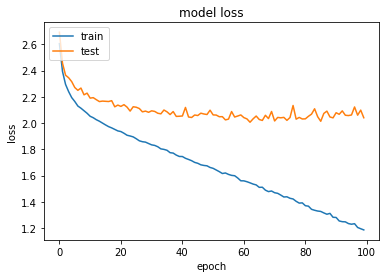

In [35]:
plt.plot(model_history.history['loss'])
plt.plot(model_history.history['val_loss'])
plt.title('model loss')
plt.ylabel('loss')
plt.xlabel('epoch')
plt.legend(['train', 'test'], loc='upper left')
plt.show()

In [36]:
# Save model and weights
model_name = 'Emotion_Model.h5'
save_dir = os.path.join(os.getcwd(), 'saved_models')

if not os.path.isdir(save_dir):
    os.makedirs(save_dir)
model_path = os.path.join(save_dir, model_name)
model.save(model_path)
print('Save model and weights at %s ' % model_path)

# Save the model to disk
model_json = model.to_json()
with open("model_json.json", "w") as json_file:
    json_file.write(model_json)

Save model and weights at C:\Users\RAMBO\Desktop\Speech Emotion Recognition\saved_models\Emotion_Model.h5 


In [37]:
# loading json and model architecture 
json_file = open('model_json.json', 'r')
loaded_model_json = json_file.read()
json_file.close()
loaded_model = model_from_json(loaded_model_json)

# load weights into new model
loaded_model.load_weights("saved_models/Emotion_Model.h5")
print("Loaded model from disk")
 
# Keras optimiser
opt = keras.optimizers.rmsprop(lr=0.00001, decay=1e-6)
loaded_model.compile(loss='categorical_crossentropy', optimizer=opt, metrics=['accuracy'])
score = loaded_model.evaluate(X_test, y_test, verbose=0)
print("%s: %.2f%%" % (loaded_model.metrics_names[1], score[1]*100))

Loaded model from disk
accuracy: 28.58%


In [38]:
preds = loaded_model.predict(X_test, 
                         batch_size=16, 
                         verbose=1)

preds=preds.argmax(axis=1)
preds

2341/2341 [==============================] - 8s 4ms/step


array([ 0,  3,  4, ..., 10, 12, 10], dtype=int64)

In [39]:
# predictions 
preds = preds.astype(int).flatten()
preds = (lb.inverse_transform((preds)))
preds = pd.DataFrame({'predictedvalues': preds})

# Actual labels
actual=y_test.argmax(axis=1)
actual = actual.astype(int).flatten()
actual = (lb.inverse_transform((actual)))
actual = pd.DataFrame({'actualvalues': actual})

# Lets combine both of them into a single dataframe
finaldf = actual.join(preds)
finaldf[170:180]

,actualvalues,predictedvalues
170,female_happy,male_sad
171,male_happy,male_disgust
172,male_neutral,male_neutral
173,male_neutral,male_neutral
174,male_angry,male_angry
175,male_happy,female_angry
176,male_happy,female_happy
177,female_fear,female_fear
178,female_disgust,female_happy
179,female_fear,female_disgust


In [40]:
# Write out the predictions to disk
finaldf.to_csv('Predictions.csv', index=False)
finaldf.groupby('predictedvalues').count()

,actualvalues
predictedvalues,
female_angry,213
female_calm,14
female_disgust,275
female_fear,277
female_happy,264
female_neutral,170
female_sad,148
female_surprise,16
male_angry,133


In [41]:
# the confusion matrix heat map plot
def print_confusion_matrix(confusion_matrix, class_names, figsize = (10,7), fontsize=14):
    """Prints a confusion matrix, as returned by sklearn.metrics.confusion_matrix, as a heatmap.
    
    Arguments
    ---------
    confusion_matrix: numpy.ndarray
        The numpy.ndarray object returned from a call to sklearn.metrics.confusion_matrix. 
        Similarly constructed ndarrays can also be used.
    class_names: list
        An ordered list of class names, in the order they index the given confusion matrix.
    figsize: tuple
        A 2-long tuple, the first value determining the horizontal size of the ouputted figure,
        the second determining the vertical size. Defaults to (10,7).
    fontsize: int
        Font size for axes labels. Defaults to 14.
        
    Returns
    -------
    matplotlib.figure.Figure
        The resulting confusion matrix figure
    """
    df_cm = pd.DataFrame(
        confusion_matrix, index=class_names, columns=class_names, 
    )
    fig = plt.figure(figsize=figsize)
    try:
        heatmap = sns.heatmap(df_cm, annot=True, fmt="d")
    except ValueError:
        raise ValueError("Confusion matrix values must be integers.")
        
    heatmap.yaxis.set_ticklabels(heatmap.yaxis.get_ticklabels(), rotation=0, ha='right', fontsize=fontsize)
    heatmap.xaxis.set_ticklabels(heatmap.xaxis.get_ticklabels(), rotation=45, ha='right', fontsize=fontsize)
    plt.ylabel('True label')
    plt.xlabel('Predicted label')

# Gender recode function
def gender(row):
    if row == 'female_disgust' or 'female_fear' or 'female_happy' or 'female_sad' or 'female_surprise' or 'female_neutral':
        return 'female'
    elif row == 'male_angry' or 'male_fear' or 'male_happy' or 'male_sad' or 'male_surprise' or 'male_neutral' or 'male_disgust':
        return 'male'

0.28577530969671083


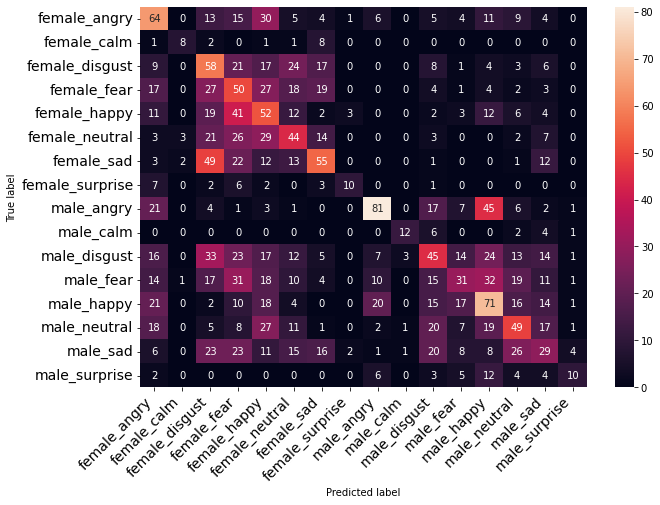

In [42]:
# Get the predictions file 
finaldf = pd.read_csv("Predictions.csv")
classes = finaldf.actualvalues.unique()
classes.sort()    

# Confusion matrix 
c = confusion_matrix(finaldf.actualvalues, finaldf.predictedvalues)
print(accuracy_score(finaldf.actualvalues, finaldf.predictedvalues))
print_confusion_matrix(c, class_names = classes)

In [43]:
# Classification report 
classes = finaldf.actualvalues.unique()
classes.sort()    
print(classification_report(finaldf.actualvalues, finaldf.predictedvalues, target_names=classes))

                 precision    recall  f1-score   support

   female_angry       0.30      0.37      0.33       171
    female_calm       0.57      0.38      0.46        21
 female_disgust       0.21      0.35      0.26       168
    female_fear       0.18      0.29      0.22       172
   female_happy       0.20      0.31      0.24       167
 female_neutral       0.26      0.29      0.27       152
     female_sad       0.37      0.32      0.35       170
female_surprise       0.62      0.32      0.43        31
     male_angry       0.61      0.43      0.50       189
      male_calm       0.71      0.48      0.57        25
   male_disgust       0.27      0.20      0.23       227
      male_fear       0.32      0.14      0.20       214
     male_happy       0.29      0.34      0.31       209
   male_neutral       0.31      0.26      0.28       186
       male_sad       0.22      0.15      0.18       193
  male_surprise       0.50      0.22      0.30        46

       accuracy              

0.7355830841520717


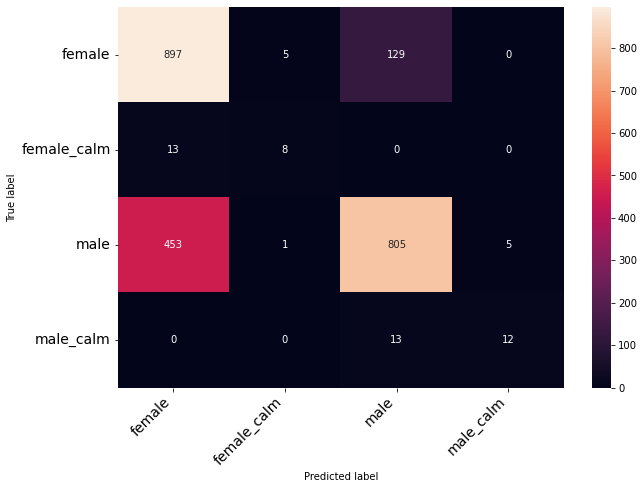

In [44]:
modidf = finaldf
modidf['actualvalues'] = finaldf.actualvalues.replace({'female_angry':'female'
                                       , 'female_disgust':'female'
                                       , 'female_fear':'female'
                                       , 'female_happy':'female'
                                       , 'female_sad':'female'
                                       , 'female_surprise':'female'
                                       , 'female_neutral':'female'
                                       , 'male_angry':'male'
                                       , 'male_fear':'male'
                                       , 'male_happy':'male'
                                       , 'male_sad':'male'
                                       , 'male_surprise':'male'
                                       , 'male_neutral':'male'
                                       , 'male_disgust':'male'
                                      })

modidf['predictedvalues'] = finaldf.predictedvalues.replace({'female_angry':'female'
                                       , 'female_disgust':'female'
                                       , 'female_fear':'female'
                                       , 'female_happy':'female'
                                       , 'female_sad':'female'
                                       , 'female_surprise':'female'
                                       , 'female_neutral':'female'
                                       , 'male_angry':'male'
                                       , 'male_fear':'male'
                                       , 'male_happy':'male'
                                       , 'male_sad':'male'
                                       , 'male_surprise':'male'
                                       , 'male_neutral':'male'
                                       , 'male_disgust':'male'
                                      })

classes = modidf.actualvalues.unique()  
classes.sort() 

# Confusion matrix 
c = confusion_matrix(modidf.actualvalues, modidf.predictedvalues)
print(accuracy_score(modidf.actualvalues, modidf.predictedvalues))
print_confusion_matrix(c, class_names = classes)

In [45]:
# Classification report 
classes = modidf.actualvalues.unique()
classes.sort()    
print(classification_report(modidf.actualvalues, modidf.predictedvalues, target_names=classes))

              precision    recall  f1-score   support

      female       0.66      0.87      0.75      1031
 female_calm       0.57      0.38      0.46        21
        male       0.85      0.64      0.73      1264
   male_calm       0.71      0.48      0.57        25

    accuracy                           0.74      2341
   macro avg       0.70      0.59      0.63      2341
weighted avg       0.76      0.74      0.73      2341



0.3588210166595472


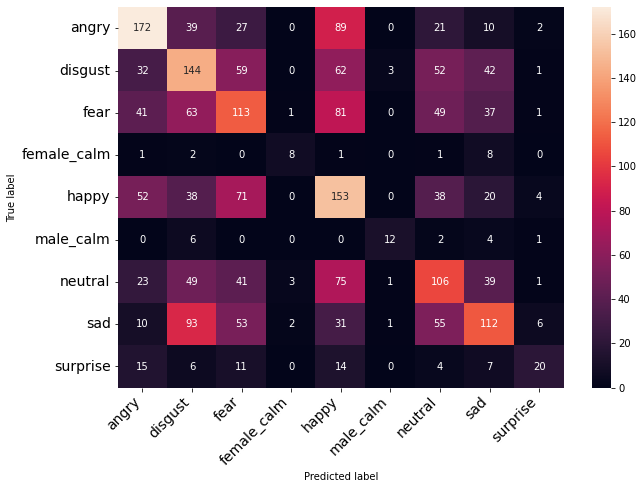

In [46]:
modidf = pd.read_csv("Predictions.csv")
modidf['actualvalues'] = modidf.actualvalues.replace({'female_angry':'angry'
                                       , 'female_disgust':'disgust'
                                       , 'female_fear':'fear'
                                       , 'female_happy':'happy'
                                       , 'female_sad':'sad'
                                       , 'female_surprise':'surprise'
                                       , 'female_neutral':'neutral'
                                       , 'male_angry':'angry'
                                       , 'male_fear':'fear'
                                       , 'male_happy':'happy'
                                       , 'male_sad':'sad'
                                       , 'male_surprise':'surprise'
                                       , 'male_neutral':'neutral'
                                       , 'male_disgust':'disgust'
                                      })

modidf['predictedvalues'] = modidf.predictedvalues.replace({'female_angry':'angry'
                                       , 'female_disgust':'disgust'
                                       , 'female_fear':'fear'
                                       , 'female_happy':'happy'
                                       , 'female_sad':'sad'
                                       , 'female_surprise':'surprise'
                                       , 'female_neutral':'neutral'
                                       , 'male_angry':'angry'
                                       , 'male_fear':'fear'
                                       , 'male_happy':'happy'
                                       , 'male_sad':'sad'
                                       , 'male_surprise':'surprise'
                                       , 'male_neutral':'neutral'
                                       , 'male_disgust':'disgust'
                                      })

classes = modidf.actualvalues.unique() 
classes.sort() 

# Confusion matrix 
c = confusion_matrix(modidf.actualvalues, modidf.predictedvalues)
print(accuracy_score(modidf.actualvalues, modidf.predictedvalues))
print_confusion_matrix(c, class_names = classes)

In [47]:
# Classification report 
classes = modidf.actualvalues.unique()
classes.sort()    
print(classification_report(modidf.actualvalues, modidf.predictedvalues, target_names=classes))

              precision    recall  f1-score   support

       angry       0.50      0.48      0.49       360
     disgust       0.33      0.36      0.34       395
        fear       0.30      0.29      0.30       386
 female_calm       0.57      0.38      0.46        21
       happy       0.30      0.41      0.35       376
   male_calm       0.71      0.48      0.57        25
     neutral       0.32      0.31      0.32       338
         sad       0.40      0.31      0.35       363
    surprise       0.56      0.26      0.35        77

    accuracy                           0.36      2341
   macro avg       0.44      0.36      0.39      2341
weighted avg       0.37      0.36      0.36      2341



In [48]:
data, sampling_rate = librosa.load('kill.wav')
ipd.Audio('kill.wav')

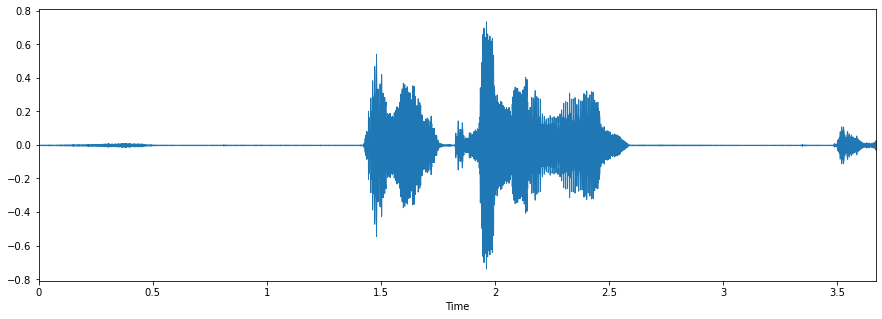

In [49]:
plt.figure(figsize=(15, 5))
librosa.display.waveplot(data, sr=sampling_rate)

In [50]:
# loading json and model architecture
json_file = open('C:\\Users\\RAMBO\\Desktop\\Speech Emotion Recognition\\model_json.json', 'r')
loaded_model_json = json_file.read()
json_file.close()
loaded_model = model_from_json(loaded_model_json)

# load weights into new model
loaded_model.load_weights("C:\\Users\\RAMBO\\Desktop\\Speech Emotion Recognition\\saved_models\\Emotion_Model.h5")
print("Loaded model from disk")

# the optimiser
opt = keras.optimizers.rmsprop(lr=0.00001, decay=1e-6)
loaded_model.compile(loss='categorical_crossentropy', optimizer=opt, metrics=['accuracy'])

Loaded model from disk


In [51]:
# Lets transform the dataset so we can apply the predictions

X, sample_rate = librosa.load('kill.wav'
                              ,res_type='kaiser_fast'
                              ,duration=2.5
                              ,sr=44100
                              ,offset=0.5
                             )

sample_rate = np.array(sample_rate)
mfccs = np.mean(librosa.feature.mfcc(y=X, sr=sample_rate, n_mfcc=13),axis=0)
newdf = pd.DataFrame(data=mfccs).T
newdf

,0,1,2,3,4,5,6,7,8,9,...,206,207,208,209,210,211,212,213,214,215
0,-30.976103,-31.770916,-35.768505,-36.097099,-33.866589,-34.276115,-35.767864,-35.144478,-35.548435,-36.161861,...,-32.645489,-32.053917,-33.356239,-33.515907,-35.810856,-34.83382,-35.359333,-35.765282,-35.804611,-34.513851


In [52]:
# Apply predictions
newdf= np.expand_dims(newdf, axis=2)
newpred = loaded_model.predict(newdf, 
                         batch_size=16, 
                         verbose=1)

newpred

1/1 [==============================] - 0s 89ms/step


array([[6.6272012e-35, 2.1370682e-34, 1.7741442e-37, 0.0000000e+00,
        5.1941188e-34, 4.0569233e-29, 0.0000000e+00, 2.5987374e-12,
        3.0496716e-18, 4.3172207e-07, 9.9999940e-01, 2.3801447e-13,
        1.2385709e-15, 9.0423462e-08, 1.1753369e-09, 3.7013194e-21]],
      dtype=float32)

In [53]:

filename = 'C:\\Users\\RAMBO\\Desktop\\Speech Emotion Recognition\\labels'
infile = open(filename,'rb')
lb = pickle.load(infile)
infile.close()

# Get the final predicted label
final = newpred.argmax(axis=1)
final = final.astype(int).flatten()
final = (lb.inverse_transform((final)))
print(final) #emo(final) #gender(final) 

['male_disgust']


## Augmentation

In [54]:
#########################
# Augmentation methods
#########################
def noise(data):
    """
    Adding White Noise.
    """
    noise_amp = 0.05*np.random.uniform()*np.amax(data)   # more noise reduce the value to 0.5
    data = data.astype('float64') + noise_amp * np.random.normal(size=data.shape[0])
    return data
    
def shift(data):
    """
    Random Shifting.
    """
    s_range = int(np.random.uniform(low=-5, high = 5)*1000)  #default at 500
    return np.roll(data, s_range)
    
def stretch(data, rate=0.8):
    """
    Streching the Sound. this expands the dataset slightly
    """
    data = librosa.effects.time_stretch(data, rate)
    return data
    
def pitch(data, sample_rate):
    """
    Pitch Tuning.
    """
    bins_per_octave = 12
    pitch_pm = 2
    pitch_change =  pitch_pm * 2*(np.random.uniform())   
    data = librosa.effects.pitch_shift(data.astype('float64'), 
                                      sample_rate, n_steps=pitch_change, 
                                      bins_per_octave=bins_per_octave)
    return data
    
def dyn_change(data):
    """
    Random Value Change.
    """
    dyn_change = np.random.uniform(low=-0.5 ,high=7)  # default low = 1.5, high = 3
    return (data * dyn_change)
    
def speedNpitch(data):
    """
    peed and Pitch Tuning.
    """
    # low and high here
    length_change = np.random.uniform(low=0.8, high = 1)
    speed_fac = 1.2  / length_change # try changing 1.0 to 2.0 
    tmp = np.interp(np.arange(0,len(data),speed_fac),np.arange(0,len(data)),data)
    minlen = min(data.shape[0], tmp.shape[0])
    data *= 0
    data[0:minlen] = tmp[0:minlen]
    return data

####################################
# the confusion matrix heat map plot
####################################
def print_confusion_matrix(confusion_matrix, class_names, figsize = (10,7), fontsize=14):
    """Prints a confusion matrix, as returned by sklearn.metrics.confusion_matrix, as a heatmap.
    
    Arguments
    ---------
    confusion_matrix: numpy.ndarray
        The numpy.ndarray object returned from a call to sklearn.metrics.confusion_matrix. 
        Similarly constructed ndarrays can also be used.
    class_names: list
        An ordered list of class names, in the order they index the given confusion matrix.
    figsize: tuple
        A 2-long tuple, the first value determining the horizontal size of the ouputted figure,
        the second determining the vertical size. Defaults to (10,7).
    fontsize: int
        Font size for axes labels. Defaults to 14.
        
    Returns
    -------
    matplotlib.figure.Figure
        The resulting confusion matrix figure
    """
    df_cm = pd.DataFrame(
        confusion_matrix, index=class_names, columns=class_names, 
    )
    fig = plt.figure(figsize=figsize)
    try:
        heatmap = sns.heatmap(df_cm, annot=True, fmt="d")
    except ValueError:
        raise ValueError("Confusion matrix values must be integers.")
        
    heatmap.yaxis.set_ticklabels(heatmap.yaxis.get_ticklabels(), rotation=0, ha='right', fontsize=fontsize)
    heatmap.xaxis.set_ticklabels(heatmap.xaxis.get_ticklabels(), rotation=45, ha='right', fontsize=fontsize)
    plt.ylabel('True label')
    plt.xlabel('Predicted label')

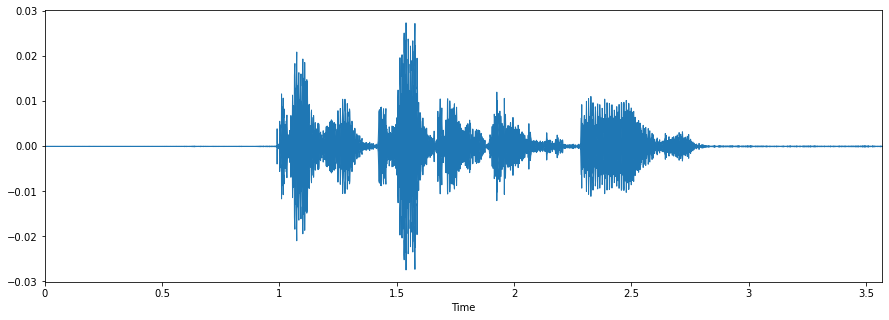

In [55]:
# Use one audio file in previous parts again
fname = 'C:\\Ravdes\\RAVDESS\\audio_speech_actors_01-24\\Actor_09\\03-01-05-01-01-01-09.wav'  
data, sampling_rate = librosa.load(fname)
plt.figure(figsize=(15, 5))
librosa.display.waveplot(data, sr=sampling_rate)

# Paly it again to refresh our memory
ipd.Audio(data, rate=sampling_rate)

### static noise

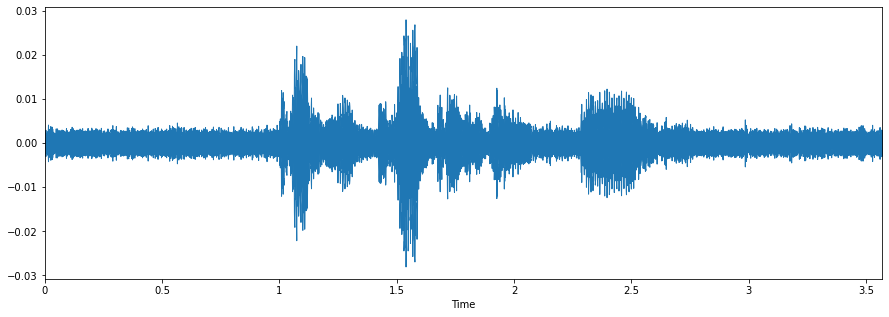

In [56]:
x = noise(data)
plt.figure(figsize=(15, 5))
librosa.display.waveplot(x, sr=sampling_rate)
ipd.Audio(x, rate=sampling_rate)

## shift

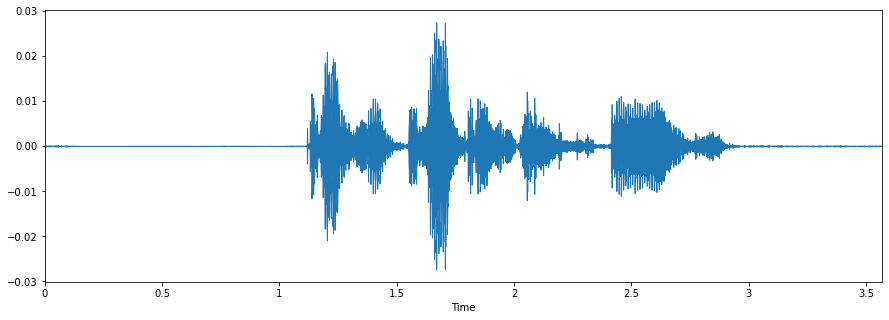

In [57]:
x = shift(data)
plt.figure(figsize=(15, 5))
librosa.display.waveplot(x, sr=sampling_rate)
ipd.Audio(x, rate=sampling_rate)

## strectch

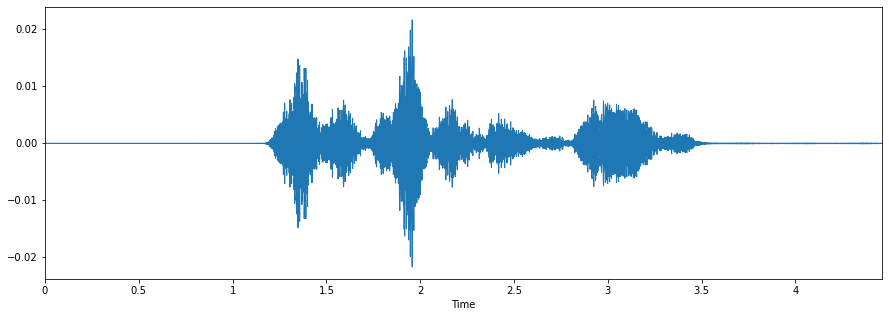

In [58]:
x = stretch(data)
plt.figure(figsize=(15, 5))
librosa.display.waveplot(x, sr=sampling_rate)
ipd.Audio(x, rate=sampling_rate)

## pitch

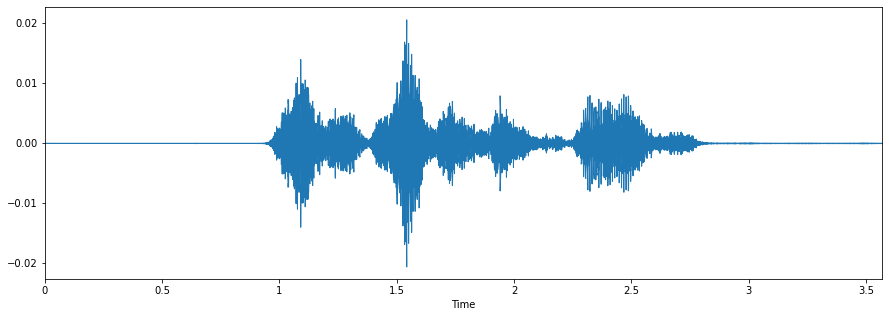

In [59]:
x = pitch(data, sampling_rate)
plt.figure(figsize=(15, 5))
librosa.display.waveplot(x, sr=sampling_rate)
ipd.Audio(x, rate=sampling_rate)

## dynamic change

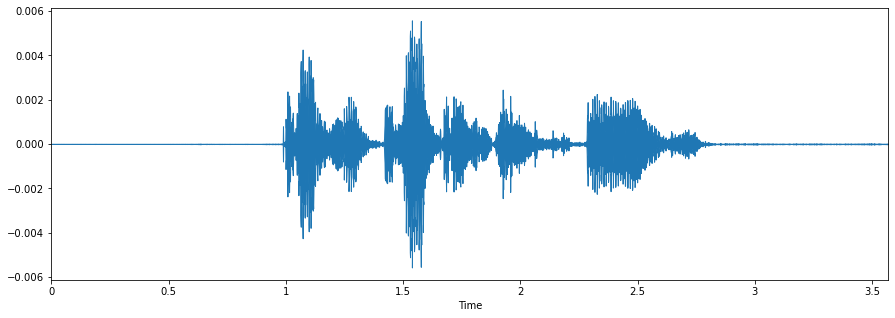

In [60]:
x = dyn_change(data)
plt.figure(figsize=(15, 5))
librosa.display.waveplot(x, sr=sampling_rate)
ipd.Audio(x, rate=sampling_rate)

## speed and pitch

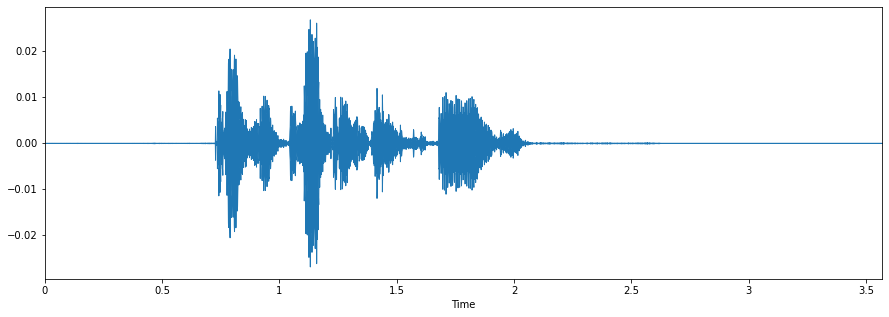

In [61]:
x = speedNpitch(data)
plt.figure(figsize=(15, 5))
librosa.display.waveplot(x, sr=sampling_rate)
ipd.Audio(x, rate=sampling_rate)

In [62]:
# pick up the meta-data l

ref = pd.read_csv("C:\\SaveMyLife.csv")

ref.head()

,labels,source,path
0,male_angry,SAVEE,C:\SAVEE\ALL\DC_a01.wav
1,male_angry,SAVEE,C:\SAVEE\ALL\DC_a02.wav
2,male_angry,SAVEE,C:\SAVEE\ALL\DC_a03.wav
3,male_angry,SAVEE,C:\SAVEE\ALL\DC_a04.wav
4,male_angry,SAVEE,C:\SAVEE\ALL\DC_a05.wav


In [63]:
from tqdm import tqdm

In [64]:
# iterating over 4 datasets, and with augmentation  
df = pd.DataFrame(columns=['feature'])
df_noise = pd.DataFrame(columns=['feature'])
df_speedpitch = pd.DataFrame(columns=['feature'])
df_shift = pd.DataFrame(columns=['feature'])
df_stretch = pd.DataFrame(columns=['feature'])
df_dynamic = pd.DataFrame(columns=['feature'])
cnt = 0

# loop feature extraction over the entire dataset
for i in tqdm(ref.path):
    
    # first load the audio 
    X, sample_rate = librosa.load(i
                                  , res_type='kaiser_fast'
                                  ,duration=2.5
                                  ,sr=sample_rate
                                  ,offset=0.5
                                 )

    # take mfcc and mean as the feature. Could do min and max etc as well. 
    mfccs = np.mean(librosa.feature.mfcc(y=X, 
                                        sr=np.array(sample_rate), 
                                        n_mfcc=13),
                    axis=0)
    
    df.loc[cnt] = [mfccs]   

    # random shifting (omit for now)
    # Stretch
    # pitch (omit for now)
    # dyn change
    
    # noise 
    aug = noise(X)
    aug = np.mean(librosa.feature.mfcc(y=aug, 
                                    sr=np.array(sample_rate), 
                                    n_mfcc=13),    
                  axis=0)
    df_noise.loc[cnt] = [aug]
    
  

    # speed pitch
    aug = speedNpitch(X)
    aug = np.mean(librosa.feature.mfcc(y=aug, 
                                    sr=np.array(sample_rate), 
                                    n_mfcc=13),    
                  axis=0)
    df_speedpitch.loc[cnt] = [aug]   

    cnt += 1

df.head()

100%|██████████████████████████████████████████████████████████████████████████████| 9362/9362 [14:52<00:00, 10.49it/s]


,feature
0,"[-11.113932, -7.215756, -6.21919, -5.9265423, ..."
1,"[-24.44983, -22.465742, -22.928043, -23.243807..."
2,"[-25.000114, -24.520256, -24.178183, -23.84745..."
3,"[-1.5298388, -4.333437, -12.285238, -13.083024..."
4,"[-22.458632, -22.467833, -25.884357, -27.82704..."


# 2D CNN


In [65]:
'''
1. Data Augmentation method   
'''
def speedNpitch(data):
    """
    Speed and Pitch Tuning.
    """
    # low and high
    length_change = np.random.uniform(low=0.8, high = 1)
    speed_fac = 1.2  / length_change # 1 to 2
    tmp = np.interp(np.arange(0,len(data),speed_fac),np.arange(0,len(data)),data)
    minlen = min(data.shape[0], tmp.shape[0])
    data *= 0
    data[0:minlen] = tmp[0:minlen]
    return data

'''
2. Extracting the MFCC feature as an image (Matrix format).  
'''
def prepare_data(df, n, aug, mfcc):
    X = np.empty(shape=(df.shape[0], n, 216, 1))
    input_length = sampling_rate * audio_duration
    
    cnt = 0
    for fname in tqdm(df.path):
        file_path = fname
        data, _ = librosa.load(file_path, sr=sampling_rate
                               ,res_type="kaiser_fast"
                               ,duration=2.5
                               ,offset=0.5
                              )

        # Random offset / Padding
        if len(data) > input_length:
            max_offset = len(data) - input_length
            offset = np.random.randint(max_offset)
            data = data[offset:(input_length+offset)]
        else:
            if input_length > len(data):
                max_offset = input_length - len(data)
                offset = np.random.randint(max_offset)
            else:
                offset = 0
            data = np.pad(data, (offset, int(input_length) - len(data) - offset), "constant")

        # Augmentation? 
        if aug == 1:
            data = speedNpitch(data)
        
        # which feature?
        if mfcc == 1:
            # MFCC extraction 
            MFCC = librosa.feature.mfcc(data, sr=sampling_rate, n_mfcc=n_mfcc)
            MFCC = np.expand_dims(MFCC, axis=-1)
            X[cnt,] = MFCC
            
        else:
            # Log-melspectogram
            melspec = librosa.feature.melspectrogram(data, n_mels = n_melspec)   
            logspec = librosa.amplitude_to_db(melspec)
            logspec = np.expand_dims(logspec, axis=-1)
            X[cnt,] = logspec
            
        cnt += 1
    
    return X


'''
3. Confusion matrix plot 
'''        
def print_confusion_matrix(confusion_matrix, class_names, figsize = (10,7), fontsize=14):
    '''Prints a confusion matrix, as returned by sklearn.metrics.confusion_matrix, as a heatmap.

    Arguments
    ---------
    confusion_matrix: numpy.ndarray
        The numpy.ndarray object returned from a call to sklearn.metrics.confusion_matrix. 
        Similarly constructed ndarrays can also be used.
    class_names: list
        An ordered list of class names, in the order they index the given confusion matrix.
    figsize: tuple
        A 2-long tuple, the first value determining the horizontal size of the ouputted figure,
        the second determining the vertical size. Defaults to (10,7).
    fontsize: int
        Font size for axes labels. Defaults to 14.

    Returns
    -------
    matplotlib.figure.Figure
        The resulting confusion matrix figure
    '''
    df_cm = pd.DataFrame(
        confusion_matrix, index=class_names, columns=class_names, 
    )
    fig = plt.figure(figsize=figsize)
    try:
        heatmap = sns.heatmap(df_cm, annot=True, fmt="d")
    except ValueError:
        raise ValueError("Confusion matrix values must be integers.")

    heatmap.yaxis.set_ticklabels(heatmap.yaxis.get_ticklabels(), rotation=0, ha='right', fontsize=fontsize)
    heatmap.xaxis.set_ticklabels(heatmap.xaxis.get_ticklabels(), rotation=45, ha='right', fontsize=fontsize)
    plt.ylabel('True label')
    plt.xlabel('Predicted label')

    
    
'''
# 4. Create the 2D CNN model 
'''
def get_2d_conv_model(n):
    ''' Create a standard deep 2D convolutional neural network'''
    nclass = 16
    inp = Input(shape=(n,216,1))  #2D matrix of 30 MFCC bands by 216 audio length.
    x = Convolution2D(32, (4,10), padding="same")(inp)
    x = BatchNormalization()(x)
    x = Activation("relu")(x)
    x = MaxPool2D()(x)
    x = Dropout(rate=0.2)(x)
    
    x = Convolution2D(32, (4,10), padding="same")(x)
    x = BatchNormalization()(x)
    x = Activation("relu")(x)
    x = MaxPool2D()(x)
    x = Dropout(rate=0.2)(x)
    
    x = Convolution2D(32, (4,10), padding="same")(x)
    x = BatchNormalization()(x)
    x = Activation("relu")(x)
    x = MaxPool2D()(x)
    x = Dropout(rate=0.2)(x)
    
    x = Convolution2D(32, (4,10), padding="same")(x)
    x = BatchNormalization()(x)
    x = Activation("relu")(x)
    x = MaxPool2D()(x)
    x = Dropout(rate=0.2)(x)
    
    x = Flatten()(x)
    x = Dense(64)(x)
    x = Dropout(rate=0.2)(x)
    x = BatchNormalization()(x)
    x = Activation("relu")(x)
    x = Dropout(rate=0.2)(x)
    
    out = Dense(nclass, activation=softmax)(x)
    model = models.Model(inputs=inp, outputs=out)
    
    opt = optimizers.Adam(0.001)
    model.compile(optimizer=opt, loss=losses.categorical_crossentropy, metrics=['acc'])
    return model

'''
# 5. Other functions 
'''
class get_results:
    '''
        1) MFCC with no augmentation  
        2) MFCC with augmentation 
        3) Logmelspec with no augmentation 
        4) Logmelspec with augmentation
    '''
    
    def __init__(self, model_history, model ,X_test, y_test, labels):
        self.model_history = model_history
        self.model = model
        self.X_test = X_test
        self.y_test = y_test             
        self.labels = labels

    def create_plot(self, model_history):
        plt.plot(model_history.history['loss'])
        plt.plot(model_history.history['val_loss'])
        plt.title('model loss')
        plt.ylabel('loss')
        plt.xlabel('epoch')
        plt.legend(['train', 'test'], loc='upper left')
        plt.show()

    def create_results(self, model):
        '''predict on test set and get accuracy results'''
        opt = optimizers.Adam(0.001)
        model.compile(loss='categorical_crossentropy', optimizer=opt, metrics=['accuracy'])
        score = model.evaluate(X_test, y_test, verbose=0)
        print("%s: %.2f%%" % (model.metrics_names[1], score[1]*100))

    def confusion_results(self, X_test, y_test, labels, model):
        '''plot confusion matrix results'''
        preds = model.predict(X_test, 
                                 batch_size=16, 
                                 verbose=2)
        preds=preds.argmax(axis=1)
        preds = preds.astype(int).flatten()
        preds = (lb.inverse_transform((preds)))

        actual = y_test.argmax(axis=1)
        actual = actual.astype(int).flatten()
        actual = (lb.inverse_transform((actual)))

        classes = labels
        classes.sort()    

        c = confusion_matrix(actual, preds)
        print_confusion_matrix(c, class_names = classes)
    
    def accuracy_results_gender(self, X_test, y_test, labels, model):
        '''Print out the accuracy score and confusion matrix heat map of the Gender classification results'''
    
        preds = model.predict(X_test, 
                         batch_size=16, 
                         verbose=2)
        preds=preds.argmax(axis=1)
        preds = preds.astype(int).flatten()
        preds = (lb.inverse_transform((preds)))

        actual = y_test.argmax(axis=1)
        actual = actual.astype(int).flatten()
        actual = (lb.inverse_transform((actual)))
        
        # print(accuracy_score(actual, preds))
        
        actual = pd.DataFrame(actual).replace({'female_angry':'female'
                   , 'female_disgust':'female'
                   , 'female_fear':'female'
                   , 'female_happy':'female'
                   , 'female_sad':'female'
                   , 'female_surprise':'female'
                   , 'female_neutral':'female'
                   , 'male_angry':'male'
                   , 'male_fear':'male'
                   , 'male_happy':'male'
                   , 'male_sad':'male'
                   , 'male_surprise':'male'
                   , 'male_neutral':'male'
                   , 'male_disgust':'male'
                  })
        preds = pd.DataFrame(preds).replace({'female_angry':'female'
               , 'female_disgust':'female'
               , 'female_fear':'female'
               , 'female_happy':'female'
               , 'female_sad':'female'
               , 'female_surprise':'female'
               , 'female_neutral':'female'
               , 'male_angry':'male'
               , 'male_fear':'male'
               , 'male_happy':'male'
               , 'male_sad':'male'
               , 'male_surprise':'male'
               , 'male_neutral':'male'
               , 'male_disgust':'male'
              })

        classes = actual.loc[:,0].unique() 
        classes.sort()    

        c = confusion_matrix(actual, preds)
        print(accuracy_score(actual, preds))
        print_confusion_matrix(c, class_names = classes)

In [66]:
ref = pd.read_csv("C:\\SaveMyLife.csv")
ref.head()

,labels,source,path
0,male_angry,SAVEE,C:\SAVEE\ALL\DC_a01.wav
1,male_angry,SAVEE,C:\SAVEE\ALL\DC_a02.wav
2,male_angry,SAVEE,C:\SAVEE\ALL\DC_a03.wav
3,male_angry,SAVEE,C:\SAVEE\ALL\DC_a04.wav
4,male_angry,SAVEE,C:\SAVEE\ALL\DC_a05.wav


In [67]:
sampling_rate=44100
audio_duration=2.5
n_mfcc = 30
mfcc = prepare_data(ref, n = n_mfcc, aug = 0, mfcc = 1)

100%|██████████████████████████████████████████████████████████████████████████████| 9362/9362 [07:00<00:00, 22.25it/s]


In [68]:
# Keras
import keras
from keras import regularizers
from keras.preprocessing import sequence
from keras.preprocessing.text import Tokenizer
from keras.preprocessing.sequence import pad_sequences
from keras.models import Sequential, Model, model_from_json
from keras.layers import Dense, Embedding, LSTM
from keras.layers import Input, Flatten, Dropout, Activation, BatchNormalization
from keras.layers import Conv1D, MaxPooling1D, AveragePooling1D
from keras.utils import np_utils, to_categorical
from keras.callbacks import (EarlyStopping, LearningRateScheduler,
                             ModelCheckpoint, TensorBoard, ReduceLROnPlateau)
from keras import losses, models, optimizers
from keras.activations import relu, softmax
from keras.layers import (Convolution2D, GlobalAveragePooling2D, BatchNormalization, Flatten, Dropout,
                          GlobalMaxPool2D, MaxPool2D, concatenate, Activation, Input, Dense)

# sklearn
from sklearn.metrics import confusion_matrix, accuracy_score
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import LabelEncoder

# MFCC without Augmentation

In [69]:
# Split between train and test 
X_train, X_test, y_train, y_test = train_test_split(mfcc
                                                    , ref.labels
                                                    , test_size=0.25
                                                    , shuffle=True
                                                    , random_state=42
                                                   )


# one hot encode the target 
lb = LabelEncoder()
y_train = np_utils.to_categorical(lb.fit_transform(y_train))
y_test = np_utils.to_categorical(lb.fit_transform(y_test))

# Normalization as per the standard NN process
mean = np.mean(X_train, axis=0)
std = np.std(X_train, axis=0)

X_train = (X_train - mean)/std
X_test = (X_test - mean)/std

# Build CNN model 
model = get_2d_conv_model(n=n_mfcc)
model_history = model.fit(X_train, y_train, validation_data=(X_test, y_test), 
                    batch_size=16, verbose = 2, epochs=20)

Train on 7021 samples, validate on 2341 samples
Epoch 1/20
 - 150s - loss: 2.4475 - acc: 0.1864 - val_loss: 2.0475 - val_acc: 0.2977
Epoch 2/20
 - 153s - loss: 1.9669 - acc: 0.3076 - val_loss: 1.7259 - val_acc: 0.3704
Epoch 3/20
 - 156s - loss: 1.8000 - acc: 0.3561 - val_loss: 1.6755 - val_acc: 0.3721
Epoch 4/20
 - 156s - loss: 1.6880 - acc: 0.3900 - val_loss: 1.5487 - val_acc: 0.4280
Epoch 5/20
 - 153s - loss: 1.6102 - acc: 0.4106 - val_loss: 1.6267 - val_acc: 0.3960
Epoch 6/20
 - 155s - loss: 1.5656 - acc: 0.4287 - val_loss: 1.5900 - val_acc: 0.4212
Epoch 7/20
 - 153s - loss: 1.5000 - acc: 0.4459 - val_loss: 1.4102 - val_acc: 0.4656
Epoch 8/20
 - 152s - loss: 1.4504 - acc: 0.4750 - val_loss: 1.6451 - val_acc: 0.4079
Epoch 9/20
 - 153s - loss: 1.4062 - acc: 0.4848 - val_loss: 1.4539 - val_acc: 0.4562
Epoch 10/20
 - 150s - loss: 1.3795 - acc: 0.4968 - val_loss: 1.3971 - val_acc: 0.4874
Epoch 11/20
 - 150s - loss: 1.3348 - acc: 0.5126 - val_loss: 1.3303 - val_acc: 0.4942
Epoch 12/20
 - 

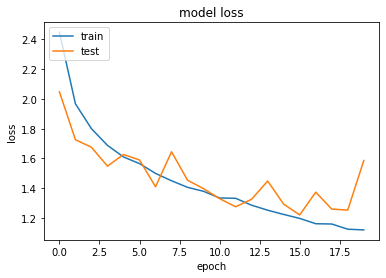

accuracy: 42.76%


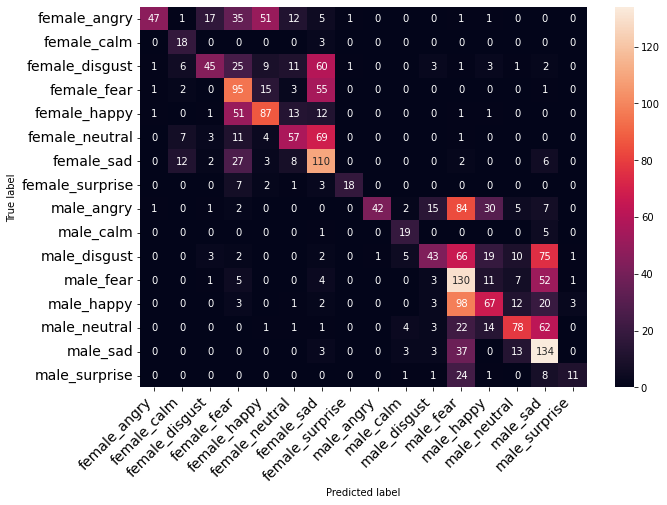

In [70]:
results = get_results(model_history,model,X_test,y_test, ref.labels.unique())
results.create_plot(model_history)
results.create_results(model)
results.confusion_results(X_test, y_test, ref.labels.unique(), model)

#  MFCC with Augmentation

In [71]:
sampling_rate=44100
audio_duration=2.5
n_mfcc = 30
mfcc_aug = prepare_data(ref, n = n_mfcc, aug = 1, mfcc = 1)

100%|██████████████████████████████████████████████████████████████████████████████| 9362/9362 [07:40<00:00, 20.31it/s]


In [72]:
# Split between train and test 
X_train, X_test, y_train, y_test = train_test_split(mfcc_aug
                                                    , ref.labels
                                                    , test_size=0.25
                                                    , shuffle=True
                                                    , random_state=42
                                                   )

# one hot encode the target 
lb = LabelEncoder()
y_train = np_utils.to_categorical(lb.fit_transform(y_train))
y_test = np_utils.to_categorical(lb.fit_transform(y_test))

# Normalization as per the standard NN process
# mean = np.mean(X_train, axis=0)
# std = np.std(X_train, axis=0)

# X_train = (X_train - mean)/std
# X_test = (X_test - mean)/std

# Build CNN model 
model = get_2d_conv_model(n=n_mfcc)
model_history = model.fit(X_train, y_train, validation_data=(X_test, y_test), 
                    batch_size=16, verbose = 2, epochs=20)

Train on 7021 samples, validate on 2341 samples
Epoch 1/20
 - 154s - loss: 2.5811 - acc: 0.1585 - val_loss: 2.5384 - val_acc: 0.1448
Epoch 2/20
 - 153s - loss: 2.1174 - acc: 0.2541 - val_loss: 2.0587 - val_acc: 0.2836
Epoch 3/20
 - 151s - loss: 1.9286 - acc: 0.3054 - val_loss: 1.8083 - val_acc: 0.3251
Epoch 4/20
 - 154s - loss: 1.8445 - acc: 0.3215 - val_loss: 1.7464 - val_acc: 0.3699
Epoch 5/20
 - 151s - loss: 1.7680 - acc: 0.3504 - val_loss: 1.7025 - val_acc: 0.3665
Epoch 6/20
 - 150s - loss: 1.6930 - acc: 0.3890 - val_loss: 1.6703 - val_acc: 0.3759
Epoch 7/20
 - 153s - loss: 1.6337 - acc: 0.4025 - val_loss: 1.5650 - val_acc: 0.4122
Epoch 8/20
 - 149s - loss: 1.5932 - acc: 0.4155 - val_loss: 1.5166 - val_acc: 0.4314
Epoch 9/20
 - 151s - loss: 1.5545 - acc: 0.4403 - val_loss: 1.5435 - val_acc: 0.4242
Epoch 10/20
 - 151s - loss: 1.5128 - acc: 0.4478 - val_loss: 1.5356 - val_acc: 0.4229
Epoch 11/20
 - 154s - loss: 1.4926 - acc: 0.4619 - val_loss: 1.4078 - val_acc: 0.4630
Epoch 12/20
 - 

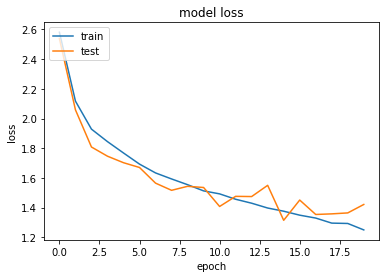

accuracy: 48.91%


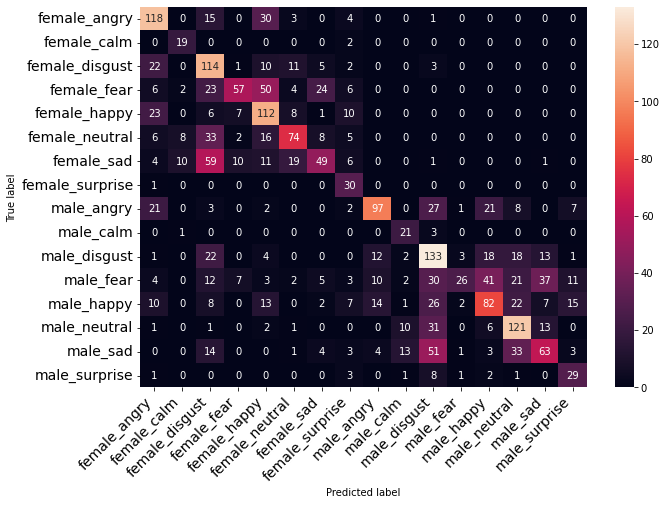

In [73]:
results = get_results(model_history,model,X_test,y_test, ref.labels.unique())
results.create_plot(model_history)
results.create_results(model)
results.confusion_results(X_test, y_test, ref.labels.unique(), model)

# Log-melspectogram without augmentation

In [74]:
sampling_rate=44100
audio_duration=2.5
n_melspec = 60
specgram = prepare_data(ref, n = n_melspec, aug = 0, mfcc = 0)

100%|██████████████████████████████████████████████████████████████████████████████| 9362/9362 [06:29<00:00, 24.03it/s]


In [75]:
# Split between train and test 
X_train, X_test, y_train, y_test = train_test_split(specgram
                                                    , ref.labels
                                                    , test_size=0.25
                                                    , shuffle=True
                                                    , random_state=42
                                                   )



# one hot encode the target 
lb = LabelEncoder()
y_train = np_utils.to_categorical(lb.fit_transform(y_train))
y_test = np_utils.to_categorical(lb.fit_transform(y_test))

# Normalization as per the standard NN process
mean = np.mean(X_train, axis=0)
std = np.std(X_train, axis=0)

X_train = (X_train - mean)/std
X_test = (X_test - mean)/std

# Build CNN model 
model = get_2d_conv_model(n=n_melspec)
model_history = model.fit(X_train, y_train, validation_data=(X_test, y_test), 
                    batch_size=16, verbose = 2, epochs=20)

Train on 7021 samples, validate on 2341 samples
Epoch 1/20
 - 311s - loss: 2.4562 - acc: 0.1772 - val_loss: 2.6374 - val_acc: 0.1277
Epoch 2/20
 - 331s - loss: 2.1573 - acc: 0.2589 - val_loss: 2.0034 - val_acc: 0.2960
Epoch 3/20
 - 310s - loss: 1.9753 - acc: 0.3024 - val_loss: 1.8974 - val_acc: 0.3118
Epoch 4/20
 - 341s - loss: 1.8201 - acc: 0.3477 - val_loss: 1.7145 - val_acc: 0.3622
Epoch 5/20
 - 320s - loss: 1.7376 - acc: 0.3673 - val_loss: 1.9809 - val_acc: 0.2960
Epoch 6/20
 - 315s - loss: 1.6523 - acc: 0.3954 - val_loss: 1.7410 - val_acc: 0.3592
Epoch 7/20
 - 322s - loss: 1.5928 - acc: 0.4227 - val_loss: 1.5921 - val_acc: 0.4015
Epoch 8/20
 - 320s - loss: 1.5552 - acc: 0.4290 - val_loss: 1.5214 - val_acc: 0.4421
Epoch 9/20
 - 323s - loss: 1.4941 - acc: 0.4562 - val_loss: 1.5163 - val_acc: 0.4331
Epoch 10/20
 - 323s - loss: 1.4643 - acc: 0.4679 - val_loss: 1.4062 - val_acc: 0.4682
Epoch 11/20
 - 335s - loss: 1.4275 - acc: 0.4740 - val_loss: 1.4106 - val_acc: 0.4648
Epoch 12/20
 - 

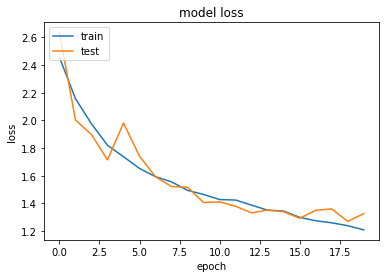

accuracy: 50.36%


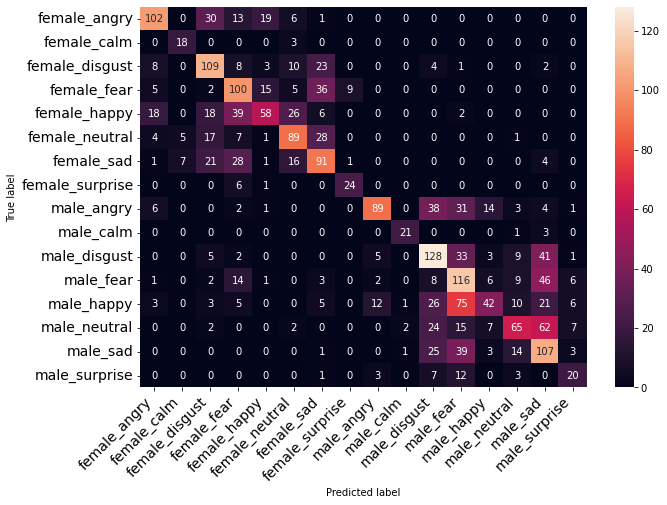

In [76]:
results = get_results(model_history,model,X_test,y_test, ref.labels.unique())
results.create_plot(model_history)
results.create_results(model)
results.confusion_results(X_test, y_test, ref.labels.unique(), model)

# Log-melspectogram with augmentation

In [77]:
sampling_rate=44100
audio_duration=2.5
n_melspec = 60
aug_specgram = prepare_data(ref,  n = n_melspec, aug = 1, mfcc = 0)

100%|██████████████████████████████████████████████████████████████████████████████| 9362/9362 [07:01<00:00, 22.20it/s]


In [78]:
# Split between train and test 
X_train, X_test, y_train, y_test = train_test_split(aug_specgram
                                                    , ref.labels
                                                    , test_size=0.25
                                                    , shuffle=True
                                                    , random_state=42
                                                   )



# one hot encode the target 
lb = LabelEncoder()
y_train = np_utils.to_categorical(lb.fit_transform(y_train))
y_test = np_utils.to_categorical(lb.fit_transform(y_test))

# Normalization as per the standard NN process
mean = np.mean(X_train, axis=0)
std = np.std(X_train, axis=0)

X_train = (X_train - mean)/std
X_test = (X_test - mean)/std

# Build CNN model 
model = get_2d_conv_model(n=n_melspec)
model_history = model.fit(X_train, y_train, validation_data=(X_test, y_test), 
                    batch_size=16, verbose = 2, epochs=20)

Train on 7021 samples, validate on 2341 samples
Epoch 1/20
 - 304s - loss: 2.4583 - acc: 0.1832 - val_loss: 2.3510 - val_acc: 0.1995
Epoch 2/20
 - 304s - loss: 2.1329 - acc: 0.2671 - val_loss: 2.3213 - val_acc: 0.2294
Epoch 3/20
 - 304s - loss: 2.0029 - acc: 0.2961 - val_loss: 2.0866 - val_acc: 0.2721
Epoch 4/20
 - 303s - loss: 1.8626 - acc: 0.3324 - val_loss: 1.7667 - val_acc: 0.3477
Epoch 5/20
 - 301s - loss: 1.7973 - acc: 0.3589 - val_loss: 1.8561 - val_acc: 0.3392
Epoch 6/20
 - 299s - loss: 1.7340 - acc: 0.3722 - val_loss: 1.6400 - val_acc: 0.3921
Epoch 7/20
 - 303s - loss: 1.6844 - acc: 0.3942 - val_loss: 1.6310 - val_acc: 0.4045
Epoch 8/20
 - 296s - loss: 1.6408 - acc: 0.4081 - val_loss: 1.5663 - val_acc: 0.4191
Epoch 9/20
 - 299s - loss: 1.5995 - acc: 0.4234 - val_loss: 1.5450 - val_acc: 0.4336
Epoch 10/20
 - 298s - loss: 1.5581 - acc: 0.4303 - val_loss: 1.4570 - val_acc: 0.4588
Epoch 11/20
 - 298s - loss: 1.5209 - acc: 0.4544 - val_loss: 1.5244 - val_acc: 0.4272
Epoch 12/20
 - 

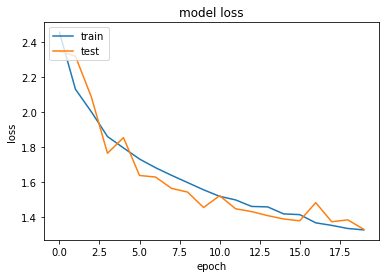

accuracy: 49.51%


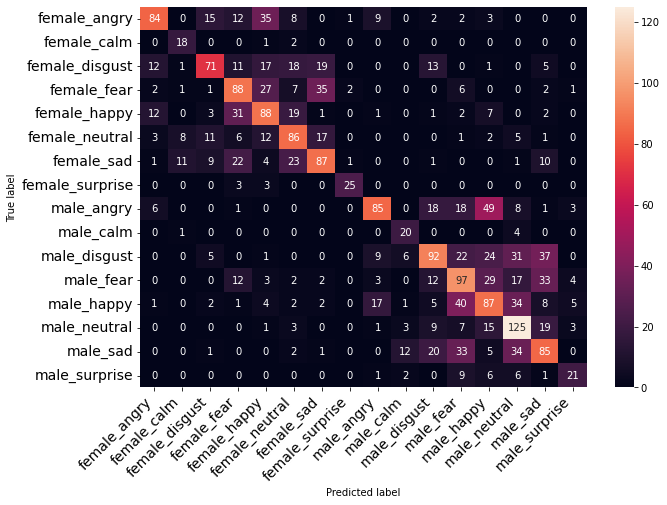

In [79]:
results = get_results(model_history,model,X_test,y_test, ref.labels.unique())
results.create_plot(model_history)
results.create_results(model)
results.confusion_results(X_test, y_test, ref.labels.unique(), model)

0.9218282785134558


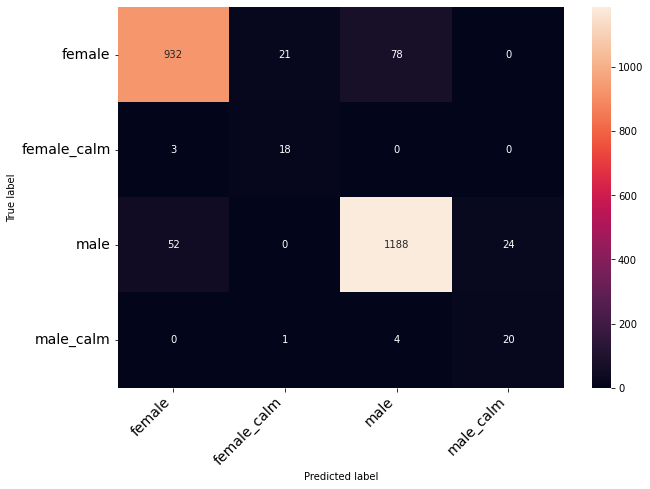

In [80]:
results.accuracy_results_gender(X_test, y_test, ref.labels.unique(), model)